Vamos a utilizar los siguientes archivos ya editados para crear un nuevo set de datos 
df_clima_formato_anual.csv |  radiacion_solar_resumen.csv  |  siembra-editado.csv


In [1]:
destino_archivos =  "../SET DE DATOS/PROCESADOS/"

In [3]:

from sklearn.cross_decomposition import PLSRegression
from sklearn.decomposition import PCA
from sklearn.feature_selection import VarianceThreshold
from sklearn.linear_model import ElasticNetCV, LinearRegression
from sklearn.linear_model import LassoCV, Lasso
from sklearn.linear_model import RidgeCV, Ridge
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np


In [6]:
df_clima = pd.read_csv(destino_archivos+'df_clima_formato_anual.csv')
df_clima = df_clima.drop(columns=df_clima.columns[0],axis=1)

In [8]:
df_clima

,Provincia,YEAR,10_Humedad_Media_8_14_20_kurtosis,10_Humedad_Media_8_14_20_max,10_Humedad_Media_8_14_20_mean,10_Humedad_Media_8_14_20_median,10_Humedad_Media_8_14_20_min,10_Humedad_Media_8_14_20_outliers,10_Humedad_Media_8_14_20_rango_diario,10_Humedad_Media_8_14_20_skew,...,9_Velocidad_Viento_200cm_Media_kurtosis,9_Velocidad_Viento_200cm_Media_max,9_Velocidad_Viento_200cm_Media_mean,9_Velocidad_Viento_200cm_Media_median,9_Velocidad_Viento_200cm_Media_min,9_Velocidad_Viento_200cm_Media_outliers,9_Velocidad_Viento_200cm_Media_rango_diario,9_Velocidad_Viento_200cm_Media_skew,9_Velocidad_Viento_200cm_Media_std,9_Velocidad_Viento_200cm_Media_sum
0,Buenos Aires,1970,-0.710971,88.400000,68.398219,67.200000,52.000000,0.0,36.4,0.508816,...,-0.793050,17.76,11.260667,11.44,5.44,0.0,12.32,0.177123,3.504320,337.82
1,Buenos Aires,1971,-0.325339,84.388956,68.659924,67.188956,56.188956,0.0,28.2,0.243420,...,8.508947,31.52,11.237333,10.64,5.60,1.0,25.92,2.501009,4.819763,337.12
2,Buenos Aires,1972,0.133905,85.000000,69.509677,69.600000,59.000000,1.0,26.0,0.351175,...,1.090898,23.52,11.478000,10.80,4.96,2.0,18.56,0.947480,4.110388,344.34
3,Buenos Aires,1973,-0.887832,89.000000,72.946962,72.800000,58.400000,0.0,30.6,0.169485,...,1.428823,19.04,9.945333,9.84,4.00,1.0,15.04,0.785803,2.960722,298.36
4,Buenos Aires,1974,-0.878117,88.400000,63.316129,63.000000,46.000000,0.0,42.4,0.254702,...,2.341574,20.00,9.717333,9.52,4.16,4.0,15.84,1.287213,3.268583,291.52
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
366,Santa Fe,2018,-0.554429,92.000000,63.322581,62.000000,35.000000,0.0,57.0,-0.110449,...,-1.136187,17.90,11.740000,12.15,5.40,0.0,12.50,-0.249408,3.710247,352.20
367,Santa Fe,2019,-1.080635,96.000000,71.258065,66.000000,50.000000,0.0,46.0,0.365120,...,-0.652510,16.30,9.006667,9.20,2.50,0.0,13.80,0.153653,3.937699,270.20
368,Santa Fe,2020,-0.745401,94.000000,60.709677,59.000000,37.000000,0.0,57.0,0.480345,...,-0.828658,19.50,11.813333,11.70,4.00,0.0,15.50,0.087469,4.417733,354.40
369,Santa Fe,2021,-0.089207,94.000000,56.903226,52.000000,37.000000,3.0,57.0,0.992932,...,2.801337,31.20,12.770000,10.70,4.70,3.0,26.50,1.668220,5.501796,383.10


In [10]:
df_radiacion = pd.read_csv(destino_archivos+'radiacion_solar_resumen.csv')
df_radiacion = df_radiacion.drop(columns=df_radiacion.columns[0],axis=1)

In [12]:
df_radiacion

,YEAR,ALLSKY_SFC_SW_DWN_mean,ALLSKY_SFC_SW_DWN_sum,ALLSKY_SFC_SW_DWN_min,ALLSKY_SFC_SW_DWN_max,ALLSKY_SFC_SW_DWN_std,ALLSKY_SFC_SW_DWN_median,ALLSKY_SFC_SW_DWN_skew,ALLSKY_SFC_SW_DWN_kurtosis,ALLSKY_SFC_UVA_mean,...,ALLSKY_SFC_UVB_skew,ALLSKY_SFC_UVB_kurtosis,ALLSKY_SFC_UV_INDEX_mean,ALLSKY_SFC_UV_INDEX_sum,ALLSKY_SFC_UV_INDEX_min,ALLSKY_SFC_UV_INDEX_max,ALLSKY_SFC_UV_INDEX_std,ALLSKY_SFC_UV_INDEX_median,ALLSKY_SFC_UV_INDEX_skew,ALLSKY_SFC_UV_INDEX_kurtosis
0,1986.0,19.733753,7202.82,2.93,34.38,7.762549,19.480,0.090643,-1.131278,1.292778,...,0.096529,-1.143065,1.988465,725.789591,0.000000,3.872894,0.997526,1.955008,0.098972,-1.147622
1,1988.0,20.169481,7382.03,1.18,35.13,7.827262,20.080,-0.003788,-1.118028,1.320246,...,0.008964,-1.148174,2.045094,748.504314,0.000000,3.969432,1.004550,2.032238,0.011722,-1.153734
2,1989.0,19.497808,7116.70,3.87,33.61,7.595098,19.040,-0.000319,-1.070741,1.277904,...,-0.000074,-1.071218,1.957474,714.478130,0.000000,3.773782,0.977265,1.898372,0.001355,-1.073924
3,1990.0,18.881808,6891.86,4.77,34.94,7.580780,17.910,0.314939,-0.962656,1.239071,...,0.314939,-0.962656,1.878010,685.473665,0.061578,3.944975,0.975777,1.752922,0.314939,-0.962656
4,1991.0,18.518959,6759.42,4.04,34.13,7.689285,17.740,0.096190,-1.038609,1.216196,...,0.096190,-1.038609,1.831490,668.493912,0.000000,3.840715,0.989397,1.731040,0.097688,-1.040816
5,1992.0,19.231667,7038.79,4.12,33.11,7.275959,18.350,0.090508,-1.124465,1.261126,...,0.090508,-1.124465,1.923103,703.855767,0.000000,3.709423,0.936416,1.809557,0.091179,-1.125771
6,1993.0,19.139233,6985.82,2.74,34.22,7.626883,18.390,0.191603,-0.992749,1.255299,...,0.196412,-1.001369,1.911692,697.767651,0.000000,3.852299,0.980586,1.814706,0.197662,-1.003373
7,1994.0,19.038767,6949.15,3.13,33.27,7.469858,18.230,0.136175,-1.037045,1.248965,...,0.140196,-1.044495,1.898821,693.069679,0.000000,3.730018,0.960256,1.794111,0.142752,-1.048909
8,1995.0,20.088356,7332.25,2.63,34.22,7.725449,19.450,-0.000867,-1.014111,1.315132,...,0.008740,-1.034674,2.034411,742.560154,0.000000,3.852299,0.992032,1.951146,0.011240,-1.039560
9,1996.0,19.519426,7144.11,2.10,34.91,7.696637,18.815,0.075670,-1.060021,1.279266,...,0.083115,-1.075405,1.960949,717.707438,0.000000,3.941114,0.988857,1.869411,0.085238,-1.079207


In [14]:
df_siembra = pd.read_csv(destino_archivos+'siembra-editado.csv')


In [16]:
df_siembra

,Cultivo,Campaña,Provincia,Sup. Sembrada,Sup. Cosechada,Producción,Rendimiento
0,Algodón,1969,CATAMARCA,102,102,101,990
1,Algodón,1970,CATAMARCA,95,95,63,663
2,Algodón,1971,CATAMARCA,75,30,30,1000
3,Algodón,1972,CATAMARCA,80,80,68,850
4,Algodón,1973,CATAMARCA,190,80,52,650
...,...,...,...,...,...,...,...
8068,Cebada cervecera,2019,BUENOS AIRES,913410,913410,3650010,3204
8069,Cebada cervecera,2020,BUENOS AIRES,785353,785353,3556420,3631
8070,Cebada cervecera,2021,BUENOS AIRES,1217880,1217880,4819885,3173
8071,Cebada cervecera,2022,BUENOS AIRES,1230417,1230417,4258345,2775


In [18]:
print(df_siembra['Provincia'].unique())
print("--")
print(df_clima['Provincia'].unique())

['CATAMARCA' 'CHACO' 'CORDOBA' 'CORRIENTES' 'ENTRE RIOS' 'FORMOSA' 'JUJUY'
 'LA RIOJA' 'MENDOZA' 'MISIONES' 'SALTA' 'SAN JUAN' 'SAN LUIS' 'SANTA FE'
 'SANTIAGO DEL ESTERO' 'TUCUMAN' 'BUENOS AIRES' 'CHUBUT' 'LA PAMPA'
 'NEUQUEN' 'RIO NEGRO' 'SANTA CRUZ' 'TIERRA DEL FUEGO']
--
['Buenos Aires' 'Corrientes' 'Córdoba' 'Entre Rios' 'La Pampa' 'Misiones'
 'Santa Fe']


In [20]:
# En esta instancia vamos a comparar registros de forma provincial, por lo que vamos a seleccionar las provincias que coincidan para unificar las etiquetas de nombres


# Mapeo de provincias desde df_siembra hacia df_clima
mapeo_provincias = {
    'BUENOS AIRES': 'Buenos Aires',
    'CORRIENTES': 'Corrientes',
    'CORDOBA': 'Córdoba',
    'ENTRE RIOS': 'Entre Rios',
    'LA PAMPA': 'La Pampa',
    'MISIONES': 'Misiones',
    'SANTA FE': 'Santa Fe'
}


# Filtrar provincias que están en el mapeo
df_siembra_filtrado = df_siembra[df_siembra['Provincia'].isin(mapeo_provincias.keys())].copy()

# Reemplazar los nombres por los del df_clima
df_siembra_filtrado['Provincia'] = df_siembra_filtrado['Provincia'].replace(mapeo_provincias)

In [22]:
df_siembra_filtrado

,Cultivo,Campaña,Provincia,Sup. Sembrada,Sup. Cosechada,Producción,Rendimiento
96,Algodón,1969,Córdoba,2500,1896,1220,643
97,Algodón,1970,Córdoba,1600,700,421,601
98,Algodón,1971,Córdoba,3100,1600,1550,969
99,Algodón,1972,Córdoba,4460,3490,4200,1203
100,Algodón,1973,Córdoba,3000,1800,1870,1039
...,...,...,...,...,...,...,...
8068,Cebada cervecera,2019,Buenos Aires,913410,913410,3650010,3204
8069,Cebada cervecera,2020,Buenos Aires,785353,785353,3556420,3631
8070,Cebada cervecera,2021,Buenos Aires,1217880,1217880,4819885,3173
8071,Cebada cervecera,2022,Buenos Aires,1230417,1230417,4258345,2775


In [109]:
# Nos quedamos con el 50% aproximadamente de registros luego de hacer coincidir las provincias entre los dos set de datos

In [53]:
df_siembra_filtrado.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4065 entries, 96 to 8072
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Cultivo         4065 non-null   object
 1   YEAR            4065 non-null   int64 
 2   Provincia       4065 non-null   object
 3   Sup. Sembrada   4065 non-null   int64 
 4   Sup. Cosechada  4065 non-null   int64 
 5   Producción      4065 non-null   int64 
 6   Rendimiento     4065 non-null   int64 
dtypes: int64(5), object(2)
memory usage: 254.1+ KB


In [57]:
df_siembra_filtrado['Provincia'].describe()

count        4065
unique          7
top       Córdoba
freq          735
Name: Provincia, dtype: object

In [27]:
# Vamos a renombrar y cambiar el formato de la columna Campaña
df_siembra_filtrado = df_siembra_filtrado.rename(columns={'Campaña': 'YEAR'})
df_siembra_filtrado['YEAR'] = df_siembra_filtrado['YEAR'].astype(int)
df_clima['YEAR'] = df_clima['YEAR'].astype(int)

In [29]:
df_merged = pd.merge(
    df_siembra_filtrado,
    df_clima,
    on=['Provincia', 'YEAR'],
    how='left' 
)

In [31]:
df_merged

,Cultivo,YEAR,Provincia,Sup. Sembrada,Sup. Cosechada,Producción,Rendimiento,10_Humedad_Media_8_14_20_kurtosis,10_Humedad_Media_8_14_20_max,10_Humedad_Media_8_14_20_mean,...,9_Velocidad_Viento_200cm_Media_kurtosis,9_Velocidad_Viento_200cm_Media_max,9_Velocidad_Viento_200cm_Media_mean,9_Velocidad_Viento_200cm_Media_median,9_Velocidad_Viento_200cm_Media_min,9_Velocidad_Viento_200cm_Media_outliers,9_Velocidad_Viento_200cm_Media_rango_diario,9_Velocidad_Viento_200cm_Media_skew,9_Velocidad_Viento_200cm_Media_std,9_Velocidad_Viento_200cm_Media_sum
0,Algodón,1969,Córdoba,2500,1896,1220,643,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Algodón,1970,Córdoba,1600,700,421,601,-1.294806,79.0,63.032258,...,0.130508,37.600000,13.626667,11.600000,1.600000,1.0,36.000000,1.074206,9.735783,408.800000
2,Algodón,1971,Córdoba,3100,1600,1550,969,-1.028722,82.0,61.161290,...,0.417670,28.000000,9.146667,5.600000,1.600000,3.0,26.400000,1.240164,7.550644,274.400000
3,Algodón,1972,Córdoba,4460,3490,4200,1203,-0.795148,87.0,69.838710,...,4.508725,28.000000,8.640000,7.200000,1.600000,1.0,26.400000,1.872462,5.194798,259.200000
4,Algodón,1973,Córdoba,3000,1800,1870,1039,-0.308436,91.0,71.451613,...,-0.942335,18.400000,10.933333,10.800000,0.000000,0.0,18.400000,-0.166103,4.783112,328.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4060,Cebada cervecera,2019,Buenos Aires,913410,913410,3650010,3204,0.598198,95.0,65.883871,...,-0.661898,9.690830,7.461134,7.756416,4.883836,0.0,4.806994,-0.255539,1.252941,223.834005
4061,Cebada cervecera,2020,Buenos Aires,785353,785353,3556420,3631,-0.295515,90.6,64.922581,...,1.588594,10.604255,7.530525,7.424127,5.203171,5.0,5.401083,0.430216,1.055556,225.915748
4062,Cebada cervecera,2021,Buenos Aires,1217880,1217880,4819885,3173,-0.962511,83.2,60.741935,...,-0.049588,9.885249,7.477070,7.304915,5.711917,2.0,4.173332,0.734765,1.064113,224.312087
4063,Cebada cervecera,2022,Buenos Aires,1230417,1230417,4258345,2775,-0.401390,85.2,61.302870,...,0.718616,10.734913,7.212086,7.143458,5.156252,2.0,5.578662,0.796207,1.299539,216.362587


In [33]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4065 entries, 0 to 4064
Columns: 979 entries, Cultivo to 9_Velocidad_Viento_200cm_Media_sum
dtypes: float64(972), int64(5), object(2)
memory usage: 30.4+ MB


In [35]:
df_radiacion.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36 entries, 0 to 35
Data columns (total 33 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   YEAR                          36 non-null     float64
 1   ALLSKY_SFC_SW_DWN_mean        36 non-null     float64
 2   ALLSKY_SFC_SW_DWN_sum         36 non-null     float64
 3   ALLSKY_SFC_SW_DWN_min         36 non-null     float64
 4   ALLSKY_SFC_SW_DWN_max         36 non-null     float64
 5   ALLSKY_SFC_SW_DWN_std         36 non-null     float64
 6   ALLSKY_SFC_SW_DWN_median      36 non-null     float64
 7   ALLSKY_SFC_SW_DWN_skew        36 non-null     float64
 8   ALLSKY_SFC_SW_DWN_kurtosis    36 non-null     float64
 9   ALLSKY_SFC_UVA_mean           36 non-null     float64
 10  ALLSKY_SFC_UVA_sum            36 non-null     float64
 11  ALLSKY_SFC_UVA_min            36 non-null     float64
 12  ALLSKY_SFC_UVA_max            36 non-null     float64
 13  ALLSKY_

In [37]:
df_radiacion['YEAR'] = df_radiacion['YEAR'].astype(int)
df_merged['YEAR'] = df_merged['YEAR'].astype(int)

df_merged_final = pd.merge(
    df_merged,
    df_radiacion,
    on='YEAR',
    how='left'  # para mantener todos los registros originales del merge anterior
)

In [39]:
df_merged_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4065 entries, 0 to 4064
Columns: 1011 entries, Cultivo to ALLSKY_SFC_UV_INDEX_kurtosis
dtypes: float64(1004), int64(5), object(2)
memory usage: 31.4+ MB


In [42]:
df_merged_final.to_csv(destino_archivos+"dataset_unido_final.csv")

In [ ]:
# Descomentar si es necesario volver desde este punto
#df_merged_final = pd.read_csv(destino_archivos+"dataset_unido_final.csv")


In [44]:
# Vamos a empezar a eliminar registros redundantes
# Nos quedamos con columnas que tengan variacion en sus valores por lo menos 1 vez
df_merged_final = df_merged_final.loc[:, df_merged_final.nunique() > 1]


In [46]:
df_merged_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4065 entries, 0 to 4064
Columns: 999 entries, Cultivo to ALLSKY_SFC_UV_INDEX_kurtosis
dtypes: float64(992), int64(5), object(2)
memory usage: 31.0+ MB


In [113]:
# Vemos si hay valores nulos en alguna columna luego de unir
print("¿Hay NaNs?", df_merged_final.isnull().values.any())


¿Hay NaNs? True


In [115]:
# Completamos los registros con valores NA con la media de cada columna , los NA se generaron al unir los DF con la dupla Provincia,Año y si no habia algun registro en particular para el cultivo en esa dupla queda un NA
for columna in df_merged_final.columns:

    if df_merged_final[columna].isnull().any():
        df_merged_final[columna] = df_merged_final[columna].fillna(df_merged_final[columna].mean())

print("¿Hay NaNs?", df_merged_final.isnull().values.any())
        
    

¿Hay NaNs? False


Pasamos de 1011 a 999 Variables que podrian aportar valor bajo el primer filtrado

# DEFINICION DE MODELOS

## DISEÑO DE FILTROS

In [145]:

def filtro_provincial(dfx,dfy,provincia):
    """
    Devuelve 2 dataframe filtrados por provincia
    in: 
    dfx: DatataFrame con todos los registros de las variables predictoras
    dfy: DataFrame con todos los registros de la variable objetivo

    out:
    df_temp_var_x: DataFrame con registros filtrados por provincia de las variables predictoras
    df_temp_var_y: DataFrame con registros filtrados por provincia de la variable objetivo
    """

    df_temp_var_x = dfx.copy()
    df_temp_var_x['Provincia'] = df_merged_final['Provincia']
    df_temp_var_x = df_temp_var_x[(df_temp_var_x['Provincia'] == provincia)]
    df_temp_var_x = df_temp_var_x.drop(columns=['Provincia'],axis=1)
    
    df_temp_var_y = pd.DataFrame(dfy).copy()
    df_temp_var_y['Provincia'] = df_merged_final['Provincia']
    df_temp_var_y = df_temp_var_y[(df_temp_var_y['Provincia'] == provincia)]
    df_temp_var_y = df_temp_var_y.drop(columns=['Provincia'],axis=1)
    return df_temp_var_x,df_temp_var_y

def filtro_cultivo(dfx,dfy,cultivo):
    """
    Devuelve 2 dataframe filtrados por cultivo
    in: 
    dfx: DatataFrame con todos los registros de las variables predictoras
    dfy: DataFrame con todos los registros de la variable objetivo

    out:
    df_temp_var_x: DataFrame con registros filtrados por cultivo de las variables predictoras
    df_temp_var_y: DataFrame con registros filtrados por cultivo de la variable objetivo
    """

    df_temp_var_x = dfx.copy()
    df_temp_var_x['Cultivo'] = df_merged_final['Cultivo']
    df_temp_var_x = df_temp_var_x[(df_temp_var_x['Cultivo'] == cultivo)]
    df_temp_var_x = df_temp_var_x.drop(columns=['Cultivo'],axis=1)
    
    df_temp_var_y = pd.DataFrame(dfy).copy()
    df_temp_var_y['Cultivo'] = df_merged_final['Cultivo']
    df_temp_var_y = df_temp_var_y[(df_temp_var_y['Cultivo'] == cultivo)]
    df_temp_var_y = df_temp_var_y.drop(columns=['Cultivo'],axis=1)
    return df_temp_var_x,df_temp_var_y


def filtro_por_cultivo_provincia(dfx,dfy,cultivo,provincia):
    """
    Devuelve 2 dataframe filtrados por cultivo y provincia
    in: 
    dfx: DatataFrame con todos los registros de las variables predictoras
    dfy: DataFrame con todos los registros de la variable objetivo

    out:
    df_temp_var_x: DataFrame con registros filtrados por cultivo y provincia de las variables predictoras
    df_temp_var_y: DataFrame con registros filtrados por cultivo y provincia de la variable objetivo
    """
    
    df_temp_var_x = dfx.copy()
    df_temp_var_x['Provincia'] = df_merged_final['Provincia']
    df_temp_var_x['Cultivo'] = df_merged_final['Cultivo']
    df_temp_var_x = df_temp_var_x[(df_temp_var_x['Provincia'] == provincia) & (df_temp_var_x['Cultivo'] == cultivo)]
    df_temp_var_x = df_temp_var_x.drop(columns=['Provincia'],axis=1)
    df_temp_var_x = df_temp_var_x.drop(columns=['Cultivo'],axis=1)
    
    df_temp_var_y = pd.DataFrame(dfy).copy()
    df_temp_var_y['Provincia'] = df_merged_final['Provincia']
    df_temp_var_y['Cultivo'] = df_merged_final['Cultivo']
    df_temp_var_y = df_temp_var_y[(df_temp_var_y['Provincia'] == provincia)  & (df_temp_var_y['Cultivo'] == cultivo)]
    df_temp_var_y = df_temp_var_y.drop(columns=['Provincia'],axis=1)
    df_temp_var_y = df_temp_var_y.drop(columns=['Cultivo'],axis=1)
    return df_temp_var_x,df_temp_var_y



## ANALISIS CON RIDGE

In [153]:
# Armamos una funcion para encontrar automaticamente el mejor valor de alfa y obtener una grafica que permita entender mejor el comportamiento


def ridge_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar='s'):
    """
    Función para entrenar un modelo Ridge con búsqueda automática del mejor alpha.
    
    Args:
        dfx (DataFrame): Variables predictoras (features).
        dfy (Series o DataFrame): Variable objetivo.
        alphas (array): Valores de alpha a probar.
        test_size (float): Proporción del set de test.
        random_state (int): Semilla de aleatoriedad.
        n_splits (int): Cantidad de unidades para el analisis cross
        
    Returns:
        modelo entrenado
    """
    
    # Dividir en train y test
    X_train, X_test, y_train, y_test = train_test_split(dfx, dfy, test_size=test_size, random_state=random_state)
    
    # Escalado
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    # Ajustar modelo Ridge con Cross-Validation para encontrar el mejor alpha
    modelo = RidgeCV(alphas=alphas, store_cv_values=True)
    modelo.fit(X_train_scaled, y_train)
    mejor_alpha = modelo.alpha_
    
    print(f"Mejor valor de alpha encontrado: {mejor_alpha:.6f}")
    
    # Predicción en Test
    y_pred_test = modelo.predict(X_test_scaled)
    
    # Métricas
    mse_test = mean_squared_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)
    print(f"MSE en Test: {mse_test:.4f}")
    print(f"R2 en Test: {r2_test:.4f}")


    if graficar == 's':
        # Graficar error de validación cruzada vs alpha
        mean_cv_errors = np.mean(modelo.cv_values_, axis=0)
    
        plt.figure(figsize=(10,6))
        plt.plot(alphas, mean_cv_errors, marker='o')
        plt.xscale('log')
        plt.xlabel('Alpha')
        plt.ylabel('Error cuadrático medio (Cross-Validation)')
        plt.title('Error en Validación Cruzada vs Alpha')
        plt.grid(True)
        plt.show()
    
        # Gráfico de R2 en cada Fold ( usando Cross Validation)
        cv = KFold(n_splits, shuffle=True, random_state=random_state)
        r2_folds = cross_val_score(
            Ridge(alpha=mejor_alpha),
            X_train_scaled,
            y_train,
            cv=cv,
            scoring='r2'
        )


    
        plt.figure(figsize=(10,6))
        plt.plot(range(1, len(r2_folds) + 1), r2_folds, marker='o')
        plt.axhline(y=np.min(r2_folds), color='red', linestyle='--', label=f'R2 mínimo fold: {np.min(r2_folds):.4f}')
        plt.title('R2 de cada Fold en la Validación Cruzada')
        plt.xlabel('Número de Fold')
        plt.ylabel('R2 individual')
        plt.legend()
        plt.grid(True)
        plt.show()
    
    return modelo,r2_test,mse_test


1. División de datos en entrenamiento y prueba
Se separan los datos en conjunto de entrenamiento y conjunto de prueba con train_test_split, para evaluar el modelo correctamente.

2. Escalado de variables
Se utiliza StandardScaler para normalizar las variables predictoras. Esto es fundamental para Ridge, que penaliza los coeficientes en función de su magnitud.

3. Entrenamiento con RidgeCV
Se usa RidgeCV, que automáticamente prueba todos los valores de alpha proporcionados, y selecciona el que minimiza el error de validación cruzada.

4. Evaluación del modelo
Se realiza predicción en el conjunto de test (X_test_scaled), y se calculan dos métricas importantes:

MSE (Error cuadrático medio)

R² (Coeficiente de determinación)

5. Gráfico: Error medio vs Alpha
Se grafica el error medio de validación cruzada contra los valores de alpha, para observar el comportamiento del error respecto al nivel de regularización.

6. Evaluación con Validación Cruzada real
Con KFold se realiza una validación cruzada explícita, midiendo el R² en cada fold de entrenamiento/validación, usando el mejor alpha encontrado.

7. Gráfico: R² individual en cada Fold
Se grafica el R² obtenido en cada fold para detectar posibles problemas de convergencia o variabilidad entre folds.

8. Devolver el modelo entrenado
La función retorna el modelo RidgeCV ya ajustado con el mejor valor de alpha hallado.



Usando validación cruzada (KFold) y en cada fold se calcula el R² sobre subsets de tus datos.

Si algunos folds tienen muy pocas muestras, el denominador 

SST es pequeño → esto puede inflar el valor de R².

También puede pasar que por casualidad el modelo en un fold prediga muy bien (mejor que lo que sería razonable esperar).

Por eso los valores fold a fold de R² pueden ir de valores negativos hasta superar 1.
Es normal en datasets pequeños o inestables.

La grafica del Error en Validacion Cruzada Vs Alpha denotara el proceso interno del modulo Ridgecv donde se busca el mejor resultado para los valores de alpha dados, mientras que el grafico de r2 vs fold, muestra el resultado del r2 de cada fold para el mejor alpha.

### Experimento 1

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2239808.3969
R2 en Test: 0.0978


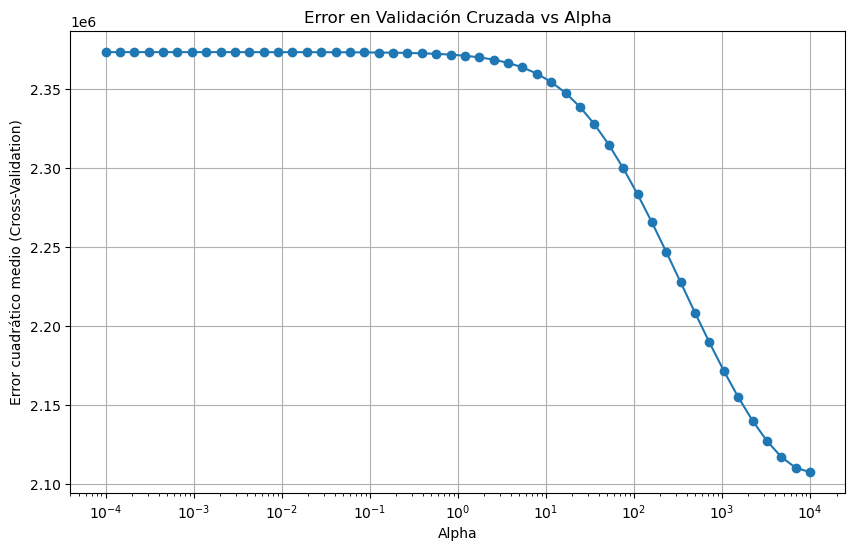

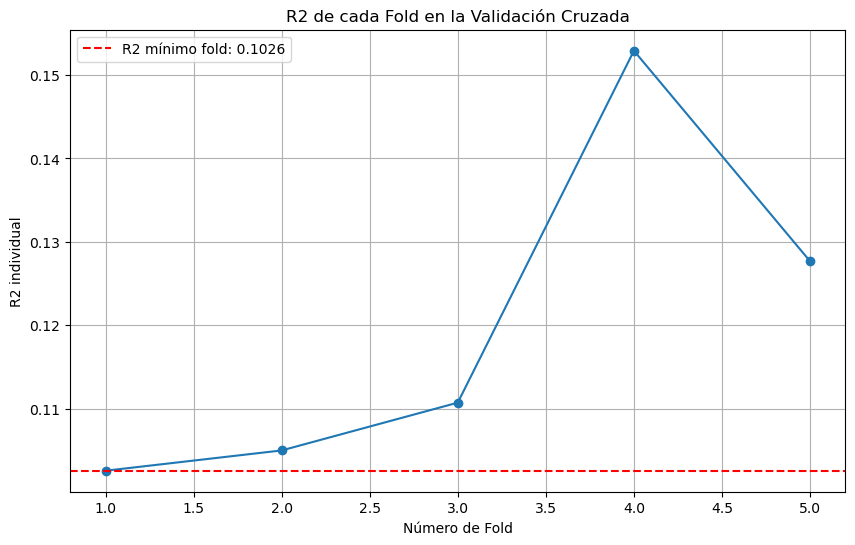

Cantidad de predictores: 992


In [137]:
# Evaluamos ridge para todo el set de datos completo

# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]
ridge_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)


print(f"Cantidad de predictores: {len(df_merged_final.columns[7:])}")

Volvemos a intentar un analisis con Ridgecv pero esta vez vamos a restringir sobre una sola provincia, luego sobre un solo cultivo, y luego sobre una combinación de ambos

Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 342205.3722
R2 en Test: 0.2318


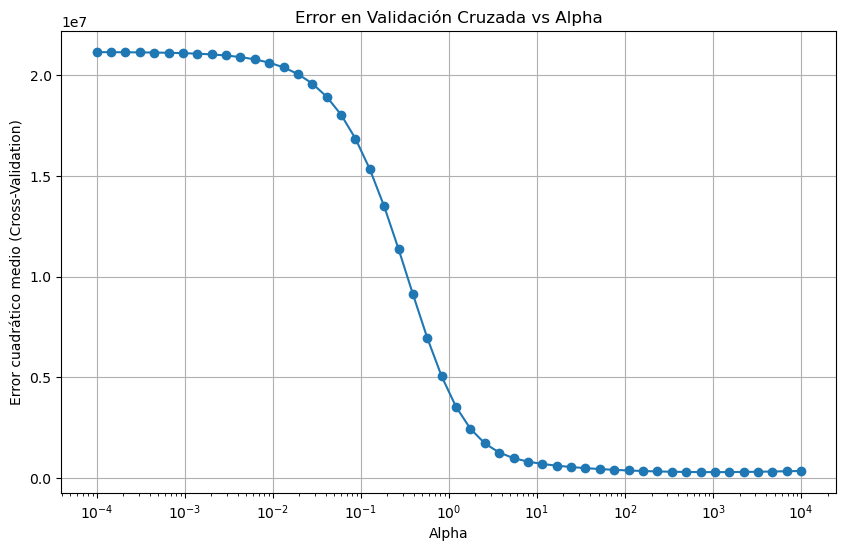

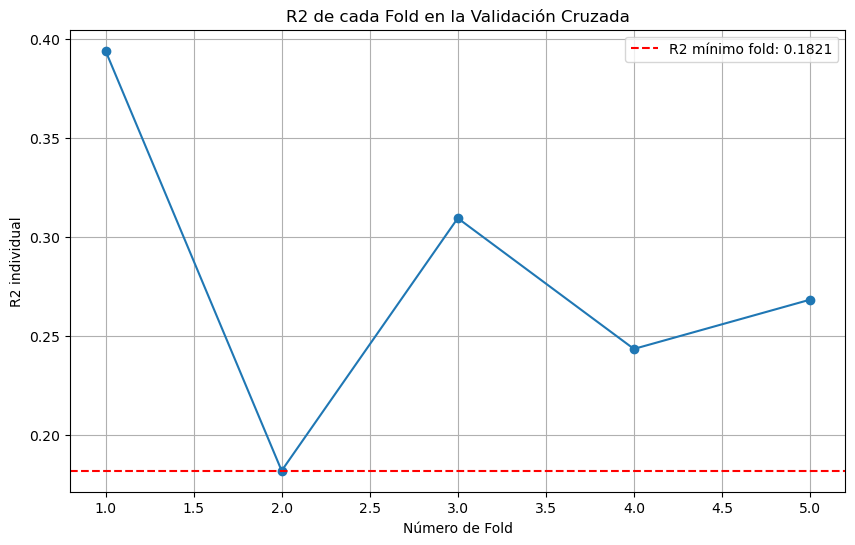

Registros: (368, 1)


In [156]:
# Evaluamos para un cultivo especifico en todas las provincias

# Para mantener el seguimiento y volver mas simple la lectura, volvemos a definir las variables
# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_cultivo(dfx,dfy,'Soja total')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)
print(f"Registros: {y.shape}")

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1629137.4794
R2 en Test: 0.1183


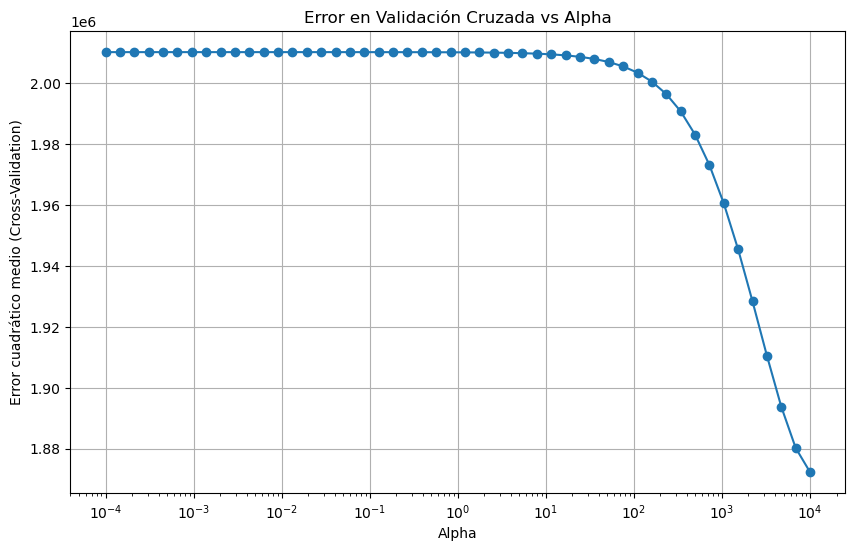

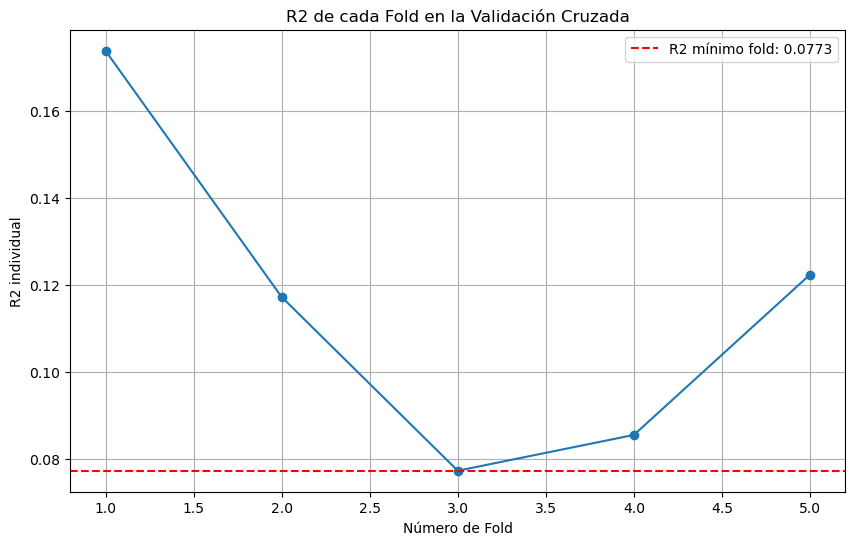

Registros: (735, 1)


In [158]:
# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]


x,y = filtro_provincial(dfx,dfy,'Córdoba')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)
print(f"Registros: {y.shape}")

Las metricas utilizando registros de una unica provincia empeoraron notablemente, hay que considerar que tambien disminuyeron la cantidad de registros al filtrar

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 240808.4725
R2 en Test: 0.5176


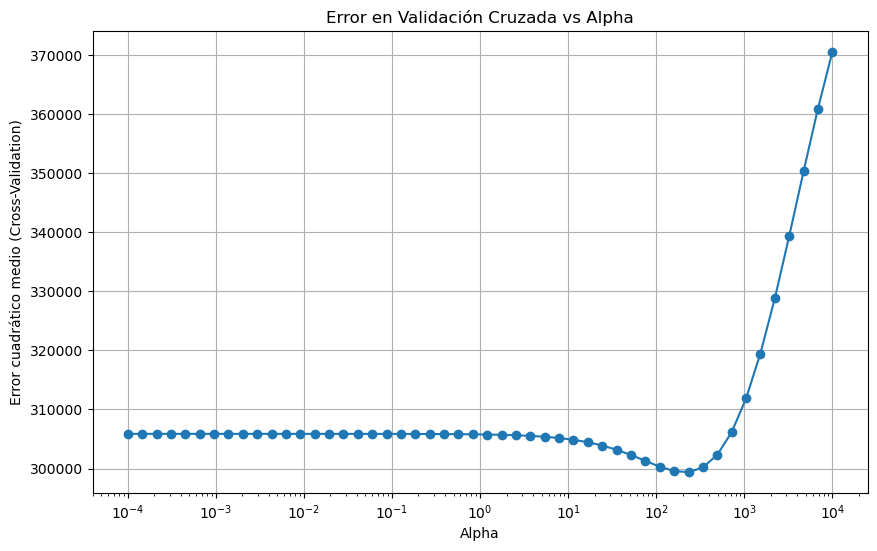

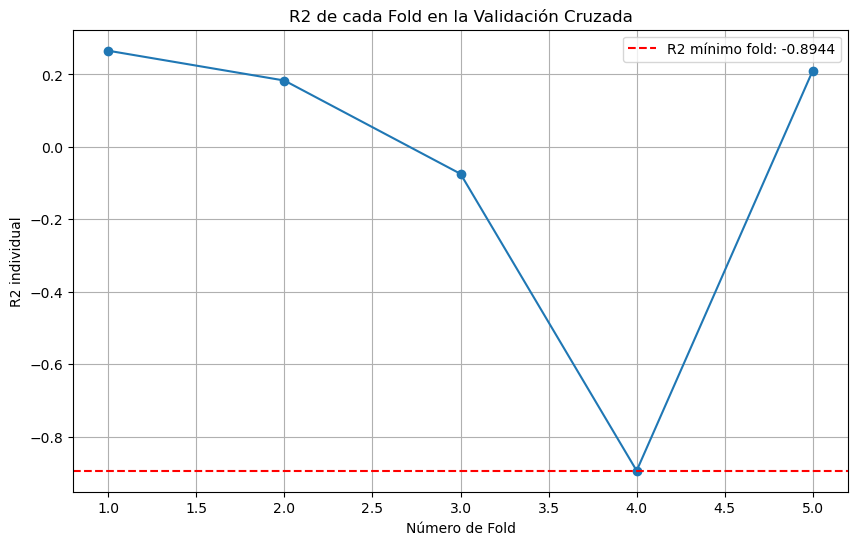

Registros: (53, 1)


In [160]:

# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)

print(f"Registros: {y.shape}")

Los valores mejoraron sustancialmente al definir la dupla de Provincia/Cultivo, vamos a repetir la prueba con dos variaciones para ver si fue una eventualidad, sobre todo considerando que uno de los folds dio un valor negativo tan alto

Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 213454.1732
R2 en Test: 0.3734


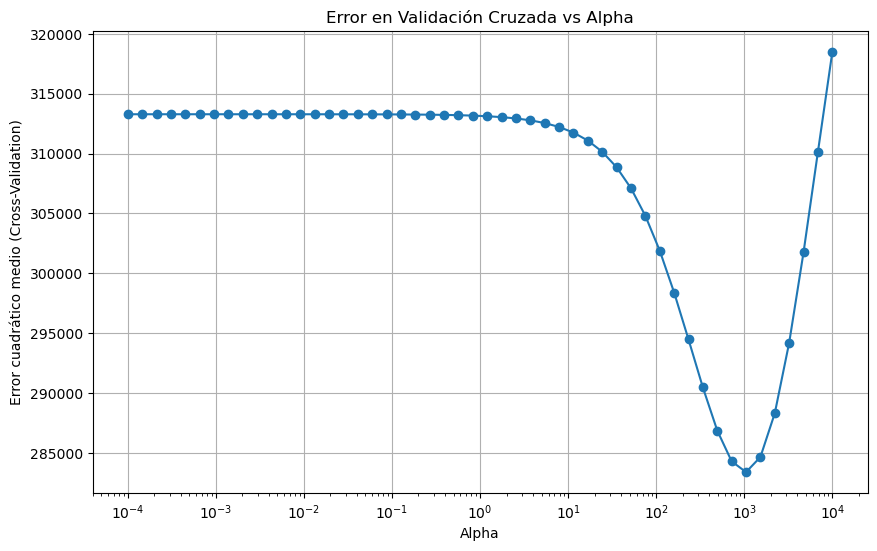

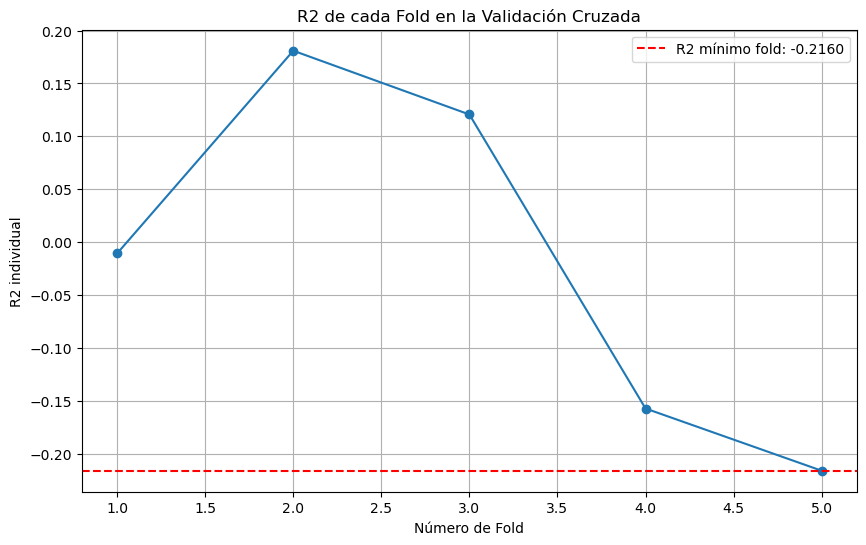

Registros: (55, 1)


In [163]:
# Repetimos prueba cambiando la provincia

# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Buenos Aires')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)

print(f"Registros: {y.shape}")

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2402363.6112
R2 en Test: 0.4798


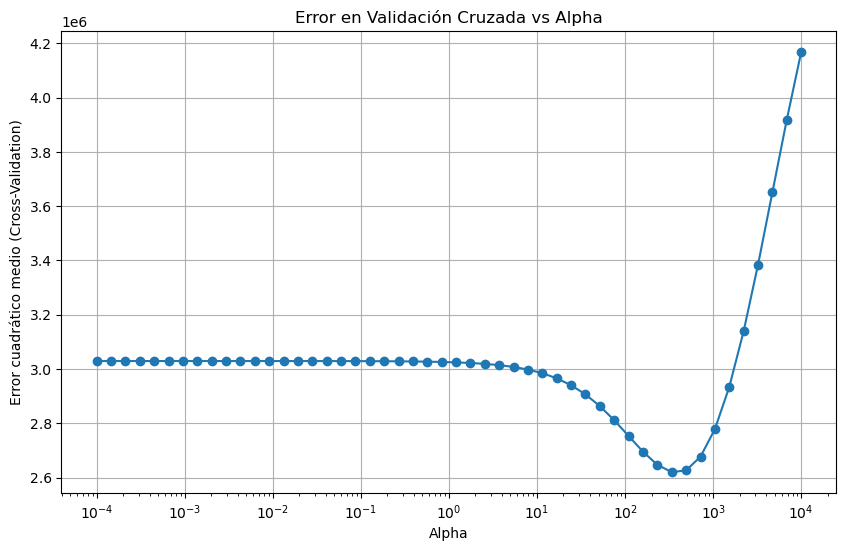

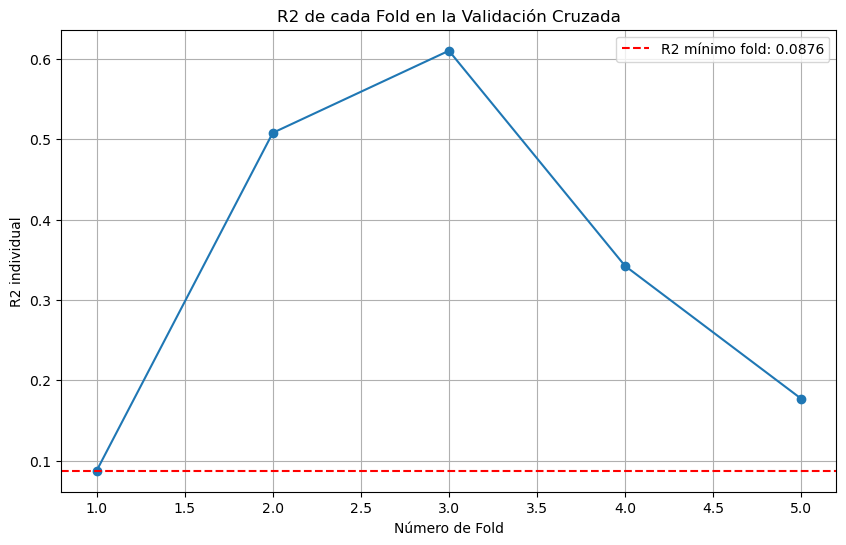

Registros: (55, 1)


In [167]:
# Repetimos la prueba cambiando la cosecha

# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Maíz','Córdoba')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)

print(f"Registros: {y.shape}")

De las 3 combinaciones vemos que los mejores resultados se dieron con una provincia contra la otra, si bien los valores no fueron igual de altos siempre, estuvieron por arriba de los valores obtenidos con los registros sin filtrar o con filtros parciales. 

Vemos un comportamiento mas regular al usar la combinación Provincia/Cultivo, la dificultad reside en la baja cantidad de registros

Vamos a resaltar el resultado siguiente:

Con el modelo RidgeCV para la combinación  Provincia/Cultivo

Mejor valor de alpha encontrado: 159.985872

MSE en Test: 288202.1116

R2 en Test: 0.4227

## LASSO

In [155]:


# Función para entrenamiento automático de Lasso con selección de alpha y gráficos

def lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar='s'):
    """
    Función para entrenar un modelo Lasso con búsqueda automática del mejor alpha.

    Args:
        dfx (DataFrame): Variables predictoras (features).
        dfy (Series o DataFrame): Variable objetivo.
        alphas (array): Valores de alpha a probar.
        test_size (float): Proporción del set de test.
        random_state (int): Semilla de aleatoriedad.
        n_splits (int): Cantidad de unidades para el análisis cross-validation.

    Returns:
        modelo entrenado
    """

    # Dividir en train y test
    X_train, X_test, y_train, y_test = train_test_split(dfx, dfy, test_size=test_size, random_state=random_state)

    # Escalado
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Ajustar modelo Lasso con Cross-Validation para encontrar el mejor alpha
    modelo = LassoCV(alphas=alphas, cv=n_splits, random_state=random_state, n_jobs=-1)
    modelo.fit(X_train_scaled, y_train)
    mejor_alpha = modelo.alpha_

    print(f"Mejor valor de alpha encontrado: {mejor_alpha:.6f}")

    # Predicción en Test
    y_pred_test = modelo.predict(X_test_scaled)

    # Métricas
    mse_test = mean_squared_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)
    print(f"MSE en Test: {mse_test:.4f}")
    print(f"R2 en Test: {r2_test:.4f}")

    if graficar == 's':
        # Graficar error de validación cruzada vs alpha
        mean_cv_errors = np.mean(modelo.mse_path_, axis=1)
    
        plt.figure(figsize=(10,6))
        plt.plot(alphas, mean_cv_errors, marker='o')
        plt.xscale('log')
        plt.xlabel('Alpha')
        plt.ylabel('Error cuadrático medio (Cross-Validation)')
        plt.title('Error en Validación Cruzada vs Alpha (Lasso)')
        plt.grid(True)
        plt.show()
    
        # Gráfico de R2 en cada Fold (de verdad, usando Cross Validation)
        cv = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)
        r2_folds = cross_val_score(
            Lasso(alpha=mejor_alpha, max_iter=10000),
            X_train_scaled,
            y_train,
            cv=cv,
            scoring='r2'
        )
    
        plt.figure(figsize=(10,6))
        plt.plot(range(1, len(r2_folds) + 1), r2_folds, marker='o')
        plt.axhline(y=np.min(r2_folds), color='red', linestyle='--', label=f'R2 mínimo fold: {np.min(r2_folds):.4f}')
        plt.title('R2 de cada Fold en la Validación Cruzada (Lasso)')
        plt.xlabel('Número de Fold')
        plt.ylabel('R2 individual')
        plt.legend()
        plt.grid(True)
        plt.show()
    
    return modelo,mse_test,r2_test


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273520.5005846024, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 750408.9207801819, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2303351.190505028, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2242888.2073
R2 en Test: 0.0966


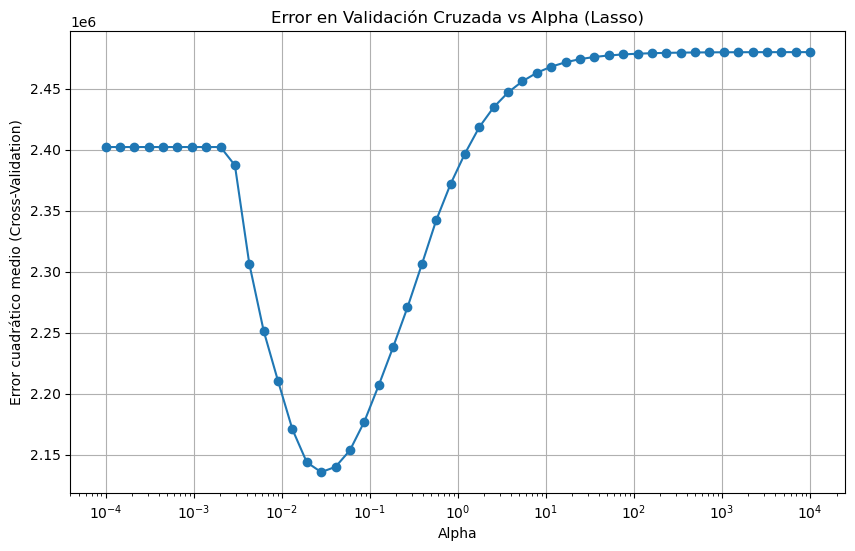

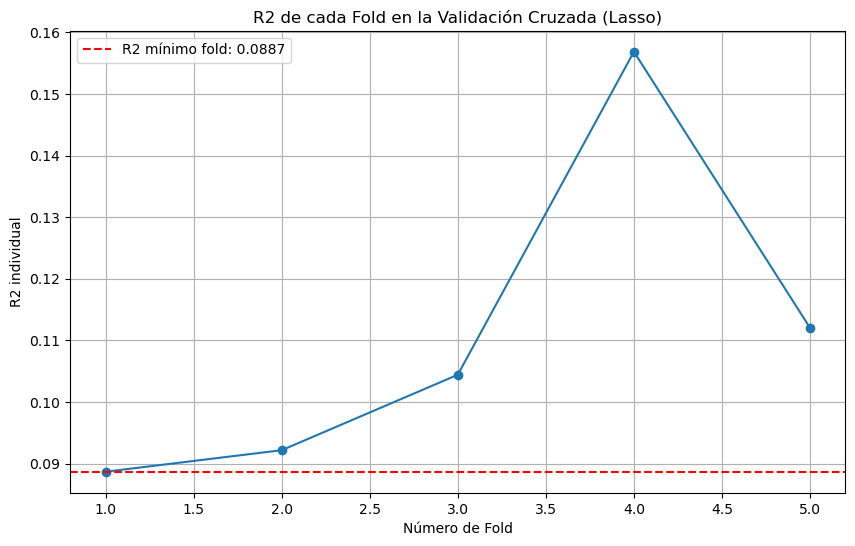

(LassoCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.68269580e-0...
        3.72759372e+00, 5.42867544e+00, 7.90604321e+00, 1.15139540e+01,
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
         cv=5, n_jobs=-1, random_state=42),
 2242888.2072818014,
 0.0965643484367733)

In [174]:
# Ejecución del modelo lasso sobre el 100% de los registros
lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000)



/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273520.5005846024, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2303351.190505028, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 750408.9207801819, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2242888.2073
R2 en Test: 0.0966


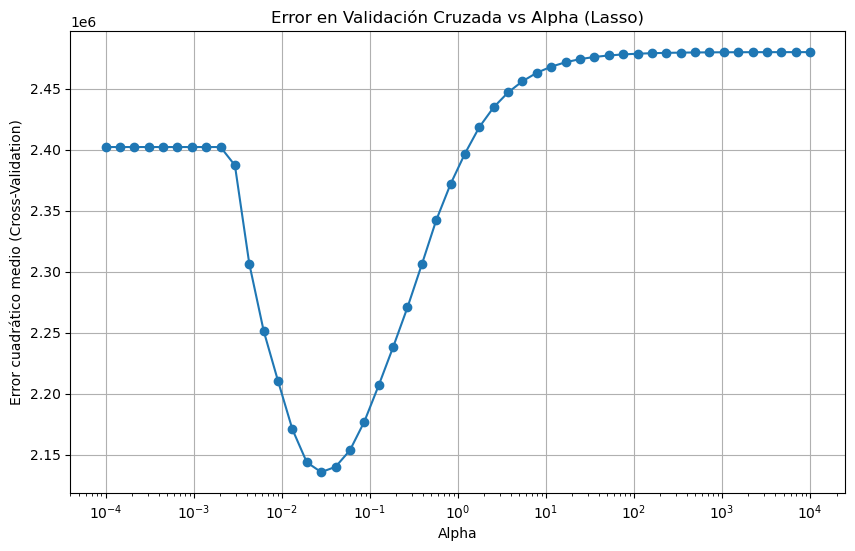

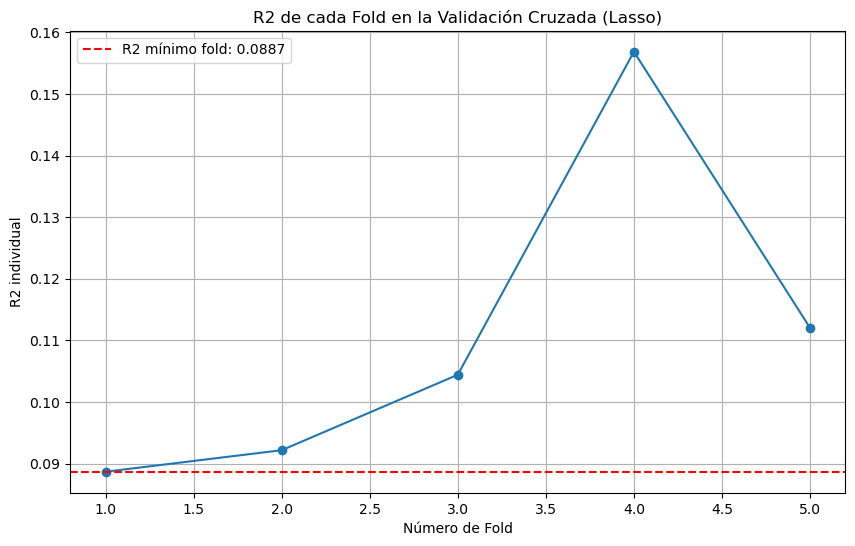

(LassoCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.68269580e-0...
        3.72759372e+00, 5.42867544e+00, 7.90604321e+00, 1.15139540e+01,
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
         cv=5, n_jobs=-1, random_state=42),
 2242888.2072818014,
 0.0965643484367733)

In [176]:
# Dado a que tenemos mensajes de error de convergencia probamos un un indice mayor de iteraciones

lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273520.5005846024, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2303351.190505028, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 803377.8855714798, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2242888.2073
R2 en Test: 0.0966


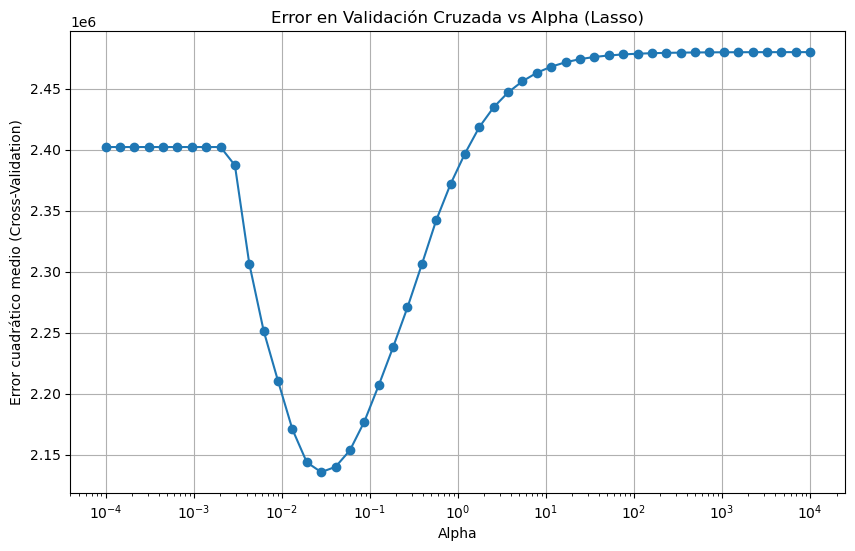

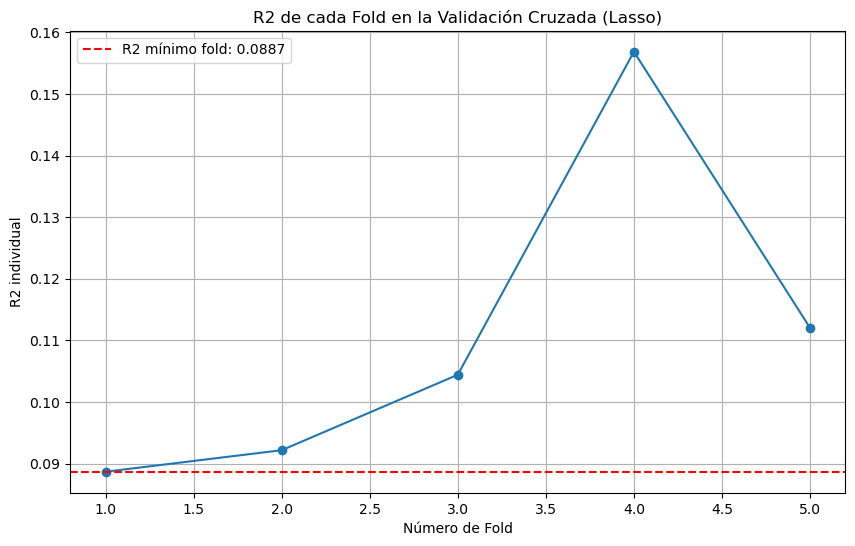

(LassoCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.68269580e-0...
        3.72759372e+00, 5.42867544e+00, 7.90604321e+00, 1.15139540e+01,
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
         cv=5, n_jobs=-1, random_state=42),
 2242888.2072818014,
 0.0965643484367733)

In [178]:
# Realizamos un ultimo intento ya que pareceria no converger 

lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=1000000)


Vemos en este contexto que lasso no resuelve bien este set de datos, incluyo no logra converger por mas que aumentemos las iteraciones, repetiremos las pruebas sobre los datos acotados como se hizo con ridge

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.642e+04, tolerance: 1.015e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.890e+04, tolerance: 1.060e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 359632.6836
R2 en Test: 0.1926


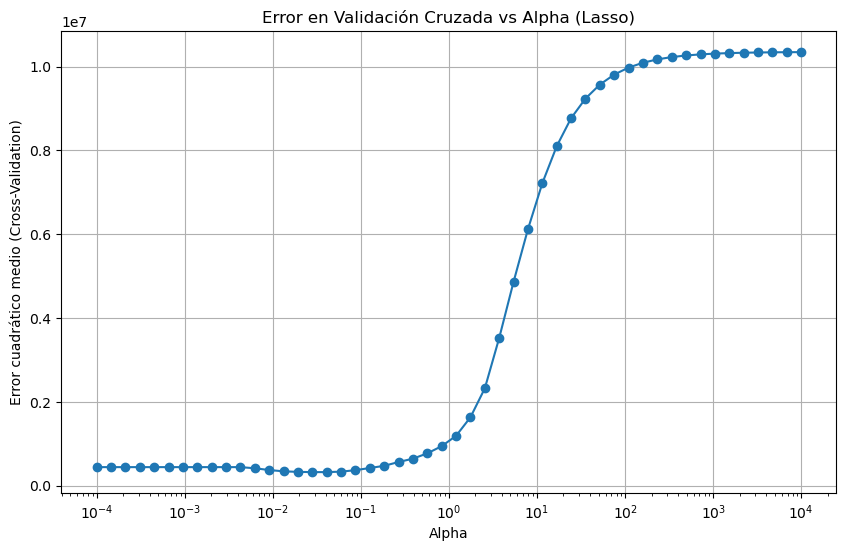

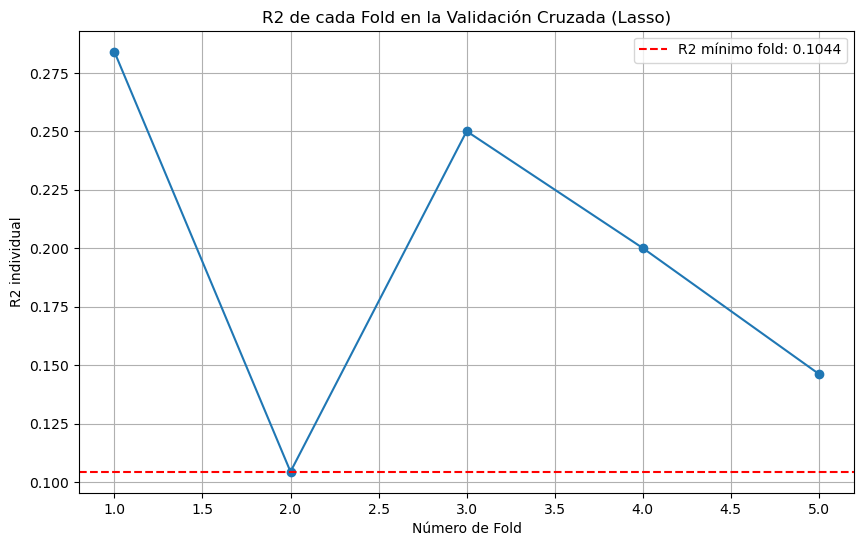

Registros: (368, 1)


In [453]:
# Evaluamos para un cultivo especifico en todas las provincias

# Para mantener el seguimiento y volver mas simple la lectura, volvemos a definir las variables
# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_cultivo(dfx,dfy,'Soja total')

lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)
print(f"Registros: {y.shape}")

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1596927.4365
R2 en Test: 0.1358


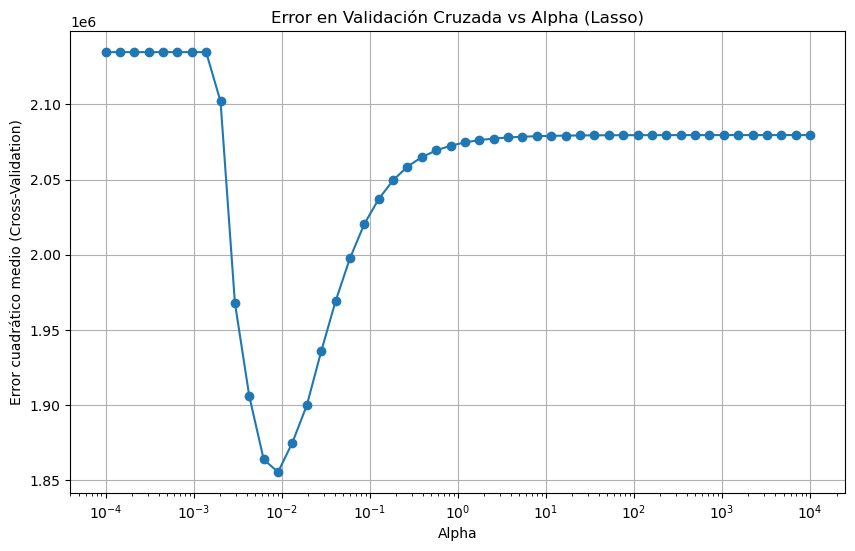

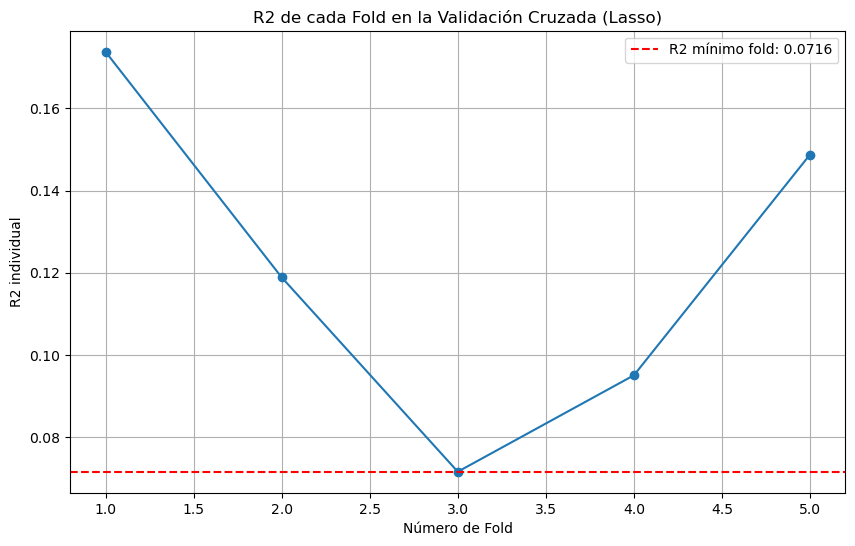

Registros: (735, 1)


In [455]:
# Evaluamos sobre una provincia en particular todos los cultivos

# Para mantener el seguimiento y volver mas simple la lectura, volvemos a definir las variables
# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_provincial(dfx,dfy,'Córdoba')

lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)
print(f"Registros: {y.shape}")

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3593178.6073
R2 en Test: 0.2220


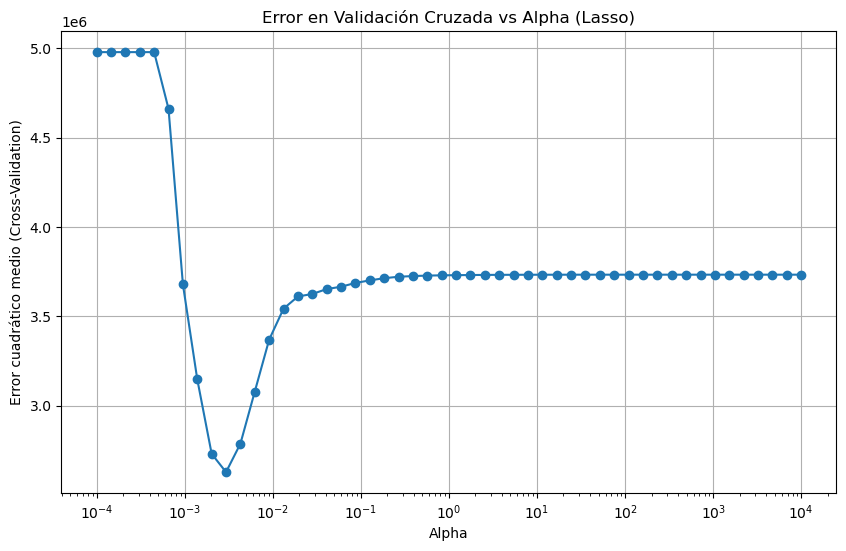

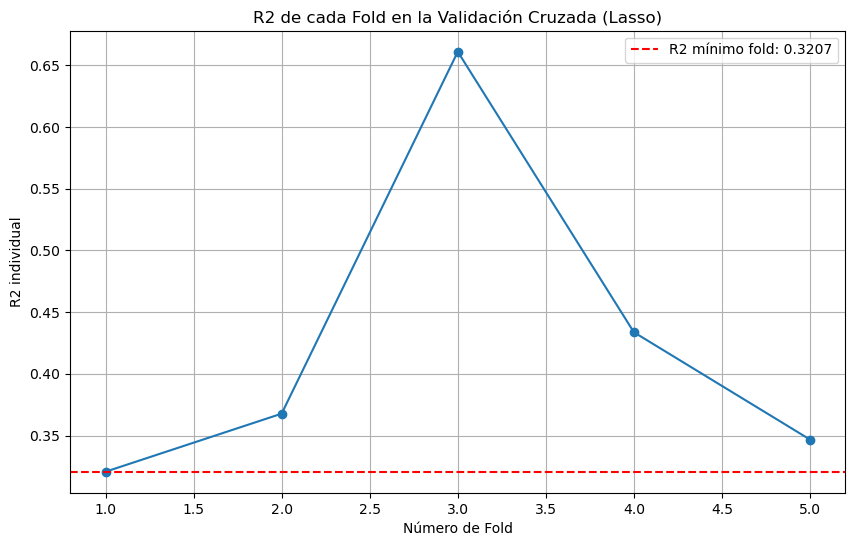

Registros: (55, 1)


In [457]:
# Repetimos la prueba sobre la dupla cultivo/provincia

# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Maíz','Córdoba')

lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)

print(f"Registros: {y.shape}")

En el caso de Lasso el error es mucho mayor, al analizar los registros unidos (todas las provincias y todos los cultivos) el modelo tuvo problemas de convergencia, en cualquiera de las combinaciones analizadas el modelos no logro llegar a los valores de Ridge en rendimiento.


## ELASTIC NET , PCR , PLS

In [157]:
# Funciones para evaluar modelos de regresión: Elastic Net, PCR y PLS


# Función para Elastic Net Regression
def elasticnet_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar='s'):
    """
    Entrena un modelo Elastic Net con búsqueda automática de alpha y l1_ratio.
    """
    # División de datos
    X_train, X_test, y_train, y_test = train_test_split(dfx, dfy, test_size=test_size, random_state=random_state)
    # Escalado
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    # Modelo ElasticNetCV
    modelo = ElasticNetCV(alphas=alphas, l1_ratio=l1_ratios, cv=n_splits, random_state=random_state, max_iter=100000, n_jobs=-1)
    modelo.fit(X_train_scaled, y_train)
    mejor_alpha = modelo.alpha_
    mejor_l1 = modelo.l1_ratio_
    print(f"Mejor alpha: {mejor_alpha:.6f}, Mejor l1_ratio: {mejor_l1:.2f}")
    # Predicción y métricas
    y_pred_test = modelo.predict(X_test_scaled)
    mse_test = mean_squared_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)
    print(f"MSE Test: {mse_test:.4f}, R² Test: {r2_test:.4f}")

    if graficar == 's':
        # Gráfico de R² en cada fold
        cv = KFold(n_splits=n_splits, shuffle=True, random_state=random_state)
        r2_folds = cross_val_score(ElasticNetCV(alphas=[mejor_alpha], l1_ratio=mejor_l1, cv=n_splits, random_state=random_state, max_iter=100000), X_train_scaled, y_train, cv=cv, scoring='r2')
        plt.figure(figsize=(10,6))
        plt.plot(range(1, len(r2_folds)+1), r2_folds, marker='o')
        plt.axhline(y=np.min(r2_folds), color='red', linestyle='--', label=f'R² mínimo fold: {np.min(r2_folds):.4f}')
        plt.title('R² por Fold - Elastic Net')
        plt.xlabel('Fold')
        plt.ylabel('R²')
        plt.legend()
        plt.grid(True)
        plt.show()
    return modelo,r2_test,mse_test

# Función para Principal Component Regression (PCR)
def pcr_modelo(dfx, dfy, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar='s'):
    """
    Entrena un modelo PCR con búsqueda del número óptimo de componentes.
    """
    # División de datos
    X_train, X_test, y_train, y_test = train_test_split(dfx, dfy, test_size=test_size, random_state=random_state)
    # Escalado
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    # Búsqueda del mejor número de componentes
    mse_cv = []
    for n in range(1, min(max_components, X_train_scaled.shape[1]) + 1):
        pca = PCA(n_components=n)
        X_train_pca = pca.fit_transform(X_train_scaled)
        model = LinearRegression()
        scores = cross_val_score(model, X_train_pca, y_train, cv=n_splits, scoring='neg_mean_squared_error')
        mse_cv.append(-scores.mean())
    n_optimo = np.argmin(mse_cv) + 1
    print(f"Número óptimo de componentes: {n_optimo}")
    # Entrenamiento final
    pca_final = PCA(n_components=n_optimo)
    X_train_pca = pca_final.fit_transform(X_train_scaled)
    X_test_pca = pca_final.transform(X_test_scaled)
    model_final = LinearRegression()
    model_final.fit(X_train_pca, y_train)
    y_pred_test = model_final.predict(X_test_pca)
    mse_test = mean_squared_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)
    print(f"MSE Test: {mse_test:.4f}, R² Test: {r2_test:.4f}")
    
    if graficar == 's':
        # Gráfico de MSE vs componentes
        plt.figure(figsize=(10,6))
        plt.plot(range(1, len(mse_cv)+1), mse_cv, marker='o')
        plt.xlabel('Número de Componentes')
        plt.ylabel('MSE (CV)')
        plt.title('MSE vs Número de Componentes - PCR')
        plt.grid(True)
        plt.show()
    return model_final,r2_test,mse_test

# Función para Partial Least Squares Regression (PLS)
def pls_modelo(dfx, dfy, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar = 's'):
    """
    Entrena un modelo PLS con búsqueda del número óptimo de componentes.
    """
    # División de datos
    X_train, X_test, y_train, y_test = train_test_split(dfx, dfy, test_size=test_size, random_state=random_state)
    # Escalado
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    # Búsqueda del mejor número de componentes
    mse_cv = []
    for n in range(1, min(max_components, X_train_scaled.shape[1]) + 1):
        pls = PLSRegression(n_components=n)
        scores = cross_val_score(pls, X_train_scaled, y_train, cv=n_splits, scoring='neg_mean_squared_error')
        mse_cv.append(-scores.mean())
    n_optimo = np.argmin(mse_cv) + 1
    print(f"Número óptimo de componentes: {n_optimo}")
    # Entrenamiento final
    pls_final = PLSRegression(n_components=n_optimo)
    pls_final.fit(X_train_scaled, y_train)
    y_pred_test = pls_final.predict(X_test_scaled)
    mse_test = mean_squared_error(y_test, y_pred_test)
    r2_test = r2_score(y_test, y_pred_test)
    print(f"MSE Test: {mse_test:.4f}, R² Test: {r2_test:.4f}")

    
    if graficar == 's':
        # Gráfico de MSE vs componentes
        plt.figure(figsize=(10,6))
        plt.plot(range(1, len(mse_cv)+1), mse_cv, marker='o')
        plt.xlabel('Número de Componentes')
        plt.ylabel('MSE (CV)')
        plt.title('MSE vs Número de Componentes - PLS')
        plt.grid(True)
        plt.show()
    return pls_final,r2_test,mse_test



| Modelo              | ¿Qué hace?                                                          | Ventajas                                               | Desventajas                                      |
|---------------------|---------------------------------------------------------------------|--------------------------------------------------------|-------------------------------------------------|
| **Ridge Regression**| Penaliza los coeficientes grandes (L2). No hace cero ningún feature. | Reduce el overfitting. Mantiene todas las variables.   | No realiza selección de variables.             |
| **Lasso Regression**| Penaliza usando L1. Puede llevar coeficientes a exactamente cero.    | Hace selección automática de variables. Simplicidad.  | Puede eliminar variables relevantes si son correlacionadas. |
| **Elastic Net**     | Combina Ridge (L2) y Lasso (L1).                                    | Balancea regularización y selección de variables.      | Requiere elegir dos hiperparámetros (α y l1_ratio). |
| **PCR (Principal Component Regression)** | Reduce las variables a componentes principales y luego regresa. | Reduce la dimensionalidad. Maneja colinealidad.         | Componentes no siempre interpretables. |
| **PLS (Partial Least Squares)** | Reduce a componentes latentes optimizados para predecir la salida. | Mejor interpretación que PCR. Optimiza varianza de X e Y. | Puede ser sensible a ruido en datos.         |

---

# 📈 Esquema Rápido de Funcionamiento

```mermaid
flowchart TB
    A[Datos Originales] --> B{¿Transformar datos?}
    B -- No --> C[Regresión Ridge / Lasso / ElasticNet]
    B -- Sí --> D{¿Cómo transformar?}
    D -- PCA --> E[PCR: Componentes Principales + Regresión]
    D -- Latentes --> F[PLS: Componentes latentes + Regresión]

     ¿Cuándo usar cada uno?
Usa Ridge 👉 si todas las variables pueden ser útiles y hay colinealidad.

Usa Lasso 👉 si quieres que algunas variables sean eliminadas automáticamente.

Usa ElasticNet 👉 si crees que necesitas un equilibrio entre Ridge y Lasso.

Usa PCR 👉 si quieres reducir la dimensionalidad antes de modelar.

Usa PLS 👉 si quieres reducir y al mismo tiempo optimizar la predicción de la variable objetivo.



    Ridge["Ridge: Penaliza tamaño"] -->! "Reduce overfitting pero no selecciona features"
    Lasso["Lasso: Selecciona variables"] -->! "Ideal si algunas variables son irrelevantes"
    Elastic["ElasticNet: Combina Ridge+Lasso"] -->! "Buen balance cuando hay muchas correlaciones"
    PCR["PCR: Reduce primero"] -->! "Enfocado en X"
    PLS["PLS: Reduce optimizando Y"] -->! "Enfocado en predecir mejor"


## ELASTIC NET

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 529889182.69590855, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415263206.9445777, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2693311.337152481, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor alpha: 10.000000, Mejor l1_ratio: 0.70
MSE Test: 2241833.7059, R² Test: 0.0970


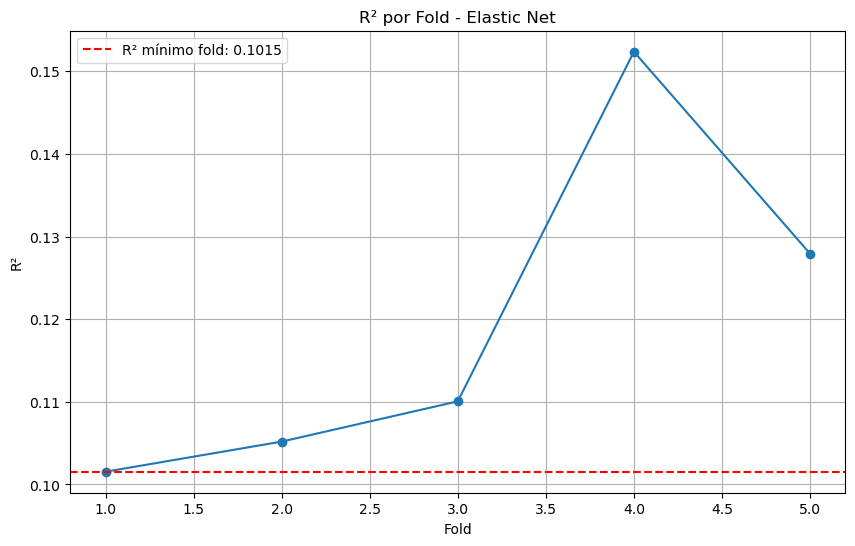

(ElasticNetCV(alphas=array([1.00000000e-04, 2.15443469e-04, 4.64158883e-04, 1.00000000e-03,
        2.15443469e-03, 4.64158883e-03, 1.00000000e-02, 2.15443469e-02,
        4.64158883e-02, 1.00000000e-01, 2.15443469e-01, 4.64158883e-01,
        1.00000000e+00, 2.15443469e+00, 4.64158883e+00, 1.00000000e+01,
        2.15443469e+01, 4.64158883e+01, 1.00000000e+02, 2.15443469e+02,
        4.64158883e+02, 1.00000000e+03, 2.15443469e+03, 4.64158883e+03,
        1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.0969891017284027,
 2241833.705893516)

In [200]:
# Elastic

# Definimos las variables predictoras (todas)
dfx = df_merged_final[df_merged_final.columns[7:]].copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

elasticnet_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 25), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)


Replicamos el analisis como hicimos antes sobre registros filtrados para evaluar su respuesta

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1612295.5298, R² Test: 0.1275


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A colu

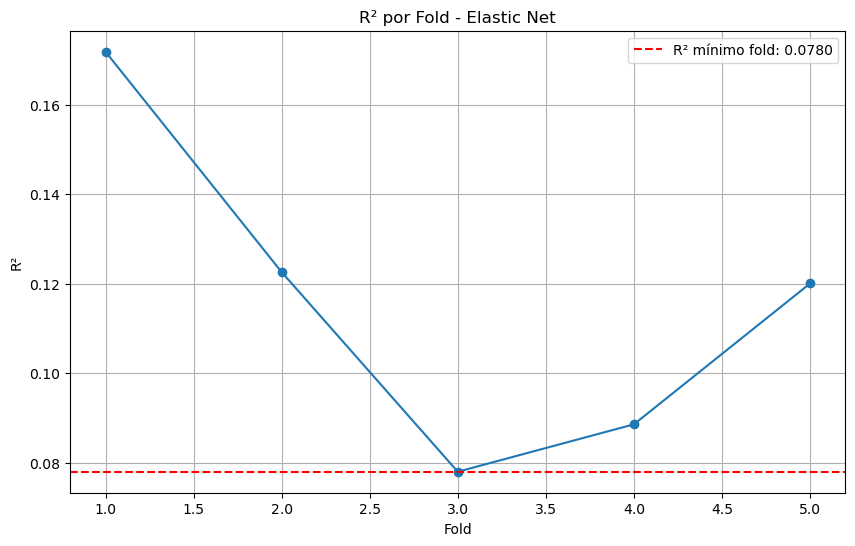

(ElasticNetCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.682695...
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.12746225123017074,
 1612295.5298265761)

In [202]:

x,y = filtro_provincial(dfx,dfy,'Córdoba')
elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.830e+04, tolerance: 1.060e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.467e+04, tolerance: 1.043e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 340587.7832, R² Test: 0.2354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A colu

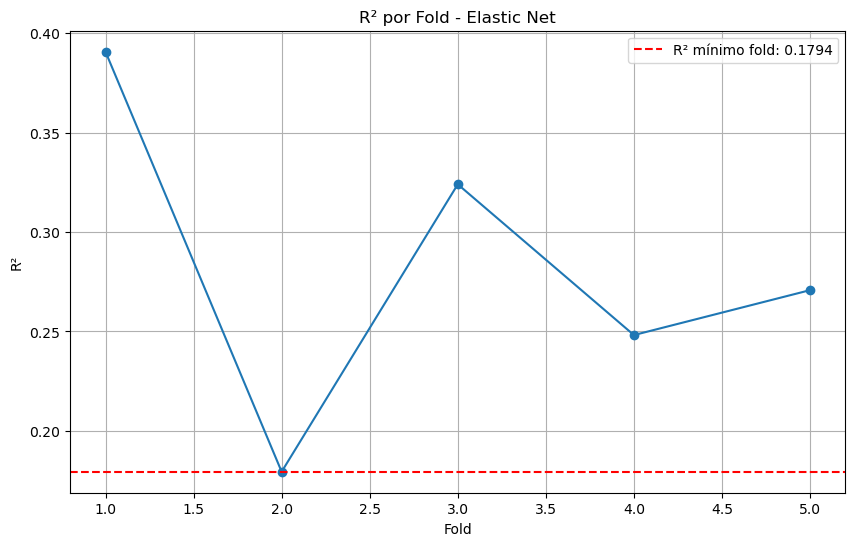

(ElasticNetCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.682695...
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.2353933307260816,
 340587.78322900005)

In [204]:

# Evaluamos el modelo con datos relativos a un mismo cultivo en todo el set de datos
# Evaluamos por cultivo especifico

x,y = filtro_cultivo(dfx,dfy,'Soja total')
elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 21.544347, Mejor l1_ratio: 0.90
MSE Test: 211457.2186, R² Test: 0.5764


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A colu

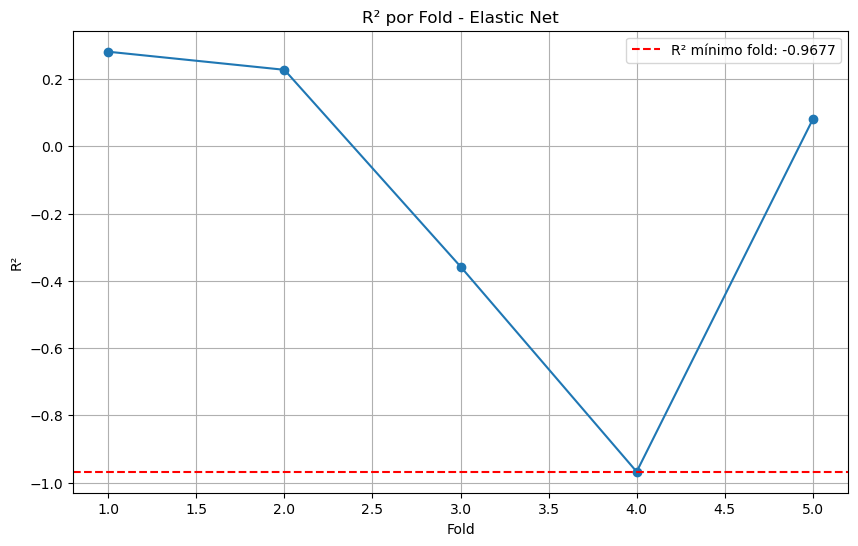

(ElasticNetCV(alphas=array([1.00000000e-04, 2.15443469e-04, 4.64158883e-04, 1.00000000e-03,
        2.15443469e-03, 4.64158883e-03, 1.00000000e-02, 2.15443469e-02,
        4.64158883e-02, 1.00000000e-01, 2.15443469e-01, 4.64158883e-01,
        1.00000000e+00, 2.15443469e+00, 4.64158883e+00, 1.00000000e+01,
        2.15443469e+01, 4.64158883e+01, 1.00000000e+02, 2.15443469e+02,
        4.64158883e+02, 1.00000000e+03, 2.15443469e+03, 4.64158883e+03,
        1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.5763967489263442,
 211457.2185894385)

In [206]:

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')
elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 25), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)

## PCR

Número óptimo de componentes: 18
MSE Test: 2260346.7519, R² Test: 0.0895


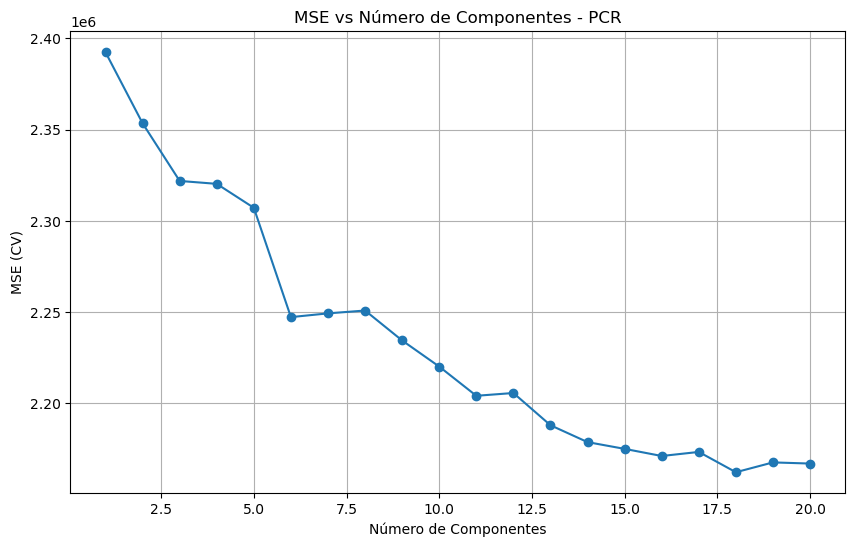

Número óptimo de componentes: 18
MSE Test: 377318.6765, R² Test: 0.1529


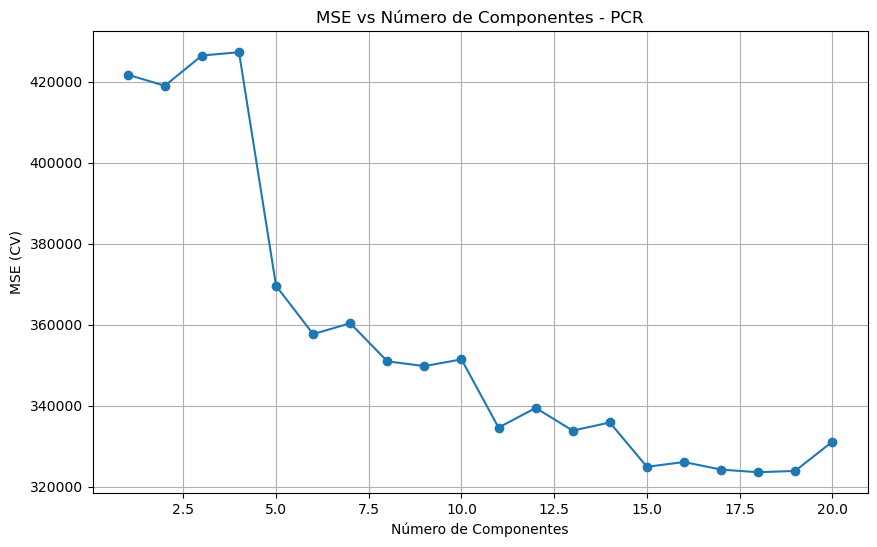

Número óptimo de componentes: 20
MSE Test: 1675900.6028, R² Test: 0.0930


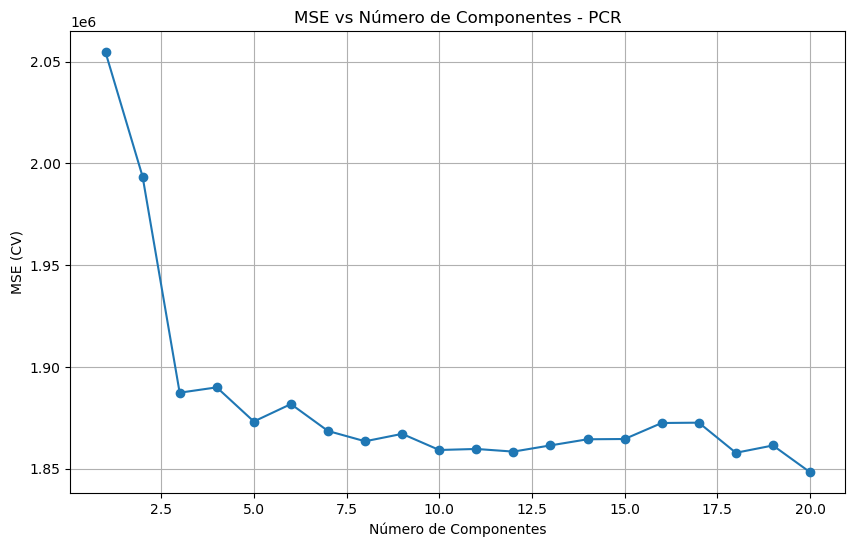

Número óptimo de componentes: 3
MSE Test: 301384.1913, R² Test: 0.3962


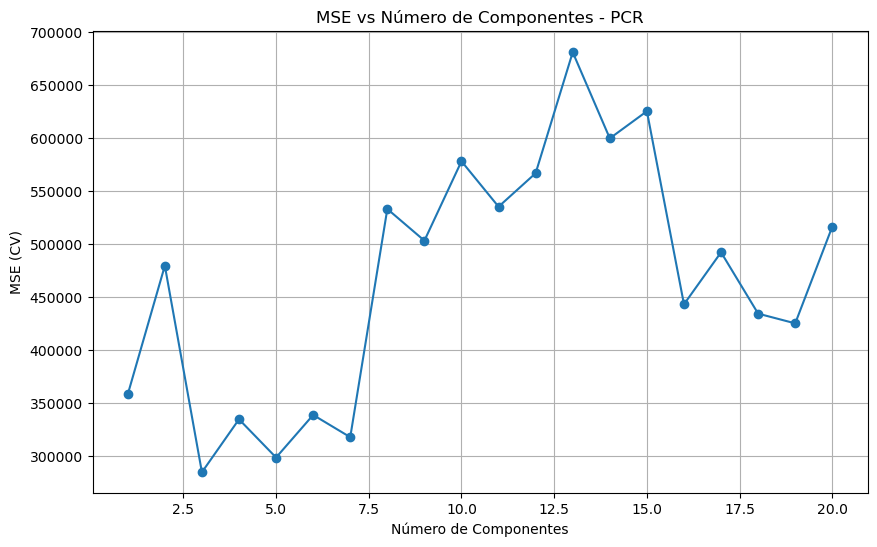

(LinearRegression(), 0.3962498698136857, 301384.1912889632)

In [208]:
# PCR
pcr_modelo(dfx, dfy, max_components=20, test_size=0.2, random_state=42, n_splits=5)

# Evaluamos el modelo con datos relativos a un mismo cultivo en todo el set de datos

# Evaluamos por cultivo especifico

x,y = filtro_cultivo(dfx,dfy,'Soja total')

pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)


# Evaluamos el modelo con datos relativos a una misma provincia en todo el set de datos

x,y = filtro_provincial(dfx,dfy,'Córdoba')

pcr_modelo( x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)


# Evaluamos sobre el par provincia - Cultivo

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')

pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)

## PLS

Número óptimo de componentes: 3
MSE Test: 2240454.2787, R² Test: 0.0975


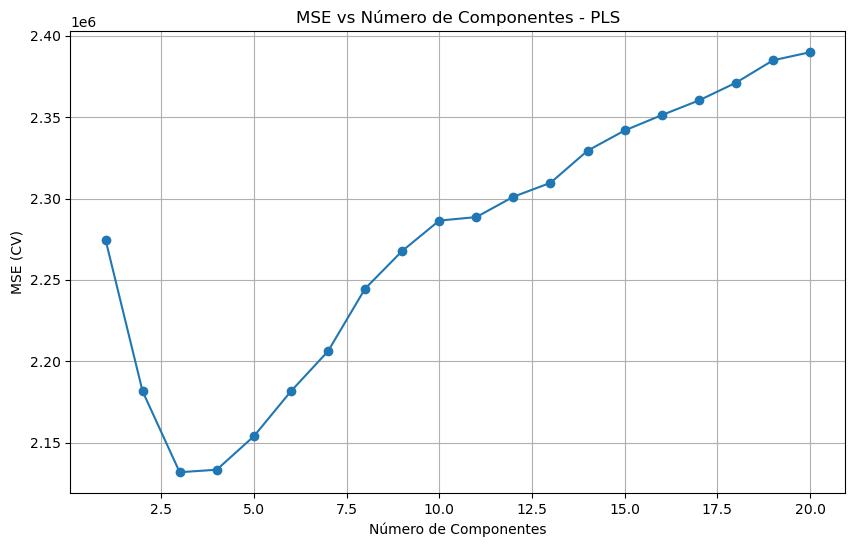

Número óptimo de componentes: 3
MSE Test: 348080.6548, R² Test: 0.2186


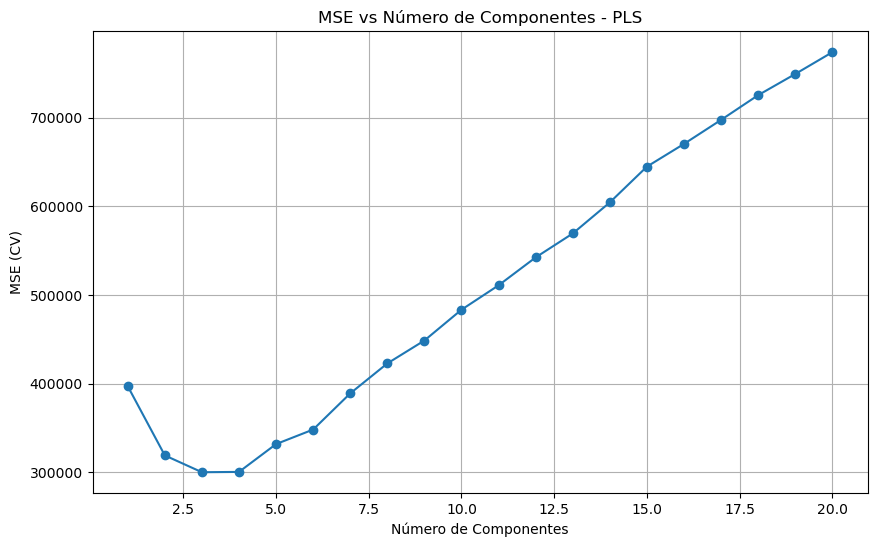

Número óptimo de componentes: 1
MSE Test: 1690734.9272, R² Test: 0.0850


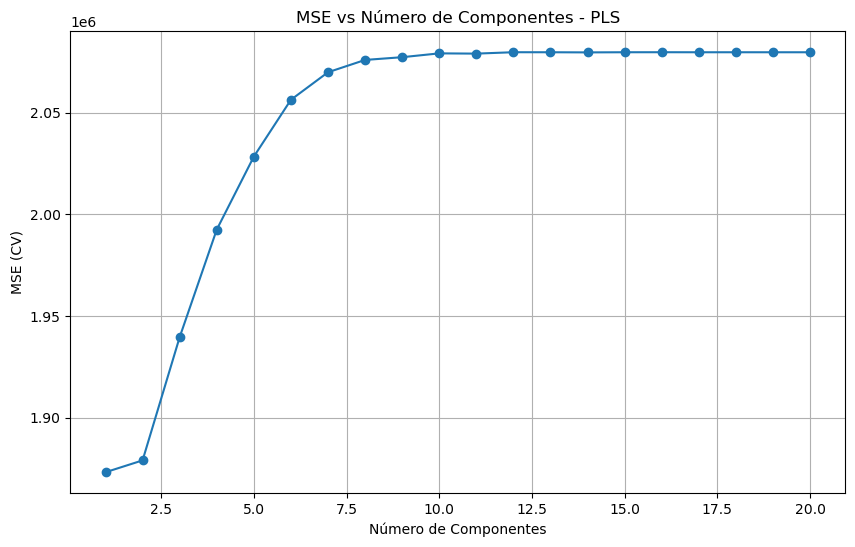

Número óptimo de componentes: 2
MSE Test: 260825.4635, R² Test: 0.4775


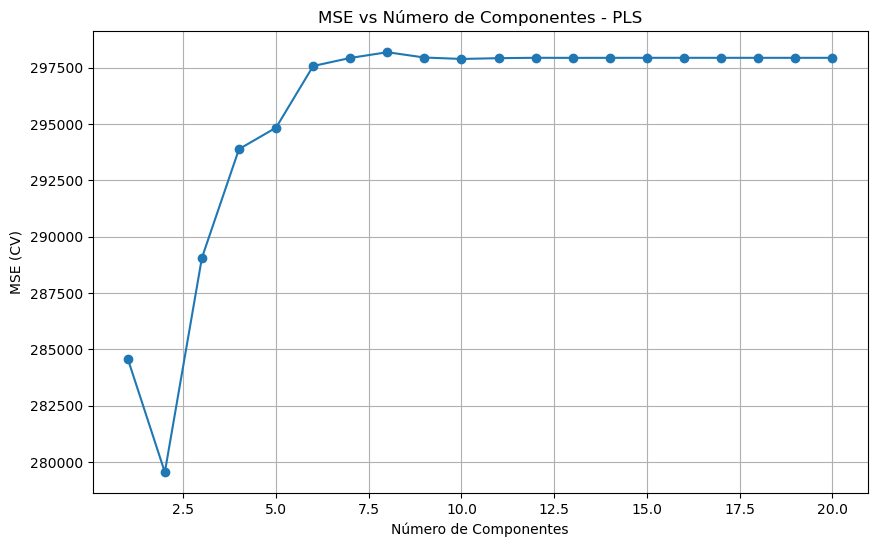

(PLSRegression(), 0.47749944384599197, 260825.46353391875)

In [211]:
pls_modelo(dfx, dfy, max_components=20, test_size=0.2, random_state=42, n_splits=5)

# Evaluamos el modelo para un cultivo especifico
x,y = filtro_cultivo(dfx,dfy,'Soja total')
pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)


# Evaluamos para una provincia especifica

# Evaluamos el modelo para un cultivo especifico
x,y = filtro_provincial(dfx,dfy,'Córdoba')
pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)

# Evaluamos el modelo para el par cultivo provincia
x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')
pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)

In [227]:
pd.DataFrame(dfx).to_csv("../Metricas/Experimento1/predictores_992.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento1/objetivo_992.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento1/set_completo.csv")

Resumen Metricas para 992 Predictores (Experimento 1:

Todos
PLS
MSE Test: 2240454.2787, R² Test: 0.0975
PCR
MSE Test: 2260346.7519, R² Test: 0.0895
Elastic Net
MSE Test: 2241833.7059, R² Test: 0.0970



Cultivo
PLS
MSE Test: 348080.6548, R² Test: 0.2186
PCR
MSE Test: 377318.6765, R² Test: 0.1529
Elastic Net
MSE Test: 340587.7832, R² Test: 0.2354



Provincia
PLS
MSE Test: 1690734.9272, R² Test: 0.0850
PCR
MSE Test: 1675900.6028, R² Test: 0.0930
Elastic Net
MSE Test: 1612295.5298, R² Test: 0.1275


Dupla
PLS
MSE Test: 260825.4635, R² Test: 0.4775
PCR
MSE Test: 301384.1913, R² Test: 0.3962
Elastic Net
MSE Test: 211457.2186, R² Test: 0.5764



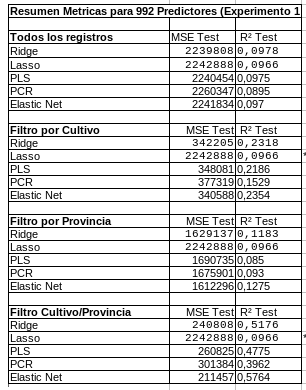

# REDUCCION DE DIMENCIONALIDAD

## Analisis de correlación entre predictores

### Experimento 2

In [1037]:
# Vamos a buscar las variables con alto nivel de correlación entre ellas para evitar la redundancia y sobreajuste

# Las primera columnas representan posibles variables objetivos
df_predictores = df_merged_final[df_merged_final.columns[7:]].copy()

# Obtenemos la matriz de correlacion entre los predictores
cor_matrix = df_predictores.corr().abs()

# Definimos un umbral de correlación el cual consideramos suficientemente alto como para descartar variables
umbral = 0.95

# Buscamos los valores de la diagonal superior (podria haber sido la inferior)
upper = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))

# Encontrar columnas con correlación mayor al umbral
columnas_a_eliminar = [col for col in upper.columns if any(upper[col] > umbral)]


print(f"Sobre un total de {df_predictores.shape[1]} predictores, hay {len(columnas_a_eliminar)} predictores con un valor de correlación superior a {umbral}")


Sobre un total de 992 predictores, hay 279 predictores con un valor de correlación superior a 0.95


In [217]:
print("Las columnas que se podrian desestimar basados en su alto nivel de correlación son:")

print(columnas_a_eliminar)

Las columnas que se podrian desestimar basados en su alto nivel de correlación son:
['10_Humedad_Media_8_14_20_median', '10_Humedad_Media_8_14_20_sum', '10_Precipitacion_Pluviometrica_rango_diario', '10_Precipitacion_Pluviometrica_skew', '10_Precipitacion_Pluviometrica_std', '10_Precipitacion_Pluviometrica_sum', '10_Rocio_Medio_median', '10_Temperatura_Abrigo_150cm_Maxima_median', '10_Temperatura_Abrigo_150cm_Maxima_sum', '10_Temperatura_Abrigo_150cm_Minima_median', '10_Temperatura_Abrigo_150cm_Minima_sum', '10_Temperatura_Abrigo_150cm_median', '10_Temperatura_Abrigo_150cm_sum', '10_Tesion_Vapor_Media_max', '10_Tesion_Vapor_Media_mean', '10_Tesion_Vapor_Media_median', '10_Tesion_Vapor_Media_sum', '10_Velocidad_Viento_200cm_Media_median', '10_Velocidad_Viento_200cm_Media_rango_diario', '10_Velocidad_Viento_200cm_Media_std', '10_Velocidad_Viento_200cm_Media_sum', '11_Humedad_Media_8_14_20_median', '11_Humedad_Media_8_14_20_sum', '11_Precipitacion_Pluviometrica_rango_diario', '11_Precipit

In [1039]:
# Filtramos el dataframe quitando las columnas con alto indice de correlación
df_predictores = df_predictores.drop(columns=columnas_a_eliminar)


In [1041]:
df_predictores.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4065 entries, 0 to 4064
Columns: 713 entries, 10_Humedad_Media_8_14_20_kurtosis to ALLSKY_SFC_UV_INDEX_skew
dtypes: float64(713)
memory usage: 22.1 MB


In [1043]:
pd.DataFrame(df_predictores).to_csv("../Metricas/Experimento2/predictores_713.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento2/objetivo_713.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento2/set_completo.csv")

### METRICAS CON DIMENCIONALIDAD REDUCIDA SEGUN CORRELACION

Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 2246616.9977
R2 en Test: 0.0951


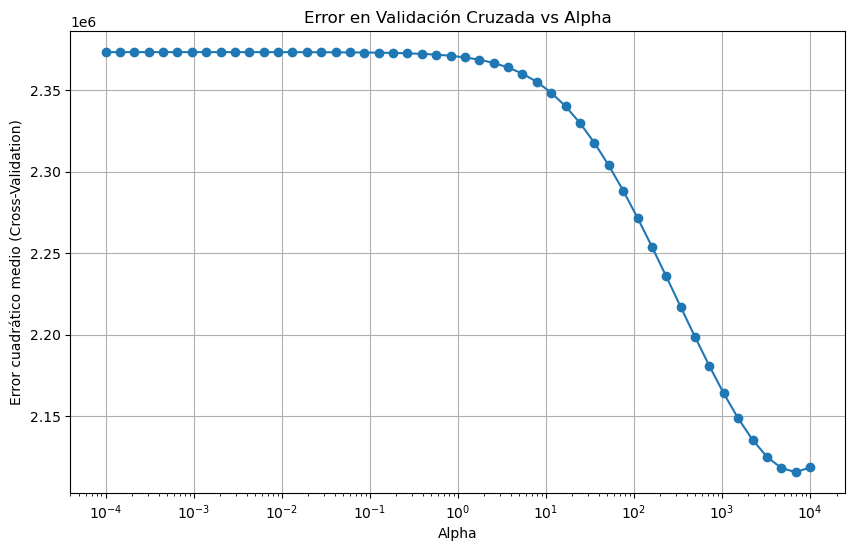

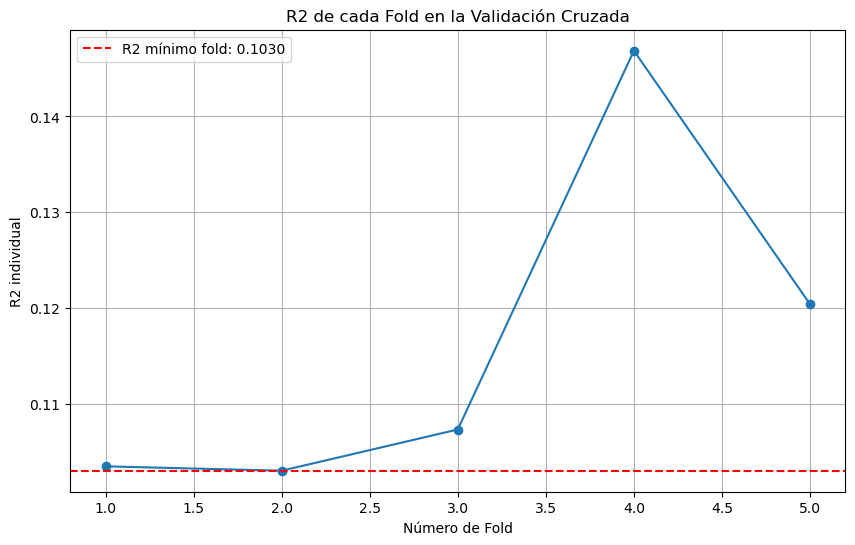

Cantidad de predictores: 713


In [232]:
# Evaluamos ridge para todo el set de datos completo

# Definimos las variables predictoras (todas)
dfx = df_predictores.copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]
ridge_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)


print(f"Cantidad de predictores: {len(df_predictores.columns)}")



Mejor valor de alpha encontrado: 719.685673
MSE en Test: 348023.8976
R2 en Test: 0.2187


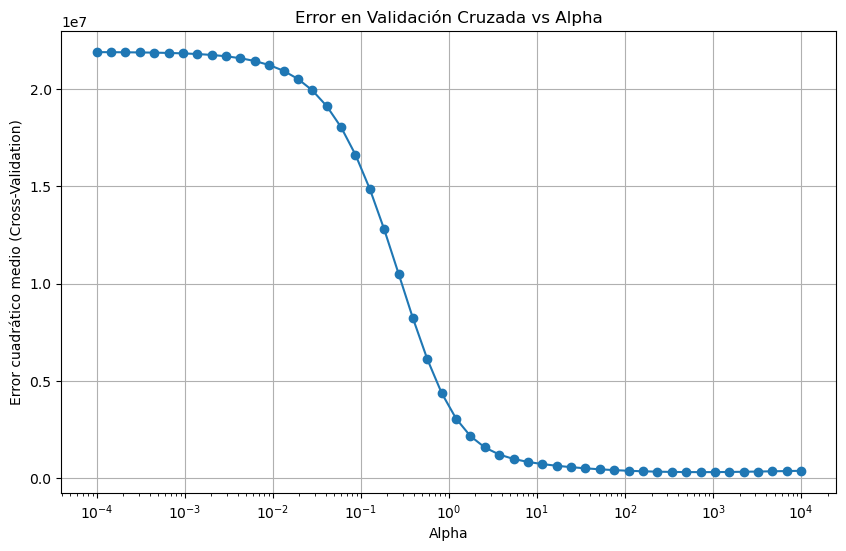

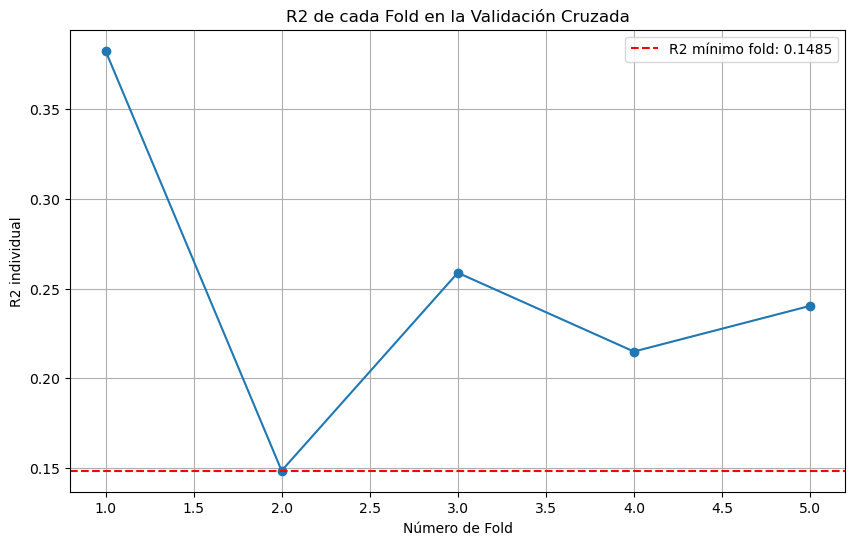

Registros: (368, 1)


In [234]:
# Evaluamos para un cultivo especifico en todas las provincias

# Para mantener el seguimiento y volver mas simple la lectura, volvemos a definir las variables
# Definimos las variables predictoras (todas)
dfx = df_predictores.copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_cultivo(dfx,dfy,'Soja total')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)
print(f"Registros: {y.shape}")



Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 1633233.3933
R2 en Test: 0.1161


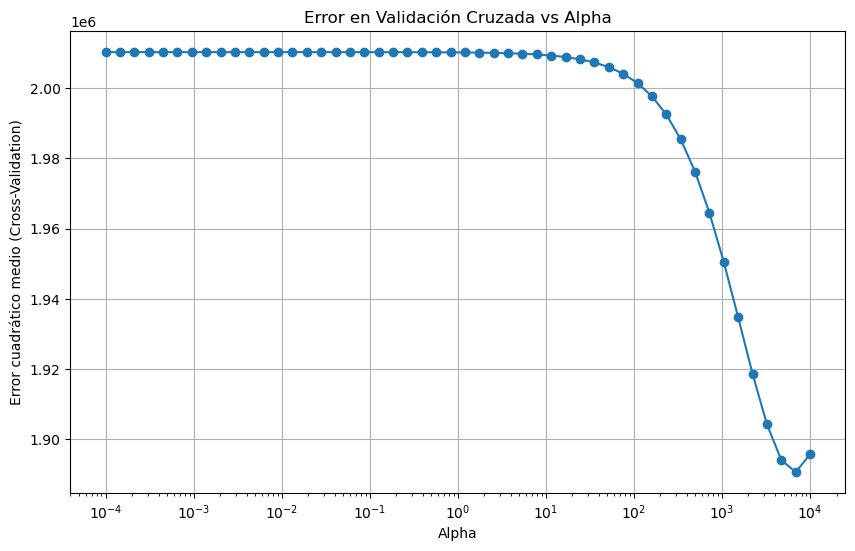

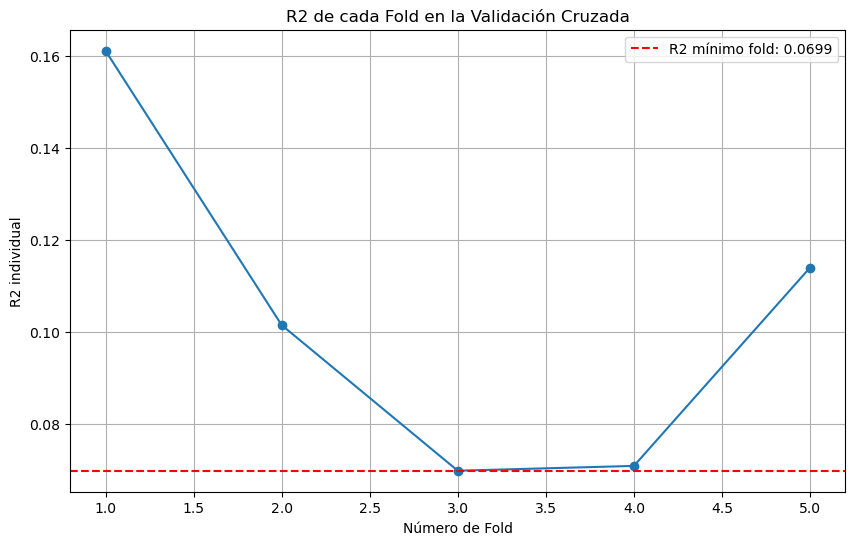

Registros: (735, 1)


In [236]:
# Definimos las variables predictoras (todas)
dfx = df_predictores.copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]


x,y = filtro_provincial(dfx,dfy,'Córdoba')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)
print(f"Registros: {y.shape}")



Mejor valor de alpha encontrado: 75.431201
MSE en Test: 261705.3669
R2 en Test: 0.4757


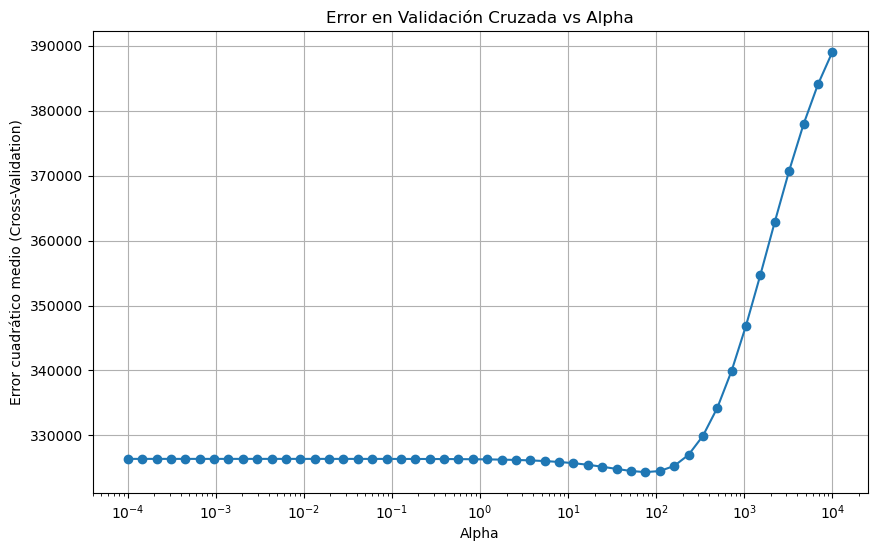

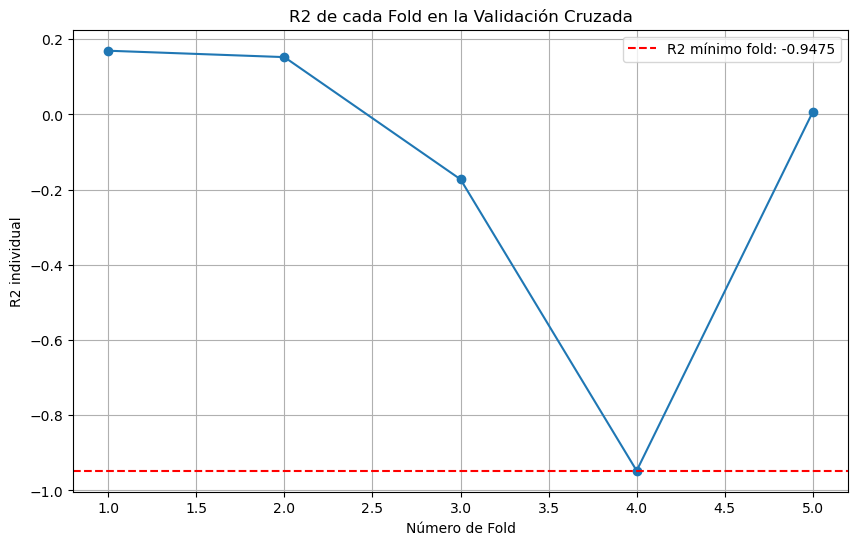

Registros: (53, 1)


In [238]:
# Definimos las variables predictoras (todas)
dfx = df_predictores.copy()
# Definimos la variable objetivo (Rendimiento)
dfy = df_merged_final[df_merged_final.columns[6]]

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')

ridge_modelo(x, y['Rendimiento'], alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5)

print(f"Registros: {y.shape}")



##LASSO

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1201589.5238542557, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 768409.0092306137, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 833401.8217792511, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2259563.0808
R2 en Test: 0.0898


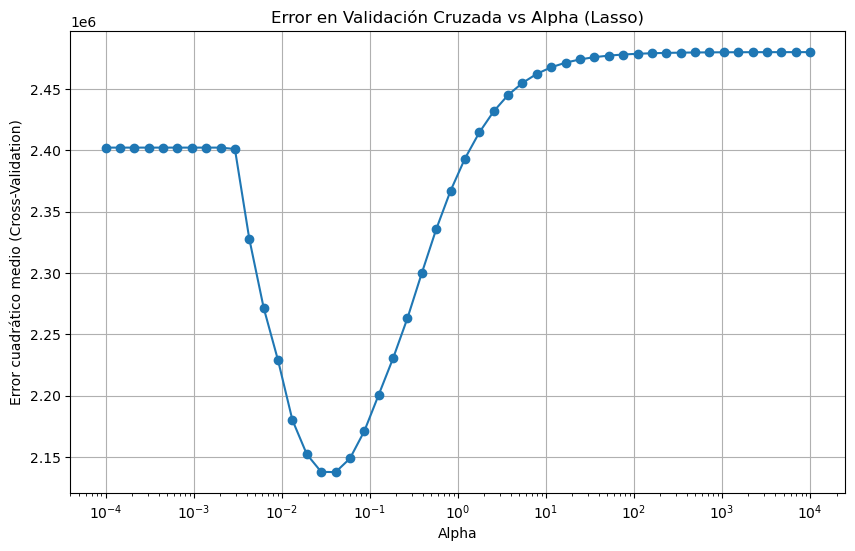

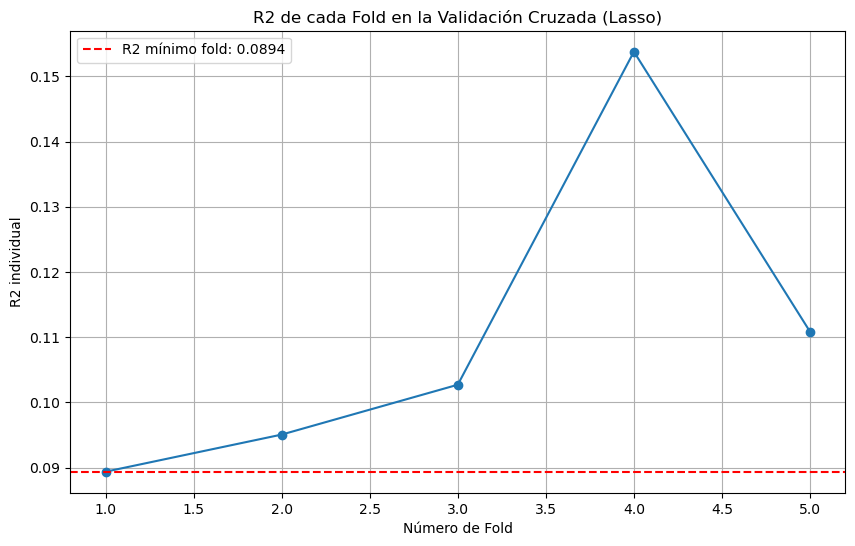

(LassoCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.68269580e-0...
        3.72759372e+00, 5.42867544e+00, 7.90604321e+00, 1.15139540e+01,
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
         cv=5, n_jobs=-1, random_state=42),
 2259563.080751364,
 0.08984770730914171)

In [240]:
lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000)

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 768409.0092306137, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1201589.5238542557, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 833401.8217792511, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2259563.0808
R2 en Test: 0.0898


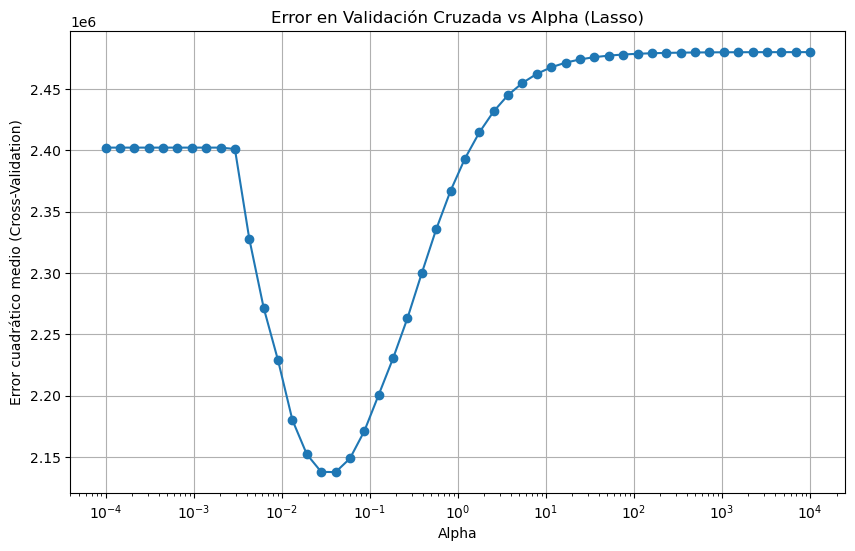

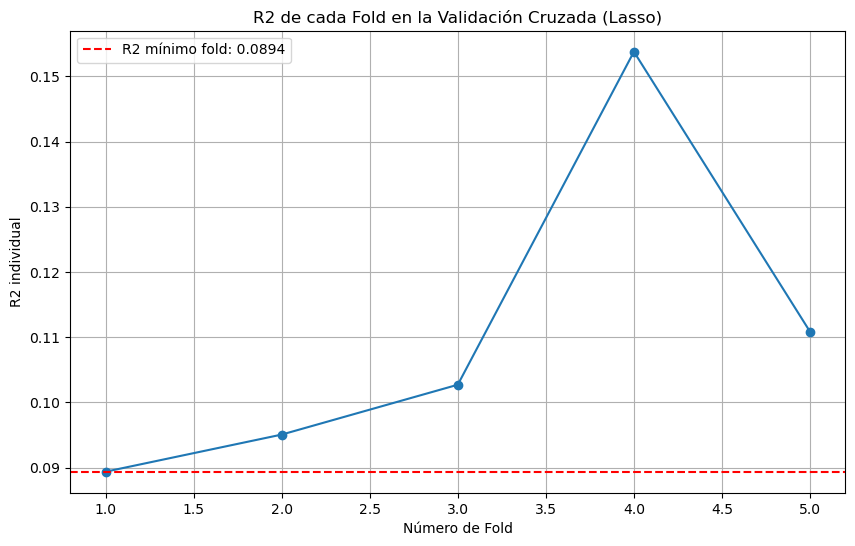

Registros: (368, 1)


In [242]:
x,y = filtro_cultivo(dfx,dfy,'Soja total')

lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)
print(f"Registros: {y.shape}")


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 768409.0092306137, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1201589.5238542557, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 662372.4551324844, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2259563.0808
R2 en Test: 0.0898


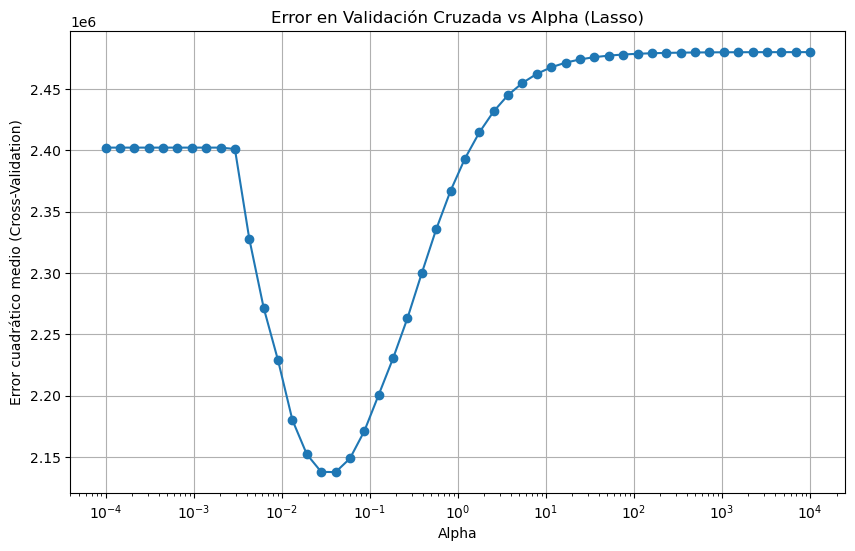

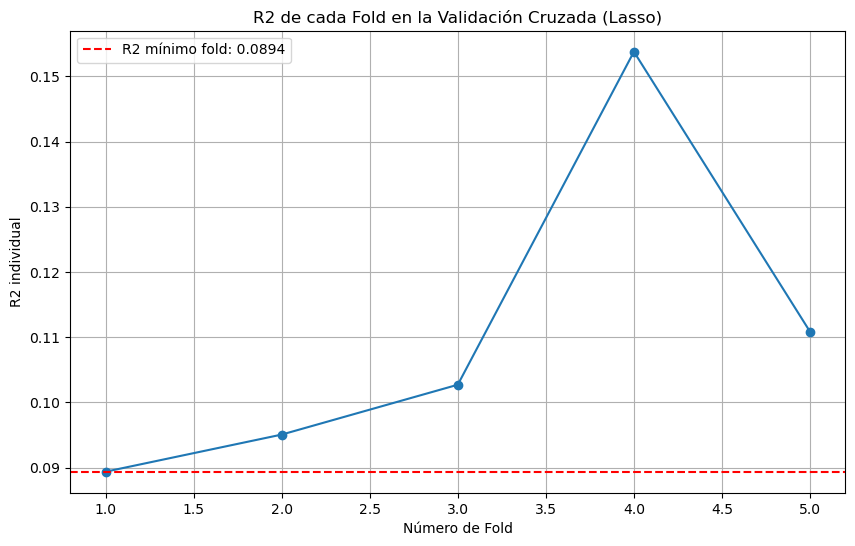

Registros: (735, 1)


In [244]:
x,y = filtro_provincial(dfx,dfy,'Córdoba')

lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)
print(f"Registros: {y.shape}")


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 768409.0092306137, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1201589.5238542557, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 662372.4551324844, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2259563.0808
R2 en Test: 0.0898


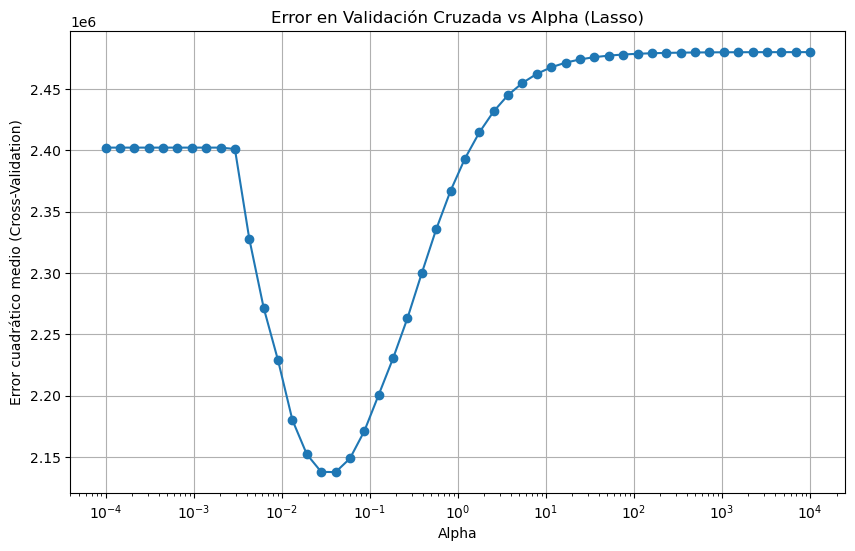

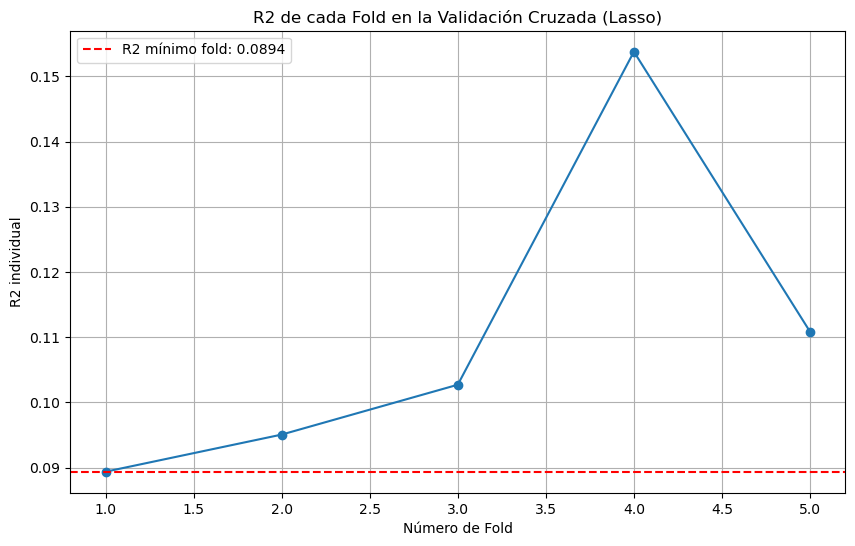

Registros: (55, 1)


In [246]:
# Repetimos la prueba sobre la dupla cultivo/provincia

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Maíz','Córdoba')

lasso_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=100000)

print(f"Registros: {y.shape}")


## ELASTIC


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 202906095.64312744, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 243915379.0169654, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 267034668.52722454, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mo

Mejor alpha: 10.000000, Mejor l1_ratio: 0.80
MSE Test: 2249019.6796, R² Test: 0.0941


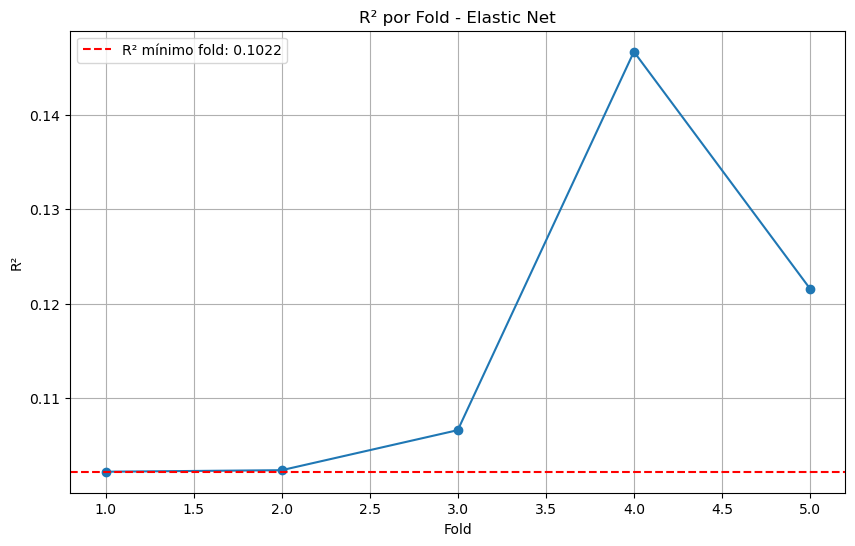

(ElasticNetCV(alphas=array([1.00000000e-04, 2.15443469e-04, 4.64158883e-04, 1.00000000e-03,
        2.15443469e-03, 4.64158883e-03, 1.00000000e-02, 2.15443469e-02,
        4.64158883e-02, 1.00000000e-01, 2.15443469e-01, 4.64158883e-01,
        1.00000000e+00, 2.15443469e+00, 4.64158883e+00, 1.00000000e+01,
        2.15443469e+01, 4.64158883e+01, 1.00000000e+02, 2.15443469e+02,
        4.64158883e+02, 1.00000000e+03, 2.15443469e+03, 4.64158883e+03,
        1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.094094590599474,
 2249019.6796434857)

In [252]:
elasticnet_modelo(dfx, dfy, alphas=np.logspace(-4, 4, 25), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1626010.5343, R² Test: 0.1200


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A colu

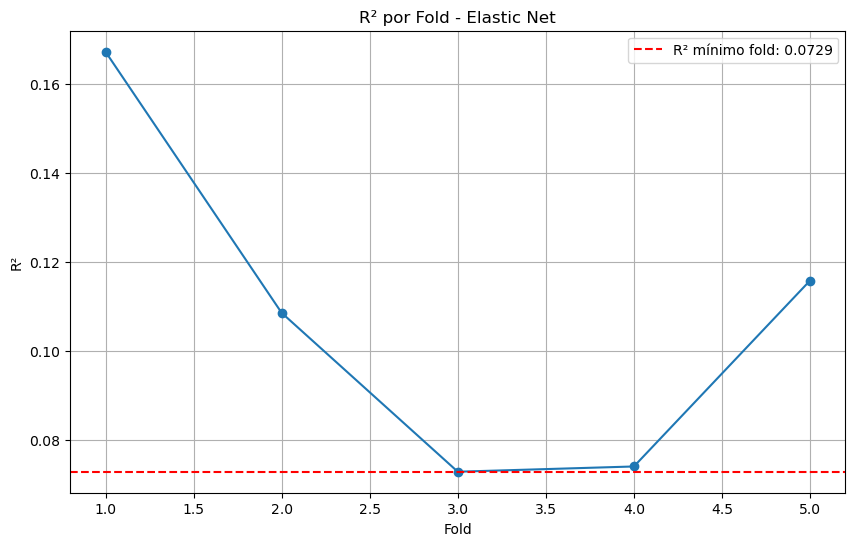

(ElasticNetCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.682695...
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.12004000208354149,
 1626010.5342917026)

In [254]:

x,y = filtro_provincial(dfx,dfy,'Córdoba')
elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)



/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.303e+04, tolerance: 1.043e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.226e+04, tolerance: 1.060e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 347823.3813, R² Test: 0.2191


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A colu

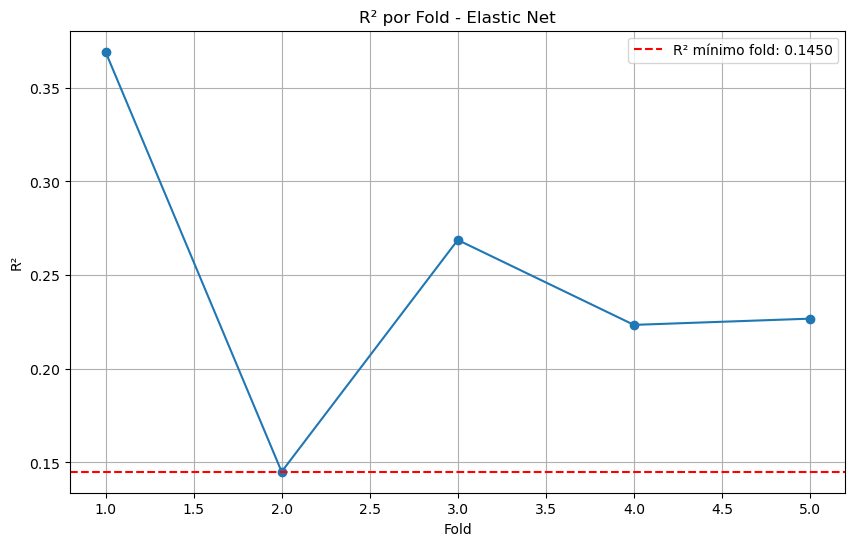

(ElasticNetCV(alphas=array([1.00000000e-04, 1.45634848e-04, 2.12095089e-04, 3.08884360e-04,
        4.49843267e-04, 6.55128557e-04, 9.54095476e-04, 1.38949549e-03,
        2.02358965e-03, 2.94705170e-03, 4.29193426e-03, 6.25055193e-03,
        9.10298178e-03, 1.32571137e-02, 1.93069773e-02, 2.81176870e-02,
        4.09491506e-02, 5.96362332e-02, 8.68511374e-02, 1.26485522e-01,
        1.84206997e-01, 2.682695...
        1.67683294e+01, 2.44205309e+01, 3.55648031e+01, 5.17947468e+01,
        7.54312006e+01, 1.09854114e+02, 1.59985872e+02, 2.32995181e+02,
        3.39322177e+02, 4.94171336e+02, 7.19685673e+02, 1.04811313e+03,
        1.52641797e+03, 2.22299648e+03, 3.23745754e+03, 4.71486636e+03,
        6.86648845e+03, 1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.21914968712975869,
 347823.3813297689)

In [256]:
# Evaluamos el modelo con datos relativos a un mismo cultivo en todo el set de datos
# Evaluamos por cultivo especifico

x,y = filtro_cultivo(dfx,dfy,'Soja total')
elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.154435, Mejor l1_ratio: 0.10
MSE Test: 261376.9120, R² Test: 0.4764


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A colu

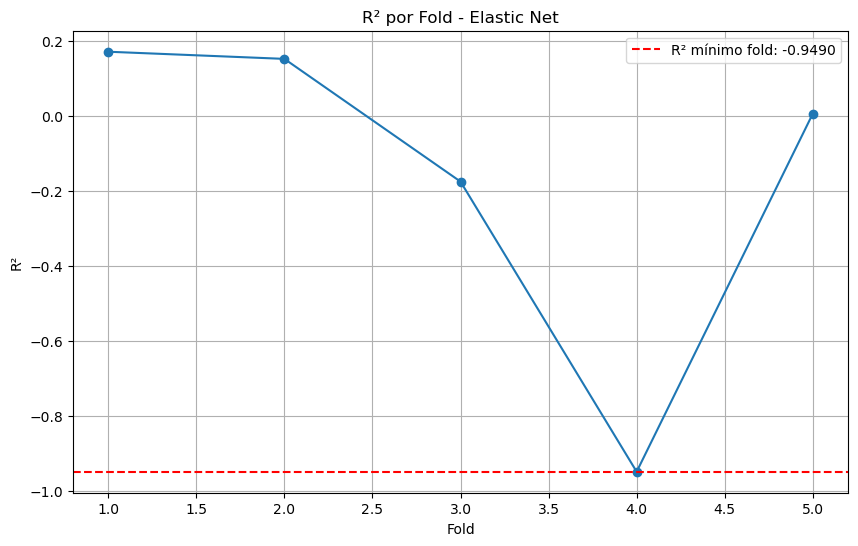

(ElasticNetCV(alphas=array([1.00000000e-04, 2.15443469e-04, 4.64158883e-04, 1.00000000e-03,
        2.15443469e-03, 4.64158883e-03, 1.00000000e-02, 2.15443469e-02,
        4.64158883e-02, 1.00000000e-01, 2.15443469e-01, 4.64158883e-01,
        1.00000000e+00, 2.15443469e+00, 4.64158883e+00, 1.00000000e+01,
        2.15443469e+01, 4.64158883e+01, 1.00000000e+02, 2.15443469e+02,
        4.64158883e+02, 1.00000000e+03, 2.15443469e+03, 4.64158883e+03,
        1.00000000e+04]),
              cv=5,
              l1_ratio=array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]),
              max_iter=100000, n_jobs=-1, random_state=42),
 0.47639475049549485,
 261376.91204782485)

In [258]:
x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')
elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 25), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5)


## PCR

Número óptimo de componentes: 17
MSE Test: 2285946.1916, R² Test: 0.0792


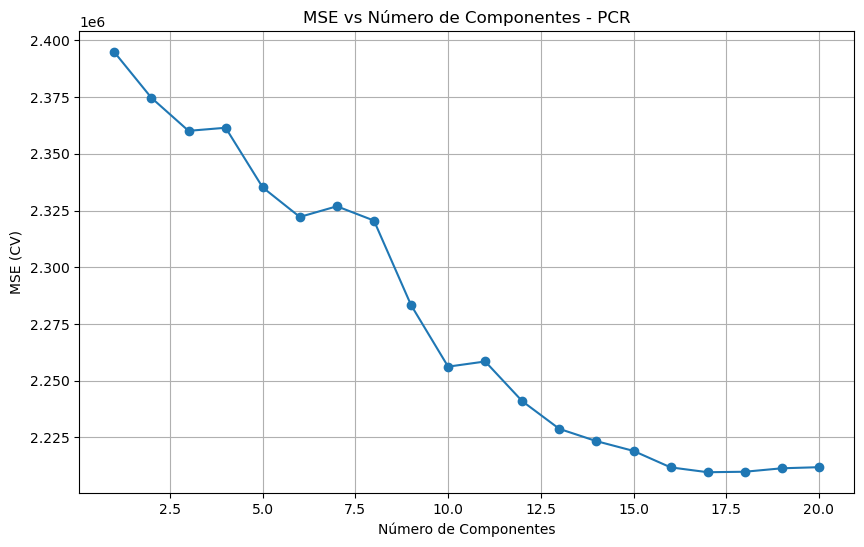

Número óptimo de componentes: 15
MSE Test: 417304.2544, R² Test: 0.0632


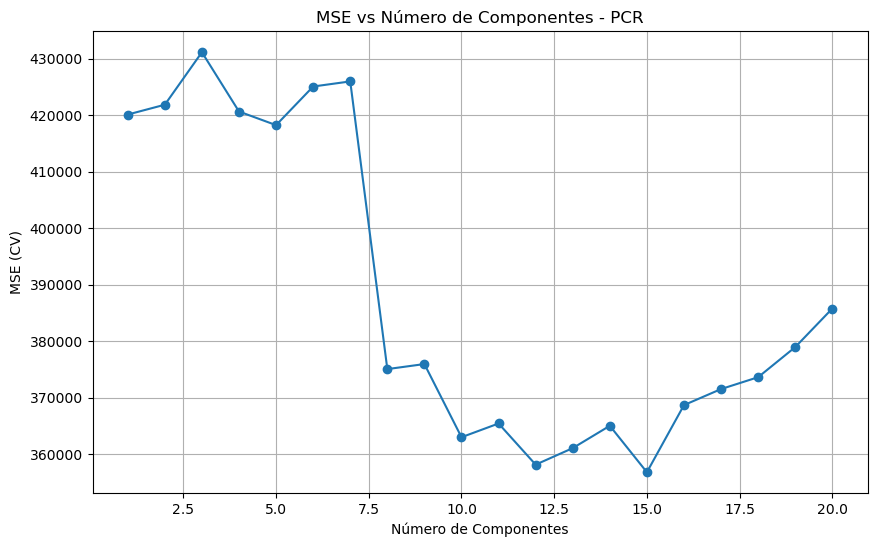

Número óptimo de componentes: 20
MSE Test: 1584132.2616, R² Test: 0.1427


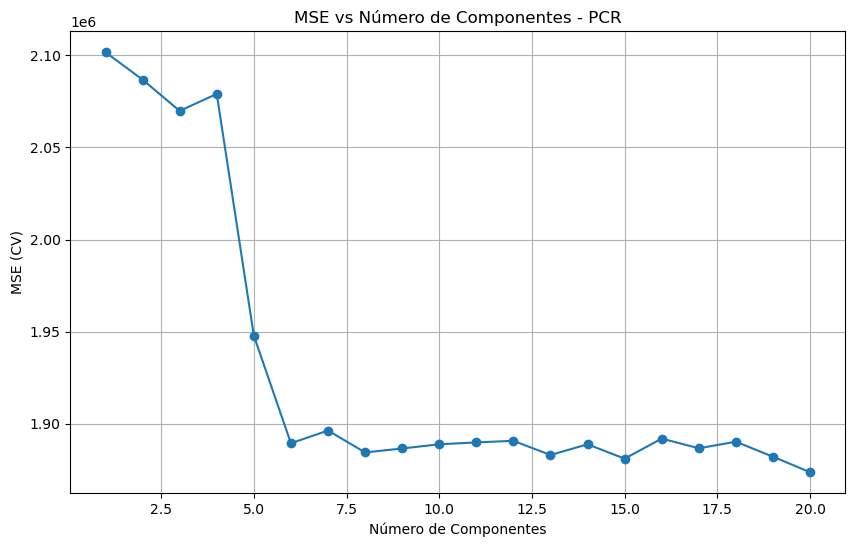

Número óptimo de componentes: 5
MSE Test: 374497.5885, R² Test: 0.2498


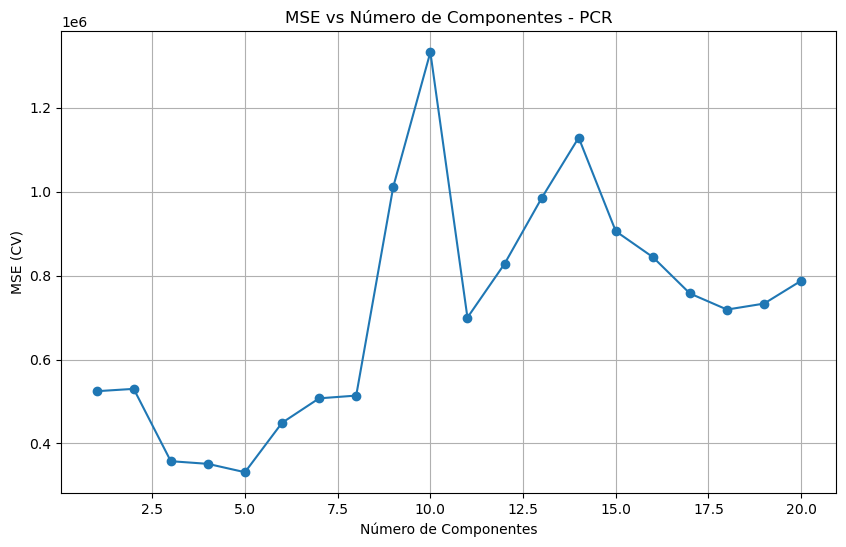

(LinearRegression(), 0.24978491130888558, 374497.58847782784)

In [260]:
# PCR
pcr_modelo(dfx, dfy, max_components=20, test_size=0.2, random_state=42, n_splits=5)

# Evaluamos el modelo con datos relativos a un mismo cultivo en todo el set de datos

# Evaluamos por cultivo especifico

x,y = filtro_cultivo(dfx,dfy,'Soja total')

pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)


# Evaluamos el modelo con datos relativos a una misma provincia en todo el set de datos

x,y = filtro_provincial(dfx,dfy,'Córdoba')

pcr_modelo( x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)


# Evaluamos sobre el par provincia - Cultivo

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')

pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)





## PLS

Número óptimo de componentes: 4
MSE Test: 2264548.2066, R² Test: 0.0878


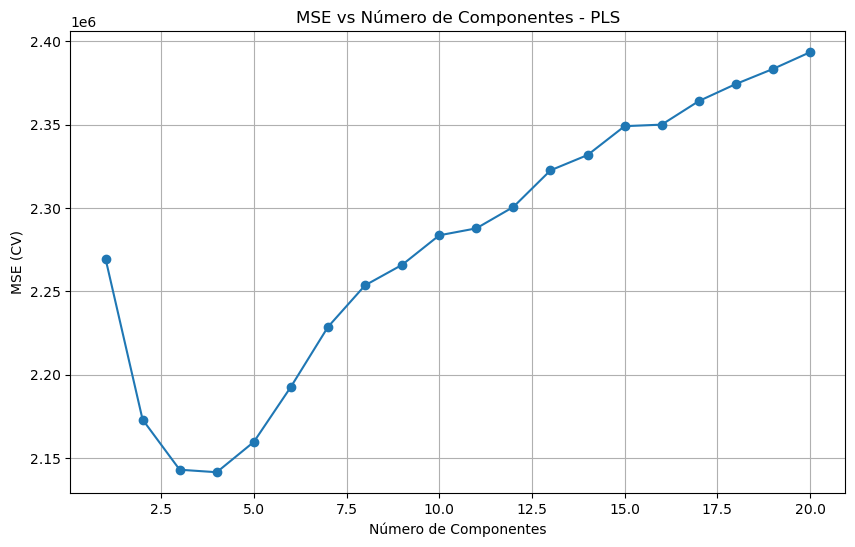

Número óptimo de componentes: 3
MSE Test: 350897.4969, R² Test: 0.2122


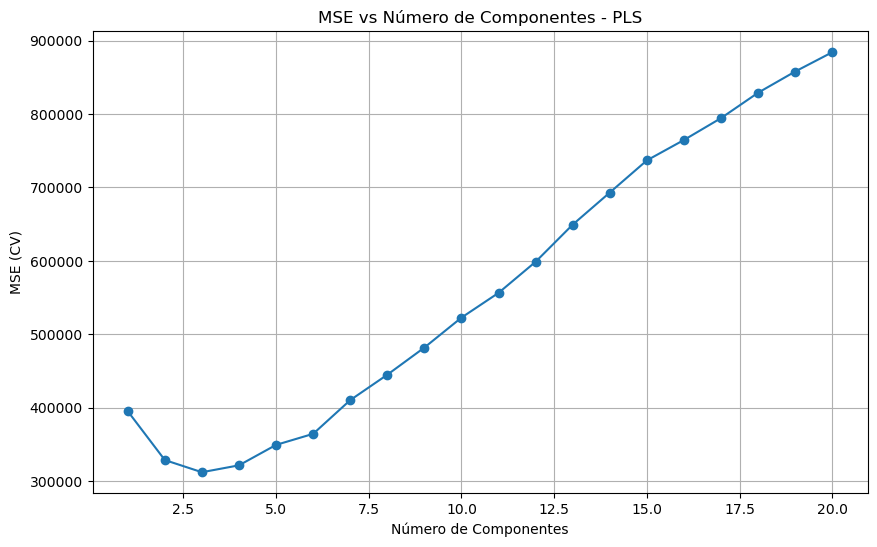

Número óptimo de componentes: 2
MSE Test: 1641404.0701, R² Test: 0.1117


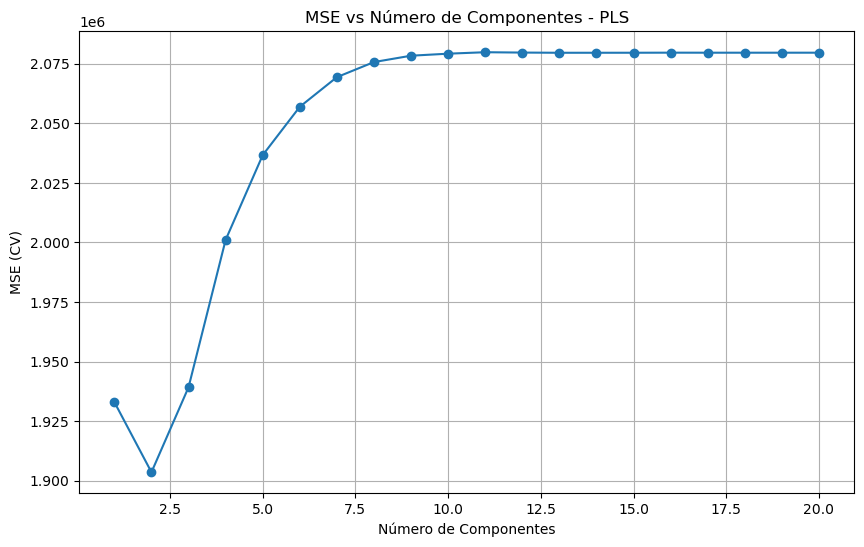

Número óptimo de componentes: 2
MSE Test: 269033.8941, R² Test: 0.4611


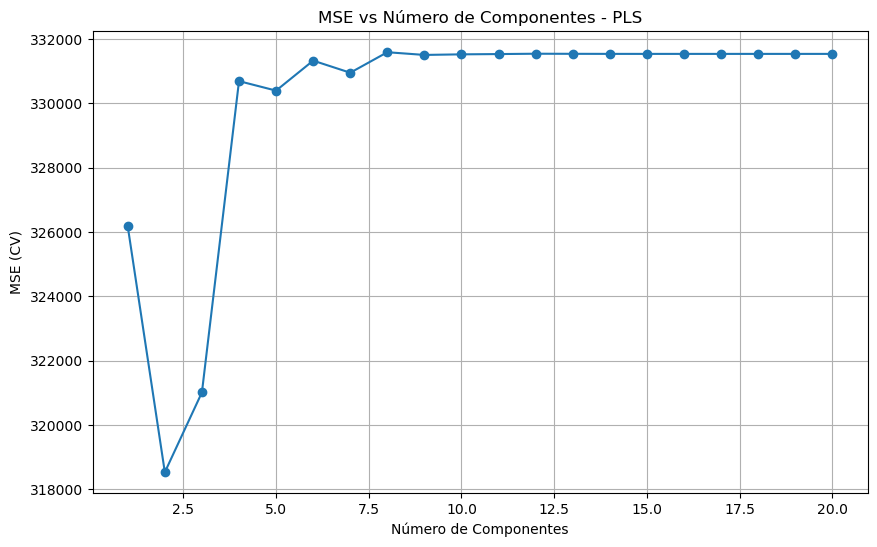

(PLSRegression(), 0.46105584411427447, 269033.89407370804)

In [262]:

pls_modelo(dfx, dfy, max_components=20, test_size=0.2, random_state=42, n_splits=5)

# Evaluamos el modelo para un cultivo especifico
x,y = filtro_cultivo(dfx,dfy,'Soja total')
pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)


# Evaluamos para una provincia especifica

# Evaluamos el modelo para un cultivo especifico
x,y = filtro_provincial(dfx,dfy,'Córdoba')
pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)

# Evaluamos el modelo para el par cultivo provincia
x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')
pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5)

## RESUMEN DE METRICAS

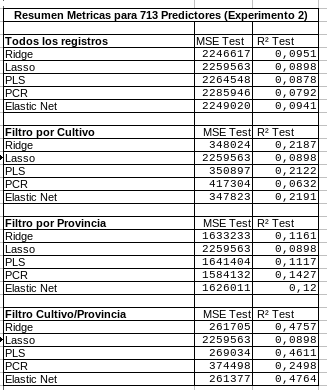

## Evaluación de significancia de predictores segun su varianza

In [267]:
# Vamos a evaluar la significancia de las columnas a partir de su varianza individual para esto debemos considerar sobre un mismo par Provincia Cultivo, ya que los registros se repetiran para un mismo año

x,y = filtro_por_cultivo_provincia(dfx,dfy,'Soja total','Córdoba')

# Umbral de varianza (por ejemplo 0.01, se puede ajustar)
umbral = 0.01

# Aplicar selector
selector = VarianceThreshold(threshold=umbral)
X_varianza_filtrada = selector.fit_transform(x)

# Obtener las columnas que se conservaron
columnas_con_varianza = x.columns[selector.get_support()]
df_filtrado = pd.DataFrame(X_varianza_filtrada, columns=columnas_con_varianza)

# Mostrar columnas con baja taza de varianza
columnas_eliminadas = x.columns[~selector.get_support()]
print("Columnas eliminadas por baja varianza:")
print(len(columnas_eliminadas))
print(columnas_eliminadas.tolist())


Columnas eliminadas por baja varianza:
26
['11_Precipitacion_Pluviometrica_median', '12_Precipitacion_Pluviometrica_median', '1_Precipitacion_Pluviometrica_median', '2_Precipitacion_Pluviometrica_median', '3_Precipitacion_Pluviometrica_median', '4_Precipitacion_Pluviometrica_median', '5_Precipitacion_Pluviometrica_median', '6_Precipitacion_Pluviometrica_median', '7_Precipitacion_Pluviometrica_median', '8_Precipitacion_Pluviometrica_median', '9_Precipitacion_Pluviometrica_median', 'ALLSKY_SFC_SW_DWN_skew', 'ALLSKY_SFC_SW_DWN_kurtosis', 'ALLSKY_SFC_UVA_min', 'ALLSKY_SFC_UVA_max', 'ALLSKY_SFC_UVA_std', 'ALLSKY_SFC_UVA_median', 'ALLSKY_SFC_UVA_kurtosis', 'ALLSKY_SFC_UVB_mean', 'ALLSKY_SFC_UVB_min', 'ALLSKY_SFC_UVB_max', 'ALLSKY_SFC_UVB_std', 'ALLSKY_SFC_UVB_median', 'ALLSKY_SFC_UVB_skew', 'ALLSKY_SFC_UV_INDEX_median', 'ALLSKY_SFC_UV_INDEX_skew']


In [269]:
x,y = filtro_provincial(dfx,dfy,'Córdoba')

# Umbral de varianza (por ejemplo 0.01, se puede ajustar)
umbral = 0.01

# Aplicar selector
selector = VarianceThreshold(threshold=umbral)
X_varianza_filtrada = selector.fit_transform(x)

# Obtener las columnas que se conservaron
columnas_con_varianza = x.columns[selector.get_support()]
df_filtrado = pd.DataFrame(X_varianza_filtrada, columns=columnas_con_varianza)

# Mostrar columnas con baja taza de varianza
columnas_eliminadas = x.columns[~selector.get_support()]
print("Columnas eliminadas por baja varianza:")
print(len(columnas_eliminadas))
print(columnas_eliminadas.tolist())


Columnas eliminadas por baja varianza:
26
['11_Precipitacion_Pluviometrica_median', '12_Precipitacion_Pluviometrica_median', '1_Precipitacion_Pluviometrica_median', '2_Precipitacion_Pluviometrica_median', '3_Precipitacion_Pluviometrica_median', '4_Precipitacion_Pluviometrica_median', '5_Precipitacion_Pluviometrica_median', '6_Precipitacion_Pluviometrica_median', '7_Precipitacion_Pluviometrica_median', '8_Precipitacion_Pluviometrica_median', '9_Precipitacion_Pluviometrica_median', 'ALLSKY_SFC_SW_DWN_skew', 'ALLSKY_SFC_SW_DWN_kurtosis', 'ALLSKY_SFC_UVA_min', 'ALLSKY_SFC_UVA_max', 'ALLSKY_SFC_UVA_std', 'ALLSKY_SFC_UVA_median', 'ALLSKY_SFC_UVA_kurtosis', 'ALLSKY_SFC_UVB_mean', 'ALLSKY_SFC_UVB_min', 'ALLSKY_SFC_UVB_max', 'ALLSKY_SFC_UVB_std', 'ALLSKY_SFC_UVB_median', 'ALLSKY_SFC_UVB_skew', 'ALLSKY_SFC_UV_INDEX_median', 'ALLSKY_SFC_UV_INDEX_skew']


In [271]:
x,y = filtro_cultivo(dfx,dfy,'Soja total')

# Umbral de varianza (por ejemplo 0.01, se puede ajustar)
umbral = 0.01

# Aplicar selector
selector = VarianceThreshold(threshold=umbral)
X_varianza_filtrada = selector.fit_transform(x)

# Obtener las columnas que se conservaron
columnas_con_varianza = x.columns[selector.get_support()]
df_filtrado = pd.DataFrame(X_varianza_filtrada, columns=columnas_con_varianza)

# Mostrar columnas con baja taza de varianza
columnas_eliminadas = x.columns[~selector.get_support()]
print("Columnas eliminadas por baja varianza:")
print(len(columnas_eliminadas))
print(columnas_eliminadas.tolist())


Columnas eliminadas por baja varianza:
15
['ALLSKY_SFC_SW_DWN_skew', 'ALLSKY_SFC_SW_DWN_kurtosis', 'ALLSKY_SFC_UVA_min', 'ALLSKY_SFC_UVA_max', 'ALLSKY_SFC_UVA_std', 'ALLSKY_SFC_UVA_median', 'ALLSKY_SFC_UVA_kurtosis', 'ALLSKY_SFC_UVB_mean', 'ALLSKY_SFC_UVB_min', 'ALLSKY_SFC_UVB_max', 'ALLSKY_SFC_UVB_std', 'ALLSKY_SFC_UVB_median', 'ALLSKY_SFC_UVB_skew', 'ALLSKY_SFC_UV_INDEX_median', 'ALLSKY_SFC_UV_INDEX_skew']


Entendemos que la varianza aumenta con los registros climaticos al considerar distintas provincias por razones logicas de distribucion geografica, las variables de radiacion solar se mantienen con baja varianza dado a que los registros fueron aplicados para todas las provincias por igual para un determinado año, por lo cual esto reduce sensiblemente su varianza por la naturaleza de la dimencion de los datos.

In [ ]:
# Vamos a evaluar el rendimiento del modelo usando solamente las variables eliminables, si vemos que no hay buena respuesta, sumado a que estadisticamente no serian relevantes, seran eliminadas

In [301]:
# EXPERIMENTO 3.1

# Vamos a evaluar solamente las variables relacionadas a la radiacion solar en primera instancia
dfx2 = dfx[columnas_eliminadas].copy()
dfx2.shape

(4065, 15)

In [307]:
pd.DataFrame(dfx2).to_csv("../Metricas/Experimento3_1/predictores_15.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento3_1/objetivo_15.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento3_1/set_completo.csv")

In [367]:

# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx2


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


Mejor valor de alpha encontrado: 7.906043
MSE en Test: 2420891.5253
R2 en Test: 0.0249
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 2412130.8309
R2 en Test: 0.0284
Mejor alpha: 0.028118, Mejor l1_ratio: 0.90
MSE Test: 2420105.7964, R² Test: 0.0252
Número óptimo de componentes: 3
MSE Test: 2408203.6437, R² Test: 0.0300
Número óptimo de componentes: 11
MSE Test: 2426811.5524, R² Test: 0.0225
----------- SIN FILTRADO -----
Predictores: 15 Registros: 4065 
Ridge
MSE: 2420891.5253033116 
r2: 0.02486458958340021 
Lasso
MSE: 2412130.830864625 
r2: 0.02839339840350319 
Elastic Net
MSE: 2420105.7963637146 
r2: 0.025181081298944585 
PCR
MSE: 2408203.6436645184 
r2: 0.029975269900896717 
PLS
MSE: 2426811.552384859 
r2: 0.022480001931494242 


In [363]:

# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx2,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      



Mejor valor de alpha encontrado: 232.995181
MSE en Test: 409249.5560
R2 en Test: 0.0813


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 405226.2589
R2 en Test: 0.0903
Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 409206.0148, R² Test: 0.0813
Número óptimo de componentes: 5
MSE Test: 413659.4532, R² Test: 0.0714
Número óptimo de componentes: 2
MSE Test: 415488.3787, R² Test: 0.0672
-----------FILTRADO POR CULTIVO -----
Predictores: 15 Registros: 368 
Ridge
MSE: 409249.5560384008 
r2: 0.0812502522030929 
Lasso
MSE: 405226.25888334855 
r2: 0.09028240188285808 
Elastic Net
MSE: 409206.0147889187 
r2: 0.08134800065850412 
PCR
MSE: 413659.45323321107 
r2: 0.0713502000814431 
PLS
MSE: 415488.37874409946 
r2: 0.06724433160321219 


In [369]:


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx2,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1789099.7315
R2 en Test: 0.0318
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1808862.8361
R2 en Test: 0.0211


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.20
MSE Test: 1795892.6388, R² Test: 0.0281
Número óptimo de componentes: 5
MSE Test: 1812544.0298, R² Test: 0.0191
Número óptimo de componentes: 2
MSE Test: 1825561.6653, R² Test: 0.0120
-----------FILTRADO POR PROVINCIA -----
Predictores: 15 Registros: 735 
Ridge
MSE: 1789099.7314701714 
r2: 0.031779829973477836 
Lasso
MSE: 1808862.836059291 
r2: 0.021084486304846606 
Elastic Net
MSE: 1795892.638759679 
r2: 0.02810366271732556 
PCR
MSE: 1812544.029763682 
r2: 0.019092307818833754 
PLS
MSE: 1825561.6652915718 
r2: 0.01204745891384873 


In [ ]:
# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx2,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


In [375]:
# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx2,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 419286.9306
R2 en Test: 0.1601


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3539.755484700203, tolerance: 1294.456744117647
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9558.649551429786, tolerance: 1294.456744117647
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descen

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030
Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 411277.2840, R² Test: 0.1761
Número óptimo de componentes: 2
MSE Test: 342890.0839, R² Test: 0.3131
Número óptimo de componentes: 1
MSE Test: 344605.8805, R² Test: 0.3097
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 15 Registros: 53 
Ridge
MSE: 419286.930606553 
r2: 0.16006032746284682 
Lasso
MSE: 500667.875644197 
r2: -0.0029666579640499346 
Elastic Net
MSE: 411277.28397991415 
r2: 0.17610571183718193 
PCR
MSE: 342890.0839020783 
r2: 0.3131028807115235 
PLS
MSE: 344605.88053526985 
r2: 0.3096656983024785 


Vemos que el comportamiento del modelo con PLS y PCR se acerca a valores vistos con 40 veces mas de predictores, lo cual lo vuelve interesante para tener en cuenta para un modelo simple y rapido,vamos a seguir evaluando otras opciones antes de realizar una investigación mas profunda sobre el comportamiento de estos predictores puntuales

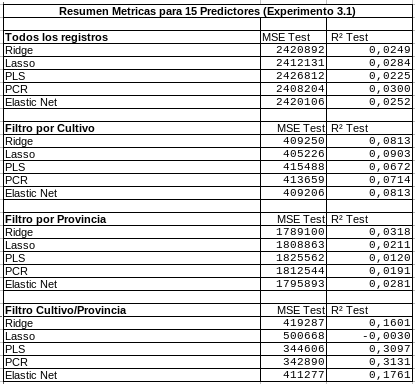

In [377]:
# Vamos a evaluar quitando los predictores que indicaban poca varianza inicialmente
dfx3 = dfx.drop(columns=columnas_eliminadas,axis=1).copy()
dfx3.shape


(4065, 698)

In [379]:

pd.DataFrame(dfx3).to_csv("../Metricas/Experimento3_2/predictores_698.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento3_2/objetivo_698.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento3_2/set_completo.csv")	

In [381]:


# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx3


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx3,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx3,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx3,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      



Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 2250382.7254
R2 en Test: 0.0935


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1009970.7069749832, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1980950.2668352127, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2272911.6477603912, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_m

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2258344.9335
R2 en Test: 0.0903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2484698.6362257004, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2207348.7199516296, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6320289.144450188, tolerance: 618705.8559288242
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mo

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2256414.1676, R² Test: 0.0911
Número óptimo de componentes: 20
MSE Test: 2290205.4455, R² Test: 0.0775
Número óptimo de componentes: 4
MSE Test: 2261204.0225, R² Test: 0.0892
----------- SIN FILTRADO -----
Predictores: 698 Registros: 4065 
Ridge
MSE: 2250382.7253831523 
r2: 0.09354555560436006 
Lasso
MSE: 2258344.9335036688 
r2: 0.09033837717349269 
Elastic Net
MSE: 2256414.1676191273 
r2: 0.09111608991425857 
PCR
MSE: 2290205.445453007 
r2: 0.07750495895913956 
PLS
MSE: 2261204.022459795 
r2: 0.08918673578291025 
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 356269.6041
R2 en Test: 0.2002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.573e+04, tolerance: 1.048e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.795e+04, tolerance: 1.015e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 360427.5312
R2 en Test: 0.1909


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.265e+04, tolerance: 1.043e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.214e+04, tolerance: 1.060e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 354012.0827, R² Test: 0.2053
Número óptimo de componentes: 10
MSE Test: 431926.1895, R² Test: 0.0303
Número óptimo de componentes: 3
MSE Test: 360725.4390, R² Test: 0.1902
-----------FILTRADO POR CULTIVO -----
Predictores: 698 Registros: 368 
Ridge
MSE: 356269.6040723582 
r2: 0.20018823708028743 
Lasso
MSE: 360427.5311793627 
r2: 0.19085384825920393 
Elastic Net
MSE: 354012.0826923219 
r2: 0.20525628704625953 
PCR
MSE: 431926.1895390313 
r2: 0.030342069158827756 
PLS
MSE: 360725.4390271201 
r2: 0.19018505642802053 
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 1641741.0150
R2 en Test: 0.1115


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1626744.4274
R2 en Test: 0.1196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1636890.2658, R² Test: 0.1142
Número óptimo de componentes: 19
MSE Test: 1637719.2194, R² Test: 0.1137
Número óptimo de componentes: 2
MSE Test: 1657347.4597, R² Test: 0.1031
-----------FILTRADO POR PROVINCIA -----
Predictores: 698 Registros: 735 
Ridge
MSE: 1641741.0149690341 
r2: 0.11152702295325612 
Lasso
MSE: 1626744.4273627568 
r2: 0.11964283580961133 
Elastic Net
MSE: 1636890.2658489877 
r2: 0.11415213828649007 
PCR
MSE: 1637719.2194126225 
r2: 0.11370352743142786 
PLS
MSE: 1657347.4596977918 
r2: 0.10308116926327171 
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 299868.4021
R2 en Test: 0.3993


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 408361.2959
R2 en Test: 0.1819


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 299743.4851, R² Test: 0.3995
Número óptimo de componentes: 3
MSE Test: 365602.4310, R² Test: 0.2676
Número óptimo de componentes: 2
MSE Test: 304245.5233, R² Test: 0.3905
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 698 Registros: 53 
Ridge
MSE: 299868.40206670115 
r2: 0.3992863858842923 
Lasso
MSE: 408361.2959387159 
r2: 0.1819471866403749 
Elastic Net
MSE: 299743.48511223163 
r2: 0.39953662670548773 
PCR
MSE: 365602.4309945618 
r2: 0.2676042019146112 
PLS
MSE: 304245.52329992986 
r2: 0.3905178851109079 


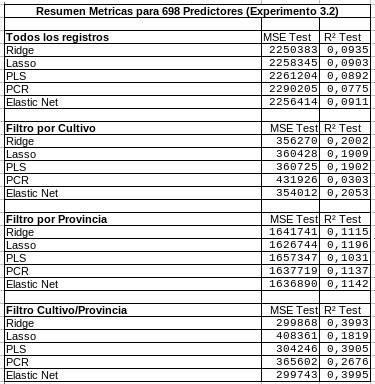

## Evaluación de predictores segun su colinealidad

In [388]:
# Veremos con una mirada mas compleja si hay variables afectadas por colinealidad 

X = dfx3.copy()
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

/home/ariel/anaconda3/lib/python3.12/site-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


In [396]:
vif_data["VIF"].describe()

count    6.980000e+02
mean              inf
std               NaN
min      2.674068e+02
25%      9.724969e+04
50%      6.390973e+05
75%      6.229345e+06
max               inf
Name: VIF, dtype: float64

In [398]:
vif_data[vif_data["VIF"]==np.inf]

,feature,VIF
1,10_Humedad_Media_8_14_20_max,inf
2,10_Humedad_Media_8_14_20_mean,inf
10,10_Precipitacion_Pluviometrica_max,inf
11,10_Precipitacion_Pluviometrica_mean,inf
13,10_Precipitacion_Pluviometrica_outliers,inf
19,10_Rocio_Medio_rango_diario,inf


Los registros con un valor inf corresponden todos a un mismo mes, es posible que se reconstruyeran a partir de registros de otro mes, los eliminaremos y luego evaluaremos los modelos sobre variables con menor VIF

Nos encontramos con la dificultad de una enorme multicolinealidad que va a volver inestable los modelos que querramos usar, Ridge y Lasso son los unicos recomendables al momento ya que obvian y pueden omitir estos problemas
Otra posible solucion seria continuar eliminando columnas con alto grado de correlacion, primero intentaremos mantener la información y luego evaluaremos opciones mas agresivas como la eliminación de variables

In [405]:
eliminar_columnas = list(vif_data[vif_data["VIF"]==np.inf]['feature'])

dfx3 = dfx3.drop(columns=eliminar_columnas,axis=1)

In [407]:
# Tomamos como referencia aproximada el 50% de los registros
vif_data[vif_data["VIF"]<600000].shape

(337, 2)

In [411]:
eliminar_columnas = list(vif_data[vif_data["VIF"]<600000]['feature'])

dfx4 = dfx3.drop(columns=eliminar_columnas,axis=1).copy()

In [413]:
dfx4.shape

(4065, 355)

In [415]:
pd.DataFrame(dfx2).to_csv("../Metricas/Experimento4_1/predictores_355.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento4_1/objetivo_355.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento4_1/set_completo.csv")

In [417]:


# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx4


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx4,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx4,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx4,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     

Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 2273899.8504
R2 en Test: 0.0841


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1125281.2949867249, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5741094.816075325, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18003990.556752205, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mo

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2280599.0011
R2 en Test: 0.0814


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2263253.060494423, tolerance: 635344.9583868511
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759023.0700864792, tolerance: 613746.7608941945
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:664: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1790409.2170448303, tolerance: 629904.7588433897
  model = cd_fast.enet_coordinate_descent_gram(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_mod

Mejor alpha: 2.559548, Mejor l1_ratio: 0.70
MSE Test: 2272808.9970, R² Test: 0.0845
Número óptimo de componentes: 16
MSE Test: 2344711.0547, R² Test: 0.0556
Número óptimo de componentes: 3
MSE Test: 2289989.2181, R² Test: 0.0776
----------- SIN FILTRADO -----
Predictores: 355 Registros: 4065 
Ridge
MSE: 2273899.8503786293 
r2: 0.08407285470281511 
Lasso
MSE: 2280599.001090122 
r2: 0.08137443595492211 
Elastic Net
MSE: 2272808.996953965 
r2: 0.08451225059926326 
PCR
MSE: 2344711.0546533237 
r2: 0.055550092728237854 
PLS
MSE: 2289989.2180550513 
r2: 0.07759205538219072 
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 404303.0967
R2 en Test: 0.0924


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.549e+04, tolerance: 1.060e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.546e+04, tolerance: 1.048e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 392971.3564
R2 en Test: 0.1178


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.296e+04, tolerance: 1.048e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.068e+04, tolerance: 1.043e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 404678.3532, R² Test: 0.0915
Número óptimo de componentes: 10
MSE Test: 471108.0013, R² Test: -0.0576
Número óptimo de componentes: 2
MSE Test: 416666.9707, R² Test: 0.0646
-----------FILTRADO POR CULTIVO -----
Predictores: 355 Registros: 368 
Ridge
MSE: 404303.09667861444 
r2: 0.0923548660560276 
Lasso
MSE: 392971.35639469046 
r2: 0.11779419366027866 
Elastic Net
MSE: 404678.3532376036 
r2: 0.09151242929869097 
PCR
MSE: 471108.0013150905 
r2: -0.05761961377114089 
PLS
MSE: 416666.9707340648 
r2: 0.06459843723983627 
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 1672109.2892
R2 en Test: 0.0951


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1676045.1575
R2 en Test: 0.0930


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 1674673.3668, R² Test: 0.0937
Número óptimo de componentes: 17
MSE Test: 1767001.2571, R² Test: 0.0437
Número óptimo de componentes: 3
MSE Test: 1711160.6288, R² Test: 0.0740
-----------FILTRADO POR PROVINCIA -----
Predictores: 355 Registros: 735 
Ridge
MSE: 1672109.2892091533 
r2: 0.0950924021599151 
Lasso
MSE: 1676045.1574737227 
r2: 0.09296239958191921 
Elastic Net
MSE: 1674673.3667542136 
r2: 0.09370478158573992 
PCR
MSE: 1767001.2570608384 
r2: 0.04373902278625019 
PLS
MSE: 1711160.6288379605 
r2: 0.07395870344536837 
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 445636.3127
R2 en Test: 0.1073


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 457476.3882, R² Test: 0.0836
Número óptimo de componentes: 6
MSE Test: 403115.5450, R² Test: 0.1925
Número óptimo de componentes: 1
MSE Test: 374125.7994, R² Test: 0.2505
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 355 Registros: 53 
Ridge
MSE: 445636.3127160778 
r2: 0.1072757311277931 
Lasso
MSE: 500667.875644197 
r2: -0.0029666579640499346 
Elastic Net
MSE: 457476.3881833401 
r2: 0.08355701159508355 
PCR
MSE: 403115.5449752485 
r2: 0.19245577640274192 
PLS
MSE: 374125.79936902184 
r2: 0.25052970061546287 


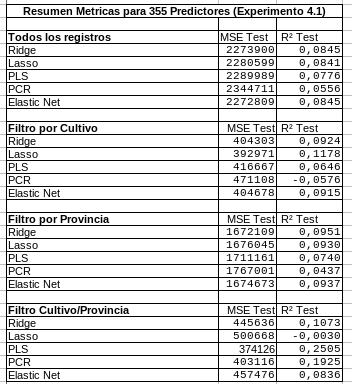

In [419]:
# Venimos viendo los problemas de convergencia en estas pruebas previas a definir un modelo
# Para que sea mas simple la lectura de datos vamos a quitar por ahora los warning de covergencia
import warnings
from sklearn.exceptions import ConvergenceWarning

warnings.filterwarnings('ignore', category=ConvergenceWarning)

In [421]:
# Volvemos a aplicar el calulo de colinealidad para ver como impacto la seleccion de predictores en el resto del dataset

X = dfx4.copy()
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

/home/ariel/anaconda3/lib/python3.12/site-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


In [425]:
vif_data[vif_data["VIF"]< 1000]

,feature,VIF
0,10_Humedad_Media_8_14_20_kurtosis,186.030244
1,10_Humedad_Media_8_14_20_outliers,104.128477
2,10_Humedad_Media_8_14_20_skew,67.479425
4,10_Precipitacion_Pluviometrica_median,38.680707
7,10_Rocio_Medio_outliers,33.232657
...,...,...
346,9_Temperatura_Abrigo_150cm_outliers,51.094226
347,9_Temperatura_Abrigo_150cm_skew,314.525416
350,9_Tesion_Vapor_Media_outliers,49.817827
352,9_Velocidad_Viento_200cm_Media_kurtosis,139.439853


Luego de eliminar esos predictores vemos que bajo notablemente el valor de VIF en general.

In [427]:
eliminar_columnas = list(vif_data[vif_data["VIF"]<1000]['feature'])

dfx5 = dfx4.drop(columns=eliminar_columnas,axis=1).copy()

In [429]:
dfx5.shape

(4065, 90)

In [440]:
pd.DataFrame(dfx5).to_csv("../Metricas/Experimento4_2/predictores_90.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento4_2/objetivo_90.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento4_2/set_completo.csv")

In [435]:
# Volvemos a ejecutar metricas sobre el nuevo modelos de 90 predictores
# Son las 90 variables con mayor VIF es decir las de menor interes en esta etapa.

# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx5


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx5,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx5,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx5,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2321251.8710
R2 en Test: 0.0650
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 2324059.6281
R2 en Test: 0.0639
Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 2320172.8527, R² Test: 0.0654
Número óptimo de componentes: 20
MSE Test: 2362401.1221, R² Test: 0.0484
Número óptimo de componentes: 6
MSE Test: 2331528.1362, R² Test: 0.0609
----------- SIN FILTRADO -----
Predictores: 90 Registros: 4065 
Ridge
MSE: 2321251.870959733 
r2: 0.06499945486610648 
Lasso
MSE: 2324059.6280798316 
r2: 0.0638684899455223 
Elastic Net
MSE: 2320172.852650111 
r2: 0.0654340835767292 
PCR
MSE: 2362401.122109237 
r2: 0.04842453133541247 
PLS
MSE: 2331528.136231512 
r2: 0.06086017392410281 
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 398491.0373
R2 en Test: 0.1054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 411596.5329
R2 en Test: 0.0760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 400293.2739, R² Test: 0.1014
Número óptimo de componentes: 10
MSE Test: 455518.8287, R² Test: -0.0226
Número óptimo de componentes: 2
MSE Test: 409757.6310, R² Test: 0.0801
-----------FILTRADO POR CULTIVO -----
Predictores: 90 Registros: 368 
Ridge
MSE: 398491.03731816186 
r2: 0.10540271911489663 
Lasso
MSE: 411596.5328796903 
r2: 0.07598137811586592 
Elastic Net
MSE: 400293.2738752364 
r2: 0.1013567663267958 
PCR
MSE: 455518.8287043825 
r2: -0.022622511897421482 
PLS
MSE: 409757.63099106436 
r2: 0.08010964318413583 
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1726063.2940
R2 en Test: 0.0659


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1736003.1731
R2 en Test: 0.0605


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.20
MSE Test: 1725892.8145, R² Test: 0.0660
Número óptimo de componentes: 17
MSE Test: 1782735.6667, R² Test: 0.0352
Número óptimo de componentes: 2
MSE Test: 1815192.5742, R² Test: 0.0177
-----------FILTRADO POR PROVINCIA -----
Predictores: 90 Registros: 735 
Ridge
MSE: 1726063.2940122413 
r2: 0.06589371927758614 
Lasso
MSE: 1736003.1730863429 
r2: 0.0605144823139423 
Elastic Net
MSE: 1725892.814498069 
r2: 0.0659859789215258 
PCR
MSE: 1782735.6667333248 
r2: 0.035223917372957825 
PLS
MSE: 1815192.5742315326 
r2: 0.01765897566306973 
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 470042.0458
R2 en Test: 0.0584
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 390026.0770
R2 en Test: 0.2187


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 464968.9594, R² Test: 0.0685
Número óptimo de componentes: 1
MSE Test: 357457.3235, R² Test: 0.2839
Número óptimo de componentes: 1
MSE Test: 379920.7389, R² Test: 0.2389
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 90 Registros: 53 
Ridge
MSE: 470042.0457549913 
r2: 0.05838476429732398 
Lasso
MSE: 390026.07698699797 
r2: 0.2186773508263279 
Elastic Net
MSE: 464968.95939266647 
r2: 0.06854746240899556 
PCR
MSE: 357457.3235432355 
r2: 0.2839209491968363 
PLS
MSE: 379920.7389459225 
r2: 0.23892094466508496 


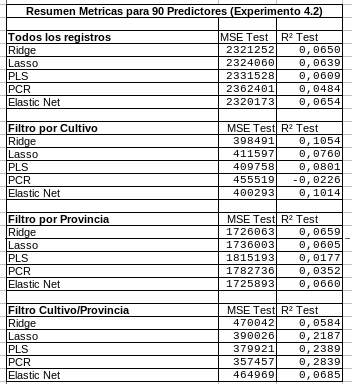

In [445]:
dfx6 = dfx3[eliminar_columnas]
dfx6.shape

(4065, 265)

In [447]:
pd.DataFrame(dfx6).to_csv("../Metricas/Experimento4_3/predictores_265.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento4_3/objetivo_265.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento4_3/set_completo.csv")

In [449]:
# Volvemos a ejecutar metricas sobre el nuevo modelos de 90 predictores
# Son las 90 variables con mayor VIF es decir las de menor interes en esta etapa.

# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx6


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx6,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx6,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx6,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     

Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 2278189.6182
R2 en Test: 0.0823
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2291449.4742
R2 en Test: 0.0770
Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 2276636.9112, R² Test: 0.0830
Número óptimo de componentes: 11
MSE Test: 2410720.8113, R² Test: 0.0290
Número óptimo de componentes: 5
MSE Test: 2335652.7320, R² Test: 0.0592
----------- SIN FILTRADO -----
Predictores: 265 Registros: 4065 
Ridge
MSE: 2278189.6182194073 
r2: 0.08234493567782508 
Lasso
MSE: 2291449.4742208626 
r2: 0.07700386401521764 
Elastic Net
MSE: 2276636.9111798387 
r2: 0.08297036626835796 
PCR
MSE: 2410720.811343816 
r2: 0.028961354443560405 
PLS
MSE: 2335652.732005364 
r2: 0.05919878622841346 
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 432054.7169
R2 en Test: 0.0301


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 412066.0057
R2 en Test: 0.0749


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 426932.1229, R² Test: 0.0416
Número óptimo de componentes: 5
MSE Test: 476176.6695, R² Test: -0.0690
Número óptimo de componentes: 1
MSE Test: 492401.3887, R² Test: -0.1054
-----------FILTRADO POR CULTIVO -----
Predictores: 265 Registros: 368 
Ridge
MSE: 432054.7168736846 
r2: 0.030053530162131525 
Lasso
MSE: 412066.0057232366 
r2: 0.07492742936933339 
Elastic Net
MSE: 426932.1228603339 
r2: 0.04155355963898777 
PCR
MSE: 476176.6695285235 
r2: -0.0689985818703045 
PLS
MSE: 492401.38868244545 
r2: -0.10542246165416591 
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 1664050.1633
R2 en Test: 0.0995


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1637315.4150
R2 en Test: 0.1139


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 1667005.6682, R² Test: 0.0979
Número óptimo de componentes: 20
MSE Test: 1816220.0274, R² Test: 0.0171
Número óptimo de componentes: 3
MSE Test: 1712621.3811, R² Test: 0.0732
-----------FILTRADO POR PROVINCIA -----
Predictores: 265 Registros: 735 
Ridge
MSE: 1664050.163348582 
r2: 0.09945381816916987 
Lasso
MSE: 1637315.414962958 
r2: 0.11392205723501247 
Elastic Net
MSE: 1667005.6681696223 
r2: 0.09785436603690101 
PCR
MSE: 1816220.027359806 
r2: 0.017102941348686618 
PLS
MSE: 1712621.3810898832 
r2: 0.07316817747923843 
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 489988.4508
R2 en Test: 0.0184
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 495981.5190, R² Test: 0.0064
Número óptimo de componentes: 1
MSE Test: 451463.8759, R² Test: 0.0956
Número óptimo de componentes: 1
MSE Test: 400148.8637, R² Test: 0.1984
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 265 Registros: 53 
Ridge
MSE: 489988.4508054875 
r2: 0.018426979536013355 
Lasso
MSE: 500667.875644197 
r2: -0.0029666579640499346 
Elastic Net
MSE: 495981.519034186 
r2: 0.006421320885447335 
PCR
MSE: 451463.87592246314 
r2: 0.09560162164820607 
PLS
MSE: 400148.8636749552 
r2: 0.19839880285549993 


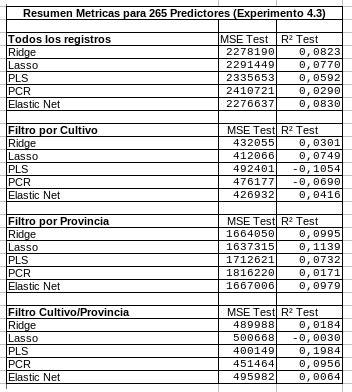

Por el momento fuimos analizando predictores y reducimos la cantidad de cerca de 1000 a 265, con cada iteración del proceso de analisis solo pudimos ver que empeoraran las metricas de los modelos propuestos para analizar el desempeño y relacion de los predictores con la variable objetivo. Vamos a continuar con un ciclo mas de evaluación usando el criterio del menor valor de VIF, de no mejorar el resultado volveremos a tomar el set de datos completo y avanzaremos sobre otros posibles analisis para evaluar que predictores son preferibles de usar.

In [453]:
# Volvemos a aplicar el calulo de colinealidad para ver como impacto la seleccion de predictores en el resto del dataset

X = dfx6.copy()
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

In [459]:
vif_data["VIF"].describe()

count    265.000000
mean      23.632480
std       22.756896
min        3.674259
25%        9.778791
50%       16.242410
75%       26.221696
max      173.490966
Name: VIF, dtype: float64

In [475]:
vif_data[vif_data["VIF"]< 9.77 ]

,feature,VIF
2,10_Humedad_Media_8_14_20_skew,8.320107
3,10_Precipitacion_Pluviometrica_median,5.972358
4,10_Rocio_Medio_outliers,7.608810
6,10_Temperatura_Abrigo_150cm_Maxima_outliers,9.528881
14,10_Tesion_Vapor_Media_kurtosis,5.814639
...,...,...
253,9_Temperatura_Abrigo_150cm_Maxima_outliers,9.145409
257,9_Temperatura_Abrigo_150cm_Minima_outliers,7.916687
262,9_Tesion_Vapor_Media_outliers,8.822341
263,9_Velocidad_Viento_200cm_Media_kurtosis,5.043965


In [477]:


columnas_conservar = list(vif_data[vif_data["VIF"]< 9.77 ]['feature'])
dfx7 = dfx3[columnas_conservar].copy()
dfx7.shape

(4065, 66)

In [479]:
pd.DataFrame(dfx7).to_csv("../Metricas/Experimento4_4/predictores_66.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento4_4/objetivo_66.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento4_4/set_completo.csv")

In [481]:
# Volvemos a ejecutar metricas sobre el nuevo modelos de 90 predictores


# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx7


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx7,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx7,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx7,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     

Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 2448823.4551
R2 en Test: 0.0136
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2440892.7189
R2 en Test: 0.0168
Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 2448923.2508, R² Test: 0.0136
Número óptimo de componentes: 8
MSE Test: 2497015.0942, R² Test: -0.0058
Número óptimo de componentes: 1
MSE Test: 2472800.2014, R² Test: 0.0040
----------- SIN FILTRADO -----
Predictores: 66 Registros: 4065 
Ridge
MSE: 2448823.4551068386 
r2: 0.013613604750745467 
Lasso
MSE: 2440892.7188890777 
r2: 0.01680810629523055 
Elastic Net
MSE: 2448923.250766252 
r2: 0.013573407046600927 
PCR
MSE: 2497015.0942161484 
r2: -0.005797993534567114 
PLS
MSE: 2472800.2014495465 
r2: 0.003955768312814967 
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 481275.7487
R2 en Test: -0.0804
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 456635.4113
R2 en Test: -0.0251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 489358.6140, R² Test: -0.0986
Número óptimo de componentes: 6
MSE Test: 495797.7483, R² Test: -0.1130
Número óptimo de componentes: 1
MSE Test: 585381.6835, R² Test: -0.3142
-----------FILTRADO POR CULTIVO -----
Predictores: 66 Registros: 368 
Ridge
MSE: 481275.74874348275 
r2: -0.08044582151569246 
Lasso
MSE: 456635.41130503075 
r2: -0.025129197531171377 
Elastic Net
MSE: 489358.6140395563 
r2: -0.0985915478645003 
PCR
MSE: 495797.7483117888 
r2: -0.11304716034191231 
PLS
MSE: 585381.6834945377 
r2: -0.31415970070122845 
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 1683362.5023
R2 en Test: 0.0890


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 7.906043
MSE en Test: 1665895.0961
R2 en Test: 0.0985


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.80
MSE Test: 1674484.0632, R² Test: 0.0938
Número óptimo de componentes: 10
MSE Test: 1858384.4509, R² Test: -0.0057
Número óptimo de componentes: 18
MSE Test: 1689429.4922, R² Test: 0.0857
-----------FILTRADO POR PROVINCIA -----
Predictores: 66 Registros: 735 
Ridge
MSE: 1683362.5022977411 
r2: 0.08900241863450054 
Lasso
MSE: 1665895.0961392613 
r2: 0.09845538241466278 
Elastic Net
MSE: 1674484.0631604034 
r2: 0.09380722839435629 
PCR
MSE: 1858384.450911719 
r2: -0.005715487731818847 
PLS
MSE: 1689429.4921763446 
r2: 0.08571910140601724 
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 503644.2406
R2 en Test: -0.0089


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 555391.8092, R² Test: -0.1126
Número óptimo de componentes: 3
MSE Test: 484523.2556, R² Test: 0.0294
Número óptimo de componentes: 1
MSE Test: 689838.1282, R² Test: -0.3819
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 66 Registros: 53 
Ridge
MSE: 503644.24058670434 
r2: -0.008929083245334368 
Lasso
MSE: 500667.875644197 
r2: -0.0029666579640499346 
Elastic Net
MSE: 555391.8091540168 
r2: -0.11259278612809465 
PCR
MSE: 484523.2556492345 
r2: 0.02937517251511279 
PLS
MSE: 689838.1282362354 
r2: -0.38192337809379473 


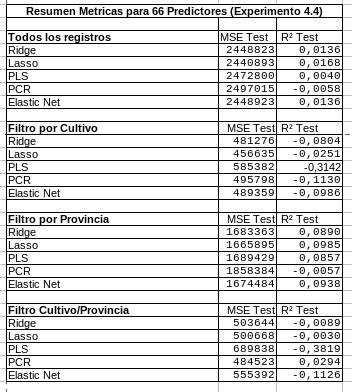

Durante todas las celdas anteriores nos dedicamos a realizar un analisis recursivo de rendimiento de distintos modelos que podrian aplicar a nuestro set de datos, mediante la evaluación de los predictores se fue seleccionando nuevos conjuntos de datos acotados con la intencion de mejorar las metricas de los modelos. El criterio de evaluación fue tomado segun la significancia estadistica,correlacion, varianza, y aporte de información relativo de cada atributo. Para cada iteración se evaluaron los modelos Ridge, Lasso, Elastic Net, PCR y PLS , modelos orientados a datos con alto grado de colinealidad y correlación, situaciones presentes en nuestros datos ya que como podemos recordar para poder acomodar las dimenciones de los distintos set de datos debimos recurrir a la creación de nuevos atributos dependientes de los originales, y esta situación es la que genero un alto indice de colinealidad.

Sobre cada modelo y cada set de atributos se realizaron cuatro pruebas distintas sobre set de datos con distinto grado de granularidad:

Set de datos completos

Set de datos filtrado por cultivo

Set de datos filtrado por provincia

Set de datos filtrado por provincia y cultivo

Se tomo como referencia un mismo parametro de filtrado para todas las pruebas para evitar que un cambio en las caracteristicas especificas de los datos pudieran inducir a un error de interpretación de los resultados.

Asi es que se aplico el cultivo: "Soja total"  provincia: "Córdoba"

Los resultados finales no fueron aun analizados para determinar que un set de atributos haya respondido mejor que otro, si se pudo ver que mayor es la granularidad de los datos, mejor es el rendimiento de los modelos, esto es logico ya que el modelo al tener mayor diversidad de datos con naturalezas mas diversa, se ve en la necesidad de sobre generalizar y luego se torna mas inestable en sus predicciones.



En la siguiente etapa de la investigación se procedera a considerar otros factores aislados que puedan dar pistas sobre los mejores predictores para este set de datos. Asi se consideraran sobre los registros meteorologicos uno por uno los estadisticos desarrollados al adaptar la dimencionalidad de los datos. Luego se considerara uno por uno las metricas del analisis sobre cada mes en particular de todos los estadisticos, por ultimo se intentara ver si hay una posible intersección de mes/estadisticos que podrian presentar mejor rendimiento para evaluar estas combinaciones. 


# ANALISIS SOBRE ESTADISTICOS

In [488]:
# Volvemos a tomar el set de datos completos
df_merged_final.shape

(4065, 999)

In [1049]:
df_predictores = df_merged_final.copy()

## Evaluación sobre estadisticos

Vamos a realizar un analisis de cada uno de los estadisticos que se aplicaron para armar los nuevos predictores.

Asi vamos a tomar las columnas que tengan datos de cualquier naturaleza pero que esten describiendo el estadistico de su original

    'max'
    
    'min'
    'median'
    
    'mean'
    
    'std'
    
    'skew'
    
    'sum'
    
    'rango_diario'
    
    'kurtosis'



In [543]:
# Lista de estadísticos que vamos a analizar
estadisticos=[
    'max',
    'min',
    'median',
    'mean',
    'std',
    'skew',
    'sum',
    'rango_diario',
    'kurtosis']



In [ ]:



# Inicializamos lista para resultados
resultados = []

# Diccionario de modelos y sus funciones
modelos = {
    'Ridge': ridge_modelo,
    'Lasso': lasso_modelo,
    'ElasticNet': elasticnet_modelo,
    'PCR': pcr_modelo,
    'PLS': pls_modelo
}

# Filtros y funciones asociadas
filtros = [
    ('Sin filtrado', lambda x, y: (x, y)),
    ('Filtro cultivo', lambda x, y: filtro_cultivo(x, y, 'Soja total')),
    ('Filtro provincia', lambda x, y: filtro_provincial(x, y, 'Córdoba')),
    ('Filtro cultivo + provincia', lambda x, y: filtro_por_cultivo_provincia(x, y, 'Soja total', 'Córdoba')),
]

# Iteramos por cada estadístico
i=0
for estad in estadisticos:
    dfx_var = df_predictores[df_predictores.filter(regex=f'_{estad}', axis=1).columns].copy()
    dfy = df_merged_final[df_merged_final.columns[6]]
    
    cp = dfx_var.shape[0]
    i=i+1
    # Resguardamos los set de datos de cada experimento
    pd.DataFrame(dfx_var).to_csv(f"../Metricas/Experimento5_{i}/predictores_{cp}.csv")
    pd.DataFrame(dfy).to_csv(f"../Metricas/Experimento5_{i}/objetivo_{cp}.csv")
    pd.DataFrame(df_merged_final).to_csv(f"../Metricas/Experimento5_{i}/set_completo.csv")
    
    for nombre_filtro, funcion_filtro in filtros:
        x_filtrado, y_filtrado = funcion_filtro(dfx_var, dfy)

        for nombre_modelo, funcion_modelo in modelos.items():
            if nombre_modelo == 'ElasticNet':
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    alphas=np.logspace(-4, 4, 50),
                    l1_ratios=np.linspace(0.1, 0.9, 9),
                    test_size=0.2, random_state=42,
                    n_splits=5, graficar=0
                )
                mse, r2 = resultado[2], resultado[1]

            elif nombre_modelo == 'Lasso':
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    alphas=np.logspace(-4, 4, 50),
                    test_size=0.2, random_state=42,
                    n_splits=5, iterat=10000, graficar=0
                )
                mse, r2 = resultado[1], resultado[2]

            elif nombre_modelo in ['PCR', 'PLS']:
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    max_components=20,
                    test_size=0.2, random_state=42,
                    n_splits=5, graficar=0
                )
                mse, r2 = resultado[2], resultado[1]

            else:  # Ridge
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    alphas=np.logspace(-4, 4, 50),
                    test_size=0.2, random_state=42,
                    n_splits=5, graficar=0
                )
                mse, r2 = resultado[2], resultado[1]

            resultados.append({
                'Estadístico': estad,
                'Modelo': nombre_modelo,
                'MSE': mse,
                'R2': r2,
                'Filtro': nombre_filtro
            })

        # Insertamos fila vacía como separador entre pruebas
        resultados.append({'Estadístico': '', 'Modelo': '', 'MSE': '', 'R2': '', 'Filtro': ''})

# Convertimos a DataFrame y exportamos
df_resultados = pd.DataFrame(resultados)
df_resultados.to_csv('resultados_modelos.csv', index=False)



Los principales estadisticos quedan ordenados:

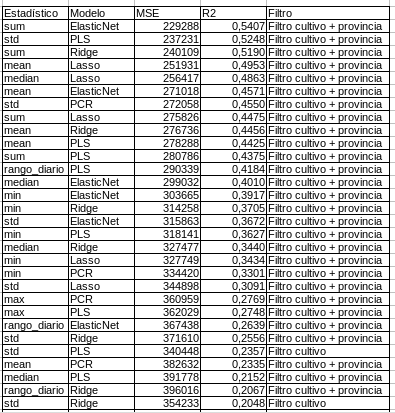

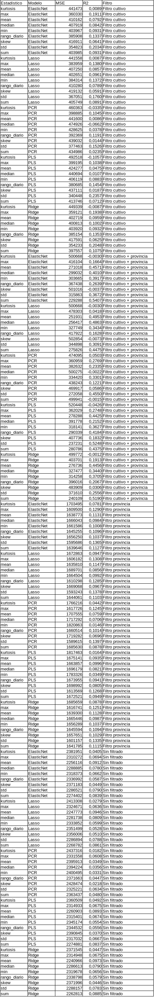

Basados en la lectura del marco teorico y de la concepción de que una de las caracteristicas del cambio climatico se presenta como eventos "atipicos" se habia diseñado un atributo outlier el cual realizo una media mensual historica de cada atributo climatico y sobre esto calculo los valores outliers en cada mes de todos los años, luego realizamos un acumulado mensual por año por atributo y obtuvimos un registro de la variación de eventos atipicos.

Vamos a analizar por separado el comportamiento de este atributo en particular dado a que presenta para nosotros un interes especial, y comprender si es de utilidad este metodo, para interpretar la variacion del rendimiento de las cosechas, es una de las razones que motivaron este estudio inicialmente.

In [564]:
dfx_var = df_predictores[df_predictores.filter(regex='_outliers',axis=1).columns].copy()


# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx_var


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx_var,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx_var,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx_var,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     


Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 2416459.4606
R2 en Test: 0.0266
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2421756.7079
R2 en Test: 0.0245
Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 2416344.9467, R² Test: 0.0267
Número óptimo de componentes: 18
MSE Test: 2434864.9699, R² Test: 0.0192
Número óptimo de componentes: 2
MSE Test: 2408194.7601, R² Test: 0.0300
----------- SIN FILTRADO -----
Predictores: 96 Registros: 4065 
Ridge
MSE: 2416459.460648895 
r2: 0.02664982578279418 
Lasso
MSE: 2421756.7079402716 
r2: 0.024516093908579784 
Elastic Net
MSE: 2416344.9467414706 
r2: 0.0266959519990857 
PCR
MSE: 2434864.9698961386 
r2: 0.01923608434657298 
PLS
MSE: 2408194.7601048565 
r2: 0.0299788481998442 
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 441801.4734
R2 en Test: 0.0082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 458331.0437
R2 en Test: -0.0289


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 442709.3193, R² Test: 0.0061
Número óptimo de componentes: 11
MSE Test: 443304.5560, R² Test: 0.0048
Número óptimo de componentes: 1
MSE Test: 459659.8008, R² Test: -0.0319
-----------FILTRADO POR CULTIVO -----
Predictores: 96 Registros: 368 
Ridge
MSE: 441801.4734466064 
r2: 0.00817243093775133 
Lasso
MSE: 458331.04368097294 
r2: -0.028935827971613204 
Elastic Net
MSE: 442709.31925560604 
r2: 0.0061343514927033604 
PCR
MSE: 443304.55603036715 
r2: 0.004798067485494939 
PLS
MSE: 459659.8007984673 
r2: -0.031918837356886165 
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1671873.6005
R2 en Test: 0.0952


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 1685698.8185
R2 en Test: 0.0877


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.50
MSE Test: 1673931.9171, R² Test: 0.0941
Número óptimo de componentes: 12
MSE Test: 1790164.1464, R² Test: 0.0312
Número óptimo de componentes: 6
MSE Test: 1702117.0473, R² Test: 0.0789
-----------FILTRADO POR PROVINCIA -----
Predictores: 96 Registros: 735 
Ridge
MSE: 1671873.6005461998 
r2: 0.09521995151521612 
Lasso
MSE: 1685698.8184650722 
r2: 0.08773805734877704 
Elastic Net
MSE: 1673931.9170762077 
r2: 0.0941060373238507 
PCR
MSE: 1790164.1463968647 
r2: 0.031203792772658945 
PLS
MSE: 1702117.0472598656 
r2: 0.07885288454615946 
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 499240.1087
R2 en Test: -0.0001
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 500667.8756, R² Test: -0.0030
Número óptimo de componentes: 1
MSE Test: 461104.0285, R² Test: 0.0763
Número óptimo de componentes: 1
MSE Test: 552707.6121, R² Test: -0.1072
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 96 Registros: 53 
Ridge
MSE: 499240.10869969527 
r2: -0.0001064731782058903 
Lasso
MSE: 500667.875644197 
r2: -0.0029666579640499346 
Elastic Net
MSE: 500667.875644197 
r2: -0.0029666579640499346 
PCR
MSE: 461104.02850022935 
r2: 0.07628991406012653 
PLS
MSE: 552707.612053438 
r2: -0.1072156482563662 


El experimento dio como resultado metricas muy bajas, en una simple inspección visual vemos que estan muy por abajo de la media de otros experimentos

[image.png](attachment:9a167df7-67cc-4380-9204-005a5df65377.png)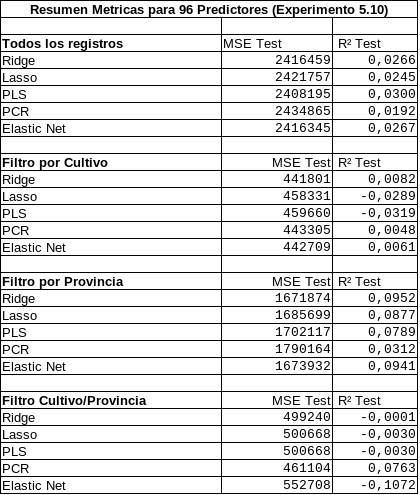
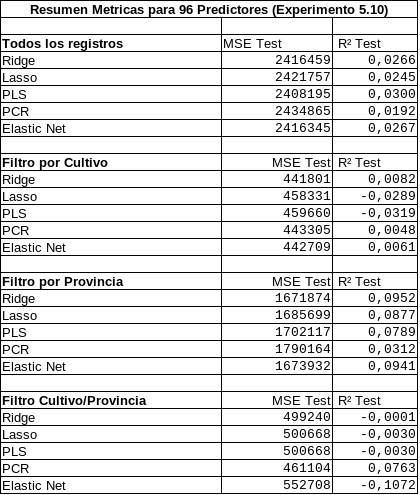

In [566]:
pd.DataFrame(dfx_var).to_csv("../Metricas/Experimento5_10/predictores_96.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento5_10/objetivo_96.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento5_10/set_completo.csv")

# Evaluación de metricas sobre atributos mensualizados

Vamos a evaluar si hay alguna diferencia en las metricas que podemos obtener utilizando registros de algun o algunos meses en particular y que nos señalen que sea factible ignorar otros.

In [570]:
df_predictores.shape

(4065, 999)

In [599]:

meses = [1,2,3,4,5,6,7,8,9,10,11,12]


# Inicializamos lista para resultados
resultados = []

# Diccionario de modelos y sus funciones
modelos = {
    'Ridge': ridge_modelo,
    'Lasso': lasso_modelo,
    'ElasticNet': elasticnet_modelo,
    'PCR': pcr_modelo,
    'PLS': pls_modelo
}

# Filtros y funciones asociadas
filtros = [
    ('Sin filtrado', lambda x, y: (x, y)),
    ('Filtro cultivo', lambda x, y: filtro_cultivo(x, y, 'Soja total')),
    ('Filtro provincia', lambda x, y: filtro_provincial(x, y, 'Córdoba')),
    ('Filtro cultivo + provincia', lambda x, y: filtro_por_cultivo_provincia(x, y, 'Soja total', 'Córdoba')),
]

# Iteramos por cada estadístico
i=0
for mes in meses:
    dfx_var = df_predictores[df_predictores.filter(regex=f'^{mes}_', axis=1).columns].copy()
    dfy = df_merged_final[df_merged_final.columns[6]]
    
    cp = dfx_var.shape[0]
    
    # Resguardamos los set de datos de cada experimento
    pd.DataFrame(dfx_var).to_csv(f"../Metricas/Experimento6_{mes}/predictores_{cp}.csv")
    pd.DataFrame(dfy).to_csv(f"../Metricas/Experimento6_{mes}/objetivo_{cp}.csv")
    pd.DataFrame(df_merged_final).to_csv(f"../Metricas/Experimento6_{mes}/set_completo.csv")
    
    for nombre_filtro, funcion_filtro in filtros:
        x_filtrado, y_filtrado = funcion_filtro(dfx_var, dfy)

        for nombre_modelo, funcion_modelo in modelos.items():
            if nombre_modelo == 'ElasticNet':
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    alphas=np.logspace(-4, 4, 50),
                    l1_ratios=np.linspace(0.1, 0.9, 9),
                    test_size=0.2, random_state=42,
                    n_splits=5, graficar=0
                )
                mse, r2 = resultado[2], resultado[1]

            elif nombre_modelo == 'Lasso':
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    alphas=np.logspace(-4, 4, 50),
                    test_size=0.2, random_state=42,
                    n_splits=5, iterat=10000, graficar=0
                )
                mse, r2 = resultado[1], resultado[2]

            elif nombre_modelo in ['PCR', 'PLS']:
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    max_components=20,
                    test_size=0.2, random_state=42,
                    n_splits=5, graficar=0
                )
                mse, r2 = resultado[2], resultado[1]

            else:  # Ridge
                resultado = funcion_modelo(
                    x_filtrado, y_filtrado,
                    alphas=np.logspace(-4, 4, 50),
                    test_size=0.2, random_state=42,
                    n_splits=5, graficar=0
                )
                mse, r2 = resultado[2], resultado[1]

            resultados.append({
                'Mes': mes,
                'Modelo': nombre_modelo,
                'MSE': mse,
                'R2': r2,
                'Filtro': nombre_filtro
            })

        # Insertamos fila vacía como separador entre pruebas
        resultados.append({'Mes': '', 'Modelo': '', 'MSE': '', 'R2': '', 'Filtro': ''})

# Convertimos a DataFrame y exportamos
df_resultados = pd.DataFrame(resultados)
df_resultados.to_csv('resultados_modelos.csv', index=False)



Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2318515.6535
R2 en Test: 0.0661
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 2323303.1483
R2 en Test: 0.0642
Mejor alpha: 0.268270, Mejor l1_ratio: 0.20
MSE Test: 2320337.9713, R² Test: 0.0654
Número óptimo de componentes: 20
MSE Test: 2386783.6881, R² Test: 0.0386
Número óptimo de componentes: 10
MSE Test: 2315034.2715, R² Test: 0.0675
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 391728.2936
R2 en Test: 0.1206


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 408323.8584
R2 en Test: 0.0833


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 392912.4701, R² Test: 0.1179
Número óptimo de componentes: 17
MSE Test: 434075.1272, R² Test: 0.0255
Número óptimo de componentes: 4
MSE Test: 396039.1148, R² Test: 0.1109
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 1625302.4685
R2 en Test: 0.1204


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1621642.6208
R2 en Test: 0.1224


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1627028.3345, R² Test: 0.1195
Número óptimo de componentes: 14
MSE Test: 1633828.9408, R² Test: 0.1158
Número óptimo de componentes: 3
MSE Test: 1644972.0872, R² Test: 0.1098
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 365466.8422
R2 en Test: 0.2679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 339210.8542
R2 en Test: 0.3205
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 347826.2496, R² Test: 0.3032
Número óptimo de componentes: 6
MSE Test: 374507.0722, R² Test: 0.2498
Número óptimo de componentes: 1
MSE Test: 369199.2448, R² Test: 0.2604
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 2319449.9223
R2 en Test: 0.0657
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 2321383.1155
R2 en Test: 0.0649
Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 2319818.6903, R² Test: 0.0656
Número óptimo de componentes: 20
MSE Test: 2366790.1185, R² Test: 0.0467
Número óptimo de componentes: 4
MSE Test: 2346325.0919, R² Test: 0.0549
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 347651.0511
R2 en Test: 0.2195


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 370643.6782
R2 en Test: 0.1679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 349136.5265, R² Test: 0.2162
Número óptimo de componentes: 19
MSE Test: 339490.0522, R² Test: 0.2379
Número óptimo de componentes: 4
MSE Test: 332641.7942, R² Test: 0.2532
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 1593476.5115
R2 en Test: 0.1376


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1592665.4997
R2 en Test: 0.1381


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 1591923.8404, R² Test: 0.1385
Número óptimo de componentes: 14
MSE Test: 1606942.5693, R² Test: 0.1304
Número óptimo de componentes: 3
MSE Test: 1615807.2702, R² Test: 0.1256
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 269626.3999
R2 en Test: 0.4599
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 410295.0107
R2 en Test: 0.1781


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 264349.4065, R² Test: 0.4704
Número óptimo de componentes: 1
MSE Test: 417169.5778, R² Test: 0.1643
Número óptimo de componentes: 3
MSE Test: 517245.2382, R² Test: -0.0362
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 2330347.2234
R2 en Test: 0.0613
Mejor valor de alpha encontrado: 1.206793
MSE en Test: 2329173.4233
R2 en Test: 0.0618
Mejor alpha: 0.390694, Mejor l1_ratio: 0.90
MSE Test: 2338776.7470, R² Test: 0.0579
Número óptimo de componentes: 18
MSE Test: 2351774.7719, R² Test: 0.0527
Número óptimo de componentes: 7
MSE Test: 2362574.1858, R² Test: 0.0484
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 465681.9540
R2 en Test: -0.0454


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 7.906043
MSE en Test: 483397.3020
R2 en Test: -0.0852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.20
MSE Test: 461215.0494, R² Test: -0.0354
Número óptimo de componentes: 19
MSE Test: 506782.3189, R² Test: -0.1377
Número óptimo de componentes: 2
MSE Test: 459744.1771, R² Test: -0.0321
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1704712.7905
R2 en Test: 0.0774


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1677447.1607
R2 en Test: 0.0922


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 1708283.9665, R² Test: 0.0755
Número óptimo de componentes: 7
MSE Test: 1746044.1321, R² Test: 0.0551
Número óptimo de componentes: 3
MSE Test: 1705177.7175, R² Test: 0.0772
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 570531.3866
R2 en Test: -0.1429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 351197.4694
R2 en Test: 0.2965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 483803.7986, R² Test: 0.0308
Número óptimo de componentes: 6
MSE Test: 470264.3598, R² Test: 0.0579
Número óptimo de componentes: 2
MSE Test: 701292.8798, R² Test: -0.4049
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2347503.4794
R2 en Test: 0.0544
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 2357261.7061
R2 en Test: 0.0505
Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 2352107.1224, R² Test: 0.0526
Número óptimo de componentes: 17
MSE Test: 2409838.9558, R² Test: 0.0293
Número óptimo de componentes: 13
MSE Test: 2359202.6568, R² Test: 0.0497
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 451020.3568
R2 en Test: -0.0125


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 468331.5978
R2 en Test: -0.0514


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 450792.1195, R² Test: -0.0120
Número óptimo de componentes: 2
MSE Test: 454740.7733, R² Test: -0.0209
Número óptimo de componentes: 1
MSE Test: 460357.6271, R² Test: -0.0335
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1635754.7560
R2 en Test: 0.1148


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1579137.1885
R2 en Test: 0.1454


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 1636098.2871, R² Test: 0.1146
Número óptimo de componentes: 16
MSE Test: 1672450.7863, R² Test: 0.0949
Número óptimo de componentes: 2
MSE Test: 1662746.0913, R² Test: 0.1002
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 419764.9949
R2 en Test: 0.1591


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 234998.5227
R2 en Test: 0.5292
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 338702.0793, R² Test: 0.3215
Número óptimo de componentes: 3
MSE Test: 306082.0484, R² Test: 0.3868
Número óptimo de componentes: 1
MSE Test: 313369.4878, R² Test: 0.3722
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2357935.5518
R2 en Test: 0.0502
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 2365200.5200
R2 en Test: 0.0473
Mejor alpha: 0.568987, Mejor l1_ratio: 0.90
MSE Test: 2358603.5506, R² Test: 0.0500
Número óptimo de componentes: 15
MSE Test: 2451411.0085, R² Test: 0.0126
Número óptimo de componentes: 12
MSE Test: 2355102.1521, R² Test: 0.0514
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 459292.4417
R2 en Test: -0.0311


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 5.428675
MSE en Test: 464139.7650
R2 en Test: -0.0420


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 455597.2933, R² Test: -0.0228
Número óptimo de componentes: 10
MSE Test: 470333.3301, R² Test: -0.0559
Número óptimo de componentes: 1
MSE Test: 466226.0353, R² Test: -0.0467
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1652446.8371
R2 en Test: 0.1057


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1608756.4157
R2 en Test: 0.1294


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 1649853.0484, R² Test: 0.1071
Número óptimo de componentes: 20
MSE Test: 1677871.5727, R² Test: 0.0920
Número óptimo de componentes: 7
MSE Test: 1686907.4855, R² Test: 0.0871
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 840504.0132
R2 en Test: -0.6837


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 533003.1657
R2 en Test: -0.0677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.70
MSE Test: 1049726.1571, R² Test: -1.1029
Número óptimo de componentes: 4
MSE Test: 619229.2026, R² Test: -0.2405
Número óptimo de componentes: 1
MSE Test: 667752.6583, R² Test: -0.3377
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2328218.9601
R2 en Test: 0.0622
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 2341392.0730
R2 en Test: 0.0569
Mejor alpha: 0.568987, Mejor l1_ratio: 0.90
MSE Test: 2331841.7867, R² Test: 0.0607
Número óptimo de componentes: 17
MSE Test: 2382201.5794, R² Test: 0.0404
Número óptimo de componentes: 12
MSE Test: 2333254.8801, R² Test: 0.0602
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 433161.8936
R2 en Test: 0.0276


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 430808.1953
R2 en Test: 0.0329


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 434069.8387, R² Test: 0.0255
Número óptimo de componentes: 13
MSE Test: 435806.9920, R² Test: 0.0216
Número óptimo de componentes: 2
MSE Test: 440218.6137, R² Test: 0.0117
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1677691.1237
R2 en Test: 0.0921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1645615.4988
R2 en Test: 0.1094


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.30
MSE Test: 1670153.5125, R² Test: 0.0962
Número óptimo de componentes: 20
MSE Test: 1679605.3472, R² Test: 0.0910
Número óptimo de componentes: 5
MSE Test: 1684994.2258, R² Test: 0.0881
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 359186.7775
R2 en Test: 0.2805


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 432018.8760
R2 en Test: 0.1346


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 389667.6851, R² Test: 0.2194
Número óptimo de componentes: 3
MSE Test: 347137.3934, R² Test: 0.3046
Número óptimo de componentes: 2
MSE Test: 404136.7668, R² Test: 0.1904
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2356204.6109
R2 en Test: 0.0509
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 2359020.9829
R2 en Test: 0.0498
Mejor alpha: 0.126486, Mejor l1_ratio: 0.90
MSE Test: 2354668.5158, R² Test: 0.0515
Número óptimo de componentes: 17
MSE Test: 2383436.5631, R² Test: 0.0400
Número óptimo de componentes: 13
MSE Test: 2365073.7075, R² Test: 0.0473
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 457369.3250
R2 en Test: -0.0268


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 519056.3140
R2 en Test: -0.1653


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 457705.2670, R² Test: -0.0275
Número óptimo de componentes: 16
MSE Test: 450141.8153, R² Test: -0.0106
Número óptimo de componentes: 4
MSE Test: 466502.3243, R² Test: -0.0473
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1669423.2051
R2 en Test: 0.0965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1651115.1523
R2 en Test: 0.1065


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 1676385.9884, R² Test: 0.0928
Número óptimo de componentes: 20
MSE Test: 1674775.0573, R² Test: 0.0936
Número óptimo de componentes: 6
MSE Test: 1668213.7132, R² Test: 0.0972
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 495129.3256
R2 en Test: 0.0081


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 500667.8756, R² Test: -0.0030
Número óptimo de componentes: 1
MSE Test: 482234.3969, R² Test: 0.0340
Número óptimo de componentes: 1
MSE Test: 316345.3702, R² Test: 0.3663
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 2379506.6161
R2 en Test: 0.0415
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 2392627.8599
R2 en Test: 0.0362
Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 2377320.4557, R² Test: 0.0424
Número óptimo de componentes: 17
MSE Test: 2425189.7016, R² Test: 0.0231
Número óptimo de componentes: 5
MSE Test: 2409235.4454, R² Test: 0.0296
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 444169.2364
R2 en Test: 0.0029


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 458627.7856
R2 en Test: -0.0296


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 438268.9109, R² Test: 0.0161
Número óptimo de componentes: 10
MSE Test: 458565.8725, R² Test: -0.0295
Número óptimo de componentes: 2
MSE Test: 453280.8053, R² Test: -0.0176
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1619695.2805
R2 en Test: 0.1235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1637240.0191
R2 en Test: 0.1140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.60
MSE Test: 1625050.7175, R² Test: 0.1206
Número óptimo de componentes: 18
MSE Test: 1683618.9403, R² Test: 0.0889
Número óptimo de componentes: 4
MSE Test: 1628818.7684, R² Test: 0.1185
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 523745.2263
R2 en Test: -0.0492


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 407534.8449
R2 en Test: 0.1836
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 506471.0387, R² Test: -0.0146
Número óptimo de componentes: 4
MSE Test: 458330.5051, R² Test: 0.0818
Número óptimo de componentes: 1
MSE Test: 578410.0871, R² Test: -0.1587
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2352595.9688
R2 en Test: 0.0524
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 2341721.7405
R2 en Test: 0.0568
Mejor alpha: 0.126486, Mejor l1_ratio: 0.80
MSE Test: 2350119.1174, R² Test: 0.0534
Número óptimo de componentes: 20
MSE Test: 2400300.7379, R² Test: 0.0332
Número óptimo de componentes: 14
MSE Test: 2355222.8004, R² Test: 0.0513
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 472647.0653
R2 en Test: -0.0611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 473998.0881
R2 en Test: -0.0641


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 468471.0191, R² Test: -0.0517
Número óptimo de componentes: 1
MSE Test: 457451.4904, R² Test: -0.0270
Número óptimo de componentes: 1
MSE Test: 468149.1015, R² Test: -0.0510
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1691881.1606
R2 en Test: 0.0844


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1654754.5115
R2 en Test: 0.1045


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 1685303.4357, R² Test: 0.0880
Número óptimo de componentes: 4
MSE Test: 1791905.2314, R² Test: 0.0303
Número óptimo de componentes: 2
MSE Test: 1741926.0431, R² Test: 0.0573
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 487315.0743
R2 en Test: 0.0238


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 486269.0333, R² Test: 0.0259
Número óptimo de componentes: 3
MSE Test: 335365.5321, R² Test: 0.3282
Número óptimo de componentes: 1
MSE Test: 488828.4862, R² Test: 0.0208
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2340604.6468
R2 en Test: 0.0572
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 2352801.6624
R2 en Test: 0.0523
Mejor alpha: 0.390694, Mejor l1_ratio: 0.90
MSE Test: 2354040.1092, R² Test: 0.0518
Número óptimo de componentes: 19
MSE Test: 2399299.7362, R² Test: 0.0336
Número óptimo de componentes: 11
MSE Test: 2366300.1695, R² Test: 0.0469
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 432715.3732
R2 en Test: 0.0286


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 422163.9631
R2 en Test: 0.0523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 432340.8576, R² Test: 0.0294
Número óptimo de componentes: 8
MSE Test: 422583.8524, R² Test: 0.0513
Número óptimo de componentes: 1
MSE Test: 472561.7373, R² Test: -0.0609
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1778105.4998
R2 en Test: 0.0377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1788674.0184
R2 en Test: 0.0320


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.30
MSE Test: 1774067.4044, R² Test: 0.0399
Número óptimo de componentes: 16
MSE Test: 1879954.0904, R² Test: -0.0174
Número óptimo de componentes: 2
MSE Test: 1817123.1178, R² Test: 0.0166
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 444378.6037
R2 en Test: 0.1098


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.60
MSE Test: 474662.8302, R² Test: 0.0491
Número óptimo de componentes: 3
MSE Test: 372700.7282, R² Test: 0.2534
Número óptimo de componentes: 1
MSE Test: 410975.5468, R² Test: 0.1767
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2333113.8827
R2 en Test: 0.0602
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 2331645.1604
R2 en Test: 0.0608
Mejor alpha: 0.040949, Mejor l1_ratio: 0.10
MSE Test: 2333635.5636, R² Test: 0.0600
Número óptimo de componentes: 20
MSE Test: 2388061.8146, R² Test: 0.0381
Número óptimo de componentes: 12
MSE Test: 2339989.6832, R² Test: 0.0575
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 429375.8981
R2 en Test: 0.0361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 424027.3489
R2 en Test: 0.0481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 428121.7232, R² Test: 0.0389
Número óptimo de componentes: 1
MSE Test: 455632.7512, R² Test: -0.0229
Número óptimo de componentes: 1
MSE Test: 458568.9312, R² Test: -0.0295
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1675727.3829
R2 en Test: 0.0931


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1657851.6540
R2 en Test: 0.1028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 1675103.1524, R² Test: 0.0935
Número óptimo de componentes: 15
MSE Test: 1776305.9297, R² Test: 0.0387
Número óptimo de componentes: 4
MSE Test: 1757866.7312, R² Test: 0.0487
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 327533.8724
R2 en Test: 0.3439


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 308160.9120
R2 en Test: 0.3827


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 340715.0040, R² Test: 0.3175
Número óptimo de componentes: 3
MSE Test: 349449.7591, R² Test: 0.3000
Número óptimo de componentes: 1
MSE Test: 310896.9349, R² Test: 0.3772
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2378041.7654
R2 en Test: 0.0421
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 2382812.3978
R2 en Test: 0.0402
Mejor alpha: 0.184207, Mejor l1_ratio: 0.20
MSE Test: 2378699.8122, R² Test: 0.0419
Número óptimo de componentes: 20
MSE Test: 2409429.5417, R² Test: 0.0295
Número óptimo de componentes: 4
MSE Test: 2401075.7076, R² Test: 0.0328
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 363945.5192
R2 en Test: 0.1830


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 377448.2218
R2 en Test: 0.1526


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 367351.8465, R² Test: 0.1753
Número óptimo de componentes: 17
MSE Test: 361889.9579, R² Test: 0.1876
Número óptimo de componentes: 4
MSE Test: 349568.4377, R² Test: 0.2152
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1618329.9739
R2 en Test: 0.1242


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1628621.0797
R2 en Test: 0.1186


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.80
MSE Test: 1618580.6595, R² Test: 0.1241
Número óptimo de componentes: 10
MSE Test: 1717017.7110, R² Test: 0.0708
Número óptimo de componentes: 3
MSE Test: 1674362.3919, R² Test: 0.0939
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 417909.4716
R2 en Test: 0.1628


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 510932.0621
R2 en Test: -0.0235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 409282.6912, R² Test: 0.1801
Número óptimo de componentes: 11
MSE Test: 431950.3307, R² Test: 0.1347
Número óptimo de componentes: 4
MSE Test: 394361.7072, R² Test: 0.2100


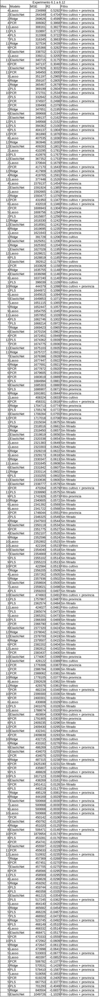

In [606]:
df_resultados.describe()

,Mes,Modelo,MSE,R2,Filtro
count,288,288,288,288,288
unique,13,6,238,238,5
top,,Ridge,,,Sin filtrado
freq,48,48,48,48,60


In [614]:
df_resultados.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288 entries, 0 to 287
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Mes     288 non-null    object
 1   Modelo  288 non-null    object
 2   MSE     288 non-null    object
 3   R2      288 non-null    object
 4   Filtro  288 non-null    object
dtypes: object(5)
memory usage: 11.4+ KB


In [642]:
df_resultados_limpio = df_resultados[(df_resultados['MSE']!='') & (df_resultados['R2']!='')]

In [644]:
df_resultados_limpio['MSE'] = df_resultados_limpio['MSE'].astype('int')
df_resultados_limpio['R2'] = df_resultados_limpio['R2'].astype('float')

/tmp/ipykernel_1656162/2871676145.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_resultados_limpio['MSE'] = df_resultados_limpio['MSE'].astype('int')
/tmp/ipykernel_1656162/2871676145.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_resultados_limpio['R2'] = df_resultados_limpio['R2'].astype('float')


In [646]:
df_resultados_limpio.describe()

,MSE,R2
count,2.400000e+02,240.000000
mean,1.227763e+06,0.070283
std,8.309160e+05,0.148571
min,2.349980e+05,-1.102872
25%,4.376525e+05,0.025791
50%,1.314432e+06,0.057046
75%,1.988724e+06,0.118547
max,2.451411e+06,0.529237


In [654]:
df_resultados_limpio[df_resultados_limpio['R2']>0.3].groupby('Mes').count()

,Modelo,MSE,R2,Filtro
Mes,,,,
1,2,2,2,2
2,2,2,2,2
4,4,4,4,4
6,1,1,1,1
7,1,1,1,1
9,1,1,1,1
11,4,4,4,4


Abril (mes 4) y Noviembre (mes 11) son los meses que mostraron mejor comportamiento en general con todos los modelos probados

In [664]:


df_resultados_limpio[df_resultados_limpio['Mes'] == 4].sort_values(by='R2', ascending=False).head(4)


,Mes,Modelo,MSE,R2,Filtro
91,4,Lasso,234998,0.529237,Filtro cultivo + provincia
93,4,PCR,306082,0.386839,Filtro cultivo + provincia
94,4,PLS,313369,0.372240,Filtro cultivo + provincia
92,4,ElasticNet,338702,0.321493,Filtro cultivo + provincia


In [666]:
df_resultados_limpio[df_resultados_limpio['Mes'] == 11].sort_values(by='R2', ascending=False).head(4)


,Mes,Modelo,MSE,R2,Filtro
259,11,Lasso,308160,0.382674,Filtro cultivo + provincia
262,11,PLS,310896,0.377193,Filtro cultivo + provincia
258,11,Ridge,327533,0.343865,Filtro cultivo + provincia
260,11,ElasticNet,340715,0.317460,Filtro cultivo + provincia


Vamos a evaluar la respuesta con los meses abril y noviembre de los mejores estadisticos evaluados en el paso anterior

In [678]:
dfx_var = df_predictores[df_predictores.filter(regex=r'^11_.*_(sum|min|mean|std|median)$', axis=1).columns].copy()


# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx_var


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx_var,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx_var,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx_var,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 2339814.8967
R2 en Test: 0.0575
Mejor valor de alpha encontrado: 0.568987
MSE en Test: 2342000.3368
R2 en Test: 0.0566
Mejor alpha: 0.002947, Mejor l1_ratio: 0.10
MSE Test: 2340774.1575, R² Test: 0.0571
Número óptimo de componentes: 11
MSE Test: 2374415.9775, R² Test: 0.0436
Número óptimo de componentes: 16
MSE Test: 2346014.2908, R² Test: 0.0550
----------- SIN FILTRADO -----
Predictores: 39 Registros: 4065 
Ridge
MSE: 2339814.896728784 
r2: 0.05752226575511998 
Lasso
MSE: 2342000.3368205694 
r2: 0.05664197021169315 
Elastic Net
MSE: 2340774.1574618765 
r2: 0.05713587541136267 
PCR
MSE: 2374415.977461863 
r2: 0.04358494609050534 
PLS
MSE: 2346014.290807565 
r2: 0.05502514904164413 
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 417715.8535
R2 en Test: 0.0622


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 1.206793
MSE en Test: 414140.7941
R2 en Test: 0.0703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.004292, Mejor l1_ratio: 0.20
MSE Test: 409459.0832, R² Test: 0.0808
Número óptimo de componentes: 11
MSE Test: 397809.5587, R² Test: 0.1069
Número óptimo de componentes: 18
MSE Test: 423990.3066, R² Test: 0.0482
-----------FILTRADO POR CULTIVO -----
Predictores: 39 Registros: 368 
Ridge
MSE: 417715.8535140635 
r2: 0.06224373513845649 
Lasso
MSE: 414140.7940969276 
r2: 0.07026960807927984 
Elastic Net
MSE: 409459.08320668957 
r2: 0.08077987164877953 
PCR
MSE: 397809.5586884705 
r2: 0.10693261281892097 
PLS
MSE: 423990.3065830325 
r2: 0.048157825722985326 
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1641321.7103
R2 en Test: 0.1118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1641818.7408
R2 en Test: 0.1115


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.184207, Mejor l1_ratio: 0.10
MSE Test: 1640653.4893, R² Test: 0.1121
Número óptimo de componentes: 12
MSE Test: 1653391.1507, R² Test: 0.1052
Número óptimo de componentes: 4
MSE Test: 1708026.9097, R² Test: 0.0757
-----------FILTRADO POR PROVINCIA -----
Predictores: 39 Registros: 735 
Ridge
MSE: 1641321.7102621146 
r2: 0.11175394114427983 
Lasso
MSE: 1641818.7407894586 
r2: 0.11148495950327442 
Elastic Net
MSE: 1640653.4892839128 
r2: 0.11211556717202409 
PCR
MSE: 1653391.1506770726 
r2: 0.1052222339145813 
PLS
MSE: 1708026.9096611256 
r2: 0.07565460114231637 
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 219559.2423
R2 en Test: 0.5602


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 286367.5430
R2 en Test: 0.4263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 247977.7522, R² Test: 0.5032
Número óptimo de componentes: 9
MSE Test: 217162.2218, R² Test: 0.5650
Número óptimo de componentes: 1
MSE Test: 333917.3706, R² Test: 0.3311
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 39 Registros: 53 
Ridge
MSE: 219559.24225104926 
r2: 0.5601663095673663 
Lasso
MSE: 286367.5430012234 
r2: 0.4263320825532131 
Elastic Net
MSE: 247977.75218956333 
r2: 0.5032367174686607 
PCR
MSE: 217162.22176087022 
r2: 0.5649681587513445 
PLS
MSE: 333917.3705536232 
r2: 0.33107753568292575 


In [680]:
pd.DataFrame(dfx_var).to_csv("../Metricas/Experimento7_1/predictores_39.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento7_1/objetivo_39.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento7_1/set_completo.csv")

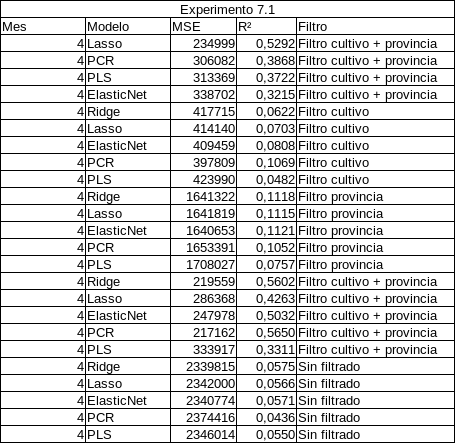

In [682]:

# Evaluamos el valor 4
dfx_var = df_predictores[df_predictores.filter(regex=r'^4_.*_(sum|min|mean|std|median)$', axis=1).columns].copy()

# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx_var


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx_var,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx_var,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx_var,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     


Mejor valor de alpha encontrado: 7.906043
MSE en Test: 2340935.4114
R2 en Test: 0.0571
Mejor valor de alpha encontrado: 0.828643
MSE en Test: 2342869.4187
R2 en Test: 0.0563
Mejor alpha: 0.006251, Mejor l1_ratio: 0.30
MSE Test: 2341356.9669, R² Test: 0.0569
Número óptimo de componentes: 15
MSE Test: 2384294.7390, R² Test: 0.0396
Número óptimo de componentes: 14
MSE Test: 2342963.7216, R² Test: 0.0563
----------- SIN FILTRADO -----
Predictores: 39 Registros: 4065 
Ridge
MSE: 2340935.4114028136 
r2: 0.057070922303702365 
Lasso
MSE: 2342869.418731 
r2: 0.056291903909029384 
Elastic Net
MSE: 2341356.966944094 
r2: 0.056901119678734235 
PCR
MSE: 2384294.739044837 
r2: 0.03960577968427226 
PLS
MSE: 2342963.7216050676 
r2: 0.05625391869951191 
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 439606.1733
R2 en Test: 0.0131


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 444888.0693
R2 en Test: 0.0012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.20
MSE Test: 441473.8168, R² Test: 0.0089
Número óptimo de componentes: 6
MSE Test: 447665.5697, R² Test: -0.0050
Número óptimo de componentes: 3
MSE Test: 442379.5041, R² Test: 0.0069
-----------FILTRADO POR CULTIVO -----
Predictores: 39 Registros: 368 
Ridge
MSE: 439606.1733342981 
r2: 0.01310079651509255 
Lasso
MSE: 444888.0693124772 
r2: 0.0012431401627757133 
Elastic Net
MSE: 441473.81675053854 
r2: 0.008908007806277207 
PCR
MSE: 447665.56966143806 
r2: -0.004992242887643883 
PLS
MSE: 442379.5041240207 
r2: 0.0068747739671878305 
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 1593983.7246
R2 en Test: 0.1374


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 5.428675
MSE en Test: 1598993.3729
R2 en Test: 0.1347


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.028118, Mejor l1_ratio: 0.10
MSE Test: 1594122.5761, R² Test: 0.1373
Número óptimo de componentes: 20
MSE Test: 1599985.9217, R² Test: 0.1341
Número óptimo de componentes: 14
MSE Test: 1615341.6286, R² Test: 0.1258
-----------FILTRADO POR PROVINCIA -----
Predictores: 39 Registros: 735 
Ridge
MSE: 1593983.7245663404 
r2: 0.13737218464008116 
Lasso
MSE: 1598993.3728902158 
r2: 0.13466107666404348 
Elastic Net
MSE: 1594122.576144186 
r2: 0.13729704131746745 
PCR
MSE: 1599985.9216678094 
r2: 0.13412393179207394 
PLS
MSE: 1615341.628556033 
r2: 0.12581377173074748 
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 233396.7893
R2 en Test: 0.5324


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 245418.9646
R2 en Test: 0.5084


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 227455.8228, R² Test: 0.5443
Número óptimo de componentes: 2
MSE Test: 202838.7406, R² Test: 0.5937
Número óptimo de componentes: 1
MSE Test: 180485.8303, R² Test: 0.6384
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 39 Registros: 53 
Ridge
MSE: 233396.78926245298 
r2: 0.5324461402583394 
Lasso
MSE: 245418.96463332084 
r2: 0.5083626277348674 
Elastic Net
MSE: 227455.82277674804 
r2: 0.5443474257034602 
PCR
MSE: 202838.74062897247 
r2: 0.5936617792133849 
PLS
MSE: 180485.83031616805 
r2: 0.6384404135992188 


In [684]:
pd.DataFrame(dfx_var).to_csv("../Metricas/Experimento7_2/predictores_39.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento7_2/objetivo_39.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento7_2/set_completo.csv")

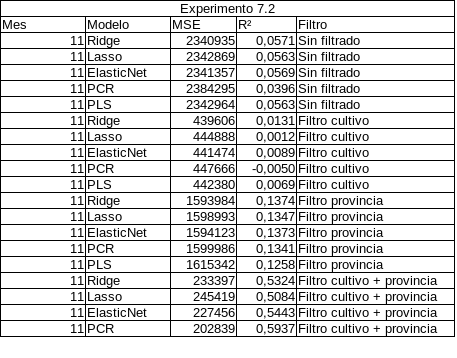

In [686]:
# Vamos a evaluar el funcionamiento del par de Abril y Noviembre y todos los estadisticos

dfx_var = df_predictores[df_predictores.filter(regex='^(4_|11_).*_(sum|min|mean|std|median)$', axis=1).columns].copy()


# Definimos la variable objetivo (Rendimiento)
y = df_merged_final[df_merged_final.columns[6]]
x = dfx_var


resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("----------- SIN FILTRADO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para cultivo especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_cultivo(dfx_var,dfy,'Soja total')



resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      


# Evaluamos ridge para provincia especifico


# Definimos la variable objetivo (Rendimiento)
x,y = filtro_provincial(dfx_var,dfy,'Córdoba')




resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")      

# Evaluamos para el par provincia cultivo
x,y = filtro_por_cultivo_provincia(dfx_var,dfy,'Soja total','Córdoba')

resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2319079.7871
R2 en Test: 0.0659
Mejor valor de alpha encontrado: 0.828643
MSE en Test: 2321537.0944
R2 en Test: 0.0649
Mejor alpha: 0.013257, Mejor l1_ratio: 0.30
MSE Test: 2318774.6519, R² Test: 0.0660
Número óptimo de componentes: 18
MSE Test: 2390879.1318, R² Test: 0.0370
Número óptimo de componentes: 20
MSE Test: 2332819.6588, R² Test: 0.0603
----------- SIN FILTRADO -----
Predictores: 78 Registros: 4065 
Ridge
MSE: 2319079.7870786875 
r2: 0.06587437052616985 
Lasso
MSE: 2321537.0943804504 
r2: 0.06488456683642196 
Elastic Net
MSE: 2318774.6518554175 
r2: 0.06599727903242303 
PCR
MSE: 2390879.1317515285 
r2: 0.03695358547512473 
PLS
MSE: 2332819.6587688276 
r2: 0.060339948483878025 
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 426830.4061
R2 en Test: 0.0418


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 433643.9605
R2 en Test: 0.0265


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 426876.7590, R² Test: 0.0417
Número óptimo de componentes: 10
MSE Test: 427714.2388, R² Test: 0.0398
Número óptimo de componentes: 1
MSE Test: 460080.0062, R² Test: -0.0329
-----------FILTRADO POR CULTIVO -----
Predictores: 78 Registros: 368 
Ridge
MSE: 426830.4061181575 
r2: 0.04178190987136399 
Lasso
MSE: 433643.9605414841 
r2: 0.026485738340650156 
Elastic Net
MSE: 426876.7590440354 
r2: 0.041677849308972115 
PCR
MSE: 427714.238819368 
r2: 0.039797738943501915 
PLS
MSE: 460080.0062432297 
r2: -0.032862182659775474 
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1664136.7057
R2 en Test: 0.0994


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1625935.9613
R2 en Test: 0.1201


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 1654360.3421, R² Test: 0.1047
Número óptimo de componentes: 12
MSE Test: 1693068.9567, R² Test: 0.0837
Número óptimo de componentes: 3
MSE Test: 1693051.1088, R² Test: 0.0838
-----------FILTRADO POR PROVINCIA -----
Predictores: 78 Registros: 735 
Ridge
MSE: 1664136.7057239849 
r2: 0.09940698339973075 
Lasso
MSE: 1625935.9612804486 
r2: 0.12008035930475491 
Elastic Net
MSE: 1654360.3420788778 
r2: 0.10469772952427925 
PCR
MSE: 1693068.9566623294 
r2: 0.08374950582593754 
PLS
MSE: 1693051.1087538798 
r2: 0.08375916470892175 
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 195048.0578
R2 en Test: 0.6093


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 227391.8983
R2 en Test: 0.5445


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 189919.1401, R² Test: 0.6195
Número óptimo de componentes: 5
MSE Test: 190358.7669, R² Test: 0.6187
Número óptimo de componentes: 1
MSE Test: 143319.6218, R² Test: 0.7129
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 78 Registros: 53 
Ridge
MSE: 195048.05777946275 
r2: 0.6092685227672364 
Lasso
MSE: 227391.89826492884 
r2: 0.544475482958779 
Elastic Net
MSE: 189919.14010059624 
r2: 0.6195430653803942 
PCR
MSE: 190358.76689071045 
r2: 0.6186623797325184 
PLS
MSE: 143319.62183365115 
r2: 0.712893898083204 


In [688]:
pd.DataFrame(dfx_var).to_csv("../Metricas/Experimento7_3/predictores_39.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento7_3/objetivo_39.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento7_3/set_completo.csv")

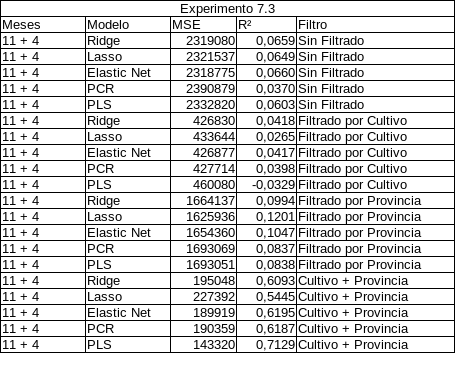


El experimento 7.3 contempla el uso de los dos meses con mejor valor en sus metricas individuales y el uso de estadisticos que mejor comportamiento mostraron en los experimentos  del 5.1 al 5.10. 

En esta instancia para el filtrado por Cultivo y Provincia llegamos a valores de R2 del orden de 0.6 e inluso hasta 0.71 en el caso de PLS.
Estos valores soy sustancialmente altos si los comparamos con todos los experimentos realizados antes. 

Para comprender mejor si esto es una casualidad debido a la naturaleza de los datos, o si efectivamente estamos ante los indicios de un posible grupo de predictores de utilidad, vamos a replicar ahora una serie de experimentos con este conjunto de predictores pero variando la dupla de Cultivo/Provincia, de manera de ver si mantenemos un orden alto en las metricas o si las mismas caen.

De mantener un orden alto podremos seguir evaluando refinar los modelos o buscar nuevas tecnicas, de caer podriamos considerar que detectamos posibles buenos predictores para este conjunto especifico de datos.

### Evaluación de metricas sobre distintos pares Provincia/Cultivo en un mismo conjunto de predictores

True

In [ ]:
### Experimento 8.1

In [944]:
## Creamos una lista vacía para almacenar los resultados
resultados = []

# Variables predictoras (filtradas por los patrones especificados)
dfx_var = df_predictores[df_predictores.filter(regex='^(4_|11_).*_(sum|min|mean|std|median)$', axis=1).columns].copy()

# Variable objetivo
y_total = df_merged_final[df_merged_final.columns[6]]

# Valores únicos de cultivo y provincia
cultivos = df_predictores['Cultivo'].unique()
provincias = df_predictores['Provincia'].unique()

# Iteramos sobre cada combinación de provincia y cultivo
for provincia in provincias:
    for cultivo in cultivos:

        x, y = filtro_por_cultivo_provincia(dfx_var, y_total, cultivo, provincia)

        if y.shape[0] > 10:
            try:
                # Modelos Ridge, Lasso y ElasticNet (sin problemas con componentes)
                resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                               test_size=0.2, random_state=42, n_splits=5, iterat=10000, graficar=0)
                resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                                      l1_ratios=np.linspace(0.1, 0.9, 9),
                                                      test_size=0.2, random_state=42, n_splits=5, graficar=0)

                # Calcular cantidad válida de componentes para PCR/PLS
                from sklearn.model_selection import train_test_split
                x_train_tmp, _, _, _ = train_test_split(x, y, test_size=0.2, random_state=42)
                max_comp_validos = min(20, x_train_tmp.shape[0], x_train_tmp.shape[1])

                if max_comp_validos > 1:
                    resultado_pcr = pcr_modelo(x, y, max_components=max_comp_validos,
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                    resultado_pls = pls_modelo(x, y, max_components=max_comp_validos,
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                else:
                    resultado_pcr = ("PCR", None, None)
                    resultado_pls = ("PLS", None, None)

                # Guardamos resultados
                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Ridge',
                    'MSE': resultado_ridge[2],
                    'R2': resultado_ridge[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Lasso',
                    'MSE': resultado_lasso[1],
                    'R2': resultado_lasso[2],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Elastic Net',
                    'MSE': resultado_elastic[2],
                    'R2': resultado_elastic[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'PCR',
                    'MSE': resultado_pcr[2],
                    'R2': resultado_pcr[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'PLS',
                    'MSE': resultado_pls[2],
                    'R2': resultado_pls[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

            except Exception as e:
                print(f"Error en combinación Provincia: {provincia}, Cultivo: {cultivo} -> {e}")

# Convertimos a DataFrame
df_resultados = pd.DataFrame(resultados)

# Guardamos en CSV
df_resultados.to_csv("resultados_modelos_por_cultivo_y_provincia_1.csv", index=False)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 106208.1531
R2 en Test: 0.8292


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 141402.2406
R2 en Test: 0.7725


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 170200.1115, R² Test: 0.7262
Número óptimo de componentes: 5
MSE Test: 179803.1384, R² Test: 0.7108
Número óptimo de componentes: 1
MSE Test: 186671.9909, R² Test: 0.6997
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241895.7460
R2 en Test: -0.0045
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 1
MSE Test: 238730.3168, R² Test: 0.0087


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 250703.7204, R² Test: -0.0410
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 144959.0097
R2 en Test: 0.5489
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 182280.3412
R2 en Test: 0.4327


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 168396.7203, R² Test: 0.4759
Número óptimo de componentes: 8
MSE Test: 138853.6365, R² Test: 0.5679
Número óptimo de componentes: 1
MSE Test: 172848.4236, R² Test: 0.4621
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 546632.9014
R2 en Test: -1.8664


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 177961.9083
R2 en Test: 0.0668


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 169597.7813, R² Test: 0.1107
Número óptimo de componentes: 1
MSE Test: 133898.8149, R² Test: 0.2979
Número óptimo de componentes: 18
MSE Test: 527885.8590, R² Test: -1.7681
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 117374.0761
R2 en Test: 0.4591


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 167948.5481
R2 en Test: 0.2260


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 141226.7989, R² Test: 0.3491
Número óptimo de componentes: 1
MSE Test: 217986.7673, R² Test: -0.0046
Número óptimo de componentes: 1
MSE Test: 118197.1717, R² Test: 0.4553
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 141129.4004
R2 en Test: -1.6053
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 151345.9043, R² Test: -1.7939
Número óptimo de componentes: 6
MSE Test: 316406.8543, R² Test: -4.8411


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 304368.3793, R² Test: -4.6188
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 150862.3400
R2 en Test: 0.4937
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 189334.0025
R2 en Test: 0.3646


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 156310.5957, R² Test: 0.4754
Número óptimo de componentes: 5
MSE Test: 178955.0180, R² Test: 0.3994
Número óptimo de componentes: 2
MSE Test: 172499.0584, R² Test: 0.4211
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 109924.7622
R2 en Test: -0.0962
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 129894.9259
R2 en Test: -0.2953


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000655, Mejor l1_ratio: 0.10
MSE Test: 422986.7670, R² Test: -3.2181
Número óptimo de componentes: 2
MSE Test: 134130.3294, R² Test: -0.3376
Número óptimo de componentes: 2
MSE Test: 117991.8268, R² Test: -0.1766
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2395987.5454
R2 en Test: 0.4812


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 4624701.6300
R2 en Test: -0.0014


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 2379201.7305, R² Test: 0.4848
Número óptimo de componentes: 8
MSE Test: 2458922.5689, R² Test: 0.4676
Número óptimo de componentes: 2
MSE Test: 2422960.9083, R² Test: 0.4754
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 424834.9838
R2 en Test: 0.4145


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 459549.6357
R2 en Test: 0.3666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 425159.0762, R² Test: 0.4140
Número óptimo de componentes: 1
MSE Test: 726254.6513, R² Test: -0.0010
Número óptimo de componentes: 1
MSE Test: 421825.8593, R² Test: 0.4186
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 251330.4856
R2 en Test: 0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 343221.7400
R2 en Test: -0.3426


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 253968.8492, R² Test: 0.0066
Número óptimo de componentes: 1
MSE Test: 267295.1250, R² Test: -0.0456
Número óptimo de componentes: 1
MSE Test: 204184.8929, R² Test: 0.2013
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 121701.6080
R2 en Test: 0.2739


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 137450.4946
R2 en Test: 0.1800


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 132203.2442, R² Test: 0.2113
Número óptimo de componentes: 5
MSE Test: 116155.0983, R² Test: 0.3070
Número óptimo de componentes: 1
MSE Test: 114469.6715, R² Test: 0.3171
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 195048.0578
R2 en Test: 0.6093


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 227391.8983
R2 en Test: 0.5445


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 189919.1401, R² Test: 0.6195
Número óptimo de componentes: 5
MSE Test: 190358.7669, R² Test: 0.6187
Número óptimo de componentes: 1
MSE Test: 143319.6218, R² Test: 0.7129
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1448621.0643
R2 en Test: 0.0742


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3034831.4413
R2 en Test: -0.9395


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1323843.1444, R² Test: 0.1540
Número óptimo de componentes: 6
MSE Test: 1209220.2513, R² Test: 0.2272
Número óptimo de componentes: 2
MSE Test: 1285022.6167, R² Test: 0.1788
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 284008.8663
R2 en Test: 0.5403


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 331337.0291
R2 en Test: 0.4637


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 378436.3114, R² Test: 0.3875
Número óptimo de componentes: 1
MSE Test: 645261.0056, R² Test: -0.0444
Número óptimo de componentes: 3
MSE Test: 162494.5142, R² Test: 0.7370
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 77125.3270
R2 en Test: 0.0416


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 63319.8420
R2 en Test: 0.2132


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 77348.7595, R² Test: 0.0389
Número óptimo de componentes: 2
MSE Test: 104806.1836, R² Test: -0.3023
Número óptimo de componentes: 1
MSE Test: 112435.3512, R² Test: -0.3971
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 791216.6386
R2 en Test: 0.6104


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 674859.9353
R2 en Test: 0.6677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 774403.6229, R² Test: 0.6187
Número óptimo de componentes: 6
MSE Test: 884383.4555, R² Test: 0.5645
Número óptimo de componentes: 4
MSE Test: 792539.6553, R² Test: 0.6098
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60798.4895
R2 en Test: -0.1449
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 60037.5600, R² Test: -0.1306
Número óptimo de componentes: 1
MSE Test: 70992.8246, R² Test: -0.3369


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 479409.6760, R² Test: -8.0277
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 10787.0921
R2 en Test: 0.1439
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.60
MSE Test: 14942.0928, R² Test: -0.1859
Número óptimo de componentes: 3
MSE Test: 17954.6675, R² Test: -0.4250


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 19905.8166, R² Test: -0.5799
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1397429.3142
R2 en Test: 0.3677
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1687259.2383
R2 en Test: 0.2365


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1355959.9524, R² Test: 0.3864
Número óptimo de componentes: 6
MSE Test: 1115880.2382, R² Test: 0.4951
Número óptimo de componentes: 2
MSE Test: 1174927.3058, R² Test: 0.4683
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 148962.8869
R2 en Test: -0.1227


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007
Mejor alpha: 494.171336, Mejor l1_ratio: 0.10
MSE Test: 132084.3457, R² Test: 0.0045
Número óptimo de componentes: 9
MSE Test: 217431.6477, R² Test: -0.6387


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 4
MSE Test: 328427.0536, R² Test: -1.4752
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 227249.3963
R2 en Test: -0.4880
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 223734.1774, R² Test: -0.4650
Número óptimo de componentes: 1
MSE Test: 238722.8884, R² Test: -0.5631
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 432854.7744
R2 en Test: -0.0955


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 3
MSE Test: 366671.5154, R² Test: 0.0720
Número óptimo de componentes: 1
MSE Test: 309458.2125, R² Test: 0.2168
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 1260993.8735
R2 en Test: -1.4184
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 816564.0079
R2 en Test: -0.5661


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 1210139.7523, R² Test: -1.3209
Número óptimo de componentes: 8
MSE Test: 1416457.8587, R² Test: -1.7166


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 1709457.6406, R² Test: -2.2785
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 3081237.4114
R2 en Test: 0.3020
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2601731.7602
R2 en Test: 0.4106


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 3205184.8987, R² Test: 0.2739
Número óptimo de componentes: 6
MSE Test: 3260977.2018, R² Test: 0.2613
Número óptimo de componentes: 9
MSE Test: 3324130.7513, R² Test: 0.2470
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 244741.9363
R2 en Test: -0.2483


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 243830.2865
R2 en Test: -0.2436


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 242589.7559, R² Test: -0.2373
Número óptimo de componentes: 7
MSE Test: 234144.2437, R² Test: -0.1942
Número óptimo de componentes: 1
MSE Test: 242124.4154, R² Test: -0.2349
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 32006.0064
R2 en Test: -0.1073
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 35609.9605, R² Test: -0.2320


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 201631.7964, R² Test: -5.9757
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 190142.7804
R2 en Test: 0.8346
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 224953.8125
R2 en Test: 0.8043


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 188654.5252, R² Test: 0.8359
Número óptimo de componentes: 10
MSE Test: 252900.7362, R² Test: 0.7800
Número óptimo de componentes: 3
MSE Test: 149435.6365, R² Test: 0.8700
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 194889.5529
R2 en Test: 0.4133


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 265073.4189
R2 en Test: 0.2020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 208072.3213, R² Test: 0.3736
Número óptimo de componentes: 4
MSE Test: 163347.8696, R² Test: 0.5082
Número óptimo de componentes: 1
MSE Test: 153410.1014, R² Test: 0.5382
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 367919.1504
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2032556.2491
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 405261.8118, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 444531.4976, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1295899.1674, R² Test: 0.0000
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 188620.5819
R2 en Test: -1.3513
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 193080.1382, R² Test: -1.4068
Número óptimo de componentes: 1
MSE Test: 188174.4563, R² Test: -1.3457


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 177682.8252, R² Test: -1.2149
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 71329.4078
R2 en Test: 0.6548
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 81532.1310
R2 en Test: 0.6054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 68732.2465, R² Test: 0.6673
Número óptimo de componentes: 6
MSE Test: 77831.0094, R² Test: 0.6233
Número óptimo de componentes: 3
MSE Test: 76807.7177, R² Test: 0.6282
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 30866.6199
R2 en Test: 0.4791


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 34368.2060
R2 en Test: 0.4200


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 31025.6389, R² Test: 0.4764
Número óptimo de componentes: 4
MSE Test: 32353.1957, R² Test: 0.4540
Número óptimo de componentes: 2
MSE Test: 41996.7918, R² Test: 0.2912
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1833826.4264
R2 en Test: 0.6181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1743285.3957
R2 en Test: 0.6370


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1814455.4054, R² Test: 0.6222
Número óptimo de componentes: 7
MSE Test: 2197260.1323, R² Test: 0.5425
Número óptimo de componentes: 2
MSE Test: 2192744.2150, R² Test: 0.5434
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 26861.3337
R2 en Test: -0.3431
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.50
MSE Test: 27398.4675, R² Test: -0.3699
Número óptimo de componentes: 1
MSE Test: 25332.6346, R² Test: -0.2666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 30863.4697, R² Test: -0.5432
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 152867.3964
R2 en Test: 0.2212
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 161098.8294
R2 en Test: 0.1792


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 148838.2223, R² Test: 0.2417
Número óptimo de componentes: 2
MSE Test: 132309.2997, R² Test: 0.3259
Número óptimo de componentes: 1
MSE Test: 96525.8385, R² Test: 0.5082
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 379631.6285
R2 en Test: 0.7614


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 385211.6105
R2 en Test: 0.7579


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 377900.7178, R² Test: 0.7625
Número óptimo de componentes: 7
MSE Test: 454842.1961, R² Test: 0.7141
Número óptimo de componentes: 2
MSE Test: 479411.8500, R² Test: 0.6987
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 576718.5908
R2 en Test: 0.3965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 712778.3547
R2 en Test: 0.2541


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 574158.2963, R² Test: 0.3992
Número óptimo de componentes: 7
MSE Test: 628387.3440, R² Test: 0.3424
Número óptimo de componentes: 1
MSE Test: 528127.0804, R² Test: 0.4474
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 77712.4008
R2 en Test: -0.5691
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 446306.4004
R2 en Test: -8.0117


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 278522.7431, R² Test: -4.6238
Número óptimo de componentes: 5
MSE Test: 182527.9655, R² Test: -2.6855


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 331790.8392, R² Test: -5.6994
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 323920.4009
R2 en Test: -0.3235
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 428217.2427, R² Test: -0.7497
Número óptimo de componentes: 1
MSE Test: 200966.7942, R² Test: 0.1788
Número óptimo de componentes: 1
MSE Test: 531988.4555, R² Test: -1.1737
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 407355.8875
R2 en Test: -0.3460
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 447927.0415, R² Test: -0.4801
Número óptimo de componentes: 1
MSE Test: 185810.9965, R² Test: 0.3860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 564157.3607, R² Test: -0.8641
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1395341.2293
R2 en Test: -0.1736
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.70
MSE Test: 1411558.7648, R² Test: -0.1872
Número óptimo de componentes: 1
MSE Test: 1311481.1542, R² Test: -0.1030
Número óptimo de componentes: 2
MSE Test: 1064282.9753, R² Test: 0.1049
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 37149.5337
R2 en Test: -0.2820
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 50769.4937
R2 en Test: -0.7520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 35672.4757, R² Test: -0.2310
Número óptimo de componentes: 1
MSE Test: 31391.8228, R² Test: -0.0833


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 231669.0422, R² Test: -6.9946
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 179974.9653
R2 en Test: -1.1455
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 186639.5090
R2 en Test: -1.2249


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 180434.7477, R² Test: -1.1510
Número óptimo de componentes: 1
MSE Test: 181552.0596, R² Test: -1.1643


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 8
MSE Test: 254919.9571, R² Test: -2.0389
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 415180.1976
R2 en Test: -0.0708


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 9
MSE Test: 641261.0280, R² Test: -0.6539
Número óptimo de componentes: 2
MSE Test: 469223.5339, R² Test: -0.2102
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2858155.8545
R2 en Test: -0.3132
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3202927.6183
R2 en Test: -0.4716


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2915054.0768, R² Test: -0.3393
Número óptimo de componentes: 12
MSE Test: 3877660.9305, R² Test: -0.7816


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 2632169.4622, R² Test: -0.2094
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 1092813.8816
R2 en Test: 0.2331
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 953140.9551
R2 en Test: 0.3312


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 828225.0817, R² Test: 0.4188
Número óptimo de componentes: 5
MSE Test: 578911.3137, R² Test: 0.5938
Número óptimo de componentes: 2
MSE Test: 763108.3384, R² Test: 0.4645
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 91870.7704
R2 en Test: 0.0116


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 87365.3954
R2 en Test: 0.0601


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 86105.8009, R² Test: 0.0736
Número óptimo de componentes: 3
MSE Test: 115839.3631, R² Test: -0.2463
Número óptimo de componentes: 1
MSE Test: 103619.9244, R² Test: -0.1148
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 15409.1424
R2 en Test: 0.1042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 35750.0006
R2 en Test: -1.0783
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 15541.1141, R² Test: 0.0965
Número óptimo de componentes: 3
MSE Test: 17820.1172, R² Test: -0.0360


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 10655.2540, R² Test: 0.3806
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 603856.9236
R2 en Test: 0.6802
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 432977.0945
R2 en Test: 0.7707


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.30
MSE Test: 652491.2052, R² Test: 0.6544
Número óptimo de componentes: 9
MSE Test: 523238.0145, R² Test: 0.7229
Número óptimo de componentes: 3
MSE Test: 581142.8315, R² Test: 0.6922
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 508735.3460
R2 en Test: 0.2748


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 601196.2351
R2 en Test: 0.1430


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 529154.8920, R² Test: 0.2457
Número óptimo de componentes: 18
MSE Test: 436299.0263, R² Test: 0.3781
Número óptimo de componentes: 8
MSE Test: 480886.5054, R² Test: 0.3145
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 990384.4593
R2 en Test: 0.0352


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 936613.1750
R2 en Test: 0.0876


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 965649.4509, R² Test: 0.0593
Número óptimo de componentes: 1
MSE Test: 946218.8378, R² Test: 0.0782
Número óptimo de componentes: 1
MSE Test: 1087148.8237, R² Test: -0.0591
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 648125.9788
R2 en Test: -0.1117


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662
Mejor alpha: 35.564803, Mejor l1_ratio: 0.20
MSE Test: 676052.4603, R² Test: -0.1596
Número óptimo de componentes: 2
MSE Test: 762902.9201, R² Test: -0.3086
Número óptimo de componentes: 1
MSE Test: 881233.0556, R² Test: -0.5115
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 193617.1750
R2 en Test: -0.1635
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 161930.8604
R2 en Test: 0.0269


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 193474.4583, R² Test: -0.1627
Número óptimo de componentes: 4
MSE Test: 219227.3826, R² Test: -0.3174


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 222363.2406, R² Test: -0.3363
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 151493.7491
R2 en Test: -0.0064


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 180880.5368, R² Test: -0.2016
Número óptimo de componentes: 1
MSE Test: 157660.6799, R² Test: -0.0474
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 26081.9568
R2 en Test: -0.1473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 24671.0254
R2 en Test: -0.0853
Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 27441.5585, R² Test: -0.2071
Número óptimo de componentes: 1
MSE Test: 30930.0091, R² Test: -0.3606
Número óptimo de componentes: 1
MSE Test: 53048.4412, R² Test: -1.3336
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2336806.2472
R2 en Test: 0.5170


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3114083.1902
R2 en Test: 0.3564


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2941673.1175, R² Test: 0.3920
Número óptimo de componentes: 10
MSE Test: 2495409.3525, R² Test: 0.4842
Número óptimo de componentes: 3
MSE Test: 1707549.5877, R² Test: 0.6471
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1153021.9226
R2 en Test: -0.8070


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 343904.1359
R2 en Test: 0.4610


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 871479.3639, R² Test: -0.3658
Número óptimo de componentes: 7
MSE Test: 1582171.7359, R² Test: -1.4795
Número óptimo de componentes: 2
MSE Test: 1085574.7667, R² Test: -0.7013
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 81504.0803
R2 en Test: -0.6147
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 215968.8306
R2 en Test: -3.2786


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 97941.9095, R² Test: -0.9403
Número óptimo de componentes: 1
MSE Test: 71329.7031, R² Test: -0.4131


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 171270.0619, R² Test: -2.3931
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 442524.6676
R2 en Test: 0.1943
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 458048.0410
R2 en Test: 0.1660


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 418934.0057, R² Test: 0.2372
Número óptimo de componentes: 2
MSE Test: 445851.2096, R² Test: 0.1882
Número óptimo de componentes: 1
MSE Test: 338107.0374, R² Test: 0.3844
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 819290.5028
R2 en Test: 0.2893


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 972780.5382
R2 en Test: 0.1562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 830427.2119, R² Test: 0.2797
Número óptimo de componentes: 19
MSE Test: 650318.9803, R² Test: 0.4359
Número óptimo de componentes: 7
MSE Test: 849260.8114, R² Test: 0.2633
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 656758.0745
R2 en Test: 0.0288


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 628053.7033
R2 en Test: 0.0712


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 642694.8180, R² Test: 0.0496
Número óptimo de componentes: 6
MSE Test: 625859.5868, R² Test: 0.0745
Número óptimo de componentes: 1
MSE Test: 541464.4840, R² Test: 0.1993
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 60116.4840
R2 en Test: 0.4156


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 60350.8958
R2 en Test: 0.4133


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 59473.5780, R² Test: 0.4219
Número óptimo de componentes: 8
MSE Test: 58249.7961, R² Test: 0.4338
Número óptimo de componentes: 3
MSE Test: 52332.0069, R² Test: 0.4913
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 133464.9860
R2 en Test: 0.3512


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 142719.5868
R2 en Test: 0.3062


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 135580.7956, R² Test: 0.3409
Número óptimo de componentes: 7
MSE Test: 161659.9824, R² Test: 0.2141
Número óptimo de componentes: 3
MSE Test: 135888.7864, R² Test: 0.3394
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 409522.6359
R2 en Test: 0.3552


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 380943.2396
R2 en Test: 0.4002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 410923.7429, R² Test: 0.3530
Número óptimo de componentes: 9
MSE Test: 496142.5119, R² Test: 0.2188
Número óptimo de componentes: 3
MSE Test: 453972.6511, R² Test: 0.2852
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 172170.9964
R2 en Test: 0.5045


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 230165.7881
R2 en Test: 0.3376


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 220252.4471, R² Test: 0.3661
Número óptimo de componentes: 1
MSE Test: 275908.8700, R² Test: 0.2060
Número óptimo de componentes: 1
MSE Test: 204046.2972, R² Test: 0.4128
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 74408.2372
R2 en Test: 0.1517


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 115446.0074
R2 en Test: -0.3161
Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 74872.6660, R² Test: 0.1464
Número óptimo de componentes: 11
MSE Test: 65271.9776, R² Test: 0.2559
Número óptimo de componentes: 3
MSE Test: 72733.4592, R² Test: 0.1708
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 57604.2031
R2 en Test: 0.7453


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 66090.0470
R2 en Test: 0.7078


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 60265.9955, R² Test: 0.7335
Número óptimo de componentes: 12
MSE Test: 87925.5280, R² Test: 0.6112
Número óptimo de componentes: 3
MSE Test: 70691.3219, R² Test: 0.6874
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 29528.3920
R2 en Test: -0.7358
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 47720.5583
R2 en Test: -1.8052


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.50
MSE Test: 28843.4582, R² Test: -0.6956
Número óptimo de componentes: 4
MSE Test: 24314.6795, R² Test: -0.4293
Número óptimo de componentes: 1
MSE Test: 22610.1735, R² Test: -0.3291
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1934515.0382
R2 en Test: 0.4689


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2045932.6762
R2 en Test: 0.4383


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1924905.1023, R² Test: 0.4715
Número óptimo de componentes: 9
MSE Test: 2545028.8408, R² Test: 0.3013
Número óptimo de componentes: 3
MSE Test: 2062382.3398, R² Test: 0.4338
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207372.9276
R2 en Test: -0.0235
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 184806.2725, R² Test: 0.0879


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 165630.9182, R² Test: 0.1825
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 84772.8603
R2 en Test: 0.2123
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.60
MSE Test: 115375.1326, R² Test: -0.0721
Número óptimo de componentes: 1
MSE Test: 125347.2543, R² Test: -0.1648
Número óptimo de componentes: 2
MSE Test: 88190.1581, R² Test: 0.1805
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224909.4474
R2 en Test: -0.0300
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 12
MSE Test: 722516.4719, R² Test: -2.3089


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 9
MSE Test: 704084.6065, R² Test: -2.2245
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 158393.5138
R2 en Test: 0.5351
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 205263.6467
R2 en Test: 0.3975


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 179974.3565, R² Test: 0.4717
Número óptimo de componentes: 10
MSE Test: 202286.5229, R² Test: 0.4062
Número óptimo de componentes: 3
MSE Test: 200040.2741, R² Test: 0.4128
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 220041.2304
R2 en Test: 0.4459


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 151371.4459
R2 en Test: 0.6188


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 189023.3728, R² Test: 0.5240
Número óptimo de componentes: 10
MSE Test: 322193.9282, R² Test: 0.1886
Número óptimo de componentes: 3
MSE Test: 299478.1023, R² Test: 0.2458
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 185495.2285
R2 en Test: 0.3255


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 204822.1616
R2 en Test: 0.2552


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 162050.8644, R² Test: 0.4107
Número óptimo de componentes: 8
MSE Test: 231425.4473, R² Test: 0.1584
Número óptimo de componentes: 2
MSE Test: 237921.5711, R² Test: 0.1348
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 352748.6559
R2 en Test: 0.5876


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 484370.5265
R2 en Test: 0.4338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 373605.2850, R² Test: 0.5632
Número óptimo de componentes: 9
MSE Test: 389329.4629, R² Test: 0.5449
Número óptimo de componentes: 3
MSE Test: 347671.2586, R² Test: 0.5936
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 417610.0200
R2 en Test: -1.3952
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 266295.0429
R2 en Test: -0.5273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.268270, Mejor l1_ratio: 0.90
MSE Test: 421364.6712, R² Test: -1.4167
Número óptimo de componentes: 8
MSE Test: 417610.2637, R² Test: -1.3952


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 6
MSE Test: 418463.9865, R² Test: -1.4001
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 110155.6726
R2 en Test: 0.1992
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 115671.3680, R² Test: 0.1591
Número óptimo de componentes: 3
MSE Test: 118080.5705, R² Test: 0.1415
Número óptimo de componentes: 1
MSE Test: 105752.4202, R² Test: 0.2312
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 330191.2483
R2 en Test: 0.0630


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 320782.7661
R2 en Test: 0.0897


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 317555.2325, R² Test: 0.0989
Número óptimo de componentes: 9
MSE Test: 317016.1848, R² Test: 0.1004
Número óptimo de componentes: 1
MSE Test: 366891.4982, R² Test: -0.0411
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 222836.0185
R2 en Test: -0.1636


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 220128.3691, R² Test: -0.1495
Número óptimo de componentes: 3
MSE Test: 221332.7842, R² Test: -0.1557
Número óptimo de componentes: 1
MSE Test: 217334.8298, R² Test: -0.1349
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 128308.7754
R2 en Test: -0.2990
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 140430.7584
R2 en Test: -0.4218


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 144140.1471, R² Test: -0.4593
Número óptimo de componentes: 2
MSE Test: 144976.7980, R² Test: -0.4678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 112290.1605, R² Test: -0.1369
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 174357.1506
R2 en Test: 0.2344
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 178095.3059, R² Test: 0.2180
Número óptimo de componentes: 5
MSE Test: 159698.4929, R² Test: 0.2988
Número óptimo de componentes: 1
MSE Test: 166461.6803, R² Test: 0.2691
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 158519.4431
R2 en Test: -4.6519
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 95102.1234
R2 en Test: -2.3908


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 149223.3916, R² Test: -4.3204
Número óptimo de componentes: 2
MSE Test: 104986.1841, R² Test: -2.7432


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 6
MSE Test: 214966.8486, R² Test: -6.6645
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2997870.2337
R2 en Test: 0.2920
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 3019942.6488, R² Test: 0.2868
Número óptimo de componentes: 2
MSE Test: 2871919.3468, R² Test: 0.3217
Número óptimo de componentes: 1
MSE Test: 2360189.6941, R² Test: 0.4426
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 963751.7752
R2 en Test: -3.7513
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 575122.0554
R2 en Test: -1.8354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 1962312.3410, R² Test: -8.6743
Número óptimo de componentes: 12
MSE Test: 960524.6535, R² Test: -3.7354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 11
MSE Test: 963717.3253, R² Test: -3.7512
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 142098.2740
R2 en Test: 0.1776
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 175701.0005, R² Test: -0.0169
Número óptimo de componentes: 8
MSE Test: 119493.1783, R² Test: 0.3084
Número óptimo de componentes: 1
MSE Test: 102337.6052, R² Test: 0.4077
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 311285.3510
R2 en Test: 0.2155


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 328539.6181
R2 en Test: 0.1720
Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 308434.7823, R² Test: 0.2227
Número óptimo de componentes: 2
MSE Test: 258542.1010, R² Test: 0.3484
Número óptimo de componentes: 1
MSE Test: 310033.8559, R² Test: 0.2187
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 295895.6821
R2 en Test: 0.0361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 295617.4856, R² Test: 0.0370
Número óptimo de componentes: 10
MSE Test: 300613.6225, R² Test: 0.0207
Número óptimo de componentes: 1
MSE Test: 422716.1112, R² Test: -0.3771
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 324645.8246
R2 en Test: 0.0418


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 322789.8976, R² Test: 0.0473
Número óptimo de componentes: 5
MSE Test: 302636.2060, R² Test: 0.1068
Número óptimo de componentes: 1
MSE Test: 276226.2459, R² Test: 0.1847


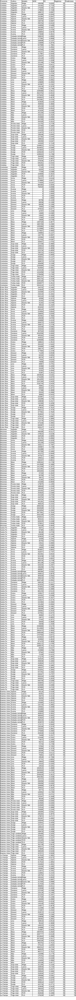

In [719]:
pd.DataFrame(dfx_var).to_csv("../Metricas/Experimento8_1/predictores_78.csv")
pd.DataFrame(dfy).to_csv("../Metricas/Experimento8_1/objetivo_78.csv")
pd.DataFrame(df_merged_final).to_csv("../Metricas/Experimento8_1/set_completo.csv")

In [717]:
df_resultados

,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
0,Córdoba,Algodón,Ridge,106208.153089,0.829158,53,78
1,Córdoba,Algodón,Lasso,141402.240586,0.772547,53,78
2,Córdoba,Algodón,Elastic Net,170200.111492,0.726224,53,78
3,Córdoba,Algodón,PCR,179803.138419,0.710777,53,78
4,Córdoba,Algodón,PLS,186671.990852,0.699728,53,78
...,...,...,...,...,...,...,...
450,La Pampa,Trigo total,Ridge,324645.824632,0.041838,55,78
451,La Pampa,Trigo total,Lasso,390432.933884,-0.152327,55,78
452,La Pampa,Trigo total,Elastic Net,322789.897555,0.047315,55,78
453,La Pampa,Trigo total,PCR,302636.205957,0.106797,55,78


In [721]:
# Vemos la media de R2 por modelo
df_resultados.groupby('Provincia').mean('R2')

,MSE,R2,Registros,Predictores
Provincia,,,,
Buenos Aires,325038.523191,0.173114,46.466667,78.0
Corrientes,688563.728526,-0.196309,41.181818,78.0
Córdoba,502115.323045,-0.028366,48.533333,78.0
Entre Rios,388960.193913,0.077973,42.538462,78.0
La Pampa,524289.435970,-0.709715,43.076923,78.0
Misiones,778253.176716,-0.930366,34.666667,78.0
Santa Fe,587193.244231,-0.075796,46.666667,78.0


In [723]:
# Vemos la media de R2 por modelo
df_resultados[df_resultados['Modelo']=='PLS'].groupby('Provincia').mean('R2')

,MSE,R2,Registros,Predictores
Provincia,,,,
Buenos Aires,341178.261651,0.134474,46.466667,78.0
Corrientes,771764.941018,-0.979976,41.181818,78.0
Córdoba,440362.967653,-0.101695,48.533333,78.0
Entre Rios,435896.992712,-0.264875,42.538462,78.0
La Pampa,464414.020148,-0.827051,43.076923,78.0
Misiones,760367.773802,-1.846762,34.666667,78.0
Santa Fe,551399.033697,-0.174368,46.666667,78.0


In [725]:
df_resultados[df_resultados['Modelo']=='PCR'].groupby('Provincia').mean('R2')

,MSE,R2,Registros,Predictores
Provincia,,,,
Buenos Aires,392827.169745,0.048269,46.466667,78.0
Corrientes,698117.251851,-0.135600,41.181818,78.0
Córdoba,476815.489525,-0.111273,48.533333,78.0
Entre Rios,374386.505818,0.173227,42.538462,78.0
La Pampa,484417.722002,-0.526962,43.076923,78.0
Misiones,799062.673892,-0.479217,34.666667,78.0
Santa Fe,606953.118377,-0.066736,46.666667,78.0


In [727]:
# Vemos la media de R2 por modelo
df_resultados[df_resultados['Modelo']=='Ridge'].groupby('Provincia').mean('R2')

,MSE,R2,Registros,Predictores
Provincia,,,,
Buenos Aires,287004.322434,0.287291,46.466667,78.0
Corrientes,680786.836699,0.017824,41.181818,78.0
Córdoba,445367.933348,0.077913,48.533333,78.0
Entre Rios,330032.416304,0.179159,42.538462,78.0
La Pampa,505963.497633,-0.692417,43.076923,78.0
Misiones,754178.261258,-0.332281,34.666667,78.0
Santa Fe,581298.733112,0.018989,46.666667,78.0


In [729]:
df_resultados[df_resultados['Modelo']=='Elastic Net'].groupby('Provincia').mean('R2')

,MSE,R2,Registros,Predictores
Provincia,,,,
Buenos Aires,291204.698054,0.265238,46.466667,78.0
Corrientes,681550.478332,0.007779,41.181818,78.0
Córdoba,446984.030334,-0.040116,48.533333,78.0
Entre Rios,331643.793297,0.175787,42.538462,78.0
La Pampa,586998.203169,-1.074414,43.076923,78.0
Misiones,771590.735658,-0.824794,34.666667,78.0
Santa Fe,608627.979846,0.003630,46.666667,78.0


In [731]:
# Vemos la media de R2 por modelo
df_resultados[df_resultados['Modelo']=='Lasso'].groupby('Provincia').mean('R2')

,MSE,R2,Registros,Predictores
Provincia,,,,
Buenos Aires,312978.164072,0.130300,46.466667,78.0
Corrientes,610599.134728,0.108429,41.181818,78.0
Córdoba,701046.194365,0.033339,48.533333,78.0
Entre Rios,472841.261435,0.126568,42.538462,78.0
La Pampa,579653.736897,-0.427731,43.076923,78.0
Misiones,806066.438971,-1.168777,34.666667,78.0
Santa Fe,587687.356121,-0.160493,46.666667,78.0


In [749]:
print(f"Cantidad de pares Provincia/Cultivo con muy bajo (<0.2) R2: {df_resultados[df_resultados['R2']<0.2].shape[0]}")
print(f"Cantidad de pares Provincia/Cultivo con bajo (<0.5) R2: {df_resultados[df_resultados['R2']<0.5].shape[0]}")
print(f"Cantidad de pares Provincia/Cultivo con alto (>=0.5) R2: {df_resultados[df_resultados['R2']>=0.5].shape[0]}")

Cantidad de pares Provincia/Cultivo con muy bajo (<0.2) R2: 259
Cantidad de pares Provincia/Cultivo con bajo (<0.5) R2: 387
Cantidad de pares Provincia/Cultivo con alto (>=0.5) R2: 68


In [745]:
# Vemos como se distribuyen las metricas con R2 superior a 0.5 con respecto a los modelos predictores
df_resultados[df_resultados['R2']>=0.5].groupby("Modelo")['Modelo'].count()

Modelo
Elastic Net    12
Lasso          11
PCR            14
PLS            15
Ridge          16
Name: Modelo, dtype: int64

Sobre el total de pares de Provincia/Cultivo (91) obtenemos 455 metricas asociadas a cada uno de los modelos analizado, de estos registros 259 registros dieron un valor muy bajo de r2 ubicandose por debajo de 0.2,  128 mostraron un valor de R2 inferior a 0.5 (superior o igual a 0.2) y 68 mostraron un valor mas alto (superior o igual a 0.5).

Se evaluo la distribución de estas 68 metricas y encontramos que es bastante simetrica dando una mayor cantidad de valores altos en Ridge mientras menos cantidad en Lasso.

In [754]:
# Creamos una columna compuesta para poder trabajar mas facil con las duplas
df_resultados['Temp'] = df_resultados['Provincia']+df_resultados['Cultivo']

In [756]:
# Vemos como se conforman las duplas
df_resultados['Temp'].unique()

array(['CórdobaAlgodón', 'CórdobaAlpiste', 'CórdobaAvena',
       'CórdobaCebada cervecera', 'CórdobaCenteno', 'CórdobaColza',
       'CórdobaGirasol', 'CórdobaLino', 'CórdobaMaíz', 'CórdobaManí',
       'CórdobaMijo', 'CórdobaPoroto total', 'CórdobaSoja total',
       'CórdobaSorgo', 'CórdobaTrigo total', 'CorrientesAlgodón',
       'CorrientesArroz', 'CorrientesAvena', 'CorrientesGirasol',
       'CorrientesLino', 'CorrientesMaíz', 'CorrientesManí',
       'CorrientesSoja total', 'CorrientesSorgo', 'CorrientesTrigo total',
       'CorrientesYerba mate', 'Entre RiosAlgodón', 'Entre RiosAlpiste',
       'Entre RiosArroz', 'Entre RiosAvena', 'Entre RiosCenteno',
       'Entre RiosColza', 'Entre RiosGirasol', 'Entre RiosLino',
       'Entre RiosMaíz', 'Entre RiosManí', 'Entre RiosSoja total',
       'Entre RiosSorgo', 'Entre RiosTrigo total', 'MisionesAlgodón',
       'MisionesArroz', 'MisionesAvena', 'MisionesMaíz', 'MisionesManí',
       'MisionesPoroto total', 'MisionesSoja total', 'M

In [760]:
# Vemos cuales son los pares de Provincia/Cultivo con valores de R2 alto
df_resultados[df_resultados['R2']>=0.5]['Temp'].unique()

array(['CórdobaAlgodón', 'CórdobaAvena', 'CórdobaSoja total',
       'CórdobaTrigo total', 'CorrientesArroz', 'CorrientesAvena',
       'Entre RiosArroz', 'Entre RiosAvena', 'Entre RiosGirasol',
       'Entre RiosMaíz', 'Entre RiosSoja total', 'Entre RiosSorgo',
       'MisionesYerba mate', 'Santa FeArroz', 'Santa FeMaíz',
       'Buenos AiresCenteno', 'Buenos AiresGirasol',
       'Buenos AiresSoja total', 'Buenos AiresSorgo',
       'Buenos AiresTrigo total'], dtype=object)

In [774]:
# Evaluamos los mejores resultados de R2 para cada par que superan .5
df_resultados[df_resultados['R2']>=0.5].groupby(['Provincia','Cultivo'])['R2'].max()

Provincia     Cultivo    
Buenos Aires  Centeno        0.504508
              Girasol        0.745278
              Soja total     0.535063
              Sorgo          0.618800
              Trigo total    0.593566
Corrientes    Arroz          0.667701
              Avena          1.000000
Córdoba       Algodón        0.829158
              Avena          0.567858
              Soja total     0.712894
              Trigo total    0.737003
Entre Rios    Arroz          0.869987
              Avena          0.538165
              Girasol        0.667326
              Maíz           0.636998
              Soja total     0.508229
              Sorgo          0.762483
Misiones      Yerba mate     0.593762
Santa Fe      Arroz          0.770697
              Maíz           0.647072
Name: R2, dtype: float64

Hasta aqui podemos considerar que tenemos modelos predictivos con metricas considerables para determinados pares de Provincia y Cultivo

Es llamativo el valor de Avena en la provincia de Corrientes que da 1 como metrica, solo para tener registros de esto vamos a investigar un poco sobre que pudo causar esta metrica antes de avanzar con el analisis de aquellos pares que no se pudieron resolver eficientemente.

In [793]:
df_merged_final[(df_merged_final['Provincia']=='Corrientes') & (df_merged_final['Cultivo']=='Avena')]

,Cultivo,YEAR,Provincia,Sup. Sembrada,Sup. Cosechada,Producción,Rendimiento,10_Humedad_Media_8_14_20_kurtosis,10_Humedad_Media_8_14_20_max,10_Humedad_Media_8_14_20_mean,...,ALLSKY_SFC_UVB_skew,ALLSKY_SFC_UVB_kurtosis,ALLSKY_SFC_UV_INDEX_mean,ALLSKY_SFC_UV_INDEX_sum,ALLSKY_SFC_UV_INDEX_min,ALLSKY_SFC_UV_INDEX_max,ALLSKY_SFC_UV_INDEX_std,ALLSKY_SFC_UV_INDEX_median,ALLSKY_SFC_UV_INDEX_skew,ALLSKY_SFC_UV_INDEX_kurtosis
690,Avena,1972,Corrientes,2390,0,0,0,-1.036405,90.500000,64.838710,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
691,Avena,1973,Corrientes,1670,0,0,0,-0.305189,93.000000,68.048387,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
692,Avena,1974,Corrientes,1996,0,0,0,0.809992,84.000000,54.193548,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
693,Avena,1975,Corrientes,1500,0,0,0,-0.529978,81.519843,66.987585,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
694,Avena,1976,Corrientes,2500,0,0,0,-0.484406,82.000000,62.145161,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
695,Avena,1977,Corrientes,2100,0,0,0,-0.390528,90.500000,67.081285,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
696,Avena,1978,Corrientes,3200,0,0,0,-1.071888,93.000000,72.290963,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
697,Avena,1979,Corrientes,3250,0,0,0,-1.492028,93.500000,74.887097,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
698,Avena,1980,Corrientes,3200,0,0,0,-0.731499,93.000000,70.467742,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989
699,Avena,1981,Corrientes,3600,0,0,0,-0.410693,94.000000,57.016129,...,0.177942,-1.184292,1.940773,708.871321,0.156993,4.149981,1.074347,1.819944,0.218699,-1.168989


Se puede apreciar que hay un error en los datos registrados de cosecha, a su vez se puede visibilizar dos errores que podrian haber generado errores en las predicciones anteriores:

1) Registros = 0 en todo el historico del par

2) Registros segmentados en dos periodos (en este caso puntual inicia en 1972 hasta 1989 y luego se discontinua hasta 2022).

Procederemos a inspeccionar si tenemos mas casos que puedan haber presentado este tipo de inconsistencia, hay que tener en cuenta que el error del punto (1) afectaria solamente a las metricas obtenidas en "Sin Filtro", "Filtro Provincial", y "Filtro Cosecha".

In [796]:
# Resguardamos el df_merged_final
df_control = df_merged_final.copy()

In [798]:
# Creamos una columna combinada para identificacion unica
df_control['Temp'] = df_control['Provincia']+' - '+df_control['Cultivo']

In [820]:
# Vemos la desviación estandar de los registros sobre las duplas con bajo r2 para ver si hay casos que no puedan aportar información de utilidad
df_control.groupby('Temp')['Rendimiento'].std().sort_values()

Temp
Corrientes - Avena               0.000000
Misiones - Trigo total           0.000000
Corrientes - Centeno             0.000000
Misiones - Girasol             127.192767
Entre Rios - Maní              138.080675
                                 ...     
Entre Rios - Maíz             2159.320553
Córdoba - Maíz                2211.365773
Entre Rios - Cártamo                  NaN
Entre Rios - Trigo candeal            NaN
La Pampa - Cártamo                    NaN
Name: Rendimiento, Length: 107, dtype: float64

Vemos que tenemos 3 combinaciones de Provincia/Cultivo que hay que descartar por no presentar ningun tipo de variabilidad en sus valores,esto implica que no hay predicción realizable sobre las mismas.

Por otro lado vemos algunas combinaciones con NaN, repasando el codigo usado no se habria utilizado un filtrado o drop de los NA con anterioridad, igualmente no obtuvimos errores al ejecutar los modelos 

In [827]:
# Por lo que podemos apreciar el error de NA que obtuvimos es debido a que hay un solo registro para este par, y dado a que analizamos la desviación estandar, esto da un error NA
df_control[(df_control['Provincia']=='La Pampa') & (df_control['Cultivo']=='Cártamo')]

,Cultivo,YEAR,Provincia,Sup. Sembrada,Sup. Cosechada,Producción,Rendimiento,10_Humedad_Media_8_14_20_kurtosis,10_Humedad_Media_8_14_20_max,10_Humedad_Media_8_14_20_mean,...,ALLSKY_SFC_UVB_kurtosis,ALLSKY_SFC_UV_INDEX_mean,ALLSKY_SFC_UV_INDEX_sum,ALLSKY_SFC_UV_INDEX_min,ALLSKY_SFC_UV_INDEX_max,ALLSKY_SFC_UV_INDEX_std,ALLSKY_SFC_UV_INDEX_median,ALLSKY_SFC_UV_INDEX_skew,ALLSKY_SFC_UV_INDEX_kurtosis,Temp
900,Cártamo,2014,La Pampa,2500,2500,3500,1400,-0.246874,96.0,68.368566,...,-1.264162,1.896192,692.11,0.3,4.17,1.119457,1.71,0.345742,-1.201042,La Pampa - Cártamo


In [847]:
# Vamos a ver la cantidad de registros por pares que tuvimos para entender la utilidad de los registros con bajo r2
listado_bajo_r2 = list(df_resultados[df_resultados['R2']<0.5]['Provincia']+" - "+df_resultados[df_resultados['R2']<0.5]['Cultivo']     )

listado_bajo_r2 = list(set(listado_bajo_r2))
listado_bajo_r2


['La Pampa - Centeno',
 'Corrientes - Girasol',
 'Buenos Aires - Mijo',
 'Buenos Aires - Trigo candeal',
 'Córdoba - Maní',
 'Corrientes - Trigo total',
 'Córdoba - Lino',
 'Misiones - Algodón',
 'Buenos Aires - Soja total',
 'Santa Fe - Maní',
 'Entre Rios - Soja total',
 'Corrientes - Maíz',
 'Santa Fe - Mijo',
 'Santa Fe - Avena',
 'Entre Rios - Algodón',
 'Santa Fe - Soja total',
 'La Pampa - Girasol',
 'Santa Fe - Sorgo',
 'Córdoba - Sorgo',
 'La Pampa - Trigo total',
 'La Pampa - Sorgo',
 'La Pampa - Soja total',
 'Buenos Aires - Trigo total',
 'Córdoba - Girasol',
 'Santa Fe - Algodón',
 'Misiones - Soja total',
 'Corrientes - Maní',
 'Entre Rios - Trigo total',
 'Buenos Aires - Sorgo',
 'Corrientes - Sorgo',
 'Santa Fe - Trigo total',
 'Santa Fe - Girasol',
 'La Pampa - Maíz',
 'La Pampa - Avena',
 'Córdoba - Poroto total',
 'Buenos Aires - Colza',
 'Buenos Aires - Maní',
 'Buenos Aires - Cebada cervecera',
 'Misiones - Maíz',
 'Santa Fe - Cebada cervecera',
 'Santa Fe - Alpist

In [873]:
df_control[df_control['Temp'].isin(listado_bajo_r2)].groupby('Temp')['Temp'].count().sort_values()

Temp
Entre Rios - Centeno           11
La Pampa - Alpiste             12
Entre Rios - Maní              12
Buenos Aires - Maní            12
Misiones - Avena               13
                               ..
La Pampa - Avena               55
La Pampa - Cebada cervecera    55
La Pampa - Centeno             55
La Pampa - Maíz                55
Santa Fe - Trigo total         55
Name: Temp, Length: 81, dtype: int64

Vemos que de los 81 pares, todos muestran una cantidad de registros que deberian permitir un buen analisis

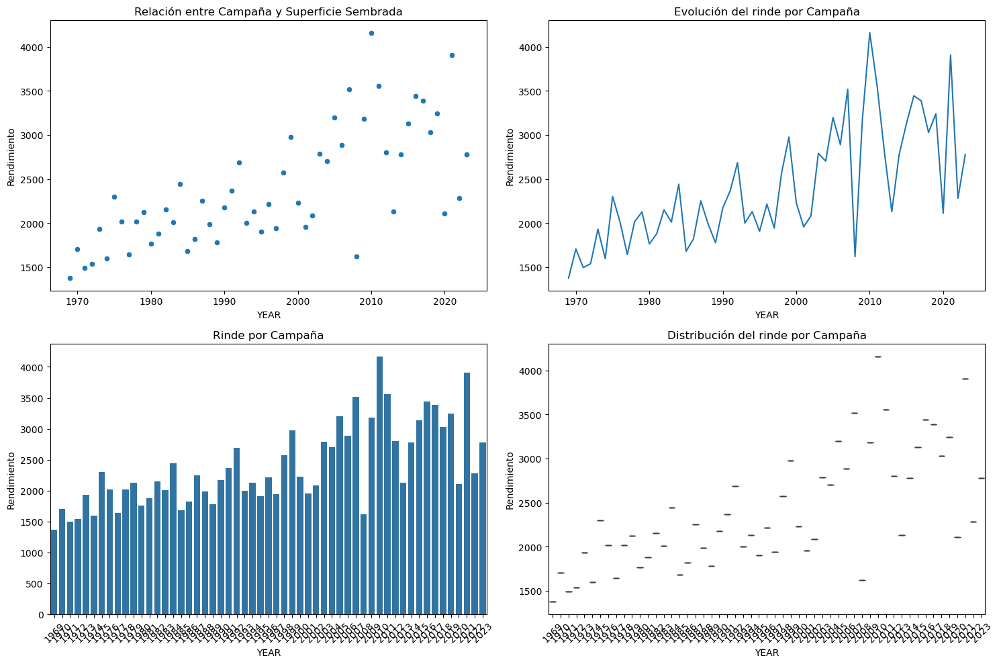

In [894]:
df_tmp = df_control[df_control['Temp']=='Santa Fe - Trigo total'][['YEAR','Rendimiento']]


import seaborn as sns

# Crear una figura con 4 subplots (2 filas, 2 columnas)
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Gráfico de dispersión - Evolución en el tiempo 
sns.scatterplot(x='YEAR', y='Rendimiento', data=df_tmp, ax=axes[0, 0])
axes[0, 0].set_title('Relación entre Campaña y Superficie Sembrada')

# Gráfico de líneas - Evolución en el tiempo de la Superficie Sembrada
sns.lineplot(x='YEAR', y='Rendimiento', data=df_tmp, ax=axes[0, 1])
axes[0, 1].set_title('Evolución del rinde por Campaña')

# Gráfico de barras - Evolución en el tiempo de la Superficie Sembrada
sns.barplot(x='YEAR', y='Rendimiento', data=df_tmp, ax=axes[1, 0])
axes[1, 0].set_title('Rinde por Campaña')
axes[1, 0].tick_params(axis='x', rotation=45)

# Boxplot - Evolución en el tiempo de la Superficie Sembrada
sns.boxplot(x='YEAR', y='Rendimiento', data=df_tmp, ax=axes[1, 1])
axes[1, 1].set_title('Distribución del rinde por Campaña')
axes[1, 1].tick_params(axis='x', rotation=45)

# Ajustar el espaciado entre los subplots
plt.tight_layout()

# Mostrar la figura
plt.show()



Sobre este caso testigo en representacion de los 81 casos encontrados, vemos que muestra una tendencia clara a crecer con una curva simil a una sinusoidal.

Vamos a tomar este caso como testigo para ver si reevaluando sobre otro set de predictores cambian las metricas

In [909]:
cultivo = "Trigo total"
provincia = "Santa Fe"
dfx_var = df_merged_final.copy()
y_total = df_merged_final[df_merged_final.columns[6]]
x, y = filtro_por_cultivo_provincia(dfx_var, y_total, cultivo, provincia)

In [924]:
resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42,n_splits=5,graficar=0)
resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50), test_size=0.2, random_state=42, n_splits=5,iterat=10000,graficar=0)
resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50), l1_ratios=np.linspace(0.1, 0.9, 9), test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pcr = pcr_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)
resultado_pls = pls_modelo(x, y, max_components=20, test_size=0.2, random_state=42, n_splits=5,graficar=0)


print("-----------FILTRADO POR CULTIVO Y PROVINCIA -----")
print(f"Predictores: {x.shape[1]} Registros: {x.shape[0]} ")
print("Ridge")
print(f"MSE: {resultado_ridge[2]} ")      
print(f"r2: {resultado_ridge[1]} ")      
print("Lasso")
print(f"MSE: {resultado_lasso[1]} ")      
print(f"r2: {resultado_lasso[2]} ")      
print("Elastic Net")
print(f"MSE: {resultado_elastic[2]} ")      
print(f"r2: {resultado_elastic[1]} ")      
print("PCR")
print(f"MSE: {resultado_pcr[2]} ")      
print(f"r2: {resultado_pcr[1]} ")      
print("PLS")
print(f"MSE: {resultado_pls[2]} ")      
print(f"r2: {resultado_pls[1]} ")     


Mejor valor de alpha encontrado: 5.428675
MSE en Test: 296051.5225
R2 en Test: 0.5622
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 125377.0509
R2 en Test: 0.8146


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000146, Mejor l1_ratio: 0.90
MSE Test: 125378.4887, R² Test: 0.8146
Número óptimo de componentes: 1
MSE Test: 711731.6120, R² Test: -0.0525
Número óptimo de componentes: 17
MSE Test: 292727.8142, R² Test: 0.5671
-----------FILTRADO POR CULTIVO Y PROVINCIA -----
Predictores: 997 Registros: 55 
Ridge
MSE: 296051.52252561593 
r2: 0.5621954138833484 
Lasso
MSE: 125377.05089953901 
r2: 0.8145908948235535 
Elastic Net
MSE: 125378.48871208722 
r2: 0.8145887685688995 
PCR
MSE: 711731.6120248958 
r2: -0.052517349583080186 
PLS
MSE: 292727.81417386647 
r2: 0.5671105541498005 


In [917]:
# Metricas obtenidas para la dupla de Santa Fe/Trigo total sobre el set de predictores reducido
df_resultados[(df_resultados['Provincia']=='Santa Fe') & (df_resultados['Cultivo']=='Trigo total')][['Modelo','R2']]

,Modelo,R2
310,Ridge,0.028778
311,Lasso,0.071227
312,Elastic Net,0.049575
313,PCR,0.074471
314,PLS,0.199276


In [919]:
df_resultados[(df_resultados['Provincia']=='Córdoba') & (df_resultados['Cultivo']=='Trigo total')][['Modelo','R2']]

,Modelo,R2
70,Ridge,0.540332
71,Lasso,0.463732
72,Elastic Net,0.387502
73,PCR,-0.044353
74,PLS,0.737003


In [921]:
df_resultados[(df_resultados['Provincia']=='Buenos Aires') & (df_resultados['Cultivo']=='Trigo total')][['Modelo','R2']]

,Modelo,R2
385,Ridge,0.587631
386,Lasso,0.433763
387,Elastic Net,0.563249
388,PCR,0.544867
389,PLS,0.593566


Resulta interesante ver que las metricas obtenidas para modelos entrenados con el mismo cultivo pero distintas provincias cambian sustancialmente.

Luego de numerosas pruebas con distintas combinaciones de predictores nos encontramos con que es factible que sean necesarios otros parametros/predictores para poder obtener resultados mas generalizables, un ejemplo simple podria ser la aplicación de fertilizantes/agroquimicos/pesticidas.

La intención de esta investigación era modelar un sistema para predecir los rindes aislando el analisis de otros parametros como la rotaciones de cultivo, el ph,sustrato, y caracteristicas propias de la tierra donde se realiza la siembra, a su vez se busco identificar como puede impactar en el rinde las variables climaticas sobre otras variables no alcanzadas en este analisis.
Entendemos que este proceso nos da la certeza que los factores climaticos no estan explicando mas del 0.8 de la variabilidad de los rindes, por lo que para comprender mejor el comportamiento del rinde del agro en Argentina seria necesario agregar nuevas variables al analisis.


Ya habiendo definido que con los predictores que tenemos a disposición no podemos realizar un modelo que generalice mas los datos, vamos a volver a realizar un modelado bajo distintos predictores pero trabajando bajo el concepto de duplas Provincia/Cultivo como realizamos en el ultimo paso. Para esto volveremos a tomar los 997 predictores, realizaremos una iteración por todas las duplas y volveremos a analizar las metricas sobre cada caso individual.

### Experimento 9

In [942]:
## Creamos una lista vacía para almacenar los resultados
resultados = []

# Variables predictoras (filtradas por los patrones especificados)
dfx_var = df_merged_final[df_merged_final.columns[7:]].copy()

# Variable objetivo
y_total = df_merged_final[df_merged_final.columns[6]]

# Valores únicos de cultivo y provincia
cultivos = df_predictores['Cultivo'].unique()
provincias = df_predictores['Provincia'].unique()

# Iteramos sobre cada combinación de provincia y cultivo
for provincia in provincias:
    for cultivo in cultivos:

        x, y = filtro_por_cultivo_provincia(dfx_var, y_total, cultivo, provincia)

        if y.shape[0] > 10:
            try:
                # Modelos Ridge, Lasso y ElasticNet (sin problemas con componentes)
                resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                               test_size=0.2, random_state=42, n_splits=5, iterat=10000, graficar=0)
                resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                                      l1_ratios=np.linspace(0.1, 0.9, 9),
                                                      test_size=0.2, random_state=42, n_splits=5, graficar=0)

                # Calcular cantidad válida de componentes para PCR/PLS
                
                x_train_tmp, _, _, _ = train_test_split(x, y, test_size=0.2, random_state=42)
                max_comp_validos = min(20, x_train_tmp.shape[0], x_train_tmp.shape[1])

                if max_comp_validos > 1:
                    resultado_pcr = pcr_modelo(x, y, max_components=max_comp_validos,
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                    resultado_pls = pls_modelo(x, y, max_components=max_comp_validos,
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                else:
                    resultado_pcr = ("PCR", None, None)
                    resultado_pls = ("PLS", None, None)

                # Guardamos resultados
                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Ridge',
                    'MSE': resultado_ridge[2],
                    'R2': resultado_ridge[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Lasso',
                    'MSE': resultado_lasso[1],
                    'R2': resultado_lasso[2],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Elastic Net',
                    'MSE': resultado_elastic[2],
                    'R2': resultado_elastic[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'PCR',
                    'MSE': resultado_pcr[2],
                    'R2': resultado_pcr[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'PLS',
                    'MSE': resultado_pls[2],
                    'R2': resultado_pls[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

            except Exception as e:
                print(f"Error en combinación Provincia: {provincia}, Cultivo: {cultivo} -> {e}")

# Convertimos a DataFrame
df_resultados = pd.DataFrame(resultados)

# Guardamos en CSV
df_resultados.to_csv("resultados_modelos_por_cultivo_y_provincia_2.csv", index=False)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 193229.4329
R2 en Test: 0.6892


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 330074.9057
R2 en Test: 0.4691


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 199259.6670, R² Test: 0.6795
Número óptimo de componentes: 5
MSE Test: 197382.5793, R² Test: 0.6825
Número óptimo de componentes: 2
MSE Test: 244053.4003, R² Test: 0.6074
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237450.4717
R2 en Test: 0.0140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.50
MSE Test: 233706.9182, R² Test: 0.0295
Número óptimo de componentes: 2
MSE Test: 251292.5058, R² Test: -0.0435


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 210104.9828, R² Test: 0.1276
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 87031.4818
R2 en Test: 0.7291


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 209315.4690
R2 en Test: 0.3486


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.50
MSE Test: 96548.9905, R² Test: 0.6995
Número óptimo de componentes: 5
MSE Test: 216759.5013, R² Test: 0.3254
Número óptimo de componentes: 2
MSE Test: 98798.8827, R² Test: 0.6925
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 164559.6052
R2 en Test: 0.1371


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 150320.3040
R2 en Test: 0.2118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.268270, Mejor l1_ratio: 0.90
MSE Test: 238677.0072, R² Test: -0.2515
Número óptimo de componentes: 16
MSE Test: 148651.8754, R² Test: 0.2205
Número óptimo de componentes: 2
MSE Test: 173820.6258, R² Test: 0.0885
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 99389.4710
R2 en Test: 0.5420


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 225390.0038
R2 en Test: -0.0387


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.70
MSE Test: 99416.5712, R² Test: 0.5418
Número óptimo de componentes: 1
MSE Test: 206630.8908, R² Test: 0.0477
Número óptimo de componentes: 3
MSE Test: 105748.9276, R² Test: 0.5126
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 95350.9131
R2 en Test: -0.7602


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 118400.4288, R² Test: -1.1857


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 78162.0262, R² Test: -0.4429
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 103700.8908
R2 en Test: 0.6520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 109927.4826
R2 en Test: 0.6311


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 113306.5672, R² Test: 0.6197
Número óptimo de componentes: 5
MSE Test: 152809.9239, R² Test: 0.4871
Número óptimo de componentes: 2
MSE Test: 89848.8330, R² Test: 0.6985
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 50688.6178
R2 en Test: 0.4945


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 217404.0345
R2 en Test: -1.1680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 51707.2339, R² Test: 0.4844
Número óptimo de componentes: 1
MSE Test: 88949.9356, R² Test: 0.1130
Número óptimo de componentes: 1
MSE Test: 61525.2550, R² Test: 0.3865
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2402363.6112
R2 en Test: 0.4798


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3593178.6073
R2 en Test: 0.2220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 2360109.6764, R² Test: 0.4890
Número óptimo de componentes: 4
MSE Test: 3218160.4331, R² Test: 0.3032
Número óptimo de componentes: 2
MSE Test: 2435298.7141, R² Test: 0.4727
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 359245.9480
R2 en Test: 0.5049


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 425501.4591
R2 en Test: 0.4135


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 439836.7467, R² Test: 0.3938
Número óptimo de componentes: 6
MSE Test: 482396.2277, R² Test: 0.3351
Número óptimo de componentes: 1
MSE Test: 378043.0529, R² Test: 0.4789
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 217383.4585
R2 en Test: 0.1497


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.60
MSE Test: 230542.1570, R² Test: 0.0982
Número óptimo de componentes: 1
MSE Test: 258526.0213, R² Test: -0.0113
Número óptimo de componentes: 1
MSE Test: 217240.1967, R² Test: 0.1502
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 141832.7530
R2 en Test: 0.1538


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 146382.2815
R2 en Test: 0.1267


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 143054.7968, R² Test: 0.1465
Número óptimo de componentes: 5
MSE Test: 144063.3800, R² Test: 0.1405
Número óptimo de componentes: 1
MSE Test: 142074.9781, R² Test: 0.1524
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 240808.4725
R2 en Test: 0.5176


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 258662.6309
R2 en Test: 0.4818


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 222613.7893, R² Test: 0.5540
Número óptimo de componentes: 3
MSE Test: 301236.9743, R² Test: 0.3965
Número óptimo de componentes: 2
MSE Test: 260825.4635, R² Test: 0.4775
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1076968.8487
R2 en Test: 0.3117


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2587605.6050
R2 en Test: -0.6537


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.60
MSE Test: 1081013.6048, R² Test: 0.3092
Número óptimo de componentes: 4
MSE Test: 1140879.2238, R² Test: 0.2709
Número óptimo de componentes: 2
MSE Test: 937724.1713, R² Test: 0.4007
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 227134.0182
R2 en Test: 0.6324


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.828643
MSE en Test: 726547.8178
R2 en Test: -0.1759


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.70
MSE Test: 258897.6678, R² Test: 0.5810
Número óptimo de componentes: 5
MSE Test: 541480.2523, R² Test: 0.1236
Número óptimo de componentes: 3
MSE Test: 200429.3116, R² Test: 0.6756
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 93953.0415
R2 en Test: -0.1675


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 137518.5788
R2 en Test: -0.7088


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 90333.8286, R² Test: -0.1225
Número óptimo de componentes: 2
MSE Test: 95495.9407, R² Test: -0.1866
Número óptimo de componentes: 1
MSE Test: 125465.1989, R² Test: -0.5590
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 269095.7094
R2 en Test: 0.8675


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 169279.3606
R2 en Test: 0.9166


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 198693.5288, R² Test: 0.9022
Número óptimo de componentes: 7
MSE Test: 214240.5624, R² Test: 0.8945
Número óptimo de componentes: 2
MSE Test: 178084.3989, R² Test: 0.9123
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 74109.4892
R2 en Test: -0.3955
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 934021.6338
R2 en Test: -16.5885


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 143727.6214, R² Test: -1.7065
Número óptimo de componentes: 18
MSE Test: 998633.6739, R² Test: -17.8052


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 967147.6090, R² Test: -17.2123
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 11497.2539
R2 en Test: 0.0875
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 12925.9175
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 2
MSE Test: 10028.8392, R² Test: 0.2040


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 5589.1982, R² Test: 0.5564
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 1378956.9518
R2 en Test: 0.3760
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1586111.5943
R2 en Test: 0.2823


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 1462427.7827, R² Test: 0.3382
Número óptimo de componentes: 3
MSE Test: 1295247.0707, R² Test: 0.4139
Número óptimo de componentes: 1
MSE Test: 1273229.5411, R² Test: 0.4239
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 124949.6620
R2 en Test: 0.0583


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 137354.6496
R2 en Test: -0.0352
Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 134797.5151, R² Test: -0.0159
Número óptimo de componentes: 1
MSE Test: 130224.8216, R² Test: 0.0185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 4
MSE Test: 137402.4421, R² Test: -0.0356
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 227137.6025
R2 en Test: -0.4873
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 232711.9581, R² Test: -0.5238
Número óptimo de componentes: 3
MSE Test: 288682.6457, R² Test: -0.8903
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 435278.0176
R2 en Test: -0.1016


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 481893.7538
R2 en Test: -0.2196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 441035.6652, R² Test: -0.1162
Número óptimo de componentes: 1
MSE Test: 428526.3861, R² Test: -0.0845
Número óptimo de componentes: 3
MSE Test: 626671.6890, R² Test: -0.5860
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 524119.7761
R2 en Test: -0.0052


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 1.206793
MSE en Test: 1209590.5332
R2 en Test: -1.3199


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.40
MSE Test: 1313756.2144, R² Test: -1.5196
Número óptimo de componentes: 8
MSE Test: 769064.1845, R² Test: -0.4750


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 632146.2043, R² Test: -0.2124
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1574802.8380
R2 en Test: 0.6433


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1561929.5912
R2 en Test: 0.6462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1568864.2297, R² Test: 0.6446
Número óptimo de componentes: 3
MSE Test: 2125139.8279, R² Test: 0.5186
Número óptimo de componentes: 1
MSE Test: 1464907.6885, R² Test: 0.6681
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 260110.6986
R2 en Test: -0.3267


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 231687.5704
R2 en Test: -0.1817


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 262037.9878, R² Test: -0.3365
Número óptimo de componentes: 7
MSE Test: 245443.7626, R² Test: -0.2518
Número óptimo de componentes: 1
MSE Test: 251927.9682, R² Test: -0.2849
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 33560.5964
R2 en Test: -0.1611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 27489.7137
R2 en Test: 0.0490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.70
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 15
MSE Test: 212860.8131, R² Test: -6.3642


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 93153.7150, R² Test: -2.2228
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 335267.7840
R2 en Test: 0.7083


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 230513.2479
R2 en Test: 0.7994


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 229286.3823, R² Test: 0.8005
Número óptimo de componentes: 2
MSE Test: 427100.5889, R² Test: 0.6284
Número óptimo de componentes: 1
MSE Test: 402772.2881, R² Test: 0.6496
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 150094.2983
R2 en Test: 0.5481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 235382.2457
R2 en Test: 0.2914


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.60
MSE Test: 156142.5059, R² Test: 0.5299
Número óptimo de componentes: 2
MSE Test: 151496.9218, R² Test: 0.5439
Número óptimo de componentes: 1
MSE Test: 116659.2402, R² Test: 0.6488
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 420804.1876
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2479376.2860
R2 en Test: 0.0000
Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 652673.4236, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 338102.5055, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 3061471.5042, R² Test: 0.0000
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 203781.4139
R2 en Test: -1.5402
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 17
MSE Test: 299755.7644, R² Test: -2.7366


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 298623.7728, R² Test: -2.7225
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 49772.2804
R2 en Test: 0.7591


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 82999.9039
R2 en Test: 0.5983


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 52199.9746, R² Test: 0.7473
Número óptimo de componentes: 6
MSE Test: 40082.3413, R² Test: 0.8060
Número óptimo de componentes: 1
MSE Test: 43188.7202, R² Test: 0.7910
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 30216.0972
R2 en Test: 0.4901


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 19004.9465
R2 en Test: 0.6793


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 25411.6402, R² Test: 0.5711
Número óptimo de componentes: 3
MSE Test: 36478.1563, R² Test: 0.3844
Número óptimo de componentes: 1
MSE Test: 32698.0086, R² Test: 0.4482
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1398129.1136
R2 en Test: 0.7089


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1309138.9122
R2 en Test: 0.7274


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1366773.3064, R² Test: 0.7154
Número óptimo de componentes: 6
MSE Test: 1709722.2814, R² Test: 0.6440
Número óptimo de componentes: 1
MSE Test: 1489103.8799, R² Test: 0.6899
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26622.5021
R2 en Test: -0.3311


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 30641.9006
R2 en Test: -0.5321
Mejor alpha: 0.000100, Mejor l1_ratio: 0.80
MSE Test: 39941.1999, R² Test: -0.9971
Número óptimo de componentes: 1
MSE Test: 27187.2634, R² Test: -0.3594


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 23719.7528, R² Test: -0.1860
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 167606.2006
R2 en Test: 0.1461
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 225886.2316
R2 en Test: -0.1508


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.30
MSE Test: 160591.6226, R² Test: 0.1818
Número óptimo de componentes: 2
MSE Test: 197152.5147, R² Test: -0.0044
Número óptimo de componentes: 1
MSE Test: 153521.4192, R² Test: 0.2179
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 329367.5425
R2 en Test: 0.7930


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 459503.6466
R2 en Test: 0.7112


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 312117.2321, R² Test: 0.8038
Número óptimo de componentes: 14
MSE Test: 323392.9710, R² Test: 0.7967
Número óptimo de componentes: 1
MSE Test: 278861.5704, R² Test: 0.8247
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 561988.5084
R2 en Test: 0.4119


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 593447.7097
R2 en Test: 0.3790


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 569116.4540, R² Test: 0.4045
Número óptimo de componentes: 2
MSE Test: 494954.5001, R² Test: 0.4821
Número óptimo de componentes: 1
MSE Test: 445707.8308, R² Test: 0.5336
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 49032.1199
R2 en Test: 0.0100


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 48863.3341, R² Test: 0.0134
Número óptimo de componentes: 1
MSE Test: 63762.4121, R² Test: -0.2875


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 42071.6207, R² Test: 0.1505
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 384303.8714
R2 en Test: -0.5703
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 313185.0023
R2 en Test: -0.2797


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.70
MSE Test: 625999.8767, R² Test: -1.5578
Número óptimo de componentes: 13
MSE Test: 351797.7334, R² Test: -0.4374
Número óptimo de componentes: 3
MSE Test: 380934.4562, R² Test: -0.5565
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 280184.1125
R2 en Test: 0.0742


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 809786.8883
R2 en Test: -1.6757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 224718.0823, R² Test: 0.2575
Número óptimo de componentes: 10
MSE Test: 57387.8488, R² Test: 0.8104


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 53339.5045, R² Test: 0.8238
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1108039.2119
R2 en Test: 0.0681
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 1120844.1172, R² Test: 0.0573
Número óptimo de componentes: 5
MSE Test: 1005916.8601, R² Test: 0.1540
Número óptimo de componentes: 2
MSE Test: 1232561.1784, R² Test: -0.0367
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 40883.7496
R2 en Test: -0.4108


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.000100
MSE en Test: 82114.7398
R2 en Test: -1.8337


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 39262.1844, R² Test: -0.3549
Número óptimo de componentes: 4
MSE Test: 67715.0193, R² Test: -1.3368


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 87495.3238, R² Test: -2.0194
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 177668.2429
R2 en Test: -1.1180


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 178256.0698, R² Test: -1.1250
Número óptimo de componentes: 7
MSE Test: 155643.5052, R² Test: -0.8554


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 172179.2895, R² Test: -1.0525
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 368536.0549
R2 en Test: 0.0495
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 6
MSE Test: 306710.4512, R² Test: 0.2090
Número óptimo de componentes: 2
MSE Test: 238899.6655, R² Test: 0.3839
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2585175.5368
R2 en Test: -0.1878


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2312243.3886
R2 en Test: -0.0624


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.126486, Mejor l1_ratio: 0.90
MSE Test: 2889743.7535, R² Test: -0.3277
Número óptimo de componentes: 1
MSE Test: 2361156.4430, R² Test: -0.0848


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2550666.4238, R² Test: -0.1719
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 384777.1610
R2 en Test: 0.7300
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1560356.0182
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 1049656.5500, R² Test: 0.2634
Número óptimo de componentes: 10
MSE Test: 477443.3615, R² Test: 0.6650
Número óptimo de componentes: 6
MSE Test: 383610.5141, R² Test: 0.7308
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 99227.7873
R2 en Test: -0.0675


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 229364.6534
R2 en Test: -1.4676


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 125450.9900, R² Test: -0.3497
Número óptimo de componentes: 2
MSE Test: 101392.2989, R² Test: -0.0908
Número óptimo de componentes: 1
MSE Test: 99196.1762, R² Test: -0.0672
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 6714.4025
R2 en Test: 0.6097


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 21290.5807
R2 en Test: -0.2377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 5336.2421, R² Test: 0.6898
Número óptimo de componentes: 1
MSE Test: 12219.8808, R² Test: 0.2896


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 7286.9143, R² Test: 0.5764
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 953945.1086
R2 en Test: 0.4948


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 949974.6752
R2 en Test: 0.4969


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1062346.7372, R² Test: 0.4374
Número óptimo de componentes: 2
MSE Test: 843006.0657, R² Test: 0.5535
Número óptimo de componentes: 2
MSE Test: 713204.4296, R² Test: 0.6223
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 466836.6316
R2 en Test: 0.3345


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 610173.3650
R2 en Test: 0.1302


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 513846.5356, R² Test: 0.2675
Número óptimo de componentes: 4
MSE Test: 506963.3703, R² Test: 0.2773
Número óptimo de componentes: 1
MSE Test: 541033.8948, R² Test: 0.2288
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 842616.7992
R2 en Test: 0.1791


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 848484.4291
R2 en Test: 0.1734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 839243.1062, R² Test: 0.1824
Número óptimo de componentes: 2
MSE Test: 808675.3407, R² Test: 0.2122
Número óptimo de componentes: 1
MSE Test: 745336.7826, R² Test: 0.2739
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 607012.9264
R2 en Test: -0.0412


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 523162.9908
R2 en Test: 0.1026


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 607225.6570, R² Test: -0.0415
Número óptimo de componentes: 2
MSE Test: 736689.4792, R² Test: -0.2636
Número óptimo de componentes: 1
MSE Test: 664405.4535, R² Test: -0.1396
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 187955.3222
R2 en Test: -0.1295


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 269367.0515
R2 en Test: -0.6187
Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 162583.0319, R² Test: 0.0230
Número óptimo de componentes: 3
MSE Test: 251266.7888, R² Test: -0.5100


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 197361.9831, R² Test: -0.1860
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 167973.2696
R2 en Test: -0.1159


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 160438.2514, R² Test: -0.0658
Número óptimo de componentes: 1
MSE Test: 195303.2348, R² Test: -0.2974
Número óptimo de componentes: 4
MSE Test: 163195.1305, R² Test: -0.0841
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26243.4792
R2 en Test: -0.1544


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.70
MSE Test: 25937.3013, R² Test: -0.1410
Número óptimo de componentes: 1
MSE Test: 24665.3469, R² Test: -0.0850
Número óptimo de componentes: 1
MSE Test: 47631.3636, R² Test: -1.0953
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1952450.3651
R2 en Test: 0.5965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3960641.5213
R2 en Test: 0.1814


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 2009966.5005, R² Test: 0.5846
Número óptimo de componentes: 19
MSE Test: 2804126.3468, R² Test: 0.4204
Número óptimo de componentes: 3
MSE Test: 2122513.2579, R² Test: 0.5613
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 253470.4305
R2 en Test: 0.6028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 171076.6534
R2 en Test: 0.7319


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 249062.1038, R² Test: 0.6097
Número óptimo de componentes: 2
MSE Test: 415709.6650, R² Test: 0.3485
Número óptimo de componentes: 2
MSE Test: 271103.3809, R² Test: 0.5751
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 35602.3227
R2 en Test: 0.2947


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 58973.6970
R2 en Test: -0.1683


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 18384.8026, R² Test: 0.6358
Número óptimo de componentes: 6
MSE Test: 49941.6346, R² Test: 0.0106


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 2
MSE Test: 42890.7376, R² Test: 0.1503
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 386343.4497
R2 en Test: 0.2966
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 491374.9016
R2 en Test: 0.1053


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 488208.5773, R² Test: 0.1111
Número óptimo de componentes: 5
MSE Test: 409852.7569, R² Test: 0.2538
Número óptimo de componentes: 1
MSE Test: 291068.3794, R² Test: 0.4700
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 802662.7619
R2 en Test: 0.3038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 845438.2807, R² Test: 0.2667
Número óptimo de componentes: 6
MSE Test: 1283845.1937, R² Test: -0.1136
Número óptimo de componentes: 2
MSE Test: 742683.3864, R² Test: 0.3558
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 538205.8985
R2 en Test: 0.2041


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 677771.0192
R2 en Test: -0.0023


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 573613.1875, R² Test: 0.1517
Número óptimo de componentes: 1
MSE Test: 718985.3178, R² Test: -0.0632
Número óptimo de componentes: 1
MSE Test: 581226.4532, R² Test: 0.1405
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 63344.2952
R2 en Test: 0.3842


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 64131.9575
R2 en Test: 0.3766


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.70
MSE Test: 54817.5620, R² Test: 0.4671
Número óptimo de componentes: 2
MSE Test: 68511.9131, R² Test: 0.3340
Número óptimo de componentes: 1
MSE Test: 58804.1720, R² Test: 0.4284
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 138033.7749
R2 en Test: 0.3290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 140043.6958
R2 en Test: 0.3192


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 139180.8354, R² Test: 0.3234
Número óptimo de componentes: 1
MSE Test: 136664.7084, R² Test: 0.3356
Número óptimo de componentes: 1
MSE Test: 114389.8563, R² Test: 0.4439
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 275314.7315
R2 en Test: 0.5665


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 332871.4326
R2 en Test: 0.4759


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 260670.1179, R² Test: 0.5896
Número óptimo de componentes: 5
MSE Test: 364755.2177, R² Test: 0.4257
Número óptimo de componentes: 1
MSE Test: 286985.4583, R² Test: 0.5481
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 175038.2990
R2 en Test: 0.4963


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 184554.0099
R2 en Test: 0.4689


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 153668.3912, R² Test: 0.5578
Número óptimo de componentes: 2
MSE Test: 221443.8674, R² Test: 0.3627
Número óptimo de componentes: 1
MSE Test: 145610.8187, R² Test: 0.5809
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 137276.2076
R2 en Test: -0.5650


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 137118.0817
R2 en Test: -0.5632


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 137021.9957, R² Test: -0.5621
Número óptimo de componentes: 2
MSE Test: 151027.8867, R² Test: -0.7218
Número óptimo de componentes: 1
MSE Test: 108610.8860, R² Test: -0.2382
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 110594.5573
R2 en Test: 0.5110


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 128716.3917
R2 en Test: 0.4308


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 111012.4069, R² Test: 0.5091
Número óptimo de componentes: 7
MSE Test: 123779.7144, R² Test: 0.4527
Número óptimo de componentes: 1
MSE Test: 102344.7335, R² Test: 0.5474
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 28532.4483
R2 en Test: -0.6773


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 34671.6659
R2 en Test: -1.0382


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.390694, Mejor l1_ratio: 0.90
MSE Test: 41863.9997, R² Test: -1.4610
Número óptimo de componentes: 3
MSE Test: 21090.7323, R² Test: -0.2398
Número óptimo de componentes: 1
MSE Test: 38178.6589, R² Test: -1.2443
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1630476.9019
R2 en Test: 0.5524


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1617425.2819
R2 en Test: 0.5560


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1522075.0980, R² Test: 0.5821
Número óptimo de componentes: 5
MSE Test: 1877035.8735, R² Test: 0.4847
Número óptimo de componentes: 1
MSE Test: 1295858.3192, R² Test: 0.6442
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204160.0130
R2 en Test: -0.0076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1085182.4110
R2 en Test: -4.3559


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.90
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 191863.2793, R² Test: 0.0531


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 219999.9795, R² Test: -0.0858
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 114272.5748
R2 en Test: -0.0619
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.30
MSE Test: 116090.8303, R² Test: -0.0788
Número óptimo de componentes: 1
MSE Test: 116862.8598, R² Test: -0.0859
Número óptimo de componentes: 4
MSE Test: 89546.9002, R² Test: 0.1679
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 203263.3754
R2 en Test: 0.0691


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 77194.2627
R2 en Test: 0.6465


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 223922.1549, R² Test: -0.0255
Número óptimo de componentes: 12
MSE Test: 126973.8541, R² Test: 0.4185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 151083.2452, R² Test: 0.3081
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 213454.1732
R2 en Test: 0.3734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 212286.3734
R2 en Test: 0.3769


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 205028.8327, R² Test: 0.3982
Número óptimo de componentes: 5
MSE Test: 186500.4370, R² Test: 0.4526
Número óptimo de componentes: 1
MSE Test: 148222.2925, R² Test: 0.5649
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 265873.5248
R2 en Test: 0.3304


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 186031.5915
R2 en Test: 0.5315


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 206443.5128, R² Test: 0.4801
Número óptimo de componentes: 5
MSE Test: 187994.3065, R² Test: 0.5266
Número óptimo de componentes: 1
MSE Test: 173729.5349, R² Test: 0.5625
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 151227.9031
R2 en Test: 0.4501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 183622.3102
R2 en Test: 0.3323


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 165640.5575, R² Test: 0.3977
Número óptimo de componentes: 3
MSE Test: 137404.3982, R² Test: 0.5003
Número óptimo de componentes: 1
MSE Test: 105984.3100, R² Test: 0.6146
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 426423.3674
R2 en Test: 0.5015


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 301109.9909
R2 en Test: 0.6480


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 382088.3648, R² Test: 0.5533
Número óptimo de componentes: 6
MSE Test: 473701.7349, R² Test: 0.4462
Número óptimo de componentes: 1
MSE Test: 379057.5915, R² Test: 0.5569
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 260161.2706
R2 en Test: -0.4921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 300359.9024
R2 en Test: -0.7227


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 255140.4249, R² Test: -0.4633
Número óptimo de componentes: 1
MSE Test: 276556.4988, R² Test: -0.5862


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 297660.0917, R² Test: -0.7072
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 83825.3411
R2 en Test: 0.3906


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 83304.7112, R² Test: 0.3944
Número óptimo de componentes: 1
MSE Test: 116784.3914, R² Test: 0.1510
Número óptimo de componentes: 1
MSE Test: 81949.0122, R² Test: 0.4042
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 252139.0217
R2 en Test: 0.2845


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 310265.7315
R2 en Test: 0.1196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 251375.9604, R² Test: 0.2867
Número óptimo de componentes: 3
MSE Test: 259471.4423, R² Test: 0.2637
Número óptimo de componentes: 1
MSE Test: 236385.9192, R² Test: 0.3292
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 178489.7710
R2 en Test: 0.0680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 179121.7300, R² Test: 0.0647
Número óptimo de componentes: 3
MSE Test: 189308.1144, R² Test: 0.0115
Número óptimo de componentes: 1
MSE Test: 157279.5274, R² Test: 0.1787
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 80848.1694
R2 en Test: 0.1815


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 147514.1159
R2 en Test: -0.4935


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 91027.5802, R² Test: 0.0784
Número óptimo de componentes: 14
MSE Test: 80848.1616, R² Test: 0.1815


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 80935.0630, R² Test: 0.1806
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 141498.6966
R2 en Test: 0.3787
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 222916.0185
R2 en Test: 0.0212


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 151377.5811, R² Test: 0.3353
Número óptimo de componentes: 3
MSE Test: 124545.3467, R² Test: 0.4531
Número óptimo de componentes: 1
MSE Test: 97691.9689, R² Test: 0.5710
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 128655.0851
R2 en Test: -3.5871


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 135097.0381
R2 en Test: -3.8168


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.019307, Mejor l1_ratio: 0.30
MSE Test: 124957.1888, R² Test: -3.4553
Número óptimo de componentes: 18
MSE Test: 128242.4412, R² Test: -3.5724


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 126784.7724, R² Test: -3.5204
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 2219671.7324
R2 en Test: 0.4758


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1965308.6216
R2 en Test: 0.5359


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 2310754.5257, R² Test: 0.4543
Número óptimo de componentes: 4
MSE Test: 2350527.3284, R² Test: 0.4449
Número óptimo de componentes: 1
MSE Test: 1469208.1986, R² Test: 0.6530
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1074389.4721
R2 en Test: -4.2968


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1065163.7128
R2 en Test: -4.2513


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 1300197.8463, R² Test: -5.4100
Número óptimo de componentes: 12
MSE Test: 1408684.6905, R² Test: -5.9449


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1200214.2588, R² Test: -4.9171
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 103204.3196
R2 en Test: 0.4027
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 128708.4993
R2 en Test: 0.2551


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.268270, Mejor l1_ratio: 0.50
MSE Test: 101731.8557, R² Test: 0.4112
Número óptimo de componentes: 1
MSE Test: 151374.9887, R² Test: 0.1239
Número óptimo de componentes: 11
MSE Test: 103039.4314, R² Test: 0.4037
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 252659.7012
R2 en Test: 0.3632


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 385997.0293
R2 en Test: 0.0272


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 250510.1387, R² Test: 0.3687
Número óptimo de componentes: 7
MSE Test: 283337.8847, R² Test: 0.2859
Número óptimo de componentes: 1
MSE Test: 248624.6523, R² Test: 0.3734
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 247666.9234
R2 en Test: 0.1932


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.50
MSE Test: 268078.3819, R² Test: 0.1267
Número óptimo de componentes: 1
MSE Test: 235739.7258, R² Test: 0.2320
Número óptimo de componentes: 1
MSE Test: 220819.1712, R² Test: 0.2806
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 242057.5458
R2 en Test: 0.2856


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 370333.1161
R2 en Test: -0.0930


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 242712.1711, R² Test: 0.2837
Número óptimo de componentes: 5
MSE Test: 234474.6108, R² Test: 0.3080
Número óptimo de componentes: 1
MSE Test: 198082.8290, R² Test: 0.4154


In [946]:
df_resultados_78pred = df_resultados.copy()

In [1089]:

df_resultados_992pred = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_2.csv")

In [1091]:
df_resultados_992pred['indice']=df_resultados_992pred['Provincia']+"-"+df_resultados_992pred['Cultivo']+"-"+df_resultados_992pred['Modelo']
df_resultados_78pred['indice']=df_resultados_78pred['Provincia']+"-"+df_resultados_78pred['Cultivo']+"-"+df_resultados_78pred['Modelo']

In [1093]:
df_merged = pd.merge(df_resultados_992pred, df_resultados_78pred, on='indice', how='inner')


In [1095]:
df_merged['Mejora'] = df_merged['R2_x'] - df_merged['R2_y']

In [1097]:
df_merged['Mejora'].describe()

count    455.000000
mean       0.072918
std        1.535786
min      -17.468307
25%       -0.070827
50%        0.057369
75%        0.222649
max        8.011265
Name: Mejora, dtype: float64

En terminos generales podriamos apreciar una mejora en las predicciones, no significa que las mismas sean buenas en lo particular , solo que presenta una mejora en su conjunto, se debera evaluar sobre cada caso para ver cuales puedan cumplir con dos premisas:

1) R2 >= 0.5
2) R2_992 > R2_78

In [1099]:
df_merged[(df_merged['R2_x']>= 0.5) & (df_merged['R2_x']> df_merged['R2_y'])].shape

(78, 16)

In [978]:
# Listamos las duplas con R2>=0.5 y que presentaran alguna mejora contra el modelo de 78 predictores
df_merged[(df_merged['R2_x']>= 0.5) & (df_merged['R2_x']> df_merged['R2_y'])]

,Provincia_x,Cultivo_x,Modelo_x,MSE_x,R2_x,Registros_x,Predictores_x,indice,Provincia_y,Cultivo_y,Modelo_y,MSE_y,R2_y,Registros_y,Predictores_y,Mejora
10,Córdoba,Avena,Ridge,8.703148e+04,0.729140,55,992,Córdoba-Avena-Ridge,Córdoba,Avena,Ridge,1.449590e+05,0.548857,55,78,0.180283
12,Córdoba,Avena,Elastic Net,9.654899e+04,0.699519,55,992,Córdoba-Avena-Elastic Net,Córdoba,Avena,Elastic Net,1.683967e+05,0.475914,55,78,0.223605
14,Córdoba,Avena,PLS,9.879888e+04,0.692517,55,992,Córdoba-Avena-PLS,Córdoba,Avena,PLS,1.728484e+05,0.462059,55,78,0.230458
20,Córdoba,Centeno,Ridge,9.938947e+04,0.541955,55,992,Córdoba-Centeno-Ridge,Córdoba,Centeno,Ridge,1.173741e+05,0.459071,55,78,0.082884
22,Córdoba,Centeno,Elastic Net,9.941657e+04,0.541830,55,992,Córdoba-Centeno-Elastic Net,Córdoba,Centeno,Elastic Net,1.412268e+05,0.349144,55,78,0.192686
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
384,Buenos Aires,Trigo candeal,PLS,1.059843e+05,0.614592,48,992,Buenos Aires-Trigo candeal-PLS,Buenos Aires,Trigo candeal,PLS,2.379216e+05,0.134808,48,78,0.479784
386,Buenos Aires,Trigo total,Lasso,3.011100e+05,0.647997,55,992,Buenos Aires-Trigo total-Lasso,Buenos Aires,Trigo total,Lasso,4.843705e+05,0.433763,55,78,0.214235
419,La Pampa,Girasol,PLS,9.769197e+04,0.571048,55,992,La Pampa-Girasol-PLS,La Pampa,Girasol,PLS,1.664617e+05,0.269090,55,78,0.301958
426,La Pampa,Maíz,Lasso,1.965309e+06,0.535851,55,992,La Pampa-Maíz-Lasso,La Pampa,Maíz,Lasso,4.287777e+06,-0.012649,55,78,0.548500


In [1101]:
# Creamos un indice por dupla provincia/cultivo
df_merged['dupla'] = df_merged['Provincia_y']+df_merged['Cultivo_y']

In [994]:
# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('dupla')[['R2_x','R2_y']].max())

In [998]:
# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_x'] < 0.5) & (df_temp['R2_y'] < 0.5 )].shape

(54, 2)

En esta instancia en la cual queremos llegar a modelar todas las combinaciones de Provincias/Cultivos, vamos a buscar llevar lo mas cercano a cero la cantidad de duplas sin un valor de R2 >= 0 , aprovecharemos todo el proceso para considerar aquellas otras que hayan mejorado en el proceso de entrenamiento.


Vamos a aprovechar el analisis ya realizado de distintas combinaciones de predictores, asi avanzaremos sobre el experimento 2

### Experimento 10

Obtenemos metricas individuales de las duplas Provincia/Cultivo segun el experimento N°2

In [1051]:

# Abrimos el set de predictores con sus valores del experimento 2
dfx_var = pd.read_csv("../Metricas/Experimento2/predictores_713.csv")

# Abrimos el set de la variable objetivo con sus valores del experimento 2
y_total = pd.read_csv("../Metricas/Experimento2/objetivo_713.csv")


y_total = y_total.drop(columns=y_total.columns[0],axis=1)
dfx_var = dfx_var.drop(columns=dfx_var.columns[0],axis=1)

# Valores únicos de cultivo y provincia
cultivos = df_predictores['Cultivo'].unique()
provincias = df_predictores['Provincia'].unique()
print(f"predictores: {dfx_var.shape[1]}")
# Iteramos sobre cada combinación de provincia y cultivo

resultados = []

for provincia in provincias:
    for cultivo in cultivos:

        x, y = filtro_por_cultivo_provincia(dfx_var, y_total, cultivo, provincia)

        if y.shape[0] > 10:
            try:
                # Modelos Ridge, Lasso y ElasticNet (sin problemas con componentes)
                resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                               test_size=0.2, random_state=42, n_splits=5, iterat=10000, graficar=0)
                resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                                      l1_ratios=np.linspace(0.1, 0.9, 9),
                                                      test_size=0.2, random_state=42, n_splits=5, graficar=0)

                # Calcular cantidad válida de componentes para PCR/PLS
                
                x_train_tmp, _, _, _ = train_test_split(x, y, test_size=0.2, random_state=42)
                max_comp_validos = min(20, x_train_tmp.shape[0], x_train_tmp.shape[1])

                if max_comp_validos > 1:
                    resultado_pcr = pcr_modelo(x, y, max_components=max_comp_validos,
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                    resultado_pls = pls_modelo(x, y, max_components=max_comp_validos,
                                               test_size=0.2, random_state=42, n_splits=5, graficar=0)
                else:
                    resultado_pcr = ("PCR", None, None)
                    resultado_pls = ("PLS", None, None)

                # Guardamos resultados
                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Ridge',
                    'MSE': resultado_ridge[2],
                    'R2': resultado_ridge[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Lasso',
                    'MSE': resultado_lasso[1],
                    'R2': resultado_lasso[2],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'Elastic Net',
                    'MSE': resultado_elastic[2],
                    'R2': resultado_elastic[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'PCR',
                    'MSE': resultado_pcr[2],
                    'R2': resultado_pcr[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

                resultados.append({
                    'Provincia': provincia,
                    'Cultivo': cultivo,
                    'Modelo': 'PLS',
                    'MSE': resultado_pls[2],
                    'R2': resultado_pls[1],
                    'Registros': x.shape[0],
                    'Predictores': x.shape[1]
                })

            except Exception as e:
                print(f"Error en combinación Provincia: {provincia}, Cultivo: {cultivo} -> {e}")

# Convertimos a DataFrame
df_resultados = pd.DataFrame(resultados)

# Guardamos en CSV
df_resultados.to_csv("resultados_modelos_por_cultivo_y_provincia_3.csv", index=False)

Predictores 53
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 287428.7260
R2 en Test: 0.5377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 370365.9249
R2 en Test: 0.4042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 313924.0003, R² Test: 0.4950
Número óptimo de componentes: 6
MSE Test: 340024.9449, R² Test: 0.4531
Número óptimo de componentes: 2
MSE Test: 365657.1663, R² Test: 0.4118
Predictores 25
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 239935.4922
R2 en Test: 0.0037


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 19
MSE Test: 181180.4927, R² Test: 0.2477


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 227822.8461, R² Test: 0.0540
Predictores 0
Predictores 55
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 118486.3646
R2 en Test: 0.6312


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 225908.0331
R2 en Test: 0.2969


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.40
MSE Test: 128314.3133, R² Test: 0.6007
Número óptimo de componentes: 20
MSE Test: 170265.5813, R² Test: 0.4701
Número óptimo de componentes: 2
MSE Test: 134597.6705, R² Test: 0.5811
Predictores 3
Predictores 47
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 212606.6570
R2 en Test: -0.1148


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 157972.2196
R2 en Test: 0.1716


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 499241.6406, R² Test: -1.6179
Número óptimo de componentes: 16
MSE Test: 187629.7458, R² Test: 0.0161
Número óptimo de componentes: 4
MSE Test: 202859.8803, R² Test: -0.0637
Predictores 55
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 110361.2885
R2 en Test: 0.4914


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 209665.1220
R2 en Test: 0.0337


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.80
MSE Test: 118468.0885, R² Test: 0.4540
Número óptimo de componentes: 1
MSE Test: 219253.9669, R² Test: -0.0105
Número óptimo de componentes: 3
MSE Test: 112605.2809, R² Test: 0.4810
Predictores 25
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 109471.5027
R2 en Test: -1.0209
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 116460.2050, R² Test: -1.1499


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 67669.8773, R² Test: -0.2492
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 149802.0592
R2 en Test: 0.4972
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 219962.7602
R2 en Test: 0.2618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 163774.9859, R² Test: 0.4503
Número óptimo de componentes: 5
MSE Test: 193757.6205, R² Test: 0.3497
Número óptimo de componentes: 2
MSE Test: 145724.1806, R² Test: 0.5109
Predictores 34
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 74269.6699
R2 en Test: 0.2594


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 176708.8232
R2 en Test: -0.7622
Mejor alpha: 16.768329, Mejor l1_ratio: 0.20
MSE Test: 73982.3746, R² Test: 0.2622
Número óptimo de componentes: 2
MSE Test: 97730.4616, R² Test: 0.0254
Número óptimo de componentes: 1
MSE Test: 82407.3443, R² Test: 0.1782
Predictores 55
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2896594.2060
R2 en Test: 0.3728


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5366424.9756
R2 en Test: -0.1620


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2801786.4391, R² Test: 0.3933
Número óptimo de componentes: 4
MSE Test: 4435428.5613, R² Test: 0.0396
Número óptimo de componentes: 2
MSE Test: 2954902.6947, R² Test: 0.3602
Predictores 55
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 407198.8097
R2 en Test: 0.4388


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 434342.4056
R2 en Test: 0.4013
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 448182.7113, R² Test: 0.3823
Número óptimo de componentes: 4
MSE Test: 605277.1493, R² Test: 0.1658
Número óptimo de componentes: 1
MSE Test: 445365.6449, R² Test: 0.3862
Predictores 55
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 242227.9233
R2 en Test: 0.0525


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 268515.5708
R2 en Test: -0.0503
Mejor alpha: 51.794747, Mejor l1_ratio: 0.70
MSE Test: 246902.5524, R² Test: 0.0342
Número óptimo de componentes: 1
MSE Test: 266264.3880, R² Test: -0.0415
Número óptimo de componentes: 1
MSE Test: 250674.4461, R² Test: 0.0195
Predictores 51
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 129516.1951
R2 en Test: 0.2273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 148005.1391
R2 en Test: 0.1170


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 137644.3909, R² Test: 0.1788
Número óptimo de componentes: 1
MSE Test: 176840.4105, R² Test: -0.0550
Número óptimo de componentes: 1
MSE Test: 121595.3073, R² Test: 0.2746
Predictores 53
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 261705.3669
R2 en Test: 0.4757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 290336.4509
R2 en Test: 0.4184


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 261282.1649, R² Test: 0.4766
Número óptimo de componentes: 5
MSE Test: 361947.8171, R² Test: 0.2749
Número óptimo de componentes: 2
MSE Test: 269033.8941, R² Test: 0.4611
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1329866.5582
R2 en Test: 0.1501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3530975.6166
R2 en Test: -1.2566
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1312212.3703, R² Test: 0.1614
Número óptimo de componentes: 4
MSE Test: 1611215.0686, R² Test: -0.0297
Número óptimo de componentes: 2
MSE Test: 1211178.1425, R² Test: 0.2260
Predictores 4
Predictores 55
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 269236.5763
R2 en Test: 0.5642


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 663187.0929
R2 en Test: -0.0734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 345078.2312, R² Test: 0.4415
Número óptimo de componentes: 12
MSE Test: 372823.7999, R² Test: 0.3966
Número óptimo de componentes: 2
MSE Test: 319224.3087, R² Test: 0.4833
Predictores 0
Predictores 52
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 98214.9131
R2 en Test: -0.2204


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 111638.9549
R2 en Test: -0.3872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 84927.2064, R² Test: -0.0553
Número óptimo de componentes: 3
MSE Test: 76248.1122, R² Test: 0.0525
Número óptimo de componentes: 2
MSE Test: 136829.5333, R² Test: -0.7002
Predictores 0
Predictores 55
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 417445.0596
R2 en Test: 0.7945


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 178849.5707
R2 en Test: 0.9119
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 317254.2536, R² Test: 0.8438
Número óptimo de componentes: 19
MSE Test: 328310.3694, R² Test: 0.8383
Número óptimo de componentes: 2
MSE Test: 242238.8386, R² Test: 0.8807
Predictores 20
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Predictores 0
Predictores 0
Predictores 8
Predictores 2
Predictores 26
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 69830.4041
R2 en Test: -0.3150
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 909688.7781
R2 en Test: -16.1303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 138849.3310, R² Test: -1.6147
Número óptimo de componentes: 1
MSE Test: 84198.6385, R² Test: -0.5855


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 1084049.1906, R² Test: -19.4136
Predictores 26
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 11960.9064
R2 en Test: 0.0507
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 12925.9175
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 2
MSE Test: 10591.9600, R² Test: 0.1594


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 6997.3620, R² Test: 0.4446
Predictores 55
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1529545.8954
R2 en Test: 0.3079
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1654546.9076
R2 en Test: 0.2513


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1603380.9924, R² Test: 0.2745
Número óptimo de componentes: 2
MSE Test: 1526498.8721, R² Test: 0.3092
Número óptimo de componentes: 1
MSE Test: 1319029.4841, R² Test: 0.4031
Predictores 33
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 129743.3742
R2 en Test: 0.0222
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 124787.0534, R² Test: 0.0595
Número óptimo de componentes: 1
MSE Test: 134881.1301, R² Test: -0.0166


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 4
MSE Test: 112686.6192, R² Test: 0.1507
Predictores 0
Predictores 0
Predictores 54
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 227857.2382
R2 en Test: -0.4920
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 239005.5980, R² Test: -0.5650
Número óptimo de componentes: 1
MSE Test: 244008.2311, R² Test: -0.5978
Predictores 53
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 441407.9501
R2 en Test: -0.1171


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 481979.6452
R2 en Test: -0.2198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 447160.9585, R² Test: -0.1317
Número óptimo de componentes: 1
MSE Test: 458315.3711, R² Test: -0.1599
Número óptimo de componentes: 1
MSE Test: 493023.8420, R² Test: -0.2477
Predictores 0
Predictores 24
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 526770.7766
R2 en Test: -0.0103
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1095334.6537
R2 en Test: -1.1007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.60
MSE Test: 552246.1777, R² Test: -0.0591
Número óptimo de componentes: 1
MSE Test: 424093.5303, R² Test: 0.1866


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 691845.5899, R² Test: -0.3269
Predictores 55
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1442433.8670
R2 en Test: 0.6732
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1351690.7989
R2 en Test: 0.6938


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1471358.3044, R² Test: 0.6667
Número óptimo de componentes: 4
MSE Test: 1852874.3282, R² Test: 0.5803
Número óptimo de componentes: 2
MSE Test: 1272488.7751, R² Test: 0.7117
Predictores 50
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 252801.7049
R2 en Test: -0.2894


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 277201.2056
R2 en Test: -0.4138


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 260943.0192, R² Test: -0.3309
Número óptimo de componentes: 6
MSE Test: 242777.9125, R² Test: -0.2383
Número óptimo de componentes: 1
MSE Test: 240142.7354, R² Test: -0.2248
Predictores 21
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 33396.8310
R2 en Test: -0.1554
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 27489.7225
R2 en Test: 0.0490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.70
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 15
MSE Test: 194636.3735, R² Test: -5.7337


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 103668.7754, R² Test: -2.5865
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 410849.9745
R2 en Test: 0.6425


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 231171.2439
R2 en Test: 0.7989


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 265061.8070, R² Test: 0.7694
Número óptimo de componentes: 3
MSE Test: 435717.1001, R² Test: 0.6209
Número óptimo de componentes: 2
MSE Test: 368458.9869, R² Test: 0.6794
Predictores 55
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 160931.6393
R2 en Test: 0.5155


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 234299.2795
R2 en Test: 0.2947


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 159892.7991, R² Test: 0.5186
Número óptimo de componentes: 3
MSE Test: 171856.8928, R² Test: 0.4826
Número óptimo de componentes: 1
MSE Test: 121610.5301, R² Test: 0.6339
Predictores 1
Predictores 10
Predictores 11
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 415659.5187
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2551627.0067
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 962724.0666, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 327491.6330, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 3405032.4939, R² Test: 0.0000
Predictores 23
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 293327.6360
R2 en Test: -2.6565
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.040949, Mejor l1_ratio: 0.10
MSE Test: 294576.0400, R² Test: -2.6720
Número óptimo de componentes: 18
MSE Test: 293327.6694, R² Test: -2.6565


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 190362.6681, R² Test: -1.3730
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 52291.6025
R2 en Test: 0.7469
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 65871.3141
R2 en Test: 0.6812


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 50825.1903, R² Test: 0.7540
Número óptimo de componentes: 7
MSE Test: 47529.6880, R² Test: 0.7699
Número óptimo de componentes: 1
MSE Test: 63526.1640, R² Test: 0.6925
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 30251.8208
R2 en Test: 0.4895


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 22261.0364
R2 en Test: 0.6243


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 23928.5963, R² Test: 0.5962
Número óptimo de componentes: 2
MSE Test: 35718.8293, R² Test: 0.3972
Número óptimo de componentes: 1
MSE Test: 33118.9161, R² Test: 0.4411
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1893191.9598
R2 en Test: 0.6058


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1319372.8061
R2 en Test: 0.7253


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1920335.8165, R² Test: 0.6001
Número óptimo de componentes: 3
MSE Test: 2418370.0875, R² Test: 0.4964
Número óptimo de componentes: 1
MSE Test: 1891729.3793, R² Test: 0.6061
Predictores 12
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26764.3261
R2 en Test: -0.3382


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 22447.5947
R2 en Test: -0.1224
Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 33053.7470, R² Test: -0.6527
Número óptimo de componentes: 1
MSE Test: 26655.2889, R² Test: -0.3328


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 24195.4624, R² Test: -0.2098
Predictores 2
Predictores 0
Predictores 51
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 180097.6721
R2 en Test: 0.0825
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 225886.2316
R2 en Test: -0.1508


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.70
MSE Test: 178048.3430, R² Test: 0.0929
Número óptimo de componentes: 1
MSE Test: 262578.4569, R² Test: -0.3378
Número óptimo de componentes: 1
MSE Test: 204559.1637, R² Test: -0.0422
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 500701.5484
R2 en Test: 0.6853


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 503165.6853
R2 en Test: 0.6838


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 466556.0255, R² Test: 0.7068
Número óptimo de componentes: 4
MSE Test: 558681.9292, R² Test: 0.6489
Número óptimo de componentes: 1
MSE Test: 422411.9658, R² Test: 0.7345
Predictores 1
Predictores 55
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 583864.1651
R2 en Test: 0.3890


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 547630.6097
R2 en Test: 0.4270


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 605285.9001, R² Test: 0.3666
Número óptimo de componentes: 2
MSE Test: 570657.3500, R² Test: 0.4029
Número óptimo de componentes: 1
MSE Test: 455962.8984, R² Test: 0.5229
Predictores 0
Predictores 31
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 47150.9394
R2 en Test: 0.0479


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 38532.9179
R2 en Test: 0.2220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 43455.3427, R² Test: 0.1226
Número óptimo de componentes: 5
MSE Test: 49367.1599, R² Test: 0.0032


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 38701.9166, R² Test: 0.2185
Predictores 0
Predictores 37
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 277915.3599
R2 en Test: -0.1356
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 258095.5858, R² Test: -0.0546
Número óptimo de componentes: 1
MSE Test: 237145.8083, R² Test: 0.0310
Número óptimo de componentes: 3
MSE Test: 346101.0992, R² Test: -0.4142
Predictores 13
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 300172.9155
R2 en Test: 0.0082
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 809785.3592
R2 en Test: -1.6757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 233584.5484, R² Test: 0.2282
Número óptimo de componentes: 9
MSE Test: 65726.4644, R² Test: 0.7828


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 53792.1936, R² Test: 0.8223
Predictores 0
Predictores 0
Predictores 0
Predictores 0
Predictores 4
Predictores 0
Predictores 55
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1238556.1727
R2 en Test: -0.0417


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1211995.5838, R² Test: -0.0194
Número óptimo de componentes: 1
MSE Test: 1472902.8601, R² Test: -0.2388
Número óptimo de componentes: 2
MSE Test: 1357769.2401, R² Test: -0.1420
Predictores 21
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 42745.4955
R2 en Test: -0.4751
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 125842.9213
R2 en Test: -3.3427


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 39742.7051, R² Test: -0.3715
Número óptimo de componentes: 1
MSE Test: 33460.8996, R² Test: -0.1547


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 76414.1505, R² Test: -1.6370
Predictores 0
Predictores 28
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 178181.8512
R2 en Test: -1.1241


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462
Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 180512.8090, R² Test: -1.1519
Número óptimo de componentes: 3
MSE Test: 162943.6955, R² Test: -0.9424


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 178946.8120, R² Test: -1.1332
Predictores 55
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 364915.6027
R2 en Test: 0.0589


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 3
MSE Test: 380816.7635, R² Test: 0.0178
Número óptimo de componentes: 1
MSE Test: 274258.2028, R² Test: 0.2927
Predictores 17
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2267708.3308
R2 en Test: -0.0419
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2211370.9075
R2 en Test: -0.0160


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.028118, Mejor l1_ratio: 0.10
MSE Test: 2242362.2021, R² Test: -0.0303
Número óptimo de componentes: 1
MSE Test: 2320510.3563, R² Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2282197.8125, R² Test: -0.0486
Predictores 0
Predictores 2
Predictores 55
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 542525.3220
R2 en Test: 0.6193
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 688902.5328
R2 en Test: 0.5166


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 777058.0707, R² Test: 0.4547
Número óptimo de componentes: 20
MSE Test: 471569.6525, R² Test: 0.6691
Número óptimo de componentes: 4
MSE Test: 518087.2620, R² Test: 0.6364
Predictores 55
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 92278.2027
R2 en Test: 0.0072


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 242696.1454
R2 en Test: -1.6111
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 113878.0896, R² Test: -0.2252
Número óptimo de componentes: 1
MSE Test: 105891.0411, R² Test: -0.1392
Número óptimo de componentes: 1
MSE Test: 94608.3703, R² Test: -0.0178
Predictores 27
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 5933.6438
R2 en Test: 0.6551
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 16367.9247
R2 en Test: 0.0485


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 12763.4643, R² Test: 0.2580
Número óptimo de componentes: 2
MSE Test: 14451.3945, R² Test: 0.1599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 8129.9386, R² Test: 0.5274
Predictores 54
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1039396.5297
R2 en Test: 0.4495


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1045713.8273
R2 en Test: 0.4462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1128520.4134, R² Test: 0.4023
Número óptimo de componentes: 4
MSE Test: 1021953.9120, R² Test: 0.4588
Número óptimo de componentes: 2
MSE Test: 732314.4781, R² Test: 0.6122
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 511289.9065
R2 en Test: 0.2712


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 638683.4064
R2 en Test: 0.0896


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 548785.0793, R² Test: 0.2177
Número óptimo de componentes: 3
MSE Test: 548563.4337, R² Test: 0.2180
Número óptimo de componentes: 2
MSE Test: 474505.9660, R² Test: 0.3236
Predictores 2
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 881013.1791
R2 en Test: 0.1417


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 845988.8508
R2 en Test: 0.1759


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 879041.1532, R² Test: 0.1437
Número óptimo de componentes: 4
MSE Test: 816884.9085, R² Test: 0.2042
Número óptimo de componentes: 2
MSE Test: 827477.1066, R² Test: 0.1939
Predictores 38
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 577735.6554
R2 en Test: 0.0090


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 523162.9908
R2 en Test: 0.1026
Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 584716.4062, R² Test: -0.0029
Número óptimo de componentes: 9
MSE Test: 524991.6057, R² Test: 0.0995
Número óptimo de componentes: 1
MSE Test: 621023.4758, R² Test: -0.0652
Predictores 28
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 208752.0603
R2 en Test: -0.2545


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 245068.9684
R2 en Test: -0.4727
Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 191285.9737, R² Test: -0.1495
Número óptimo de componentes: 20
MSE Test: 226644.3987, R² Test: -0.3620


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 243557.8143, R² Test: -0.4636
Predictores 55
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 163610.3655
R2 en Test: -0.0869
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 157328.0710, R² Test: -0.0452
Número óptimo de componentes: 1
MSE Test: 196357.8409, R² Test: -0.3044
Número óptimo de componentes: 4
MSE Test: 162233.2500, R² Test: -0.0777
Predictores 43
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 26891.0500
R2 en Test: -0.1829


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.10
MSE Test: 26259.1783, R² Test: -0.1551
Número óptimo de componentes: 1
MSE Test: 22657.4795, R² Test: 0.0033
Número óptimo de componentes: 1
MSE Test: 50957.0086, R² Test: -1.2416
Predictores 55
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2572419.3985
R2 en Test: 0.4683


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4596850.0754
R2 en Test: 0.0499


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2514175.5874, R² Test: 0.4804
Número óptimo de componentes: 4
MSE Test: 3801749.1754, R² Test: 0.2142
Número óptimo de componentes: 3
MSE Test: 2760241.6774, R² Test: 0.4295
Predictores 38
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 239542.0688
R2 en Test: 0.6246
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 178517.9890
R2 en Test: 0.7202


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 286418.9095, R² Test: 0.5511
Número óptimo de componentes: 4
MSE Test: 373676.1018, R² Test: 0.4144
Número óptimo de componentes: 2
MSE Test: 332232.0205, R² Test: 0.4793
Predictores 33
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 28213.7299
R2 en Test: 0.4411


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 67264.1377
R2 en Test: -0.3326


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.90
MSE Test: 19878.6938, R² Test: 0.6062
Número óptimo de componentes: 6
MSE Test: 52570.8381, R² Test: -0.0415


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 42324.0229, R² Test: 0.1615
Predictores 2
Predictores 55
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 438931.4410
R2 en Test: 0.2008
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 507549.2216
R2 en Test: 0.0759


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 471586.7403, R² Test: 0.1414
Número óptimo de componentes: 5
MSE Test: 411632.9551, R² Test: 0.2505
Número óptimo de componentes: 1
MSE Test: 348770.7557, R² Test: 0.3650
Predictores 54
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 889087.4849
R2 en Test: 0.2288


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.70
MSE Test: 1021658.0435, R² Test: 0.1138
Número óptimo de componentes: 4
MSE Test: 1202409.2405, R² Test: -0.0430
Número óptimo de componentes: 1
MSE Test: 967101.4979, R² Test: 0.1611
Predictores 3
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 568886.9444
R2 en Test: 0.1587


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 743337.9676
R2 en Test: -0.0993


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 583407.2488, R² Test: 0.1373
Número óptimo de componentes: 1
MSE Test: 738829.6301, R² Test: -0.0926
Número óptimo de componentes: 1
MSE Test: 634144.8793, R² Test: 0.0622
Predictores 0
Predictores 0
Predictores 55
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 62471.2520
R2 en Test: 0.3927


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 54752.3319
R2 en Test: 0.4678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 54999.4856, R² Test: 0.4654
Número óptimo de componentes: 1
MSE Test: 81723.7377, R² Test: 0.2056
Número óptimo de componentes: 1
MSE Test: 57386.5851, R² Test: 0.4421
Predictores 0
Predictores 53
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 145169.3750
R2 en Test: 0.2943


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 140043.7163
R2 en Test: 0.3192
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 144148.1791, R² Test: 0.2993
Número óptimo de componentes: 8
MSE Test: 130630.7999, R² Test: 0.3650
Número óptimo de componentes: 1
MSE Test: 123472.9251, R² Test: 0.3998
Predictores 8
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 258736.1937
R2 en Test: 0.5926


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 321390.4748
R2 en Test: 0.4939
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 242630.6205, R² Test: 0.6180
Número óptimo de componentes: 7
MSE Test: 402574.9212, R² Test: 0.3661
Número óptimo de componentes: 1
MSE Test: 260308.2321, R² Test: 0.5901
Predictores 55
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 211695.1755
R2 en Test: 0.3908


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 183715.4489
R2 en Test: 0.4713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 182815.5892, R² Test: 0.4739
Número óptimo de componentes: 3
MSE Test: 255116.3144, R² Test: 0.2658
Número óptimo de componentes: 1
MSE Test: 174500.6270, R² Test: 0.4978
Predictores 35
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 149882.1836
R2 en Test: -0.7087


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 172640.8190
R2 en Test: -0.9681
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 156588.5981, R² Test: -0.7851
Número óptimo de componentes: 3
MSE Test: 154707.4564, R² Test: -0.7637
Número óptimo de componentes: 1
MSE Test: 118300.9859, R² Test: -0.3487
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 125560.0341
R2 en Test: 0.4448


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 128716.4031
R2 en Test: 0.4308


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 121825.4847, R² Test: 0.4613
Número óptimo de componentes: 13
MSE Test: 127692.7403, R² Test: 0.4354
Número óptimo de componentes: 1
MSE Test: 115974.2041, R² Test: 0.4872
Predictores 37
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 21693.0261
R2 en Test: -0.2752


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 24812.0154
R2 en Test: -0.4586
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 20123.9005, R² Test: -0.1830
Número óptimo de componentes: 1
MSE Test: 14762.0441, R² Test: 0.1322
Número óptimo de componentes: 1
MSE Test: 30593.9623, R² Test: -0.7985
Predictores 55
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1939664.2229
R2 en Test: 0.4675


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1485273.4583
R2 en Test: 0.5922


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1785745.7148, R² Test: 0.5098
Número óptimo de componentes: 7
MSE Test: 2358558.0692, R² Test: 0.3525
Número óptimo de componentes: 1
MSE Test: 1598126.5943, R² Test: 0.5613
Predictores 12
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 205194.1445
R2 en Test: -0.0127
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 403639.8577
R2 en Test: -0.9921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 191981.2747, R² Test: 0.0525
Número óptimo de componentes: 1
MSE Test: 187168.7907, R² Test: 0.0762


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 185065.3998, R² Test: 0.0866
Predictores 55
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 119422.1901
R2 en Test: -0.1097
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 122657.5151, R² Test: -0.1398
Número óptimo de componentes: 3
MSE Test: 87999.9624, R² Test: 0.1823
Predictores 17
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 211539.6696
R2 en Test: 0.0312
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 70889.4758
R2 en Test: 0.6753


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 224193.4532, R² Test: -0.0267
Número óptimo de componentes: 3
MSE Test: 167927.2372, R² Test: 0.2309


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 139278.3765, R² Test: 0.3621
Predictores 55
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 264788.0213
R2 en Test: 0.2228
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 221671.1130
R2 en Test: 0.3493


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 232872.8295, R² Test: 0.3164
Número óptimo de componentes: 3
MSE Test: 242158.7663, R² Test: 0.2892
Número óptimo de componentes: 1
MSE Test: 200047.2937, R² Test: 0.4128
Predictores 55
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 330317.3711
R2 en Test: 0.1682


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 186217.0983
R2 en Test: 0.5310


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 268258.4810, R² Test: 0.3244
Número óptimo de componentes: 8
MSE Test: 244463.1381, R² Test: 0.3844
Número óptimo de componentes: 1
MSE Test: 219642.7205, R² Test: 0.4469
Predictores 48
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 129034.0116
R2 en Test: 0.5308


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 148181.9891
R2 en Test: 0.4611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 168190.9338, R² Test: 0.3884
Número óptimo de componentes: 4
MSE Test: 172469.9887, R² Test: 0.3728
Número óptimo de componentes: 1
MSE Test: 116956.9094, R² Test: 0.5747
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 465054.6234
R2 en Test: 0.4563


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 311402.0272
R2 en Test: 0.6360


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 429484.2559, R² Test: 0.4979
Número óptimo de componentes: 8
MSE Test: 613723.6919, R² Test: 0.2825
Número óptimo de componentes: 1
MSE Test: 425164.2274, R² Test: 0.5030
Predictores 0
Predictores 0
Predictores 12
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257637.5152
R2 en Test: -0.4777


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 283964.0677
R2 en Test: -0.6287
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 248597.9229, R² Test: -0.4258
Número óptimo de componentes: 8
MSE Test: 275778.0703, R² Test: -0.5817
Número óptimo de componentes: 1


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

MSE Test: 276089.6108, R² Test: -0.5835
Predictores 0
Predictores 55
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 92969.3625
R2 en Test: 0.3241
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 146816.4477
R2 en Test: -0.0674


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 92392.8031, R² Test: 0.3283
Número óptimo de componentes: 1
MSE Test: 152142.6496, R² Test: -0.1061
Número óptimo de componentes: 1
MSE Test: 93274.3362, R² Test: 0.3219
Predictores 1
Predictores 55
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 271262.4195
R2 en Test: 0.2303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 337290.9658
R2 en Test: 0.0429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 279332.7844, R² Test: 0.2074
Número óptimo de componentes: 4
MSE Test: 252275.3285, R² Test: 0.2841
Número óptimo de componentes: 1
MSE Test: 227642.5172, R² Test: 0.3540
Predictores 55
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 184947.6143
R2 en Test: 0.0343


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.30
MSE Test: 189589.3724, R² Test: 0.0100
Número óptimo de componentes: 1
MSE Test: 232493.7736, R² Test: -0.2140
Número óptimo de componentes: 1
MSE Test: 152213.0391, R² Test: 0.2052
Predictores 18
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 159124.4037
R2 en Test: -0.6110
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 142953.3700
R2 en Test: -0.4473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 77803.8143, R² Test: 0.2123
Número óptimo de componentes: 13
MSE Test: 104921.1819, R² Test: -0.0623


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 7
MSE Test: 104918.3624, R² Test: -0.0622
Predictores 55
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 150833.5167
R2 en Test: 0.3377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 160887.1633, R² Test: 0.2936
Número óptimo de componentes: 6
MSE Test: 112993.2353, R² Test: 0.5039
Número óptimo de componentes: 1
MSE Test: 108667.1786, R² Test: 0.5229
Predictores 27
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 86148.6828
R2 en Test: -2.0716


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 70437.2030
R2 en Test: -1.5114


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.019307, Mejor l1_ratio: 0.10
MSE Test: 85123.0333, R² Test: -2.0350
Número óptimo de componentes: 18
MSE Test: 86587.2413, R² Test: -2.0872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 80849.5474, R² Test: -1.8826
Predictores 55
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 2363343.7824
R2 en Test: 0.4418


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 2655422.5840, R² Test: 0.3729
Número óptimo de componentes: 5
MSE Test: 2301867.2042, R² Test: 0.4564
Número óptimo de componentes: 1
MSE Test: 1908515.6917, R² Test: 0.5493
Predictores 18
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 952666.5704
R2 en Test: -3.6967
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 955976.7074
R2 en Test: -3.7130


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 1239705.8597, R² Test: -5.1118
Número óptimo de componentes: 14
MSE Test: 1273997.4388, R² Test: -5.2809


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1246408.7209, R² Test: -5.1449
Predictores 55
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 125532.0446
R2 en Test: 0.2735
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 128708.5029
R2 en Test: 0.2551


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.028118, Mejor l1_ratio: 0.50
MSE Test: 125195.0058, R² Test: 0.2754
Número óptimo de componentes: 1
MSE Test: 171357.2599, R² Test: 0.0083
Número óptimo de componentes: 7
MSE Test: 126344.4596, R² Test: 0.2688
Predictores 0
Predictores 45
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 342131.9222
R2 en Test: 0.1378


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 341719.9042, R² Test: 0.1388
Número óptimo de componentes: 7
MSE Test: 312736.7634, R² Test: 0.2118
Número óptimo de componentes: 1
MSE Test: 451576.5333, R² Test: -0.1381
Predictores 55
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 267841.0700
R2 en Test: 0.1275


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 260162.8583, R² Test: 0.1525
Número óptimo de componentes: 3
MSE Test: 239021.4381, R² Test: 0.2213
Número óptimo de componentes: 1
MSE Test: 224001.5812, R² Test: 0.2703
Predictores 9
Predictores 55
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 257369.3391
R2 en Test: 0.2404


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 365551.2422
R2 en Test: -0.0789


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 273600.7610, R² Test: 0.1925
Número óptimo de componentes: 1
MSE Test: 364041.9903, R² Test: -0.0744
Número óptimo de componentes: 1
MSE Test: 206111.8939, R² Test: 0.3917
Predictores 0


In [1053]:
####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_771pred = df_resultados.copy()
df_resultados_771pred['indice']=df_resultados_771pred['Provincia']+"-"+df_resultados_771pred['Cultivo']+"-"+df_resultados_771pred['Modelo']

In [1107]:
# Eliminamos columnas que no tienen utilidad al momento y tienen informacion redundante
columnas_duplicadas=["Provincia_x","Cultivo_x","Provincia_y","Cultivo_y","Modelo_x","Modelo_y","Registros_x","Registros_y"]
df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)

# Eliminamos este atributo que generamos para su uso temporal
df_merged= df_merged.drop(columns='Mejora',axis=1)

# Renombramos las columnas segun el experimento que representan
df_merged.columns=['MSE_9','R2_9','Predictores_9','indice','MSE_8','R2_8','Predictores_8','Dupla']
df_merged.head(2)

,MSE_9,R2_9,Predictores_9,indice,MSE_8,R2_8,Predictores_8,Dupla
0,193229.432894,0.689180,992,Córdoba-Algodón-Ridge,106208.153089,0.829158,78,CórdobaAlgodón
1,330074.905746,0.469056,992,Córdoba-Algodón-Lasso,141402.240586,0.772547,78,CórdobaAlgodón


In [1109]:
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_771pred, on='indice', how='inner')

In [1111]:
df_merged.head(3)

,MSE_9,R2_9,Predictores_9,indice,MSE_8,R2_8,Predictores_8,Dupla,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
0,193229.432894,0.689180,992,Córdoba-Algodón-Ridge,106208.153089,0.829158,78,CórdobaAlgodón,Córdoba,Algodón,Ridge,287428.726049,0.537655,53,713
1,330074.905746,0.469056,992,Córdoba-Algodón-Lasso,141402.240586,0.772547,78,CórdobaAlgodón,Córdoba,Algodón,Lasso,370365.924910,0.404246,53,713
2,199259.667020,0.679480,992,Córdoba-Algodón-Elastic Net,170200.111492,0.726224,78,CórdobaAlgodón,Córdoba,Algodón,Elastic Net,313924.000328,0.495036,53,713


In [1115]:
columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)

# Renombramos las columnas segun el experimento que representan

renombrar = {'MSE':'MSE_10','R2':'R2_10','Predictores':'Predictores_10'}

df_merged = df_merged.rename( columns=renombrar )

df_merged.head(2)

,MSE_9,R2_9,Predictores_9,indice,MSE_8,R2_8,Predictores_8,Dupla,MSE_10,R2_10,Predictores_10
0,193229.432894,0.689180,992,Córdoba-Algodón-Ridge,106208.153089,0.829158,78,CórdobaAlgodón,287428.726049,0.537655,713
1,330074.905746,0.469056,992,Córdoba-Algodón-Lasso,141402.240586,0.772547,78,CórdobaAlgodón,370365.924910,0.404246,713


In [1119]:
# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10']].max())

In [1131]:
# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5) ].shape


(54, 3)

No vemos que nuevos pares de provincia/cultivo muestren haber superado el umbral de 0.5, lo que no significa que no tengamos mejores metricas en alguno de los pares que ya lo superaban

Se continuara repitiendo los entrenamientos sobre los experimentos previos y se buscara la mejor metrica para cada combinacion una vez finalizado.

In [122]:
def repetir_experimentos(set_predict,set_objetivo,id_salida):
    
    """
    set_predict = String con el nombre del csv con los predictores, ejemplo
    ../Metricas/Experimento2/predictores_713.csv
    
    
    """
    # Abrimos el set de predictores con sus valores del experimento 2
    dfx_var = pd.read_csv(set_predict)
    
    # Abrimos el set de la variable objetivo con sus valores del experimento 2
    y_total = pd.read_csv(set_objetivo)
    
    
    y_total = y_total.drop(columns=y_total.columns[0],axis=1)
    dfx_var = dfx_var.drop(columns=dfx_var.columns[0],axis=1)
    
    # Valores únicos de cultivo y provincia
    cultivos = df_predictores['Cultivo'].unique()
    provincias = df_predictores['Provincia'].unique()
    print(f"predictores: {dfx_var.shape[1]}")
    # Iteramos sobre cada combinación de provincia y cultivo
    
    resultados = []
    
    for provincia in provincias:
        for cultivo in cultivos:
    
            x, y = filtro_por_cultivo_provincia(dfx_var, y_total, cultivo, provincia)
    
            if y.shape[0] > 10:
                try:
                    # Modelos Ridge, Lasso y ElasticNet (sin problemas con componentes)
                    resultado_ridge = ridge_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                                   test_size=0.2, random_state=42, n_splits=5, graficar=0)
                    resultado_lasso = lasso_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                                   test_size=0.2, random_state=42, n_splits=5, iterat=10000, graficar=0)
                    resultado_elastic = elasticnet_modelo(x, y, alphas=np.logspace(-4, 4, 50),
                                                          l1_ratios=np.linspace(0.1, 0.9, 9),
                                                          test_size=0.2, random_state=42, n_splits=5, graficar=0)
    
                    # Calcular cantidad válida de componentes para PCR/PLS
                    
                    x_train_tmp, _, _, _ = train_test_split(x, y, test_size=0.2, random_state=42)
                    max_comp_validos = min(20, x_train_tmp.shape[0], x_train_tmp.shape[1])
    
                    if max_comp_validos > 1:
                        resultado_pcr = pcr_modelo(x, y, max_components=max_comp_validos,
                                                   test_size=0.2, random_state=42, n_splits=5, graficar=0)
                        resultado_pls = pls_modelo(x, y, max_components=max_comp_validos,
                                                   test_size=0.2, random_state=42, n_splits=5, graficar=0)
                    else:
                        resultado_pcr = ("PCR", None, None)
                        resultado_pls = ("PLS", None, None)
    
                    # Guardamos resultados
                    resultados.append({
                        'Provincia': provincia,
                        'Cultivo': cultivo,
                        'Modelo': 'Ridge',
                        'MSE': resultado_ridge[2],
                        'R2': resultado_ridge[1],
                        'Registros': x.shape[0],
                        'Predictores': x.shape[1]
                    })
    
                    resultados.append({
                        'Provincia': provincia,
                        'Cultivo': cultivo,
                        'Modelo': 'Lasso',
                        'MSE': resultado_lasso[1],
                        'R2': resultado_lasso[2],
                        'Registros': x.shape[0],
                        'Predictores': x.shape[1]
                    })
    
                    resultados.append({
                        'Provincia': provincia,
                        'Cultivo': cultivo,
                        'Modelo': 'Elastic Net',
                        'MSE': resultado_elastic[2],
                        'R2': resultado_elastic[1],
                        'Registros': x.shape[0],
                        'Predictores': x.shape[1]
                    })
    
                    resultados.append({
                        'Provincia': provincia,
                        'Cultivo': cultivo,
                        'Modelo': 'PCR',
                        'MSE': resultado_pcr[2],
                        'R2': resultado_pcr[1],
                        'Registros': x.shape[0],
                        'Predictores': x.shape[1]
                    })
    
                    resultados.append({
                        'Provincia': provincia,
                        'Cultivo': cultivo,
                        'Modelo': 'PLS',
                        'MSE': resultado_pls[2],
                        'R2': resultado_pls[1],
                        'Registros': x.shape[0],
                        'Predictores': x.shape[1]
                    })
    
                except Exception as e:
                    print(f"Error en combinación Provincia: {provincia}, Cultivo: {cultivo} -> {e}")
    
    # Convertimos a DataFrame
    df_resultados = pd.DataFrame(resultados)
    
    # Guardamos en CSV
    df_resultados.to_csv(f"resultados_modelos_por_cultivo_y_provincia_{id_salida}.csv", index=False)

    return df_resultados


### Experimento 11

In [1139]:
set_predict="../Metricas/Experimento3_1/predictores_15.csv"
set_objetivo="../Metricas/Experimento3_1/objetivo_15.csv"
id_salida=4
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_15pred = df_resultados.copy()


predictores: 15
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 540842.7252
R2 en Test: 0.1300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 624671.5428
R2 en Test: -0.0048


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 542930.3494, R² Test: 0.1267
Número óptimo de componentes: 2
MSE Test: 611776.5967, R² Test: 0.0159
Número óptimo de componentes: 1
MSE Test: 575921.6929, R² Test: 0.0736
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 242046.8889
R2 en Test: -0.0051
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 257987.6095
R2 en Test: -0.0713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 238564.1306, R² Test: 0.0094
Número óptimo de componentes: 1
MSE Test: 250132.7052, R² Test: -0.0387


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decom

Número óptimo de componentes: 1
MSE Test: 248975.8614, R² Test: -0.0339
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 229452.8651
R2 en Test: 0.2859
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 223697.7764
R2 en Test: 0.3038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 231471.5101, R² Test: 0.2796
Número óptimo de componentes: 2
MSE Test: 204256.6537, R² Test: 0.3643
Número óptimo de componentes: 1
MSE Test: 199016.4865, R² Test: 0.3806
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 256505.1200
R2 en Test: -0.3450


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 251535.0203
R2 en Test: -0.3190


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 249828.7372, R² Test: -0.3100
Número óptimo de componentes: 2
MSE Test: 441969.8023, R² Test: -1.3176
Número óptimo de componentes: 1
MSE Test: 457956.4544, R² Test: -1.4014
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 141221.1356
R2 en Test: 0.3492
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 132236.2640
R2 en Test: 0.3906


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 141792.4918, R² Test: 0.3465
Número óptimo de componentes: 3
MSE Test: 197413.8305, R² Test: 0.0902
Número óptimo de componentes: 1
MSE Test: 157278.6018, R² Test: 0.2752
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 74184.4540
R2 en Test: -0.3695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 80053.4426, R² Test: -0.4778
Número óptimo de componentes: 1
MSE Test: 128087.2271, R² Test: -1.3646
Número óptimo de componentes: 2
MSE Test: 116816.4899, R² Test: -1.1565
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 256606.3778
R2 en Test: 0.1388


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 276717.2579
R2 en Test: 0.0713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 259882.4590, R² Test: 0.1278
Número óptimo de componentes: 2
MSE Test: 272343.4753, R² Test: 0.0860
Número óptimo de componentes: 1
MSE Test: 260286.3920, R² Test: 0.1264
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 381765.2813
R2 en Test: -2.8070
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 138745.4908
R2 en Test: -0.3836


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.60
MSE Test: 353473.4384, R² Test: -2.5249
Número óptimo de componentes: 5
MSE Test: 1111419.7241, R² Test: -10.0833
Número óptimo de componentes: 3
MSE Test: 1172532.6660, R² Test: -10.6927
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2815081.9614
R2 en Test: 0.3905


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2609189.5069
R2 en Test: 0.4350


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2929245.1017, R² Test: 0.3658
Número óptimo de componentes: 1
MSE Test: 3710657.1654, R² Test: 0.1966
Número óptimo de componentes: 1
MSE Test: 2810398.3544, R² Test: 0.3915
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 614200.8791
R2 en Test: 0.1535


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 587470.9837
R2 en Test: 0.1903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 615592.5326, R² Test: 0.1515
Número óptimo de componentes: 6
MSE Test: 552582.0187, R² Test: 0.2384
Número óptimo de componentes: 1
MSE Test: 598726.3730, R² Test: 0.1748
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 220519.1301
R2 en Test: 0.1374


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 271680.3888
R2 en Test: -0.0627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 240323.6039, R² Test: 0.0599
Número óptimo de componentes: 2
MSE Test: 226233.7431, R² Test: 0.1151
Número óptimo de componentes: 1
MSE Test: 204974.1755, R² Test: 0.1982
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174180.3990
R2 en Test: -0.0392


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174233.5393
R2 en Test: -0.0395


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 174233.5393, R² Test: -0.0395
Número óptimo de componentes: 1
MSE Test: 171415.7929, R² Test: -0.0227
Número óptimo de componentes: 1
MSE Test: 177620.5943, R² Test: -0.0597
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 419286.9306
R2 en Test: 0.1601


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 411277.2840, R² Test: 0.1761
Número óptimo de componentes: 2
MSE Test: 342890.0839, R² Test: 0.3131
Número óptimo de componentes: 1
MSE Test: 344605.8805, R² Test: 0.3097
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1365305.3436
R2 en Test: 0.1275
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1473684.8943
R2 en Test: 0.0582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1389753.5692, R² Test: 0.1118
Número óptimo de componentes: 2
MSE Test: 1334728.8487, R² Test: 0.1470
Número óptimo de componentes: 1
MSE Test: 1314627.7590, R² Test: 0.1599
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 585460.2886
R2 en Test: 0.0524


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 586022.7573
R2 en Test: 0.0515


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 584654.3046, R² Test: 0.0537
Número óptimo de componentes: 3
MSE Test: 559254.2318, R² Test: 0.0948
Número óptimo de componentes: 1
MSE Test: 566272.2663, R² Test: 0.0835
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 88194.2380
R2 en Test: -0.0959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 87855.7745
R2 en Test: -0.0917


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 87855.7745, R² Test: -0.0917
Número óptimo de componentes: 1
MSE Test: 93806.3305, R² Test: -0.1656
Número óptimo de componentes: 3
MSE Test: 205718.1373, R² Test: -1.5562
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2384011.8252
R2 en Test: -0.1739


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2531489.2654
R2 en Test: -0.2465


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 2280829.7109, R² Test: -0.1231
Número óptimo de componentes: 2
MSE Test: 2376428.0446, R² Test: -0.1701
Número óptimo de componentes: 1
MSE Test: 2401014.7259, R² Test: -0.1823
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 63968.8060
R2 en Test: -0.2046
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 55060.1281
R2 en Test: -0.0368


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 54733.3612, R² Test: -0.0307
Número óptimo de componentes: 1
MSE Test: 82783.3609, R² Test: -0.5589


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decom

Número óptimo de componentes: 1
MSE Test: 87394.9995, R² Test: -0.6457
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 39803.2331
R2 en Test: -2.1590
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 4
MSE Test: 84474.4158, R² Test: -5.7044
Número óptimo de componentes: 7
MSE Test: 39962.8945, R² Test: -2.1717
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2288068.9356
R2 en Test: -0.0354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2370142.1038
R2 en Test: -0.0725


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 2317028.7628, R² Test: -0.0485
Número óptimo de componentes: 1
MSE Test: 2211575.5398, R² Test: -0.0008
Número óptimo de componentes: 1
MSE Test: 2197691.0987, R² Test: 0.0055
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 213018.5051
R2 en Test: -0.6054
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 102091.3014
R2 en Test: 0.2306


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 128289.5818, R² Test: 0.0331
Número óptimo de componentes: 4
MSE Test: 102862.8079, R² Test: 0.2248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 4
MSE Test: 113064.8178, R² Test: 0.1479
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 226849.7015
R2 en Test: -0.4854
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 226949.9840, R² Test: -0.4861
Número óptimo de componentes: 1
MSE Test: 238602.6983, R² Test: -0.5624
Número óptimo de componentes: 1
MSE Test: 235823.2547, R² Test: -0.5442
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440728.1630
R2 en Test: -0.1154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 466014.7606, R² Test: -0.1794
Número óptimo de componentes: 1
MSE Test: 525898.9677, R² Test: -0.3309
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 456066.6829
R2 en Test: 0.1253
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 401503.9593
R2 en Test: 0.2300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 469187.6343, R² Test: 0.1002
Número óptimo de componentes: 3
MSE Test: 443549.7677, R² Test: 0.1493
Número óptimo de componentes: 1
MSE Test: 433435.0422, R² Test: 0.1687
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2716112.2967
R2 en Test: 0.3847


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2599982.8143
R2 en Test: 0.4110


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2730315.8210, R² Test: 0.3815
Número óptimo de componentes: 3
MSE Test: 2402444.8019, R² Test: 0.4558
Número óptimo de componentes: 1
MSE Test: 3077202.6958, R² Test: 0.3029
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 220376.1262
R2 en Test: -0.1240


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 220510.4125
R2 en Test: -0.1247
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 220510.4125, R² Test: -0.1247
Número óptimo de componentes: 1
MSE Test: 214016.5792, R² Test: -0.0916
Número óptimo de componentes: 1
MSE Test: 210958.3884, R² Test: -0.0760
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 30624.1326
R2 en Test: -0.0595
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 44412.5493, R² Test: -0.5365


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 411790.7985, R² Test: -13.2464
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1079295.1738
R2 en Test: 0.0610
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1033619.3766
R2 en Test: 0.1007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1029085.6803, R² Test: 0.1047
Número óptimo de componentes: 2
MSE Test: 987675.4625, R² Test: 0.1407
Número óptimo de componentes: 1
MSE Test: 1004919.0188, R² Test: 0.1257
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 339998.2581
R2 en Test: -0.0236


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 333298.3385
R2 en Test: -0.0034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 337019.7492, R² Test: -0.0146
Número óptimo de componentes: 1
MSE Test: 317473.3153, R² Test: 0.0443
Número óptimo de componentes: 1
MSE Test: 329589.9626, R² Test: 0.0078
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 564857.9493
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 379844.1717, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 742084.3120, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 718166.8453, R² Test: 0.0000
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 203839.1468
R2 en Test: -1.5410
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 179363.9526, R² Test: -1.2359


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 193378.6126, R² Test: -1.4106
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 204576.7144
R2 en Test: 0.0098
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 216388.6942
R2 en Test: -0.0474


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 206501.1006, R² Test: 0.0005
Número óptimo de componentes: 1
MSE Test: 216050.9991, R² Test: -0.0457
Número óptimo de componentes: 1
MSE Test: 215329.8169, R² Test: -0.0422
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 36317.6492
R2 en Test: 0.3871


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 37966.4676
R2 en Test: 0.3593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.20
MSE Test: 35703.4793, R² Test: 0.3974
Número óptimo de componentes: 6
MSE Test: 36047.8375, R² Test: 0.3916
Número óptimo de componentes: 3
MSE Test: 39161.7013, R² Test: 0.3391
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 4465060.4943
R2 en Test: 0.0702


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4802552.0413
R2 en Test: -0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 4445146.7023, R² Test: 0.0744
Número óptimo de componentes: 1
MSE Test: 4551000.1153, R² Test: 0.0524
Número óptimo de componentes: 1
MSE Test: 3807470.1259, R² Test: 0.2072
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 26944.4444
R2 en Test: -0.3472
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 26944.4444, R² Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Error en combinación Provincia: Entre Rios, Cultivo: Maní -> 
All the 5 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py", line 649, in fit
    super().fit(X, Y)
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.20
MSE Test: 252028.1332, R² Test: -0.2840
Número óptimo de componentes: 2
MSE Test: 295559.6683, R² Test: -0.5058
Número óptimo de componentes: 1
MSE Test: 296252.5102, R² Test: -0.5093
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1316221.9388
R2 en Test: 0.1727


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1316806.2642
R2 en Test: 0.1724


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1342042.8576, R² Test: 0.1565
Número óptimo de componentes: 2
MSE Test: 1224327.6621, R² Test: 0.2305
Número óptimo de componentes: 1
MSE Test: 1207323.4542, R² Test: 0.2412
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 803797.1014
R2 en Test: 0.1589


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 848953.6438
R2 en Test: 0.1116


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 795747.8675, R² Test: 0.1673
Número óptimo de componentes: 1
MSE Test: 766073.2621, R² Test: 0.1984
Número óptimo de componentes: 1
MSE Test: 744398.7847, R² Test: 0.2211
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49656.9846
R2 en Test: -0.0027


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.80
MSE Test: 49545.3708, R² Test: -0.0004
Número óptimo de componentes: 1
MSE Test: 55719.0895, R² Test: -0.1251
Número óptimo de componentes: 1
MSE Test: 61833.5370, R² Test: -0.2485
Mejor valor de alpha encontrado: 0.184207
MSE en Test: 265758.4869
R2 en Test: -0.0859


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 1.206793
MSE en Test: 271772.9990
R2 en Test: -0.1105


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.20
MSE Test: 133796.3829, R² Test: 0.4533
Número óptimo de componentes: 3
MSE Test: 120165.5849, R² Test: 0.5090
Número óptimo de componentes: 9
MSE Test: 278045.3700, R² Test: -0.1361
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 322525.1720
R2 en Test: -0.0657
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 4
MSE Test: 141100.2952, R² Test: 0.5338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:99: RuntimeWarning: invalid value encountered in divide
  y_weights = np.dot(Y.T, x_score) / np.dot(x_score.T, x_score)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:325: RuntimeWarning: invalid value encountered in divide
  x_loadings = np.dot(x_scores, Xk) / np.dot(x_scores, x_scores)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:334: RuntimeWarning: invalid value encountered in divide
  y_loadings = np.dot(x_scores, Yk) / np.dot(x_scores, x_scores)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
1 fits failed out of a total of 5.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
------

Número óptimo de componentes: 2
MSE Test: 117197.3366, R² Test: 0.6128
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1411018.9554
R2 en Test: -0.1867
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1363077.1700
R2 en Test: -0.1464


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1384119.5362, R² Test: -0.1641
Número óptimo de componentes: 1
MSE Test: 1407585.3909, R² Test: -0.1839
Número óptimo de componentes: 1
MSE Test: 1330638.6028, R² Test: -0.1191
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 16380.2628
R2 en Test: 0.4347
Mejor valor de alpha encontrado: 0.184207
MSE en Test: 21005.5548
R2 en Test: 0.2751


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 16670.3568, R² Test: 0.4247
Número óptimo de componentes: 1
MSE Test: 16510.8010, R² Test: 0.4302


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decom

Número óptimo de componentes: 1
MSE Test: 16434.8740, R² Test: 0.4329
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 134268.1842
R2 en Test: -0.6006
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 121820.6948
R2 en Test: -0.4522


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 162195.4736, R² Test: -0.9335
Número óptimo de componentes: 2
MSE Test: 147212.6591, R² Test: -0.7549
Número óptimo de componentes: 1
MSE Test: 139172.8813, R² Test: -0.6591
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 364096.4864
R2 en Test: 0.0610


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 368816.2956
R2 en Test: 0.0488


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 365194.9159, R² Test: 0.0581
Número óptimo de componentes: 1
MSE Test: 355719.2460, R² Test: 0.0826
Número óptimo de componentes: 1
MSE Test: 370134.6350, R² Test: 0.0454
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2252610.8049
R2 en Test: -0.0350
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 2248589.6109, R² Test: -0.0331
Número óptimo de componentes: 1
MSE Test: 2217555.1230, R² Test: -0.0189
Número óptimo de componentes: 1
MSE Test: 3000564.4514, R² Test: -0.3786
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 778191.1248
R2 en Test: 0.4539


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 799605.4099
R2 en Test: 0.4389


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 759893.0507, R² Test: 0.4668
Número óptimo de componentes: 2
MSE Test: 839302.1837, R² Test: 0.4110
Número óptimo de componentes: 1
MSE Test: 804269.8783, R² Test: 0.4356
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 86668.9180
R2 en Test: 0.0676


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 85700.3317
R2 en Test: 0.0780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 87347.8334, R² Test: 0.0603
Número óptimo de componentes: 1
MSE Test: 69382.7283, R² Test: 0.2535
Número óptimo de componentes: 1
MSE Test: 78551.7194, R² Test: 0.1549
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 14687.7122
R2 en Test: 0.1461
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 14151.8408
R2 en Test: 0.1773


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.20
MSE Test: 15399.7738, R² Test: 0.1047
Número óptimo de componentes: 2
MSE Test: 15507.0829, R² Test: 0.0985


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 14242.7704, R² Test: 0.1720
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1190543.1559
R2 en Test: 0.3695
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1334650.0208
R2 en Test: 0.2932


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 1194051.7298, R² Test: 0.3676
Número óptimo de componentes: 2
MSE Test: 1082603.0555, R² Test: 0.4267
Número óptimo de componentes: 1
MSE Test: 1057344.0103, R² Test: 0.4400
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 513632.8111
R2 en Test: 0.2678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 589481.4940
R2 en Test: 0.1597


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 521664.6542, R² Test: 0.2564
Número óptimo de componentes: 1
MSE Test: 574962.0550, R² Test: 0.1804
Número óptimo de componentes: 1
MSE Test: 493055.0455, R² Test: 0.2972
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1001337.0740
R2 en Test: 0.0245


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1027540.7851
R2 en Test: -0.0010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 1000568.4407, R² Test: 0.0253
Número óptimo de componentes: 2
MSE Test: 1010901.5241, R² Test: 0.0152
Número óptimo de componentes: 1
MSE Test: 1015927.0656, R² Test: 0.0103
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 351195.6623
R2 en Test: 0.3976


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 420393.6471
R2 en Test: 0.2789


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 360023.9640, R² Test: 0.3825
Número óptimo de componentes: 5
MSE Test: 550473.2004, R² Test: 0.0558
Número óptimo de componentes: 1
MSE Test: 276663.9370, R² Test: 0.5255
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 217188.5004
R2 en Test: -0.3052


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 204071.3926
R2 en Test: -0.2263
Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 214943.8915, R² Test: -0.2917
Número óptimo de componentes: 2
MSE Test: 215818.2017, R² Test: -0.2969
Número óptimo de componentes: 1
MSE Test: 223480.2347, R² Test: -0.3430
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 180589.0677
R2 en Test: -0.1997


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 2
MSE Test: 199290.7904, R² Test: -0.3239
Número óptimo de componentes: 1
MSE Test: 228261.8876, R² Test: -0.5164
Mejor valor de alpha encontrado: 1.206793
MSE en Test: 197569.3409
R2 en Test: -7.6909


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 31060.5980
R2 en Test: -0.3663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 28601.4570, R² Test: -0.2582
Número óptimo de componentes: 1
MSE Test: 23691.9438, R² Test: -0.0422
Número óptimo de componentes: 1
MSE Test: 32634.8383, R² Test: -0.4356
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3610043.4448
R2 en Test: 0.2539


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3549658.5009
R2 en Test: 0.2663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3662911.5020, R² Test: 0.2429
Número óptimo de componentes: 2
MSE Test: 3418422.9970, R² Test: 0.2935
Número óptimo de componentes: 1
MSE Test: 3355670.3960, R² Test: 0.3064
Mejor valor de alpha encontrado: 0.019307
MSE en Test: 165615.7625
R2 en Test: 0.7405


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 146618.9217
R2 en Test: 0.7702
Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 255956.6995, R² Test: 0.5989
Número óptimo de componentes: 4
MSE Test: 357599.4496, R² Test: 0.4396
Número óptimo de componentes: 1
MSE Test: 467376.6292, R² Test: 0.2675
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 57240.2293
R2 en Test: -0.1340


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 24443.3615
R2 en Test: 0.5157


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 40371.1177, R² Test: 0.2002
Número óptimo de componentes: 2
MSE Test: 59844.2691, R² Test: -0.1856
Número óptimo de componentes: 1
MSE Test: 60619.4556, R² Test: -0.2009
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 449331.6993
R2 en Test: 0.1819


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 519288.6403
R2 en Test: 0.0545


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 466749.6048, R² Test: 0.1502
Número óptimo de componentes: 2
MSE Test: 428171.5099, R² Test: 0.2204
Número óptimo de componentes: 1
MSE Test: 419108.6305, R² Test: 0.2369
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1228243.2582
R2 en Test: -0.0654
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 1231088.0271, R² Test: -0.0679
Número óptimo de componentes: 1
MSE Test: 1152179.0261, R² Test: 0.0006
Número óptimo de componentes: 1
MSE Test: 1079185.3492, R² Test: 0.0639
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 618973.4730
R2 en Test: 0.0847


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 620976.8879
R2 en Test: 0.0817


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 617549.0749, R² Test: 0.0868
Número óptimo de componentes: 3
MSE Test: 630671.3361, R² Test: 0.0674
Número óptimo de componentes: 1
MSE Test: 575582.6045, R² Test: 0.1488
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 94563.7772
R2 en Test: 0.0807


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 102320.5553
R2 en Test: 0.0053


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 95835.5926, R² Test: 0.0684
Número óptimo de componentes: 1
MSE Test: 89027.6204, R² Test: 0.1346
Número óptimo de componentes: 1
MSE Test: 86864.2775, R² Test: 0.1556
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 168779.0216
R2 en Test: 0.1795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 164062.7493
R2 en Test: 0.2025
Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 166326.9033, R² Test: 0.1915
Número óptimo de componentes: 1
MSE Test: 164086.2920, R² Test: 0.2023
Número óptimo de componentes: 1
MSE Test: 160732.2122, R² Test: 0.2187
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 581819.9453
R2 en Test: 0.0839
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 579118.6233
R2 en Test: 0.0881


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 582716.9692, R² Test: 0.0825
Número óptimo de componentes: 1
MSE Test: 565237.3958, R² Test: 0.1100
Número óptimo de componentes: 1
MSE Test: 587558.8550, R² Test: 0.0748
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 274943.7511
R2 en Test: 0.2087


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 273005.5947
R2 en Test: 0.2143


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 276162.2068, R² Test: 0.2052
Número óptimo de componentes: 1
MSE Test: 303956.0698, R² Test: 0.1252
Número óptimo de componentes: 1
MSE Test: 265121.7933, R² Test: 0.2370
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 172705.6088
R2 en Test: -0.9689


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 186268.7806
R2 en Test: -1.1235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 182185.4741, R² Test: -1.0770
Número óptimo de componentes: 1
MSE Test: 146893.5392, R² Test: -0.6746
Número óptimo de componentes: 8
MSE Test: 465864.1316, R² Test: -4.3110
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 243728.3931
R2 en Test: -0.0778


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 240014.7788
R2 en Test: -0.0613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.30
MSE Test: 243249.0273, R² Test: -0.0756
Número óptimo de componentes: 1
MSE Test: 233059.3445, R² Test: -0.0306
Número óptimo de componentes: 1
MSE Test: 246571.1861, R² Test: -0.0903
Mejor valor de alpha encontrado: 0.059636
MSE en Test: 56474.0178
R2 en Test: -2.3198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.184207
MSE en Test: 36911.2845
R2 en Test: -1.1698


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.009103, Mejor l1_ratio: 0.10
MSE Test: 59906.8378, R² Test: -2.5216
Número óptimo de componentes: 8
MSE Test: 63348.8755, R² Test: -2.7239
Número óptimo de componentes: 7
MSE Test: 63857.7943, R² Test: -2.7539
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2716813.9793
R2 en Test: 0.2541


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2900112.1633
R2 en Test: 0.2038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2883698.2071, R² Test: 0.2083
Número óptimo de componentes: 1
MSE Test: 2952495.0579, R² Test: 0.1894
Número óptimo de componentes: 1
MSE Test: 2458016.7641, R² Test: 0.3252
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208626.2711
R2 en Test: -0.0297
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 2
MSE Test: 293040.8296, R² Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 322753.0415, R² Test: -0.5929
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 95509.2246
R2 en Test: 0.1125
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 91770.2896
R2 en Test: 0.1472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 76218.1694, R² Test: 0.2917
Número óptimo de componentes: 2
MSE Test: 80027.0618, R² Test: 0.2564
Número óptimo de componentes: 1
MSE Test: 77773.1279, R² Test: 0.2773
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 235441.4079
R2 en Test: -0.0783
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 535001.8530
R2 en Test: -1.4501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 306828.9901, R² Test: -0.4052
Número óptimo de componentes: 1
MSE Test: 317180.5781, R² Test: -0.4526


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:99: RuntimeWarning: invalid value encountered in divide
  y_weights = np.dot(Y.T, x_score) / np.dot(x_score.T, x_score)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:325: RuntimeWarning: invalid value encountered in divide
  x_loadings = np.dot(x_scores, Xk) / np.dot(x_scores, x_scores)
/home/ariel/anaconda3/lib/

Número óptimo de componentes: 10
MSE Test: 2356568072027800283718771740673835008.0000, R² Test: -10792382909132045020172344360960.0000
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 263684.7878
R2 en Test: 0.2260
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 290567.3056
R2 en Test: 0.1471


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 292498.5246, R² Test: 0.1414
Número óptimo de componentes: 1
MSE Test: 304950.2955, R² Test: 0.1049
Número óptimo de componentes: 1
MSE Test: 246927.1970, R² Test: 0.2752
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 341528.3841
R2 en Test: 0.1399


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 397561.5558
R2 en Test: -0.0012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 327376.0137, R² Test: 0.1756
Número óptimo de componentes: 2
MSE Test: 276443.6191, R² Test: 0.3038
Número óptimo de componentes: 1
MSE Test: 267869.3108, R² Test: 0.3254
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 273225.4535
R2 en Test: 0.0064


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 275041.8500
R2 en Test: -0.0002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 275041.8500, R² Test: -0.0002
Número óptimo de componentes: 1
MSE Test: 241398.3166, R² Test: 0.1222
Número óptimo de componentes: 1
MSE Test: 148779.4084, R² Test: 0.4590
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 825036.1666
R2 en Test: 0.0355


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 837085.2383
R2 en Test: 0.0214


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 836113.1740, R² Test: 0.0226
Número óptimo de componentes: 1
MSE Test: 799746.1472, R² Test: 0.0651
Número óptimo de componentes: 1
MSE Test: 766493.1862, R² Test: 0.1040
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257211.3431
R2 en Test: -0.4752
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257362.6790
R2 en Test: -0.4761


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 269354.3267, R² Test: -0.5449
Número óptimo de componentes: 2
MSE Test: 174407.2661, R² Test: -0.0003


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 358342.9053, R² Test: -1.0553
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 123126.5723
R2 en Test: 0.1049
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 107607.2801
R2 en Test: 0.2177


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 120979.9332, R² Test: 0.1205
Número óptimo de componentes: 2
MSE Test: 113827.0755, R² Test: 0.1725
Número óptimo de componentes: 1
MSE Test: 112332.9069, R² Test: 0.1833
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 329772.3558
R2 en Test: 0.0642


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 328629.1566
R2 en Test: 0.0675


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 340060.0992, R² Test: 0.0350
Número óptimo de componentes: 2
MSE Test: 318622.9408, R² Test: 0.0959
Número óptimo de componentes: 1
MSE Test: 325666.2224, R² Test: 0.0759
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 189545.6379
R2 en Test: 0.0102


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 202270.3387
R2 en Test: -0.0562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 189414.8877, R² Test: 0.0109
Número óptimo de componentes: 2
MSE Test: 192671.6714, R² Test: -0.0061
Número óptimo de componentes: 1
MSE Test: 190674.5861, R² Test: 0.0043
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 158576.2850
R2 en Test: -0.6055
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 218620.8108
R2 en Test: -1.2134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 167655.6800, R² Test: -0.6974
Número óptimo de componentes: 2
MSE Test: 190510.4268, R² Test: -0.9288


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 173193.5784, R² Test: -0.7535
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 249807.0764
R2 en Test: -0.0969
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.60
MSE Test: 246261.9164, R² Test: -0.0813
Número óptimo de componentes: 1
MSE Test: 240290.8774, R² Test: -0.0551
Número óptimo de componentes: 1
MSE Test: 212664.0892, R² Test: 0.0662
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 36254.7496
R2 en Test: -0.2926
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 53498.6194
R2 en Test: -0.9075


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 36242.2915, R² Test: -0.2922
Número óptimo de componentes: 5
MSE Test: 24807.9679, R² Test: 0.1155
Número óptimo de componentes: 5
MSE Test: 26734.2326, R² Test: 0.0468
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3458525.7682
R2 en Test: 0.1832


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3274411.0667
R2 en Test: 0.2267


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3499462.8503, R² Test: 0.1735
Número óptimo de componentes: 1
MSE Test: 3774280.0945, R² Test: 0.1086
Número óptimo de componentes: 1
MSE Test: 3395967.9479, R² Test: 0.1980
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 774729.7034
R2 en Test: -2.8195
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 721613.4239, R² Test: -2.5576
Número óptimo de componentes: 1
MSE Test: 381088.2610, R² Test: -0.8788


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1186910.2672, R² Test: -4.8515
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 161948.4324
R2 en Test: 0.0627
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 164313.1997
R2 en Test: 0.0490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 161802.2541, R² Test: 0.0636
Número óptimo de componentes: 1
MSE Test: 159480.5786, R² Test: 0.0770
Número óptimo de componentes: 1
MSE Test: 163142.9430, R² Test: 0.0558
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 382991.8973
R2 en Test: 0.0348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.70
MSE Test: 390279.3499, R² Test: 0.0164
Número óptimo de componentes: 1
MSE Test: 352559.9736, R² Test: 0.1115
Número óptimo de componentes: 1
MSE Test: 330476.7583, R² Test: 0.1671
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 224209.3049
R2 en Test: 0.2696


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 249582.1208
R2 en Test: 0.1869


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.80
MSE Test: 314411.0522, R² Test: -0.0243
Número óptimo de componentes: 1
MSE Test: 315897.3159, R² Test: -0.0291
Número óptimo de componentes: 1
MSE Test: 134873.4427, R² Test: 0.5606
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 367872.0074
R2 en Test: -0.0857


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 366888.2938, R² Test: -0.0828
Número óptimo de componentes: 2
MSE Test: 337649.4866, R² Test: 0.0035
Número óptimo de componentes: 1
MSE Test: 325515.1591, R² Test: 0.0393


In [1147]:
df_resultados_15pred['indice']=df_resultados_15pred['Provincia']+"-"+df_resultados_15pred['Cultivo']+"-"+df_resultados_15pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_15pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_11','R2':'R2_11','Predictores':'Predictores_11'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5) ].shape




(50, 4)

Con este modelo logramos subir 4 duplas arriba del indice que propusimos de 0.5

### Experimento 12

In [1150]:
set_predict="../Metricas/Experimento3_2/predictores_698.csv"
set_objetivo="../Metricas/Experimento3_2/objetivo_698.csv"
id_salida=5
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_698pred = df_resultados.copy()

predictores: 698
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 273590.4896
R2 en Test: 0.5599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 370365.9249
R2 en Test: 0.4042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 314062.5949, R² Test: 0.4948
Número óptimo de componentes: 6
MSE Test: 335461.7905, R² Test: 0.4604
Número óptimo de componentes: 1
MSE Test: 212925.2400, R² Test: 0.6575
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 239859.9380
R2 en Test: 0.0040


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.10
MSE Test: 242281.0652, R² Test: -0.0061
Número óptimo de componentes: 20
MSE Test: 178331.8158, R² Test: 0.2595


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 227120.2198, R² Test: 0.0569
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 150499.3417
R2 en Test: 0.5316


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 225908.0331
R2 en Test: 0.2969


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 168527.0767, R² Test: 0.4755
Número óptimo de componentes: 9
MSE Test: 267810.4543, R² Test: 0.1665
Número óptimo de componentes: 2
MSE Test: 172961.3041, R² Test: 0.4617
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 211698.0698
R2 en Test: -0.1101


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 157972.2196
R2 en Test: 0.1716


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.004292, Mejor l1_ratio: 0.90
MSE Test: 209472.4484, R² Test: -0.0984
Número óptimo de componentes: 15
MSE Test: 198688.1292, R² Test: -0.0419
Número óptimo de componentes: 4
MSE Test: 200119.4455, R² Test: -0.0494
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 140470.6223
R2 en Test: 0.3526


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 269783.9975
R2 en Test: -0.2433


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 156345.2745, R² Test: 0.2795
Número óptimo de componentes: 1
MSE Test: 220260.4515, R² Test: -0.0151
Número óptimo de componentes: 3
MSE Test: 142467.8857, R² Test: 0.3434
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 118028.1227
R2 en Test: -1.1789
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 2
MSE Test: 115980.1506, R² Test: -1.1411


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 76186.8836, R² Test: -0.4065
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 168792.3041
R2 en Test: 0.4335
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 219962.7602
R2 en Test: 0.2618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 179396.1934, R² Test: 0.3979
Número óptimo de componentes: 4
MSE Test: 259689.7564, R² Test: 0.1284
Número óptimo de componentes: 2
MSE Test: 163682.0034, R² Test: 0.4507
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 83945.4765
R2 en Test: 0.1629
Mejor valor de alpha encontrado: 16.768329


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MSE en Test: 197742.3794
R2 en Test: -0.9719
Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 83617.0763, R² Test: 0.1662
Número óptimo de componentes: 2
MSE Test: 100879.2244, R² Test: -0.0060
Número óptimo de componentes: 1
MSE Test: 87176.0004, R² Test: 0.1307
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 3479941.5806
R2 en Test: 0.2465


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5999480.1435
R2 en Test: -0.2990


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 3388575.4764, R² Test: 0.2663
Número óptimo de componentes: 4
MSE Test: 4246937.4934, R² Test: 0.0804
Número óptimo de componentes: 2
MSE Test: 3445716.1214, R² Test: 0.2539
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 430121.2094
R2 en Test: 0.4072


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 435202.6833
R2 en Test: 0.4002
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 466006.9094, R² Test: 0.3577
Número óptimo de componentes: 4
MSE Test: 603347.0551, R² Test: 0.1684
Número óptimo de componentes: 1
MSE Test: 465977.6333, R² Test: 0.3577
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 246001.2054
R2 en Test: 0.0377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 268515.5708
R2 en Test: -0.0503
Mejor alpha: 51.794747, Mejor l1_ratio: 0.60
MSE Test: 254674.6535, R² Test: 0.0038
Número óptimo de componentes: 1
MSE Test: 267451.8111, R² Test: -0.0462
Número óptimo de componentes: 1
MSE Test: 254950.2773, R² Test: 0.0027
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 129952.1538
R2 en Test: 0.2247


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 148005.1391
R2 en Test: 0.1170


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 139258.3048, R² Test: 0.1692
Número óptimo de componentes: 1
MSE Test: 176787.1139, R² Test: -0.0547
Número óptimo de componentes: 1
MSE Test: 121689.0416, R² Test: 0.2740
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 299868.4021
R2 en Test: 0.3993


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 408361.2959
R2 en Test: 0.1819


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 299743.4851, R² Test: 0.3995
Número óptimo de componentes: 3
MSE Test: 365794.3767, R² Test: 0.2672
Número óptimo de componentes: 2
MSE Test: 304245.5233, R² Test: 0.3905
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1470624.4193
R2 en Test: 0.0602


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3530975.6166
R2 en Test: -1.2566


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1432763.6428, R² Test: 0.0844
Número óptimo de componentes: 4
MSE Test: 1503329.5834, R² Test: 0.0393
Número óptimo de componentes: 2
MSE Test: 1335714.5834, R² Test: 0.1464
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 285886.9484
R2 en Test: 0.5373


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 596863.1516
R2 en Test: 0.0340
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 370351.2350, R² Test: 0.4006
Número óptimo de componentes: 1
MSE Test: 670854.9598, R² Test: -0.0858
Número óptimo de componentes: 2
MSE Test: 351034.6525, R² Test: 0.4319
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 96653.9410
R2 en Test: -0.2010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 111638.9549
R2 en Test: -0.3872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 84037.2498, R² Test: -0.0442
Número óptimo de componentes: 3
MSE Test: 99501.6990, R² Test: -0.2364
Número óptimo de componentes: 2
MSE Test: 135851.2726, R² Test: -0.6881
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 409917.9874
R2 en Test: 0.7982


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 194718.7907
R2 en Test: 0.9041


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 324223.5904, R² Test: 0.8404
Número óptimo de componentes: 8
MSE Test: 312869.4041, R² Test: 0.8459
Número óptimo de componentes: 2
MSE Test: 231611.1378, R² Test: 0.8860
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 70424.8748
R2 en Test: -0.3262
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 268281.3553
R2 en Test: -4.0520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 139870.7542, R² Test: -1.6339
Número óptimo de componentes: 1
MSE Test: 83650.2214, R² Test: -0.5752


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 1094330.6994, R² Test: -19.6072
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 11939.0182
R2 en Test: 0.0524
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 12925.9175
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 11659.0802, R² Test: 0.0747
Número óptimo de componentes: 2
MSE Test: 10793.6248, R² Test: 0.1433


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 6749.9255, R² Test: 0.4643
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1528653.8114
R2 en Test: 0.3083
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1654546.9076
R2 en Test: 0.2513


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1602505.8765, R² Test: 0.2749
Número óptimo de componentes: 2
MSE Test: 1529198.8706, R² Test: 0.3080
Número óptimo de componentes: 1
MSE Test: 1316988.5069, R² Test: 0.4041
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 129817.7193
R2 en Test: 0.0216


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007
Mejor alpha: 159.985872, Mejor l1_ratio: 0.40
MSE Test: 129383.2523, R² Test: 0.0249
Número óptimo de componentes: 1
MSE Test: 135372.5432, R² Test: -0.0203


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 112800.0348, R² Test: 0.1499
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 227976.4493
R2 en Test: -0.4928
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 238836.4872, R² Test: -0.5639
Número óptimo de componentes: 3
MSE Test: 277335.4679, R² Test: -0.8160
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 441018.5819
R2 en Test: -0.1161


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 481979.6452
R2 en Test: -0.2198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 447160.9585, R² Test: -0.1317
Número óptimo de componentes: 1
MSE Test: 456643.9085, R² Test: -0.1557
Número óptimo de componentes: 1
MSE Test: 492152.2828, R² Test: -0.2455
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 528241.5656
R2 en Test: -0.0131


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1095336.5919
R2 en Test: -1.1007
Mejor alpha: 159.985872, Mejor l1_ratio: 0.60
MSE Test: 556319.2788, R² Test: -0.0670
Número óptimo de componentes: 1
MSE Test: 434025.0793, R² Test: 0.1676


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 719305.6939, R² Test: -0.3795
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1638760.5808
R2 en Test: 0.6288
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1752110.1788
R2 en Test: 0.6031


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1729734.0039, R² Test: 0.6082
Número óptimo de componentes: 5
MSE Test: 1970476.0019, R² Test: 0.5536
Número óptimo de componentes: 2
MSE Test: 1383866.3863, R² Test: 0.6865
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 254426.7296
R2 en Test: -0.2977


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 277201.2056
R2 en Test: -0.4138


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 256185.7445, R² Test: -0.3066
Número óptimo de componentes: 6
MSE Test: 239997.7269, R² Test: -0.2241
Número óptimo de componentes: 1
MSE Test: 240622.1377, R² Test: -0.2273
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 33947.9654
R2 en Test: -0.1745


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 27489.7225
R2 en Test: 0.0490
Mejor alpha: 494.171336, Mejor l1_ratio: 0.70
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 15
MSE Test: 151514.7770, R² Test: -4.2418


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 106372.9342, R² Test: -2.6801
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 531983.5341
R2 en Test: 0.5372
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 252466.6898
R2 en Test: 0.7803


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 355256.2144, R² Test: 0.6909
Número óptimo de componentes: 3
MSE Test: 442317.5779, R² Test: 0.6152
Número óptimo de componentes: 2
MSE Test: 476754.6978, R² Test: 0.5852
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 145252.9508
R2 en Test: 0.5627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 234299.2795
R2 en Test: 0.2947


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 158115.0435, R² Test: 0.5240
Número óptimo de componentes: 3
MSE Test: 172322.8184, R² Test: 0.4812
Número óptimo de componentes: 1
MSE Test: 119669.6846, R² Test: 0.6397
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 419073.5644
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2551627.0067
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 962724.0666, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 333650.2373, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1960001.6762, R² Test: 0.0000
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 290885.6239
R2 en Test: -2.6260
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.028118, Mejor l1_ratio: 0.10
MSE Test: 290590.6262, R² Test: -2.6224
Número óptimo de componentes: 17
MSE Test: 290885.6571, R² Test: -2.6260


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 191101.0625, R² Test: -1.3822
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 53060.7954
R2 en Test: 0.7432
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 65871.3141
R2 en Test: 0.6812


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 51030.0883, R² Test: 0.7530
Número óptimo de componentes: 6
MSE Test: 47792.4233, R² Test: 0.7687
Número óptimo de componentes: 1
MSE Test: 63513.6320, R² Test: 0.6926
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 36416.9353
R2 en Test: 0.3854


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 22802.5613
R2 en Test: 0.6152


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 27365.1673, R² Test: 0.5382
Número óptimo de componentes: 2
MSE Test: 36556.9693, R² Test: 0.3830
Número óptimo de componentes: 1
MSE Test: 36324.2737, R² Test: 0.3870
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1954510.2542
R2 en Test: 0.5930


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1316659.1885
R2 en Test: 0.7258


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 2024105.9898, R² Test: 0.5785
Número óptimo de componentes: 3
MSE Test: 2444679.8781, R² Test: 0.4909
Número óptimo de componentes: 1
MSE Test: 1973851.7817, R² Test: 0.5890
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26764.3261
R2 en Test: -0.3382


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 22447.5947
R2 en Test: -0.1224
Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 33053.7470, R² Test: -0.6527
Número óptimo de componentes: 1
MSE Test: 26655.2889, R² Test: -0.3328


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 24195.4624, R² Test: -0.2098
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 179779.4433
R2 en Test: 0.0841
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 225886.2316
R2 en Test: -0.1508


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.70
MSE Test: 177147.5923, R² Test: 0.0975
Número óptimo de componentes: 1
MSE Test: 261772.7895, R² Test: -0.3337
Número óptimo de componentes: 1
MSE Test: 202851.3279, R² Test: -0.0335
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 563959.0320
R2 en Test: 0.6455


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 508207.9511
R2 en Test: 0.6806


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 510818.6212, R² Test: 0.6789
Número óptimo de componentes: 4
MSE Test: 569059.0870, R² Test: 0.6423
Número óptimo de componentes: 1
MSE Test: 459987.8422, R² Test: 0.7109
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 597857.1218
R2 en Test: 0.3744


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 550274.4668
R2 en Test: 0.4242


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 610178.1902, R² Test: 0.3615
Número óptimo de componentes: 2
MSE Test: 575368.8151, R² Test: 0.3979
Número óptimo de componentes: 1
MSE Test: 473069.1292, R² Test: 0.5050
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 46255.9643
R2 en Test: 0.0660


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 38532.9179
R2 en Test: 0.2220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 43448.0795, R² Test: 0.1227
Número óptimo de componentes: 5
MSE Test: 44755.8645, R² Test: 0.0963


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 39054.7850, R² Test: 0.2114
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253643.7200
R2 en Test: -0.0364
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 265370.5606, R² Test: -0.0843
Número óptimo de componentes: 1
MSE Test: 237100.1352, R² Test: 0.0312
Número óptimo de componentes: 3
MSE Test: 370624.7536, R² Test: -0.5144
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 307897.1916
R2 en Test: -0.0174


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 809785.3592
R2 en Test: -1.6757
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 233584.5484, R² Test: 0.2282
Número óptimo de componentes: 9
MSE Test: 81643.2002, R² Test: 0.7302


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 90170.3443, R² Test: 0.7021
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1242671.7306
R2 en Test: -0.0452
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1215752.9413, R² Test: -0.0225
Número óptimo de componentes: 1
MSE Test: 1465882.2139, R² Test: -0.2329
Número óptimo de componentes: 2
MSE Test: 1369227.4581, R² Test: -0.1516
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 44138.8131
R2 en Test: -0.5232
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 125842.9231
R2 en Test: -3.3427


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 39742.7051, R² Test: -0.3715
Número óptimo de componentes: 1
MSE Test: 31485.8816, R² Test: -0.0865


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 85865.3104, R² Test: -1.9631
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 178452.1079
R2 en Test: -1.1273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 182251.6493, R² Test: -1.1726
Número óptimo de componentes: 3
MSE Test: 168093.8978, R² Test: -1.0038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 185036.8834, R² Test: -1.2058
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 391298.6665
R2 en Test: -0.0092
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 413589.8659, R² Test: -0.0667
Número óptimo de componentes: 2
MSE Test: 274203.6794, R² Test: 0.2928
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2253621.1322
R2 en Test: -0.0354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2211370.9077
R2 en Test: -0.0160
Mejor alpha: 0.028118, Mejor l1_ratio: 0.10
MSE Test: 2229281.9537, R² Test: -0.0242
Número óptimo de componentes: 1
MSE Test: 2314422.5913, R² Test: -0.0634


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2239687.3752, R² Test: -0.0290
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 563900.2255
R2 en Test: 0.6043
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 833190.8376
R2 en Test: 0.4153


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 780127.5228, R² Test: 0.4526
Número óptimo de componentes: 14
MSE Test: 695796.9212, R² Test: 0.5117
Número óptimo de componentes: 4
MSE Test: 552291.0617, R² Test: 0.6124
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 93103.6019
R2 en Test: -0.0017


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 245328.0792
R2 en Test: -1.6394


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 113456.6225, R² Test: -0.2206
Número óptimo de componentes: 1
MSE Test: 106671.7278, R² Test: -0.1476
Número óptimo de componentes: 1
MSE Test: 97043.5963, R² Test: -0.0440
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 6648.2997
R2 en Test: 0.6135


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 7.906043
MSE en Test: 16367.9247
R2 en Test: 0.0485
Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 12763.2843, R² Test: 0.2580
Número óptimo de componentes: 2
MSE Test: 15049.9926, R² Test: 0.1251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 8737.2988, R² Test: 0.4921
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1101596.8865
R2 en Test: 0.4166


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1045713.8273
R2 en Test: 0.4462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1185038.5892, R² Test: 0.3724
Número óptimo de componentes: 3
MSE Test: 1217712.5249, R² Test: 0.3551
Número óptimo de componentes: 2
MSE Test: 813064.2018, R² Test: 0.5694
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 530592.2357
R2 en Test: 0.2437


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 606053.8134
R2 en Test: 0.1361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 562377.8322, R² Test: 0.1983
Número óptimo de componentes: 3
MSE Test: 549919.4635, R² Test: 0.2161
Número óptimo de componentes: 2
MSE Test: 505950.1668, R² Test: 0.2788
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 879403.8149
R2 en Test: 0.1433


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 845988.8508
R2 en Test: 0.1759


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 880140.6367, R² Test: 0.1426
Número óptimo de componentes: 3
MSE Test: 801189.9892, R² Test: 0.2195
Número óptimo de componentes: 2
MSE Test: 831488.2046, R² Test: 0.1900
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 607165.7747
R2 en Test: -0.0414


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 610736.6765, R² Test: -0.0476
Número óptimo de componentes: 10
MSE Test: 548448.4184, R² Test: 0.0593
Número óptimo de componentes: 1
MSE Test: 674205.0620, R² Test: -0.1564
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 207685.3976
R2 en Test: -0.2481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 245069.0754
R2 en Test: -0.4727
Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 183204.2445, R² Test: -0.1009
Número óptimo de componentes: 20
MSE Test: 221922.4759, R² Test: -0.3336


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 243244.3627, R² Test: -0.4618
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 161385.4163
R2 en Test: -0.0721


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 157572.0020, R² Test: -0.0468
Número óptimo de componentes: 1
MSE Test: 196650.3579, R² Test: -0.3064
Número óptimo de componentes: 4
MSE Test: 159928.6072, R² Test: -0.0624
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 26766.9777
R2 en Test: -0.1775


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244
Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 25560.9982, R² Test: -0.1244
Número óptimo de componentes: 1
MSE Test: 22789.6241, R² Test: -0.0025
Número óptimo de componentes: 1
MSE Test: 50520.6202, R² Test: -1.2224
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2818248.6105
R2 en Test: 0.4175


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4596850.0754
R2 en Test: 0.0499


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2744014.9139, R² Test: 0.4328
Número óptimo de componentes: 6
MSE Test: 4307421.3191, R² Test: 0.1097
Número óptimo de componentes: 3
MSE Test: 3064504.9763, R² Test: 0.3666
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 265417.2729
R2 en Test: 0.5840
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 375383.5163
R2 en Test: 0.4117


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 348906.2503, R² Test: 0.4532
Número óptimo de componentes: 4
MSE Test: 376466.4942, R² Test: 0.4100
Número óptimo de componentes: 2
MSE Test: 352186.7474, R² Test: 0.4481
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 50419.3598
R2 en Test: 0.0011


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 16.768329
MSE en Test: 60351.3045
R2 en Test: -0.1956
Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 29317.4578, R² Test: 0.4192
Número óptimo de componentes: 6
MSE Test: 66266.6823, R² Test: -0.3128


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 57878.6885, R² Test: -0.1466
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 447517.9257
R2 en Test: 0.1852
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 507549.2216
R2 en Test: 0.0759


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 478088.4842, R² Test: 0.1295
Número óptimo de componentes: 5
MSE Test: 412790.8162, R² Test: 0.2484
Número óptimo de componentes: 1
MSE Test: 370056.9207, R² Test: 0.3262
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 892660.1226
R2 en Test: 0.2257


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 1000605.4882, R² Test: 0.1321
Número óptimo de componentes: 4
MSE Test: 1165977.6169, R² Test: -0.0114
Número óptimo de componentes: 1
MSE Test: 981868.4966, R² Test: 0.1483
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 580270.7909
R2 en Test: 0.1419


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 743337.7746
R2 en Test: -0.0993


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 595024.3642, R² Test: 0.1201
Número óptimo de componentes: 1
MSE Test: 741979.9224, R² Test: -0.0972
Número óptimo de componentes: 1
MSE Test: 652212.3785, R² Test: 0.0355
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 63676.0954
R2 en Test: 0.3810


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 55666.2275
R2 en Test: 0.4589
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 56090.5544, R² Test: 0.4547
Número óptimo de componentes: 1
MSE Test: 83492.2143, R² Test: 0.1884
Número óptimo de componentes: 1
MSE Test: 59601.3100, R² Test: 0.4206
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 150067.9098
R2 en Test: 0.2705


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 125445.5871
R2 en Test: 0.3902
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 148703.5348, R² Test: 0.2771
Número óptimo de componentes: 8
MSE Test: 139157.6307, R² Test: 0.3235
Número óptimo de componentes: 1
MSE Test: 127312.6234, R² Test: 0.3811
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 274197.4754
R2 en Test: 0.5683


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 325027.1813
R2 en Test: 0.4882


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 261850.3102, R² Test: 0.5877
Número óptimo de componentes: 7
MSE Test: 384948.1024, R² Test: 0.3939
Número óptimo de componentes: 1
MSE Test: 274874.6403, R² Test: 0.5672
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 224033.7218
R2 en Test: 0.3553


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 177147.8971
R2 en Test: 0.4902


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 199324.3984, R² Test: 0.4264
Número óptimo de componentes: 3
MSE Test: 248712.7771, R² Test: 0.2842
Número óptimo de componentes: 1
MSE Test: 187552.6935, R² Test: 0.4602
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 152268.2465
R2 en Test: -0.7359
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 172640.8190
R2 en Test: -0.9681


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 156588.5981, R² Test: -0.7851
Número óptimo de componentes: 3
MSE Test: 159395.5830, R² Test: -0.8171
Número óptimo de componentes: 1
MSE Test: 123100.1108, R² Test: -0.4034
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 124927.0602
R2 en Test: 0.4476


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 128716.4031
R2 en Test: 0.4308
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 121215.5945, R² Test: 0.4640
Número óptimo de componentes: 14
MSE Test: 123735.3862, R² Test: 0.4529
Número óptimo de componentes: 1
MSE Test: 114540.5820, R² Test: 0.4935
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 20974.9285
R2 en Test: -0.2330


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 24812.0154
R2 en Test: -0.4586
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 24300.0751, R² Test: -0.4285
Número óptimo de componentes: 1
MSE Test: 15042.4588, R² Test: 0.1157
Número óptimo de componentes: 1
MSE Test: 32012.7170, R² Test: -0.8819
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2123118.3858
R2 en Test: 0.4171


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1986917.1575
R2 en Test: 0.4545


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1980354.8463, R² Test: 0.4563
Número óptimo de componentes: 7
MSE Test: 2352207.1879, R² Test: 0.3542
Número óptimo de componentes: 1
MSE Test: 1741060.5087, R² Test: 0.5220
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204919.2680
R2 en Test: -0.0114
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 403639.8577
R2 en Test: -0.9921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 191981.2747, R² Test: 0.0525
Número óptimo de componentes: 1
MSE Test: 187444.9584, R² Test: 0.0749


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 180125.7263, R² Test: 0.1110
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 120847.8195
R2 en Test: -0.1230
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 123287.4832, R² Test: -0.1456
Número óptimo de componentes: 3
MSE Test: 105282.4490, R² Test: 0.0217
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 210766.1272
R2 en Test: 0.0348
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 70889.4758
R2 en Test: 0.6753


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 224193.4532, R² Test: -0.0267
Número óptimo de componentes: 3
MSE Test: 165673.1618, R² Test: 0.2413


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 127714.8125, R² Test: 0.4151
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 276853.0549
R2 en Test: 0.1873
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 226582.8342
R2 en Test: 0.3349


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 244253.3896, R² Test: 0.2830
Número óptimo de componentes: 1
MSE Test: 241831.5682, R² Test: 0.2901
Número óptimo de componentes: 1
MSE Test: 215835.6700, R² Test: 0.3665
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 360204.6039
R2 en Test: 0.0929


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 186217.0983
R2 en Test: 0.5310


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 277869.5429, R² Test: 0.3002
Número óptimo de componentes: 7
MSE Test: 249199.9599, R² Test: 0.3724
Número óptimo de componentes: 1
MSE Test: 242364.4485, R² Test: 0.3897
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 130148.6079
R2 en Test: 0.5267


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 148181.9891
R2 en Test: 0.4611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 133771.0969, R² Test: 0.5135
Número óptimo de componentes: 4
MSE Test: 173096.9424, R² Test: 0.3705
Número óptimo de componentes: 1
MSE Test: 124779.5578, R² Test: 0.5462
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 471468.2742
R2 en Test: 0.4488


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 306446.2469
R2 en Test: 0.6418


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 436162.9810, R² Test: 0.4901
Número óptimo de componentes: 7
MSE Test: 611160.5512, R² Test: 0.2855
Número óptimo de componentes: 1
MSE Test: 439822.4527, R² Test: 0.4858
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257775.1797
R2 en Test: -0.4785


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 283964.0668
R2 en Test: -0.6287


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 248916.7928, R² Test: -0.4276
Número óptimo de componentes: 9
MSE Test: 277200.2315, R² Test: -0.5899


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 278470.3407, R² Test: -0.5971
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 96888.5764
R2 en Test: 0.2956
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 216156.1903
R2 en Test: -0.5715


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 97161.8304, R² Test: 0.2936
Número óptimo de componentes: 1
MSE Test: 152007.5529, R² Test: -0.1051
Número óptimo de componentes: 1
MSE Test: 95557.1007, R² Test: 0.3053
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 277008.4288
R2 en Test: 0.2140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 337290.9658
R2 en Test: 0.0429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 282663.5519, R² Test: 0.1979
Número óptimo de componentes: 4
MSE Test: 254464.5212, R² Test: 0.2779
Número óptimo de componentes: 1
MSE Test: 233440.4581, R² Test: 0.3376
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 197702.8793
R2 en Test: -0.0324


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 189914.0679, R² Test: 0.0083
Número óptimo de componentes: 1
MSE Test: 232781.9792, R² Test: -0.2155
Número óptimo de componentes: 1
MSE Test: 161688.5242, R² Test: 0.1557
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 159198.3021
R2 en Test: -0.6118
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 184102.0765
R2 en Test: -0.8639


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 83879.5008, R² Test: 0.1508
Número óptimo de componentes: 14
MSE Test: 105328.2816, R² Test: -0.0664


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 7
MSE Test: 105325.7644, R² Test: -0.0664
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 153738.6628
R2 en Test: 0.3250
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 153253.9808, R² Test: 0.3271
Número óptimo de componentes: 4
MSE Test: 120349.3839, R² Test: 0.4716
Número óptimo de componentes: 1
MSE Test: 111453.8009, R² Test: 0.5106
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 92132.1159
R2 en Test: -2.2849


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 86982.8141
R2 en Test: -2.1013
Mejor alpha: 0.126486, Mejor l1_ratio: 0.10
MSE Test: 91735.5454, R² Test: -2.2708
Número óptimo de componentes: 17
MSE Test: 92340.1182, R² Test: -2.2923


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 83687.8153, R² Test: -1.9838
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 2473050.8494
R2 en Test: 0.4159


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.20
MSE Test: 2616755.6381, R² Test: 0.3820
Número óptimo de componentes: 5
MSE Test: 2373862.7540, R² Test: 0.4394
Número óptimo de componentes: 1
MSE Test: 2020010.9905, R² Test: 0.5229
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 896838.5434
R2 en Test: -3.4215
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 955977.4907
R2 en Test: -3.7130


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 1143134.2148, R² Test: -4.6357
Número óptimo de componentes: 13
MSE Test: 1175210.0022, R² Test: -4.7938


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1166671.2217, R² Test: -4.7517
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 128244.4332
R2 en Test: 0.2578
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 128708.5029
R2 en Test: 0.2551


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.086851, Mejor l1_ratio: 0.60
MSE Test: 131055.3857, R² Test: 0.2415
Número óptimo de componentes: 1
MSE Test: 171568.3859, R² Test: 0.0071
Número óptimo de componentes: 11
MSE Test: 128087.2098, R² Test: 0.2587
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 342221.7661
R2 en Test: 0.1375


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 342183.6916, R² Test: 0.1376
Número óptimo de componentes: 8
MSE Test: 363232.5673, R² Test: 0.0846
Número óptimo de componentes: 2
MSE Test: 323596.4219, R² Test: 0.1845
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 275695.0955
R2 en Test: 0.1019


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 266274.2447, R² Test: 0.1326
Número óptimo de componentes: 3
MSE Test: 244636.0931, R² Test: 0.2031
Número óptimo de componentes: 1
MSE Test: 239236.3390, R² Test: 0.2206
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 263775.3062
R2 en Test: 0.2215


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 365551.2422
R2 en Test: -0.0789


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 279227.8519, R² Test: 0.1759
Número óptimo de componentes: 1
MSE Test: 363736.4798, R² Test: -0.0735
Número óptimo de componentes: 1
MSE Test: 212367.7744, R² Test: 0.3732


In [1166]:


df_resultados_698pred['indice']=df_resultados_698pred['Provincia']+"-"+df_resultados_698pred['Cultivo']+"-"+df_resultados_698pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_698pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_12','R2':'R2_12','Predictores':'Predictores_12'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5) ].shape




(50, 5)

### Experimento 13

In [1168]:
set_predict="../Metricas/Experimento4_1/predictores_355.csv"
set_objetivo="../Metricas/Experimento4_1/objetivo_355.csv"
id_salida=6
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_355pred = df_resultados.copy()

predictores: 15
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 540842.7252
R2 en Test: 0.1300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 624671.5428
R2 en Test: -0.0048


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 542930.3494, R² Test: 0.1267
Número óptimo de componentes: 2
MSE Test: 611776.5967, R² Test: 0.0159
Número óptimo de componentes: 1
MSE Test: 575921.6929, R² Test: 0.0736
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 242046.8889
R2 en Test: -0.0051
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 257987.6095
R2 en Test: -0.0713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 238564.1306, R² Test: 0.0094
Número óptimo de componentes: 1
MSE Test: 250132.7052, R² Test: -0.0387


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decom

Número óptimo de componentes: 1
MSE Test: 248975.8614, R² Test: -0.0339
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 229452.8651
R2 en Test: 0.2859
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 223697.7764
R2 en Test: 0.3038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 231471.5101, R² Test: 0.2796
Número óptimo de componentes: 2
MSE Test: 204256.6537, R² Test: 0.3643
Número óptimo de componentes: 1
MSE Test: 199016.4865, R² Test: 0.3806
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 256505.1200
R2 en Test: -0.3450


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 251535.0203
R2 en Test: -0.3190


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 249828.7372, R² Test: -0.3100
Número óptimo de componentes: 2
MSE Test: 441969.8023, R² Test: -1.3176
Número óptimo de componentes: 1
MSE Test: 457956.4544, R² Test: -1.4014
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 141221.1356
R2 en Test: 0.3492


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 132236.2640
R2 en Test: 0.3906
Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 141792.4918, R² Test: 0.3465
Número óptimo de componentes: 3
MSE Test: 197413.8305, R² Test: 0.0902
Número óptimo de componentes: 1
MSE Test: 157278.6018, R² Test: 0.2752
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 74184.4540
R2 en Test: -0.3695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 80053.4426, R² Test: -0.4778
Número óptimo de componentes: 1
MSE Test: 128087.2271, R² Test: -1.3646
Número óptimo de componentes: 2
MSE Test: 116816.4899, R² Test: -1.1565
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 256606.3778
R2 en Test: 0.1388
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 276717.2579
R2 en Test: 0.0713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 259882.4590, R² Test: 0.1278
Número óptimo de componentes: 2
MSE Test: 272343.4753, R² Test: 0.0860
Número óptimo de componentes: 1
MSE Test: 260286.3920, R² Test: 0.1264
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 381765.2813
R2 en Test: -2.8070
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 138745.4908
R2 en Test: -0.3836


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.60
MSE Test: 353473.4384, R² Test: -2.5249
Número óptimo de componentes: 5
MSE Test: 1111419.7241, R² Test: -10.0833
Número óptimo de componentes: 3
MSE Test: 1172532.6660, R² Test: -10.6927
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2815081.9614
R2 en Test: 0.3905


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2609189.5069
R2 en Test: 0.4350


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2929245.1017, R² Test: 0.3658
Número óptimo de componentes: 1
MSE Test: 3710657.1654, R² Test: 0.1966
Número óptimo de componentes: 1
MSE Test: 2810398.3544, R² Test: 0.3915
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 614200.8791
R2 en Test: 0.1535
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 587470.9837
R2 en Test: 0.1903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 615592.5326, R² Test: 0.1515
Número óptimo de componentes: 6
MSE Test: 552582.0187, R² Test: 0.2384
Número óptimo de componentes: 1
MSE Test: 598726.3730, R² Test: 0.1748
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 220519.1301
R2 en Test: 0.1374


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 271680.3888
R2 en Test: -0.0627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 240323.6039, R² Test: 0.0599
Número óptimo de componentes: 2
MSE Test: 226233.7431, R² Test: 0.1151
Número óptimo de componentes: 1
MSE Test: 204974.1755, R² Test: 0.1982
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174180.3990
R2 en Test: -0.0392
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174233.5393
R2 en Test: -0.0395


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 174233.5393, R² Test: -0.0395
Número óptimo de componentes: 1
MSE Test: 171415.7929, R² Test: -0.0227
Número óptimo de componentes: 1
MSE Test: 177620.5943, R² Test: -0.0597
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 419286.9306
R2 en Test: 0.1601


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 411277.2840, R² Test: 0.1761
Número óptimo de componentes: 2
MSE Test: 342890.0839, R² Test: 0.3131
Número óptimo de componentes: 1
MSE Test: 344605.8805, R² Test: 0.3097
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1365305.3436
R2 en Test: 0.1275


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1473684.8943
R2 en Test: 0.0582
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1389753.5692, R² Test: 0.1118
Número óptimo de componentes: 2
MSE Test: 1334728.8487, R² Test: 0.1470
Número óptimo de componentes: 1
MSE Test: 1314627.7590, R² Test: 0.1599
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 585460.2886
R2 en Test: 0.0524


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 586022.7573
R2 en Test: 0.0515
Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 584654.3046, R² Test: 0.0537
Número óptimo de componentes: 3
MSE Test: 559254.2318, R² Test: 0.0948
Número óptimo de componentes: 1
MSE Test: 566272.2663, R² Test: 0.0835
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 88194.2380
R2 en Test: -0.0959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 87855.7745
R2 en Test: -0.0917


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 87855.7745, R² Test: -0.0917
Número óptimo de componentes: 1
MSE Test: 93806.3305, R² Test: -0.1656
Número óptimo de componentes: 3
MSE Test: 205718.1373, R² Test: -1.5562
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2384011.8252
R2 en Test: -0.1739


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2531489.2654
R2 en Test: -0.2465


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 2280829.7109, R² Test: -0.1231
Número óptimo de componentes: 2
MSE Test: 2376428.0446, R² Test: -0.1701
Número óptimo de componentes: 1
MSE Test: 2401014.7259, R² Test: -0.1823
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 63968.8060
R2 en Test: -0.2046
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 55060.1281
R2 en Test: -0.0368
Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 54733.3612, R² Test: -0.0307
Número óptimo de componentes: 1
MSE Test: 82783.3609, R² Test: -0.5589


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decom

Número óptimo de componentes: 1
MSE Test: 87394.9995, R² Test: -0.6457
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 39803.2331
R2 en Test: -2.1590
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 4
MSE Test: 84474.4158, R² Test: -5.7044
Número óptimo de componentes: 7
MSE Test: 39962.8945, R² Test: -2.1717
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2288068.9356
R2 en Test: -0.0354
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2370142.1038
R2 en Test: -0.0725


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 2317028.7628, R² Test: -0.0485
Número óptimo de componentes: 1
MSE Test: 2211575.5398, R² Test: -0.0008
Número óptimo de componentes: 1
MSE Test: 2197691.0987, R² Test: 0.0055
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 213018.5051
R2 en Test: -0.6054
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 102091.3014
R2 en Test: 0.2306


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 128289.5818, R² Test: 0.0331
Número óptimo de componentes: 4
MSE Test: 102862.8079, R² Test: 0.2248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 4
MSE Test: 113064.8178, R² Test: 0.1479
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 226849.7015
R2 en Test: -0.4854
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 226949.9840, R² Test: -0.4861
Número óptimo de componentes: 1
MSE Test: 238602.6983, R² Test: -0.5624
Número óptimo de componentes: 1
MSE Test: 235823.2547, R² Test: -0.5442
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440728.1630
R2 en Test: -0.1154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 466014.7606, R² Test: -0.1794
Número óptimo de componentes: 1
MSE Test: 525898.9677, R² Test: -0.3309
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 456066.6829
R2 en Test: 0.1253
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 401503.9593
R2 en Test: 0.2300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 469187.6343, R² Test: 0.1002
Número óptimo de componentes: 3
MSE Test: 443549.7677, R² Test: 0.1493
Número óptimo de componentes: 1
MSE Test: 433435.0422, R² Test: 0.1687
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2716112.2967
R2 en Test: 0.3847


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2599982.8143
R2 en Test: 0.4110


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2730315.8210, R² Test: 0.3815
Número óptimo de componentes: 3
MSE Test: 2402444.8019, R² Test: 0.4558
Número óptimo de componentes: 1
MSE Test: 3077202.6958, R² Test: 0.3029
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 220376.1262
R2 en Test: -0.1240
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 220510.4125
R2 en Test: -0.1247


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 220510.4125, R² Test: -0.1247
Número óptimo de componentes: 1
MSE Test: 214016.5792, R² Test: -0.0916
Número óptimo de componentes: 1
MSE Test: 210958.3884, R² Test: -0.0760
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 30624.1326
R2 en Test: -0.0595
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 44412.5493, R² Test: -0.5365


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 411790.7985, R² Test: -13.2464
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1079295.1738
R2 en Test: 0.0610
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1033619.3766
R2 en Test: 0.1007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1029085.6803, R² Test: 0.1047
Número óptimo de componentes: 2
MSE Test: 987675.4625, R² Test: 0.1407
Número óptimo de componentes: 1
MSE Test: 1004919.0188, R² Test: 0.1257
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 339998.2581
R2 en Test: -0.0236


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 333298.3385
R2 en Test: -0.0034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 337019.7492, R² Test: -0.0146
Número óptimo de componentes: 1
MSE Test: 317473.3153, R² Test: 0.0443
Número óptimo de componentes: 1
MSE Test: 329589.9626, R² Test: 0.0078
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 564857.9493
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 379844.1717, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 742084.3120, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 718166.8453, R² Test: 0.0000
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 203839.1468
R2 en Test: -1.5410
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 179363.9526, R² Test: -1.2359


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 193378.6126, R² Test: -1.4106
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 204576.7144
R2 en Test: 0.0098
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 216388.6942
R2 en Test: -0.0474


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 206501.1006, R² Test: 0.0005
Número óptimo de componentes: 1
MSE Test: 216050.9991, R² Test: -0.0457
Número óptimo de componentes: 1
MSE Test: 215329.8169, R² Test: -0.0422
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 36317.6492
R2 en Test: 0.3871
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 37966.4676
R2 en Test: 0.3593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.20
MSE Test: 35703.4793, R² Test: 0.3974
Número óptimo de componentes: 6
MSE Test: 36047.8375, R² Test: 0.3916
Número óptimo de componentes: 3
MSE Test: 39161.7013, R² Test: 0.3391
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 4465060.4943
R2 en Test: 0.0702


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4802552.0413
R2 en Test: -0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 4445146.7023, R² Test: 0.0744
Número óptimo de componentes: 1
MSE Test: 4551000.1153, R² Test: 0.0524
Número óptimo de componentes: 1
MSE Test: 3807470.1259, R² Test: 0.2072
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 26944.4444
R2 en Test: -0.3472
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 26944.4444, R² Test: -0.3472
Error en combinación Provincia: Entre Rios, Cultivo: Maní -> 
All the 5 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py", line 649, in fit
    super().fit(X, Y)
  File "/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/base.py", line 1474, in wrapper
    return fit_method(estimat

/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/decomposition/_pca.py:559: RuntimeWarning: invalid value encountered in divide
  explained_variance_ratio_ = explained_variance_ / total_var


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 241114.4607
R2 en Test: -0.2284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.20
MSE Test: 252028.1332, R² Test: -0.2840
Número óptimo de componentes: 2
MSE Test: 295559.6683, R² Test: -0.5058
Número óptimo de componentes: 1
MSE Test: 296252.5102, R² Test: -0.5093
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1316221.9388
R2 en Test: 0.1727


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1316806.2642
R2 en Test: 0.1724


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1342042.8576, R² Test: 0.1565
Número óptimo de componentes: 2
MSE Test: 1224327.6621, R² Test: 0.2305
Número óptimo de componentes: 1
MSE Test: 1207323.4542, R² Test: 0.2412
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 803797.1014
R2 en Test: 0.1589


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 848953.6438
R2 en Test: 0.1116
Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 795747.8675, R² Test: 0.1673
Número óptimo de componentes: 1
MSE Test: 766073.2621, R² Test: 0.1984
Número óptimo de componentes: 1
MSE Test: 744398.7847, R² Test: 0.2211
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49656.9846
R2 en Test: -0.0027
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.80
MSE Test: 49545.3708, R² Test: -0.0004
Número óptimo de componentes: 1
MSE Test: 55719.0895, R² Test: -0.1251
Número óptimo de componentes: 1
MSE Test: 61833.5370, R² Test: -0.2485
Mejor valor de alpha encontrado: 0.184207
MSE en Test: 265758.4869
R2 en Test: -0.0859


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 1.206793
MSE en Test: 271772.9990
R2 en Test: -0.1105


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.20
MSE Test: 133796.3829, R² Test: 0.4533
Número óptimo de componentes: 3
MSE Test: 120165.5849, R² Test: 0.5090
Número óptimo de componentes: 9
MSE Test: 278045.3700, R² Test: -0.1361
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 322525.1720
R2 en Test: -0.0657
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 4
MSE Test: 141100.2952, R² Test: 0.5338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:99: RuntimeWarning: invalid value encountered in divide
  y_weights = np.dot(Y.T, x_score) / np.dot(x_score.T, x_score)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:325: RuntimeWarning: invalid value encountered in divide
  x_loadings = np.dot(x_scores, Xk) / np.dot(x_scores, x_scores)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:334: RuntimeWarning: invalid value encountered in divide
  y_loadings = np.dot(x_scores, Yk) / np.dot(x_scores, x_scores)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
1 fits failed out of a total of 5.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
------

Número óptimo de componentes: 2
MSE Test: 117197.3366, R² Test: 0.6128
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1411018.9554
R2 en Test: -0.1867
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1363077.1700
R2 en Test: -0.1464


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1384119.5362, R² Test: -0.1641
Número óptimo de componentes: 1
MSE Test: 1407585.3909, R² Test: -0.1839
Número óptimo de componentes: 1
MSE Test: 1330638.6028, R² Test: -0.1191
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 16380.2628
R2 en Test: 0.4347
Mejor valor de alpha encontrado: 0.184207
MSE en Test: 21005.5548
R2 en Test: 0.2751


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 16670.3568, R² Test: 0.4247
Número óptimo de componentes: 1
MSE Test: 16510.8010, R² Test: 0.4302


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decom

Número óptimo de componentes: 1
MSE Test: 16434.8740, R² Test: 0.4329
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 134268.1842
R2 en Test: -0.6006
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 121820.6948
R2 en Test: -0.4522


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 162195.4736, R² Test: -0.9335
Número óptimo de componentes: 2
MSE Test: 147212.6591, R² Test: -0.7549
Número óptimo de componentes: 1
MSE Test: 139172.8813, R² Test: -0.6591
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 364096.4864
R2 en Test: 0.0610


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 368816.2956
R2 en Test: 0.0488
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 365194.9159, R² Test: 0.0581
Número óptimo de componentes: 1
MSE Test: 355719.2460, R² Test: 0.0826
Número óptimo de componentes: 1
MSE Test: 370134.6350, R² Test: 0.0454
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2252610.8049
R2 en Test: -0.0350
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 2248589.6109, R² Test: -0.0331
Número óptimo de componentes: 1
MSE Test: 2217555.1230, R² Test: -0.0189
Número óptimo de componentes: 1
MSE Test: 3000564.4514, R² Test: -0.3786
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 778191.1248
R2 en Test: 0.4539


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 799605.4099
R2 en Test: 0.4389
Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 759893.0507, R² Test: 0.4668
Número óptimo de componentes: 2
MSE Test: 839302.1837, R² Test: 0.4110
Número óptimo de componentes: 1
MSE Test: 804269.8783, R² Test: 0.4356
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 86668.9180
R2 en Test: 0.0676


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 85700.3317
R2 en Test: 0.0780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 87347.8334, R² Test: 0.0603
Número óptimo de componentes: 1
MSE Test: 69382.7283, R² Test: 0.2535
Número óptimo de componentes: 1
MSE Test: 78551.7194, R² Test: 0.1549
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 14687.7122
R2 en Test: 0.1461
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 14151.8408
R2 en Test: 0.1773


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.20
MSE Test: 15399.7738, R² Test: 0.1047
Número óptimo de componentes: 2
MSE Test: 15507.0829, R² Test: 0.0985


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 14242.7704, R² Test: 0.1720
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1190543.1559
R2 en Test: 0.3695
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1334650.0208
R2 en Test: 0.2932


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 1194051.7298, R² Test: 0.3676
Número óptimo de componentes: 2
MSE Test: 1082603.0555, R² Test: 0.4267
Número óptimo de componentes: 1
MSE Test: 1057344.0103, R² Test: 0.4400
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 513632.8111
R2 en Test: 0.2678
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 589481.4940
R2 en Test: 0.1597


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 521664.6542, R² Test: 0.2564
Número óptimo de componentes: 1
MSE Test: 574962.0550, R² Test: 0.1804
Número óptimo de componentes: 1
MSE Test: 493055.0455, R² Test: 0.2972
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1001337.0740
R2 en Test: 0.0245


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1027540.7851
R2 en Test: -0.0010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 1000568.4407, R² Test: 0.0253
Número óptimo de componentes: 2
MSE Test: 1010901.5241, R² Test: 0.0152
Número óptimo de componentes: 1
MSE Test: 1015927.0656, R² Test: 0.0103
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 351195.6623
R2 en Test: 0.3976


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 420393.6471
R2 en Test: 0.2789


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 360023.9640, R² Test: 0.3825
Número óptimo de componentes: 5
MSE Test: 550473.2004, R² Test: 0.0558
Número óptimo de componentes: 1
MSE Test: 276663.9370, R² Test: 0.5255
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 217188.5004
R2 en Test: -0.3052


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 204071.3926
R2 en Test: -0.2263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 214943.8915, R² Test: -0.2917
Número óptimo de componentes: 2
MSE Test: 215818.2017, R² Test: -0.2969
Número óptimo de componentes: 1
MSE Test: 223480.2347, R² Test: -0.3430
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 180589.0677
R2 en Test: -0.1997


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 2
MSE Test: 199290.7904, R² Test: -0.3239
Número óptimo de componentes: 1
MSE Test: 228261.8876, R² Test: -0.5164
Mejor valor de alpha encontrado: 1.206793
MSE en Test: 197569.3409
R2 en Test: -7.6909


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 31060.5980
R2 en Test: -0.3663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 28601.4570, R² Test: -0.2582
Número óptimo de componentes: 1
MSE Test: 23691.9438, R² Test: -0.0422
Número óptimo de componentes: 1
MSE Test: 32634.8383, R² Test: -0.4356
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3610043.4448
R2 en Test: 0.2539


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3549658.5009
R2 en Test: 0.2663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3662911.5020, R² Test: 0.2429
Número óptimo de componentes: 2
MSE Test: 3418422.9970, R² Test: 0.2935
Número óptimo de componentes: 1
MSE Test: 3355670.3960, R² Test: 0.3064
Mejor valor de alpha encontrado: 0.019307
MSE en Test: 165615.7625
R2 en Test: 0.7405
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 146618.9217
R2 en Test: 0.7702


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 255956.6995, R² Test: 0.5989
Número óptimo de componentes: 4
MSE Test: 357599.4496, R² Test: 0.4396
Número óptimo de componentes: 1
MSE Test: 467376.6292, R² Test: 0.2675
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 57240.2293
R2 en Test: -0.1340
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 24443.3615
R2 en Test: 0.5157


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 40371.1177, R² Test: 0.2002
Número óptimo de componentes: 2
MSE Test: 59844.2691, R² Test: -0.1856
Número óptimo de componentes: 1
MSE Test: 60619.4556, R² Test: -0.2009
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 449331.6993
R2 en Test: 0.1819
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 519288.6403
R2 en Test: 0.0545


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 466749.6048, R² Test: 0.1502
Número óptimo de componentes: 2
MSE Test: 428171.5099, R² Test: 0.2204
Número óptimo de componentes: 1
MSE Test: 419108.6305, R² Test: 0.2369
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1228243.2582
R2 en Test: -0.0654


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 1231088.0271, R² Test: -0.0679
Número óptimo de componentes: 1
MSE Test: 1152179.0261, R² Test: 0.0006
Número óptimo de componentes: 1
MSE Test: 1079185.3492, R² Test: 0.0639
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 618973.4730
R2 en Test: 0.0847


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 620976.8879
R2 en Test: 0.0817


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 617549.0749, R² Test: 0.0868
Número óptimo de componentes: 3
MSE Test: 630671.3361, R² Test: 0.0674
Número óptimo de componentes: 1
MSE Test: 575582.6045, R² Test: 0.1488
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 94563.7772
R2 en Test: 0.0807


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 102320.5553
R2 en Test: 0.0053
Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 95835.5926, R² Test: 0.0684
Número óptimo de componentes: 1
MSE Test: 89027.6204, R² Test: 0.1346
Número óptimo de componentes: 1
MSE Test: 86864.2775, R² Test: 0.1556
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 168779.0216
R2 en Test: 0.1795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 164062.7493
R2 en Test: 0.2025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 166326.9033, R² Test: 0.1915
Número óptimo de componentes: 1
MSE Test: 164086.2920, R² Test: 0.2023
Número óptimo de componentes: 1
MSE Test: 160732.2122, R² Test: 0.2187
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 581819.9453
R2 en Test: 0.0839


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 579118.6233
R2 en Test: 0.0881


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 582716.9692, R² Test: 0.0825
Número óptimo de componentes: 1
MSE Test: 565237.3958, R² Test: 0.1100
Número óptimo de componentes: 1
MSE Test: 587558.8550, R² Test: 0.0748
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 274943.7511
R2 en Test: 0.2087
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 273005.5947
R2 en Test: 0.2143


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 276162.2068, R² Test: 0.2052
Número óptimo de componentes: 1
MSE Test: 303956.0698, R² Test: 0.1252
Número óptimo de componentes: 1
MSE Test: 265121.7933, R² Test: 0.2370
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 172705.6088
R2 en Test: -0.9689
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 186268.7806
R2 en Test: -1.1235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 182185.4741, R² Test: -1.0770
Número óptimo de componentes: 1
MSE Test: 146893.5392, R² Test: -0.6746
Número óptimo de componentes: 8
MSE Test: 465864.1316, R² Test: -4.3110
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 243728.3931
R2 en Test: -0.0778


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 240014.7788
R2 en Test: -0.0613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.30
MSE Test: 243249.0273, R² Test: -0.0756
Número óptimo de componentes: 1
MSE Test: 233059.3445, R² Test: -0.0306
Número óptimo de componentes: 1
MSE Test: 246571.1861, R² Test: -0.0903
Mejor valor de alpha encontrado: 0.059636
MSE en Test: 56474.0178
R2 en Test: -2.3198
Mejor valor de alpha encontrado: 0.184207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MSE en Test: 36911.2845
R2 en Test: -1.1698
Mejor alpha: 0.009103, Mejor l1_ratio: 0.10
MSE Test: 59906.8378, R² Test: -2.5216
Número óptimo de componentes: 8
MSE Test: 63348.8755, R² Test: -2.7239
Número óptimo de componentes: 7
MSE Test: 63857.7943, R² Test: -2.7539
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2716813.9793
R2 en Test: 0.2541


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2900112.1633
R2 en Test: 0.2038
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2883698.2071, R² Test: 0.2083
Número óptimo de componentes: 1
MSE Test: 2952495.0579, R² Test: 0.1894
Número óptimo de componentes: 1
MSE Test: 2458016.7641, R² Test: 0.3252
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208626.2711
R2 en Test: -0.0297
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 2
MSE Test: 293040.8296, R² Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 322753.0415, R² Test: -0.5929
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 95509.2246
R2 en Test: 0.1125
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 91770.2896
R2 en Test: 0.1472
Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 76218.1694, R² Test: 0.2917
Número óptimo de componentes: 2
MSE Test: 80027.0618, R² Test: 0.2564
Número óptimo de componentes: 1
MSE Test: 77773.1279, R² Test: 0.2773
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 235441.4079
R2 en Test: -0.0783
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 535001.8530
R2 en Test: -1.4501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 306828.9901, R² Test: -0.4052
Número óptimo de componentes: 1
MSE Test: 317180.5781, R² Test: -0.4526


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:322: RuntimeWarning: invalid value encountered in divide
  y_scores = np.dot(Yk, y_weights) / y_ss
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:99: RuntimeWarning: invalid value encountered in divide
  y_weights = np.dot(Y.T, x_score) / np.dot(x_score.T, x_score)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:325: RuntimeWarning: invalid value encountered in divide
  x_loadings = np.dot(x_scores, Xk) / np.dot(x_scores, x_scores)
/home/ariel/anaconda3/lib/

Número óptimo de componentes: 10
MSE Test: 2356568072027800283718771740673835008.0000, R² Test: -10792382909132045020172344360960.0000
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 263684.7878
R2 en Test: 0.2260
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 290567.3056
R2 en Test: 0.1471


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 292498.5246, R² Test: 0.1414
Número óptimo de componentes: 1
MSE Test: 304950.2955, R² Test: 0.1049
Número óptimo de componentes: 1
MSE Test: 246927.1970, R² Test: 0.2752
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 341528.3841
R2 en Test: 0.1399


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 397561.5558
R2 en Test: -0.0012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 327376.0137, R² Test: 0.1756
Número óptimo de componentes: 2
MSE Test: 276443.6191, R² Test: 0.3038
Número óptimo de componentes: 1
MSE Test: 267869.3108, R² Test: 0.3254
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 273225.4535
R2 en Test: 0.0064


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 275041.8500
R2 en Test: -0.0002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 275041.8500, R² Test: -0.0002
Número óptimo de componentes: 1
MSE Test: 241398.3166, R² Test: 0.1222
Número óptimo de componentes: 1
MSE Test: 148779.4084, R² Test: 0.4590
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 825036.1666
R2 en Test: 0.0355


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 837085.2383
R2 en Test: 0.0214
Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 836113.1740, R² Test: 0.0226
Número óptimo de componentes: 1
MSE Test: 799746.1472, R² Test: 0.0651
Número óptimo de componentes: 1
MSE Test: 766493.1862, R² Test: 0.1040
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257211.3431
R2 en Test: -0.4752
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257362.6790
R2 en Test: -0.4761


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 269354.3267, R² Test: -0.5449
Número óptimo de componentes: 2
MSE Test: 174407.2661, R² Test: -0.0003


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 358342.9053, R² Test: -1.0553
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 123126.5723
R2 en Test: 0.1049
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 107607.2801
R2 en Test: 0.2177


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 120979.9332, R² Test: 0.1205
Número óptimo de componentes: 2
MSE Test: 113827.0755, R² Test: 0.1725
Número óptimo de componentes: 1
MSE Test: 112332.9069, R² Test: 0.1833
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 329772.3558
R2 en Test: 0.0642


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 328629.1566
R2 en Test: 0.0675
Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 340060.0992, R² Test: 0.0350
Número óptimo de componentes: 2
MSE Test: 318622.9408, R² Test: 0.0959
Número óptimo de componentes: 1
MSE Test: 325666.2224, R² Test: 0.0759
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 189545.6379
R2 en Test: 0.0102
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 202270.3387
R2 en Test: -0.0562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 189414.8877, R² Test: 0.0109
Número óptimo de componentes: 2
MSE Test: 192671.6714, R² Test: -0.0061
Número óptimo de componentes: 1
MSE Test: 190674.5861, R² Test: 0.0043
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 158576.2850
R2 en Test: -0.6055
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 218620.8108
R2 en Test: -1.2134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 167655.6800, R² Test: -0.6974
Número óptimo de componentes: 2
MSE Test: 190510.4268, R² Test: -0.9288


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 173193.5784, R² Test: -0.7535
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 249807.0764
R2 en Test: -0.0969
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.60
MSE Test: 246261.9164, R² Test: -0.0813
Número óptimo de componentes: 1
MSE Test: 240290.8774, R² Test: -0.0551
Número óptimo de componentes: 1
MSE Test: 212664.0892, R² Test: 0.0662
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 36254.7496
R2 en Test: -0.2926
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 53498.6194
R2 en Test: -0.9075


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 36242.2915, R² Test: -0.2922
Número óptimo de componentes: 5
MSE Test: 24807.9679, R² Test: 0.1155
Número óptimo de componentes: 5
MSE Test: 26734.2326, R² Test: 0.0468
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3458525.7682
R2 en Test: 0.1832


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3274411.0667
R2 en Test: 0.2267
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3499462.8503, R² Test: 0.1735
Número óptimo de componentes: 1
MSE Test: 3774280.0945, R² Test: 0.1086
Número óptimo de componentes: 1
MSE Test: 3395967.9479, R² Test: 0.1980
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 774729.7034
R2 en Test: -2.8195
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 721613.4239, R² Test: -2.5576
Número óptimo de componentes: 1
MSE Test: 381088.2610, R² Test: -0.8788


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1186910.2672, R² Test: -4.8515
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 161948.4324
R2 en Test: 0.0627
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 164313.1997
R2 en Test: 0.0490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 161802.2541, R² Test: 0.0636
Número óptimo de componentes: 1
MSE Test: 159480.5786, R² Test: 0.0770
Número óptimo de componentes: 1
MSE Test: 163142.9430, R² Test: 0.0558
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 382991.8973
R2 en Test: 0.0348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.70
MSE Test: 390279.3499, R² Test: 0.0164
Número óptimo de componentes: 1
MSE Test: 352559.9736, R² Test: 0.1115
Número óptimo de componentes: 1
MSE Test: 330476.7583, R² Test: 0.1671
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 224209.3049
R2 en Test: 0.2696
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 249582.1208
R2 en Test: 0.1869


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.80
MSE Test: 314411.0522, R² Test: -0.0243
Número óptimo de componentes: 1
MSE Test: 315897.3159, R² Test: -0.0291
Número óptimo de componentes: 1
MSE Test: 134873.4427, R² Test: 0.5606
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 367872.0074
R2 en Test: -0.0857
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 366888.2938, R² Test: -0.0828
Número óptimo de componentes: 2
MSE Test: 337649.4866, R² Test: 0.0035
Número óptimo de componentes: 1
MSE Test: 325515.1591, R² Test: 0.0393


In [1170]:


df_resultados_355pred['indice']=df_resultados_355pred['Provincia']+"-"+df_resultados_355pred['Cultivo']+"-"+df_resultados_355pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_355pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_13','R2':'R2_13','Predictores':'Predictores_13'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5) ].shape



(50, 6)

### Experimento 14

In [1172]:


set_predict="../Metricas/Experimento4_2/predictores_90.csv"
set_objetivo="../Metricas/Experimento4_2/objetivo_90.csv"
id_salida=7
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_90pred = df_resultados.copy()

predictores: 90
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 532172.7680
R2 en Test: 0.1440


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 414189.2534
R2 en Test: 0.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 400524.5735, R² Test: 0.3557
Número óptimo de componentes: 3
MSE Test: 333816.1142, R² Test: 0.4630
Número óptimo de componentes: 1
MSE Test: 178742.0789, R² Test: 0.7125
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241522.4651
R2 en Test: -0.0029
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.20
MSE Test: 241762.5197, R² Test: -0.0039
Número óptimo de componentes: 3
MSE Test: 240387.3884, R² Test: 0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 220476.2506, R² Test: 0.0845
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 184387.3917
R2 en Test: 0.4261


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 236741.5840
R2 en Test: 0.2632


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 178986.7817, R² Test: 0.4430
Número óptimo de componentes: 3
MSE Test: 357297.5245, R² Test: -0.1120
Número óptimo de componentes: 2
MSE Test: 118063.4255, R² Test: 0.6326
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 131805.9790
R2 en Test: 0.3089
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 197085.9625
R2 en Test: -0.0335


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 134906.7168, R² Test: 0.2926
Número óptimo de componentes: 4
MSE Test: 116151.4093, R² Test: 0.3909
Número óptimo de componentes: 2
MSE Test: 154643.8075, R² Test: 0.1891
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 143465.1086
R2 en Test: 0.3388
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 202623.6394
R2 en Test: 0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 149163.7897, R² Test: 0.3126
Número óptimo de componentes: 1
MSE Test: 230150.2078, R² Test: -0.0607
Número óptimo de componentes: 1
MSE Test: 184442.5761, R² Test: 0.1500
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 125945.6361
R2 en Test: -1.3250
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 120117.3015, R² Test: -1.2174
Número óptimo de componentes: 1
MSE Test: 128257.7675, R² Test: -1.3677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 107692.4975, R² Test: -0.9881
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 113319.4321
R2 en Test: 0.6197
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 136582.6237
R2 en Test: 0.5416


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 140265.3127, R² Test: 0.5292
Número óptimo de componentes: 5
MSE Test: 245827.6861, R² Test: 0.1750
Número óptimo de componentes: 2
MSE Test: 80418.0195, R² Test: 0.7301
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 132640.4548
R2 en Test: -0.3227
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 106421.4382
R2 en Test: -0.0613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 125473.8321, R² Test: -0.2513
Número óptimo de componentes: 2
MSE Test: 127694.0240, R² Test: -0.2734
Número óptimo de componentes: 5
MSE Test: 153512.1588, R² Test: -0.5309
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3117392.6819
R2 en Test: 0.3250
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3259967.4779
R2 en Test: 0.2941


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3082783.9669, R² Test: 0.3325
Número óptimo de componentes: 4
MSE Test: 4124568.0395, R² Test: 0.1069
Número óptimo de componentes: 1
MSE Test: 3471834.3810, R² Test: 0.2483
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 601552.1414
R2 en Test: 0.1709


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 509227.0391
R2 en Test: 0.2981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 561532.2386, R² Test: 0.2260
Número óptimo de componentes: 3
MSE Test: 677585.1225, R² Test: 0.0661
Número óptimo de componentes: 1
MSE Test: 600109.5194, R² Test: 0.1729
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 266404.0525
R2 en Test: -0.0421


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 277901.2032
R2 en Test: -0.0870


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 268590.7226, R² Test: -0.0506
Número óptimo de componentes: 4
MSE Test: 260177.1487, R² Test: -0.0177
Número óptimo de componentes: 1
MSE Test: 261330.4705, R² Test: -0.0222
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 111160.1136
R2 en Test: 0.3368
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 152805.0475
R2 en Test: 0.0884


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 118197.6624, R² Test: 0.2948
Número óptimo de componentes: 9
MSE Test: 142634.8499, R² Test: 0.1490
Número óptimo de componentes: 1
MSE Test: 118831.4666, R² Test: 0.2910
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 470042.0458
R2 en Test: 0.0584
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 390026.0770
R2 en Test: 0.2187


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 464968.9594, R² Test: 0.0685
Número óptimo de componentes: 1
MSE Test: 357457.3235, R² Test: 0.2839
Número óptimo de componentes: 1
MSE Test: 379920.7389, R² Test: 0.2389
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1284247.0628
R2 en Test: 0.1793
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1233699.8568
R2 en Test: 0.2116


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1272518.5953, R² Test: 0.1868
Número óptimo de componentes: 4
MSE Test: 1509934.3008, R² Test: 0.0350
Número óptimo de componentes: 1
MSE Test: 1317618.8352, R² Test: 0.1579
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 315742.2986
R2 en Test: 0.4890
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 518489.8929
R2 en Test: 0.1608


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 359817.4911, R² Test: 0.4176
Número óptimo de componentes: 9
MSE Test: 440937.1958, R² Test: 0.2863
Número óptimo de componentes: 2
MSE Test: 327478.4208, R² Test: 0.4700
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 90917.4880
R2 en Test: -0.1297
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 75394.9860
R2 en Test: 0.0631


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 92405.0984, R² Test: -0.1482
Número óptimo de componentes: 2
MSE Test: 96039.3639, R² Test: -0.1934
Número óptimo de componentes: 2
MSE Test: 103142.0622, R² Test: -0.2816
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 855251.2873
R2 en Test: 0.5789
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 388821.9117
R2 en Test: 0.8085


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 842097.0327, R² Test: 0.5854
Número óptimo de componentes: 17
MSE Test: 406204.9734, R² Test: 0.8000
Número óptimo de componentes: 4
MSE Test: 869020.1453, R² Test: 0.5721
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60347.6137
R2 en Test: -0.1364
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 59871.7369
R2 en Test: -0.1274


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 60618.2058, R² Test: -0.1415
Número óptimo de componentes: 16
MSE Test: 962027.3179, R² Test: -17.1158


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 10
MSE Test: 993720.8373, R² Test: -17.7127
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12887.2490
R2 en Test: -0.0228
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.70
MSE Test: 13085.9716, R² Test: -0.0386
Número óptimo de componentes: 2
MSE Test: 13515.0074, R² Test: -0.0726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 10942.8383, R² Test: 0.1315
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1946670.6749
R2 en Test: 0.1191
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1564562.7262
R2 en Test: 0.2920


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1864974.5629, R² Test: 0.1561
Número óptimo de componentes: 3
MSE Test: 1171035.6886, R² Test: 0.4701
Número óptimo de componentes: 1
MSE Test: 1446437.8923, R² Test: 0.3455
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 130059.8651
R2 en Test: 0.0198
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 137102.8043
R2 en Test: -0.0333


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 118567.6972, R² Test: 0.1064
Número óptimo de componentes: 3
MSE Test: 99120.0244, R² Test: 0.2530


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 114523.8675, R² Test: 0.1369
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 229161.0402
R2 en Test: -0.5005
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 228005.5886, R² Test: -0.4930
Número óptimo de componentes: 1
MSE Test: 235737.5799, R² Test: -0.5436
Número óptimo de componentes: 1
MSE Test: 250748.4963, R² Test: -0.6419
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 456811.8460
R2 en Test: -0.1561
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 502275.1562
R2 en Test: -0.2712


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 468327.2376, R² Test: -0.1852
Número óptimo de componentes: 1
MSE Test: 450510.4990, R² Test: -0.1402
Número óptimo de componentes: 1
MSE Test: 472379.7165, R² Test: -0.1955
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 524570.5946
R2 en Test: -0.0061
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 547948.6088, R² Test: -0.0509
Número óptimo de componentes: 1
MSE Test: 489245.4406, R² Test: 0.0617


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 961885.0687, R² Test: -0.8448
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2103420.4508
R2 en Test: 0.5235
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2485984.5705
R2 en Test: 0.4368


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2229515.3152, R² Test: 0.4949
Número óptimo de componentes: 6
MSE Test: 2327991.7846, R² Test: 0.4726
Número óptimo de componentes: 2
MSE Test: 1846913.1432, R² Test: 0.5816
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 297713.5601
R2 en Test: -0.5184
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 312462.7027
R2 en Test: -0.5937


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 298509.5029, R² Test: -0.5225
Número óptimo de componentes: 17
MSE Test: 358882.6881, R² Test: -0.8304
Número óptimo de componentes: 2
MSE Test: 343116.1380, R² Test: -0.7500
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 33597.7237
R2 en Test: -0.1624
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 29044.9181
R2 en Test: -0.0048


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 49124.2959, R² Test: -0.6995
Número óptimo de componentes: 1
MSE Test: 32317.3260, R² Test: -0.1181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 131556.2829, R² Test: -3.5513
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 597682.8937
R2 en Test: 0.4800
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 271196.0725
R2 en Test: 0.7641


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 542752.8562, R² Test: 0.5278
Número óptimo de componentes: 3
MSE Test: 530507.2937, R² Test: 0.5384
Número óptimo de componentes: 2
MSE Test: 611204.0846, R² Test: 0.4682
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 201761.1309
R2 en Test: 0.3926


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 218073.9545
R2 en Test: 0.3435


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 203684.2739, R² Test: 0.3868
Número óptimo de componentes: 3
MSE Test: 192511.8577, R² Test: 0.4205
Número óptimo de componentes: 2
MSE Test: 188015.9856, R² Test: 0.4340
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 367362.7676
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1526.417967, Mejor l1_ratio: 0.50
MSE Test: 364363.1406, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 353779.5843, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 848613.1257, R² Test: 0.0000
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 193314.1000
R2 en Test: -1.4098
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 246467.3120
R2 en Test: -2.0723
Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 190844.0115, R² Test: -1.3790
Número óptimo de componentes: 17
MSE Test: 270914.1401, R² Test: -2.3771


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 172767.3458, R² Test: -1.1536
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 78577.6216
R2 en Test: 0.6197


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 76752.7389
R2 en Test: 0.6285


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 71868.4792, R² Test: 0.6521
Número óptimo de componentes: 4
MSE Test: 85024.6165, R² Test: 0.5885
Número óptimo de componentes: 2
MSE Test: 68086.5726, R² Test: 0.6705
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 51607.8436
R2 en Test: 0.1290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 35135.7169
R2 en Test: 0.4070
Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 44512.3689, R² Test: 0.2488
Número óptimo de componentes: 5
MSE Test: 51022.9162, R² Test: 0.1389
Número óptimo de componentes: 2
MSE Test: 58641.2938, R² Test: 0.0103
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 3747771.5723
R2 en Test: 0.2196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2399109.4775
R2 en Test: 0.5004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 3576114.3810, R² Test: 0.2554
Número óptimo de componentes: 17
MSE Test: 3050210.8592, R² Test: 0.3649
Número óptimo de componentes: 3
MSE Test: 4246714.4478, R² Test: 0.1157
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26854.2456
R2 en Test: -0.3427
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 17248.9678
R2 en Test: 0.1376


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 22433.9247, R² Test: -0.1217
Número óptimo de componentes: 1
MSE Test: 26842.5215, R² Test: -0.3421


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 18169.4262, R² Test: 0.0915
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 188964.1221
R2 en Test: 0.0373
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 164098.0373
R2 en Test: 0.1640


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 199065.1080, R² Test: -0.0142
Número óptimo de componentes: 1
MSE Test: 258840.1477, R² Test: -0.3187
Número óptimo de componentes: 1
MSE Test: 193387.1394, R² Test: 0.0147
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1064924.8986
R2 en Test: 0.3307


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 590319.5421
R2 en Test: 0.6290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1009942.1699, R² Test: 0.3652
Número óptimo de componentes: 4
MSE Test: 939607.4258, R² Test: 0.4094
Número óptimo de componentes: 3
MSE Test: 1251730.0782, R² Test: 0.2133
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 817900.4357
R2 en Test: 0.1441


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 717267.1111
R2 en Test: 0.2494


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 805005.1864, R² Test: 0.1576
Número óptimo de componentes: 5
MSE Test: 896727.5402, R² Test: 0.0617
Número óptimo de componentes: 2
MSE Test: 872193.6323, R² Test: 0.0873
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 46670.6965
R2 en Test: 0.0576
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.80
MSE Test: 48856.4757, R² Test: 0.0135
Número óptimo de componentes: 2
MSE Test: 60521.0618, R² Test: -0.2220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 44798.6540, R² Test: 0.0954
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 250750.5184
R2 en Test: -0.0246
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263
Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 251259.1910, R² Test: -0.0266
Número óptimo de componentes: 1
MSE Test: 260574.3855, R² Test: -0.0647
Número óptimo de componentes: 1
MSE Test: 468384.0044, R² Test: -0.9138
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 326572.9960
R2 en Test: -0.0791
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 1
MSE Test: 212853.0095, R² Test: 0.2967


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 73373.2544, R² Test: 0.7576
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1241878.3705
R2 en Test: -0.0445
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1962523.1905
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1296790.6191, R² Test: -0.0907
Número óptimo de componentes: 1
MSE Test: 1559652.6994, R² Test: -0.3118
Número óptimo de componentes: 1
MSE Test: 1189638.4708, R² Test: -0.0006
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 144804.3362
R2 en Test: -3.9970
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 37301.1415
R2 en Test: -0.2872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 39786.1068, R² Test: -0.3730
Número óptimo de componentes: 1
MSE Test: 44327.6152, R² Test: -0.5297


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 68614.4485, R² Test: -1.3678
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180540.1119
R2 en Test: -1.1522
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 198125.0963
R2 en Test: -1.3618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 196050.9687, R² Test: -1.3371
Número óptimo de componentes: 4
MSE Test: 222346.7539, R² Test: -1.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 240189.1570, R² Test: -1.8633
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 392044.0436
R2 en Test: -0.0111
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 436390.6299, R² Test: -0.1255
Número óptimo de componentes: 4
MSE Test: 740434.3930, R² Test: -0.9096
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2585251.9312
R2 en Test: -0.1878
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 2905568.1334
R2 en Test: -0.3350


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 2614303.2100, R² Test: -0.2011
Número óptimo de componentes: 1
MSE Test: 2334725.6452, R² Test: -0.0727


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2909116.8375, R² Test: -0.3366
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 730970.8889
R2 en Test: 0.4871
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1131218.6398
R2 en Test: 0.2062


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 757720.0711, R² Test: 0.4683
Número óptimo de componentes: 10
MSE Test: 1005043.9454, R² Test: 0.2947
Número óptimo de componentes: 2
MSE Test: 936602.6074, R² Test: 0.3428
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 83563.5765
R2 en Test: 0.1010
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 95637.2304
R2 en Test: -0.0289


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 93845.6941, R² Test: -0.0096
Número óptimo de componentes: 5
MSE Test: 157106.7639, R² Test: -0.6902
Número óptimo de componentes: 1
MSE Test: 100550.9925, R² Test: -0.0818
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 14046.9426
R2 en Test: 0.1834
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 27878.0902
R2 en Test: -0.6207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 14361.0774, R² Test: 0.1651
Número óptimo de componentes: 4
MSE Test: 15976.7491, R² Test: 0.0712


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 14849.5218, R² Test: 0.1367
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1190665.2381
R2 en Test: 0.3694
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1466223.0990
R2 en Test: 0.2235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 1383711.2667, R² Test: 0.2672
Número óptimo de componentes: 2
MSE Test: 1903603.9826, R² Test: -0.0081
Número óptimo de componentes: 1
MSE Test: 1664481.9534, R² Test: 0.1185
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 482802.4553
R2 en Test: 0.3118
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 546988.5940
R2 en Test: 0.2203


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 486936.4871, R² Test: 0.3059
Número óptimo de componentes: 2
MSE Test: 725487.1364, R² Test: -0.0342
Número óptimo de componentes: 1
MSE Test: 640594.6082, R² Test: 0.0868
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 547568.1612
R2 en Test: 0.4666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 692929.0466
R2 en Test: 0.3250
Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 601052.2494, R² Test: 0.4145
Número óptimo de componentes: 8
MSE Test: 1154575.9984, R² Test: -0.1248
Número óptimo de componentes: 1
MSE Test: 676994.3451, R² Test: 0.3405
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 694129.1643
R2 en Test: -0.1906
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 700495.1240
R2 en Test: -0.2015


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.80
MSE Test: 701502.4426, R² Test: -0.2032
Número óptimo de componentes: 5
MSE Test: 601137.6593, R² Test: -0.0311
Número óptimo de componentes: 1
MSE Test: 985755.7008, R² Test: -0.6908
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 208723.9871
R2 en Test: -0.2543
Mejor valor de alpha encontrado: 0.013257
MSE en Test: 261216.0771
R2 en Test: -0.5698


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 190649.4625, R² Test: -0.1457
Número óptimo de componentes: 3
MSE Test: 272103.1569, R² Test: -0.6352


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 262843.6100, R² Test: -0.5795
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 296245.7514
R2 en Test: -0.9680
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 190288.3309, R² Test: -0.2641
Número óptimo de componentes: 1
MSE Test: 215428.9336, R² Test: -0.4311
Número óptimo de componentes: 1
MSE Test: 234807.7206, R² Test: -0.5599
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25399.0247
R2 en Test: -0.1173
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 23851.8001
R2 en Test: -0.0492


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 26286.3225, R² Test: -0.1563
Número óptimo de componentes: 1
MSE Test: 24326.7903, R² Test: -0.0701
Número óptimo de componentes: 1
MSE Test: 55608.6743, R² Test: -1.4462
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 13916380.2695
R2 en Test: -1.8763


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 4433097.6875
R2 en Test: 0.0837


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.30
MSE Test: 9288674.0761, R² Test: -0.9198
Número óptimo de componentes: 7
MSE Test: 5117148.0826, R² Test: -0.0576
Número óptimo de componentes: 9
MSE Test: 18148510.0181, R² Test: -2.7511
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 5229830.6838
R2 en Test: -7.1960


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1326193.8972
R2 en Test: -1.0784
Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 5162354.2103, R² Test: -7.0903
Número óptimo de componentes: 6
MSE Test: 657110.5944, R² Test: -0.0298
Número óptimo de componentes: 1
MSE Test: 971079.1554, R² Test: -0.5218
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 66031.0032
R2 en Test: -0.3081
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 67345.5295
R2 en Test: -0.3342


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 59880.1074, R² Test: -0.1863
Número óptimo de componentes: 6
MSE Test: 77870.3720, R² Test: -0.5427


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 77697.3116, R² Test: -0.5393
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 1020131.4534
R2 en Test: -0.8574
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 374750.2934
R2 en Test: 0.3177


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 403209.4721, R² Test: 0.2659
Número óptimo de componentes: 1
MSE Test: 579303.4791, R² Test: -0.0547
Número óptimo de componentes: 4
MSE Test: 1032205.9908, R² Test: -0.8794
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 1175654.0819
R2 en Test: -0.0198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 804418.4307, R² Test: 0.3022
Número óptimo de componentes: 1
MSE Test: 1231684.6472, R² Test: -0.0684
Número óptimo de componentes: 1
MSE Test: 1143936.1329, R² Test: 0.0077
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 575465.1525
R2 en Test: 0.1490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 609511.8100
R2 en Test: 0.0986


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 630601.5842, R² Test: 0.0675
Número óptimo de componentes: 1
MSE Test: 802990.1954, R² Test: -0.1875
Número óptimo de componentes: 1
MSE Test: 712307.5476, R² Test: -0.0534
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 60659.8032
R2 en Test: 0.4103
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 42534.1848
R2 en Test: 0.5865


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 51256.9473, R² Test: 0.5017
Número óptimo de componentes: 11
MSE Test: 56545.3852, R² Test: 0.4503
Número óptimo de componentes: 1
MSE Test: 55796.3438, R² Test: 0.4576
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 147184.6399
R2 en Test: 0.2845
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 126259.2355
R2 en Test: 0.3862


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 139172.6562, R² Test: 0.3235
Número óptimo de componentes: 5
MSE Test: 150753.0915, R² Test: 0.2672
Número óptimo de componentes: 1
MSE Test: 139454.2664, R² Test: 0.3221
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 228984.5329
R2 en Test: 0.6394
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 396851.7062
R2 en Test: 0.3751


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 197663.7152, R² Test: 0.6888
Número óptimo de componentes: 11
MSE Test: 237894.0161, R² Test: 0.6254
Número óptimo de componentes: 1
MSE Test: 219503.4180, R² Test: 0.6544
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 226217.0201
R2 en Test: 0.3490
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 195859.0640
R2 en Test: 0.4363


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 224633.0034, R² Test: 0.3535
Número óptimo de componentes: 8
MSE Test: 232683.4641, R² Test: 0.3304
Número óptimo de componentes: 1
MSE Test: 194816.6006, R² Test: 0.4393
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 134949.8498
R2 en Test: -0.5385
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 172037.9854
R2 en Test: -0.9613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 133718.8208, R² Test: -0.5244
Número óptimo de componentes: 2
MSE Test: 159792.3729, R² Test: -0.8217
Número óptimo de componentes: 1
MSE Test: 116694.9409, R² Test: -0.3303
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 114054.3482
R2 en Test: 0.4957
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 154065.2930
R2 en Test: 0.3187


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 106393.5921, R² Test: 0.5295
Número óptimo de componentes: 11
MSE Test: 137045.7155, R² Test: 0.3940
Número óptimo de componentes: 2
MSE Test: 106631.8790, R² Test: 0.5285
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 21211.3856
R2 en Test: -0.2469
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 20389.5349
R2 en Test: -0.1986


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 27424.9653, R² Test: -0.6122
Número óptimo de componentes: 2
MSE Test: 20926.8280, R² Test: -0.2302
Número óptimo de componentes: 1
MSE Test: 33025.3311, R² Test: -0.9414
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2040358.7242
R2 en Test: 0.4399
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1381315.1276
R2 en Test: 0.6208


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2016938.4759, R² Test: 0.4463
Número óptimo de componentes: 2
MSE Test: 2006280.4685, R² Test: 0.4492
Número óptimo de componentes: 1
MSE Test: 1586411.7223, R² Test: 0.5645
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207575.8419
R2 en Test: -0.0245
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 684395.2371
R2 en Test: -2.3778


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 206455.6136, R² Test: -0.0190
Número óptimo de componentes: 1
MSE Test: 181748.4698, R² Test: 0.1030


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 172992.5602, R² Test: 0.1462
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125259.4805
R2 en Test: -0.1640
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 124418.8930, R² Test: -0.1562
Número óptimo de componentes: 1
MSE Test: 79441.3681, R² Test: 0.2618
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 130123.7451
R2 en Test: 0.4041
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 152665.4555
R2 en Test: 0.3008


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 110844.0134, R² Test: 0.4924
Número óptimo de componentes: 1
MSE Test: 161142.8575, R² Test: 0.2620


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 128144.7741, R² Test: 0.4131
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 274388.1512
R2 en Test: 0.1946
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 167867.9117
R2 en Test: 0.5073


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 253030.5046, R² Test: 0.2573
Número óptimo de componentes: 8
MSE Test: 214119.3777, R² Test: 0.3715
Número óptimo de componentes: 1
MSE Test: 237229.1779, R² Test: 0.3037
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 302176.4608
R2 en Test: 0.2390


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 184858.9256
R2 en Test: 0.5345
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 279645.6718, R² Test: 0.2958
Número óptimo de componentes: 8
MSE Test: 291049.3364, R² Test: 0.2670
Número óptimo de componentes: 1
MSE Test: 282134.6362, R² Test: 0.2895
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 210680.6263
R2 en Test: 0.2339
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 205040.8645
R2 en Test: 0.2544


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 213394.1535, R² Test: 0.2240
Número óptimo de componentes: 7
MSE Test: 232172.8487, R² Test: 0.1557
Número óptimo de componentes: 1
MSE Test: 202699.3411, R² Test: 0.2629
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 433579.6875
R2 en Test: 0.4931
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 376591.0392
R2 en Test: 0.5598


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 436941.4051, R² Test: 0.4892
Número óptimo de componentes: 8
MSE Test: 517584.8327, R² Test: 0.3949
Número óptimo de componentes: 1
MSE Test: 415617.0367, R² Test: 0.5141
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 252760.1326
R2 en Test: -0.4497
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 204137.5940
R2 en Test: -0.1708


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 241984.5887, R² Test: -0.3879
Número óptimo de componentes: 9
MSE Test: 254574.9093, R² Test: -0.4601


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 245882.4284, R² Test: -0.4102
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 101027.6918
R2 en Test: 0.2655
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 122588.4276
R2 en Test: 0.1088


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 106432.9474, R² Test: 0.2262
Número óptimo de componentes: 2
MSE Test: 131239.2114, R² Test: 0.0459
Número óptimo de componentes: 1
MSE Test: 102466.8812, R² Test: 0.2551
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 318018.7097
R2 en Test: 0.0976
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 385391.0667
R2 en Test: -0.0936


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 313562.2717, R² Test: 0.1102
Número óptimo de componentes: 2
MSE Test: 329678.4986, R² Test: 0.0645
Número óptimo de componentes: 1
MSE Test: 307316.1081, R² Test: 0.1280
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 232309.3118
R2 en Test: -0.2131


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 245922.4122
R2 en Test: -0.2841
Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 227961.6946, R² Test: -0.1904
Número óptimo de componentes: 2
MSE Test: 225754.1811, R² Test: -0.1788
Número óptimo de componentes: 1
MSE Test: 224325.0153, R² Test: -0.1714
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 116451.0634
R2 en Test: -0.1790
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 124464.9048, R² Test: -0.2601
Número óptimo de componentes: 14
MSE Test: 120383.9344, R² Test: -0.2188


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 113555.3108, R² Test: -0.1497
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 209046.2179
R2 en Test: 0.0821
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 209540.0971
R2 en Test: 0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 208820.3184, R² Test: 0.0831
Número óptimo de componentes: 2
MSE Test: 196050.5638, R² Test: 0.1392
Número óptimo de componentes: 1
MSE Test: 189976.9082, R² Test: 0.1658
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 107365.5564
R2 en Test: -2.8280
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 139343.5683
R2 en Test: -3.9682


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 108207.3757, R² Test: -2.8581
Número óptimo de componentes: 20
MSE Test: 149205.3980, R² Test: -4.3198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 107200.7481, R² Test: -2.8222
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3688595.9718
R2 en Test: 0.1289
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 3622701.7384, R² Test: 0.1444
Número óptimo de componentes: 3
MSE Test: 3847813.2299, R² Test: 0.0913
Número óptimo de componentes: 1
MSE Test: 3240235.7675, R² Test: 0.2347
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 644547.3343
R2 en Test: -2.1777
Mejor valor de alpha encontrado: 0.390694
MSE en Test: 2304543.6861
R2 en Test: -10.3615


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 629962.3188, R² Test: -2.1057
Número óptimo de componentes: 1
MSE Test: 418963.3247, R² Test: -1.0655


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1003264.0618, R² Test: -3.9461
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 119472.1971
R2 en Test: 0.3086
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 125160.3869
R2 en Test: 0.2756


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 122712.2215, R² Test: 0.2898
Número óptimo de componentes: 7
MSE Test: 115456.7795, R² Test: 0.3318
Número óptimo de componentes: 2
MSE Test: 119602.3956, R² Test: 0.3078
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 324377.0401
R2 en Test: 0.1825
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 327395.4542, R² Test: 0.1749
Número óptimo de componentes: 4
MSE Test: 393668.2204, R² Test: 0.0079
Número óptimo de componentes: 1
MSE Test: 373814.3429, R² Test: 0.0579
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 288720.1498
R2 en Test: 0.0594
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 317595.8863
R2 en Test: -0.0346


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 288699.8701, R² Test: 0.0595
Número óptimo de componentes: 2
MSE Test: 255707.1432, R² Test: 0.1670
Número óptimo de componentes: 1
MSE Test: 272522.5593, R² Test: 0.1122
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 309815.0170
R2 en Test: 0.0856
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 351184.0477
R2 en Test: -0.0365


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 307408.2554, R² Test: 0.0927
Número óptimo de componentes: 2
MSE Test: 323572.5770, R² Test: 0.0450
Número óptimo de componentes: 1
MSE Test: 274156.1925, R² Test: 0.1909


In [1175]:


df_resultados_90pred['indice']=df_resultados_90pred['Provincia']+"-"+df_resultados_90pred['Cultivo']+"-"+df_resultados_90pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_90pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_14','R2':'R2_14','Predictores':'Predictores_14'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5) ].shape



(49, 7)

Los experimentos 4.3 y 4.4 dieron metricas muy bajas tanto para el set de datos completo como para el ultivo especifico que se analizo, vamos a obviar el analisis sobre estos experimentos ya que tendriamos indicios que serian malos predictores indistintamente del cultivo/provincia que se tome.

Los experimentos 5.x dieron en algunos casos metricas muy altas con algunos modelos, vamos a utilizar este experimento para seguir avanzando con las pruebas sobre los set de datos especificos.

Sobre estos experimentos vemos en los registros que los que mejor metricas nos devolvieron (> 0.2) fueron 

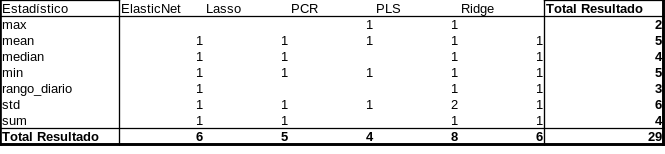


Estadistico evaluado por experimento

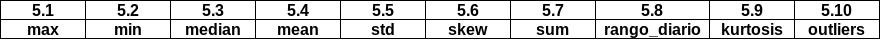

Sabiendo esto vamos a evaluar los experimentos 5.5, 5.4, 5.2, 5.3, 5.7

### Experimento 15

In [1183]:


set_predict="../Metricas/Experimento5_5/predictores_4065.csv"
set_objetivo="../Metricas/Experimento5_5/objetivo_4065.csv"
id_salida=8
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_1pred = df_resultados.copy()

predictores: 100
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 180713.9179
R2 en Test: 0.7093


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 164874.9725
R2 en Test: 0.7348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 222526.0167, R² Test: 0.6421
Número óptimo de componentes: 2
MSE Test: 422853.6183, R² Test: 0.3198
Número óptimo de componentes: 1
MSE Test: 179570.8833, R² Test: 0.7112
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241476.2904
R2 en Test: -0.0027
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 237993.8915, R² Test: 0.0117
Número óptimo de componentes: 1
MSE Test: 247782.4988, R² Test: -0.0289


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 220224.7806, R² Test: 0.0855
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 122920.8875
R2 en Test: 0.6174
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 228236.7436
R2 en Test: 0.2897


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 119646.5080, R² Test: 0.6276
Número óptimo de componentes: 4
MSE Test: 161662.3223, R² Test: 0.4969
Número óptimo de componentes: 2
MSE Test: 98716.2517, R² Test: 0.6928
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 189142.9498
R2 en Test: 0.0082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 172834.0058
R2 en Test: 0.0937


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 185597.5385, R² Test: 0.0268
Número óptimo de componentes: 3
MSE Test: 178047.1382, R² Test: 0.0664
Número óptimo de componentes: 2
MSE Test: 241992.1962, R² Test: -0.2689
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 88522.0979
R2 en Test: 0.5920


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 154667.6413
R2 en Test: 0.2872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 90695.7289, R² Test: 0.5820
Número óptimo de componentes: 4
MSE Test: 101087.4105, R² Test: 0.5341
Número óptimo de componentes: 2
MSE Test: 90594.1968, R² Test: 0.5825
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 106062.4814
R2 en Test: -0.9580
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 146408.3494
R2 en Test: -1.7028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 110295.6906, R² Test: -1.0361
Número óptimo de componentes: 17
MSE Test: 99662.9319, R² Test: -0.8398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 123399.0264, R² Test: -1.2780
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 116911.6972
R2 en Test: 0.6076
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 93387.7339
R2 en Test: 0.6866


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 104847.3889, R² Test: 0.6481
Número óptimo de componentes: 4
MSE Test: 124295.3694, R² Test: 0.5828
Número óptimo de componentes: 2
MSE Test: 122970.6399, R² Test: 0.5873
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 24738.8977
R2 en Test: 0.7533
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 94087.6379
R2 en Test: 0.0617


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 29133.0590, R² Test: 0.7095
Número óptimo de componentes: 5
MSE Test: 42468.9598, R² Test: 0.5765
Número óptimo de componentes: 1
MSE Test: 56599.1917, R² Test: 0.4356
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1636488.7156
R2 en Test: 0.6457


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2002964.9506
R2 en Test: 0.5663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1871607.8552, R² Test: 0.5948
Número óptimo de componentes: 7
MSE Test: 1923184.8691, R² Test: 0.5836
Número óptimo de componentes: 2
MSE Test: 2009758.7469, R² Test: 0.5648
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 305255.8314
R2 en Test: 0.5793


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 417896.2263
R2 en Test: 0.4240


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 416311.2574, R² Test: 0.4262
Número óptimo de componentes: 4
MSE Test: 350009.0855, R² Test: 0.5176
Número óptimo de componentes: 1
MSE Test: 470936.5067, R² Test: 0.3509
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 277148.0765
R2 en Test: -0.0841


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 284640.8305
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 273544.3082, R² Test: -0.0700
Número óptimo de componentes: 1
MSE Test: 259395.7889, R² Test: -0.0147
Número óptimo de componentes: 1
MSE Test: 264950.9844, R² Test: -0.0364
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 108039.2409
R2 en Test: 0.3554


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 97868.9601
R2 en Test: 0.4161


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 99582.0997, R² Test: 0.4059
Número óptimo de componentes: 10
MSE Test: 147938.1412, R² Test: 0.1174
Número óptimo de componentes: 3
MSE Test: 133567.8375, R² Test: 0.2031
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 371610.3622
R2 en Test: 0.2556


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 344898.3251
R2 en Test: 0.3091


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 315863.0948, R² Test: 0.3672
Número óptimo de componentes: 3
MSE Test: 272057.7382, R² Test: 0.4550
Número óptimo de componentes: 1
MSE Test: 237231.0903, R² Test: 0.5248
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 783598.2740
R2 en Test: 0.4992


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2317602.2489
R2 en Test: -0.4811


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 852412.6135, R² Test: 0.4552
Número óptimo de componentes: 3
MSE Test: 1198314.3026, R² Test: 0.2342
Número óptimo de componentes: 1
MSE Test: 1293838.6911, R² Test: 0.1731
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 168351.5795
R2 en Test: 0.7275


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 486455.6915
R2 en Test: 0.2127


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 180988.2398, R² Test: 0.7071
Número óptimo de componentes: 6
MSE Test: 340587.0453, R² Test: 0.4488
Número óptimo de componentes: 6
MSE Test: 159334.7997, R² Test: 0.7421
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 109898.0933
R2 en Test: -0.3656
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 117124.8919
R2 en Test: -0.4554


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.60
MSE Test: 132589.3320, R² Test: -0.6476
Número óptimo de componentes: 3
MSE Test: 71385.6393, R² Test: 0.1130
Número óptimo de componentes: 2
MSE Test: 199922.1175, R² Test: -1.4842
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 320728.2101
R2 en Test: 0.8421


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 776955.5798
R2 en Test: 0.6174
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 324717.2101, R² Test: 0.8401
Número óptimo de componentes: 6
MSE Test: 213525.1002, R² Test: 0.8949
Número óptimo de componentes: 2
MSE Test: 152513.8503, R² Test: 0.9249
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 58747.4151
R2 en Test: -0.1063
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 60037.5600, R² Test: -0.1306
Número óptimo de componentes: 2
MSE Test: 74809.1369, R² Test: -0.4087


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 102966.5629, R² Test: -0.9390
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12834.9303
R2 en Test: -0.0187
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.80
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 1
MSE Test: 11972.2867, R² Test: 0.0498


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 9645.1630, R² Test: 0.2345
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1366987.3892
R2 en Test: 0.3814


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1470743.7645
R2 en Test: 0.3345


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1376578.2072, R² Test: 0.3771
Número óptimo de componentes: 7
MSE Test: 1266970.9000, R² Test: 0.4267
Número óptimo de componentes: 2
MSE Test: 1226376.6313, R² Test: 0.4451
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 112193.0510
R2 en Test: 0.1544
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 217389.2493
R2 en Test: -0.6384


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.126486, Mejor l1_ratio: 0.10
MSE Test: 105525.8098, R² Test: 0.2047
Número óptimo de componentes: 3
MSE Test: 83007.9632, R² Test: 0.3744


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 4
MSE Test: 114970.4168, R² Test: 0.1335
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 227082.5190
R2 en Test: -0.4869
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 227766.9669, R² Test: -0.4914
Número óptimo de componentes: 1
MSE Test: 245649.0350, R² Test: -0.6085
Número óptimo de componentes: 1
MSE Test: 242457.6061, R² Test: -0.5876
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 401332.2261
R2 en Test: -0.0157


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 499106.7029
R2 en Test: -0.2631


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.60
MSE Test: 405569.7311, R² Test: -0.0264
Número óptimo de componentes: 5
MSE Test: 347628.0043, R² Test: 0.1202
Número óptimo de componentes: 2
MSE Test: 392491.0372, R² Test: 0.0067
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 518727.9388
R2 en Test: 0.0051
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 524735.0521, R² Test: -0.0064
Número óptimo de componentes: 1
MSE Test: 402383.9727, R² Test: 0.2283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 479811.9839, R² Test: 0.0798
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1774179.6456
R2 en Test: 0.5981
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1989762.7453
R2 en Test: 0.5492


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1755564.3050, R² Test: 0.6023
Número óptimo de componentes: 3
MSE Test: 2149484.5357, R² Test: 0.5131
Número óptimo de componentes: 2
MSE Test: 1423719.8476, R² Test: 0.6775
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 226285.8282
R2 en Test: -0.1541
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 244292.1371
R2 en Test: -0.2460


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 226667.9393, R² Test: -0.1561
Número óptimo de componentes: 8
MSE Test: 234510.3023, R² Test: -0.1961
Número óptimo de componentes: 1
MSE Test: 253720.5466, R² Test: -0.2941
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31777.4258
R2 en Test: -0.0994
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 31496.1668, R² Test: -0.0896


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 110675.0980, R² Test: -2.8289
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 176723.5833
R2 en Test: 0.8462
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 145059.5968
R2 en Test: 0.8738


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 142446.7361, R² Test: 0.8761
Número óptimo de componentes: 6
MSE Test: 275687.4899, R² Test: 0.7601
Número óptimo de componentes: 2
MSE Test: 260385.4697, R² Test: 0.7735
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 133780.3571
R2 en Test: 0.5973


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 153288.1454
R2 en Test: 0.5385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 125027.4899, R² Test: 0.6236
Número óptimo de componentes: 3
MSE Test: 163013.6675, R² Test: 0.5093
Número óptimo de componentes: 2
MSE Test: 121508.2019, R² Test: 0.6342
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 365050.5275
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 364363.1406, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 329587.5840, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 640027.1656, R² Test: 0.0000
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 217474.7544
R2 en Test: -1.7109
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 223107.8914, R² Test: -1.7812
Número óptimo de componentes: 18
MSE Test: 288499.6013, R² Test: -2.5963


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 169129.1172, R² Test: -1.1083
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 65773.1871
R2 en Test: 0.6816
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 56840.2871
R2 en Test: 0.7249


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 63074.5035, R² Test: 0.6947
Número óptimo de componentes: 6
MSE Test: 60499.8808, R² Test: 0.7072
Número óptimo de componentes: 2
MSE Test: 54932.1121, R² Test: 0.7341
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 35454.1648
R2 en Test: 0.4017


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 34357.2963
R2 en Test: 0.4202
Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 33322.7565, R² Test: 0.4376
Número óptimo de componentes: 9
MSE Test: 38558.5759, R² Test: 0.3493
Número óptimo de componentes: 2
MSE Test: 42426.4146, R² Test: 0.2840
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2395072.2668
R2 en Test: 0.5013


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3196292.8451
R2 en Test: 0.3344


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2447848.8837, R² Test: 0.4903
Número óptimo de componentes: 7
MSE Test: 1910022.2944, R² Test: 0.6023
Número óptimo de componentes: 2
MSE Test: 2159514.1278, R² Test: 0.5503
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26967.5346
R2 en Test: -0.3484
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 6749.1994
R2 en Test: 0.6625


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.086851, Mejor l1_ratio: 0.90
MSE Test: 29145.4458, R² Test: -0.4573
Número óptimo de componentes: 8
MSE Test: 32027.9524, R² Test: -0.6014


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 30889.3064, R² Test: -0.5445
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 204250.0349
R2 en Test: -0.0406
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 164520.0366
R2 en Test: 0.1618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 189926.0306, R² Test: 0.0324
Número óptimo de componentes: 1
MSE Test: 257236.7505, R² Test: -0.3105
Número óptimo de componentes: 1
MSE Test: 200121.7649, R² Test: -0.0196
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 534655.6194
R2 en Test: 0.6640


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 636572.0431
R2 en Test: 0.5999


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 507874.7683, R² Test: 0.6808
Número óptimo de componentes: 7
MSE Test: 461160.2098, R² Test: 0.7102
Número óptimo de componentes: 2
MSE Test: 425741.3988, R² Test: 0.7324
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 542968.1564
R2 en Test: 0.4318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 605424.7964
R2 en Test: 0.3665


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 518410.7179, R² Test: 0.4575
Número óptimo de componentes: 9
MSE Test: 580669.0936, R² Test: 0.3924
Número óptimo de componentes: 2
MSE Test: 525444.3993, R² Test: 0.4502
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49385.1837
R2 en Test: 0.0028
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 49545.3708, R² Test: -0.0004
Número óptimo de componentes: 8
MSE Test: 39216.6427, R² Test: 0.2082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 43370.3423, R² Test: 0.1243
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 236038.1380
R2 en Test: 0.0355
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 275419.4916
R2 en Test: -0.1254
Mejor alpha: 0.184207, Mejor l1_ratio: 0.10
MSE Test: 250364.4726, R² Test: -0.0230
Número óptimo de componentes: 4
MSE Test: 269897.0009, R² Test: -0.1028
Número óptimo de componentes: 9
MSE Test: 265803.9000, R² Test: -0.0861
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 328356.0647
R2 en Test: -0.0850
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.80
MSE Test: 325250.9369, R² Test: -0.0747
Número óptimo de componentes: 8
MSE Test: 164069.0297, R² Test: 0.4579


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 137620.7051, R² Test: 0.5453
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1332038.1876
R2 en Test: -0.1203
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1503716.5727
R2 en Test: -0.2647


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1353114.6618, R² Test: -0.1380
Número óptimo de componentes: 1
MSE Test: 1537450.2039, R² Test: -0.2931
Número óptimo de componentes: 1
MSE Test: 1376830.6216, R² Test: -0.1580
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 39572.7716
R2 en Test: -0.3656
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 209336.6266
R2 en Test: -6.2239


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 50115.4427, R² Test: -0.7294
Número óptimo de componentes: 2
MSE Test: 44584.7631, R² Test: -0.5386


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 79615.4343, R² Test: -1.7474
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 179705.2890
R2 en Test: -1.1423
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 168801.0600, R² Test: -1.0123
Número óptimo de componentes: 19
MSE Test: 177482.1268, R² Test: -1.1158


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 170004.6246, R² Test: -1.0266
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 333118.5916
R2 en Test: 0.1409
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 343269.8270, R² Test: 0.1147
Número óptimo de componentes: 1
MSE Test: 411811.6585, R² Test: -0.0621
Número óptimo de componentes: 1
MSE Test: 291025.7643, R² Test: 0.2494
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2592737.5039
R2 en Test: -0.1912
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3454364.5834
R2 en Test: -0.5871


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2830053.1688, R² Test: -0.3003
Número óptimo de componentes: 2
MSE Test: 2895119.4606, R² Test: -0.3302


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 3094649.0727, R² Test: -0.4218
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 515697.4915
R2 en Test: 0.6381
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 700885.0661
R2 en Test: 0.5082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 561598.6535, R² Test: 0.6059
Número óptimo de componentes: 7
MSE Test: 827670.0158, R² Test: 0.4192
Número óptimo de componentes: 13
MSE Test: 864981.1766, R² Test: 0.3930
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 80861.1849
R2 en Test: 0.1301
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 76565.4006
R2 en Test: 0.1763


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 75626.0442, R² Test: 0.1864
Número óptimo de componentes: 1
MSE Test: 95427.5406, R² Test: -0.0267
Número óptimo de componentes: 1
MSE Test: 87986.3281, R² Test: 0.0534
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 10844.3339
R2 en Test: 0.3696
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 17171.1794
R2 en Test: 0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 11385.3539, R² Test: 0.3381
Número óptimo de componentes: 3
MSE Test: 12306.7297, R² Test: 0.2846


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 9804.9965, R² Test: 0.4300
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1141398.6352
R2 en Test: 0.3955
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 857305.5622
R2 en Test: 0.5460


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1065410.9921, R² Test: 0.4358
Número óptimo de componentes: 4
MSE Test: 1370129.1741, R² Test: 0.2744
Número óptimo de componentes: 2
MSE Test: 1012302.5088, R² Test: 0.4639
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 524270.1962
R2 en Test: 0.2527


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 476408.6387
R2 en Test: 0.3209


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 515937.7837, R² Test: 0.2645
Número óptimo de componentes: 2
MSE Test: 413227.6047, R² Test: 0.4110
Número óptimo de componentes: 2
MSE Test: 454744.0998, R² Test: 0.3518
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 784308.9300
R2 en Test: 0.2359
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 627129.8119
R2 en Test: 0.3891


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 789806.6647, R² Test: 0.2306
Número óptimo de componentes: 2
MSE Test: 720084.8927, R² Test: 0.2985
Número óptimo de componentes: 2
MSE Test: 717725.7957, R² Test: 0.3008
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 610141.3126
R2 en Test: -0.0465
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 601757.9053
R2 en Test: -0.0322


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 592761.8754, R² Test: -0.0167
Número óptimo de componentes: 5
MSE Test: 601050.2749, R² Test: -0.0309
Número óptimo de componentes: 1
MSE Test: 585051.9589, R² Test: -0.0035
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 260321.6017
R2 en Test: -0.5644
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 283251.7305
R2 en Test: -0.7022


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 277266.4490, R² Test: -0.6662
Número óptimo de componentes: 3
MSE Test: 291851.2811, R² Test: -0.7539


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 336283.3026, R² Test: -1.0209
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 164686.7879
R2 en Test: -0.0940
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 168563.3476, R² Test: -0.1198
Número óptimo de componentes: 2
MSE Test: 153857.5587, R² Test: -0.0221
Número óptimo de componentes: 1
MSE Test: 162635.9592, R² Test: -0.0804
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 23772.3834
R2 en Test: -0.0457
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 23925.1014, R² Test: -0.0524
Número óptimo de componentes: 1
MSE Test: 22129.9169, R² Test: 0.0265
Número óptimo de componentes: 1
MSE Test: 65023.2095, R² Test: -1.8603
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3518270.4144
R2 en Test: 0.2728


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3958448.2401
R2 en Test: 0.1818
Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 3583835.6602, R² Test: 0.2593
Número óptimo de componentes: 2
MSE Test: 3176247.0691, R² Test: 0.3435
Número óptimo de componentes: 1
MSE Test: 4026447.2517, R² Test: 0.1678
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 410316.3465
R2 en Test: 0.3570
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 307846.5900
R2 en Test: 0.5176


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 379441.5200, R² Test: 0.4054
Número óptimo de componentes: 13
MSE Test: 360651.1854, R² Test: 0.4348
Número óptimo de componentes: 5
MSE Test: 500494.2863, R² Test: 0.2156
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 83129.4449
R2 en Test: -0.6469
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 117096.4579
R2 en Test: -1.3198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 120193.0454, R² Test: -1.3812
Número óptimo de componentes: 3
MSE Test: 90741.8376, R² Test: -0.7977


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 112319.5114, R² Test: -1.2252
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 400383.1533
R2 en Test: 0.2710
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 486070.9975
R2 en Test: 0.1150


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 431146.7183, R² Test: 0.2150
Número óptimo de componentes: 4
MSE Test: 366052.0007, R² Test: 0.3335
Número óptimo de componentes: 1
MSE Test: 403162.2152, R² Test: 0.2660
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 806257.2878
R2 en Test: 0.3006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 654870.9087
R2 en Test: 0.4320


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 814333.5705, R² Test: 0.2936
Número óptimo de componentes: 5
MSE Test: 886049.8672, R² Test: 0.2314
Número óptimo de componentes: 2
MSE Test: 750619.9040, R² Test: 0.3489
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 511933.7753
R2 en Test: 0.2429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 560813.6324
R2 en Test: 0.1707
Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 551995.7123, R² Test: 0.1837
Número óptimo de componentes: 2
MSE Test: 531442.3172, R² Test: 0.2141
Número óptimo de componentes: 1
MSE Test: 593138.3642, R² Test: 0.1229
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 71290.8043
R2 en Test: 0.3070
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 57537.9466
R2 en Test: 0.4407


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 67773.9946, R² Test: 0.3412
Número óptimo de componentes: 9
MSE Test: 77076.7635, R² Test: 0.2507
Número óptimo de componentes: 1
MSE Test: 64383.5202, R² Test: 0.3741
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 178803.4450
R2 en Test: 0.1308
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 155723.9085
R2 en Test: 0.2430


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 172614.7748, R² Test: 0.1609
Número óptimo de componentes: 1
MSE Test: 162500.1999, R² Test: 0.2101
Número óptimo de componentes: 1
MSE Test: 171078.9048, R² Test: 0.1684
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 333505.0775
R2 en Test: 0.4749
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 362173.9925
R2 en Test: 0.4297


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 344747.2863, R² Test: 0.4572
Número óptimo de componentes: 6
MSE Test: 392460.6873, R² Test: 0.3820
Número óptimo de componentes: 1
MSE Test: 345712.9940, R² Test: 0.4556
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 242746.2620
R2 en Test: 0.3014
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 266495.7125
R2 en Test: 0.2331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 222066.2772, R² Test: 0.3609
Número óptimo de componentes: 4
MSE Test: 265283.5028, R² Test: 0.2365
Número óptimo de componentes: 1
MSE Test: 193781.7723, R² Test: 0.4423
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 184866.8626
R2 en Test: -1.1075
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 206753.0552
R2 en Test: -1.3570


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 186412.0602, R² Test: -1.1251
Número óptimo de componentes: 1
MSE Test: 168581.3170, R² Test: -0.9219
Número óptimo de componentes: 1
MSE Test: 132277.2632, R² Test: -0.5080
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 142606.1864
R2 en Test: 0.3694
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 205973.0101
R2 en Test: 0.0892


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 143146.6948, R² Test: 0.3670
Número óptimo de componentes: 6
MSE Test: 130002.8248, R² Test: 0.4251
Número óptimo de componentes: 1
MSE Test: 114121.6946, R² Test: 0.4954
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 192287.3891
R2 en Test: -10.3036
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 73250.2907
R2 en Test: -3.3060


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 192142.6166, R² Test: -10.2950
Número óptimo de componentes: 2
MSE Test: 28745.4083, R² Test: -0.6898
Número óptimo de componentes: 7
MSE Test: 194053.0034, R² Test: -10.4073
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2127140.1284
R2 en Test: 0.4160
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3119216.4559
R2 en Test: 0.1437


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2152658.9470, R² Test: 0.4090
Número óptimo de componentes: 15
MSE Test: 1843045.6611, R² Test: 0.4940
Número óptimo de componentes: 2
MSE Test: 2193656.0380, R² Test: 0.3978
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207600.9529
R2 en Test: -0.0246
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 556179.2839
R2 en Test: -1.7450


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 206455.6136, R² Test: -0.0190
Número óptimo de componentes: 1
MSE Test: 198294.0782, R² Test: 0.0213


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 161757.9989, R² Test: 0.2017
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 100494.2035
R2 en Test: 0.0662
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 107007.0634
R2 en Test: 0.0056


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 101499.9387, R² Test: 0.0568
Número óptimo de componentes: 6
MSE Test: 80988.3014, R² Test: 0.2474
Número óptimo de componentes: 1
MSE Test: 78392.8767, R² Test: 0.2715
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 205706.3897
R2 en Test: 0.0579
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 155831.7690, R² Test: 0.2863
Número óptimo de componentes: 2
MSE Test: 204392.8525, R² Test: 0.0639


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 91536.5056, R² Test: 0.5808
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 232363.1429
R2 en Test: 0.3179
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 244694.4523
R2 en Test: 0.2817


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 242302.7355, R² Test: 0.2888
Número óptimo de componentes: 3
MSE Test: 242407.0848, R² Test: 0.2885
Número óptimo de componentes: 1
MSE Test: 203566.6158, R² Test: 0.4025
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 292221.9656
R2 en Test: 0.2641
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 223714.2025
R2 en Test: 0.4366


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 262653.9777, R² Test: 0.3386
Número óptimo de componentes: 6
MSE Test: 277254.6937, R² Test: 0.3018
Número óptimo de componentes: 1
MSE Test: 270249.0625, R² Test: 0.3194
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 198840.6284
R2 en Test: 0.2769
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 327737.7611
R2 en Test: -0.1918


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 199125.3426, R² Test: 0.2759
Número óptimo de componentes: 1
MSE Test: 165333.1213, R² Test: 0.3988
Número óptimo de componentes: 3
MSE Test: 241864.4746, R² Test: 0.1205
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 636183.8983
R2 en Test: 0.2563


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 588549.0826
R2 en Test: 0.3120
Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 617578.8542, R² Test: 0.2780
Número óptimo de componentes: 1
MSE Test: 525429.0555, R² Test: 0.3858
Número óptimo de componentes: 1
MSE Test: 481250.2306, R² Test: 0.4374
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 212663.4656
R2 en Test: -0.2197
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 262982.0241
R2 en Test: -0.5083


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.126486, Mejor l1_ratio: 0.10
MSE Test: 212816.1637, R² Test: -0.2206
Número óptimo de componentes: 6
MSE Test: 213023.9372, R² Test: -0.2218


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 6
MSE Test: 212669.6214, R² Test: -0.2198
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 109001.2284
R2 en Test: 0.2075
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 116606.4008, R² Test: 0.1523
Número óptimo de componentes: 1
MSE Test: 155793.7212, R² Test: -0.1326
Número óptimo de componentes: 1
MSE Test: 124387.2022, R² Test: 0.0957
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 329068.1377
R2 en Test: 0.0662
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 432123.5989
R2 en Test: -0.2262


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 324268.2723, R² Test: 0.0799
Número óptimo de componentes: 2
MSE Test: 327350.8294, R² Test: 0.0711
Número óptimo de componentes: 1
MSE Test: 305578.1765, R² Test: 0.1329
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 216148.1211
R2 en Test: -0.1287


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 244170.0019
R2 en Test: -0.2750
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 215985.9832, R² Test: -0.1278
Número óptimo de componentes: 2
MSE Test: 229754.4315, R² Test: -0.1997
Número óptimo de componentes: 1
MSE Test: 217143.6191, R² Test: -0.1339
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163095.7123
R2 en Test: -0.6512
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 115334.6623
R2 en Test: -0.1677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 222371.1764, R² Test: -1.2514
Número óptimo de componentes: 14
MSE Test: 255440.9971, R² Test: -1.5862


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 251555.2047, R² Test: -1.5468
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 232334.8399
R2 en Test: -0.0201


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 294923.8296
R2 en Test: -0.2950


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 232828.6301, R² Test: -0.0223
Número óptimo de componentes: 2
MSE Test: 241764.8593, R² Test: -0.0616
Número óptimo de componentes: 1
MSE Test: 229558.9344, R² Test: -0.0080
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 106924.7456
R2 en Test: -2.8123
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 243176.2037
R2 en Test: -7.6703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 218180.5071, R² Test: -6.7791
Número óptimo de componentes: 18
MSE Test: 148882.8805, R² Test: -4.3083


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 79318.7752, R² Test: -1.8281
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 3928774.6070
R2 en Test: 0.0721
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 4132261.9795
R2 en Test: 0.0241


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 4069540.1394, R² Test: 0.0389
Número óptimo de componentes: 5
MSE Test: 4474641.3395, R² Test: -0.0568
Número óptimo de componentes: 1
MSE Test: 4374852.4852, R² Test: -0.0332
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 953168.9395
R2 en Test: -3.6992
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2273138.2474
R2 en Test: -10.2067


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 847478.3813, R² Test: -3.1781
Número óptimo de componentes: 1
MSE Test: 338409.4773, R² Test: -0.6684


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1942049.5556, R² Test: -8.5744
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 186380.1767
R2 en Test: -0.0787


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 161749.9246
R2 en Test: 0.0639
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 178438.9617, R² Test: -0.0327
Número óptimo de componentes: 1
MSE Test: 170902.3436, R² Test: 0.0109
Número óptimo de componentes: 1
MSE Test: 179499.1775, R² Test: -0.0388
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 366474.5998
R2 en Test: 0.0764


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 408833.3987, R² Test: -0.0303
Número óptimo de componentes: 1
MSE Test: 495306.4157, R² Test: -0.2483
Número óptimo de componentes: 1
MSE Test: 552678.8502, R² Test: -0.3929
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 291738.8068
R2 en Test: 0.0496
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 330742.3881
R2 en Test: -0.0775


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 293965.3254, R² Test: 0.0424
Número óptimo de componentes: 3
MSE Test: 284167.1912, R² Test: 0.0743
Número óptimo de componentes: 1
MSE Test: 280486.8899, R² Test: 0.0863
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 327765.0084
R2 en Test: 0.0326


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523
Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 313388.4426, R² Test: 0.0751
Número óptimo de componentes: 14
MSE Test: 390002.7576, R² Test: -0.1511
Número óptimo de componentes: 1
MSE Test: 348802.9041, R² Test: -0.0295


In [1185]:


df_resultados_4065_1pred['indice']=df_resultados_4065_1pred['Provincia']+"-"+df_resultados_4065_1pred['Cultivo']+"-"+df_resultados_4065_1pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_4065_1pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_15','R2':'R2_15','Predictores':'Predictores_15'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14','R2_15']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5)& (df_temp['R2_15']<0.5) ].shape




(47, 8)

### Experimento 16

In [1187]:


set_predict="../Metricas/Experimento5_4/predictores_4065.csv"
set_objetivo="../Metricas/Experimento5_4/objetivo_4065.csv"
id_salida=9
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_2pred = df_resultados.copy()

predictores: 100
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 134262.1198
R2 en Test: 0.7840
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 354130.2240
R2 en Test: 0.4304


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 155350.6416, R² Test: 0.7501
Número óptimo de componentes: 2
MSE Test: 282551.9843, R² Test: 0.5455
Número óptimo de componentes: 1
MSE Test: 168843.0973, R² Test: 0.7284
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 288919.9758
R2 en Test: -0.1997
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 230608.7255
R2 en Test: 0.0424


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 241165.8136, R² Test: -0.0014
Número óptimo de componentes: 4
MSE Test: 243177.8694, R² Test: -0.0098


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 258464.6203, R² Test: -0.0733
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 99142.9954
R2 en Test: 0.6914
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 109511.7133
R2 en Test: 0.6592


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 96377.0295, R² Test: 0.7001
Número óptimo de componentes: 10
MSE Test: 95073.2756, R² Test: 0.7041
Número óptimo de componentes: 3
MSE Test: 104526.9835, R² Test: 0.6747
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 116101.4531
R2 en Test: 0.3912
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 206383.5558
R2 en Test: -0.0822


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 114876.7081, R² Test: 0.3976
Número óptimo de componentes: 11
MSE Test: 132401.9970, R² Test: 0.3057
Número óptimo de componentes: 1
MSE Test: 187575.8116, R² Test: 0.0164
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 254673.0347
R2 en Test: -0.1737
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 287897.7937
R2 en Test: -0.3268


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 172261.2742, R² Test: 0.2061
Número óptimo de componentes: 10
MSE Test: 179876.1655, R² Test: 0.1710
Número óptimo de componentes: 4
MSE Test: 226801.7120, R² Test: -0.0452
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 119887.4377
R2 en Test: -1.2132
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 4
MSE Test: 113648.3412, R² Test: -1.0980


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 121819.9193, R² Test: -1.2489
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 130559.3099
R2 en Test: 0.5618
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 105563.8402
R2 en Test: 0.6457


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.20
MSE Test: 44458.6213, R² Test: 0.8508
Número óptimo de componentes: 16
MSE Test: 39305.0218, R² Test: 0.8681
Número óptimo de componentes: 2
MSE Test: 57630.1797, R² Test: 0.8066
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 74386.5892
R2 en Test: 0.2582
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 200145.8131
R2 en Test: -0.9959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 88961.3892, R² Test: 0.1129
Número óptimo de componentes: 4
MSE Test: 180894.8341, R² Test: -0.8039
Número óptimo de componentes: 2
MSE Test: 76463.7077, R² Test: 0.2375
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1871654.6853
R2 en Test: 0.5947


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1578724.5342
R2 en Test: 0.6582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 1880683.7141, R² Test: 0.5928
Número óptimo de componentes: 2
MSE Test: 2647660.2720, R² Test: 0.4267
Número óptimo de componentes: 2
MSE Test: 1865153.2575, R² Test: 0.5962
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 267974.3178
R2 en Test: 0.6307


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 310961.6044
R2 en Test: 0.5714


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 259333.9102, R² Test: 0.6426
Número óptimo de componentes: 2
MSE Test: 443903.0802, R² Test: 0.3882
Número óptimo de componentes: 1
MSE Test: 327364.5733, R² Test: 0.5488
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 179008.3246
R2 en Test: 0.2998


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503
Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 228702.9974, R² Test: 0.1054
Número óptimo de componentes: 4
MSE Test: 175284.5989, R² Test: 0.3144
Número óptimo de componentes: 1
MSE Test: 124828.1513, R² Test: 0.5117
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 165678.4372
R2 en Test: 0.0115
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 151954.9579
R2 en Test: 0.0934


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.70
MSE Test: 168741.3501, R² Test: -0.0067
Número óptimo de componentes: 9
MSE Test: 184936.8855, R² Test: -0.1034
Número óptimo de componentes: 1
MSE Test: 170063.2023, R² Test: -0.0146
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 276735.8427
R2 en Test: 0.4456
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 251931.4877
R2 en Test: 0.4953


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 271018.0611, R² Test: 0.4571
Número óptimo de componentes: 2
MSE Test: 382632.4620, R² Test: 0.2335
Número óptimo de componentes: 1
MSE Test: 278288.4532, R² Test: 0.4425
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 611040.1836
R2 en Test: 0.6095
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 745767.6133
R2 en Test: 0.5234


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.30
MSE Test: 606849.9547, R² Test: 0.6122
Número óptimo de componentes: 9
MSE Test: 652245.3182, R² Test: 0.5832
Número óptimo de componentes: 2
MSE Test: 548675.3278, R² Test: 0.6494
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 319124.9263
R2 en Test: 0.4835
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 385781.4102
R2 en Test: 0.3756


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 316750.9819, R² Test: 0.4873
Número óptimo de componentes: 11
MSE Test: 315763.0806, R² Test: 0.4889
Número óptimo de componentes: 4
MSE Test: 328662.6239, R² Test: 0.4681
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 123567.8940
R2 en Test: -0.5355
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 116762.8994
R2 en Test: -0.4509


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 107412.2166, R² Test: -0.3347
Número óptimo de componentes: 1
MSE Test: 103256.4184, R² Test: -0.2831
Número óptimo de componentes: 1
MSE Test: 125387.1839, R² Test: -0.5581
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 435833.9933
R2 en Test: 0.7854
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 371203.9515
R2 en Test: 0.8172


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 426222.4680, R² Test: 0.7901
Número óptimo de componentes: 8
MSE Test: 426173.5275, R² Test: 0.7902
Número óptimo de componentes: 2
MSE Test: 424107.4280, R² Test: 0.7912
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 61623.7920
R2 en Test: -0.1604
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306
Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 65561.7934, R² Test: -0.2346
Número óptimo de componentes: 5
MSE Test: 371553.7079, R² Test: -5.9967


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 523950.3531, R² Test: -8.8665
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12934.7564
R2 en Test: -0.0266
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 1
MSE Test: 12404.0171, R² Test: 0.0155


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 10889.3432, R² Test: 0.1358
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1480417.1430
R2 en Test: 0.3301
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1609966.6879
R2 en Test: 0.2715


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1623944.0141, R² Test: 0.2652
Número óptimo de componentes: 3
MSE Test: 1332272.1240, R² Test: 0.3971
Número óptimo de componentes: 1
MSE Test: 1333064.3904, R² Test: 0.3968
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 150902.8592
R2 en Test: -0.1373
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.50
MSE Test: 150925.1413, R² Test: -0.1375
Número óptimo de componentes: 4
MSE Test: 153253.3906, R² Test: -0.1550


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 2
MSE Test: 264639.0206, R² Test: -0.9945
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226029.6458
R2 en Test: -0.4800
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 219424.8150, R² Test: -0.4368
Número óptimo de componentes: 2
MSE Test: 280504.0922, R² Test: -0.8367
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 437874.4598
R2 en Test: -0.1082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 417922.4258, R² Test: -0.0577
Número óptimo de componentes: 1
MSE Test: 420418.0842, R² Test: -0.0640
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 520305.3310
R2 en Test: 0.0021
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 509578.9186, R² Test: 0.0227
Número óptimo de componentes: 10
MSE Test: 1353296.3513, R² Test: -1.5955


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 1616867.7647, R² Test: -2.1010
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2836415.1919
R2 en Test: 0.3575
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2554807.2346
R2 en Test: 0.4212


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2821754.4527, R² Test: 0.3608
Número óptimo de componentes: 5
MSE Test: 3110445.8464, R² Test: 0.2954
Número óptimo de componentes: 1
MSE Test: 2109549.7565, R² Test: 0.5221
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 245113.1046
R2 en Test: -0.2502
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 232633.2141
R2 en Test: -0.1865


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 244487.5173, R² Test: -0.2470
Número óptimo de componentes: 5
MSE Test: 265145.7065, R² Test: -0.3523
Número óptimo de componentes: 1
MSE Test: 266409.8212, R² Test: -0.3588
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31182.5421
R2 en Test: -0.0788
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 161488.5599
R2 en Test: -4.5869


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 28403.0271, R² Test: 0.0174


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 79610.9460, R² Test: -1.7542
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 363846.7713
R2 en Test: 0.6834
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 461962.2771
R2 en Test: 0.5981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 342885.8519, R² Test: 0.7017
Número óptimo de componentes: 2
MSE Test: 498135.3179, R² Test: 0.5666
Número óptimo de componentes: 1
MSE Test: 379508.7854, R² Test: 0.6698
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 157650.0295
R2 en Test: 0.5254


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 214020.6712
R2 en Test: 0.3557


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 149726.1667, R² Test: 0.5493
Número óptimo de componentes: 20
MSE Test: 163059.3195, R² Test: 0.5091
Número óptimo de componentes: 1
MSE Test: 156933.2690, R² Test: 0.5276
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364820.6843
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1048.113134, Mejor l1_ratio: 0.70
MSE Test: 364363.1406, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 395987.8880, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2396662.5911, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 203299.3378
R2 en Test: -1.5342
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 205427.3188, R² Test: -1.5608


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 7
MSE Test: 350860.4454, R² Test: -3.3737
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 55218.8435
R2 en Test: 0.7327
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 72152.1625
R2 en Test: 0.6508


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 53794.4324, R² Test: 0.7396
Número óptimo de componentes: 1
MSE Test: 62562.7936, R² Test: 0.6972
Número óptimo de componentes: 1
MSE Test: 46630.2490, R² Test: 0.7743
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 40513.4230
R2 en Test: 0.3163


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 31725.2828
R2 en Test: 0.4646


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 38631.9072, R² Test: 0.3480
Número óptimo de componentes: 2
MSE Test: 46128.2417, R² Test: 0.2215
Número óptimo de componentes: 1
MSE Test: 45468.9232, R² Test: 0.2326
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 923166.2183
R2 en Test: 0.8078


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 948318.2315
R2 en Test: 0.8025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 832497.4221, R² Test: 0.8267
Número óptimo de componentes: 1
MSE Test: 1776034.1556, R² Test: 0.6302
Número óptimo de componentes: 1
MSE Test: 1187141.0857, R² Test: 0.7528
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26887.4953
R2 en Test: -0.3444
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 18366.1544
R2 en Test: 0.0817


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.70
MSE Test: 18805.3977, R² Test: 0.0597
Número óptimo de componentes: 2
MSE Test: 24508.4922, R² Test: -0.2254


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 23146.5242, R² Test: -0.1573
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 151354.2130
R2 en Test: 0.2289
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 160691.9747
R2 en Test: 0.1813


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 143490.0942, R² Test: 0.2690
Número óptimo de componentes: 1
MSE Test: 147927.7436, R² Test: 0.2464
Número óptimo de componentes: 1
MSE Test: 120131.8956, R² Test: 0.3880
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 219827.0598
R2 en Test: 0.8618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 440278.1722
R2 en Test: 0.7233


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 214748.2236, R² Test: 0.8650
Número óptimo de componentes: 1
MSE Test: 418651.8066, R² Test: 0.7369
Número óptimo de componentes: 1
MSE Test: 239985.1886, R² Test: 0.8492
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 580983.1804
R2 en Test: 0.3921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 575439.5841
R2 en Test: 0.3979


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 580972.3486, R² Test: 0.3921
Número óptimo de componentes: 2
MSE Test: 666856.4579, R² Test: 0.3022
Número óptimo de componentes: 3
MSE Test: 723197.3426, R² Test: 0.2432
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 52870.8575
R2 en Test: -0.0676
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.60
MSE Test: 51157.2332, R² Test: -0.0329
Número óptimo de componentes: 1
MSE Test: 65300.9251, R² Test: -0.3185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 64716.5163, R² Test: -0.3067
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 519528.0036
R2 en Test: -1.1228
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 277019.3141
R2 en Test: -0.1319
Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 476996.1102, R² Test: -0.9490
Número óptimo de componentes: 13
MSE Test: 700113.5637, R² Test: -1.8607
Número óptimo de componentes: 2
MSE Test: 732081.2454, R² Test: -1.9913
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 318109.8082
R2 en Test: -0.0511
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 9
MSE Test: 734719.8973, R² Test: -1.4277


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 785935.2918, R² Test: -1.5969
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 1267931.4465
R2 en Test: -0.0664
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1149635.2606
R2 en Test: 0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 1250582.6737, R² Test: -0.0518
Número óptimo de componentes: 3
MSE Test: 963323.3188, R² Test: 0.1898
Número óptimo de componentes: 1
MSE Test: 843060.7040, R² Test: 0.2909
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 37553.7995
R2 en Test: -0.2959
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 40318.2566, R² Test: -0.3913
Número óptimo de componentes: 1
MSE Test: 58492.1749, R² Test: -1.0185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 107008.1520, R² Test: -2.6927
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 179436.2757
R2 en Test: -1.1391
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 192722.9113
R2 en Test: -1.2974


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 176326.8923, R² Test: -1.1020
Número óptimo de componentes: 2
MSE Test: 170356.4514, R² Test: -1.0308


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 171987.8510, R² Test: -1.0503
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 409807.7024
R2 en Test: -0.0569


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 6
MSE Test: 311423.3445, R² Test: 0.1968
Número óptimo de componentes: 2
MSE Test: 411797.8178, R² Test: -0.0621
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 3290902.8764
R2 en Test: -0.5120
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 4988894.9102
R2 en Test: -1.2922


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3663902.8797, R² Test: -0.6834
Número óptimo de componentes: 1
MSE Test: 2158058.2455, R² Test: 0.0085


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 3077480.8643, R² Test: -0.4140
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 350338.6399
R2 en Test: 0.7542
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 548030.7636
R2 en Test: 0.6154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 334448.3516, R² Test: 0.7653
Número óptimo de componentes: 5
MSE Test: 539362.5523, R² Test: 0.6215
Número óptimo de componentes: 1
MSE Test: 388611.0951, R² Test: 0.7273
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 110038.2116
R2 en Test: -0.1838


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 93055.8361
R2 en Test: -0.0011
Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 111593.8022, R² Test: -0.2006
Número óptimo de componentes: 2
MSE Test: 111795.9178, R² Test: -0.2028
Número óptimo de componentes: 1
MSE Test: 174897.3799, R² Test: -0.8816
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 9337.6093
R2 en Test: 0.4572
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 12320.0572
R2 en Test: 0.2838


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 9290.2370, R² Test: 0.4599
Número óptimo de componentes: 3
MSE Test: 15061.0155, R² Test: 0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 9817.7002, R² Test: 0.4293
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1053090.4868
R2 en Test: 0.4423
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1043543.9392
R2 en Test: 0.4473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 1094955.7596, R² Test: 0.4201
Número óptimo de componentes: 1
MSE Test: 1285365.7784, R² Test: 0.3193
Número óptimo de componentes: 1
MSE Test: 1325630.3253, R² Test: 0.2980
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 560425.9453
R2 en Test: 0.2011
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 683011.4503
R2 en Test: 0.0264


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 585666.2028, R² Test: 0.1651
Número óptimo de componentes: 1
MSE Test: 700864.0908, R² Test: 0.0009
Número óptimo de componentes: 1
MSE Test: 566335.6291, R² Test: 0.1927
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 906975.0378
R2 en Test: 0.1164


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1027540.7851
R2 en Test: -0.0010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.10
MSE Test: 1011007.5993, R² Test: 0.0151
Número óptimo de componentes: 1
MSE Test: 898693.9300, R² Test: 0.1245
Número óptimo de componentes: 1
MSE Test: 850506.8466, R² Test: 0.1715
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 790785.4297
R2 en Test: -0.3564
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 740210.1013, R² Test: -0.2696
Número óptimo de componentes: 3
MSE Test: 650402.4517, R² Test: -0.1156
Número óptimo de componentes: 1
MSE Test: 794125.1524, R² Test: -0.3621
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 213287.2312
R2 en Test: -0.2817
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 250031.0879
R2 en Test: -0.5025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 223853.5754, R² Test: -0.3452
Número óptimo de componentes: 3
MSE Test: 163123.6222, R² Test: 0.0197


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 6
MSE Test: 262321.8179, R² Test: -0.5764
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 154373.6693
R2 en Test: -0.0255
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 178625.3465, R² Test: -0.1866
Número óptimo de componentes: 4
MSE Test: 198506.4764, R² Test: -0.3187
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25770.3729
R2 en Test: -0.1336
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 30366.1512
R2 en Test: -0.3358


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 26391.0160, R² Test: -0.1609
Número óptimo de componentes: 1
MSE Test: 25529.8568, R² Test: -0.1230
Número óptimo de componentes: 1
MSE Test: 52739.2946, R² Test: -1.3200
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2473913.4839
R2 en Test: 0.4887


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 4785833.3660
R2 en Test: 0.0108


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 2821828.4640, R² Test: 0.4168
Número óptimo de componentes: 1
MSE Test: 5007596.2855, R² Test: -0.0350
Número óptimo de componentes: 3
MSE Test: 3010947.2706, R² Test: 0.3777
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 492288.5160
R2 en Test: 0.2285
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1244651.3357
R2 en Test: -0.9506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 534566.5705, R² Test: 0.1622
Número óptimo de componentes: 2
MSE Test: 456739.8100, R² Test: 0.2842
Número óptimo de componentes: 1
MSE Test: 596960.4722, R² Test: 0.0645
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 297241.5504
R2 en Test: -4.8887
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 256551.1471
R2 en Test: -4.0826


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.126486, Mejor l1_ratio: 0.10
MSE Test: 260253.8941, R² Test: -4.1559
Número óptimo de componentes: 9
MSE Test: 97179.9213, R² Test: -0.9252


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 8
MSE Test: 283558.5026, R² Test: -4.6176
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 541849.9716
R2 en Test: 0.0134
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 553413.4628
R2 en Test: -0.0076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 533648.8868, R² Test: 0.0284
Número óptimo de componentes: 1
MSE Test: 552106.9146, R² Test: -0.0052
Número óptimo de componentes: 1
MSE Test: 291546.5815, R² Test: 0.4692
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 768786.4750
R2 en Test: 0.3331
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 759029.0136, R² Test: 0.3416
Número óptimo de componentes: 1
MSE Test: 1522106.9181, R² Test: -0.3203
Número óptimo de componentes: 1
MSE Test: 1454976.9307, R² Test: -0.2621
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 654321.1423
R2 en Test: 0.0324
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 699101.8512
R2 en Test: -0.0338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 699101.8512, R² Test: -0.0338
Número óptimo de componentes: 1
MSE Test: 655699.2070, R² Test: 0.0303
Número óptimo de componentes: 1
MSE Test: 595768.9032, R² Test: 0.1190
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 66046.4068
R2 en Test: 0.3580


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 58038.6461
R2 en Test: 0.4358


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 66105.3149, R² Test: 0.3574
Número óptimo de componentes: 9
MSE Test: 61666.0510, R² Test: 0.4005
Número óptimo de componentes: 1
MSE Test: 62575.6304, R² Test: 0.3917
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 139107.2649
R2 en Test: 0.3238


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 126735.3497
R2 en Test: 0.3839
Mejor alpha: 0.268270, Mejor l1_ratio: 0.10
MSE Test: 150708.6852, R² Test: 0.2674
Número óptimo de componentes: 18
MSE Test: 108618.7041, R² Test: 0.4720
Número óptimo de componentes: 6
MSE Test: 183111.7278, R² Test: 0.1099
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 589247.7286
R2 en Test: 0.0722


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 496324.9905
R2 en Test: 0.2185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 394579.4022, R² Test: 0.3787
Número óptimo de componentes: 9
MSE Test: 315390.1608, R² Test: 0.5034
Número óptimo de componentes: 1
MSE Test: 361320.1183, R² Test: 0.4311
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 151681.3152
R2 en Test: 0.5635


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 208365.3663
R2 en Test: 0.4003


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 186805.7177, R² Test: 0.4624
Número óptimo de componentes: 4
MSE Test: 204626.5421, R² Test: 0.4111
Número óptimo de componentes: 1
MSE Test: 141097.3208, R² Test: 0.5939
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 92336.5186
R2 en Test: -0.0527
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 124418.7379
R2 en Test: -0.4184


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 95227.3255, R² Test: -0.0856
Número óptimo de componentes: 3
MSE Test: 110407.3370, R² Test: -0.2587
Número óptimo de componentes: 2
MSE Test: 63993.7376, R² Test: 0.2705
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 125742.8710
R2 en Test: 0.4440


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 132726.6516
R2 en Test: 0.4131


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 99328.2009, R² Test: 0.5608
Número óptimo de componentes: 8
MSE Test: 114614.7947, R² Test: 0.4932
Número óptimo de componentes: 3
MSE Test: 124989.9257, R² Test: 0.4473
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 21911.2414
R2 en Test: -0.2880
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 20063.9601
R2 en Test: -0.1795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 24470.4044, R² Test: -0.4385
Número óptimo de componentes: 1
MSE Test: 15183.6809, R² Test: 0.1074
Número óptimo de componentes: 1
MSE Test: 32994.1461, R² Test: -0.9396
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1631206.5434
R2 en Test: 0.5522


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1412218.6302
R2 en Test: 0.6123


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1727521.2060, R² Test: 0.5257
Número óptimo de componentes: 4
MSE Test: 1928734.1678, R² Test: 0.4705
Número óptimo de componentes: 1
MSE Test: 1152970.7483, R² Test: 0.6835
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207228.5890
R2 en Test: -0.0228
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 195138.7731, R² Test: 0.0369


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 242893.3974, R² Test: -0.1988
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 124361.4807
R2 en Test: -0.1556
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 115292.0132, R² Test: -0.0713
Número óptimo de componentes: 1
MSE Test: 77311.6008, R² Test: 0.2816
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 221524.4325
R2 en Test: -0.0145
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 2
MSE Test: 210896.5267, R² Test: 0.0342


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 262394.3831, R² Test: -0.2017
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 162738.8942
R2 en Test: 0.5223
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 205895.2715
R2 en Test: 0.3956


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 207801.7992, R² Test: 0.3900
Número óptimo de componentes: 1
MSE Test: 185449.5150, R² Test: 0.4556
Número óptimo de componentes: 1
MSE Test: 111073.0998, R² Test: 0.6740
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 237160.9110
R2 en Test: 0.4028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 178838.3570
R2 en Test: 0.5496


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 224661.1461, R² Test: 0.4342
Número óptimo de componentes: 4
MSE Test: 179695.8593, R² Test: 0.5475
Número óptimo de componentes: 1
MSE Test: 124767.5872, R² Test: 0.6858
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 169602.6982
R2 en Test: 0.3832
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 145019.3771
R2 en Test: 0.4726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 146537.1643, R² Test: 0.4671
Número óptimo de componentes: 3
MSE Test: 138005.6985, R² Test: 0.4981
Número óptimo de componentes: 1
MSE Test: 126051.3222, R² Test: 0.5416
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 360282.7338
R2 en Test: 0.5788


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 412253.2432
R2 en Test: 0.5181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 427032.4325, R² Test: 0.5008
Número óptimo de componentes: 4
MSE Test: 460853.9849, R² Test: 0.4613
Número óptimo de componentes: 1
MSE Test: 382470.2753, R² Test: 0.5529
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 258553.2364
R2 en Test: -0.4829
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 284136.7149
R2 en Test: -0.6296


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 265364.8026, R² Test: -0.5220
Número óptimo de componentes: 1
MSE Test: 284022.3496, R² Test: -0.6290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 381500.0490, R² Test: -1.1881
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 71048.6857
R2 en Test: 0.4835
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 45200.3974
R2 en Test: 0.6714


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.80
MSE Test: 42282.4897, R² Test: 0.6926
Número óptimo de componentes: 2
MSE Test: 107228.3175, R² Test: 0.2204
Número óptimo de componentes: 1
MSE Test: 82764.0499, R² Test: 0.3983
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 251836.5062
R2 en Test: 0.2854
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 199962.7933
R2 en Test: 0.4326


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 248090.3635, R² Test: 0.2960
Número óptimo de componentes: 4
MSE Test: 317525.4451, R² Test: 0.0990
Número óptimo de componentes: 1
MSE Test: 300116.8784, R² Test: 0.1484
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 195975.4793
R2 en Test: -0.0233
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 209999.4968
R2 en Test: -0.0966


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 190278.6607, R² Test: 0.0064
Número óptimo de componentes: 1
MSE Test: 204462.9753, R² Test: -0.0676
Número óptimo de componentes: 1
MSE Test: 180060.7337, R² Test: 0.0598
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 102625.0231
R2 en Test: -0.0390
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 88836.5252
R2 en Test: 0.1006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 103068.7416, R² Test: -0.0435
Número óptimo de componentes: 1
MSE Test: 184028.7109, R² Test: -0.8632


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 91645.7659, R² Test: 0.0721
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 153261.5193
R2 en Test: 0.3271
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 180927.4297
R2 en Test: 0.2056


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 160508.5543, R² Test: 0.2952
Número óptimo de componentes: 1
MSE Test: 161522.6842, R² Test: 0.2908
Número óptimo de componentes: 1
MSE Test: 132362.2795, R² Test: 0.4188
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 200431.4226
R2 en Test: -6.1462
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 92182.2123
R2 en Test: -2.2867


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 257214.6694, R² Test: -8.1708
Número óptimo de componentes: 19
MSE Test: 317316.9451, R² Test: -10.3137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 226221.4395, R² Test: -7.0658
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3117494.5575
R2 en Test: 0.2637
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3004350.9820
R2 en Test: 0.2905


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 3041416.0631, R² Test: 0.2817
Número óptimo de componentes: 3
MSE Test: 2945502.5519, R² Test: 0.3044
Número óptimo de componentes: 1
MSE Test: 2183862.3379, R² Test: 0.4842
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 907029.9124
R2 en Test: -3.4717
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 501414.7241
R2 en Test: -1.4720


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 812099.2220, R² Test: -3.0037
Número óptimo de componentes: 1
MSE Test: 891800.8380, R² Test: -3.3966


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1317335.5827, R² Test: -5.4945
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 92690.1384
R2 en Test: 0.4636
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 123162.0216
R2 en Test: 0.2872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 115609.0619, R² Test: 0.3309
Número óptimo de componentes: 2
MSE Test: 102297.5257, R² Test: 0.4080
Número óptimo de componentes: 1
MSE Test: 65765.4695, R² Test: 0.6194
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 261479.6675
R2 en Test: 0.3410
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 244587.7203
R2 en Test: 0.3836


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 244316.5468, R² Test: 0.3843
Número óptimo de componentes: 2
MSE Test: 213644.3143, R² Test: 0.4616
Número óptimo de componentes: 1
MSE Test: 212068.1249, R² Test: 0.4655
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 229059.2504
R2 en Test: 0.2538
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 274824.7619
R2 en Test: 0.1047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 250921.0673, R² Test: 0.1826
Número óptimo de componentes: 1
MSE Test: 258753.9449, R² Test: 0.1571
Número óptimo de componentes: 1
MSE Test: 276348.5645, R² Test: 0.0997
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 232131.0130
R2 en Test: 0.3149


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523
Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 254691.7913, R² Test: 0.2483
Número óptimo de componentes: 2
MSE Test: 298528.4040, R² Test: 0.1189
Número óptimo de componentes: 1
MSE Test: 234593.7726, R² Test: 0.3076


In [1189]:


df_resultados_4065_2pred['indice']=df_resultados_4065_2pred['Provincia']+"-"+df_resultados_4065_2pred['Cultivo']+"-"+df_resultados_4065_2pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_4065_2pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_16','R2':'R2_16','Predictores':'Predictores_16'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14','R2_15','R2_16']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5)& (df_temp['R2_15']<0.5)& (df_temp['R2_16']<0.5) ].shape




(43, 9)

### Experimento 17

In [1191]:

set_predict="../Metricas/Experimento5_2/predictores_4065.csv"
set_objetivo="../Metricas/Experimento5_2/objetivo_4065.csv"
id_salida=10
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_3pred = df_resultados.copy()

predictores: 88
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 343467.2189
R2 en Test: 0.4475
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 624671.5428
R2 en Test: -0.0048


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.70
MSE Test: 433899.9446, R² Test: 0.3020
Número óptimo de componentes: 1
MSE Test: 488685.6729, R² Test: 0.2139
Número óptimo de componentes: 1
MSE Test: 323635.6411, R² Test: 0.4794
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241810.1975
R2 en Test: -0.0041
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 233123.9604, R² Test: 0.0320
Número óptimo de componentes: 4
MSE Test: 267403.0291, R² Test: -0.1104


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 235245.1001, R² Test: 0.0232
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 336168.9520
R2 en Test: -0.0462
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 346574.1327
R2 en Test: -0.0786


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 339112.7059, R² Test: -0.0554
Número óptimo de componentes: 1
MSE Test: 362505.1618, R² Test: -0.1282
Número óptimo de componentes: 1
MSE Test: 350696.0918, R² Test: -0.0914
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 177495.7351
R2 en Test: 0.0693
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 182396.8793
R2 en Test: 0.0436


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 179863.1063, R² Test: 0.0569
Número óptimo de componentes: 19
MSE Test: 142662.3796, R² Test: 0.2519
Número óptimo de componentes: 2
MSE Test: 240906.6929, R² Test: -0.2632
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 221971.8799
R2 en Test: -0.0230
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222425.1451
R2 en Test: -0.0251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 221904.1691, R² Test: -0.0227
Número óptimo de componentes: 1
MSE Test: 228112.3147, R² Test: -0.0513
Número óptimo de componentes: 1
MSE Test: 232529.8147, R² Test: -0.0716
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126522.0087
R2 en Test: -1.3357
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 124133.5766, R² Test: -1.2916


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 159412.2705, R² Test: -1.9428
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 277478.2567
R2 en Test: 0.0687
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 309079.6364
R2 en Test: -0.0373


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 283900.0685, R² Test: 0.0472
Número óptimo de componentes: 1
MSE Test: 300432.9903, R² Test: -0.0083
Número óptimo de componentes: 1
MSE Test: 273153.1489, R² Test: 0.0833
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 111232.1107
R2 en Test: -0.1092
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 150475.2203
R2 en Test: -0.5006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 115036.9149, R² Test: -0.1472
Número óptimo de componentes: 5
MSE Test: 118208.0574, R² Test: -0.1788
Número óptimo de componentes: 1
MSE Test: 106918.3228, R² Test: -0.0662
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 4137009.0982
R2 en Test: 0.1042
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2927048.2681
R2 en Test: 0.3662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 4066036.3651, R² Test: 0.1196
Número óptimo de componentes: 1
MSE Test: 4461706.4637, R² Test: 0.0339
Número óptimo de componentes: 1
MSE Test: 4149372.5105, R² Test: 0.1016
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 646067.7314
R2 en Test: 0.1095
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 548624.6365
R2 en Test: 0.2438


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 646022.5989, R² Test: 0.1096
Número óptimo de componentes: 3
MSE Test: 566112.3800, R² Test: 0.2197
Número óptimo de componentes: 1
MSE Test: 617652.2949, R² Test: 0.1487
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 268363.6388
R2 en Test: -0.0497
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 305079.4000
R2 en Test: -0.1934


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 268488.7483, R² Test: -0.0502
Número óptimo de componentes: 1
MSE Test: 256395.7642, R² Test: -0.0029
Número óptimo de componentes: 1
MSE Test: 266975.8459, R² Test: -0.0443
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 172673.4496
R2 en Test: -0.0302
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 170468.4726
R2 en Test: -0.0170


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 169829.9819, R² Test: -0.0132
Número óptimo de componentes: 1
MSE Test: 175575.4606, R² Test: -0.0475
Número óptimo de componentes: 1
MSE Test: 154875.2938, R² Test: 0.0760
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 314257.5502
R2 en Test: 0.3705
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 327748.6849
R2 en Test: 0.3434


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 303665.2011, R² Test: 0.3917
Número óptimo de componentes: 1
MSE Test: 334420.2336, R² Test: 0.3301
Número óptimo de componentes: 1
MSE Test: 318141.1018, R² Test: 0.3627
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1681692.6345
R2 en Test: -0.0747
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1344926.8645
R2 en Test: 0.1405


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1619704.5349, R² Test: -0.0351
Número óptimo de componentes: 1
MSE Test: 1729346.2286, R² Test: -0.1052
Número óptimo de componentes: 1
MSE Test: 1720315.0532, R² Test: -0.0994
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 687093.4936
R2 en Test: -0.1121


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 718217.2528
R2 en Test: -0.1624
Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 683685.3928, R² Test: -0.1065
Número óptimo de componentes: 1
MSE Test: 689466.5628, R² Test: -0.1159
Número óptimo de componentes: 1
MSE Test: 721046.1919, R² Test: -0.1670
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 117898.6272
R2 en Test: -0.4650
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 68552.6323
R2 en Test: 0.1482


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 116377.2443, R² Test: -0.4461
Número óptimo de componentes: 13
MSE Test: 207587.2605, R² Test: -1.5795
Número óptimo de componentes: 2
MSE Test: 154283.7207, R² Test: -0.9171
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1619668.5567
R2 en Test: 0.2025
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1803802.9137
R2 en Test: 0.1118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1553962.9483, R² Test: 0.2348
Número óptimo de componentes: 14
MSE Test: 1834992.6752, R² Test: 0.0965
Número óptimo de componentes: 2
MSE Test: 1710483.2035, R² Test: 0.1578
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 74988.5973
R2 en Test: -0.4121
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 59871.7369
R2 en Test: -0.1274
Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 102640.4275, R² Test: -0.9328
Número óptimo de componentes: 1
MSE Test: 203198.2135, R² Test: -2.8264


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 357363.0361, R² Test: -5.7295
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12874.6918
R2 en Test: -0.0218
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 12147.4140, R² Test: 0.0359
Número óptimo de componentes: 1
MSE Test: 13370.1756, R² Test: -0.0611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 17137.2780, R² Test: -0.3601
Mejor valor de alpha encontrado: 0.126486
MSE en Test: 3486715.0253
R2 en Test: -0.5778
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 3230955.4063
R2 en Test: -0.4620


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 2328981.1046, R² Test: -0.0539
Número óptimo de componentes: 2
MSE Test: 2426465.8462, R² Test: -0.0980
Número óptimo de componentes: 9
MSE Test: 3499600.3273, R² Test: -0.5836
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 108173.9246
R2 en Test: 0.1847
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 103413.9779
R2 en Test: 0.2206


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 94115.7407, R² Test: 0.2907
Número óptimo de componentes: 5
MSE Test: 70920.0241, R² Test: 0.4655


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 2
MSE Test: 67280.9551, R² Test: 0.4929
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226371.6308
R2 en Test: -0.4823
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 226987.9301
R2 en Test: -0.4863


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 229123.5446, R² Test: -0.5003
Número óptimo de componentes: 1
MSE Test: 221903.0999, R² Test: -0.4530
Número óptimo de componentes: 1
MSE Test: 220946.6596, R² Test: -0.4467
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 436398.9567
R2 en Test: -0.1044


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 507687.7600
R2 en Test: -0.2849


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.10
MSE Test: 438560.2516, R² Test: -0.1099
Número óptimo de componentes: 1
MSE Test: 429856.3577, R² Test: -0.0879
Número óptimo de componentes: 1
MSE Test: 424578.5544, R² Test: -0.0745
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 523506.6680
R2 en Test: -0.0040
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 554943.9863
R2 en Test: -0.0643


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 521057.7726, R² Test: 0.0007
Número óptimo de componentes: 1
MSE Test: 624884.8186, R² Test: -0.1985


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 997831.2516, R² Test: -0.9137
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2828200.8998
R2 en Test: 0.3593
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2768568.8012
R2 en Test: 0.3728


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2725678.5575, R² Test: 0.3825
Número óptimo de componentes: 6
MSE Test: 2355770.9756, R² Test: 0.4663
Número óptimo de componentes: 2
MSE Test: 2381784.9436, R² Test: 0.4604
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 257126.2893
R2 en Test: -0.3114
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 266172.7064
R2 en Test: -0.3576


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.80
MSE Test: 252276.3323, R² Test: -0.2867
Número óptimo de componentes: 2
MSE Test: 268765.7096, R² Test: -0.3708
Número óptimo de componentes: 1
MSE Test: 262278.4306, R² Test: -0.3377
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31957.5593
R2 en Test: -0.1056
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 53725.8972
R2 en Test: -0.8587


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.70
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 29803.0545, R² Test: -0.0311


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 78253.0310, R² Test: -1.7073
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 598864.8970
R2 en Test: 0.4790
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 339879.6586
R2 en Test: 0.7043


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 591112.8657, R² Test: 0.4857
Número óptimo de componentes: 7
MSE Test: 568223.0806, R² Test: 0.5056
Número óptimo de componentes: 1
MSE Test: 569359.4516, R² Test: 0.5046
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 171628.9154
R2 en Test: 0.4833


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 250752.5764
R2 en Test: 0.2451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 185773.6026, R² Test: 0.4407
Número óptimo de componentes: 5
MSE Test: 181109.9122, R² Test: 0.4548
Número óptimo de componentes: 1
MSE Test: 149312.8353, R² Test: 0.5505
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 366244.6529
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 364363.1406, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 312475.1779, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 806838.7529, R² Test: 0.0000
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 196476.3586
R2 en Test: -1.4492
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 188694.7805
R2 en Test: -1.3522
Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 193941.4457, R² Test: -1.4176
Número óptimo de componentes: 1
MSE Test: 181282.1952, R² Test: -1.2598


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 173686.8441, R² Test: -1.1651
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 65137.3534
R2 en Test: 0.6847
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 70327.7787
R2 en Test: 0.6596


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 69790.5891, R² Test: 0.6622
Número óptimo de componentes: 6
MSE Test: 70962.4771, R² Test: 0.6565
Número óptimo de componentes: 2
MSE Test: 57425.4055, R² Test: 0.7221
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 35248.7834
R2 en Test: 0.4051
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 23508.3943
R2 en Test: 0.6033


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 30321.0417, R² Test: 0.4883
Número óptimo de componentes: 4
MSE Test: 35646.4822, R² Test: 0.3984
Número óptimo de componentes: 2
MSE Test: 40518.1581, R² Test: 0.3162
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3152790.6198
R2 en Test: 0.3435


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1316739.4842
R2 en Test: 0.7258
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2978573.4980, R² Test: 0.3798
Número óptimo de componentes: 6
MSE Test: 2864390.3440, R² Test: 0.4036
Número óptimo de componentes: 2
MSE Test: 2979039.4089, R² Test: 0.3797
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26739.9176
R2 en Test: -0.3370
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.80
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 2
MSE Test: 19750.9749, R² Test: 0.0125


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 8761.0277, R² Test: 0.5619
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 222448.8528
R2 en Test: -0.1333
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 228956.9503
R2 en Test: -0.1665


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 212592.3001, R² Test: -0.0831
Número óptimo de componentes: 11
MSE Test: 251181.4908, R² Test: -0.2797
Número óptimo de componentes: 4
MSE Test: 383307.2575, R² Test: -0.9528
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 926488.7191
R2 en Test: 0.4177


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 420683.8504
R2 en Test: 0.7356


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 878718.8245, R² Test: 0.4477
Número óptimo de componentes: 6
MSE Test: 830699.9611, R² Test: 0.4779
Número óptimo de componentes: 2
MSE Test: 838820.5758, R² Test: 0.4728
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 655409.6492
R2 en Test: 0.3142


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 538114.9232
R2 en Test: 0.4369
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 625895.9588, R² Test: 0.3451
Número óptimo de componentes: 13
MSE Test: 736279.8337, R² Test: 0.2295
Número óptimo de componentes: 1
MSE Test: 512500.7063, R² Test: 0.4637
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 46770.8716
R2 en Test: 0.0556
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 67609.7963
R2 en Test: -0.3652


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 45850.2061, R² Test: 0.0742
Número óptimo de componentes: 4
MSE Test: 58808.2156, R² Test: -0.1874


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 45874.2721, R² Test: 0.0737
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 175264.1520
R2 en Test: 0.2839
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 251169.4510
R2 en Test: -0.0263
Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 176076.2975, R² Test: 0.2806
Número óptimo de componentes: 12
MSE Test: 283229.1505, R² Test: -0.1573
Número óptimo de componentes: 1
MSE Test: 136865.5027, R² Test: 0.4408
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 328387.9892
R2 en Test: -0.0851
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 1
MSE Test: 336582.7471, R² Test: -0.1121


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 100890.0640, R² Test: 0.6666
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1404367.0372
R2 en Test: -0.1812
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1436784.2063
R2 en Test: -0.2084


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 1413722.2223, R² Test: -0.1890
Número óptimo de componentes: 1
MSE Test: 1371779.7980, R² Test: -0.1537
Número óptimo de componentes: 1
MSE Test: 1304779.7419, R² Test: -0.0974
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35606.2018
R2 en Test: -0.2287
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 35693.9625, R² Test: -0.2318
Número óptimo de componentes: 2
MSE Test: 32774.4878, R² Test: -0.1310


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 34778.3740, R² Test: -0.2002
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 179584.1883
R2 en Test: -1.1408
Mejor valor de alpha encontrado: 0.013257
MSE en Test: 218191.3324
R2 en Test: -1.6011


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 177802.6225, R² Test: -1.1196
Número óptimo de componentes: 10
MSE Test: 198550.5262, R² Test: -1.3669


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 173697.1538, R² Test: -1.0706
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 412381.2250
R2 en Test: -0.0636
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 2
MSE Test: 392842.4943, R² Test: -0.0132
Número óptimo de componentes: 1
MSE Test: 283121.8008, R² Test: 0.2698
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1179212.0090
R2 en Test: 0.4582
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 1694405.7960, R² Test: 0.2215
Número óptimo de componentes: 12
MSE Test: 1179211.7500, R² Test: 0.4582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 1190045.7666, R² Test: 0.4532
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 788649.8257
R2 en Test: 0.4466
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 939029.0368
R2 en Test: 0.3411


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 837478.4320, R² Test: 0.4123
Número óptimo de componentes: 3
MSE Test: 1055225.9485, R² Test: 0.2595
Número óptimo de componentes: 1
MSE Test: 803951.9920, R² Test: 0.4358
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 87725.4016
R2 en Test: 0.0562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 81383.3039
R2 en Test: 0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.80
MSE Test: 85095.1753, R² Test: 0.0845
Número óptimo de componentes: 2
MSE Test: 90263.2213, R² Test: 0.0289
Número óptimo de componentes: 1
MSE Test: 78679.4558, R² Test: 0.1535
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 13529.0294
R2 en Test: 0.2135
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 16583.6125
R2 en Test: 0.0359


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 13179.5092, R² Test: 0.2338
Número óptimo de componentes: 3
MSE Test: 13522.7465, R² Test: 0.2139


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 14235.4059, R² Test: 0.1724
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1402868.1541
R2 en Test: 0.2570
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1817108.4771
R2 en Test: 0.0377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 1420262.1350, R² Test: 0.2478
Número óptimo de componentes: 6
MSE Test: 1384117.1226, R² Test: 0.2670
Número óptimo de componentes: 1
MSE Test: 1517616.5241, R² Test: 0.1963
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 683734.0840
R2 en Test: 0.0254


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 760585.2923
R2 en Test: -0.0842


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 676087.1668, R² Test: 0.0363
Número óptimo de componentes: 2
MSE Test: 661616.2965, R² Test: 0.0569
Número óptimo de componentes: 1
MSE Test: 728828.7413, R² Test: -0.0389
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 778567.7521
R2 en Test: 0.2415


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 840111.3485
R2 en Test: 0.1816


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 845804.6587, R² Test: 0.1760
Número óptimo de componentes: 2
MSE Test: 841580.7749, R² Test: 0.1802
Número óptimo de componentes: 1
MSE Test: 827865.1596, R² Test: 0.1935
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 515733.5434
R2 en Test: 0.1154
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 479699.9746
R2 en Test: 0.1772


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 474544.0857, R² Test: 0.1860
Número óptimo de componentes: 3
MSE Test: 657085.0891, R² Test: -0.1271
Número óptimo de componentes: 2
MSE Test: 345514.7456, R² Test: 0.4074
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 297770.2131
R2 en Test: -0.7894
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 377276.3955
R2 en Test: -1.2672


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 295435.2921, R² Test: -0.7754
Número óptimo de componentes: 6
MSE Test: 380139.3101, R² Test: -1.2844


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 357873.0517, R² Test: -1.1506
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 161513.6714
R2 en Test: -0.0730
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 170321.4046, R² Test: -0.1315
Número óptimo de componentes: 2
MSE Test: 181081.7626, R² Test: -0.2029
Número óptimo de componentes: 1
MSE Test: 182554.3111, R² Test: -0.2127
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 24778.8233
R2 en Test: -0.0900
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 23851.8001
R2 en Test: -0.0492


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 25286.9489, R² Test: -0.1123
Número óptimo de componentes: 1
MSE Test: 21557.1548, R² Test: 0.0517
Número óptimo de componentes: 1
MSE Test: 49573.4466, R² Test: -1.1807
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 3558999.5252
R2 en Test: 0.2644


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 5292166.0083
R2 en Test: -0.0938


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 3913387.2560, R² Test: 0.1912
Número óptimo de componentes: 2
MSE Test: 4602241.7649, R² Test: 0.0488
Número óptimo de componentes: 1
MSE Test: 4838425.0263, R² Test: -0.0000
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 587098.2941
R2 en Test: 0.0799
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1843493.8821
R2 en Test: -1.8891


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 584068.7518, R² Test: 0.0847
Número óptimo de componentes: 2
MSE Test: 547049.3321, R² Test: 0.1427
Número óptimo de componentes: 1
MSE Test: 678191.8268, R² Test: -0.0628
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 85554.7259
R2 en Test: -0.6949
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 231297.6843
R2 en Test: -3.5823


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 100233.5839, R² Test: -0.9857
Número óptimo de componentes: 1
MSE Test: 80510.3235, R² Test: -0.5950


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 5
MSE Test: 107424.1032, R² Test: -1.1282
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 243132.7832
R2 en Test: 0.5573
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 509342.8043
R2 en Test: 0.0726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 452276.6601, R² Test: 0.1765
Número óptimo de componentes: 2
MSE Test: 476720.5371, R² Test: 0.1320
Número óptimo de componentes: 1
MSE Test: 434060.0434, R² Test: 0.2097
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1062911.3894
R2 en Test: 0.0780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1239871.8554
R2 en Test: -0.0755


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 1131955.3474, R² Test: 0.0181
Número óptimo de componentes: 2
MSE Test: 1187883.2086, R² Test: -0.0304
Número óptimo de componentes: 1
MSE Test: 1148018.2514, R² Test: 0.0042
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 546764.4089
R2 en Test: 0.1914


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 684893.3741
R2 en Test: -0.0128


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 593989.0275, R² Test: 0.1216
Número óptimo de componentes: 2
MSE Test: 575274.8731, R² Test: 0.1493
Número óptimo de componentes: 1
MSE Test: 601518.2307, R² Test: 0.1105
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 86471.8704
R2 en Test: 0.1594
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 85216.6448
R2 en Test: 0.1716


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 85440.8525, R² Test: 0.1694
Número óptimo de componentes: 5
MSE Test: 78754.3633, R² Test: 0.2344
Número óptimo de componentes: 1
MSE Test: 75512.7338, R² Test: 0.2659
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 219320.7855
R2 en Test: -0.0662
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 174361.0718
R2 en Test: 0.1524


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 178120.0550, R² Test: 0.1341
Número óptimo de componentes: 1
MSE Test: 184606.5449, R² Test: 0.1026
Número óptimo de componentes: 1
MSE Test: 154199.1088, R² Test: 0.2504
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 461270.2590
R2 en Test: 0.2737


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 405797.2147
R2 en Test: 0.3610
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 450754.4686, R² Test: 0.2902
Número óptimo de componentes: 3
MSE Test: 450520.1641, R² Test: 0.2906
Número óptimo de componentes: 1
MSE Test: 313207.9324, R² Test: 0.5068
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 349823.0755
R2 en Test: -0.0068
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 277626.9842
R2 en Test: 0.2010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 348932.3720, R² Test: -0.0042
Número óptimo de componentes: 3
MSE Test: 363301.6711, R² Test: -0.0455
Número óptimo de componentes: 1
MSE Test: 291556.5611, R² Test: 0.1609
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 183828.1936
R2 en Test: -1.0957
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 174367.3591
R2 en Test: -0.9878


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 175660.9662, R² Test: -1.0026
Número óptimo de componentes: 10
MSE Test: 164828.7000, R² Test: -0.8791
Número óptimo de componentes: 2
MSE Test: 89683.6053, R² Test: -0.0224
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 224560.2087
R2 en Test: 0.0070
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 250029.6198
R2 en Test: -0.1056


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 223714.2489, R² Test: 0.0108
Número óptimo de componentes: 3
MSE Test: 214573.5585, R² Test: 0.0512
Número óptimo de componentes: 1
MSE Test: 190179.8652, R² Test: 0.1590
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18456.3878
R2 en Test: -0.0850
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 77068.6851
R2 en Test: -3.5305


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 15540.8068, R² Test: 0.0864
Número óptimo de componentes: 1
MSE Test: 16965.9527, R² Test: 0.0027
Número óptimo de componentes: 1
MSE Test: 25873.0227, R² Test: -0.5209
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 3570806.3786
R2 en Test: 0.0197
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 3643115.2252
R2 en Test: -0.0002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.10
MSE Test: 3593334.9596, R² Test: 0.0135
Número óptimo de componentes: 1
MSE Test: 3084876.8214, R² Test: 0.1531
Número óptimo de componentes: 1
MSE Test: 2376058.3303, R² Test: 0.3477
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208218.3290
R2 en Test: -0.0276
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 578652.0535
R2 en Test: -1.8559


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 206937.3852, R² Test: -0.0213
Número óptimo de componentes: 1
MSE Test: 196550.6004, R² Test: 0.0299


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 276123.1458, R² Test: -0.3628
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125598.5389
R2 en Test: -0.1671
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 121883.4043, R² Test: -0.1326
Número óptimo de componentes: 1
MSE Test: 121856.6588, R² Test: -0.1323
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222963.4968
R2 en Test: -0.0211
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 198107.6455
R2 en Test: 0.0927


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 221936.6873, R² Test: -0.0164
Número óptimo de componentes: 1
MSE Test: 238972.1709, R² Test: -0.0944


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 190144.4900, R² Test: 0.1292
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 330652.0373
R2 en Test: 0.0294
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 341285.2443
R2 en Test: -0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.50
MSE Test: 336538.4977, R² Test: 0.0121
Número óptimo de componentes: 1
MSE Test: 265423.0817, R² Test: 0.2209
Número óptimo de componentes: 1
MSE Test: 239456.8835, R² Test: 0.2971
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 393831.5371
R2 en Test: 0.0082
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 397561.5558
R2 en Test: -0.0012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 397561.5558, R² Test: -0.0012
Número óptimo de componentes: 3
MSE Test: 335042.1272, R² Test: 0.1563
Número óptimo de componentes: 1
MSE Test: 332991.5859, R² Test: 0.1614
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 160363.5936
R2 en Test: 0.4168
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 246822.0643
R2 en Test: 0.1024


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 171970.3971, R² Test: 0.3746
Número óptimo de componentes: 6
MSE Test: 318176.0929, R² Test: -0.1570
Número óptimo de componentes: 1
MSE Test: 136835.5060, R² Test: 0.5024
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 776690.9715
R2 en Test: 0.0920


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 921972.0584
R2 en Test: -0.0778


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.30
MSE Test: 804932.4176, R² Test: 0.0590
Número óptimo de componentes: 5
MSE Test: 647066.9823, R² Test: 0.2436
Número óptimo de componentes: 1
MSE Test: 654661.3429, R² Test: 0.2347
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 260819.9459
R2 en Test: -0.4959
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 293273.1941
R2 en Test: -0.6820


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.40
MSE Test: 265171.5849, R² Test: -0.5209
Número óptimo de componentes: 1
MSE Test: 269069.0927, R² Test: -0.5432


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 282417.8268, R² Test: -0.6198
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 112432.7379
R2 en Test: 0.1826
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 133925.5461
R2 en Test: 0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 110970.6674, R² Test: 0.1932
Número óptimo de componentes: 14
MSE Test: 81741.7765, R² Test: 0.4057
Número óptimo de componentes: 1
MSE Test: 105554.4807, R² Test: 0.2326
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 308287.6643
R2 en Test: 0.1252


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 391205.3608
R2 en Test: -0.1101


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 311457.0801, R² Test: 0.1162
Número óptimo de componentes: 2
MSE Test: 319184.7133, R² Test: 0.0943
Número óptimo de componentes: 1
MSE Test: 304251.3908, R² Test: 0.1367
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 212920.5812
R2 en Test: -0.1118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 205860.9365
R2 en Test: -0.0749


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 220393.0135, R² Test: -0.1508
Número óptimo de componentes: 6
MSE Test: 183692.1353, R² Test: 0.0408
Número óptimo de componentes: 2
MSE Test: 227546.3339, R² Test: -0.1882
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 158758.1991
R2 en Test: -0.6073
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 143391.1591
R2 en Test: -0.4517


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 156002.2913, R² Test: -0.5794
Número óptimo de componentes: 2
MSE Test: 130383.6956, R² Test: -0.3201


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 124078.9684, R² Test: -0.2562
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 175329.1437
R2 en Test: 0.2302
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 162199.3160
R2 en Test: 0.2878


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 175693.8876, R² Test: 0.2286
Número óptimo de componentes: 2
MSE Test: 208597.7752, R² Test: 0.0841
Número óptimo de componentes: 1
MSE Test: 142750.9315, R² Test: 0.3732
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 59185.6891
R2 en Test: -1.1102
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 52389.9151
R2 en Test: -0.8679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 56676.7394, R² Test: -1.0208
Número óptimo de componentes: 2
MSE Test: 59480.8578, R² Test: -1.1207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 65355.3649, R² Test: -1.3302
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2739920.2161
R2 en Test: 0.3529
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.20
MSE Test: 3273980.2971, R² Test: 0.2268
Número óptimo de componentes: 2
MSE Test: 3673225.5087, R² Test: 0.1325
Número óptimo de componentes: 1
MSE Test: 2182409.5150, R² Test: 0.4846
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 548548.3193
R2 en Test: -1.7044
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 709334.9371
R2 en Test: -2.4971


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 476650.2589, R² Test: -1.3499
Número óptimo de componentes: 3
MSE Test: 945075.9290, R² Test: -3.6593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1036502.6032, R² Test: -4.1100
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 317088.0225
R2 en Test: -0.8351
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 143362.6041
R2 en Test: 0.1703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.013257, Mejor l1_ratio: 0.10
MSE Test: 540288.6977, R² Test: -2.1269
Número óptimo de componentes: 16
MSE Test: 200281.9211, R² Test: -0.1591
Número óptimo de componentes: 14
MSE Test: 562517.9297, R² Test: -2.2555
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 284097.0525
R2 en Test: 0.2840
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 413403.0466
R2 en Test: -0.0419


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 284405.1815, R² Test: 0.2832
Número óptimo de componentes: 2
MSE Test: 330518.4857, R² Test: 0.1670
Número óptimo de componentes: 1
MSE Test: 334310.5575, R² Test: 0.1575
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 316716.2174
R2 en Test: -0.0318
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 322002.8998, R² Test: -0.0490
Número óptimo de componentes: 2
MSE Test: 324989.4310, R² Test: -0.0587
Número óptimo de componentes: 1
MSE Test: 362319.7028, R² Test: -0.1803
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 261048.1241
R2 en Test: 0.2295


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 292718.8169
R2 en Test: 0.1361
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 269264.3583, R² Test: 0.2053
Número óptimo de componentes: 6
MSE Test: 197373.0834, R² Test: 0.4175
Número óptimo de componentes: 1
MSE Test: 226299.7303, R² Test: 0.3321


In [1193]:


df_resultados_4065_3pred['indice']=df_resultados_4065_3pred['Provincia']+"-"+df_resultados_4065_3pred['Cultivo']+"-"+df_resultados_4065_3pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_4065_3pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_17','R2':'R2_17','Predictores':'Predictores_17'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14','R2_15','R2_16','R2_17']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5)& (df_temp['R2_15']<0.5)& (df_temp['R2_16']<0.5)& (df_temp['R2_17']<0.5) ].shape




(42, 10)

### EXPERIMENTO 18

In [1195]:

set_predict="../Metricas/Experimento5_3/predictores_4065.csv"
set_objetivo="../Metricas/Experimento5_3/objetivo_4065.csv"
id_salida=11
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_4pred = df_resultados.copy()

predictores: 100
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 246227.1902
R2 en Test: 0.6039
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 399178.7857
R2 en Test: 0.3579


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.40
MSE Test: 266676.3507, R² Test: 0.5710
Número óptimo de componentes: 8
MSE Test: 348253.4335, R² Test: 0.4398
Número óptimo de componentes: 1
MSE Test: 242277.6156, R² Test: 0.6103
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 249357.7716
R2 en Test: -0.0354
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 242671.9823
R2 en Test: -0.0077


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 255603.7196, R² Test: -0.0614
Número óptimo de componentes: 2
MSE Test: 255886.6119, R² Test: -0.0626


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 306143.0153, R² Test: -0.2712
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 136076.7294
R2 en Test: 0.5765
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 205505.2823
R2 en Test: 0.3604


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 220894.2274, R² Test: 0.3125
Número óptimo de componentes: 4
MSE Test: 223972.4258, R² Test: 0.3030
Número óptimo de componentes: 2
MSE Test: 153486.4238, R² Test: 0.5223
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 164109.2209
R2 en Test: 0.1395
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 166630.1995
R2 en Test: 0.1262


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 171912.9569, R² Test: 0.0985
Número óptimo de componentes: 6
MSE Test: 187022.0176, R² Test: 0.0193
Número óptimo de componentes: 1
MSE Test: 205021.2353, R² Test: -0.0751
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 319057.4516
R2 en Test: -0.4704


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 222382.7598
R2 en Test: -0.0249


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 156968.1400, R² Test: 0.2766
Número óptimo de componentes: 3
MSE Test: 183580.5389, R² Test: 0.1540
Número óptimo de componentes: 3
MSE Test: 209419.1330, R² Test: 0.0349
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 128481.8386
R2 en Test: -1.3719
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 133448.2448
R2 en Test: -1.4635


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 118927.1265, R² Test: -1.1955
Número óptimo de componentes: 18
MSE Test: 267238.6341, R² Test: -3.9334


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 181158.2327, R² Test: -2.3443
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 160618.5907
R2 en Test: 0.4609
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 309079.6364
R2 en Test: -0.0373


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 248810.0154, R² Test: 0.1650
Número óptimo de componentes: 1
MSE Test: 290220.2080, R² Test: 0.0260
Número óptimo de componentes: 1
MSE Test: 127710.2540, R² Test: 0.5714
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 175887.7580
R2 en Test: -0.7540
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 147452.2811
R2 en Test: -0.4704


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 169033.2844, R² Test: -0.6856
Número óptimo de componentes: 8
MSE Test: 139207.1526, R² Test: -0.3882
Número óptimo de componentes: 2
MSE Test: 153250.5478, R² Test: -0.5282
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1837944.1408
R2 en Test: 0.6020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1316628.4548
R2 en Test: 0.7149
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1872342.8531, R² Test: 0.5946
Número óptimo de componentes: 3
MSE Test: 2874203.1982, R² Test: 0.3777
Número óptimo de componentes: 3
MSE Test: 1660179.3951, R² Test: 0.6405
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 507436.7104
R2 en Test: 0.3006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 753355.7154
R2 en Test: -0.0383


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 489708.3572, R² Test: 0.3250
Número óptimo de componentes: 1
MSE Test: 601497.2148, R² Test: 0.1710
Número óptimo de componentes: 3
MSE Test: 227091.2160, R² Test: 0.6870
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 265621.2181
R2 en Test: -0.0390


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 268515.5708, R² Test: -0.0503
Número óptimo de componentes: 1
MSE Test: 268507.9020, R² Test: -0.0503
Número óptimo de componentes: 1
MSE Test: 175774.3940, R² Test: 0.3124
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 185227.3128
R2 en Test: -0.1051
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 178522.5884
R2 en Test: -0.0651


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 182058.1045, R² Test: -0.0862
Número óptimo de componentes: 1
MSE Test: 160882.3188, R² Test: 0.0402
Número óptimo de componentes: 2
MSE Test: 279416.6716, R² Test: -0.6670
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 327476.5296
R2 en Test: 0.3440
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 256416.8583
R2 en Test: 0.4863


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 299032.1531, R² Test: 0.4010
Número óptimo de componentes: 1
MSE Test: 500275.3993, R² Test: -0.0022
Número óptimo de componentes: 1
MSE Test: 391777.6062, R² Test: 0.2152
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1010386.4478
R2 en Test: 0.3543
Mejor valor de alpha encontrado: 109.854114


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MSE en Test: 793887.3763
R2 en Test: 0.4926
Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 913885.6855, R² Test: 0.4160
Número óptimo de componentes: 3
MSE Test: 1086385.3180, R² Test: 0.3057
Número óptimo de componentes: 1
MSE Test: 953164.7527, R² Test: 0.3909
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 387554.0133
R2 en Test: 0.3727


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 460402.6419
R2 en Test: 0.2548


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 428171.1577, R² Test: 0.3070
Número óptimo de componentes: 13
MSE Test: 385342.8106, R² Test: 0.3763
Número óptimo de componentes: 2
MSE Test: 396621.6936, R² Test: 0.3581
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 82122.8902
R2 en Test: -0.0205


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 71399.0034
R2 en Test: 0.1128
Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 73336.2152, R² Test: 0.0887
Número óptimo de componentes: 1
MSE Test: 85760.5992, R² Test: -0.0657
Número óptimo de componentes: 1
MSE Test: 90762.1494, R² Test: -0.1278
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 385710.3563
R2 en Test: 0.8101
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 514355.0504
R2 en Test: 0.7467


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 356990.7510, R² Test: 0.8242
Número óptimo de componentes: 5
MSE Test: 401969.7677, R² Test: 0.8021
Número óptimo de componentes: 2
MSE Test: 364297.6633, R² Test: 0.8206
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 66152.3524
R2 en Test: -0.2457
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1331995.5826
R2 en Test: -24.0827


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 123663.9018, R² Test: -1.3287
Número óptimo de componentes: 16
MSE Test: 1737562.9548, R² Test: -31.7199


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1149986.2452, R² Test: -20.6553
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12875.9387
R2 en Test: -0.0219
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 11539.9646
R2 en Test: 0.0841


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 13018.4715, R² Test: -0.0332
Número óptimo de componentes: 2
MSE Test: 11236.9767, R² Test: 0.1082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 8827.2755, R² Test: 0.2994
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1604888.3295
R2 en Test: 0.2738
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1453136.9145
R2 en Test: 0.3424


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1734382.8619, R² Test: 0.2152
Número óptimo de componentes: 2
MSE Test: 1559262.1078, R² Test: 0.2944
Número óptimo de componentes: 1
MSE Test: 1408981.0764, R² Test: 0.3624
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 148986.6600
R2 en Test: -0.1229
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 242190.2997
R2 en Test: -0.8253


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 161523.6860, R² Test: -0.2173
Número óptimo de componentes: 5
MSE Test: 159597.6760, R² Test: -0.2028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 2
MSE Test: 251829.2282, R² Test: -0.8979
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226308.3914
R2 en Test: -0.4819
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 225451.4111, R² Test: -0.4762
Número óptimo de componentes: 2
MSE Test: 407371.3172, R² Test: -1.6675
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440073.2747
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 2
MSE Test: 406713.4552, R² Test: -0.0293
Número óptimo de componentes: 2
MSE Test: 1008275.4805, R² Test: -1.5517
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 524748.2444
R2 en Test: -0.0064
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 547643.0714, R² Test: -0.0503
Número óptimo de componentes: 18
MSE Test: 1482331.9869, R² Test: -1.8429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 1536294.4175, R² Test: -1.9464
Mejor valor de alpha encontrado: 0.568987
MSE en Test: 2843360.7533
R2 en Test: 0.3559
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2272026.3469
R2 en Test: 0.4853


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2328907.0924, R² Test: 0.4724
Número óptimo de componentes: 5
MSE Test: 2646998.1418, R² Test: 0.4004
Número óptimo de componentes: 1
MSE Test: 1720795.7199, R² Test: 0.6102
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 265809.1196
R2 en Test: -0.3557
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 224894.5359
R2 en Test: -0.1470


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 251066.6240, R² Test: -0.2805
Número óptimo de componentes: 1
MSE Test: 244112.8860, R² Test: -0.2451
Número óptimo de componentes: 1
MSE Test: 285478.8794, R² Test: -0.4560
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 161253.5217
R2 en Test: -4.5787
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 235334.6693, R² Test: -7.1417
Número óptimo de componentes: 16
MSE Test: 161254.0155, R² Test: -4.5788


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 11
MSE Test: 161267.1224, R² Test: -4.5792
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 345988.4436
R2 en Test: 0.6990
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 398391.1479
R2 en Test: 0.6534


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 347228.2753, R² Test: 0.6979
Número óptimo de componentes: 3
MSE Test: 575310.9873, R² Test: 0.4995
Número óptimo de componentes: 1
MSE Test: 361172.7307, R² Test: 0.6858
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 222541.4444
R2 en Test: 0.3300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 265070.2404
R2 en Test: 0.2020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 237026.1924, R² Test: 0.2864
Número óptimo de componentes: 3
MSE Test: 227960.7309, R² Test: 0.3137
Número óptimo de componentes: 1
MSE Test: 182582.5779, R² Test: 0.4503
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 373156.4289
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 2608272.4989
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 658281.6311, R² Test: 0.0000
Número óptimo de componentes: 5
MSE Test: 2636689.8693, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2661091.0974, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 203950.5339
R2 en Test: -1.5423
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 200419.8753, R² Test: -1.4983


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 232161.8622, R² Test: -1.8940
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 87365.3561
R2 en Test: 0.5771
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 95719.9543
R2 en Test: 0.5367


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 77173.2986, R² Test: 0.6265
Número óptimo de componentes: 1
MSE Test: 69791.8829, R² Test: 0.6622
Número óptimo de componentes: 1
MSE Test: 65735.3152, R² Test: 0.6818
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 33613.1208
R2 en Test: 0.4327
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 35785.5568
R2 en Test: 0.3961


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 36403.0504, R² Test: 0.3856
Número óptimo de componentes: 3
MSE Test: 48706.0604, R² Test: 0.1780
Número óptimo de componentes: 1
MSE Test: 39768.0637, R² Test: 0.3288
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1001401.5497
R2 en Test: 0.7915


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1173703.0264
R2 en Test: 0.7556
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1024454.9634, R² Test: 0.7867
Número óptimo de componentes: 1
MSE Test: 1961027.9632, R² Test: 0.5917
Número óptimo de componentes: 1
MSE Test: 1159134.9392, R² Test: 0.7586
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26992.6942
R2 en Test: -0.3496
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 46945.9999
R2 en Test: -1.3473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 30708.3429, R² Test: -0.5354
Número óptimo de componentes: 1
MSE Test: 27219.3470, R² Test: -0.3610


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 34190.1199, R² Test: -0.7095
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 136104.7235
R2 en Test: 0.3066
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 124596.2310
R2 en Test: 0.3652


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 131843.3962, R² Test: 0.3283
Número óptimo de componentes: 1
MSE Test: 137723.5936, R² Test: 0.2983
Número óptimo de componentes: 1
MSE Test: 108310.1557, R² Test: 0.4482
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 206378.1401
R2 en Test: 0.8703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 517548.6699
R2 en Test: 0.6747


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 237528.9010, R² Test: 0.8507
Número óptimo de componentes: 1
MSE Test: 452176.1649, R² Test: 0.7158
Número óptimo de componentes: 1
MSE Test: 230352.0293, R² Test: 0.8552
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 589845.6534
R2 en Test: 0.3828


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 599716.5104
R2 en Test: 0.3724
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 590225.1785, R² Test: 0.3824
Número óptimo de componentes: 1
MSE Test: 687719.4517, R² Test: 0.2804
Número óptimo de componentes: 1
MSE Test: 606018.5664, R² Test: 0.3659
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 54182.3430
R2 en Test: -0.0940
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 52759.3495, R² Test: -0.0653
Número óptimo de componentes: 1
MSE Test: 61887.7580, R² Test: -0.2496


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 95038.3081, R² Test: -0.9190
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 535724.1137
R2 en Test: -1.1890
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 286405.5573
R2 en Test: -0.1703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 726696.2053, R² Test: -1.9693
Número óptimo de componentes: 1
MSE Test: 262933.5961, R² Test: -0.0743
Número óptimo de componentes: 2
MSE Test: 1547113.5295, R² Test: -5.3215
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2474605.7904
R2 en Test: -7.1767
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 1546906.9284, R² Test: -4.1113
Número óptimo de componentes: 9
MSE Test: 2474612.2050, R² Test: -7.1767


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1828751.7032, R² Test: -5.0426
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1181585.7471
R2 en Test: 0.0062
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1069421.7871
R2 en Test: 0.1006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 1103041.2874, R² Test: 0.0723
Número óptimo de componentes: 3
MSE Test: 900143.8669, R² Test: 0.2429
Número óptimo de componentes: 1
MSE Test: 802206.0094, R² Test: 0.3253
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 44302.2017
R2 en Test: -0.5288
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 60145.9577, R² Test: -1.0756
Número óptimo de componentes: 1
MSE Test: 9594.2239, R² Test: 0.6689


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 297987.9374, R² Test: -9.2832
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 179529.4515
R2 en Test: -1.1402
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.30
MSE Test: 180032.7810, R² Test: -1.1462
Número óptimo de componentes: 2
MSE Test: 180800.2192, R² Test: -1.1553


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 160214.8027, R² Test: -0.9099
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 408322.3962
R2 en Test: -0.0531
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 2
MSE Test: 284414.1289, R² Test: 0.2665
Número óptimo de componentes: 2
MSE Test: 362440.2423, R² Test: 0.0652
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 3138611.8886
R2 en Test: -0.4420
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4831733.3597
R2 en Test: -1.2199


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 3703250.8806, R² Test: -0.7015
Número óptimo de componentes: 1
MSE Test: 2046659.2337, R² Test: 0.0597


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2794691.6733, R² Test: -0.2840
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 513597.0892
R2 en Test: 0.6396
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 404717.1538
R2 en Test: 0.7160


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 473287.6528, R² Test: 0.6679
Número óptimo de componentes: 5
MSE Test: 534510.3723, R² Test: 0.6249
Número óptimo de componentes: 1
MSE Test: 421715.3054, R² Test: 0.7041
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 96793.8020
R2 en Test: -0.0414
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 97142.0170
R2 en Test: -0.0451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.20
MSE Test: 95774.5267, R² Test: -0.0304
Número óptimo de componentes: 4
MSE Test: 127243.2475, R² Test: -0.3690
Número óptimo de componentes: 1
MSE Test: 170538.4336, R² Test: -0.8347
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 7946.5823
R2 en Test: 0.5380
Mejor valor de alpha encontrado: 0.828643
MSE en Test: 7957.9494
R2 en Test: 0.5374


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 9939.4538, R² Test: 0.4222
Número óptimo de componentes: 1
MSE Test: 11259.5244, R² Test: 0.3454


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 12362.1750, R² Test: 0.2813
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1298322.9112
R2 en Test: 0.3124
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1295839.9650
R2 en Test: 0.3137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1413074.8896, R² Test: 0.2516
Número óptimo de componentes: 4
MSE Test: 1747221.8662, R² Test: 0.0747
Número óptimo de componentes: 1
MSE Test: 1493825.9669, R² Test: 0.2089
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 658769.4846
R2 en Test: 0.0609
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 690647.9580
R2 en Test: 0.0155


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 671638.3752, R² Test: 0.0426
Número óptimo de componentes: 1
MSE Test: 714928.7225, R² Test: -0.0191
Número óptimo de componentes: 1
MSE Test: 476680.1631, R² Test: 0.3205
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 989300.8149
R2 en Test: 0.0362


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1014889.5064
R2 en Test: 0.0113
Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 1027120.0989, R² Test: -0.0006
Número óptimo de componentes: 1
MSE Test: 964478.3096, R² Test: 0.0604
Número óptimo de componentes: 1
MSE Test: 822937.4260, R² Test: 0.1983
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 725818.7283
R2 en Test: -0.2450
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 682085.8790, R² Test: -0.1699
Número óptimo de componentes: 2
MSE Test: 616219.1226, R² Test: -0.0570
Número óptimo de componentes: 8
MSE Test: 949380.1484, R² Test: -0.6284
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 228844.6309
R2 en Test: -0.3752
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 137622.3705
R2 en Test: 0.1730


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 774057.1793, R² Test: -3.6516
Número óptimo de componentes: 20
MSE Test: 235524.3860, R² Test: -0.4154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 250744.1873, R² Test: -0.5068
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 178698.8680
R2 en Test: -0.1871
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 181485.8984, R² Test: -0.2056
Número óptimo de componentes: 4
MSE Test: 236700.8501, R² Test: -0.5724
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25482.7790
R2 en Test: -0.1210
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 24942.9815
R2 en Test: -0.0972


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 25353.0091, R² Test: -0.1153
Número óptimo de componentes: 3
MSE Test: 24728.7949, R² Test: -0.0878
Número óptimo de componentes: 1
MSE Test: 51888.8245, R² Test: -1.2825
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2452067.8961
R2 en Test: 0.4932


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3244152.3352
R2 en Test: 0.3295
Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 3909312.9943, R² Test: 0.1920
Número óptimo de componentes: 1
MSE Test: 4927091.8241, R² Test: -0.0184
Número óptimo de componentes: 3
MSE Test: 2784341.1452, R² Test: 0.4245
Mejor valor de alpha encontrado: 0.002024
MSE en Test: 1351317.3175
R2 en Test: -1.1177
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 145735.3426
R2 en Test: 0.7716


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 489401.3282, R² Test: 0.2330
Número óptimo de componentes: 7
MSE Test: 652490.6339, R² Test: -0.0226
Número óptimo de componentes: 2
MSE Test: 1705365.1655, R² Test: -1.6726
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 285544.6109
R2 en Test: -4.6570
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 148780.7108
R2 en Test: -1.9475


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.006251, Mejor l1_ratio: 0.10
MSE Test: 282253.1243, R² Test: -4.5918
Número óptimo de componentes: 6
MSE Test: 53339.1359, R² Test: -0.0567


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 7
MSE Test: 284264.8012, R² Test: -4.6316
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 542291.5701
R2 en Test: 0.0126
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 404973.9916
R2 en Test: 0.2627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 529048.4369, R² Test: 0.0368
Número óptimo de componentes: 1
MSE Test: 554520.3599, R² Test: -0.0096
Número óptimo de componentes: 3
MSE Test: 287761.2388, R² Test: 0.4761
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1158908.5031
R2 en Test: -0.0052
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 1159197.5644, R² Test: -0.0055
Número óptimo de componentes: 15
MSE Test: 1112509.0764, R² Test: 0.0350
Número óptimo de componentes: 1
MSE Test: 1568250.5789, R² Test: -0.3603
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 693490.1237
R2 en Test: -0.0255
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 699304.0450
R2 en Test: -0.0341


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 691987.9566, R² Test: -0.0233
Número óptimo de componentes: 1
MSE Test: 690017.3950, R² Test: -0.0204
Número óptimo de componentes: 2
MSE Test: 640958.6048, R² Test: 0.0521
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 67511.7089
R2 en Test: 0.3437
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 64371.0830
R2 en Test: 0.3743


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.50
MSE Test: 64667.2626, R² Test: 0.3714
Número óptimo de componentes: 5
MSE Test: 64386.6400, R² Test: 0.3741
Número óptimo de componentes: 1
MSE Test: 61172.3766, R² Test: 0.4053
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 161152.4799
R2 en Test: 0.2166
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 134873.5766
R2 en Test: 0.3444


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.60
MSE Test: 144771.0851, R² Test: 0.2962
Número óptimo de componentes: 14
MSE Test: 120870.2915, R² Test: 0.4124
Número óptimo de componentes: 1
MSE Test: 102361.0842, R² Test: 0.5024
Mejor valor de alpha encontrado: 0.568987
MSE en Test: 1195506.9260
R2 en Test: -0.8824
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 426177.3611
R2 en Test: 0.3289


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 549167.8856, R² Test: 0.1353
Número óptimo de componentes: 8
MSE Test: 376270.4402, R² Test: 0.4075
Número óptimo de componentes: 2
MSE Test: 447411.0138, R² Test: 0.2955
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 163535.8309
R2 en Test: 0.5294
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 175162.1232
R2 en Test: 0.4959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 185066.9683, R² Test: 0.4674
Número óptimo de componentes: 3
MSE Test: 243542.3972, R² Test: 0.2991
Número óptimo de componentes: 1
MSE Test: 137360.5364, R² Test: 0.6047
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 104271.3716
R2 en Test: -0.1887
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 108654.5066
R2 en Test: -0.2387


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 107541.0223, R² Test: -0.2260
Número óptimo de componentes: 4
MSE Test: 113253.3007, R² Test: -0.2911
Número óptimo de componentes: 1
MSE Test: 94819.2363, R² Test: -0.0810
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 122957.9876
R2 en Test: 0.4563
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 119143.8877
R2 en Test: 0.4732


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 109472.4355, R² Test: 0.5159
Número óptimo de componentes: 5
MSE Test: 103820.2639, R² Test: 0.5409
Número óptimo de componentes: 1
MSE Test: 113078.1908, R² Test: 0.5000
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 20240.4467
R2 en Test: -0.1898
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 18626.4524
R2 en Test: -0.0950


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 21666.3299, R² Test: -0.2736
Número óptimo de componentes: 1
MSE Test: 15746.8809, R² Test: 0.0743
Número óptimo de componentes: 1
MSE Test: 29469.3829, R² Test: -0.7323
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1573315.5113
R2 en Test: 0.5681
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1104044.2221
R2 en Test: 0.6969


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1511098.1323, R² Test: 0.5852
Número óptimo de componentes: 1
MSE Test: 1908128.2652, R² Test: 0.4762
Número óptimo de componentes: 1
MSE Test: 1113464.4898, R² Test: 0.6943
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 205528.1364
R2 en Test: -0.0144
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 151308.9278, R² Test: 0.2532


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 6
MSE Test: 264923.6823, R² Test: -0.3075
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 123812.7192
R2 en Test: -0.1505
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 115421.1515, R² Test: -0.0725
Número óptimo de componentes: 1
MSE Test: 53769.4758, R² Test: 0.5004
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222390.5011
R2 en Test: -0.0185
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 13
MSE Test: 340722.8111, R² Test: -0.5604


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 310466.3361, R² Test: -0.4218
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 165501.6113
R2 en Test: 0.5142
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 195435.5181
R2 en Test: 0.4263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 177578.2934, R² Test: 0.4787
Número óptimo de componentes: 1
MSE Test: 196067.7779, R² Test: 0.4245
Número óptimo de componentes: 1
MSE Test: 106794.1408, R² Test: 0.6865
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 260669.7458
R2 en Test: 0.3436
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 175804.4050
R2 en Test: 0.5573


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 210929.7185, R² Test: 0.4688
Número óptimo de componentes: 1
MSE Test: 168348.6201, R² Test: 0.5760
Número óptimo de componentes: 1
MSE Test: 116541.8162, R² Test: 0.7065
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 222465.1073
R2 en Test: 0.1910
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 182019.6055
R2 en Test: 0.3381


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 162182.1201, R² Test: 0.4102
Número óptimo de componentes: 12
MSE Test: 330498.9862, R² Test: -0.2018
Número óptimo de componentes: 1
MSE Test: 112280.4192, R² Test: 0.5917
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 430719.9400
R2 en Test: 0.4965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 407769.1828
R2 en Test: 0.5233


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 419160.9927, R² Test: 0.5100
Número óptimo de componentes: 5
MSE Test: 477730.7658, R² Test: 0.4415
Número óptimo de componentes: 1
MSE Test: 396679.3763, R² Test: 0.5363
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 258387.7751
R2 en Test: -0.4820
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 286495.0859
R2 en Test: -0.6432


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 260187.2818, R² Test: -0.4923
Número óptimo de componentes: 8
MSE Test: 356905.6140, R² Test: -1.0470


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 345886.4208, R² Test: -0.9838
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 59383.8157
R2 en Test: 0.5683
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 58176.1822, R² Test: 0.5771
Número óptimo de componentes: 2
MSE Test: 115830.6374, R² Test: 0.1579
Número óptimo de componentes: 1
MSE Test: 89661.0248, R² Test: 0.3482
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 277868.9912
R2 en Test: 0.2115


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 351605.6138
R2 en Test: 0.0023
Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 271835.8102, R² Test: 0.2286
Número óptimo de componentes: 3
MSE Test: 333517.0873, R² Test: 0.0536
Número óptimo de componentes: 2
MSE Test: 271325.0700, R² Test: 0.2301
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 188998.6995
R2 en Test: 0.0131


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398
Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 218589.6862, R² Test: -0.1414
Número óptimo de componentes: 1
MSE Test: 225652.0516, R² Test: -0.1783
Número óptimo de componentes: 1
MSE Test: 187683.3460, R² Test: 0.0200
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 113609.9208
R2 en Test: -0.1502
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 102080.5939
R2 en Test: -0.0335


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 126411.5553, R² Test: -0.2798
Número óptimo de componentes: 12
MSE Test: 46676.5274, R² Test: 0.5274


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 99807.3668, R² Test: -0.0105
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 154152.8544
R2 en Test: 0.3231
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 163728.5701, R² Test: 0.2811
Número óptimo de componentes: 4
MSE Test: 164995.0803, R² Test: 0.2755
Número óptimo de componentes: 1
MSE Test: 151630.0989, R² Test: 0.3342
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 205947.0616
R2 en Test: -6.3429
Mejor valor de alpha encontrado: 0.568987
MSE en Test: 191833.4691
R2 en Test: -5.8397


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000212, Mejor l1_ratio: 0.10
MSE Test: 271010.4303, R² Test: -8.6627
Número óptimo de componentes: 20
MSE Test: 228285.3248, R² Test: -7.1393


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 11
MSE Test: 229258.4359, R² Test: -7.1740
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 3086228.4103
R2 en Test: 0.2711
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2252000.5238
R2 en Test: 0.4681


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 3024892.3115, R² Test: 0.2856
Número óptimo de componentes: 4
MSE Test: 2634245.4766, R² Test: 0.3779
Número óptimo de componentes: 1
MSE Test: 2245715.5171, R² Test: 0.4696
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1122889.7082
R2 en Test: -4.5359
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 435989.9137
R2 en Test: -1.1495


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 617287.8735, R² Test: -2.0433
Número óptimo de componentes: 1
MSE Test: 803379.8919, R² Test: -2.9607


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1156984.8586, R² Test: -4.7040
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 168423.6774
R2 en Test: 0.0253
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 68126.9487
R2 en Test: 0.6057


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 65301.7836, R² Test: 0.6221
Número óptimo de componentes: 3
MSE Test: 98967.8341, R² Test: 0.4272
Número óptimo de componentes: 4
MSE Test: 96737.1216, R² Test: 0.4401
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 273289.1142
R2 en Test: 0.3113
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 225623.2070
R2 en Test: 0.4314


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.40
MSE Test: 263155.7894, R² Test: 0.3368
Número óptimo de componentes: 6
MSE Test: 277284.1037, R² Test: 0.3012
Número óptimo de componentes: 1
MSE Test: 309179.8169, R² Test: 0.2208
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 280221.6340
R2 en Test: 0.0871


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259
Mejor alpha: 339.322177, Mejor l1_ratio: 0.30
MSE Test: 310370.1308, R² Test: -0.0111
Número óptimo de componentes: 1
MSE Test: 280149.5532, R² Test: 0.0874
Número óptimo de componentes: 1
MSE Test: 253620.0661, R² Test: 0.1738
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 248453.4764
R2 en Test: 0.2667


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.20
MSE Test: 279567.9076, R² Test: 0.1749
Número óptimo de componentes: 2
MSE Test: 315254.1323, R² Test: 0.0696
Número óptimo de componentes: 1
MSE Test: 248447.3300, R² Test: 0.2667


In [1201]:


df_resultados_4065_4pred['indice']=df_resultados_4065_4pred['Provincia']+"-"+df_resultados_4065_4pred['Cultivo']+"-"+df_resultados_4065_4pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_4065_4pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_18','R2':'R2_18','Predictores':'Predictores_18'}

df_merged = df_merged.rename( columns=renombrar )

# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14','R2_15','R2_16','R2_17','R2_18']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5)& (df_temp['R2_15']<0.5)& (df_temp['R2_16']<0.5)& (df_temp['R2_17']<0.5)& (df_temp['R2_18']<0.5) ].shape




(38, 11)

### Experimento 19

In [1197]:

set_predict="../Metricas/Experimento5_7/predictores_4065.csv"
set_objetivo="../Metricas/Experimento5_7/objetivo_4065.csv"
id_salida=12
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_5pred = df_resultados.copy()

predictores: 100
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 82632.5697
R2 en Test: 0.8671
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 353688.0602
R2 en Test: 0.4311


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 131528.0180, R² Test: 0.7884
Número óptimo de componentes: 3
MSE Test: 252127.4192, R² Test: 0.5944
Número óptimo de componentes: 1
MSE Test: 144938.6128, R² Test: 0.7669
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 247837.7496
R2 en Test: -0.0291
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 230606.5845
R2 en Test: 0.0424


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 244216.9460, R² Test: -0.0141
Número óptimo de componentes: 2
MSE Test: 242261.5087, R² Test: -0.0060


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 269137.0142, R² Test: -0.1176
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 95799.8910
R2 en Test: 0.7019
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 131646.9609
R2 en Test: 0.5903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.60
MSE Test: 96349.3316, R² Test: 0.7001
Número óptimo de componentes: 11
MSE Test: 121044.2110, R² Test: 0.6233
Número óptimo de componentes: 3
MSE Test: 112369.8999, R² Test: 0.6503
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 118805.8178
R2 en Test: 0.3770
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 214121.3389
R2 en Test: -0.1228


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 118553.7254, R² Test: 0.3783
Número óptimo de componentes: 7
MSE Test: 165276.6402, R² Test: 0.1333
Número óptimo de componentes: 1
MSE Test: 193705.9099, R² Test: -0.0157
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 201531.4362
R2 en Test: 0.0712
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 281394.4847
R2 en Test: -0.2968


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 161312.2434, R² Test: 0.2566
Número óptimo de componentes: 10
MSE Test: 212391.7867, R² Test: 0.0212
Número óptimo de componentes: 4
MSE Test: 216481.1323, R² Test: 0.0023
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 119756.1826
R2 en Test: -1.2108
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 5
MSE Test: 114126.9524, R² Test: -1.1069


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 118134.4875, R² Test: -1.1808
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 69742.7616
R2 en Test: 0.7659
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 100779.0666
R2 en Test: 0.6618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 41314.7312, R² Test: 0.8613
Número óptimo de componentes: 10
MSE Test: 74432.7777, R² Test: 0.7502
Número óptimo de componentes: 2
MSE Test: 54287.0975, R² Test: 0.8178
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 52200.3139
R2 en Test: 0.4794
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 183175.1884
R2 en Test: -0.8267


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 61467.4151, R² Test: 0.3870
Número óptimo de componentes: 4
MSE Test: 93422.1243, R² Test: 0.0684
Número óptimo de componentes: 2
MSE Test: 68339.3552, R² Test: 0.3185
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1549091.7586
R2 en Test: 0.6646


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1535900.1939
R2 en Test: 0.6674


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1632938.4926, R² Test: 0.6464
Número óptimo de componentes: 4
MSE Test: 2407005.0074, R² Test: 0.4788
Número óptimo de componentes: 2
MSE Test: 1741432.6862, R² Test: 0.6229
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 275373.9484
R2 en Test: 0.6205


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 273068.9354
R2 en Test: 0.6236


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 300087.7478, R² Test: 0.5864
Número óptimo de componentes: 2
MSE Test: 437418.6933, R² Test: 0.3971
Número óptimo de componentes: 1
MSE Test: 340441.5535, R² Test: 0.5308
Mejor valor de alpha encontrado: 0.390694
MSE en Test: 428365.7309
R2 en Test: -0.6756
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.50
MSE Test: 174632.3581, R² Test: 0.3169
Número óptimo de componentes: 4
MSE Test: 163406.8514, R² Test: 0.3608
Número óptimo de componentes: 14
MSE Test: 397793.7562, R² Test: -0.5560
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 156000.1782
R2 en Test: 0.0693
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 148356.4728
R2 en Test: 0.1149


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 157217.2245, R² Test: 0.0620
Número óptimo de componentes: 4
MSE Test: 164165.7331, R² Test: 0.0206
Número óptimo de componentes: 1
MSE Test: 157699.7129, R² Test: 0.0591
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 240108.8695
R2 en Test: 0.5190
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 275825.6019
R2 en Test: 0.4475


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 229288.0271, R² Test: 0.5407
Número óptimo de componentes: 2
MSE Test: 499941.3782, R² Test: -0.0015
Número óptimo de componentes: 1
MSE Test: 280786.1375, R² Test: 0.4375
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 585419.3899
R2 en Test: 0.6259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 627676.8183
R2 en Test: 0.5989


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 586332.6755, R² Test: 0.6253
Número óptimo de componentes: 10
MSE Test: 518057.6182, R² Test: 0.6689
Número óptimo de componentes: 3
MSE Test: 571425.1159, R² Test: 0.6348
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 349427.6080
R2 en Test: 0.4345


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 11.513954
MSE en Test: 364071.7592
R2 en Test: 0.4108
Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 356192.1362, R² Test: 0.4235
Número óptimo de componentes: 12
MSE Test: 325741.1242, R² Test: 0.4728
Número óptimo de componentes: 4
MSE Test: 348752.6251, R² Test: 0.4355
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 122041.5462
R2 en Test: -0.5165
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 116494.8735
R2 en Test: -0.4476


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 105191.3028, R² Test: -0.3071
Número óptimo de componentes: 1
MSE Test: 100838.5836, R² Test: -0.2530
Número óptimo de componentes: 1
MSE Test: 120530.4844, R² Test: -0.4977
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 451136.2402
R2 en Test: 0.7779
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 370271.5713
R2 en Test: 0.8177


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 429869.5418, R² Test: 0.7883
Número óptimo de componentes: 8
MSE Test: 429415.8668, R² Test: 0.7886
Número óptimo de componentes: 2
MSE Test: 430853.2121, R² Test: 0.7878
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 61661.3000
R2 en Test: -0.1611
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 65652.2447, R² Test: -0.2363
Número óptimo de componentes: 5
MSE Test: 378637.5765, R² Test: -6.1301


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 531468.1542, R² Test: -9.0080
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12926.9858
R2 en Test: -0.0260
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 1
MSE Test: 12446.0208, R² Test: 0.0122


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 10324.7636, R² Test: 0.1806
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1487179.3619
R2 en Test: 0.3270
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1609966.6879
R2 en Test: 0.2715


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1625080.4619, R² Test: 0.2646
Número óptimo de componentes: 3
MSE Test: 1363923.6510, R² Test: 0.3828
Número óptimo de componentes: 1
MSE Test: 1334208.7285, R² Test: 0.3963
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 155660.4191
R2 en Test: -0.1732
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.80
MSE Test: 154548.7315, R² Test: -0.1648
Número óptimo de componentes: 4
MSE Test: 155613.5787, R² Test: -0.1728


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 2
MSE Test: 273956.2592, R² Test: -1.0647
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226036.2891
R2 en Test: -0.4801
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 218833.7674, R² Test: -0.4329
Número óptimo de componentes: 2
MSE Test: 277473.6490, R² Test: -0.8169
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 437663.1232
R2 en Test: -0.1076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 417353.9448, R² Test: -0.0562
Número óptimo de componentes: 1
MSE Test: 414342.5891, R² Test: -0.0486
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 520434.5761
R2 en Test: 0.0019
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 509691.3213, R² Test: 0.0225
Número óptimo de componentes: 10
MSE Test: 1356376.5332, R² Test: -1.6014


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 1535050.4205, R² Test: -1.9440
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2880951.1931
R2 en Test: 0.3474
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2554806.8833
R2 en Test: 0.4212


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2857555.2526, R² Test: 0.3527
Número óptimo de componentes: 5
MSE Test: 3105507.4794, R² Test: 0.2965
Número óptimo de componentes: 1
MSE Test: 2131665.6519, R² Test: 0.5171
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 256702.9478
R2 en Test: -0.3093
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 232632.7412
R2 en Test: -0.1865


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 249031.7495, R² Test: -0.2701
Número óptimo de componentes: 5
MSE Test: 270571.5644, R² Test: -0.3800
Número óptimo de componentes: 1
MSE Test: 272797.5516, R² Test: -0.3914
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31195.2698
R2 en Test: -0.0792
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 469639.7687
R2 en Test: -15.2477


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 28087.4451, R² Test: 0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 54231.6237, R² Test: -0.8762
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 408135.1944
R2 en Test: 0.6449
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 380431.6115
R2 en Test: 0.6690


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 375698.0366, R² Test: 0.6731
Número óptimo de componentes: 2
MSE Test: 539433.0444, R² Test: 0.5307
Número óptimo de componentes: 1
MSE Test: 406633.4307, R² Test: 0.6462
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 161785.0039
R2 en Test: 0.5130


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 221347.1856
R2 en Test: 0.3336


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 153619.2839, R² Test: 0.5375
Número óptimo de componentes: 2
MSE Test: 196083.9633, R² Test: 0.4097
Número óptimo de componentes: 1
MSE Test: 160147.9277, R² Test: 0.5179
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 365439.1106
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 364363.1406
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1048.113134, Mejor l1_ratio: 0.70
MSE Test: 364363.1406, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 395985.8238, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2191076.4623, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 203876.7341
R2 en Test: -1.5414
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 208646.2108, R² Test: -1.6009


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 218958.5450, R² Test: -1.7294
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 60903.6686
R2 en Test: 0.7052
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 71925.5852
R2 en Test: 0.6519


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 57455.6798, R² Test: 0.7219
Número óptimo de componentes: 6
MSE Test: 38328.6061, R² Test: 0.8145
Número óptimo de componentes: 1
MSE Test: 45588.7068, R² Test: 0.7793
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 41843.0027
R2 en Test: 0.2938


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 35.564803
MSE en Test: 32331.5798
R2 en Test: 0.4544


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 41168.8208, R² Test: 0.3052
Número óptimo de componentes: 2
MSE Test: 48172.9532, R² Test: 0.1870
Número óptimo de componentes: 1
MSE Test: 45317.2357, R² Test: 0.2352
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 981410.5677
R2 en Test: 0.7956


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 997200.0015
R2 en Test: 0.7924


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 886792.2495, R² Test: 0.8153
Número óptimo de componentes: 1
MSE Test: 2006903.6967, R² Test: 0.5821
Número óptimo de componentes: 1
MSE Test: 1225465.4313, R² Test: 0.7448
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26885.3930
R2 en Test: -0.3443
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 18366.1544
R2 en Test: 0.0817


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 16453.0935, R² Test: 0.1773
Número óptimo de componentes: 2
MSE Test: 24496.3836, R² Test: -0.2248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 23038.9455, R² Test: -0.1519
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 157241.6332
R2 en Test: 0.1989
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 167487.4782
R2 en Test: 0.1467


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 151351.6288, R² Test: 0.2289
Número óptimo de componentes: 1
MSE Test: 140877.0072, R² Test: 0.2823
Número óptimo de componentes: 1
MSE Test: 128466.4455, R² Test: 0.3455
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 220104.6520
R2 en Test: 0.8617


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 444563.6699
R2 en Test: 0.7206
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 246465.3625, R² Test: 0.8451
Número óptimo de componentes: 1
MSE Test: 463558.8925, R² Test: 0.7086
Número óptimo de componentes: 1
MSE Test: 248740.7028, R² Test: 0.8437
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 583706.1254
R2 en Test: 0.3892


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 575386.0450
R2 en Test: 0.3979


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 583282.8113, R² Test: 0.3896
Número óptimo de componentes: 18
MSE Test: 585343.1005, R² Test: 0.3875
Número óptimo de componentes: 1
MSE Test: 596252.1495, R² Test: 0.3761
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 51742.9666
R2 en Test: -0.0448
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.60
MSE Test: 50984.0777, R² Test: -0.0295
Número óptimo de componentes: 1
MSE Test: 66103.8967, R² Test: -0.3347


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 63670.5182, R² Test: -0.2856
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 622121.6127
R2 en Test: -1.5420
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 285020.6566
R2 en Test: -0.1646


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.60
MSE Test: 574002.8453, R² Test: -1.3454
Número óptimo de componentes: 13
MSE Test: 743199.1301, R² Test: -2.0367
Número óptimo de componentes: 2
MSE Test: 762258.9134, R² Test: -2.1146
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 317482.5617
R2 en Test: -0.0490
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 9
MSE Test: 881370.6731, R² Test: -1.9123


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 931662.1468, R² Test: -2.0784
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 1228849.9890
R2 en Test: -0.0335
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1149401.4520
R2 en Test: 0.0333


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 1249385.0603, R² Test: -0.0508
Número óptimo de componentes: 3
MSE Test: 974741.3567, R² Test: 0.1802
Número óptimo de componentes: 1
MSE Test: 837558.4126, R² Test: 0.2956
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 38479.2743
R2 en Test: -0.3279
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 39795.0099, R² Test: -0.3733
Número óptimo de componentes: 1
MSE Test: 58834.9139, R² Test: -1.0303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 99506.0554, R² Test: -2.4338
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 179535.4200
R2 en Test: -1.1402
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 192722.9113
R2 en Test: -1.2974


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 176994.3411, R² Test: -1.1099
Número óptimo de componentes: 1
MSE Test: 173332.0229, R² Test: -1.0663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 176517.9796, R² Test: -1.1043
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 410147.9307
R2 en Test: -0.0578
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 6
MSE Test: 314953.7352, R² Test: 0.1877
Número óptimo de componentes: 2
MSE Test: 439495.3420, R² Test: -0.1335
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 3258181.3765
R2 en Test: -0.4970
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5029135.4328
R2 en Test: -1.3106


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3626778.6043, R² Test: -0.6663
Número óptimo de componentes: 1
MSE Test: 2090331.6046, R² Test: 0.0396


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 3025156.3253, R² Test: -0.3899
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 379455.0032
R2 en Test: 0.7337
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 560487.1755
R2 en Test: 0.6067


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 369113.5698, R² Test: 0.7410
Número óptimo de componentes: 5
MSE Test: 530707.8833, R² Test: 0.6276
Número óptimo de componentes: 1
MSE Test: 395704.1555, R² Test: 0.7223
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 155468.3770
R2 en Test: -0.6726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 125828.9228
R2 en Test: -0.3537


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 138174.6571, R² Test: -0.4866
Número óptimo de componentes: 4
MSE Test: 138777.5468, R² Test: -0.4930
Número óptimo de componentes: 1
MSE Test: 174432.6992, R² Test: -0.8766
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 8880.7948
R2 en Test: 0.4837
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 11630.1943
R2 en Test: 0.3239


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 9628.1554, R² Test: 0.4403
Número óptimo de componentes: 1
MSE Test: 11846.2022, R² Test: 0.3113


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 9448.2690, R² Test: 0.4507
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1022537.0793
R2 en Test: 0.4585


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1031550.7290
R2 en Test: 0.4537


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 1072356.1387, R² Test: 0.4321
Número óptimo de componentes: 4
MSE Test: 1274445.6821, R² Test: 0.3251
Número óptimo de componentes: 1
MSE Test: 1149538.1158, R² Test: 0.3912
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 549719.3810
R2 en Test: 0.2164
Mejor valor de alpha encontrado: 232.995181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


MSE en Test: 696883.6020
R2 en Test: 0.0066
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 593799.4128, R² Test: 0.1536
Número óptimo de componentes: 1
MSE Test: 674521.0812, R² Test: 0.0385
Número óptimo de componentes: 1
MSE Test: 571230.7598, R² Test: 0.1857
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 912932.7783
R2 en Test: 0.1106


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1027540.7851
R2 en Test: -0.0010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 984997.9637, R² Test: 0.0404
Número óptimo de componentes: 1
MSE Test: 907684.9515, R² Test: 0.1158
Número óptimo de componentes: 1
MSE Test: 866180.8574, R² Test: 0.1562
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 803796.1206
R2 en Test: -0.3787
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 738867.7188, R² Test: -0.2673
Número óptimo de componentes: 3
MSE Test: 651960.5396, R² Test: -0.1183
Número óptimo de componentes: 1
MSE Test: 795265.2450, R² Test: -0.3641
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 216143.3724
R2 en Test: -0.2989
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 250031.0879
R2 en Test: -0.5025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 216107.9646, R² Test: -0.2987
Número óptimo de componentes: 4
MSE Test: 171206.9444, R² Test: -0.0289


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 6
MSE Test: 233603.6945, R² Test: -0.4038
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 167840.3037
R2 en Test: -0.1150
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 173372.2195, R² Test: -0.1517
Número óptimo de componentes: 1
MSE Test: 186107.6789, R² Test: -0.2363
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25818.8781
R2 en Test: -0.1357
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 30366.1512
R2 en Test: -0.3358


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 26165.5077, R² Test: -0.1510
Número óptimo de componentes: 1
MSE Test: 25604.6913, R² Test: -0.1263
Número óptimo de componentes: 1
MSE Test: 55026.2116, R² Test: -1.4206
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2508361.5978
R2 en Test: 0.4816
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 4785833.3660
R2 en Test: 0.0108


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 2810296.7435, R² Test: 0.4191
Número óptimo de componentes: 1
MSE Test: 4895777.2309, R² Test: -0.0119
Número óptimo de componentes: 1
MSE Test: 3656588.2044, R² Test: 0.2442
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 785699.9885
R2 en Test: -0.2313
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1621147.4941
R2 en Test: -1.5406


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 817929.1950, R² Test: -0.2818
Número óptimo de componentes: 3
MSE Test: 408908.9498, R² Test: 0.3592
Número óptimo de componentes: 3
MSE Test: 1330879.6110, R² Test: -1.0857
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 296979.7718
R2 en Test: -4.8835
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 128667.2357
R2 en Test: -1.5490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.059636, Mejor l1_ratio: 0.10
MSE Test: 277921.1278, R² Test: -4.5059
Número óptimo de componentes: 10
MSE Test: 99420.3450, R² Test: -0.9696


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 7
MSE Test: 276869.6689, R² Test: -4.4851
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 542478.3168
R2 en Test: 0.0123
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 553413.4628
R2 en Test: -0.0076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 533434.5620, R² Test: 0.0288
Número óptimo de componentes: 1
MSE Test: 542930.9929, R² Test: 0.0115
Número óptimo de componentes: 1
MSE Test: 298490.2309, R² Test: 0.4565
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 699065.9146
R2 en Test: 0.3936


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679
Mejor alpha: 1.757511, Mejor l1_ratio: 0.20
MSE Test: 710721.4184, R² Test: 0.3835
Número óptimo de componentes: 1
MSE Test: 1463408.9114, R² Test: -0.2694
Número óptimo de componentes: 3
MSE Test: 634214.9087, R² Test: 0.4499
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 643378.8155
R2 en Test: 0.0486
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 701324.6050
R2 en Test: -0.0371


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 681318.5997, R² Test: -0.0075
Número óptimo de componentes: 4
MSE Test: 641686.5069, R² Test: 0.0511
Número óptimo de componentes: 1
MSE Test: 616948.3449, R² Test: 0.0876
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 66219.8771
R2 en Test: 0.3563


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 58038.6507
R2 en Test: 0.4358
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 66141.3760, R² Test: 0.3570
Número óptimo de componentes: 10
MSE Test: 75425.4142, R² Test: 0.2668
Número óptimo de componentes: 1
MSE Test: 62582.1906, R² Test: 0.3916
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 134233.7084
R2 en Test: 0.3475


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 2.559548
MSE en Test: 182419.3215
R2 en Test: 0.1132
Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 145014.1878, R² Test: 0.2951
Número óptimo de componentes: 17
MSE Test: 89576.3017, R² Test: 0.5646
Número óptimo de componentes: 5
MSE Test: 150228.7584, R² Test: 0.2697
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 585521.0904
R2 en Test: 0.0780
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 502327.3620
R2 en Test: 0.2090


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 392959.9504, R² Test: 0.3812
Número óptimo de componentes: 8
MSE Test: 372601.3601, R² Test: 0.4133
Número óptimo de componentes: 1
MSE Test: 357414.0420, R² Test: 0.4372
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 152247.9244
R2 en Test: 0.5618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 204750.6771
R2 en Test: 0.4107


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 186669.2742, R² Test: 0.4628
Número óptimo de componentes: 4
MSE Test: 210562.1406, R² Test: 0.3940
Número óptimo de componentes: 1
MSE Test: 140888.8272, R² Test: 0.5945
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 96003.3212
R2 en Test: -0.0945
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 148260.3224
R2 en Test: -0.6902


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 98617.6174, R² Test: -0.1243
Número óptimo de componentes: 3
MSE Test: 111999.8089, R² Test: -0.2768
Número óptimo de componentes: 1
MSE Test: 83448.4128, R² Test: 0.0487
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 127283.5618
R2 en Test: 0.4372
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 132932.6064
R2 en Test: 0.4122


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 99343.6927, R² Test: 0.5607
Número óptimo de componentes: 8
MSE Test: 113260.7962, R² Test: 0.4992
Número óptimo de componentes: 3
MSE Test: 126414.7117, R² Test: 0.4410
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 21944.6323
R2 en Test: -0.2900
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 20063.9601
R2 en Test: -0.1795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 24430.7710, R² Test: -0.4362
Número óptimo de componentes: 1
MSE Test: 15115.3673, R² Test: 0.1114
Número óptimo de componentes: 1
MSE Test: 33237.1962, R² Test: -0.9538
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1598321.9501
R2 en Test: 0.5612


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1412228.2982
R2 en Test: 0.6123


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1716534.1442, R² Test: 0.5288
Número óptimo de componentes: 5
MSE Test: 1548256.2696, R² Test: 0.5750
Número óptimo de componentes: 1
MSE Test: 1146545.8318, R² Test: 0.6852
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207041.5752
R2 en Test: -0.0218
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 192867.0871, R² Test: 0.0481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 227669.9302, R² Test: -0.1237
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 124276.9434
R2 en Test: -0.1548
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 114422.8527, R² Test: -0.0633
Número óptimo de componentes: 1
MSE Test: 76543.9145, R² Test: 0.2887
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 221521.7402
R2 en Test: -0.0145
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 2
MSE Test: 213299.2569, R² Test: 0.0232


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 258974.5004, R² Test: -0.1860
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 166706.1552
R2 en Test: 0.5107
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 211659.8776
R2 en Test: 0.3787


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 208324.5982, R² Test: 0.3885
Número óptimo de componentes: 1
MSE Test: 184001.5513, R² Test: 0.4599
Número óptimo de componentes: 1
MSE Test: 112906.0200, R² Test: 0.6686
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 230942.3227
R2 en Test: 0.4184


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 178829.0842
R2 en Test: 0.5497


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 220252.0699, R² Test: 0.4453
Número óptimo de componentes: 4
MSE Test: 171536.2146, R² Test: 0.5680
Número óptimo de componentes: 1
MSE Test: 123514.7084, R² Test: 0.6890
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 177061.8951
R2 en Test: 0.3561
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 145019.3771
R2 en Test: 0.4726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 148699.9170, R² Test: 0.4593
Número óptimo de componentes: 3
MSE Test: 138131.8302, R² Test: 0.4977
Número óptimo de componentes: 1
MSE Test: 128604.0584, R² Test: 0.5323
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 354701.5590
R2 en Test: 0.5853


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 412252.4574
R2 en Test: 0.5181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 428008.9083, R² Test: 0.4997
Número óptimo de componentes: 4
MSE Test: 475149.8249, R² Test: 0.4445
Número óptimo de componentes: 1
MSE Test: 381724.8558, R² Test: 0.5538
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 258635.0353
R2 en Test: -0.4834
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 287584.9064
R2 en Test: -0.6494


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 271852.3525, R² Test: -0.5592
Número óptimo de componentes: 1
MSE Test: 286903.0333, R² Test: -0.6455


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 390375.8686, R² Test: -1.2390
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 66858.5591
R2 en Test: 0.5139
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 49739.4808
R2 en Test: 0.6384


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.70
MSE Test: 47504.3722, R² Test: 0.6546
Número óptimo de componentes: 2
MSE Test: 111529.1572, R² Test: 0.1892
Número óptimo de componentes: 2
MSE Test: 68695.3321, R² Test: 0.5006
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 230028.6209
R2 en Test: 0.3473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 195301.8432
R2 en Test: 0.4458
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 219097.6183, R² Test: 0.3783
Número óptimo de componentes: 4
MSE Test: 313083.9397, R² Test: 0.1116
Número óptimo de componentes: 1
MSE Test: 288419.3364, R² Test: 0.1816
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 194795.2149
R2 en Test: -0.0172
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 214804.1079
R2 en Test: -0.1216


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 199486.8306, R² Test: -0.0417
Número óptimo de componentes: 1
MSE Test: 210628.7538, R² Test: -0.0998
Número óptimo de componentes: 1
MSE Test: 184951.3182, R² Test: 0.0342
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 116534.9009
R2 en Test: -0.1798
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 70700.9506
R2 en Test: 0.2842


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 135612.2225, R² Test: -0.3730
Número óptimo de componentes: 2
MSE Test: 154829.9265, R² Test: -0.5676


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 91969.1915, R² Test: 0.0689
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 137722.0886
R2 en Test: 0.3953
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 153736.9636
R2 en Test: 0.3250


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.50
MSE Test: 153640.1411, R² Test: 0.3254
Número óptimo de componentes: 1
MSE Test: 180321.6133, R² Test: 0.2082
Número óptimo de componentes: 1
MSE Test: 130842.7222, R² Test: 0.4255
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 213415.2278
R2 en Test: -6.6092
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 80102.7525
R2 en Test: -1.8560


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 249123.5976, R² Test: -7.8823
Número óptimo de componentes: 10
MSE Test: 166524.8075, R² Test: -4.9373


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 223099.9077, R² Test: -6.9545
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3169682.4344
R2 en Test: 0.2514
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3025616.4688
R2 en Test: 0.2854


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 3088059.8301, R² Test: 0.2707
Número óptimo de componentes: 3
MSE Test: 3203217.9587, R² Test: 0.2435
Número óptimo de componentes: 1
MSE Test: 2294881.7294, R² Test: 0.4580
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 844183.9225
R2 en Test: -3.1619
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 501414.7241
R2 en Test: -1.4720


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 767623.7855, R² Test: -2.7844
Número óptimo de componentes: 1
MSE Test: 811867.6277, R² Test: -3.0025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1226150.1179, R² Test: -5.0450
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 93387.0946
R2 en Test: 0.4595
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 123162.0229
R2 en Test: 0.2872


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 104074.9356, R² Test: 0.3977
Número óptimo de componentes: 2
MSE Test: 105282.1936, R² Test: 0.3907
Número óptimo de componentes: 1
MSE Test: 67081.8747, R² Test: 0.6118
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 283261.1389
R2 en Test: 0.2861
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 245358.8046
R2 en Test: 0.3816


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 259291.6779, R² Test: 0.3465
Número óptimo de componentes: 2
MSE Test: 255190.0322, R² Test: 0.3569
Número óptimo de componentes: 1
MSE Test: 252835.9297, R² Test: 0.3628
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 230115.3542
R2 en Test: 0.2504


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 275967.5741
R2 en Test: 0.1010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.60
MSE Test: 268170.3979, R² Test: 0.1264
Número óptimo de componentes: 1
MSE Test: 254975.0067, R² Test: 0.1694
Número óptimo de componentes: 1
MSE Test: 272508.1129, R² Test: 0.1123
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 227450.3635
R2 en Test: 0.3287
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 240509.8199, R² Test: 0.2902
Número óptimo de componentes: 2
MSE Test: 316676.1769, R² Test: 0.0654
Número óptimo de componentes: 1
MSE Test: 236178.2848, R² Test: 0.3029


In [1205]:
df_merged.columns

Index(['MSE_9', 'R2_9', 'Predictores_9', 'indice', 'MSE_8', 'R2_8',
       'Predictores_8', 'Dupla', 'MSE_10', 'R2_10', 'Predictores_10', 'MSE_11',
       'R2_11', 'Predictores_11', 'MSE_12', 'R2_12', 'Predictores_12',
       'MSE_13', 'R2_13', 'Predictores_13', 'MSE_14', 'R2_14',
       'Predictores_14', 'MSE_15', 'R2_15', 'Predictores_15', 'MSE_16',
       'R2_16', 'Predictores_16', 'MSE_17', 'R2_17', 'Predictores_17',
       'MSE_19', 'R2_19', 'Predictores_19', 'MSE_18', 'R2_18',
       'Predictores_18', 'MSE_19', 'R2_19', 'Predictores_19'],
      dtype='object')

In [1221]:


df_resultados_4065_5pred['indice']=df_resultados_4065_5pred['Provincia']+"-"+df_resultados_4065_5pred['Cultivo']+"-"+df_resultados_4065_5pred['Modelo']
# Unimos el df con los datos nuevos, al df con los datos acumulados
df_merged = pd.merge(df_merged, df_resultados_4065_5pred, on='indice', how='inner')
try:
	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
	df_merged= df_merged.drop(columns=columnas_duplicadas,axis=1)
except:
	print("COlumnas inexistentes")
	
finally:
    
    renombrar = {'MSE':'MSE_19','R2':'R2_19','Predictores':'Predictores_19'}

df_merged = df_merged.rename( columns=renombrar )



# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_merged.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14','R2_15','R2_16','R2_17','R2_18','R2_19']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5)& (df_temp['R2_15']<0.5)& (df_temp['R2_16']<0.5)& (df_temp['R2_17']<0.5)& (df_temp['R2_18']<0.5)& (df_temp['R2_19']<0.5) ].shape




(38, 12)

In [67]:
df_experimento8 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_1.csv")
df_experimento9 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_2.csv")
df_experimento10 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_3.csv")
df_experimento11 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_4.csv")
df_experimento12 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_5.csv")
df_experimento13 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_6.csv")
df_experimento14 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_7.csv")
df_experimento15 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_8.csv")
df_experimento16 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_9.csv")
df_experimento17 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_10.csv")
df_experimento18 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_11.csv")
df_experimento19 = pd.read_csv("resultados_modelos_por_cultivo_y_provincia_12.csv")


def crear_indice(df,experimento,df_acumulado=None):
    df['indice']=df['Provincia']+"-"+df['Cultivo']+"-"+df['Modelo']
    # Unimos el df con los datos nuevos, al df con los datos acumulados
    columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
    renombrar = {'MSE':f'MSE_{experimento}','R2':f'R2_{experimento}','Predictores':f'Predictores_{experimento}'}
    df = df.rename( columns=renombrar )
    df= df.drop(columns=columnas_duplicadas,axis=1)
 

    
    if df_acumulado is not None:
        df_acumulado = pd.merge(df_acumulado, df, on='indice', how='inner')
    
        
        try:
        	columnas_duplicadas=["Provincia","Cultivo","Modelo","Registros"]
        	df_acumulado= df_merged.drop(columns=columnas_duplicadas,axis=1)
        except:
        	print("COlumnas inexistentes")
        	
        finally:
            
            renombrar = {'MSE':f'MSE_{experimento}','R2':f'R2_{experimento}','Predictores':f'Predictores_{experimento}'}
        
        df_acumulado = df_acumulado.rename( columns=renombrar )
        return df_acumulado
    else:
        return df
    
df_tmp = crear_indice(df_experimento8,8,df_acumulado=None)
df_tmp = crear_indice(df_experimento9,9,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento10,10,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento11,11,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento12,12,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento13,13,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento14,14,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento15,15,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento16,16,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento17,17,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento18,18,df_acumulado=df_tmp)
df_tmp = crear_indice(df_experimento19,19,df_acumulado=df_tmp)

df_tmp

COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes
COlumnas inexistentes


,MSE_8,R2_8,Predictores_8,indice,MSE_9,R2_9,Predictores_9,MSE_10,R2_10,Predictores_10,...,Predictores_16,MSE_17,R2_17,Predictores_17,MSE_18,R2_18,Predictores_18,MSE_19,R2_19,Predictores_19
0,106208.153089,0.829158,78,Córdoba-Algodón-Ridge,193229.432894,0.689180,992,287428.726049,0.537655,713,...,100,343467.218866,0.447514,88,246227.190218,0.603930,100,82632.569667,0.867081,100
1,141402.240586,0.772547,78,Córdoba-Algodón-Lasso,330074.905746,0.469056,992,370365.924910,0.404246,713,...,100,624671.542775,-0.004819,88,399178.785719,0.357898,100,353688.060213,0.431073,100
2,170200.111492,0.726224,78,Córdoba-Algodón-Elastic Net,199259.667020,0.679480,992,313924.000328,0.495036,713,...,100,433899.944559,0.302048,88,266676.350664,0.571036,100,131528.017958,0.788430,100
3,179803.138419,0.710777,78,Córdoba-Algodón-PCR,197382.579332,0.682499,992,340024.944858,0.453051,713,...,100,488685.672860,0.213922,88,348253.433476,0.439815,100,252127.419196,0.594439,100
4,186671.990852,0.699728,78,Córdoba-Algodón-PLS,244053.400301,0.607426,992,365657.166266,0.411820,713,...,100,323635.641080,0.479414,88,242277.615552,0.610283,100,144938.612837,0.766858,100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,324645.824632,0.041838,78,La Pampa-Trigo total-Ridge,242057.545826,0.285589,992,257369.339093,0.240398,713,...,100,261048.124055,0.229541,88,248453.476405,0.266712,100,227450.363479,0.328701,100
446,390432.933884,-0.152327,78,La Pampa-Trigo total-Lasso,370333.116137,-0.093004,992,365551.242181,-0.078891,713,...,100,292718.816866,0.136067,88,390432.933884,-0.152327,100,390432.933884,-0.152327,100
447,322789.897555,0.047315,78,La Pampa-Trigo total-Elastic Net,242712.171071,0.283657,992,273600.760978,0.192493,713,...,100,269264.358264,0.205291,88,279567.907637,0.174881,100,240509.819854,0.290157,100
448,302636.205957,0.106797,78,La Pampa-Trigo total-PCR,234474.610794,0.307970,992,364041.990264,-0.074436,713,...,100,197373.083413,0.417472,88,315254.132250,0.069556,100,316676.176906,0.065359,100


['Córdoba', 'Algodón', 'Ridge', 'Córdoba', 'Algodón', 'Lasso']

In [110]:
df_tmp.columns

Index(['MSE_8', 'R2_8', 'Predictores_8', 'indice', 'MSE_9', 'R2_9',
       'Predictores_9', 'MSE_10', 'R2_10', 'Predictores_10', 'MSE_11', 'R2_11',
       'Predictores_11', 'MSE_12', 'R2_12', 'Predictores_12', 'MSE_13',
       'R2_13', 'Predictores_13', 'MSE_14', 'R2_14', 'Predictores_14',
       'MSE_15', 'R2_15', 'Predictores_15', 'MSE_16', 'R2_16',
       'Predictores_16', 'MSE_17', 'R2_17', 'Predictores_17', 'MSE_18',
       'R2_18', 'Predictores_18', 'MSE_19', 'R2_19', 'Predictores_19',
       'Dupla'],
      dtype='object')

In [106]:

df_tmp['Dupla'] = df_tmp.apply(lambda x : f"{x['indice'].split('-')[0]}-{x['indice'].split('-')[1]}",axis=1)

In [112]:
# Obtenemos la mejor metrica entre los 5 modelos de cada dupla
df_temp = pd.DataFrame(df_tmp.groupby('Dupla')[['R2_8','R2_9','R2_10','R2_11','R2_12','R2_13','R2_14','R2_15','R2_16','R2_17','R2_18','R2_19']].max())
# Renombramos las columnas segun el experimento que representan

# Listamos la cantidad de duplas que aun no pudieron superar el r2 = 0.5
df_temp[(df_temp['R2_8']<0.5) & (df_temp['R2_9']<0.5) & (df_temp['R2_10']<0.5)& (df_temp['R2_11']<0.5)& (df_temp['R2_12']<0.5)& (df_temp['R2_13']<0.5)& (df_temp['R2_14']<0.5)& (df_temp['R2_15']<0.5)& (df_temp['R2_16']<0.5)& (df_temp['R2_17']<0.5)& (df_temp['R2_18']<0.5)& (df_temp['R2_19']<0.5) ].shape



(38, 12)

In [114]:
df_temp[(df_temp['R2_8']==1) & (df_temp['R2_9']==1) & (df_temp['R2_10']==1)& (df_temp['R2_11']==1)& (df_temp['R2_12']==1)& (df_temp['R2_13']==1)& (df_temp['R2_14']==1)& (df_temp['R2_15']==1)& (df_temp['R2_16']==1)& (df_temp['R2_17']==1)& (df_temp['R2_18']==1)& (df_temp['R2_19']==1) ].shape

(1, 12)

In [116]:
# Evaluamos que caso tenemos con R2 == 1 para descartar como inviable 
df_temp[(df_temp['R2_8']==1) & (df_temp['R2_9']==1) & (df_temp['R2_10']==1)& (df_temp['R2_11']==1)& (df_temp['R2_12']==1)& (df_temp['R2_13']==1)& (df_temp['R2_14']==1)& (df_temp['R2_15']==1)& (df_temp['R2_16']==1)& (df_temp['R2_17']==1)& (df_temp['R2_18']==1)& (df_temp['R2_19']==1) ]

,R2_8,R2_9,R2_10,R2_11,R2_12,R2_13,R2_14,R2_15,R2_16,R2_17,R2_18,R2_19
Dupla,,,,,,,,,,,,
Corrientes-Avena,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [119]:
df_temp[(df_temp['R2_8']==1) | (df_temp['R2_9']==1) | (df_temp['R2_10']==1)| (df_temp['R2_11']==1)| (df_temp['R2_12']==1)| (df_temp['R2_13']==1)| (df_temp['R2_14']==1)| (df_temp['R2_15']==1)| (df_temp['R2_16']==1)| (df_temp['R2_17']==1)| (df_temp['R2_18']==1)| (df_temp['R2_19']==1) ]

,R2_8,R2_9,R2_10,R2_11,R2_12,R2_13,R2_14,R2_15,R2_16,R2_17,R2_18,R2_19
Dupla,,,,,,,,,,,,
Corrientes-Avena,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


Por lo vist y hasta el momento solamente una dupla de Corrientes/Avena tiene el problema de que el R2=1 lo que ya pudimos ver antes es debido a que esta dupla solo tiene un valor en el registro.

Vamos a procesguir con en analisis con los experimentos 6.1 a 6.12, entendemos que si bien el 7.3 dio los mejores resultados, esto se pudo deber a un fenomeno estacional del cultivo analizado.

### Experimento 19

In [149]:
df_predictores = pd.read_csv(destino_archivos+"dataset_unido_final.csv")
df_predictores = df_predictores.drop(columns=df_predictores.columns[0])
df_merged_final = df_predictores.copy()

In [159]:
set_predict="../Metricas/Experimento6_1/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_1/objetivo_4065.csv"
id_salida=13
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_1pred = df_resultados.copy()


predictores: 160
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 214352.2444
R2 en Test: 0.6552


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.988e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.095e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 157583.1587
R2 en Test: 0.7465


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 179838.3642, R² Test: 0.7107
Número óptimo de componentes: 7
MSE Test: 208318.0471, R² Test: 0.6649
Número óptimo de componentes: 1
MSE Test: 177887.0241, R² Test: 0.7139
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 258435.7207
R2 en Test: -0.0731
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 245008.8908
R2 en Test: -0.0174


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.019307, Mejor l1_ratio: 0.60
MSE Test: 260387.4457, R² Test: -0.0812
Número óptimo de componentes: 19
MSE Test: 263701.2709, R² Test: -0.0950


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 268742.1863, R² Test: -0.1159
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 325847.3341
R2 en Test: -0.0141
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 220605.2273
R2 en Test: 0.3134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 299213.9339, R² Test: 0.0688
Número óptimo de componentes: 3
MSE Test: 307924.2671, R² Test: 0.0417
Número óptimo de componentes: 1
MSE Test: 278772.8314, R² Test: 0.1324
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 205959.6267
R2 en Test: -0.0800
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 191182.0538
R2 en Test: -0.0025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.612e+03, tolerance: 1.345e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.569e+03, tolerance: 1.022e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 180118.7568, R² Test: 0.0555
Número óptimo de componentes: 11
MSE Test: 260299.8653, R² Test: -0.3649
Número óptimo de componentes: 1
MSE Test: 227935.0197, R² Test: -0.1952
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 291655.8630
R2 en Test: -0.3441


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.374e+03, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.464e+03, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 226276.5818
R2 en Test: -0.0428


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 245961.5864, R² Test: -0.1335
Número óptimo de componentes: 3
MSE Test: 278058.9866, R² Test: -0.2815
Número óptimo de componentes: 1
MSE Test: 291610.5802, R² Test: -0.3439
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 123967.1410
R2 en Test: -1.2885
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 128021.1424, R² Test: -1.3633


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 81620.1137, R² Test: -0.5068
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 167882.2472
R2 en Test: 0.4366
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 132292.9968
R2 en Test: 0.5560


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 148217.9367, R² Test: 0.5026
Número óptimo de componentes: 10
MSE Test: 132878.8779, R² Test: 0.5540
Número óptimo de componentes: 1
MSE Test: 133267.2749, R² Test: 0.5527
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 79750.7614
R2 en Test: 0.2047
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 106421.4382
R2 en Test: -0.0613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.703e+02, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 81798.9928, R² Test: 0.1843
Número óptimo de componentes: 1
MSE Test: 90755.4014, R² Test: 0.0950
Número óptimo de componentes: 1
MSE Test: 97477.9453, R² Test: 0.0279
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 3001855.3159
R2 en Test: 0.3500
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2592693.6945
R2 en Test: 0.4386


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.567e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.058e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2961520.8985, R² Test: 0.3588
Número óptimo de componentes: 10
MSE Test: 3662870.2365, R² Test: 0.2069
Número óptimo de componentes: 1
MSE Test: 3301964.0753, R² Test: 0.2850
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 572548.5189
R2 en Test: 0.2109
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 512740.2325
R2 en Test: 0.2933


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.719e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.425e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 567780.6854, R² Test: 0.2174
Número óptimo de componentes: 2
MSE Test: 572012.9921, R² Test: 0.2116
Número óptimo de componentes: 2
MSE Test: 620049.0951, R² Test: 0.1454
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 264236.8434
R2 en Test: -0.0336


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.392e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.385e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 268515.5708, R² Test: -0.0503
Número óptimo de componentes: 1
MSE Test: 246167.2666, R² Test: 0.0371
Número óptimo de componentes: 1
MSE Test: 205842.6056, R² Test: 0.1948
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 164233.8749
R2 en Test: 0.0202


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.226e+02, tolerance: 4.925e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.032e+03, tolerance: 4.925e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 158589.4777
R2 en Test: 0.0538
Mejor alpha: 7.906043, Mejor l1_ratio: 0.40
MSE Test: 165547.0747, R² Test: 0.0123
Número óptimo de componentes: 12
MSE Test: 205695.7919, R² Test: -0.2272
Número óptimo de componentes: 1
MSE Test: 170078.7925, R² Test: -0.0147
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 365466.8422
R2 en Test: 0.2679
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 339210.8542
R2 en Test: 0.3205


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 347826.2496, R² Test: 0.3032
Número óptimo de componentes: 6
MSE Test: 374507.0722, R² Test: 0.2498
Número óptimo de componentes: 1
MSE Test: 369199.2448, R² Test: 0.2604
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1193576.0421
R2 en Test: 0.2372


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 860594.4251
R2 en Test: 0.4500


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.353e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.298e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1070902.8133, R² Test: 0.3156
Número óptimo de componentes: 3
MSE Test: 1148345.3563, R² Test: 0.2661
Número óptimo de componentes: 1
MSE Test: 1073417.0599, R² Test: 0.3140
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 504299.1134
R2 en Test: 0.1838


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.076e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.421e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 579908.8500
R2 en Test: 0.0614
Mejor alpha: 3.727594, Mejor l1_ratio: 0.40
MSE Test: 521523.7912, R² Test: 0.1559
Número óptimo de componentes: 10
MSE Test: 561268.4165, R² Test: 0.0916
Número óptimo de componentes: 2
MSE Test: 559365.9749, R² Test: 0.0947
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 73894.6459
R2 en Test: 0.0818


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.536e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.650e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 59338.2827
R2 en Test: 0.2627
Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 73106.6326, R² Test: 0.0916
Número óptimo de componentes: 2
MSE Test: 110002.7337, R² Test: -0.3669
Número óptimo de componentes: 1
MSE Test: 111306.2171, R² Test: -0.3831
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 849326.7870
R2 en Test: 0.5818


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.627e+03, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 614988.1671
R2 en Test: 0.6972
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 818847.4856, R² Test: 0.5968
Número óptimo de componentes: 8
MSE Test: 656767.6486, R² Test: 0.6766
Número óptimo de componentes: 1
MSE Test: 935022.6324, R² Test: 0.5396
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 61572.6201
R2 en Test: -0.1595
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 167688.2976
R2 en Test: -2.1577
Mejor alpha: 339.322177, Mejor l1_ratio: 0.80
MSE Test: 60118.9602, R² Test: -0.1321
Número óptimo de componentes: 1
MSE Test: 74411.2265, R² Test: -0.4012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 345475.1702, R² Test: -5.5056
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12695.5496
R2 en Test: -0.0076
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 21519.5639
R2 en Test: -0.7079


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 12795.5779, R² Test: -0.0155
Número óptimo de componentes: 1
MSE Test: 14282.3274, R² Test: -0.1335


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 43126.8511, R² Test: -2.4228
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1819553.6466
R2 en Test: 0.1766


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.028e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.416e+03, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1533493.0980
R2 en Test: 0.3061


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.004e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.799e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 1750842.1092, R² Test: 0.2077
Número óptimo de componentes: 8
MSE Test: 1409166.5447, R² Test: 0.3623
Número óptimo de componentes: 1
MSE Test: 1623433.8396, R² Test: 0.2654
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 199554.0701
R2 en Test: -0.5040
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 175478.3540
R2 en Test: -0.3225


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 175943.5595, R² Test: -0.3260
Número óptimo de componentes: 1
MSE Test: 134805.3799, R² Test: -0.0160


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 7
MSE Test: 349889.6167, R² Test: -1.6370
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 229575.1587
R2 en Test: -0.5032


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+03, tolerance: 4.850e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 225614.2202, R² Test: -0.4773
Número óptimo de componentes: 2
MSE Test: 266631.0813, R² Test: -0.7459
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 438376.3976
R2 en Test: -0.1094


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.214e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.489e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 399616.8054, R² Test: -0.0114
Número óptimo de componentes: 1
MSE Test: 519495.3134, R² Test: -0.3147
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 513418.4219
R2 en Test: 0.0153
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 521685.1501, R² Test: -0.0005
Número óptimo de componentes: 1
MSE Test: 422105.1345, R² Test: 0.1905


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 434901.7011, R² Test: 0.1659
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3491530.7099
R2 en Test: 0.2090


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.314e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.270e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3223349.0196
R2 en Test: 0.2698
Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 3420017.2023, R² Test: 0.2252
Número óptimo de componentes: 6
MSE Test: 3639557.8798, R² Test: 0.1755
Número óptimo de componentes: 1
MSE Test: 2676320.3758, R² Test: 0.3937
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 278654.0443
R2 en Test: -0.4212
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 270463.8734
R2 en Test: -0.3795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 293776.0863, R² Test: -0.4984
Número óptimo de componentes: 4
MSE Test: 286076.5052, R² Test: -0.4591
Número óptimo de componentes: 1
MSE Test: 297998.2254, R² Test: -0.5199
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 30289.1755
R2 en Test: -0.0479
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 28257.0384, R² Test: 0.0224


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 53610.1640, R² Test: -0.8547
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 407060.5254
R2 en Test: 0.6458
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 302545.5950
R2 en Test: 0.7368


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 359512.4352, R² Test: 0.6872
Número óptimo de componentes: 6
MSE Test: 548250.2161, R² Test: 0.5230
Número óptimo de componentes: 1
MSE Test: 391614.3116, R² Test: 0.6593
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 133751.8984
R2 en Test: 0.5973


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.492e+02, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 192421.1617
R2 en Test: 0.4207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 148426.0529, R² Test: 0.5532
Número óptimo de componentes: 3
MSE Test: 203950.2604, R² Test: 0.3860
Número óptimo de componentes: 1
MSE Test: 117348.5194, R² Test: 0.6467
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364389.4958
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 3007047.3230
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 400138.6175, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 342852.0525, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2045972.7844, R² Test: 0.0000
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 203800.2732
R2 en Test: -1.5405
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 2
MSE Test: 173135.3569, R² Test: -1.1582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 237186.4476, R² Test: -1.9566
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 74028.2079
R2 en Test: 0.6417
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 60226.9690
R2 en Test: 0.7085


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.071e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 63974.6576, R² Test: 0.6904
Número óptimo de componentes: 6
MSE Test: 89134.5308, R² Test: 0.5686
Número óptimo de componentes: 1
MSE Test: 69377.7225, R² Test: 0.6642
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 37263.6112
R2 en Test: 0.3711


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.411e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 24.420531
MSE en Test: 34559.2892
R2 en Test: 0.4168
Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 37683.9008, R² Test: 0.3640
Número óptimo de componentes: 14
MSE Test: 59306.5398, R² Test: -0.0009
Número óptimo de componentes: 2
MSE Test: 46483.0029, R² Test: 0.2155
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1675369.1303
R2 en Test: 0.6511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1781783.0688
R2 en Test: 0.6290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1741205.3000, R² Test: 0.6374
Número óptimo de componentes: 6
MSE Test: 2203096.4654, R² Test: 0.5413
Número óptimo de componentes: 1
MSE Test: 1958865.2335, R² Test: 0.5921
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 23763.8516
R2 en Test: -0.1882
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 26422.1557
R2 en Test: -0.3211


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.90
MSE Test: 22417.9746, R² Test: -0.1209
Número óptimo de componentes: 9
MSE Test: 23763.8558, R² Test: -0.1882


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 23063.6012, R² Test: -0.1532
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 205590.0685
R2 en Test: -0.0474
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 158420.3357
R2 en Test: 0.1929


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.147e+03, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 189173.1018, R² Test: 0.0362
Número óptimo de componentes: 1
MSE Test: 210519.2829, R² Test: -0.0725
Número óptimo de componentes: 1
MSE Test: 233035.3593, R² Test: -0.1872
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 493352.8781
R2 en Test: 0.6899


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 454082.4860
R2 en Test: 0.7146


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 551298.1063, R² Test: 0.6535
Número óptimo de componentes: 3
MSE Test: 858729.2990, R² Test: 0.4603
Número óptimo de componentes: 1
MSE Test: 468330.7520, R² Test: 0.7056
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 588041.2243
R2 en Test: 0.3847


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.680e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.933e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 636684.5085
R2 en Test: 0.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 587849.8800, R² Test: 0.3849
Número óptimo de componentes: 6
MSE Test: 745303.8730, R² Test: 0.2201
Número óptimo de componentes: 1
MSE Test: 596895.8503, R² Test: 0.3754
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 49849.0744
R2 en Test: -0.0065
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 49545.3708, R² Test: -0.0004
Número óptimo de componentes: 5
MSE Test: 65488.5454, R² Test: -0.3223


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 78481.7573, R² Test: -0.5847
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251627.6589
R2 en Test: -0.0282
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 251169.4510, R² Test: -0.0263
Número óptimo de componentes: 1
MSE Test: 251086.0931, R² Test: -0.0259
Número óptimo de componentes: 2
MSE Test: 628725.6966, R² Test: -1.5690
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 124938.6399
R2 en Test: 0.5872
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 74345.4384
R2 en Test: 0.7543


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.086851, Mejor l1_ratio: 0.10
MSE Test: 124802.5250, R² Test: 0.5876
Número óptimo de componentes: 8
MSE Test: 137691.1393, R² Test: 0.5450


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 120886.4599, R² Test: 0.6006
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1404700.4354
R2 en Test: -0.1814


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.735e+03, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.007e+03, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.933e+03, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.365e+03, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 1371076.1266, R² Test: -0.1532
Número óptimo de componentes: 6
MSE Test: 1312484.0677, R² Test: -0.1039
Número óptimo de componentes: 2
MSE Test: 1483229.3196, R² Test: -0.2475
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 38707.5978
R2 en Test: -0.3358
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 41821.5770
R2 en Test: -0.4432


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.086851, Mejor l1_ratio: 0.90
MSE Test: 49713.8925, R² Test: -0.7156
Número óptimo de componentes: 13
MSE Test: 58582.7988, R² Test: -1.0216


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 59468.0037, R² Test: -1.0522
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180794.0444
R2 en Test: -1.1552
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 259328.3527
R2 en Test: -2.0914


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 189549.4047, R² Test: -1.2596
Número óptimo de componentes: 1
MSE Test: 175944.7357, R² Test: -1.0974


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 212612.5336, R² Test: -1.5345
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 433513.8708
R2 en Test: -0.1181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.681e+03, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.420e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 6
MSE Test: 346422.5815, R² Test: 0.1066
Número óptimo de componentes: 2
MSE Test: 552583.6653, R² Test: -0.4252
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2311406.0519
R2 en Test: -0.0620
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3195331.0880
R2 en Test: -0.4681


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.019307, Mejor l1_ratio: 0.10
MSE Test: 2310911.6579, R² Test: -0.0618
Número óptimo de componentes: 4
MSE Test: 2715745.7958, R² Test: -0.2478


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 2139915.9865, R² Test: 0.0168
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2801744.8911
R2 en Test: -0.9661
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1069170.9443
R2 en Test: 0.2497


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.184207, Mejor l1_ratio: 0.20
MSE Test: 2402311.0882, R² Test: -0.6858
Número óptimo de componentes: 10
MSE Test: 1143161.2677, R² Test: 0.1978
Número óptimo de componentes: 18
MSE Test: 2814083.8860, R² Test: -0.9747
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 100209.5831
R2 en Test: -0.0781


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.030e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 116574.2829
R2 en Test: -0.2542
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 102416.6496, R² Test: -0.1019
Número óptimo de componentes: 7
MSE Test: 102893.8594, R² Test: -0.1070
Número óptimo de componentes: 1
MSE Test: 100401.1944, R² Test: -0.0802
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 10250.0303
R2 en Test: 0.4041
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 20077.5548
R2 en Test: -0.1672


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 7962.2965, R² Test: 0.5371
Número óptimo de componentes: 1
MSE Test: 17315.3713, R² Test: -0.0066


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 14292.7054, R² Test: 0.1691
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 595062.2121
R2 en Test: 0.6849
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 564410.5998
R2 en Test: 0.7011


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 574902.2676, R² Test: 0.6955
Número óptimo de componentes: 8
MSE Test: 850081.3882, R² Test: 0.5498
Número óptimo de componentes: 2
MSE Test: 638773.2422, R² Test: 0.6617
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 583277.1924
R2 en Test: 0.1686


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.749e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 521015.2425
R2 en Test: 0.2573


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 589289.0776, R² Test: 0.1600
Número óptimo de componentes: 4
MSE Test: 579248.9070, R² Test: 0.1743
Número óptimo de componentes: 1
MSE Test: 690539.1232, R² Test: 0.0157
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 863389.7427
R2 en Test: 0.1589


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.460e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.082e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 857411.9238
R2 en Test: 0.1647


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.235e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.596e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 864265.9209, R² Test: 0.1581
Número óptimo de componentes: 8
MSE Test: 793860.5984, R² Test: 0.2266
Número óptimo de componentes: 1
MSE Test: 848592.0987, R² Test: 0.1733
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 624530.4262
R2 en Test: -0.0712
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 621609.7850, R² Test: -0.0662
Número óptimo de componentes: 1
MSE Test: 657369.6624, R² Test: -0.1275
Número óptimo de componentes: 1
MSE Test: 774377.5627, R² Test: -0.3282
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 238177.2018
R2 en Test: -0.4313
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 240678.6550
R2 en Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.821e+02, tolerance: 2.696e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.50
MSE Test: 240521.1658, R² Test: -0.4454
Número óptimo de componentes: 2
MSE Test: 246116.6481, R² Test: -0.4790


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 294659.9689, R² Test: -0.7707
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 164539.3934
R2 en Test: -0.0931


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.935e+02, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.308e+02, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 199436.4683
R2 en Test: -0.3249
Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 166748.3744, R² Test: -0.1077
Número óptimo de componentes: 9
MSE Test: 123419.6411, R² Test: 0.1801
Número óptimo de componentes: 2
MSE Test: 137662.4390, R² Test: 0.0855
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 28623.7730
R2 en Test: -0.2591
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 24673.8205
R2 en Test: -0.0854


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.886e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.251e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 25567.2298, R² Test: -0.1247
Número óptimo de componentes: 2
MSE Test: 35087.2707, R² Test: -0.5435
Número óptimo de componentes: 3
MSE Test: 63465.2605, R² Test: -1.7918
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2616179.1770
R2 en Test: 0.4593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.251e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.463e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2860817.9432
R2 en Test: 0.4087


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.228e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.773e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 2668863.7076, R² Test: 0.4484
Número óptimo de componentes: 4
MSE Test: 3583425.3403, R² Test: 0.2594
Número óptimo de componentes: 1
MSE Test: 3124678.8692, R² Test: 0.3542
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 473915.0418
R2 en Test: 0.2573
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 319056.4059
R2 en Test: 0.5000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 437846.2449, R² Test: 0.3138
Número óptimo de componentes: 8
MSE Test: 392158.3902, R² Test: 0.3854
Número óptimo de componentes: 2
MSE Test: 558645.3314, R² Test: 0.1245
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 135936.5178
R2 en Test: -1.6931
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 211521.5374
R2 en Test: -3.1905


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 126312.1943, R² Test: -1.5024
Número óptimo de componentes: 5
MSE Test: 86727.2615, R² Test: -0.7182


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.433e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 159177.6255, R² Test: -2.1535
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 406501.5370
R2 en Test: 0.2599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.860e+03, tolerance: 1.470e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 477291.3183
R2 en Test: 0.1310


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.220e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.567e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 398538.2685, R² Test: 0.2744
Número óptimo de componentes: 4
MSE Test: 399142.0700, R² Test: 0.2733
Número óptimo de componentes: 2
MSE Test: 313876.6293, R² Test: 0.4285
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1142412.6521
R2 en Test: 0.0091


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.010e+03, tolerance: 4.129e+03
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1157028.2193
R2 en Test: -0.0036


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.505e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 1139079.6600, R² Test: 0.0120
Número óptimo de componentes: 7
MSE Test: 1401093.4737, R² Test: -0.2153
Número óptimo de componentes: 1
MSE Test: 1508593.3513, R² Test: -0.3086
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 695409.4420
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.753e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.003e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 655856.5668
R2 en Test: 0.0301


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.400e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 674593.7228, R² Test: 0.0024
Número óptimo de componentes: 2
MSE Test: 727934.2345, R² Test: -0.0765
Número óptimo de componentes: 1
MSE Test: 727509.8978, R² Test: -0.0759
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 71942.5545
R2 en Test: 0.3006
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 72555.5505
R2 en Test: 0.2947


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.034e+03, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.739e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 69027.0207, R² Test: 0.3290
Número óptimo de componentes: 7
MSE Test: 54686.3185, R² Test: 0.4684
Número óptimo de componentes: 1
MSE Test: 66698.7152, R² Test: 0.3516
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 194111.3079
R2 en Test: 0.0564


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.174e+02, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.804e+02, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 176124.3763
R2 en Test: 0.1438
Mejor alpha: 16.768329, Mejor l1_ratio: 0.50
MSE Test: 188994.7122, R² Test: 0.0813
Número óptimo de componentes: 6
MSE Test: 188803.7157, R² Test: 0.0822
Número óptimo de componentes: 1
MSE Test: 165989.0941, R² Test: 0.1931
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 322899.8940
R2 en Test: 0.4916


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.441e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.883e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 404894.6893
R2 en Test: 0.3625
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 323253.3228, R² Test: 0.4910
Número óptimo de componentes: 11
MSE Test: 336100.6975, R² Test: 0.4708
Número óptimo de componentes: 1
MSE Test: 280378.2715, R² Test: 0.5585
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 237440.3972
R2 en Test: 0.3167
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 248679.7989
R2 en Test: 0.2843


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.768e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 245892.2774, R² Test: 0.2923
Número óptimo de componentes: 11
MSE Test: 153058.5832, R² Test: 0.5595
Número óptimo de componentes: 1
MSE Test: 194426.4879, R² Test: 0.4405
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 172898.0387
R2 en Test: -0.9711
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 175676.7728
R2 en Test: -1.0028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 170764.6118, R² Test: -0.9468
Número óptimo de componentes: 5
MSE Test: 186012.7716, R² Test: -1.1206
Número óptimo de componentes: 1
MSE Test: 155818.4550, R² Test: -0.7764
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 106083.8547
R2 en Test: 0.5309


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.322e+02, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 102874.9432
R2 en Test: 0.5451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 96782.8276, R² Test: 0.5720
Número óptimo de componentes: 11
MSE Test: 86818.5125, R² Test: 0.6161
Número óptimo de componentes: 3
MSE Test: 126408.8275, R² Test: 0.4410
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 63010.6235
R2 en Test: -2.7041
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 40821.2962
R2 en Test: -1.3997


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 24795.0707, R² Test: -0.4576
Número óptimo de componentes: 1
MSE Test: 17868.2806, R² Test: -0.0504
Número óptimo de componentes: 1
MSE Test: 71625.0092, R² Test: -3.2105
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2075686.1384
R2 en Test: 0.4302
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2343589.7666
R2 en Test: 0.3566


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.249e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.881e+04, tolerance: 1.263e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2092208.4576, R² Test: 0.4256
Número óptimo de componentes: 8
MSE Test: 1632639.4398, R² Test: 0.5518
Número óptimo de componentes: 1
MSE Test: 1395649.8674, R² Test: 0.6168
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 206660.0873
R2 en Test: -0.0200
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 479631.0998
R2 en Test: -1.3672


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 199390.1792, R² Test: 0.0159
Número óptimo de componentes: 8
MSE Test: 277847.5837, R² Test: -0.3713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 7
MSE Test: 277910.2629, R² Test: -0.3716
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125160.9983
R2 en Test: -0.1630


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.812e+02, tolerance: 5.382e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.059e+02, tolerance: 5.382e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 121882.1211
R2 en Test: -0.1326
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 121614.2827, R² Test: -0.1301
Número óptimo de componentes: 1
MSE Test: 122661.6236, R² Test: -0.1398
Número óptimo de componentes: 1
MSE Test: 100095.7787, R² Test: 0.0699
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 221921.6714
R2 en Test: -0.0163
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 226272.8638
R2 en Test: -0.0363


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 2
MSE Test: 279621.0252, R² Test: -0.2806


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 180176.8433, R² Test: 0.1748
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 225368.4820
R2 en Test: 0.3385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.176e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.237e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 209086.8841
R2 en Test: 0.3863
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 219681.6062, R² Test: 0.3552
Número óptimo de componentes: 3
MSE Test: 264285.5516, R² Test: 0.2242
Número óptimo de componentes: 1
MSE Test: 163124.1730, R² Test: 0.5212
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 190137.6292
R2 en Test: 0.5212


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.712e+03, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 132914.3511
R2 en Test: 0.6653


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 175740.4696, R² Test: 0.5574
Número óptimo de componentes: 3
MSE Test: 313122.0659, R² Test: 0.2115
Número óptimo de componentes: 1
MSE Test: 136094.8333, R² Test: 0.6573
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 167135.0939
R2 en Test: 0.3922
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 205283.7076
R2 en Test: 0.2535


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.364e+03, tolerance: 1.323e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 156842.3050, R² Test: 0.4296
Número óptimo de componentes: 5
MSE Test: 110135.2836, R² Test: 0.5995
Número óptimo de componentes: 1
MSE Test: 111575.2111, R² Test: 0.5943
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 548857.0855
R2 en Test: 0.3584


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.761e+03, tolerance: 1.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.297e+03, tolerance: 1.734e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 494701.7491
R2 en Test: 0.4217


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 539269.7058, R² Test: 0.3696
Número óptimo de componentes: 12
MSE Test: 463465.6111, R² Test: 0.4582
Número óptimo de componentes: 2
MSE Test: 454711.1227, R² Test: 0.4684
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 264198.4337
R2 en Test: -0.5153
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 253763.5375
R2 en Test: -0.4554


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.80
MSE Test: 315900.3356, R² Test: -0.8118
Número óptimo de componentes: 1
MSE Test: 303468.8357, R² Test: -0.7405


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 288324.9755, R² Test: -0.6537
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 92813.4609
R2 en Test: 0.3252
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 148280.1429
R2 en Test: -0.0780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.60
MSE Test: 89597.0284, R² Test: 0.3486
Número óptimo de componentes: 3
MSE Test: 117264.3333, R² Test: 0.1475
Número óptimo de componentes: 7
MSE Test: 111230.1875, R² Test: 0.1913
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 170228.1304
R2 en Test: 0.5170


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 232761.5133
R2 en Test: 0.3395


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 171167.9873, R² Test: 0.5143
Número óptimo de componentes: 2
MSE Test: 311133.1827, R² Test: 0.1171
Número óptimo de componentes: 2
MSE Test: 165032.0459, R² Test: 0.5317
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 196712.0767
R2 en Test: -0.0272


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.334e+02, tolerance: 4.684e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398
Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 203619.8367, R² Test: -0.0632
Número óptimo de componentes: 2
MSE Test: 216498.6470, R² Test: -0.1305
Número óptimo de componentes: 1
MSE Test: 185422.0523, R² Test: 0.0318
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 105052.3008
R2 en Test: -0.0636
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 124287.6512, R² Test: -0.2583
Número óptimo de componentes: 1
MSE Test: 172148.0970, R² Test: -0.7429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 103652.8398, R² Test: -0.0494
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 172569.6396
R2 en Test: 0.2423
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 221421.6264
R2 en Test: 0.0278


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 174766.3288, R² Test: 0.2326
Número óptimo de componentes: 2
MSE Test: 200219.1447, R² Test: 0.1209
Número óptimo de componentes: 1
MSE Test: 160811.6150, R² Test: 0.2939
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 103187.3334
R2 en Test: -2.6791
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 121319.7398
R2 en Test: -3.3256


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 104187.2822, R² Test: -2.7147
Número óptimo de componentes: 3
MSE Test: 98930.7824, R² Test: -2.5273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 122186.7074, R² Test: -3.3565
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3086511.8304
R2 en Test: 0.2711


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.156e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.057e+04, tolerance: 1.371e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2924206.8943
R2 en Test: 0.3094


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.408e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.710e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 2991863.8115, R² Test: 0.2934
Número óptimo de componentes: 3
MSE Test: 3862467.9204, R² Test: 0.0878
Número óptimo de componentes: 1
MSE Test: 3100407.5098, R² Test: 0.2678
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1750702.9043
R2 en Test: -7.6311
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1476428.6277
R2 en Test: -6.2789


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 2600033.1664, R² Test: -11.8183
Número óptimo de componentes: 11
MSE Test: 1918677.8450, R² Test: -8.4592


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 1705121.9408, R² Test: -7.4063
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 147984.5506
R2 en Test: 0.1435


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.572e+02, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.024e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169
Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 151836.0061, R² Test: 0.1213
Número óptimo de componentes: 2
MSE Test: 125326.7998, R² Test: 0.2747
Número óptimo de componentes: 1
MSE Test: 133494.9426, R² Test: 0.2274
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 274071.4738
R2 en Test: 0.3093
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 244840.2799
R2 en Test: 0.3830


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 271711.2412, R² Test: 0.3152
Número óptimo de componentes: 2
MSE Test: 367148.8300, R² Test: 0.0747
Número óptimo de componentes: 1
MSE Test: 277729.0946, R² Test: 0.3001
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 208567.4208
R2 en Test: 0.3206


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.300e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.058e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 354859.9074
R2 en Test: -0.1560
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 200180.4108, R² Test: 0.3479
Número óptimo de componentes: 2
MSE Test: 374045.2984, R² Test: -0.2185
Número óptimo de componentes: 1
MSE Test: 242966.4630, R² Test: 0.2085
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 228821.2095
R2 en Test: 0.3247


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.107e+03, tolerance: 9.511e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.890e+03, tolerance: 9.511e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 386150.6483
R2 en Test: -0.1397


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 243839.1372, R² Test: 0.2803
Número óptimo de componentes: 2
MSE Test: 316139.2916, R² Test: 0.0669
Número óptimo de componentes: 1
MSE Test: 221744.6728, R² Test: 0.3455


### Experimento 20

In [310]:
set_predict="../Metricas/Experimento6_2/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_2/objetivo_4065.csv"
id_salida=14
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_2pred = df_resultados.copy()


predictores: 80
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1816634.7571
R2 en Test: -1.9222


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.788e+03, tolerance: 2.416e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.612e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 175555.8969
R2 en Test: 0.7176


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.384e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.087e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 135515.8116, R² Test: 0.7820
Número óptimo de componentes: 12
MSE Test: 613014.6224, R² Test: 0.0139
Número óptimo de componentes: 1
MSE Test: 210550.1773, R² Test: 0.6613
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241258.1441
R2 en Test: -0.0018
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 2
MSE Test: 228893.8439, R² Test: 0.0495


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 190224.9006, R² Test: 0.2101
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 113186.4347
R2 en Test: 0.6477


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.398e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.146e+03, tolerance: 9.557e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 100701.5917
R2 en Test: 0.6866


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.711e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.177e+04, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 113777.5365, R² Test: 0.6459
Número óptimo de componentes: 9
MSE Test: 66576.9305, R² Test: 0.7928
Número óptimo de componentes: 1
MSE Test: 175388.9214, R² Test: 0.4542
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 211469.5865
R2 en Test: -0.1089


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.923e+03, tolerance: 1.264e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.819e+03, tolerance: 1.022e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 204354.1718
R2 en Test: -0.0716
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 204003.4585, R² Test: -0.0697
Número óptimo de componentes: 11
MSE Test: 290832.6111, R² Test: -0.5250
Número óptimo de componentes: 1
MSE Test: 213802.8274, R² Test: -0.1211
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 79828.5276
R2 en Test: 0.6321


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.553e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.475e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 63435.5245
R2 en Test: 0.7077


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.456e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.868e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 77491.5281, R² Test: 0.6429
Número óptimo de componentes: 3
MSE Test: 182908.4051, R² Test: 0.1571
Número óptimo de componentes: 1
MSE Test: 138527.7466, R² Test: 0.3616
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 122121.0255
R2 en Test: -1.2544
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 153144.0607
R2 en Test: -1.8271


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.207e+02, tolerance: 2.425e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.863e+02, tolerance: 1.553e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 125631.1833, R² Test: -1.3192
Número óptimo de componentes: 3
MSE Test: 113838.5465, R² Test: -1.1015


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 138003.7229, R² Test: -1.5476
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 94571.0299
R2 en Test: 0.6826


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.211e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.183e+04, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 108448.1418
R2 en Test: 0.6360


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.535e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.354e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 89590.8477, R² Test: 0.6993
Número óptimo de componentes: 9
MSE Test: 78730.9970, R² Test: 0.7358
Número óptimo de componentes: 1
MSE Test: 157661.4153, R² Test: 0.4709
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 133222.0153
R2 en Test: -0.3285
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 167086.1587
R2 en Test: -0.6662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.622e+02, tolerance: 4.238e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.181e+02, tolerance: 4.238e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 161056.8808, R² Test: -0.6061
Número óptimo de componentes: 10
MSE Test: 143871.0595, R² Test: -0.4347
Número óptimo de componentes: 5
MSE Test: 142462.2858, R² Test: -0.4207
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1995046.2113
R2 en Test: 0.5680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.474e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.177e+05, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2204042.7058
R2 en Test: 0.5228


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.682e+05, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.414e+05, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2058085.3836, R² Test: 0.5544
Número óptimo de componentes: 13
MSE Test: 1049013.6621, R² Test: 0.7729
Número óptimo de componentes: 1
MSE Test: 3214370.9609, R² Test: 0.3040
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 505419.5926
R2 en Test: 0.3034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.395e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.149e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 524683.4303
R2 en Test: 0.2768


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.094e+04, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.553e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 545211.3168, R² Test: 0.2485
Número óptimo de componentes: 2
MSE Test: 691622.9570, R² Test: 0.0467
Número óptimo de componentes: 1
MSE Test: 560079.5941, R² Test: 0.2280
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 245627.1561
R2 en Test: 0.0392


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.221e+02, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.148e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 258372.9719
R2 en Test: -0.0107


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.197e+02, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.911e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 230597.2508, R² Test: 0.0980
Número óptimo de componentes: 1
MSE Test: 265777.4303, R² Test: -0.0396
Número óptimo de componentes: 1
MSE Test: 248577.5922, R² Test: 0.0277
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 168573.8950
R2 en Test: -0.0057


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.539e+03, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.779e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 169107.6402
R2 en Test: -0.0089


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.409e+03, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.241e+03, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 162772.2075, R² Test: 0.0289
Número óptimo de componentes: 2
MSE Test: 218945.2946, R² Test: -0.3062
Número óptimo de componentes: 1
MSE Test: 211959.9395, R² Test: -0.2646
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 303067.3339
R2 en Test: 0.3929


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.449e+03, tolerance: 1.129e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.413e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 320517.7456
R2 en Test: 0.3579
Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 287572.1829, R² Test: 0.4239
Número óptimo de componentes: 10
MSE Test: 1627254.3434, R² Test: -2.2598
Número óptimo de componentes: 3
MSE Test: 865877.4872, R² Test: -0.7346
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 653033.2148
R2 en Test: 0.5827


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.353e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.284e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 915434.4351
R2 en Test: 0.4150


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.537e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.545e+03, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 730851.8453, R² Test: 0.5329
Número óptimo de componentes: 11
MSE Test: 332363.6476, R² Test: 0.7876
Número óptimo de componentes: 1
MSE Test: 1110054.8149, R² Test: 0.2906
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 387178.8692
R2 en Test: 0.3734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.508e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.190e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 343534.4080
R2 en Test: 0.4440


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.854e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.033e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 385076.7920, R² Test: 0.3768
Número óptimo de componentes: 7
MSE Test: 437898.2127, R² Test: 0.2913
Número óptimo de componentes: 1
MSE Test: 395467.7415, R² Test: 0.3599
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 84060.7267
R2 en Test: -0.0445


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.531e+03, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.191e+03, tolerance: 7.215e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 62086.4496
R2 en Test: 0.2285
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 70104.2198, R² Test: 0.1289
Número óptimo de componentes: 5
MSE Test: 78869.5256, R² Test: 0.0200
Número óptimo de componentes: 1
MSE Test: 79310.9026, R² Test: 0.0145
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1086233.0016
R2 en Test: 0.4651


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.473e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.459e+03, tolerance: 9.357e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 802077.3689
R2 en Test: 0.6051


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.725e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.418e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1062863.3465, R² Test: 0.4766
Número óptimo de componentes: 6
MSE Test: 918459.4535, R² Test: 0.5478
Número óptimo de componentes: 2
MSE Test: 1008036.0441, R² Test: 0.5036
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 58777.1674
R2 en Test: -0.1068
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 60037.5600, R² Test: -0.1306
Número óptimo de componentes: 1
MSE Test: 53805.4596, R² Test: -0.0132


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 123678.4928, R² Test: -1.3290
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 12671.0555
R2 en Test: -0.0057
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.258e+02, tolerance: 7.098e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.168e+02, tolerance: 7.098e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.60
MSE Test: 12512.1466, R² Test: 0.0070
Número óptimo de componentes: 1
MSE Test: 9143.7981, R² Test: 0.2743


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 9661.0755, R² Test: 0.2332
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 1998069.4724
R2 en Test: 0.0959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.103e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.210e+04, tolerance: 7.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1662603.2962
R2 en Test: 0.2477


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.810e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.447e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1984375.9322, R² Test: 0.1021
Número óptimo de componentes: 3
MSE Test: 2494484.2094, R² Test: -0.1288
Número óptimo de componentes: 1
MSE Test: 1977914.6083, R² Test: 0.1050
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 131924.9736
R2 en Test: 0.0057
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.612e+02, tolerance: 2.444e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.177e+03, tolerance: 2.444e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 132779.3219, R² Test: -0.0007
Número óptimo de componentes: 1
MSE Test: 142283.3037, R² Test: -0.0723


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.147e+02, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 121389.5508, R² Test: 0.0851
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 362124.7212
R2 en Test: -1.3712


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.448e+02, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.876e+02, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.685e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.307e+03, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 7
MSE Test: 251238.2387, R² Test: -0.6451
Número óptimo de componentes: 2
MSE Test: 252773.9885, R² Test: -0.6552
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 438795.1477
R2 en Test: -0.1105


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.139e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.021e+04, tolerance: 1.267e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.071e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.117e+04, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 439891.5441, R² Test: -0.1133
Número óptimo de componentes: 2
MSE Test: 563717.8839, R² Test: -0.4267
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 765983.4971
R2 en Test: -0.4691
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 559895.8647
R2 en Test: -0.0738


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 605890.1270, R² Test: -0.1620
Número óptimo de componentes: 1
MSE Test: 522135.5819, R² Test: -0.0014


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 626292.0673, R² Test: -0.2012
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 6023237.6443
R2 en Test: -0.3645


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.693e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.597e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2822366.0093
R2 en Test: 0.3606


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.049e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.088e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 3079750.4370, R² Test: 0.3023
Número óptimo de componentes: 6
MSE Test: 2782902.7664, R² Test: 0.3696
Número óptimo de componentes: 2
MSE Test: 3013221.8333, R² Test: 0.3174
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 245009.5376
R2 en Test: -0.2496


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.309e+02, tolerance: 2.760e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.416e+02, tolerance: 2.663e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 283912.3276
R2 en Test: -0.4481
Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 260095.0001, R² Test: -0.3266
Número óptimo de componentes: 16
MSE Test: 318070.2086, R² Test: -0.6223
Número óptimo de componentes: 4
MSE Test: 344306.7879, R² Test: -0.7561
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31457.5597
R2 en Test: -0.0883
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 38336.9126, R² Test: -0.3263
Número óptimo de componentes: 14
MSE Test: 522135.5379, R² Test: -17.0639


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 10
MSE Test: 492858.7153, R² Test: -16.0510
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 447771.6678
R2 en Test: 0.6104


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.087e+03, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.589e+03, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 540472.9793
R2 en Test: 0.5298


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.053e+04, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.674e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 390952.6561, R² Test: 0.6599
Número óptimo de componentes: 6
MSE Test: 327641.6152, R² Test: 0.7149
Número óptimo de componentes: 2
MSE Test: 502074.8315, R² Test: 0.5632
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 205976.7955
R2 en Test: 0.3799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.773e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.109e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 280147.6062
R2 en Test: 0.1566


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.827e+02, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.312e+02, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 214798.1898, R² Test: 0.3534
Número óptimo de componentes: 7
MSE Test: 162593.9064, R² Test: 0.5105
Número óptimo de componentes: 1
MSE Test: 183854.6085, R² Test: 0.4465
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 367189.5009
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2003429.2625
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 382281.8564, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 355795.6338, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2147892.3655, R² Test: 0.0000
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 190773.8851
R2 en Test: -1.3781
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 205017.9366, R² Test: -1.5557
Número óptimo de componentes: 1
MSE Test: 124891.3895, R² Test: -0.5568


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 161948.2475, R² Test: -1.0188
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 55220.4541
R2 en Test: 0.7327


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.127e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.291e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 77263.3870
R2 en Test: 0.6260


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.296e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.642e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 71610.0545, R² Test: 0.6534
Número óptimo de componentes: 7
MSE Test: 46669.5678, R² Test: 0.7741
Número óptimo de componentes: 1
MSE Test: 88171.2248, R² Test: 0.5732
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 39864.0386
R2 en Test: 0.3272


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.430e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.268e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 37224.1357
R2 en Test: 0.3718
Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 38247.3057, R² Test: 0.3545
Número óptimo de componentes: 6
MSE Test: 40088.9711, R² Test: 0.3234
Número óptimo de componentes: 2
MSE Test: 46955.8354, R² Test: 0.2075
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2779814.0878
R2 en Test: 0.4212


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.936e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.601e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2555173.0364
R2 en Test: 0.4679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.700e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.092e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3064064.1204, R² Test: 0.3620
Número óptimo de componentes: 7
MSE Test: 2566233.1215, R² Test: 0.4656
Número óptimo de componentes: 1
MSE Test: 3994637.4686, R² Test: 0.1682
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26900.3086
R2 en Test: -0.3450
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 26061.1049, R² Test: -0.3031


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 23839.4177, R² Test: -0.1920
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 182520.4713
R2 en Test: 0.0701


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.070e+03, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.056e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 174616.8262
R2 en Test: 0.1104
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 168938.9097, R² Test: 0.1393
Número óptimo de componentes: 6
MSE Test: 161405.5782, R² Test: 0.1777
Número óptimo de componentes: 1
MSE Test: 145801.0962, R² Test: 0.2572
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 610993.4869
R2 en Test: 0.6160


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.012e+03, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.136e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 693317.3287
R2 en Test: 0.5642


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.038e+03, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.317e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 714325.2266, R² Test: 0.5510
Número óptimo de componentes: 7
MSE Test: 677459.0153, R² Test: 0.5742
Número óptimo de componentes: 1
MSE Test: 1058620.6735, R² Test: 0.3346
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 685224.9573
R2 en Test: 0.2830


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.255e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.705e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 732146.1431
R2 en Test: 0.2339


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.136e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.941e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 672352.1862, R² Test: 0.2964
Número óptimo de componentes: 7
MSE Test: 620804.4981, R² Test: 0.3504
Número óptimo de componentes: 1
MSE Test: 726724.7137, R² Test: 0.2395
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49465.1428
R2 en Test: 0.0012
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.045e+02, tolerance: 1.473e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.053e+02, tolerance: 1.803e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 49545.3708, R² Test: -0.0004
Número óptimo de componentes: 1
MSE Test: 61673.5561, R² Test: -0.2453


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 162834.1115, R² Test: -2.2879
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 230090.4527
R2 en Test: 0.0598


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.543e+03, tolerance: 1.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.452e+03, tolerance: 1.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 386819.8648
R2 en Test: -0.5805
Mejor alpha: 1.206793, Mejor l1_ratio: 0.90
MSE Test: 227744.6745, R² Test: 0.0694
Número óptimo de componentes: 3
MSE Test: 307706.4319, R² Test: -0.2573
Número óptimo de componentes: 10
MSE Test: 294058.0747, R² Test: -0.2015
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 326294.0913
R2 en Test: -0.0782
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 351765.0936
R2 en Test: -0.1623


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 1
MSE Test: 248481.9532, R² Test: 0.1790


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 77386.6377, R² Test: 0.7443
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 857750.1351
R2 en Test: 0.2786


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.110e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.801e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 725248.3084
R2 en Test: 0.3900


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.605e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.093e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 780541.2165, R² Test: 0.3435
Número óptimo de componentes: 10
MSE Test: 834866.1947, R² Test: 0.2978
Número óptimo de componentes: 3
MSE Test: 606463.4131, R² Test: 0.4899
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 39173.0021
R2 en Test: -0.3518
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.017e+02, tolerance: 7.843e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 35693.9625, R² Test: -0.2318
Número óptimo de componentes: 1
MSE Test: 43623.2730, R² Test: -0.5054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 73423.1697, R² Test: -1.5337
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180793.4488
R2 en Test: -1.1552
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 181545.7592, R² Test: -1.1642
Número óptimo de componentes: 2
MSE Test: 225453.7926, R² Test: -1.6876


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 260183.1627, R² Test: -2.1016
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 403499.3889
R2 en Test: -0.0407


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.177e+03, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.210e+03, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.037e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.803e+03, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 414004.0774, R² Test: -0.0677
Número óptimo de componentes: 2
MSE Test: 451116.5908, R² Test: -0.1635
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 1849192.9310
R2 en Test: 0.1504
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 3525561.8939
R2 en Test: -0.6198


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.806e+03, tolerance: 1.750e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 1859412.3579, R² Test: 0.1457
Número óptimo de componentes: 3
MSE Test: 2266330.9379, R² Test: -0.0413


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2433167.4752, R² Test: -0.1179
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1088582.1741
R2 en Test: 0.2361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.767e+03, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.406e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1101462.5225
R2 en Test: 0.2271


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.045e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.956e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1153046.6650, R² Test: 0.1909
Número óptimo de componentes: 9
MSE Test: 1115512.0479, R² Test: 0.2172
Número óptimo de componentes: 3
MSE Test: 1280527.5870, R² Test: 0.1014
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 91948.7840
R2 en Test: 0.0108


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.088e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.191e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 134309.3451
R2 en Test: -0.4450


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.654e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.164e+04, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.20
MSE Test: 95486.5656, R² Test: -0.0273
Número óptimo de componentes: 3
MSE Test: 107893.3911, R² Test: -0.1608
Número óptimo de componentes: 1
MSE Test: 121024.9704, R² Test: -0.3021
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 16988.1931
R2 en Test: 0.0124
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 17241.8855
R2 en Test: -0.0023


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 17241.8855, R² Test: -0.0023
Número óptimo de componentes: 1
MSE Test: 15121.4489, R² Test: 0.1209


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 27970.2128, R² Test: -0.6260
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1364458.9137
R2 en Test: 0.2774


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.712e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.543e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1336419.5911
R2 en Test: 0.2922


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.404e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.627e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 1403640.2055, R² Test: 0.2566
Número óptimo de componentes: 4
MSE Test: 1852785.9598, R² Test: 0.0188
Número óptimo de componentes: 1
MSE Test: 2063979.7647, R² Test: -0.0931
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 518045.1574
R2 en Test: 0.2615


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.694e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.052e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 502099.2175
R2 en Test: 0.2843


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.152e+04, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 626552.5182, R² Test: 0.1069
Número óptimo de componentes: 5
MSE Test: 1101121.7469, R² Test: -0.5696
Número óptimo de componentes: 1
MSE Test: 921419.3103, R² Test: -0.3135
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 1818796.3997
R2 en Test: -0.7718


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.205e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.729e+03, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 966159.7054
R2 en Test: 0.0588


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.329e+04, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.300e+04, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 1133847.6312, R² Test: -0.1046
Número óptimo de componentes: 4
MSE Test: 1129042.7392, R² Test: -0.0999
Número óptimo de componentes: 1
MSE Test: 1204993.6164, R² Test: -0.1739
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 761045.9421
R2 en Test: -0.3054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.182e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.917e+02, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 572731.3770
R2 en Test: 0.0176


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.910e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.524e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 713514.5125, R² Test: -0.2239
Número óptimo de componentes: 3
MSE Test: 473235.4673, R² Test: 0.1883
Número óptimo de componentes: 1
MSE Test: 564614.2412, R² Test: 0.0315
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 238534.6221
R2 en Test: -0.4335
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 240678.6550
R2 en Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.125e+02, tolerance: 2.983e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.302e+02, tolerance: 2.983e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 240678.6550, R² Test: -0.4463
Número óptimo de componentes: 1
MSE Test: 242727.3631, R² Test: -0.4586


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 184100.6124, R² Test: -0.1063
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 182580.6818
R2 en Test: -0.2129


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.477e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.729e+02, tolerance: 6.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 175343.9654
R2 en Test: -0.1648


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.397e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.315e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 3.727594, Mejor l1_ratio: 0.40
MSE Test: 181101.7256, R² Test: -0.2031
Número óptimo de componentes: 6
MSE Test: 248322.7173, R² Test: -0.6496
Número óptimo de componentes: 1
MSE Test: 207126.4463, R² Test: -0.3760
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25283.8044
R2 en Test: -0.1122


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.094e+02, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.731e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 25560.9982, R² Test: -0.1244
Número óptimo de componentes: 1
MSE Test: 25537.2893, R² Test: -0.1234
Número óptimo de componentes: 1
MSE Test: 39779.4440, R² Test: -0.7499
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 5756185.6951
R2 en Test: -0.1897


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.611e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.689e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4766313.0835
R2 en Test: 0.0149


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.696e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.768e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 5515005.4571, R² Test: -0.1399
Número óptimo de componentes: 1
MSE Test: 5322591.2143, R² Test: -0.1001
Número óptimo de componentes: 1
MSE Test: 7243804.7787, R² Test: -0.4972
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 521536.0825
R2 en Test: 0.1827
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 557182.5915
R2 en Test: 0.1268


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.174e+03, tolerance: 2.293e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.267e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 527042.7051, R² Test: 0.1740
Número óptimo de componentes: 8
MSE Test: 567823.8590, R² Test: 0.1101
Número óptimo de componentes: 1
MSE Test: 726793.5788, R² Test: -0.1390
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 82122.6844
R2 en Test: -0.6269
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 73246.1773
R2 en Test: -0.4511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.108e+02, tolerance: 3.178e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 75646.6196, R² Test: -0.4986
Número óptimo de componentes: 4
MSE Test: 105348.5458, R² Test: -1.0871


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.495e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 127935.6400, R² Test: -1.5345
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 557893.3943
R2 en Test: -0.0158


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.637e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.929e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 553413.4628
R2 en Test: -0.0076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.061e+04, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.658e+04, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 545822.7717, R² Test: 0.0062
Número óptimo de componentes: 1
MSE Test: 583184.0280, R² Test: -0.0618
Número óptimo de componentes: 1
MSE Test: 689979.4129, R² Test: -0.2563
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1521799.8066
R2 en Test: -0.3200


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.832e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.292e+04, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1533232.5459
R2 en Test: -0.3299


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.740e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.594e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1546480.7514, R² Test: -0.3414
Número óptimo de componentes: 1
MSE Test: 1356630.8151, R² Test: -0.1768
Número óptimo de componentes: 1
MSE Test: 1684779.8613, R² Test: -0.4614
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 604290.3868
R2 en Test: 0.1064


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.734e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.337e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 666106.4651
R2 en Test: 0.0150


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.661e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.424e+04, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 600830.8615, R² Test: 0.1115
Número óptimo de componentes: 5
MSE Test: 784259.5533, R² Test: -0.1598
Número óptimo de componentes: 2
MSE Test: 697962.8902, R² Test: -0.0322
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 75225.2381
R2 en Test: 0.2687


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.618e+03, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.762e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 86241.3331
R2 en Test: 0.1617


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.540e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.132e+03, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 74538.9186, R² Test: 0.2754
Número óptimo de componentes: 5
MSE Test: 69251.3466, R² Test: 0.3268
Número óptimo de componentes: 2
MSE Test: 67357.7028, R² Test: 0.3452
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 189346.3719
R2 en Test: 0.0796


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.246e+03, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.995e+02, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 167748.3206
R2 en Test: 0.1845


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.187e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.000e+03, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 188299.4899, R² Test: 0.0846
Número óptimo de componentes: 5
MSE Test: 195794.3223, R² Test: 0.0482
Número óptimo de componentes: 1
MSE Test: 225309.7089, R² Test: -0.0953
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 443610.1170
R2 en Test: 0.3015


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.789e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.303e+03, tolerance: 2.362e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 405872.6740
R2 en Test: 0.3609


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.716e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.375e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 438535.3736, R² Test: 0.3095
Número óptimo de componentes: 5
MSE Test: 489990.4775, R² Test: 0.2285
Número óptimo de componentes: 2
MSE Test: 473972.0027, R² Test: 0.2537
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 268616.5136
R2 en Test: 0.2269


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.275e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.593e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 267542.0402
R2 en Test: 0.2300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.044e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.867e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 267228.1567, R² Test: 0.2309
Número óptimo de componentes: 5
MSE Test: 266717.9172, R² Test: 0.2324
Número óptimo de componentes: 1
MSE Test: 259913.3444, R² Test: 0.2520
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 163053.9837
R2 en Test: -0.8589
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 178855.6399
R2 en Test: -1.0390


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.103e+02, tolerance: 4.636e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.195e+02, tolerance: 3.594e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 161862.4975, R² Test: -0.8453
Número óptimo de componentes: 1
MSE Test: 198556.8587, R² Test: -1.2636
Número óptimo de componentes: 1
MSE Test: 195411.4970, R² Test: -1.2277
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 240888.9155
R2 en Test: -0.0652


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.583e+02, tolerance: 8.744e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.071e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 189160.7418
R2 en Test: 0.1635


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.920e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.818e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 210324.0475, R² Test: 0.0700
Número óptimo de componentes: 5
MSE Test: 186751.7389, R² Test: 0.1742
Número óptimo de componentes: 2
MSE Test: 197564.6827, R² Test: 0.1264
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 44270.7218
R2 en Test: -1.6024
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 26370.6700
R2 en Test: -0.5502


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.214e+01, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 22901.7361, R² Test: -0.3463
Número óptimo de componentes: 5
MSE Test: 32732.3667, R² Test: -0.9242
Número óptimo de componentes: 1
MSE Test: 65100.9431, R² Test: -2.8269
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2136028.6912
R2 en Test: 0.4136


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.948e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.738e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2510645.5533
R2 en Test: 0.3107


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.820e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.035e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2222097.5120, R² Test: 0.3900
Número óptimo de componentes: 5
MSE Test: 2210103.4283, R² Test: 0.3933
Número óptimo de componentes: 2
MSE Test: 1911520.6634, R² Test: 0.4752
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 386729.8517
R2 en Test: -0.9087
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 526135.2610
R2 en Test: -1.5967


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 93790.7546, R² Test: 0.5371
Número óptimo de componentes: 4
MSE Test: 277885.0670, R² Test: -0.3715


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 5
MSE Test: 379155.9942, R² Test: -0.8713
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 119898.8832
R2 en Test: -0.1141


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.410e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.242e+03, tolerance: 4.081e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.042e+03, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.244e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 122142.2060, R² Test: -0.1350
Número óptimo de componentes: 2
MSE Test: 109235.2542, R² Test: -0.0151
Número óptimo de componentes: 1
MSE Test: 110855.2971, R² Test: -0.0301
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 242030.2293
R2 en Test: -0.1084
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 11
MSE Test: 221655.7233, R² Test: -0.0151


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 8
MSE Test: 239907.2586, R² Test: -0.0987
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 245463.5756
R2 en Test: 0.2795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.675e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.283e+03, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 234961.8394
R2 en Test: 0.3103


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.518e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.414e+04, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 240866.7004, R² Test: 0.2930
Número óptimo de componentes: 8
MSE Test: 229903.4017, R² Test: 0.3252
Número óptimo de componentes: 2
MSE Test: 268895.4646, R² Test: 0.2107
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 308927.3416
R2 en Test: 0.2220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.883e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.842e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 300079.8971
R2 en Test: 0.2443


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.110e+03, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.351e+03, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 307987.2451, R² Test: 0.2244
Número óptimo de componentes: 6
MSE Test: 299536.9767, R² Test: 0.2457
Número óptimo de componentes: 1
MSE Test: 342151.2287, R² Test: 0.1384
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 382116.2309
R2 en Test: -0.3895


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.425e+03, tolerance: 1.406e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.957e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 496053.3338
R2 en Test: -0.8039


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.40
MSE Test: 492132.8438, R² Test: -0.7896
Número óptimo de componentes: 5
MSE Test: 248755.9916, R² Test: 0.0954
Número óptimo de componentes: 2
MSE Test: 456298.5886, R² Test: -0.6593
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 579323.8623
R2 en Test: 0.3228


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.430e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.459e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 621457.7406
R2 en Test: 0.2735


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.909e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.803e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 581465.4973, R² Test: 0.3203
Número óptimo de componentes: 5
MSE Test: 597662.6075, R² Test: 0.3013
Número óptimo de componentes: 2
MSE Test: 522517.4605, R² Test: 0.3892
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 312199.5928
R2 en Test: -0.7906
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 343040.3960
R2 en Test: -0.9675


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 318883.3513, R² Test: -0.8289
Número óptimo de componentes: 9
MSE Test: 482090.6965, R² Test: -1.7650


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 303815.0799, R² Test: -0.7425
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 166145.4346
R2 en Test: -0.2079


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.687e+03, tolerance: 5.131e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.038e+03, tolerance: 5.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 153017.2061
R2 en Test: -0.1125


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.331e+02, tolerance: 5.530e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 167386.3621, R² Test: -0.2169
Número óptimo de componentes: 3
MSE Test: 155938.2160, R² Test: -0.1337
Número óptimo de componentes: 2
MSE Test: 194624.3177, R² Test: -0.4149
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 312607.1081
R2 en Test: 0.1129


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.030e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.913e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 333529.2904
R2 en Test: 0.0536


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.425e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.432e+04, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 312891.1102, R² Test: 0.1121
Número óptimo de componentes: 4
MSE Test: 282096.6148, R² Test: 0.1995
Número óptimo de componentes: 2
MSE Test: 337591.1658, R² Test: 0.0420
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 238759.7130
R2 en Test: -0.2467


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.288e+03, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.792e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 235423.8203
R2 en Test: -0.2293


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.852e+03, tolerance: 5.750e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.479e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 258266.3175, R² Test: -0.3486
Número óptimo de componentes: 3
MSE Test: 219357.1659, R² Test: -0.1454
Número óptimo de componentes: 1
MSE Test: 209322.7508, R² Test: -0.0930
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 212909.9882
R2 en Test: -1.1556
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 120013.8919
R2 en Test: -0.2151


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 235160.1317, R² Test: -1.3809
Número óptimo de componentes: 6
MSE Test: 211876.0584, R² Test: -1.1451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 223019.7900, R² Test: -1.2579
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 214428.1260
R2 en Test: 0.0585


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.299e+03, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.661e+04, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 211041.5224
R2 en Test: 0.0733


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.287e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.778e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 214385.8848, R² Test: 0.0587
Número óptimo de componentes: 1
MSE Test: 180757.8296, R² Test: 0.2063
Número óptimo de componentes: 1
MSE Test: 195443.4630, R² Test: 0.1418
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52913.9501
R2 en Test: -0.8866
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.393e+02, tolerance: 1.211e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 52435.1667, R² Test: -0.8695
Número óptimo de componentes: 1
MSE Test: 65309.2396, R² Test: -1.3286


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 115182.1231, R² Test: -3.1067
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 3483996.0185
R2 en Test: 0.1772


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.497e+04, tolerance: 1.409e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.195e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3207503.7549
R2 en Test: 0.2425


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.817e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.579e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 3471583.5138, R² Test: 0.1801
Número óptimo de componentes: 1
MSE Test: 3358478.7360, R² Test: 0.2068
Número óptimo de componentes: 1
MSE Test: 3143837.6987, R² Test: 0.2575
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338175.8264
R2 en Test: -0.6672
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 337823.7417, R² Test: -0.6655
Número óptimo de componentes: 1
MSE Test: 359123.5436, R² Test: -0.7705


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 392556.6209, R² Test: -0.9353
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 313102.5941
R2 en Test: -0.8121


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.185e+02, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.646e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 175701.0005
R2 en Test: -0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 156871.8058, R² Test: 0.0921
Número óptimo de componentes: 1
MSE Test: 169233.6598, R² Test: 0.0206
Número óptimo de componentes: 1
MSE Test: 152933.2683, R² Test: 0.1149
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 415096.1691
R2 en Test: -0.0461


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.382e+03, tolerance: 9.454e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.054e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 423237.2870, R² Test: -0.0666
Número óptimo de componentes: 1
MSE Test: 374025.6899, R² Test: 0.0574
Número óptimo de componentes: 1
MSE Test: 335146.5615, R² Test: 0.1554
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 557127.5180
R2 en Test: -0.8149


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.353e+03, tolerance: 2.222e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.976e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 445135.0635
R2 en Test: -0.4501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.638e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.670e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.50
MSE Test: 465621.7278, R² Test: -0.5168
Número óptimo de componentes: 3
MSE Test: 319035.4223, R² Test: -0.0393
Número óptimo de componentes: 2
MSE Test: 555897.9331, R² Test: -0.8109
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 357859.3253
R2 en Test: -0.0562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.644e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.090e+03, tolerance: 9.511e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 353281.8730
R2 en Test: -0.0427


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.729e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.001e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 355496.8130, R² Test: -0.0492
Número óptimo de componentes: 4
MSE Test: 353149.0577, R² Test: -0.0423
Número óptimo de componentes: 1
MSE Test: 321260.1293, R² Test: 0.0518


### Experimento 21

In [163]:
set_predict="../Metricas/Experimento6_3/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_3/objetivo_4065.csv"
id_salida=15
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_3pred = df_resultados.copy()


predictores: 80
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 268680.2818
R2 en Test: 0.5678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.166e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.446e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 157280.7937
R2 en Test: 0.7470


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.724e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.273e+04, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 253712.3989, R² Test: 0.5919
Número óptimo de componentes: 2
MSE Test: 430440.3572, R² Test: 0.3076
Número óptimo de componentes: 1
MSE Test: 203858.5935, R² Test: 0.6721
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 233969.1540
R2 en Test: 0.0285
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 237463.9520
R2 en Test: 0.0139


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 246925.8272, R² Test: -0.0253
Número óptimo de componentes: 1
MSE Test: 248734.2586, R² Test: -0.0329


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 8
MSE Test: 242372.6349, R² Test: -0.0064
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 264437.7646
R2 en Test: 0.1770


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.838e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.839e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 231936.7749
R2 en Test: 0.2782


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.561e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.235e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 254482.9664, R² Test: 0.2080
Número óptimo de componentes: 5
MSE Test: 235881.9987, R² Test: 0.2659
Número óptimo de componentes: 1
MSE Test: 274461.7100, R² Test: 0.1458
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 211500.8417
R2 en Test: -0.1090


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.391e+03, tolerance: 1.345e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.510e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 184389.6460
R2 en Test: 0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 204023.1017, R² Test: -0.0698
Número óptimo de componentes: 2
MSE Test: 224590.6533, R² Test: -0.1777
Número óptimo de componentes: 1
MSE Test: 263496.3412, R² Test: -0.3817
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 191276.3805
R2 en Test: 0.1185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.068e+03, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.169e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 135642.9838
R2 en Test: 0.3749


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.059e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.032e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 177173.6042, R² Test: 0.1835
Número óptimo de componentes: 5
MSE Test: 207776.4959, R² Test: 0.0424
Número óptimo de componentes: 1
MSE Test: 217138.4414, R² Test: -0.0007
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 131795.4279
R2 en Test: -1.4330
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.978e+02, tolerance: 2.425e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.772e+02, tolerance: 2.392e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 174360.9347, R² Test: -2.2188
Número óptimo de componentes: 5
MSE Test: 227937.4582, R² Test: -3.2079


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 178224.4169, R² Test: -2.2901
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 238499.2304
R2 en Test: 0.1996


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.828e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.982e+03, tolerance: 1.280e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 152030.7498
R2 en Test: 0.4898


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.708e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.834e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 215746.8390, R² Test: 0.2759
Número óptimo de componentes: 6
MSE Test: 233319.7482, R² Test: 0.2169
Número óptimo de componentes: 1
MSE Test: 285850.8948, R² Test: 0.0406
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 112506.2399
R2 en Test: -0.1219
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 150350.2162
R2 en Test: -0.4993


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.559e+03, tolerance: 9.830e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.777e+02, tolerance: 4.238e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 117129.7781, R² Test: -0.1680
Número óptimo de componentes: 5
MSE Test: 141546.4972, R² Test: -0.4115
Número óptimo de componentes: 3
MSE Test: 202193.2006, R² Test: -1.0163
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3261933.7786
R2 en Test: 0.2937


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.843e+04, tolerance: 1.781e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.037e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2542442.0435
R2 en Test: 0.4495


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.907e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.449e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 3325397.3699, R² Test: 0.2800
Número óptimo de componentes: 1
MSE Test: 5047673.3708, R² Test: -0.0929
Número óptimo de componentes: 3
MSE Test: 4026533.5858, R² Test: 0.1282
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 381202.3668
R2 en Test: 0.4746


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.513e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.937e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 352478.7152
R2 en Test: 0.5142


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.751e+04, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.328e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 362432.5516, R² Test: 0.5005
Número óptimo de componentes: 5
MSE Test: 455168.5383, R² Test: 0.3726
Número óptimo de componentes: 1
MSE Test: 450829.4636, R² Test: 0.3786
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 276565.0294
R2 en Test: -0.0818


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.351e+03, tolerance: 6.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.270e+04, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.170e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.824e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 273417.4640, R² Test: -0.0695
Número óptimo de componentes: 1
MSE Test: 295569.8870, R² Test: -0.1562
Número óptimo de componentes: 1
MSE Test: 301620.4497, R² Test: -0.1798
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 168157.3615
R2 en Test: -0.0032


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.112e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.995e+03, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 156566.5570
R2 en Test: 0.0659


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.975e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.272e+03, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 165196.7301, R² Test: 0.0144
Número óptimo de componentes: 6
MSE Test: 200809.4320, R² Test: -0.1980
Número óptimo de componentes: 2
MSE Test: 199280.1901, R² Test: -0.1889
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 570531.3866
R2 en Test: -0.1429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.746e+03, tolerance: 1.129e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.404e+03, tolerance: 1.381e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 351197.4694
R2 en Test: 0.2965
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 483803.7986, R² Test: 0.0308
Número óptimo de componentes: 6
MSE Test: 470264.3598, R² Test: 0.0579
Número óptimo de componentes: 2
MSE Test: 701292.8798, R² Test: -0.4049
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1602250.5290
R2 en Test: -0.0240


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.846e+04, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.336e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1138551.1556
R2 en Test: 0.2724


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.319e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.722e+03, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1581522.7130, R² Test: -0.0107
Número óptimo de componentes: 5
MSE Test: 1849964.1045, R² Test: -0.1823
Número óptimo de componentes: 1
MSE Test: 1890073.5499, R² Test: -0.2079
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 631638.7098
R2 en Test: -0.0223


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.120e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.450e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 506524.7625
R2 en Test: 0.1802


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.631e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.183e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 596790.7230, R² Test: 0.0341
Número óptimo de componentes: 7
MSE Test: 770991.7880, R² Test: -0.2478
Número óptimo de componentes: 1
MSE Test: 672035.9607, R² Test: -0.0877
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 184541.1998
R2 en Test: -1.2931


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.855e+03, tolerance: 6.966e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.798e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 57708.7513
R2 en Test: 0.2829
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 57983.6985, R² Test: 0.2795
Número óptimo de componentes: 20
MSE Test: 178549.7789, R² Test: -1.2187
Número óptimo de componentes: 1
MSE Test: 71503.7731, R² Test: 0.1115
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 331351.9830
R2 en Test: 0.8368


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.037e+04, tolerance: 9.357e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.925e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 398920.9091
R2 en Test: 0.8036


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.397e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.873e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 392178.1696, R² Test: 0.8069
Número óptimo de componentes: 5
MSE Test: 403424.8510, R² Test: 0.8014
Número óptimo de componentes: 2
MSE Test: 206247.8304, R² Test: 0.8984
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 59604.3231
R2 en Test: -0.1224
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 230161.3556
R2 en Test: -3.3341
Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 60346.6443, R² Test: -0.1364
Número óptimo de componentes: 17
MSE Test: 1899582.7083, R² Test: -34.7708


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 8
MSE Test: 1620018.9341, R² Test: -29.5064
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12909.0369
R2 en Test: -0.0245
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.134e+02, tolerance: 7.098e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.600e+02, tolerance: 9.790e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 1
MSE Test: 14134.0892, R² Test: -0.1218


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 45837.8403, R² Test: -2.6380
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1214036.1994
R2 en Test: 0.4506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.094e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.348e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1208578.2302
R2 en Test: 0.4531


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.878e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.195e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1204951.4758, R² Test: 0.4547
Número óptimo de componentes: 11
MSE Test: 1263067.6944, R² Test: 0.4285
Número óptimo de componentes: 1
MSE Test: 1323398.1724, R² Test: 0.4012
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 133424.9799
R2 en Test: -0.0056
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.355e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.412e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 132779.3219, R² Test: -0.0007
Número óptimo de componentes: 4
MSE Test: 247639.8971, R² Test: -0.8664


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.187e+03, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 222882.5734, R² Test: -0.6798
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 227576.9621
R2 en Test: -0.4902


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.194e+04, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.517e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.251e+02, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.488e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 237371.0781, R² Test: -0.5543
Número óptimo de componentes: 1
MSE Test: 259921.9746, R² Test: -0.7020
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 436102.2609
R2 en Test: -0.1037


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.586e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.416e+04, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.184e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.523e+04, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 430490.6870, R² Test: -0.0895
Número óptimo de componentes: 1
MSE Test: 282318.8587, R² Test: 0.2855
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1438365.5805
R2 en Test: -1.7586
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 723737.2737
R2 en Test: -0.3880


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.038e+03, tolerance: 8.838e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.838e+02, tolerance: 8.838e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 559796.1897, R² Test: -0.0736
Número óptimo de componentes: 3
MSE Test: 317711.6222, R² Test: 0.3907


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 367376.1158, R² Test: 0.2954
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2436093.9474
R2 en Test: 0.4481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.424e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.072e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2856665.1792
R2 en Test: 0.3529


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.562e+05, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.939e+05, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2582796.5901, R² Test: 0.4149
Número óptimo de componentes: 5
MSE Test: 2761549.4021, R² Test: 0.3744
Número óptimo de componentes: 2
MSE Test: 2618204.8365, R² Test: 0.4069
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 244319.8964
R2 en Test: -0.2461


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.636e+02, tolerance: 2.694e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.049e+03, tolerance: 2.694e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 227813.1986
R2 en Test: -0.1619
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 224631.3448, R² Test: -0.1457
Número óptimo de componentes: 4
MSE Test: 265292.5390, R² Test: -0.3531
Número óptimo de componentes: 1
MSE Test: 278157.1423, R² Test: -0.4187
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 30852.4632
R2 en Test: -0.0674
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.140e+02, tolerance: 1.261e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.716e+02, tolerance: 2.875e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 19594.0791, R² Test: 0.3221


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 77160.6204, R² Test: -1.6695
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 471100.1793
R2 en Test: 0.5901


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.374e+03, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.330e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 406058.4288
R2 en Test: 0.6467


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.374e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.723e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 468071.5508, R² Test: 0.5928
Número óptimo de componentes: 4
MSE Test: 509112.1555, R² Test: 0.5571
Número óptimo de componentes: 1
MSE Test: 786689.1014, R² Test: 0.3156
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 221208.1887
R2 en Test: 0.3341


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.239e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.331e+03, tolerance: 6.275e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 273690.3716
R2 en Test: 0.1761


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.748e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.947e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 195182.9085, R² Test: 0.4124
Número óptimo de componentes: 5
MSE Test: 206050.6805, R² Test: 0.3797
Número óptimo de componentes: 1
MSE Test: 203022.4379, R² Test: 0.3888
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 879577.4988
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1824323.5822
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 509885.6365, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 610793.6677, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 3167468.6690, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 205530.1754
R2 en Test: -1.5620
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 205393.6221, R² Test: -1.5603


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 304324.5849, R² Test: -2.7936
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 84642.1484
R2 en Test: 0.5903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.568e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.249e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 85959.0743
R2 en Test: 0.5839


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.923e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.267e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 86474.3403, R² Test: 0.5815
Número óptimo de componentes: 4
MSE Test: 42687.0769, R² Test: 0.7934
Número óptimo de componentes: 1
MSE Test: 75470.6348, R² Test: 0.6347
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 57161.8686
R2 en Test: 0.0353


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.006e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.751e+03, tolerance: 2.705e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 7.906043
MSE en Test: 73398.2004
R2 en Test: -0.2387


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.935e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.518e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 38832.7622, R² Test: 0.3446
Número óptimo de componentes: 4
MSE Test: 43670.3826, R² Test: 0.2630
Número óptimo de componentes: 1
MSE Test: 40335.3919, R² Test: 0.3193
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2405855.7228
R2 en Test: 0.4990


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.680e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.365e+04, tolerance: 1.480e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2292033.7691
R2 en Test: 0.5227


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.679e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.418e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2331412.6916, R² Test: 0.5145
Número óptimo de componentes: 7
MSE Test: 1090517.3212, R² Test: 0.7729
Número óptimo de componentes: 1
MSE Test: 2147348.3372, R² Test: 0.5529
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 29176.0789
R2 en Test: -0.4588
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 46945.9999
R2 en Test: -1.3473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.40
MSE Test: 34562.4886, R² Test: -0.7281
Número óptimo de componentes: 2
MSE Test: 33053.3514, R² Test: -0.6527


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 44178.0899, R² Test: -1.2089
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 197115.2007
R2 en Test: -0.0042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.790e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.578e+03, tolerance: 9.035e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 163342.3286
R2 en Test: 0.1678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.442e+03, tolerance: 1.009e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.769e+03, tolerance: 1.009e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 193641.9571, R² Test: 0.0134
Número óptimo de componentes: 1
MSE Test: 301499.7085, R² Test: -0.5361
Número óptimo de componentes: 1
MSE Test: 229093.6680, R² Test: -0.1672
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 546415.2519
R2 en Test: 0.6566


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.281e+04, tolerance: 6.004e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.695e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 381935.0119
R2 en Test: 0.7599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.935e+03, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.815e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 518818.1055, R² Test: 0.6739
Número óptimo de componentes: 11
MSE Test: 396428.8307, R² Test: 0.7508
Número óptimo de componentes: 1
MSE Test: 402396.1687, R² Test: 0.7471
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 716589.2619
R2 en Test: 0.2502


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.803e+03, tolerance: 2.150e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.165e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 671930.9367
R2 en Test: 0.2969


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.100e+04, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.876e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 646230.5142, R² Test: 0.3238
Número óptimo de componentes: 11
MSE Test: 556015.6048, R² Test: 0.4182
Número óptimo de componentes: 1
MSE Test: 504188.8825, R² Test: 0.4724
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 50199.1609
R2 en Test: -0.0136
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.014e+02, tolerance: 1.240e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.506e+02, tolerance: 1.473e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 49545.3708, R² Test: -0.0004
Número óptimo de componentes: 1
MSE Test: 53732.5336, R² Test: -0.0849


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 157341.3196, R² Test: -2.1770
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 249938.8733
R2 en Test: -0.0213
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.203e+03, tolerance: 1.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.523e+03, tolerance: 1.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 250669.3600, R² Test: -0.0242
Número óptimo de componentes: 2
MSE Test: 350957.5402, R² Test: -0.4340
Número óptimo de componentes: 1
MSE Test: 355119.3516, R² Test: -0.4510
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331177.7809
R2 en Test: -0.0943
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 1
MSE Test: 298967.9666, R² Test: 0.0121


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 499330.2221, R² Test: -0.6499
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1485375.6804
R2 en Test: -0.2493


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.066e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.279e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1447939.8111
R2 en Test: -0.2178


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.619e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.746e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 1252823.1705, R² Test: -0.0537
Número óptimo de componentes: 5
MSE Test: 1251445.4421, R² Test: -0.0525
Número óptimo de componentes: 2
MSE Test: 1379419.8391, R² Test: -0.1602
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35398.4597
R2 en Test: -0.2216
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 35693.9625, R² Test: -0.2318
Número óptimo de componentes: 1
MSE Test: 35132.9408, R² Test: -0.2124


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 29564.7876, R² Test: -0.0202
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 197742.4736
R2 en Test: -1.3573
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 188132.8329
R2 en Test: -1.2427


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 186550.1710, R² Test: -1.2239
Número óptimo de componentes: 1
MSE Test: 181026.8163, R² Test: -1.1580


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 256998.4269, R² Test: -2.0637
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 400073.9638
R2 en Test: -0.0318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.303e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.762e+04, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.853e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.228e+03, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 385514.8672, R² Test: 0.0057
Número óptimo de componentes: 5
MSE Test: 438179.5276, R² Test: -0.1301
Número óptimo de componentes: 1
MSE Test: 536515.0086, R² Test: -0.3837
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2258251.6711
R2 en Test: -0.0376
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 4652649.5990
R2 en Test: -1.1377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1048.113134, Mejor l1_ratio: 0.90
MSE Test: 2248589.6109, R² Test: -0.0331
Número óptimo de componentes: 2
MSE Test: 2544628.8385, R² Test: -0.1691


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 3240156.9260, R² Test: -0.4887
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 735917.3606
R2 en Test: 0.4836


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.430e+03, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.699e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 948012.4489
R2 en Test: 0.3348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.137e+03, tolerance: 5.550e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.347e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.60
MSE Test: 749095.5662, R² Test: 0.4743
Número óptimo de componentes: 15
MSE Test: 880239.7195, R² Test: 0.3823
Número óptimo de componentes: 2
MSE Test: 828804.2409, R² Test: 0.4184
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 95253.9910
R2 en Test: -0.0248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.773e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.653e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 97142.0170
R2 en Test: -0.0451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.104e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.658e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 97387.4047, R² Test: -0.0477
Número óptimo de componentes: 1
MSE Test: 89345.2945, R² Test: 0.0388
Número óptimo de componentes: 1
MSE Test: 74792.9534, R² Test: 0.1953
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 20555.3714
R2 en Test: -0.1950
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 17241.8855
R2 en Test: -0.0023


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 17241.8855, R² Test: -0.0023
Número óptimo de componentes: 7
MSE Test: 44505.8098, R² Test: -1.5873


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 57891.9211, R² Test: -2.3655
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1885808.8606
R2 en Test: 0.0013


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.402e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.351e+03, tolerance: 6.535e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1671952.5001
R2 en Test: 0.1145


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.678e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.824e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1869770.9391, R² Test: 0.0098
Número óptimo de componentes: 8
MSE Test: 2312412.2706, R² Test: -0.2246
Número óptimo de componentes: 2
MSE Test: 2179404.9963, R² Test: -0.1542
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 722582.3837
R2 en Test: -0.0300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.943e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.122e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 549907.7935
R2 en Test: 0.2161
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 647503.8468, R² Test: 0.0770
Número óptimo de componentes: 7
MSE Test: 905567.8541, R² Test: -0.2909
Número óptimo de componentes: 2
MSE Test: 904710.4146, R² Test: -0.2896
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 946417.9137
R2 en Test: 0.0780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.300e+04, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.832e+03, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 947365.1803
R2 en Test: 0.0771


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.709e+03, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.407e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 926346.4964, R² Test: 0.0976
Número óptimo de componentes: 6
MSE Test: 959827.1410, R² Test: 0.0650
Número óptimo de componentes: 2
MSE Test: 1084821.2340, R² Test: -0.0568
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 629749.1936
R2 en Test: -0.0802
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.203e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.735e+02, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 619177.6476, R² Test: -0.0620
Número óptimo de componentes: 8
MSE Test: 657252.7820, R² Test: -0.1273
Número óptimo de componentes: 1
MSE Test: 538950.5481, R² Test: 0.0756
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241120.6032
R2 en Test: -0.4490
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 240678.6550
R2 en Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.119e+03, tolerance: 3.228e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.595e+03, tolerance: 3.228e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 240678.6550, R² Test: -0.4463
Número óptimo de componentes: 1
MSE Test: 241184.8831, R² Test: -0.4494


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 291265.8024, R² Test: -0.7503
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 221333.2129
R2 en Test: -0.4703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.471e+02, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.938e+02, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 180080.7174, R² Test: -0.1963
Número óptimo de componentes: 1
MSE Test: 187240.4317, R² Test: -0.2439
Número óptimo de componentes: 1
MSE Test: 277916.8451, R² Test: -0.8462
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 24258.4729
R2 en Test: -0.0671


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.148e+02, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.769e+02, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 23209.4157, R² Test: -0.0210
Número óptimo de componentes: 2
MSE Test: 23514.1758, R² Test: -0.0344
Número óptimo de componentes: 1
MSE Test: 28258.2171, R² Test: -0.2431
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3433706.1254
R2 en Test: 0.2903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.195e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.477e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3421209.3445
R2 en Test: 0.2929


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.809e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.504e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.50
MSE Test: 3541697.8086, R² Test: 0.2680
Número óptimo de componentes: 4
MSE Test: 3547188.9602, R² Test: 0.2668
Número óptimo de componentes: 1
MSE Test: 3838863.5897, R² Test: 0.2066
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 799507.7711
R2 en Test: -0.2530
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1070027.6659
R2 en Test: -0.6769


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.40
MSE Test: 831697.4654, R² Test: -0.3034
Número óptimo de componentes: 7
MSE Test: 663655.8482, R² Test: -0.0401
Número óptimo de componentes: 3
MSE Test: 1292666.0469, R² Test: -1.0258
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 75146.9559
R2 en Test: -0.4887
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 44439.4538
R2 en Test: 0.1196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.135e+02, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.663e+02, tolerance: 3.545e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 50934.0553, R² Test: -0.0091
Número óptimo de componentes: 1
MSE Test: 108822.3654, R² Test: -1.1559


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.115e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 90101.4457, R² Test: -0.7850
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 376203.7884
R2 en Test: 0.3150


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.081e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.339e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 457388.5130
R2 en Test: 0.1672


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.185e+04, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.223e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 396840.3425, R² Test: 0.2775
Número óptimo de componentes: 4
MSE Test: 331315.7083, R² Test: 0.3968
Número óptimo de componentes: 1
MSE Test: 283151.3165, R² Test: 0.4845
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 851765.8070
R2 en Test: 0.2612


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.993e+04, tolerance: 4.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.270e+04, tolerance: 4.279e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 889570.3302
R2 en Test: 0.2284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.308e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.383e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 958542.7869, R² Test: 0.1686
Número óptimo de componentes: 6
MSE Test: 1018327.3738, R² Test: 0.1167
Número óptimo de componentes: 1
MSE Test: 685157.0606, R² Test: 0.4057
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 731122.9370
R2 en Test: -0.0812


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.539e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.133e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 699101.8512
R2 en Test: -0.0338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.387e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 689455.2065, R² Test: -0.0196
Número óptimo de componentes: 1
MSE Test: 686579.8908, R² Test: -0.0153
Número óptimo de componentes: 1
MSE Test: 731574.1085, R² Test: -0.0819
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 74076.9652
R2 en Test: 0.2799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.221e+02, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.101e+02, tolerance: 2.753e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 59596.7909
R2 en Test: 0.4207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.065e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.829e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 68194.4025, R² Test: 0.3371
Número óptimo de componentes: 7
MSE Test: 68873.7351, R² Test: 0.3305
Número óptimo de componentes: 2
MSE Test: 64952.2564, R² Test: 0.3686
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 139793.3653
R2 en Test: 0.3204


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.654e+02, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.346e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 121061.3717
R2 en Test: 0.4115


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.049e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.618e+02, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 149502.4680, R² Test: 0.2732
Número óptimo de componentes: 1
MSE Test: 223398.2915, R² Test: -0.0860
Número óptimo de componentes: 1
MSE Test: 149964.7361, R² Test: 0.2710
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 527118.8914
R2 en Test: 0.1700


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.489e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.475e+04, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 540409.6629
R2 en Test: 0.1491


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.093e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.657e+04, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 454667.2732, R² Test: 0.2841
Número óptimo de componentes: 5
MSE Test: 342566.3016, R² Test: 0.4606
Número óptimo de componentes: 5
MSE Test: 735136.8429, R² Test: -0.1575
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 239603.3632
R2 en Test: 0.3104


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.293e+03, tolerance: 8.466e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.605e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 207871.1209
R2 en Test: 0.4018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.684e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.362e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 226543.1613, R² Test: 0.3480
Número óptimo de componentes: 7
MSE Test: 219531.0650, R² Test: 0.3682
Número óptimo de componentes: 2
MSE Test: 192597.4778, R² Test: 0.4457
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 164439.0715
R2 en Test: -0.8746


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 128848.3607
R2 en Test: -0.4689
Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 174344.9935, R² Test: -0.9876
Número óptimo de componentes: 1
MSE Test: 167800.6674, R² Test: -0.9130
Número óptimo de componentes: 2
MSE Test: 209117.4417, R² Test: -1.3840
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 167237.6387
R2 en Test: 0.2605


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.230e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.325e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 134057.3000
R2 en Test: 0.4072


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.016e+04, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.733e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 152169.1330, R² Test: 0.3271
Número óptimo de componentes: 7
MSE Test: 132829.4983, R² Test: 0.4126
Número óptimo de componentes: 2
MSE Test: 156713.0333, R² Test: 0.3070
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 24959.0572
R2 en Test: -0.4672
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 42643.7576
R2 en Test: -1.5068


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.743e+02, tolerance: 1.393e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.379e+02, tolerance: 1.393e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 28329.5593, R² Test: -0.6653
Número óptimo de componentes: 6
MSE Test: 39245.5379, R² Test: -1.3070
Número óptimo de componentes: 2
MSE Test: 47492.5988, R² Test: -1.7918
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1810895.9708
R2 en Test: 0.5028


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.693e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.509e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1465963.6621
R2 en Test: 0.5975


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.529e+05, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.270e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 1832898.1077, R² Test: 0.4968
Número óptimo de componentes: 7
MSE Test: 1707440.8706, R² Test: 0.5312
Número óptimo de componentes: 3
MSE Test: 1713903.2428, R² Test: 0.5295
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208573.2165
R2 en Test: -0.0294
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 208636.9752, R² Test: -0.0297


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 323743.7422, R² Test: -0.5978
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 118586.8117
R2 en Test: -0.1020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.652e+03, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.378e+02, tolerance: 4.081e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 98196.2709
R2 en Test: 0.0875


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.962e+02, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.370e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 109311.1107, R² Test: -0.0158
Número óptimo de componentes: 1
MSE Test: 122224.1284, R² Test: -0.1358
Número óptimo de componentes: 1
MSE Test: 111362.0065, R² Test: -0.0348
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 223348.8566
R2 en Test: -0.0229
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 2
MSE Test: 244006.6542, R² Test: -0.1175


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 109157.5989, R² Test: 0.5001
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 248574.7450
R2 en Test: 0.2704


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.643e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.531e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 179684.3567
R2 en Test: 0.4726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.369e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.238e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 239800.2212, R² Test: 0.2961
Número óptimo de componentes: 7
MSE Test: 216815.3911, R² Test: 0.3636
Número óptimo de componentes: 2
MSE Test: 231847.5969, R² Test: 0.3195
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 223856.0711
R2 en Test: 0.4363


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.372e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.154e+03, tolerance: 2.479e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 234279.3840
R2 en Test: 0.4100


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.960e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.178e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 228124.7659, R² Test: 0.4255
Número óptimo de componentes: 7
MSE Test: 186842.5425, R² Test: 0.5295
Número óptimo de componentes: 3
MSE Test: 253987.5796, R² Test: 0.3604
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 197004.7800
R2 en Test: 0.2836


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.642e+03, tolerance: 1.291e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.287e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 186160.7785
R2 en Test: 0.3230


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 241805.8777, R² Test: 0.1207
Número óptimo de componentes: 3
MSE Test: 239315.6233, R² Test: 0.1297
Número óptimo de componentes: 1
MSE Test: 264619.4328, R² Test: 0.0377
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 372650.3981
R2 en Test: 0.5644


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.628e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.192e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 358761.8001
R2 en Test: 0.5806


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.152e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.061e+04, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 407287.1846, R² Test: 0.5239
Número óptimo de componentes: 5
MSE Test: 479977.5151, R² Test: 0.4389
Número óptimo de componentes: 2
MSE Test: 385709.4472, R² Test: 0.5491
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 302327.3283
R2 en Test: -0.7340
Mejor valor de alpha encontrado: 0.000309
MSE en Test: 920945.4015
R2 en Test: -4.2820


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 345571.4966, R² Test: -0.9820
Número óptimo de componentes: 7
MSE Test: 300873.0780, R² Test: -0.7256


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 273126.4947, R² Test: -0.5665
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 131341.7569
R2 en Test: 0.0451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.616e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.616e+03, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 135989.8273, R² Test: 0.0113
Número óptimo de componentes: 1
MSE Test: 139293.9029, R² Test: -0.0127
Número óptimo de componentes: 1
MSE Test: 132002.3836, R² Test: 0.0403
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 283659.6292
R2 en Test: 0.1951


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.510e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.674e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 362743.4468
R2 en Test: -0.0293


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.343e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.677e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 298030.2890, R² Test: 0.1543
Número óptimo de componentes: 2
MSE Test: 256874.9378, R² Test: 0.2711
Número óptimo de componentes: 1
MSE Test: 197141.6814, R² Test: 0.4406
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 235029.1517
R2 en Test: -0.2273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.155e+03, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.783e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 216631.9107
R2 en Test: -0.1312


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.163e+02, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.024e+03, tolerance: 5.750e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 235409.0832, R² Test: -0.2292
Número óptimo de componentes: 2
MSE Test: 216875.4445, R² Test: -0.1325
Número óptimo de componentes: 1
MSE Test: 181112.5639, R² Test: 0.0543
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163000.8788
R2 en Test: -0.6503
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 169158.6627
R2 en Test: -0.7126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 163033.7500, R² Test: -0.6506
Número óptimo de componentes: 1
MSE Test: 207922.0400, R² Test: -1.1051


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 176865.5353, R² Test: -0.7907
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 170570.6337
R2 en Test: 0.2510


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.564e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.670e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 192501.7059
R2 en Test: 0.1548


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.294e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.022e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 181427.6926, R² Test: 0.2034
Número óptimo de componentes: 2
MSE Test: 214458.7730, R² Test: 0.0583
Número óptimo de componentes: 1
MSE Test: 158115.0812, R² Test: 0.3057
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 61439.7809
R2 en Test: -1.1906
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 52435.1667, R² Test: -0.8695
Número óptimo de componentes: 2
MSE Test: 89335.1670, R² Test: -2.1852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 112943.6183, R² Test: -3.0269
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1976801.6370
R2 en Test: 0.5331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.599e+04, tolerance: 1.409e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.785e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2279193.2817
R2 en Test: 0.4617


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.905e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.924e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2126508.5845, R² Test: 0.4978
Número óptimo de componentes: 7
MSE Test: 2059040.7130, R² Test: 0.5137
Número óptimo de componentes: 1
MSE Test: 2015710.7909, R² Test: 0.5239
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 480012.1949
R2 en Test: -1.3665
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 766562.3975
R2 en Test: -2.7792


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 417259.0728, R² Test: -1.0571
Número óptimo de componentes: 1
MSE Test: 401280.7003, R² Test: -0.9783


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 814860.2275, R² Test: -3.0173
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 236037.1510
R2 en Test: -0.3661


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.204e+03, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.106e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 11.513954
MSE en Test: 184629.9688
R2 en Test: -0.0685
Mejor alpha: 0.568987, Mejor l1_ratio: 0.70
MSE Test: 236565.7862, R² Test: -0.3691
Número óptimo de componentes: 14
MSE Test: 151293.0996, R² Test: 0.1244
Número óptimo de componentes: 7
MSE Test: 328984.7568, R² Test: -0.9040
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 282828.1228
R2 en Test: 0.2872
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 328038.3880
R2 en Test: 0.1733


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.403e+03, tolerance: 1.067e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.202e+03, tolerance: 9.454e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 284949.0406, R² Test: 0.2819
Número óptimo de componentes: 7
MSE Test: 292014.2813, R² Test: 0.2641
Número óptimo de componentes: 2
MSE Test: 313616.6476, R² Test: 0.2096
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 286868.0208
R2 en Test: 0.0655


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.864e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.448e+04, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.594e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.998e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 159.985872, Mejor l1_ratio: 0.60
MSE Test: 302913.5049, R² Test: 0.0132
Número óptimo de componentes: 5
MSE Test: 223817.8850, R² Test: 0.2709
Número óptimo de componentes: 1
MSE Test: 244537.4161, R² Test: 0.2034
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 333893.5966
R2 en Test: 0.0145


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.098e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.450e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.932e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.488e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 355311.6824, R² Test: -0.0487
Número óptimo de componentes: 2
MSE Test: 349354.8754, R² Test: -0.0311
Número óptimo de componentes: 1
MSE Test: 270482.9776, R² Test: 0.2017


### Experimento 22

In [308]:
set_predict="../Metricas/Experimento6_4/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_4/objetivo_4065.csv"
id_salida=16
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_4pred = df_resultados.copy()


predictores: 80
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 618251.5201
R2 en Test: 0.0055


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.134e+04, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.942e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 512041.5647
R2 en Test: 0.1764


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.064e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.160e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 600688.8036, R² Test: 0.0338
Número óptimo de componentes: 1
MSE Test: 604991.2908, R² Test: 0.0268
Número óptimo de componentes: 1
MSE Test: 523492.0455, R² Test: 0.1579
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241652.7872
R2 en Test: -0.0035
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 1
MSE Test: 237031.1076, R² Test: 0.0157


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 221516.4588, R² Test: 0.0802
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 422939.6427
R2 en Test: -0.3163


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.933e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.660e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 417269.5739
R2 en Test: -0.2986


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.670e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.836e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 413325.9782, R² Test: -0.2864
Número óptimo de componentes: 9
MSE Test: 554059.3992, R² Test: -0.7244
Número óptimo de componentes: 2
MSE Test: 632563.0022, R² Test: -0.9687
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 204445.5478
R2 en Test: -0.0720
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 190782.6123
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.928e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.368e+03, tolerance: 1.022e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 190701.5969, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 189416.6477, R² Test: 0.0068
Número óptimo de componentes: 2
MSE Test: 323232.2312, R² Test: -0.6949
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 370946.4013
R2 en Test: -0.7095


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.018e+03, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.364e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 364694.0386
R2 en Test: -0.6807


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.015e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.552e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 343865.5287, R² Test: -0.5847
Número óptimo de componentes: 1
MSE Test: 235788.4508, R² Test: -0.0867
Número óptimo de componentes: 1
MSE Test: 381882.3295, R² Test: -0.7599
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 123322.9963
R2 en Test: -1.2766
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.632e+02, tolerance: 1.553e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 124374.9122, R² Test: -1.2960
Número óptimo de componentes: 1
MSE Test: 113187.8059, R² Test: -1.0895


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 131928.5471, R² Test: -1.4355
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 984517.4977
R2 en Test: -2.3042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.783e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.381e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 691133.2847
R2 en Test: -1.3196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.889e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.758e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 806834.0862, R² Test: -1.7079
Número óptimo de componentes: 8
MSE Test: 517557.6606, R² Test: -0.7370
Número óptimo de componentes: 2
MSE Test: 958540.3584, R² Test: -2.2170
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 106727.1416
R2 en Test: -0.0643
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 103258.6373
R2 en Test: -0.0297


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.958e+03, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.970e+03, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 103645.0579, R² Test: -0.0336
Número óptimo de componentes: 2
MSE Test: 130765.0262, R² Test: -0.3040
Número óptimo de componentes: 1
MSE Test: 148147.7074, R² Test: -0.4774
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 31936894.4060
R2 en Test: -5.9151


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.951e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.883e+04, tolerance: 1.781e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 11129889.0724
R2 en Test: -1.4099


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.416e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.043e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 9606474.8471, R² Test: -1.0800
Número óptimo de componentes: 6
MSE Test: 10324198.0376, R² Test: -1.2354
Número óptimo de componentes: 2
MSE Test: 11621934.0224, R² Test: -1.5164
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 831375.2863
R2 en Test: -0.1459


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.959e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.025e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 972755.0675
R2 en Test: -0.3407


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.502e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.390e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 738691.3493, R² Test: -0.0181
Número óptimo de componentes: 8
MSE Test: 539489.7521, R² Test: 0.2564
Número óptimo de componentes: 2
MSE Test: 846406.6176, R² Test: -0.1666
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 315169.5928
R2 en Test: -0.2328


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.084e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.319e+03, tolerance: 6.138e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 335914.5769
R2 en Test: -0.3140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.951e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.755e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 312621.4511, R² Test: -0.2229
Número óptimo de componentes: 2
MSE Test: 269089.2642, R² Test: -0.0526
Número óptimo de componentes: 1
MSE Test: 319780.1679, R² Test: -0.2509
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 172078.8726
R2 en Test: -0.0266


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.291e+02, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.455e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174233.5393
R2 en Test: -0.0395


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.359e+03, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.755e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.70
MSE Test: 163297.1357, R² Test: 0.0258
Número óptimo de componentes: 2
MSE Test: 169192.9359, R² Test: -0.0094
Número óptimo de componentes: 1
MSE Test: 124419.1925, R² Test: 0.2577
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 349906.5344
R2 en Test: 0.2990


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.738e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.993e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 318494.0161
R2 en Test: 0.3620
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 307547.3251, R² Test: 0.3839
Número óptimo de componentes: 2
MSE Test: 224434.6568, R² Test: 0.5504
Número óptimo de componentes: 1
MSE Test: 199311.9105, R² Test: 0.6007
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 6735689.7011
R2 en Test: -3.3046


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.616e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.811e+03, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 7114065.5486
R2 en Test: -3.5464


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.964e+03, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.368e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 5861618.7234, R² Test: -2.7460
Número óptimo de componentes: 6
MSE Test: 4379169.1743, R² Test: -1.7986
Número óptimo de componentes: 2
MSE Test: 6077008.9730, R² Test: -2.8837
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 658555.2849
R2 en Test: -0.0659


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.081e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.392e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 835585.0793
R2 en Test: -0.3524


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.738e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.825e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 674583.0704, R² Test: -0.0918
Número óptimo de componentes: 1
MSE Test: 672997.9760, R² Test: -0.0892
Número óptimo de componentes: 2
MSE Test: 1071480.0313, R² Test: -0.7342
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 80912.4497
R2 en Test: -0.0054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.129e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.281e+03, tolerance: 7.215e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 68184.3111
R2 en Test: 0.1527


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 66950.4973, R² Test: 0.1681
Número óptimo de componentes: 4
MSE Test: 173749.2558, R² Test: -1.1590
Número óptimo de componentes: 1
MSE Test: 140400.3954, R² Test: -0.7446
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 888511.2635
R2 en Test: 0.5625


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.200e+04, tolerance: 9.357e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.706e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1304120.4621
R2 en Test: 0.3579


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.277e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.175e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 863951.7454, R² Test: 0.5746
Número óptimo de componentes: 7
MSE Test: 687825.6846, R² Test: 0.6613
Número óptimo de componentes: 3
MSE Test: 746182.0059, R² Test: 0.6326
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 59878.6407
R2 en Test: -0.1276
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 60037.5600, R² Test: -0.1306
Número óptimo de componentes: 1
MSE Test: 62400.5973, R² Test: -0.1751


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 170849.9934, R² Test: -2.2173
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 52661.2898
R2 en Test: -3.1795
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 25843.6590
R2 en Test: -1.0511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 20078.0814, R² Test: -0.5935
Número óptimo de componentes: 1
MSE Test: 13033.4545, R² Test: -0.0344


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 8
MSE Test: 52063.6877, R² Test: -3.1321
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2177653.7518
R2 en Test: 0.0146


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.280e+03, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.037e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1801766.2630
R2 en Test: 0.1847


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.071e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.044e+05, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.30
MSE Test: 2060763.4260, R² Test: 0.0675
Número óptimo de componentes: 10
MSE Test: 2582908.9766, R² Test: -0.1688
Número óptimo de componentes: 5
MSE Test: 2593890.1728, R² Test: -0.1738
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 117331.7543
R2 en Test: 0.1157


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.196e+02, tolerance: 3.541e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.295e+02, tolerance: 3.541e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007
Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 124085.1753, R² Test: 0.0648
Número óptimo de componentes: 1
MSE Test: 145318.1003, R² Test: -0.0952


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.616e+03, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 2
MSE Test: 133428.3492, R² Test: -0.0056
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 219242.7842
R2 en Test: -0.4356


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.144e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.137e+03, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.722e+02, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.387e+02, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 229200.8032, R² Test: -0.5008
Número óptimo de componentes: 3
MSE Test: 241806.1599, R² Test: -0.5833
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 423910.4402
R2 en Test: -0.0728


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.600e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.403e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.837e+04, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.430e+04, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 339.322177, Mejor l1_ratio: 0.10
MSE Test: 435197.4741, R² Test: -0.1014
Número óptimo de componentes: 1
MSE Test: 453990.6591, R² Test: -0.1490
Número óptimo de componentes: 1
MSE Test: 300143.6231, R² Test: 0.2404
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 1049327.8206
R2 en Test: -1.0125
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.268270, Mejor l1_ratio: 0.10
MSE Test: 1098862.5414, R² Test: -1.1075
Número óptimo de componentes: 18
MSE Test: 1180005.8606, R² Test: -1.2631


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 8
MSE Test: 1173572.2474, R² Test: -1.2508
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 2833974.4182
R2 en Test: 0.3580


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.897e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.755e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2614774.2568
R2 en Test: 0.4077


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.660e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.730e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2832969.7459, R² Test: 0.3582
Número óptimo de componentes: 5
MSE Test: 3509874.8197, R² Test: 0.2049
Número óptimo de componentes: 2
MSE Test: 2814375.8128, R² Test: 0.3624
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 275899.3704
R2 en Test: -0.4072


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.972e+02, tolerance: 2.663e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.225e+02, tolerance: 2.694e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 281312.1497
R2 en Test: -0.4348
Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 283632.7016, R² Test: -0.4466
Número óptimo de componentes: 7
MSE Test: 315053.6295, R² Test: -0.6069
Número óptimo de componentes: 1
MSE Test: 292621.7274, R² Test: -0.4925
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 32409.5552
R2 en Test: -0.1212
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.177e+02, tolerance: 1.261e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.787e+02, tolerance: 2.821e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 35614.3248, R² Test: -0.2321
Número óptimo de componentes: 1
MSE Test: 47355.0492, R² Test: -0.6383


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 339519.7833, R² Test: -10.7461
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 441634.4423
R2 en Test: 0.6158


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.899e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.377e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 402441.7141
R2 en Test: 0.6499


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.528e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.846e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 403911.9097, R² Test: 0.6486
Número óptimo de componentes: 13
MSE Test: 608359.4244, R² Test: 0.4707
Número óptimo de componentes: 3
MSE Test: 364390.0148, R² Test: 0.6830
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 164428.0480
R2 en Test: 0.5050


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.583e+02, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.353e+02, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 184797.2672
R2 en Test: 0.4437


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.979e+02, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.399e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 182583.3639, R² Test: 0.4503
Número óptimo de componentes: 13
MSE Test: 155678.4269, R² Test: 0.5313
Número óptimo de componentes: 3
MSE Test: 139006.1987, R² Test: 0.5815
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 373732.6789
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2035714.0345
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 374448.6484, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 380222.6316, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 942937.9235, R² Test: 0.0000
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 331450.2023
R2 en Test: -3.1317
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 358780.4082, R² Test: -3.4724
Número óptimo de componentes: 1
MSE Test: 202811.0217, R² Test: -1.5281


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 260392.6148, R² Test: -2.2459
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 102775.9709
R2 en Test: 0.5026


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.133e+03, tolerance: 9.393e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.882e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 122615.7229
R2 en Test: 0.4065


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.152e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.673e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 114281.3033, R² Test: 0.4469
Número óptimo de componentes: 13
MSE Test: 109825.3078, R² Test: 0.4684
Número óptimo de componentes: 5
MSE Test: 136505.2893, R² Test: 0.3393
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 41276.4577
R2 en Test: 0.3034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.297e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.597e+03, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 39306.8323
R2 en Test: 0.3366


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.039e+03, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.084e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 36236.0018, R² Test: 0.3885
Número óptimo de componentes: 6
MSE Test: 40828.5001, R² Test: 0.3110
Número óptimo de componentes: 1
MSE Test: 39510.8440, R² Test: 0.3332
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2500440.8690
R2 en Test: 0.4793


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.084e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.069e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1835357.5524
R2 en Test: 0.6178


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.513e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.580e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2461275.6088, R² Test: 0.4875
Número óptimo de componentes: 12
MSE Test: 2148166.9691, R² Test: 0.5527
Número óptimo de componentes: 4
MSE Test: 1974707.2962, R² Test: 0.5888
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 27214.3736
R2 en Test: -0.3607
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 34068.5294, R² Test: -0.7034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 50405.0183, R² Test: -1.5203
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 87978.5352
R2 en Test: 0.5518


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.116e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.962e+03, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 125116.6087
R2 en Test: 0.3626
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 100925.1841, R² Test: 0.4858
Número óptimo de componentes: 6
MSE Test: 115862.4065, R² Test: 0.4097
Número óptimo de componentes: 1
MSE Test: 105806.1890, R² Test: 0.4609
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 628167.2839
R2 en Test: 0.6052


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.715e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.669e+03, tolerance: 6.004e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 521679.4864
R2 en Test: 0.6721


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.793e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.766e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 605727.1208, R² Test: 0.6193
Número óptimo de componentes: 13
MSE Test: 458991.3162, R² Test: 0.7115
Número óptimo de componentes: 4
MSE Test: 540481.0915, R² Test: 0.6603
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 619295.8554
R2 en Test: 0.3520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.734e+03, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.075e+04, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 634392.5196
R2 en Test: 0.3362


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.065e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.122e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 617366.5845, R² Test: 0.3540
Número óptimo de componentes: 13
MSE Test: 601230.9275, R² Test: 0.3709
Número óptimo de componentes: 4
MSE Test: 692456.8840, R² Test: 0.2754
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 45159.7114
R2 en Test: 0.0882
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 50757.6537
R2 en Test: -0.0249


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.277e+02, tolerance: 1.803e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.210e+02, tolerance: 1.803e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 48950.6090, R² Test: 0.0116
Número óptimo de componentes: 1
MSE Test: 43226.1254, R² Test: 0.1272


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 235446.7037, R² Test: -3.7541
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 382469.4920
R2 en Test: -0.5628
Mejor valor de alpha encontrado: 10000.000000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.492e+03, tolerance: 1.353e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.440e+03, tolerance: 1.353e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

MSE en Test: 251169.4510
R2 en Test: -0.0263
Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 473854.8665, R² Test: -0.9362
Número óptimo de componentes: 2
MSE Test: 344664.7500, R² Test: -0.4083
Número óptimo de componentes: 1
MSE Test: 479216.8752, R² Test: -0.9581
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1504321.4521
R2 en Test: -3.9706
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 290052.7202, R² Test: 0.0416
Número óptimo de componentes: 9
MSE Test: 21637140.7174, R² Test: -70.4942


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 17306432.6614, R² Test: -56.1845
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1407132.1118
R2 en Test: -0.1835


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.632e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.545e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.907e+03, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.862e+03, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 1413567.8264, R² Test: -0.1889
Número óptimo de componentes: 1
MSE Test: 1410312.5066, R² Test: -0.1862
Número óptimo de componentes: 1
MSE Test: 1327960.7353, R² Test: -0.1169
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 36888.8633
R2 en Test: -0.2730
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 32314.3884
R2 en Test: -0.1151


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 33943.2812, R² Test: -0.1713
Número óptimo de componentes: 2
MSE Test: 9987.6969, R² Test: 0.6553


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 137247.9106, R² Test: -3.7363
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 179843.8718
R2 en Test: -1.1439
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.388e+01, tolerance: 3.260e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.642e+02, tolerance: 9.355e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180032.7810, R² Test: -1.1462
Número óptimo de componentes: 1
MSE Test: 174755.3678, R² Test: -1.0833


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 180436.9342, R² Test: -1.1510
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 411827.4018
R2 en Test: -0.0621


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.744e+03, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.727e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.787e+04, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.440e+03, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 415445.3206, R² Test: -0.0715
Número óptimo de componentes: 1
MSE Test: 306323.1261, R² Test: 0.2100
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1441083.2639
R2 en Test: 0.3379
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1781236.8101
R2 en Test: 0.1816


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1390447.8740, R² Test: 0.3612
Número óptimo de componentes: 5
MSE Test: 1319227.6920, R² Test: 0.3939


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 2098753.7181, R² Test: 0.0357
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 1945718.7422
R2 en Test: -0.3654


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.088e+05, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.805e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1561783.1758
R2 en Test: -0.0959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.568e+03, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.604e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.184207, Mejor l1_ratio: 0.10
MSE Test: 2020144.7517, R² Test: -0.4176
Número óptimo de componentes: 9
MSE Test: 1805291.3268, R² Test: -0.2668
Número óptimo de componentes: 9
MSE Test: 3662786.2655, R² Test: -1.5703
Mejor valor de alpha encontrado: 0.028118
MSE en Test: 774077.3886
R2 en Test: -7.3279


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.964e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.615e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 16.768329
MSE en Test: 96928.4548
R2 en Test: -0.0428


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.369e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.530e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.390694, Mejor l1_ratio: 0.90
MSE Test: 251894.6184, R² Test: -1.7100
Número óptimo de componentes: 14
MSE Test: 142730.8109, R² Test: -0.5356
Número óptimo de componentes: 2
MSE Test: 156485.9856, R² Test: -0.6836
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 16391.7398
R2 en Test: 0.0471
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 15185.9802
R2 en Test: 0.1172


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.458e+02, tolerance: 6.466e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.821e+01, tolerance: 7.163e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 14754.8208, R² Test: 0.1422
Número óptimo de componentes: 2
MSE Test: 19942.0958, R² Test: -0.1593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 15785.8289, R² Test: 0.0823
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 1603794.9261
R2 en Test: 0.1506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.144e+04, tolerance: 6.392e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.951e+03, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1910612.0205
R2 en Test: -0.0119


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.033e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.575e+03, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 1657658.3896, R² Test: 0.1221
Número óptimo de componentes: 11
MSE Test: 1597130.3467, R² Test: 0.1542
Número óptimo de componentes: 3
MSE Test: 1780164.6841, R² Test: 0.0572
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 499091.7770
R2 en Test: 0.2886


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.242e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.465e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 457060.8861
R2 en Test: 0.3485


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.774e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.486e+04, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 504321.2508, R² Test: 0.2811
Número óptimo de componentes: 10
MSE Test: 660241.3796, R² Test: 0.0588
Número óptimo de componentes: 1
MSE Test: 449191.9247, R² Test: 0.3597
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1522834.1091
R2 en Test: -0.4835


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.213e+03, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.897e+03, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1082696.5099
R2 en Test: -0.0547


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.786e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.849e+03, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1040141.4492, R² Test: -0.0133
Número óptimo de componentes: 1
MSE Test: 1026442.3376, R² Test: 0.0001
Número óptimo de componentes: 1
MSE Test: 1346040.7980, R² Test: -0.3113
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 645988.1864
R2 en Test: -0.1080
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.031e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.092e+02, tolerance: 3.866e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 655645.9093, R² Test: -0.1246
Número óptimo de componentes: 2
MSE Test: 743178.2488, R² Test: -0.2747
Número óptimo de componentes: 1
MSE Test: 749039.2250, R² Test: -0.2848
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 245838.2446
R2 en Test: -0.4773
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 232260.9675
R2 en Test: -0.3957


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 222874.1844, R² Test: -0.3393
Número óptimo de componentes: 2
MSE Test: 219985.4324, R² Test: -0.3220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 222332.1783, R² Test: -0.3361
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 172729.1918
R2 en Test: -0.1475


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.921e+03, tolerance: 6.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.377e+03, tolerance: 6.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.478e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.178e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 168450.5926, R² Test: -0.1190
Número óptimo de componentes: 1
MSE Test: 210455.6156, R² Test: -0.3981
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 26869.9478
R2 en Test: -0.1820


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.947e+02, tolerance: 1.688e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.085e+02, tolerance: 1.851e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 26177.2749, R² Test: -0.1515
Número óptimo de componentes: 1
MSE Test: 29271.4326, R² Test: -0.2876
Número óptimo de componentes: 1
MSE Test: 35942.6154, R² Test: -0.5811
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3374365.4951
R2 en Test: 0.3026


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.235e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.562e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4680668.1787
R2 en Test: 0.0326


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.012e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.313e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 3420705.6543, R² Test: 0.2930
Número óptimo de componentes: 5
MSE Test: 4179501.5461, R² Test: 0.1362
Número óptimo de componentes: 1
MSE Test: 3510927.1533, R² Test: 0.2743
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 524246.2977
R2 en Test: 0.1784
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 493497.6972
R2 en Test: 0.2266


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.097e+04, tolerance: 2.588e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.577e+03, tolerance: 2.293e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 494096.9279, R² Test: 0.2257
Número óptimo de componentes: 10
MSE Test: 7150553.4483, R² Test: -10.2061
Número óptimo de componentes: 1
MSE Test: 648061.8653, R² Test: -0.0156
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 73043.7049
R2 en Test: -0.4471
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 73246.1773
R2 en Test: -0.4511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.571e+02, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.084e+02, tolerance: 2.740e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 73246.1773, R² Test: -0.4511
Número óptimo de componentes: 1
MSE Test: 85868.6812, R² Test: -0.7012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.777e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 68341.8536, R² Test: -0.3539
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 481071.3376
R2 en Test: 0.1241


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.748e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.837e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 520470.7283
R2 en Test: 0.0524


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.289e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.963e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 498191.6973, R² Test: 0.0929
Número óptimo de componentes: 3
MSE Test: 432096.8755, R² Test: 0.2133
Número óptimo de componentes: 1
MSE Test: 315664.8381, R² Test: 0.4253
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 1176500.0464
R2 en Test: -0.0205


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.816e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.602e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1218198.8702
R2 en Test: -0.0567


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.684e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.530e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1143036.9205, R² Test: 0.0085
Número óptimo de componentes: 1
MSE Test: 1090864.9066, R² Test: 0.0538
Número óptimo de componentes: 1
MSE Test: 1089364.0501, R² Test: 0.0551
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 696371.9427
R2 en Test: -0.0298


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.283e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.951e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 699101.8512
R2 en Test: -0.0338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.591e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.271e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 697629.5480, R² Test: -0.0317
Número óptimo de componentes: 5
MSE Test: 767889.5019, R² Test: -0.1356
Número óptimo de componentes: 1
MSE Test: 726736.3877, R² Test: -0.0747
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 67063.1689
R2 en Test: 0.3481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.781e+03, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.909e+02, tolerance: 2.753e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 62877.5913
R2 en Test: 0.3888


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.074e+03, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.324e+03, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 72516.8079, R² Test: 0.2951
Número óptimo de componentes: 7
MSE Test: 80936.9103, R² Test: 0.2132
Número óptimo de componentes: 2
MSE Test: 68652.2113, R² Test: 0.3326
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 119392.1525
R2 en Test: 0.4196


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.149e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.019e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 131610.7405
R2 en Test: 0.3602


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.149e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.099e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 122219.5656, R² Test: 0.4059
Número óptimo de componentes: 6
MSE Test: 119973.2547, R² Test: 0.4168
Número óptimo de componentes: 1
MSE Test: 99691.1572, R² Test: 0.5154
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 467750.8044
R2 en Test: 0.2635


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.423e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.480e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 373313.8505
R2 en Test: 0.4122


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.828e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.610e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 469263.7691, R² Test: 0.2611
Número óptimo de componentes: 6
MSE Test: 588864.1033, R² Test: 0.0728
Número óptimo de componentes: 2
MSE Test: 490878.2049, R² Test: 0.2271
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 158818.2150
R2 en Test: 0.5429


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.693e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.662e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 233625.9747
R2 en Test: 0.3276


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.489e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.154e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 166148.8946, R² Test: 0.5218
Número óptimo de componentes: 7
MSE Test: 172067.9613, R² Test: 0.5048
Número óptimo de componentes: 2
MSE Test: 141251.3920, R² Test: 0.5935
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 183788.9949
R2 en Test: -1.0952
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 186268.7806
R2 en Test: -1.1235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.005e+03, tolerance: 4.472e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.443e+03, tolerance: 4.433e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 185768.3784, R² Test: -1.1178
Número óptimo de componentes: 5
MSE Test: 146684.3428, R² Test: -0.6722
Número óptimo de componentes: 2
MSE Test: 140065.9462, R² Test: -0.5968
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 148831.0765
R2 en Test: 0.3419


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.040e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.791e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 141707.0875
R2 en Test: 0.3734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.668e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.956e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 148622.8657, R² Test: 0.3428
Número óptimo de componentes: 6
MSE Test: 164597.3327, R² Test: 0.2722
Número óptimo de componentes: 2
MSE Test: 142567.6904, R² Test: 0.3696
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 18521.3511
R2 en Test: -0.0888
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18460.8087
R2 en Test: -0.0852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.348e+02, tolerance: 1.367e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.154e+02, tolerance: 1.414e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 18930.7433, R² Test: -0.1128
Número óptimo de componentes: 2
MSE Test: 20683.8188, R² Test: -0.2159
Número óptimo de componentes: 1
MSE Test: 21180.0659, R² Test: -0.2451
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2450459.2590
R2 en Test: 0.3273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.485e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.455e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3031330.7716
R2 en Test: 0.1678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.824e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.338e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 2530529.1361, R² Test: 0.3053
Número óptimo de componentes: 6
MSE Test: 2839131.4315, R² Test: 0.2206
Número óptimo de componentes: 2
MSE Test: 2467048.1652, R² Test: 0.3227
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208213.9834
R2 en Test: -0.0276
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 158843.9917, R² Test: 0.2160


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 212189.6440, R² Test: -0.0473
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 127726.1583
R2 en Test: -0.1869


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.341e+02, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.410e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.289e+02, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.447e+02, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.40
MSE Test: 126037.3688, R² Test: -0.1712
Número óptimo de componentes: 4
MSE Test: 142678.0296, R² Test: -0.3258
Número óptimo de componentes: 1
MSE Test: 183903.2080, R² Test: -0.7089
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224209.1159
R2 en Test: -0.0268
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 1
MSE Test: 242205.0893, R² Test: -0.1092


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 218548.9093, R² Test: -0.0009
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 212205.5044
R2 en Test: 0.3771


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.133e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.610e+03, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 341285.2443
R2 en Test: -0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.468e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.457e+04, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 253308.4746, R² Test: 0.2565
Número óptimo de componentes: 6
MSE Test: 231822.5591, R² Test: 0.3195
Número óptimo de componentes: 2
MSE Test: 197633.3751, R² Test: 0.4199
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 321972.0418
R2 en Test: 0.1892


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.050e+04, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.413e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 400828.6133
R2 en Test: -0.0094


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.177e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.584e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 320823.1867, R² Test: 0.1921
Número óptimo de componentes: 6
MSE Test: 422700.7483, R² Test: -0.0645
Número óptimo de componentes: 1
MSE Test: 421814.5081, R² Test: -0.0623
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 322337.7390
R2 en Test: -0.1722


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.138e+04, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.555e+02, tolerance: 8.445e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 230500.1665
R2 en Test: 0.1618
Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 272257.3111, R² Test: 0.0099
Número óptimo de componentes: 1
MSE Test: 273797.0063, R² Test: 0.0043
Número óptimo de componentes: 1
MSE Test: 323504.0971, R² Test: -0.1764
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 456552.9560
R2 en Test: 0.4663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.133e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.144e+03, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 524976.9718
R2 en Test: 0.3863


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.992e+04, tolerance: 2.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.742e+04, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 487979.1218, R² Test: 0.4295
Número óptimo de componentes: 7
MSE Test: 479657.6871, R² Test: 0.4393
Número óptimo de componentes: 2
MSE Test: 386384.3231, R² Test: 0.5483
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 406943.5812
R2 en Test: -1.3340
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 428539.3881
R2 en Test: -1.4579


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 428548.1059, R² Test: -1.4579
Número óptimo de componentes: 9
MSE Test: 406943.8263, R² Test: -1.3340


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 412341.0331, R² Test: -1.3650
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 122887.9606
R2 en Test: 0.1066


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.753e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.806e+03, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 101586.0613
R2 en Test: 0.2615
Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 122769.5152, R² Test: 0.1075
Número óptimo de componentes: 2
MSE Test: 108680.0293, R² Test: 0.2099
Número óptimo de componentes: 1
MSE Test: 104250.5329, R² Test: 0.2421
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 368475.9629
R2 en Test: -0.0456


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.721e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.338e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 355968.5094
R2 en Test: -0.0101


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.967e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.574e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 392454.8071, R² Test: -0.1136
Número óptimo de componentes: 1
MSE Test: 425134.5862, R² Test: -0.2064
Número óptimo de componentes: 1
MSE Test: 455667.7773, R² Test: -0.2930
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 235671.3373
R2 en Test: -0.2306


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.926e+02, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.094e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 210744.4578
R2 en Test: -0.1004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.481e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.897e+02, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 235424.1040, R² Test: -0.2293
Número óptimo de componentes: 2
MSE Test: 231904.0815, R² Test: -0.2109
Número óptimo de componentes: 1
MSE Test: 255519.4725, R² Test: -0.3343
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 112245.9632
R2 en Test: -0.1364
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 138999.7153, R² Test: -0.4073
Número óptimo de componentes: 1
MSE Test: 187794.7998, R² Test: -0.9013


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 95011.4434, R² Test: 0.0381
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 225884.8359
R2 en Test: 0.0082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.566e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.066e+03, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.742e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.124e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 225574.5209, R² Test: 0.0095
Número óptimo de componentes: 1
MSE Test: 215718.6362, R² Test: 0.0528
Número óptimo de componentes: 1
MSE Test: 237506.9624, R² Test: -0.0429
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 100351.8716
R2 en Test: -2.5780
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.290e+02, tolerance: 1.211e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 110732.5337, R² Test: -2.9481
Número óptimo de componentes: 19
MSE Test: 100840.0395, R² Test: -2.5954


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 9
MSE Test: 100140.7343, R² Test: -2.5704
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 3892542.8124
R2 en Test: 0.0807


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.060e+05, tolerance: 1.409e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.503e+05, tolerance: 1.409e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.771e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.456e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 159.985872, Mejor l1_ratio: 0.80
MSE Test: 3868692.3925, R² Test: 0.0863
Número óptimo de componentes: 1
MSE Test: 3166738.4715, R² Test: 0.2521
Número óptimo de componentes: 1
MSE Test: 2957435.2834, R² Test: 0.3015
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 536702.3046
R2 en Test: -1.6460
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 454813.0937
R2 en Test: -1.2423


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 522946.2086, R² Test: -1.5782
Número óptimo de componentes: 3
MSE Test: 589317.5487, R² Test: -1.9054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 627160.9412, R² Test: -2.0919
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174615.3636
R2 en Test: -0.0106


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.586e+03, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.726e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169
Mejor alpha: 232.995181, Mejor l1_ratio: 0.70
MSE Test: 175608.6665, R² Test: -0.0163
Número óptimo de componentes: 15
MSE Test: 252264.7687, R² Test: -0.4600
Número óptimo de componentes: 2
MSE Test: 247358.0805, R² Test: -0.4316
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 291785.9420
R2 en Test: 0.2646


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.658e+03, tolerance: 1.067e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.614e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 293962.3582
R2 en Test: 0.2592
Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 291770.3623, R² Test: 0.2647
Número óptimo de componentes: 2
MSE Test: 262547.3917, R² Test: 0.3383
Número óptimo de componentes: 1
MSE Test: 253525.9214, R² Test: 0.3611
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 302601.6217
R2 en Test: 0.0142


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.114e+04, tolerance: 2.222e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.002e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.265e+04, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.757e+04, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 290990.3610, R² Test: 0.0520
Número óptimo de componentes: 1
MSE Test: 356936.7470, R² Test: -0.1628
Número óptimo de componentes: 1
MSE Test: 380369.8976, R² Test: -0.2391
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 373562.0577
R2 en Test: -0.1025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.762e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.456e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 377510.2628
R2 en Test: -0.1142


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.400e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.688e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 373588.6540, R² Test: -0.1026
Número óptimo de componentes: 1
MSE Test: 334358.7474, R² Test: 0.0132
Número óptimo de componentes: 1
MSE Test: 371986.7511, R² Test: -0.0979


### Experimento 23

In [168]:
set_predict="../Metricas/Experimento6_5/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_5/objetivo_4065.csv"
id_salida=17
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_5pred = df_resultados.copy()


predictores: 80
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 456881.3957
R2 en Test: 0.2651


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.719e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.277e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 462891.8741
R2 en Test: 0.2554


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.826e+04, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.289e+04, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 505507.1055, R² Test: 0.1869
Número óptimo de componentes: 4
MSE Test: 1489037.3393, R² Test: -1.3952
Número óptimo de componentes: 2
MSE Test: 1115550.3494, R² Test: -0.7944
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 127531.8873
R2 en Test: 0.4704
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+02, tolerance: 5.850e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.20
MSE Test: 157985.6724, R² Test: 0.3440
Número óptimo de componentes: 1
MSE Test: 196720.6653, R² Test: 0.1831


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 99827.8159, R² Test: 0.5855
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 351931.8124
R2 en Test: -0.0953


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.024e+04, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.058e+03, tolerance: 9.557e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 436835.1692
R2 en Test: -0.3595


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.927e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.348e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 358172.6084, R² Test: -0.1147
Número óptimo de componentes: 4
MSE Test: 615273.7976, R² Test: -0.9149
Número óptimo de componentes: 1
MSE Test: 405034.5245, R² Test: -0.2606
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 131145.9202
R2 en Test: 0.3123


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.401e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.841e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 142595.9216
R2 en Test: 0.2523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 134206.6322, R² Test: 0.2963
Número óptimo de componentes: 4
MSE Test: 126050.3548, R² Test: 0.3390
Número óptimo de componentes: 2
MSE Test: 131084.9369, R² Test: 0.3126
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 360625.3483
R2 en Test: -0.6620


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.732e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.116e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222425.1451
R2 en Test: -0.0251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.559e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.797e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.70
MSE Test: 351861.0940, R² Test: -0.6216
Número óptimo de componentes: 1
MSE Test: 228231.3385, R² Test: -0.0518
Número óptimo de componentes: 1
MSE Test: 329345.1394, R² Test: -0.5178
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 123599.6791
R2 en Test: -1.2817
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 200721.3351
R2 en Test: -2.7054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 122762.3030, R² Test: -1.2663
Número óptimo de componentes: 3
MSE Test: 178762.8269, R² Test: -2.3001


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 124771.8162, R² Test: -1.3034
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 380310.4465
R2 en Test: -0.2764


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.138e+04, tolerance: 1.280e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.492e+03, tolerance: 1.280e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 318122.0229
R2 en Test: -0.0677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.073e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.031e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 386557.3206, R² Test: -0.2974
Número óptimo de componentes: 4
MSE Test: 568924.8782, R² Test: -0.9094
Número óptimo de componentes: 1
MSE Test: 370810.7448, R² Test: -0.2445
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 107399.9161
R2 en Test: -0.0710
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 182767.0041
R2 en Test: -0.8226


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.343e+03, tolerance: 9.830e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.331e+02, tolerance: 7.557e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 84727.0367, R² Test: 0.1551
Número óptimo de componentes: 1
MSE Test: 103985.6429, R² Test: -0.0370
Número óptimo de componentes: 1
MSE Test: 87821.4980, R² Test: 0.1242
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 7107872.3418
R2 en Test: -0.5390


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.954e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.027e+05, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 6099952.5395
R2 en Test: -0.3208


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.664e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.856e+05, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 6732489.3775, R² Test: -0.4577
Número óptimo de componentes: 4
MSE Test: 8996555.7500, R² Test: -0.9480
Número óptimo de componentes: 1
MSE Test: 6755931.7327, R² Test: -0.4628
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 837761.6904
R2 en Test: -0.1547


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.106e+04, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.440e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 666197.2939
R2 en Test: 0.0818


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.244e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.327e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 841012.5888, R² Test: -0.1592
Número óptimo de componentes: 4
MSE Test: 1056690.6490, R² Test: -0.4564
Número óptimo de componentes: 1
MSE Test: 994554.0026, R² Test: -0.3708
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 245232.3031
R2 en Test: 0.0407


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.092e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.161e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.069e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.537e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 244663.2973, R² Test: 0.0430
Número óptimo de componentes: 1
MSE Test: 268104.0828, R² Test: -0.0487
Número óptimo de componentes: 1
MSE Test: 248594.3435, R² Test: 0.0276
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 169405.5174
R2 en Test: -0.0107


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.223e+03, tolerance: 3.720e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.202e+02, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 163399.6182
R2 en Test: 0.0251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.345e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.562e+03, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 167934.4141, R² Test: -0.0019
Número óptimo de componentes: 2
MSE Test: 169781.0133, R² Test: -0.0129
Número óptimo de componentes: 1
MSE Test: 178256.2662, R² Test: -0.0635
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 840504.0132
R2 en Test: -0.6837


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.552e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.967e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 533003.1657
R2 en Test: -0.0677
Mejor alpha: 5.428675, Mejor l1_ratio: 0.70
MSE Test: 1049726.1571, R² Test: -1.1029
Número óptimo de componentes: 4
MSE Test: 619229.2026, R² Test: -0.2405
Número óptimo de componentes: 1
MSE Test: 667752.6583, R² Test: -0.3377
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2323770.7153
R2 en Test: -0.4851


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.027e+05, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.878e+03, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1839485.3425
R2 en Test: -0.1756


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.741e+03, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.811e+03, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.30
MSE Test: 2295192.7043, R² Test: -0.4668
Número óptimo de componentes: 4
MSE Test: 3301640.0059, R² Test: -1.1100
Número óptimo de componentes: 1
MSE Test: 2357811.1375, R² Test: -0.5068
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 727807.9860
R2 en Test: -0.1780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.297e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.292e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1168670.1023
R2 en Test: -0.8915


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.517e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.003e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 856087.3402, R² Test: -0.3856
Número óptimo de componentes: 1
MSE Test: 631624.1638, R² Test: -0.0223
Número óptimo de componentes: 1
MSE Test: 650152.9822, R² Test: -0.0523
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 115930.4308
R2 en Test: -0.4405


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.817e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.593e+02, tolerance: 6.966e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 74319.9924
R2 en Test: 0.0765


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.253e+02, tolerance: 7.215e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.212e+03, tolerance: 7.215e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 95570.0032, R² Test: -0.1876
Número óptimo de componentes: 1
MSE Test: 108166.8795, R² Test: -0.3441
Número óptimo de componentes: 3
MSE Test: 165353.5817, R² Test: -1.0547
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 1238171.6495
R2 en Test: 0.3903


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.060e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.245e+04, tolerance: 9.357e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 670330.7868
R2 en Test: 0.6699


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.769e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.181e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 1190628.6822, R² Test: 0.4137
Número óptimo de componentes: 10
MSE Test: 989141.4925, R² Test: 0.5129
Número óptimo de componentes: 3
MSE Test: 1126564.3452, R² Test: 0.4453
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 74848.7642
R2 en Test: -0.4095
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1381145.3003
R2 en Test: -25.0082


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 97565.7077, R² Test: -0.8372
Número óptimo de componentes: 1
MSE Test: 118648.0488, R² Test: -1.2342


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 331305.0018, R² Test: -5.2388
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12907.5398
R2 en Test: -0.0244
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.799e+02, tolerance: 9.877e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.987e+02, tolerance: 9.877e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 13084.5392, R² Test: -0.0385
Número óptimo de componentes: 1
MSE Test: 11637.9893, R² Test: 0.0763


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 14464.1887, R² Test: -0.1480
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2132753.6149
R2 en Test: 0.0349


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.202e+04, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.264e+04, tolerance: 7.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1652720.0942
R2 en Test: 0.2521


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.385e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.445e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 2163974.4456, R² Test: 0.0208
Número óptimo de componentes: 9
MSE Test: 1869129.1029, R² Test: 0.1542
Número óptimo de componentes: 2
MSE Test: 2275182.9134, R² Test: -0.0295
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 88352.7691
R2 en Test: 0.3341


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.092e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.657e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 16.768329
MSE en Test: 100558.2914
R2 en Test: 0.2421


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 98084.1847, R² Test: 0.2608
Número óptimo de componentes: 5
MSE Test: 89550.5653, R² Test: 0.3251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.651e+03, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 106326.9454, R² Test: 0.1987
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 257191.1732
R2 en Test: -0.6841


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.068e+02, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.196e+03, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 256588.4291
R2 en Test: -0.6801


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.038e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.121e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 244426.6616, R² Test: -0.6005
Número óptimo de componentes: 2
MSE Test: 261344.4279, R² Test: -0.7113
Número óptimo de componentes: 1
MSE Test: 269719.9601, R² Test: -0.7661
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 497350.7460
R2 en Test: -0.2587


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.990e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.423e+03, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 498534.3826
R2 en Test: -0.2617


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.884e+04, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.138e+04, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 482478.3529, R² Test: -0.2211
Número óptimo de componentes: 2
MSE Test: 564656.3819, R² Test: -0.4290
Número óptimo de componentes: 1
MSE Test: 586870.8916, R² Test: -0.4853
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 904130.8146
R2 en Test: -0.7340
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 947373.5960
R2 en Test: -0.8170


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.277e+03, tolerance: 8.412e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 1415018.9564, R² Test: -1.7138
Número óptimo de componentes: 18
MSE Test: 1658369.3769, R² Test: -2.1806


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1315444.0193, R² Test: -1.5229
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2762219.4130
R2 en Test: 0.3743


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.506e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.792e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2061441.1382
R2 en Test: 0.5330


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.460e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.762e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2711709.4900, R² Test: 0.3857
Número óptimo de componentes: 5
MSE Test: 2793333.3169, R² Test: 0.3672
Número óptimo de componentes: 2
MSE Test: 2467027.1947, R² Test: 0.4411
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 214191.3813
R2 en Test: -0.0925


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.877e+02, tolerance: 2.663e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.573e+02, tolerance: 2.760e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 236445.9182
R2 en Test: -0.2060
Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 217174.5647, R² Test: -0.1077
Número óptimo de componentes: 5
MSE Test: 188209.4250, R² Test: 0.0401
Número óptimo de componentes: 1
MSE Test: 195267.8164, R² Test: 0.0041
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 71158.6609
R2 en Test: -1.4618
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 72609.7199
R2 en Test: -1.5120


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 66850.9463, R² Test: -1.3128
Número óptimo de componentes: 3
MSE Test: 87638.9811, R² Test: -2.0320


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 100062.8544, R² Test: -2.4618
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 365177.7455
R2 en Test: 0.6823


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.791e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.102e+03, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 496385.8798
R2 en Test: 0.5681


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.848e+03, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.907e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 395976.1738, R² Test: 0.6555
Número óptimo de componentes: 4
MSE Test: 796363.5267, R² Test: 0.3071
Número óptimo de componentes: 1
MSE Test: 527067.2011, R² Test: 0.5414
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 227854.6212
R2 en Test: 0.3141


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.663e+02, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.395e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 218400.8879
R2 en Test: 0.3425


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.536e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.517e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 227491.2378, R² Test: 0.3151
Número óptimo de componentes: 5
MSE Test: 146422.2433, R² Test: 0.5592
Número óptimo de componentes: 1
MSE Test: 175524.2418, R² Test: 0.4716
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 366316.0274
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1631270.4883
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.90
MSE Test: 366271.6949, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 594510.9717, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 991380.1171, R² Test: 0.0000
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 202655.7494
R2 en Test: -1.5262
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 109.854114, Mejor l1_ratio: 0.30
MSE Test: 202064.0448, R² Test: -1.5188
Número óptimo de componentes: 2
MSE Test: 189253.5924, R² Test: -1.3591


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 192917.0730, R² Test: -1.4048
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 107732.0153
R2 en Test: 0.4786


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.566e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.187e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 67652.3148
R2 en Test: 0.6726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.508e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.772e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.20
MSE Test: 93459.7023, R² Test: 0.5476
Número óptimo de componentes: 4
MSE Test: 119677.2479, R² Test: 0.4207
Número óptimo de componentes: 2
MSE Test: 106516.0580, R² Test: 0.4844
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 45035.4318
R2 en Test: 0.2400


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.791e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.228e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 40454.7193
R2 en Test: 0.3173


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.502e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.230e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 40032.4508, R² Test: 0.3244
Número óptimo de componentes: 7
MSE Test: 51072.2314, R² Test: 0.1381
Número óptimo de componentes: 1
MSE Test: 51007.2713, R² Test: 0.1392
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1864353.7031
R2 en Test: 0.6118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.107e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.441e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2321245.0430
R2 en Test: 0.5167


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.624e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.117e+05, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1892684.9526, R² Test: 0.6059
Número óptimo de componentes: 15
MSE Test: 2285246.8713, R² Test: 0.5241
Número óptimo de componentes: 2
MSE Test: 2018570.0987, R² Test: 0.5797
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26818.0315
R2 en Test: -0.3409
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 19756.4592, R² Test: 0.0122
Número óptimo de componentes: 1
MSE Test: 26206.7493, R² Test: -0.3103


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 15836.5353, R² Test: 0.2082
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 260879.0777
R2 en Test: -0.3291


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.174e+03, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.882e+03, tolerance: 8.596e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 201563.3382
R2 en Test: -0.0269
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 193270.5180, R² Test: 0.0153
Número óptimo de componentes: 1
MSE Test: 230210.0391, R² Test: -0.1729
Número óptimo de componentes: 1
MSE Test: 190627.6509, R² Test: 0.0288
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 444437.9580
R2 en Test: 0.7207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.437e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.618e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 593872.6068
R2 en Test: 0.6267


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.246e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.598e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 603266.7984, R² Test: 0.6208
Número óptimo de componentes: 15
MSE Test: 451859.1072, R² Test: 0.7160
Número óptimo de componentes: 2
MSE Test: 345278.9803, R² Test: 0.7830
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 612746.4957
R2 en Test: 0.3588


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.690e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.499e+04, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 659267.2713
R2 en Test: 0.3101


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.317e+04, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.769e+04, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 616929.9133, R² Test: 0.3544
Número óptimo de componentes: 5
MSE Test: 595640.1142, R² Test: 0.3767
Número óptimo de componentes: 1
MSE Test: 569799.1741, R² Test: 0.4038
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 53104.6827
R2 en Test: -0.0723
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 45194.7169
R2 en Test: 0.0874


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.897e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.820e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 53279.6855, R² Test: -0.0758
Número óptimo de componentes: 1
MSE Test: 87038.7532, R² Test: -0.7575


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 74113.1766, R² Test: -0.4965
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 150772.4771
R2 en Test: 0.3839


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.567e+03, tolerance: 1.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.023e+04, tolerance: 1.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 118345.8833
R2 en Test: 0.5164
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 141702.7005, R² Test: 0.4210
Número óptimo de componentes: 1
MSE Test: 252445.7423, R² Test: -0.0315
Número óptimo de componentes: 2
MSE Test: 113230.8141, R² Test: 0.5373
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 327775.9227
R2 en Test: -0.0830
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 285933.6296
R2 en Test: 0.0552


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 269083.0360, R² Test: 0.1109
Número óptimo de componentes: 1
MSE Test: 303505.2410, R² Test: -0.0029


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 233070.6209, R² Test: 0.2299
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1362158.0795
R2 en Test: -0.1457


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.600e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.233e+04, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1199763.3601
R2 en Test: -0.0091


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.931e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.310e+03, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.80
MSE Test: 1348787.0340, R² Test: -0.1344
Número óptimo de componentes: 2
MSE Test: 1613802.4123, R² Test: -0.3573
Número óptimo de componentes: 1
MSE Test: 1533261.1169, R² Test: -0.2896
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 174786.5948
R2 en Test: -5.0317
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 211124.9234
R2 en Test: -6.2857


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.777e+02, tolerance: 8.125e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.239e+02, tolerance: 8.125e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 0.390694, Mejor l1_ratio: 0.90
MSE Test: 201696.7571, R² Test: -5.9603
Número óptimo de componentes: 16
MSE Test: 174786.5990, R² Test: -5.0317


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 180388.9419, R² Test: -5.2250
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 160089.5977
R2 en Test: -0.9084
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 196195.5298
R2 en Test: -1.3388


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.720e+02, tolerance: 9.355e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.666e+02, tolerance: 9.355e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 158336.3441, R² Test: -0.8875
Número óptimo de componentes: 1
MSE Test: 178845.8830, R² Test: -1.1320


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 196668.6184, R² Test: -1.3445
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 404724.2103
R2 en Test: -0.0438


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.987e+04, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.001e+03, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.641e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.495e+04, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 403487.9214, R² Test: -0.0406
Número óptimo de componentes: 3
MSE Test: 343977.2029, R² Test: 0.1129
Número óptimo de componentes: 1
MSE Test: 417700.0121, R² Test: -0.0773
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1755678.0801
R2 en Test: 0.1934
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2894224.8192
R2 en Test: -0.3298


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.514e+03, tolerance: 1.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 1689420.4932, R² Test: 0.2238
Número óptimo de componentes: 1
MSE Test: 2141977.1134, R² Test: 0.0159


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1776764.5666, R² Test: 0.1837
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1150450.5814
R2 en Test: 0.1927


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.168e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.027e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1193125.5059
R2 en Test: 0.1628


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.939e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.631e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1114007.4207, R² Test: 0.2183
Número óptimo de componentes: 12
MSE Test: 1438960.8350, R² Test: -0.0098
Número óptimo de componentes: 1
MSE Test: 1220708.3107, R² Test: 0.1434
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 179415.9117
R2 en Test: -0.9303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.591e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.021e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 7.906043
MSE en Test: 243794.7865
R2 en Test: -1.6229


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.859e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.758e+04, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 111525.2676, R² Test: -0.1998
Número óptimo de componentes: 9
MSE Test: 112278.7933, R² Test: -0.2080
Número óptimo de componentes: 1
MSE Test: 127513.2575, R² Test: -0.3719
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 18061.7093
R2 en Test: -0.0500
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 17241.8855
R2 en Test: -0.0023


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.959e+01, tolerance: 6.907e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.966e+01, tolerance: 6.907e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 12936.5276, R² Test: 0.2479
Número óptimo de componentes: 1
MSE Test: 17193.3475, R² Test: 0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 25837.3804, R² Test: -0.5020
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1872118.5565
R2 en Test: 0.0085


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.878e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.170e+03, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2163897.9726
R2 en Test: -0.1460


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.596e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.697e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1886106.1168, R² Test: 0.0011
Número óptimo de componentes: 10
MSE Test: 2079670.8453, R² Test: -0.1014
Número óptimo de componentes: 1
MSE Test: 1842829.3798, R² Test: 0.0240
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 642726.7194
R2 en Test: 0.0838


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.038e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.298e+03, tolerance: 1.907e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 800062.4543
R2 en Test: -0.1405


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.409e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.385e+04, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 647259.8270, R² Test: 0.0773
Número óptimo de componentes: 6
MSE Test: 799445.9516, R² Test: -0.1396
Número óptimo de componentes: 2
MSE Test: 754735.8246, R² Test: -0.0759
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 956576.5165
R2 en Test: 0.0681


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.209e+04, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.976e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1101819.8104
R2 en Test: -0.0734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.388e+04, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.293e+04, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 990591.8203, R² Test: 0.0350
Número óptimo de componentes: 5
MSE Test: 1119302.8418, R² Test: -0.0904
Número óptimo de componentes: 1
MSE Test: 977744.6778, R² Test: 0.0475
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 619862.0747
R2 en Test: -0.0632


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.301e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.647e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.348e+03, tolerance: 6.634e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.291e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 621609.7850, R² Test: -0.0662
Número óptimo de componentes: 1
MSE Test: 646064.3250, R² Test: -0.1082
Número óptimo de componentes: 1
MSE Test: 574176.0971, R² Test: 0.0151
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237651.8349
R2 en Test: -0.4281
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 163587.5010
R2 en Test: 0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.133e+02, tolerance: 2.209e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.157e+02, tolerance: 2.696e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 143085.8765, R² Test: 0.1401
Número óptimo de componentes: 1
MSE Test: 240677.8809, R² Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 62957.6368, R² Test: 0.6217
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 165250.0043
R2 en Test: -0.0978


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.532e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.009e+04, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.780e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.536e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 164765.9017, R² Test: -0.0946
Número óptimo de componentes: 8
MSE Test: 120411.0250, R² Test: 0.2001
Número óptimo de componentes: 1
MSE Test: 153743.7656, R² Test: -0.0213
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 25586.7700
R2 en Test: -0.1255


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.422e+02, tolerance: 1.688e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.245e+02, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 25560.9982
R2 en Test: -0.1244
Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 25673.8629, R² Test: -0.1294
Número óptimo de componentes: 1
MSE Test: 27389.5771, R² Test: -0.2048
Número óptimo de componentes: 1
MSE Test: 36998.9292, R² Test: -0.6275
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4546124.3760
R2 en Test: 0.0604


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.477e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.439e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 4537875.0113
R2 en Test: 0.0621


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.072e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.145e+05, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 4436194.4731, R² Test: 0.0831
Número óptimo de componentes: 3
MSE Test: 4687820.4387, R² Test: 0.0311
Número óptimo de componentes: 1
MSE Test: 4835222.6787, R² Test: 0.0006
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 539711.6667
R2 en Test: 0.1542


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.216e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.934e+03, tolerance: 2.293e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 516848.5571
R2 en Test: 0.1900


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.202e+04, tolerance: 2.517e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.967e+03, tolerance: 2.644e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 538551.5464, R² Test: 0.1560
Número óptimo de componentes: 3
MSE Test: 650045.9248, R² Test: -0.0187
Número óptimo de componentes: 1
MSE Test: 627264.8894, R² Test: 0.0170
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 74255.3588
R2 en Test: -0.4711
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 73246.1773
R2 en Test: -0.4511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.322e+02, tolerance: 3.178e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.301e+02, tolerance: 3.178e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 73246.1773, R² Test: -0.4511
Número óptimo de componentes: 1
MSE Test: 98116.0003, R² Test: -0.9438


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.419e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 186451.2044, R² Test: -2.6938
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 551386.9835
R2 en Test: -0.0039


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.308e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.235e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 553413.4628
R2 en Test: -0.0076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.038e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.303e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 553413.4628, R² Test: -0.0076
Número óptimo de componentes: 1
MSE Test: 588544.4883, R² Test: -0.0716
Número óptimo de componentes: 1
MSE Test: 524876.1969, R² Test: 0.0444
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1233148.4918
R2 en Test: -0.0696


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.091e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.316e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.579e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.133e+04, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 1231088.0271, R² Test: -0.0679
Número óptimo de componentes: 1
MSE Test: 1255942.7854, R² Test: -0.0894
Número óptimo de componentes: 1
MSE Test: 1392915.7080, R² Test: -0.2082
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 665996.1808
R2 en Test: 0.0151


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.020e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.120e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 623103.4322
R2 en Test: 0.0785


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.445e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.079e+04, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 660642.3275, R² Test: 0.0230
Número óptimo de componentes: 7
MSE Test: 658666.2343, R² Test: 0.0260
Número óptimo de componentes: 3
MSE Test: 651814.8103, R² Test: 0.0361
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 108204.6186
R2 en Test: -0.0519


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.500e+03, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.454e+03, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 89372.9505
R2 en Test: 0.1312


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.224e+02, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.021e+03, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 99167.0583, R² Test: 0.0360
Número óptimo de componentes: 12
MSE Test: 114726.3456, R² Test: -0.1153
Número óptimo de componentes: 1
MSE Test: 119595.6202, R² Test: -0.1626
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 216007.1445
R2 en Test: -0.0500


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.393e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.856e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 149782.5832
R2 en Test: 0.2719


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.165e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.930e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 192527.7784, R² Test: 0.0641
Número óptimo de componentes: 4
MSE Test: 243325.0890, R² Test: -0.1828
Número óptimo de componentes: 3
MSE Test: 238546.8606, R² Test: -0.1596
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 605203.9389
R2 en Test: 0.0470


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.899e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.174e+03, tolerance: 2.362e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 515601.2979
R2 en Test: 0.1881


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.046e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.000e+04, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 561585.5270, R² Test: 0.1157
Número óptimo de componentes: 12
MSE Test: 633319.3608, R² Test: 0.0028
Número óptimo de componentes: 2
MSE Test: 752178.4192, R² Test: -0.1844
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 381944.7697
R2 en Test: -0.0992


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.223e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.265e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 367454.9777
R2 en Test: -0.0575


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.118e+04, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.087e+04, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 365548.6648, R² Test: -0.0520
Número óptimo de componentes: 4
MSE Test: 523343.4329, R² Test: -0.5061
Número óptimo de componentes: 1
MSE Test: 419294.9055, R² Test: -0.2067
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 286543.0722
R2 en Test: -2.2667


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.416e+02, tolerance: 4.636e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.515e+03, tolerance: 4.472e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 268145.0132
R2 en Test: -2.0569
Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 296929.9409, R² Test: -2.3851
Número óptimo de componentes: 15
MSE Test: 450659.3801, R² Test: -4.1376
Número óptimo de componentes: 1
MSE Test: 349191.7064, R² Test: -2.9809
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 197811.8778
R2 en Test: 0.1253


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.052e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.809e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 225984.9864
R2 en Test: 0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.161e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.553e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 214799.4021, R² Test: 0.0502
Número óptimo de componentes: 13
MSE Test: 242521.8218, R² Test: -0.0724
Número óptimo de componentes: 2
MSE Test: 291241.2257, R² Test: -0.2878
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 18236.9009
R2 en Test: -0.0721
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18460.8087
R2 en Test: -0.0852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.732e+02, tolerance: 1.414e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.269e+01, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 18213.1291, R² Test: -0.0707
Número óptimo de componentes: 1
MSE Test: 21966.5628, R² Test: -0.2913
Número óptimo de componentes: 1
MSE Test: 36512.0538, R² Test: -1.1463
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 4050193.4100
R2 en Test: -0.1119


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.019e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.618e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3728140.0516
R2 en Test: -0.0235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.811e+05, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.389e+05, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3826772.6858, R² Test: -0.0506
Número óptimo de componentes: 8
MSE Test: 4774737.4553, R² Test: -0.3108
Número óptimo de componentes: 1
MSE Test: 4237017.7335, R² Test: -0.1632
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207816.6213
R2 en Test: -0.0257
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 234895.1687, R² Test: -0.1593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 220035.0267, R² Test: -0.0860
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 128072.8798
R2 en Test: -0.1901


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.602e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.792e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 115327.0831
R2 en Test: -0.0717


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.856e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.321e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 124091.5847, R² Test: -0.1531
Número óptimo de componentes: 4
MSE Test: 169793.3678, R² Test: -0.5778
Número óptimo de componentes: 1
MSE Test: 174067.7787, R² Test: -0.6175
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 192688.5929
R2 en Test: 0.1175
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.20
MSE Test: 136721.2814, R² Test: 0.3739
Número óptimo de componentes: 2
MSE Test: 114051.2057, R² Test: 0.4777


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 111057.1305, R² Test: 0.4914
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 376595.9098
R2 en Test: -0.1054


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.119e+04, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.127e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 267293.9563
R2 en Test: 0.2154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.100e+04, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.620e+03, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 337343.3256, R² Test: 0.0098
Número óptimo de componentes: 8
MSE Test: 467506.7513, R² Test: -0.3723
Número óptimo de componentes: 1
MSE Test: 446668.8339, R² Test: -0.3111
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 591195.7438
R2 en Test: -0.4888


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.572e+03, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.050e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 478510.9984
R2 en Test: -0.2050


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.973e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.472e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 511693.9739, R² Test: -0.2886
Número óptimo de componentes: 4
MSE Test: 722425.0655, R² Test: -0.8193
Número óptimo de componentes: 1
MSE Test: 645826.4731, R² Test: -0.6264
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 261648.2526
R2 en Test: 0.0485


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.452e+03, tolerance: 1.291e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.687e+03, tolerance: 8.445e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 263566.9826
R2 en Test: 0.0415
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 332780.7025, R² Test: -0.2101
Número óptimo de componentes: 1
MSE Test: 244777.8692, R² Test: 0.1099
Número óptimo de componentes: 1
MSE Test: 267103.4687, R² Test: 0.0287
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 860788.1710
R2 en Test: -0.0063


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.592e+03, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.302e+03, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 690928.9430
R2 en Test: 0.1923


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.750e+04, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.748e+03, tolerance: 2.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 856208.9477, R² Test: -0.0009
Número óptimo de componentes: 4
MSE Test: 1154101.7127, R² Test: -0.3492
Número óptimo de componentes: 1
MSE Test: 992531.9566, R² Test: -0.1603
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 256941.0297
R2 en Test: -0.4737
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 201801.0764
R2 en Test: -0.1574


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.80
MSE Test: 256562.9660, R² Test: -0.4715
Número óptimo de componentes: 1
MSE Test: 254633.6703, R² Test: -0.4604


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 233048.5945, R² Test: -0.3366
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 148423.1050
R2 en Test: -0.0791


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.613e+02, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.743e+03, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.332e+03, tolerance: 5.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.175e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 1526.417967, Mejor l1_ratio: 0.10
MSE Test: 149381.0269, R² Test: -0.0860
Número óptimo de componentes: 1
MSE Test: 150378.9184, R² Test: -0.0933
Número óptimo de componentes: 1
MSE Test: 138781.6851, R² Test: -0.0090
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 361494.9927
R2 en Test: -0.0258


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.905e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.366e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 362743.4468
R2 en Test: -0.0293


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.873e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.684e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 355865.5928, R² Test: -0.0098
Número óptimo de componentes: 2
MSE Test: 397569.5734, R² Test: -0.1281
Número óptimo de componentes: 1
MSE Test: 411009.7218, R² Test: -0.1663
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 207356.1986
R2 en Test: -0.0828


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.123e+03, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.242e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 231563.5656
R2 en Test: -0.2092


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.094e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.162e+04, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 206448.1643, R² Test: -0.0780
Número óptimo de componentes: 6
MSE Test: 225308.3627, R² Test: -0.1765
Número óptimo de componentes: 2
MSE Test: 197979.3027, R² Test: -0.0338
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 163444.3147
R2 en Test: -0.6548
Mejor valor de alpha encontrado: 0.568987
MSE en Test: 647006.5982
R2 en Test: -5.5505


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 164156.7379, R² Test: -0.6620
Número óptimo de componentes: 3
MSE Test: 188765.1694, R² Test: -0.9111


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 198034.2924, R² Test: -1.0050
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 168720.9200
R2 en Test: 0.2592


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.095e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.506e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 192859.7288
R2 en Test: 0.1532


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.976e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.013e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 178985.9724, R² Test: 0.2141
Número óptimo de componentes: 2
MSE Test: 261105.5933, R² Test: -0.1465
Número óptimo de componentes: 1
MSE Test: 239519.5272, R² Test: -0.0517
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 78730.9646
R2 en Test: -1.8071
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.844e+01, tolerance: 3.938e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 75132.0263, R² Test: -1.6788
Número óptimo de componentes: 2
MSE Test: 96526.3722, R² Test: -2.4416


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 121377.5340, R² Test: -3.3276
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2671293.6746
R2 en Test: 0.3691


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.868e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.533e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3071027.3389
R2 en Test: 0.2747


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.015e+05, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.664e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2794179.4295, R² Test: 0.3401
Número óptimo de componentes: 1
MSE Test: 4291438.0259, R² Test: -0.0135
Número óptimo de componentes: 3
MSE Test: 3389370.1519, R² Test: 0.1995
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1250186.3506
R2 en Test: -5.1635
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 555585.2591
R2 en Test: -1.7391


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 1113563.3179, R² Test: -4.4899
Número óptimo de componentes: 3
MSE Test: 1403185.8827, R² Test: -5.9178


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1830135.8773, R² Test: -8.0227
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 163448.4352
R2 en Test: 0.0540


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.809e+03, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.052e+03, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 141045.4414
R2 en Test: 0.1837


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 154079.6620, R² Test: 0.1083
Número óptimo de componentes: 1
MSE Test: 165735.1482, R² Test: 0.0408
Número óptimo de componentes: 1
MSE Test: 154441.5423, R² Test: 0.1062
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 276622.9464
R2 en Test: 0.3029


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.219e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.879e+03, tolerance: 1.067e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 319383.2965
R2 en Test: 0.1951
Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 276963.8232, R² Test: 0.3020
Número óptimo de componentes: 9
MSE Test: 304714.6445, R² Test: 0.2321
Número óptimo de componentes: 2
MSE Test: 363176.7721, R² Test: 0.0847
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 305688.4810
R2 en Test: 0.0042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.350e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.390e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.552e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.414e+04, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 306070.9497, R² Test: 0.0029
Número óptimo de componentes: 5
MSE Test: 412691.6289, R² Test: -0.3444
Número óptimo de componentes: 1
MSE Test: 367691.5506, R² Test: -0.1978
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 321351.1691
R2 en Test: 0.0516


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.222e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.815e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.673e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.599e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 289320.6939, R² Test: 0.1461
Número óptimo de componentes: 6
MSE Test: 312422.6331, R² Test: 0.0779
Número óptimo de componentes: 1
MSE Test: 294758.4054, R² Test: 0.1300


### Experimento 24

In [171]:
set_predict="../Metricas/Experimento6_6/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_6/objetivo_4065.csv"
id_salida=18
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_6pred = df_resultados.copy()

predictores: 80
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 600790.5148
R2 en Test: 0.0336


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.796e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.117e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 331341.7274
R2 en Test: 0.4670


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.463e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.157e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 467961.7893, R² Test: 0.2473
Número óptimo de componentes: 3
MSE Test: 480729.2041, R² Test: 0.2267
Número óptimo de componentes: 2
MSE Test: 590740.8453, R² Test: 0.0498
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 242495.9689
R2 en Test: -0.0070
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.521e+01, tolerance: 5.850e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.306e+01, tolerance: 4.896e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 1
MSE Test: 241948.6995, R² Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 277998.5830, R² Test: -0.1544
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 249103.5412
R2 en Test: 0.2247


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.002e+03, tolerance: 9.557e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.140e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 239705.5457
R2 en Test: 0.2540


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.573e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.524e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 250471.8535, R² Test: 0.2205
Número óptimo de componentes: 11
MSE Test: 173399.0507, R² Test: 0.4603
Número óptimo de componentes: 2
MSE Test: 162599.6678, R² Test: 0.4940
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 470483.3901
R2 en Test: -1.4671
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 334246.9548
R2 en Test: -0.7527


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.359e+03, tolerance: 1.264e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.728e+03, tolerance: 1.022e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 452110.3386, R² Test: -1.3707
Número óptimo de componentes: 8
MSE Test: 614773.4798, R² Test: -2.2237
Número óptimo de componentes: 2
MSE Test: 866602.7513, R² Test: -3.5442
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 139212.0825
R2 en Test: 0.3584


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.472e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.504e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 128015.0762
R2 en Test: 0.4100


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.918e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.933e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 135947.3411, R² Test: 0.3735
Número óptimo de componentes: 11
MSE Test: 131834.3551, R² Test: 0.3924
Número óptimo de componentes: 2
MSE Test: 115288.2953, R² Test: 0.4687
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126796.6335
R2 en Test: -1.3407
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.809e+02, tolerance: 2.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.773e+02, tolerance: 2.701e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 153205.5276, R² Test: -1.8283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 151640.0464, R² Test: -1.7994
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 259111.4080
R2 en Test: 0.1304


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.864e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.319e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 224527.7484
R2 en Test: 0.2464


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.006e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.480e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 255894.5469, R² Test: 0.1412
Número óptimo de componentes: 10
MSE Test: 257350.8991, R² Test: 0.1363
Número óptimo de componentes: 2
MSE Test: 219309.9794, R² Test: 0.2640
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 89106.6161
R2 en Test: 0.1114
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 86632.8299
R2 en Test: 0.1361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.914e+02, tolerance: 9.830e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.269e+03, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 95776.3029, R² Test: 0.0449
Número óptimo de componentes: 2
MSE Test: 68645.3786, R² Test: 0.3155
Número óptimo de componentes: 1
MSE Test: 66315.5820, R² Test: 0.3387
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3439509.9371
R2 en Test: 0.2553


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.679e+04, tolerance: 1.781e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.719e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3409134.3030
R2 en Test: 0.2618


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.873e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.801e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3418004.0013, R² Test: 0.2599
Número óptimo de componentes: 3
MSE Test: 3506469.2257, R² Test: 0.2408
Número óptimo de componentes: 2
MSE Test: 2965155.2532, R² Test: 0.3580
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 435235.9489
R2 en Test: 0.4001


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.947e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.308e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 550240.2032
R2 en Test: 0.2416


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.883e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.722e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 453084.0327, R² Test: 0.3755
Número óptimo de componentes: 4
MSE Test: 462107.8312, R² Test: 0.3631
Número óptimo de componentes: 2
MSE Test: 391199.1932, R² Test: 0.4608
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 249079.8458
R2 en Test: 0.0257


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.001e+02, tolerance: 6.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.900e+02, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 297240.9845
R2 en Test: -0.1627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.854e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.302e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 251232.9189, R² Test: 0.0173
Número óptimo de componentes: 2
MSE Test: 258780.9327, R² Test: -0.0123
Número óptimo de componentes: 1
MSE Test: 246142.1721, R² Test: 0.0372
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 168931.9887
R2 en Test: -0.0079


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.504e+03, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.126e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 174233.5393
R2 en Test: -0.0395


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.028e+04, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.877e+03, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 167904.8042, R² Test: -0.0017
Número óptimo de componentes: 6
MSE Test: 156321.4783, R² Test: 0.0674
Número óptimo de componentes: 1
MSE Test: 164107.3608, R² Test: 0.0209
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 359186.7775
R2 en Test: 0.2805


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.745e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.910e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 432018.8760
R2 en Test: 0.1346
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 389667.6851, R² Test: 0.2194
Número óptimo de componentes: 3
MSE Test: 347137.3934, R² Test: 0.3046
Número óptimo de componentes: 2
MSE Test: 404136.7668, R² Test: 0.1904
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1522783.8247
R2 en Test: 0.0268


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.392e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.651e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1357058.7138
R2 en Test: 0.1327


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.219e+03, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.342e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1444212.0799, R² Test: 0.0770
Número óptimo de componentes: 6
MSE Test: 1283684.3582, R² Test: 0.1796
Número óptimo de componentes: 2
MSE Test: 1239598.5427, R² Test: 0.2078
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 603829.8714
R2 en Test: 0.0227


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.511e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.333e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 574328.1146
R2 en Test: 0.0705


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.134e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.802e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 627208.6529, R² Test: -0.0151
Número óptimo de componentes: 2
MSE Test: 654879.9678, R² Test: -0.0599
Número óptimo de componentes: 1
MSE Test: 583589.9661, R² Test: 0.0555
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 111215.8172
R2 en Test: -0.3820


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.208e+03, tolerance: 7.215e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.058e+03, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 98338.8588
R2 en Test: -0.2220


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.046e+03, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.690e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.70
MSE Test: 107297.4730, R² Test: -0.3333
Número óptimo de componentes: 7
MSE Test: 146702.3504, R² Test: -0.8229
Número óptimo de componentes: 1
MSE Test: 169930.3190, R² Test: -1.1116
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 245366.6374
R2 en Test: 0.8792


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.716e+05, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.891e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 421518.0694
R2 en Test: 0.7924


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.060e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.814e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 254856.8377, R² Test: 0.8745
Número óptimo de componentes: 6
MSE Test: 181818.8204, R² Test: 0.9105
Número óptimo de componentes: 3
MSE Test: 294296.2915, R² Test: 0.8551
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60690.5257
R2 en Test: -0.1429
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60037.5600
R2 en Test: -0.1306


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 60037.5600, R² Test: -0.1306
Número óptimo de componentes: 1
MSE Test: 126160.7182, R² Test: -1.3757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 189699.9549, R² Test: -2.5722
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13038.1556
R2 en Test: -0.0348
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.50
MSE Test: 12799.7051, R² Test: -0.0159
Número óptimo de componentes: 1
MSE Test: 13283.9581, R² Test: -0.0543


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 13148.6312, R² Test: -0.0436
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 3261085.3060
R2 en Test: -0.4757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.105e+04, tolerance: 7.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.375e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1416641.1321
R2 en Test: 0.3590


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.206e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.497e+04, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1533800.0718, R² Test: 0.3059
Número óptimo de componentes: 5
MSE Test: 1439986.5286, R² Test: 0.3484
Número óptimo de componentes: 2
MSE Test: 1189436.1395, R² Test: 0.4618
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 131892.2668
R2 en Test: 0.0060
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.009e+03, tolerance: 2.985e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.813e+02, tolerance: 2.533e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 128295.3248, R² Test: 0.0331
Número óptimo de componentes: 1
MSE Test: 116805.5881, R² Test: 0.1197


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.481e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 102218.5259, R² Test: 0.2296
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 228986.4056
R2 en Test: -0.4994


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.884e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.703e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.582e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.602e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 2
MSE Test: 257559.2976, R² Test: -0.6865
Número óptimo de componentes: 1
MSE Test: 257775.7469, R² Test: -0.6879
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440556.5136
R2 en Test: -0.1150


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.264e+04, tolerance: 1.267e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.047e+04, tolerance: 1.267e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.808e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.258e+03, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 442510.1836, R² Test: -0.1199
Número óptimo de componentes: 1
MSE Test: 547545.4244, R² Test: -0.3857
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 519514.5154
R2 en Test: 0.0036
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.354e+03, tolerance: 8.076e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.056e+03, tolerance: 8.076e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 510930.2954, R² Test: 0.0201
Número óptimo de componentes: 1
MSE Test: 515261.6626, R² Test: 0.0118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 398023.1317, R² Test: 0.2366
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2716398.4531
R2 en Test: 0.3846


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.405e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.732e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2721603.8658
R2 en Test: 0.3835


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.818e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.813e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2683412.2779, R² Test: 0.3921
Número óptimo de componentes: 14
MSE Test: 3028841.4550, R² Test: 0.3139
Número óptimo de componentes: 2
MSE Test: 2953380.3683, R² Test: 0.3310
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 247569.9177
R2 en Test: -0.2627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.967e+02, tolerance: 2.760e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.027e+02, tolerance: 2.760e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 229424.8979
R2 en Test: -0.1701
Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 256648.0422, R² Test: -0.3090
Número óptimo de componentes: 5
MSE Test: 232379.5078, R² Test: -0.1852
Número óptimo de componentes: 1
MSE Test: 242942.7710, R² Test: -0.2391
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 30536.1404
R2 en Test: -0.0564
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 33214.9216, R² Test: -0.1491


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 82875.2114, R² Test: -1.8672
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 325087.5811
R2 en Test: 0.7172


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.024e+04, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.695e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 360646.8963
R2 en Test: 0.6862


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.323e+04, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.270e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 319995.2169, R² Test: 0.7216
Número óptimo de componentes: 6
MSE Test: 455437.9908, R² Test: 0.6038
Número óptimo de componentes: 3
MSE Test: 381791.8090, R² Test: 0.6678
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 168530.3017
R2 en Test: 0.4926


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.606e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.391e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 204215.3295
R2 en Test: 0.3852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.373e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.919e+02, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 174833.6431, R² Test: 0.4737
Número óptimo de componentes: 6
MSE Test: 154133.3594, R² Test: 0.5360
Número óptimo de componentes: 2
MSE Test: 151587.0599, R² Test: 0.5437
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 382684.0581
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2698717.1281
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 501611.4955, R² Test: 0.0000
Número óptimo de componentes: 2
MSE Test: 458057.8579, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1111993.8463, R² Test: 0.0000
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 133805.9940
R2 en Test: -0.6680
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 145820.1126
R2 en Test: -0.8177
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 133071.2112, R² Test: -0.6588
Número óptimo de componentes: 1
MSE Test: 141338.6332, R² Test: -0.7619


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 174073.1965, R² Test: -1.1699
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 73104.7801
R2 en Test: 0.6462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.249e+03, tolerance: 9.393e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.905e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 77428.9608
R2 en Test: 0.6252


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.434e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.014e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 68714.4602, R² Test: 0.6674
Número óptimo de componentes: 6
MSE Test: 62950.3916, R² Test: 0.6953
Número óptimo de componentes: 2
MSE Test: 74753.9296, R² Test: 0.6382
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 34636.8683
R2 en Test: 0.4154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.016e+03, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.595e+03, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 36266.1359
R2 en Test: 0.3879


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.856e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 7.906043, Mejor l1_ratio: 0.80
MSE Test: 36477.8656, R² Test: 0.3844
Número óptimo de componentes: 10
MSE Test: 47425.8962, R² Test: 0.1996
Número óptimo de componentes: 2
MSE Test: 42447.9997, R² Test: 0.2836
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2219368.7221
R2 en Test: 0.5379


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.816e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.206e+04, tolerance: 1.480e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1769670.2021
R2 en Test: 0.6315


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.938e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.012e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2128708.8362, R² Test: 0.5567
Número óptimo de componentes: 6
MSE Test: 1216489.6117, R² Test: 0.7467
Número óptimo de componentes: 4
MSE Test: 2517503.7776, R² Test: 0.4758
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26867.9095
R2 en Test: -0.3434
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.80
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 27512.2564, R² Test: -0.3756


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 22789.9539, R² Test: -0.1395
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 218256.7840
R2 en Test: -0.1120


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.358e+03, tolerance: 8.596e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.690e+03, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 250065.3985
R2 en Test: -0.2740
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 194189.1043, R² Test: 0.0107
Número óptimo de componentes: 3
MSE Test: 228775.8902, R² Test: -0.1655
Número óptimo de componentes: 1
MSE Test: 284165.9091, R² Test: -0.4477
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 512213.7904
R2 en Test: 0.6781


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.968e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.399e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 503789.2432
R2 en Test: 0.6834


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.644e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.278e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 490484.8775, R² Test: 0.6917
Número óptimo de componentes: 6
MSE Test: 229782.7396, R² Test: 0.8556
Número óptimo de componentes: 3
MSE Test: 318677.1750, R² Test: 0.7997
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 575439.8629
R2 en Test: 0.3979


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.803e+03, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.328e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 662494.3689
R2 en Test: 0.3068


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.626e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.159e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 576376.1402, R² Test: 0.3969
Número óptimo de componentes: 6
MSE Test: 585749.0161, R² Test: 0.3871
Número óptimo de componentes: 3
MSE Test: 640311.6596, R² Test: 0.3300
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 58208.0776
R2 en Test: -0.1753
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.359e+02, tolerance: 1.473e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.913e+02, tolerance: 1.473e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 62819.6113, R² Test: -0.2684
Número óptimo de componentes: 2
MSE Test: 77517.8827, R² Test: -0.5652


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 87491.0249, R² Test: -0.7666
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 208310.2707
R2 en Test: 0.1488
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 382798.6795
R2 en Test: -0.5641


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.469e+03, tolerance: 1.086e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.414e+03, tolerance: 1.353e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 217206.9821, R² Test: 0.1125
Número óptimo de componentes: 1
MSE Test: 258672.2403, R² Test: -0.0569
Número óptimo de componentes: 2
MSE Test: 236440.4037, R² Test: 0.0339
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 331866.0570
R2 en Test: -0.0966
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 369523.9564, R² Test: -0.2210
Número óptimo de componentes: 4
MSE Test: 422234.1185, R² Test: -0.3952


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 496526.3314, R² Test: -0.6406
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 2271368.6254
R2 en Test: -0.9104


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.914e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.695e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.051e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.985e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.568987, Mejor l1_ratio: 0.20
MSE Test: 2409399.6333, R² Test: -1.0264
Número óptimo de componentes: 13
MSE Test: 1669928.4830, R² Test: -0.4045
Número óptimo de componentes: 4
MSE Test: 2400587.2553, R² Test: -1.0190
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 36174.3505
R2 en Test: -0.2483
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 48578.2331, R² Test: -0.6764
Número óptimo de componentes: 1
MSE Test: 53594.6752, R² Test: -0.8495


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 125937.2816, R² Test: -3.3459
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 177330.4653
R2 en Test: -1.1140
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 177641.5766, R² Test: -1.1177
Número óptimo de componentes: 1
MSE Test: 184691.2774, R² Test: -1.2017


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 176999.9757, R² Test: -1.1100
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 416694.8216
R2 en Test: -0.0747


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.728e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.123e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.206e+04, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.114e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 2
MSE Test: 473632.0000, R² Test: -0.2215
Número óptimo de componentes: 1
MSE Test: 410179.0933, R² Test: -0.0579
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2261235.6401
R2 en Test: -0.0389
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.20
MSE Test: 2248589.6109, R² Test: -0.0331
Número óptimo de componentes: 1
MSE Test: 2210445.7737, R² Test: -0.0156


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 3827089.1516, R² Test: -0.7584
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 812291.2782
R2 en Test: 0.4300


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.784e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.976e+04, tolerance: 5.550e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 779935.8901
R2 en Test: 0.4527


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.133e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.256e+04, tolerance: 5.550e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 815230.0481, R² Test: 0.4279
Número óptimo de componentes: 6
MSE Test: 776802.8508, R² Test: 0.4549
Número óptimo de componentes: 4
MSE Test: 1095950.3558, R² Test: 0.2309
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 130786.0706
R2 en Test: -0.4071


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.090e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.625e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 89221.3022
R2 en Test: 0.0401


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.625e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.323e+03, tolerance: 7.661e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 95629.0631, R² Test: -0.0288
Número óptimo de componentes: 3
MSE Test: 99099.3793, R² Test: -0.0662
Número óptimo de componentes: 2
MSE Test: 160323.0127, R² Test: -0.7248
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 18440.0139
R2 en Test: -0.0720
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 15307.8408
R2 en Test: 0.1101


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 24053.3658, R² Test: -0.3983
Número óptimo de componentes: 1
MSE Test: 18110.6955, R² Test: -0.0529


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 34662.7207, R² Test: -1.0151
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2097858.8499
R2 en Test: -0.1110


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.731e+04, tolerance: 6.392e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.240e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1426959.0885
R2 en Test: 0.2443


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.330e+05, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.370e+03, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1779305.3293, R² Test: 0.0577
Número óptimo de componentes: 3
MSE Test: 1334795.8936, R² Test: 0.2931
Número óptimo de componentes: 2
MSE Test: 1726632.7325, R² Test: 0.0856
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 1088227.8430
R2 en Test: -0.5512


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.643e+03, tolerance: 1.907e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.428e+03, tolerance: 1.907e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1217718.5361
R2 en Test: -0.7358


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.940e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.276e+04, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 0.390694, Mejor l1_ratio: 0.30
MSE Test: 1131130.2726, R² Test: -0.6124
Número óptimo de componentes: 18
MSE Test: 1370217.9202, R² Test: -0.9532
Número óptimo de componentes: 6
MSE Test: 1490933.3363, R² Test: -1.1253
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1212048.1738
R2 en Test: -0.1807


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.559e+04, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.706e+04, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1027540.7851
R2 en Test: -0.0010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.756e+04, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.018e+04, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 494.171336, Mejor l1_ratio: 0.70
MSE Test: 1027382.7739, R² Test: -0.0008
Número óptimo de componentes: 1
MSE Test: 1036966.6151, R² Test: -0.0102
Número óptimo de componentes: 1
MSE Test: 1022705.3309, R² Test: 0.0037
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 937346.0734
R2 en Test: -0.6078


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.960e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.153e+03, tolerance: 3.866e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.847e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.586e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 621609.7850, R² Test: -0.0662
Número óptimo de componentes: 1
MSE Test: 687920.7456, R² Test: -0.1800
Número óptimo de componentes: 1
MSE Test: 986414.0424, R² Test: -0.6919
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 188226.7294
R2 en Test: -0.1311
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 202252.6130
R2 en Test: -0.2154


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.938e+02, tolerance: 2.626e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.038e+02, tolerance: 2.696e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 171048.3218, R² Test: -0.0279
Número óptimo de componentes: 2
MSE Test: 207848.2565, R² Test: -0.2490


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 173440.9517, R² Test: -0.0423
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 177044.9391
R2 en Test: -0.1761


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.002e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.699e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.116e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.927e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 187597.7368, R² Test: -0.2462
Número óptimo de componentes: 1
MSE Test: 140420.9204, R² Test: 0.0672
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 52356.5951
R2 en Test: -1.3031
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.164e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.229e+01, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 25560.9982, R² Test: -0.1244
Número óptimo de componentes: 11
MSE Test: 54720.6800, R² Test: -1.4071
Número óptimo de componentes: 3
MSE Test: 74072.8047, R² Test: -2.2584
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 6620752.2551
R2 en Test: -0.3684


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.935e+05, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.226e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 8651517.9767
R2 en Test: -0.7882


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.696e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.062e+05, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 4696393.3660, R² Test: 0.0293
Número óptimo de componentes: 7
MSE Test: 4446273.5577, R² Test: 0.0810
Número óptimo de componentes: 6
MSE Test: 12368393.9128, R² Test: -1.5564
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 373748.2998
R2 en Test: 0.4143


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.315e+03, tolerance: 2.588e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.044e+03, tolerance: 2.588e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 461050.9249
R2 en Test: 0.2775


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.107e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.478e+04, tolerance: 2.517e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 450488.8082, R² Test: 0.2940
Número óptimo de componentes: 3
MSE Test: 855065.6932, R² Test: -0.3400
Número óptimo de componentes: 1
MSE Test: 727503.5913, R² Test: -0.1401
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 63695.8545
R2 en Test: -0.2619
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 74974.4413
R2 en Test: -0.4853


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.069e+03, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.151e+02, tolerance: 2.740e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 60483.2062, R² Test: -0.1982
Número óptimo de componentes: 1
MSE Test: 63874.5872, R² Test: -0.2654


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.551e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 60898.2247, R² Test: -0.2065
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 531918.3309
R2 en Test: 0.0315


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.410e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.427e+04, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 544052.8074
R2 en Test: 0.0094


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.480e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.534e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 547363.0262, R² Test: 0.0034
Número óptimo de componentes: 7
MSE Test: 522987.4535, R² Test: 0.0478
Número óptimo de componentes: 2
MSE Test: 563726.2601, R² Test: -0.0264
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1197224.7857
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.455e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.148e+04, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.354e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.031e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 1231088.0271, R² Test: -0.0679
Número óptimo de componentes: 3
MSE Test: 1077270.0085, R² Test: 0.0656
Número óptimo de componentes: 1
MSE Test: 1163875.5154, R² Test: -0.0096
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 548834.0122
R2 en Test: 0.1884


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.516e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.185e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 699101.8512
R2 en Test: -0.0338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.596e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.731e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 699101.8512, R² Test: -0.0338
Número óptimo de componentes: 3
MSE Test: 437315.8262, R² Test: 0.3533
Número óptimo de componentes: 2
MSE Test: 490610.0896, R² Test: 0.2745
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 66835.5433
R2 en Test: 0.3503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.156e+03, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.024e+02, tolerance: 2.753e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 62972.3899
R2 en Test: 0.3878


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.990e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.358e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 67196.9237, R² Test: 0.3468
Número óptimo de componentes: 5
MSE Test: 70688.7159, R² Test: 0.3128
Número óptimo de componentes: 2
MSE Test: 60081.4078, R² Test: 0.4160
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 150257.6641
R2 en Test: 0.2696


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.084e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.942e+02, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 136461.1668
R2 en Test: 0.3366


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.181e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.650e+03, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 154332.8643, R² Test: 0.2498
Número óptimo de componentes: 3
MSE Test: 172791.4627, R² Test: 0.1600
Número óptimo de componentes: 1
MSE Test: 159726.6000, R² Test: 0.2235
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 461206.4636
R2 en Test: 0.2738


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.052e+04, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.928e+04, tolerance: 2.362e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 498359.8292
R2 en Test: 0.2153


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.088e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.632e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 455446.3395, R² Test: 0.2829
Número óptimo de componentes: 15
MSE Test: 549578.5238, R² Test: 0.1346
Número óptimo de componentes: 3
MSE Test: 491528.8247, R² Test: 0.2260
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 214723.5450
R2 en Test: 0.3820


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.289e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.921e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 165118.6311
R2 en Test: 0.5248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.017e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.065e+04, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 207158.4101, R² Test: 0.4038
Número óptimo de componentes: 7
MSE Test: 192464.4791, R² Test: 0.4461
Número óptimo de componentes: 3
MSE Test: 180924.4564, R² Test: 0.4793
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 185800.7159
R2 en Test: -1.1182
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 186268.7806
R2 en Test: -1.1235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.818e+02, tolerance: 3.594e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.275e+02, tolerance: 4.631e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 186268.7806, R² Test: -1.1235
Número óptimo de componentes: 1
MSE Test: 202786.9573, R² Test: -1.3118
Número óptimo de componentes: 9
MSE Test: 260085.4565, R² Test: -1.9650
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 168954.3232
R2 en Test: 0.2529


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.688e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.236e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 171177.7942
R2 en Test: 0.2431


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.398e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.632e+04, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 164505.5187, R² Test: 0.2726
Número óptimo de componentes: 7
MSE Test: 150733.8845, R² Test: 0.3335
Número óptimo de componentes: 2
MSE Test: 163369.0175, R² Test: 0.2776
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 21150.8384
R2 en Test: -0.2433


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.271e+02, tolerance: 1.393e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.518e+02, tolerance: 1.250e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 24518.4518
R2 en Test: -0.4413


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 19700.1062, R² Test: -0.1581
Número óptimo de componentes: 1
MSE Test: 18306.4031, R² Test: -0.0761
Número óptimo de componentes: 1
MSE Test: 28003.7624, R² Test: -0.6462
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1440806.7127
R2 en Test: 0.6044


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.466e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.761e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1069662.3718
R2 en Test: 0.7063


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.672e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.961e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1438028.3852, R² Test: 0.6052
Número óptimo de componentes: 5
MSE Test: 1622241.2751, R² Test: 0.5546
Número óptimo de componentes: 2
MSE Test: 1428672.3286, R² Test: 0.6078
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 210281.8272
R2 en Test: -0.0378
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1526.417967, Mejor l1_ratio: 0.40
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 8
MSE Test: 925820.5044, R² Test: -3.5693


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 804159.8789, R² Test: -2.9689
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126721.7598
R2 en Test: -0.1776


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.436e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.096e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.607e+03, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.467e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 126469.4534, R² Test: -0.1752
Número óptimo de componentes: 1
MSE Test: 136685.5927, R² Test: -0.2701
Número óptimo de componentes: 1
MSE Test: 154832.1472, R² Test: -0.4388
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 223185.8430
R2 en Test: -0.0221
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 672479.6043
R2 en Test: -2.0798


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 13
MSE Test: 854769.1336, R² Test: -2.9146


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 633020.7330, R² Test: -1.8990
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 140216.1979
R2 en Test: 0.5884


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.525e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.947e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 127215.1757
R2 en Test: 0.6266


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.686e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.662e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 137889.0087, R² Test: 0.5953
Número óptimo de componentes: 14
MSE Test: 203500.7616, R² Test: 0.4027
Número óptimo de componentes: 3
MSE Test: 124393.5561, R² Test: 0.6349
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 192863.2979
R2 en Test: 0.5143


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.279e+04, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.743e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 164071.8533
R2 en Test: 0.5868


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.123e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.157e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 190092.8410, R² Test: 0.5213
Número óptimo de componentes: 6
MSE Test: 209405.8085, R² Test: 0.4727
Número óptimo de componentes: 3
MSE Test: 211949.2797, R² Test: 0.4662
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 228083.3119
R2 en Test: 0.1706


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.664e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.944e+03, tolerance: 1.291e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 266689.3299
R2 en Test: 0.0302
Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 215407.4067, R² Test: 0.2167
Número óptimo de componentes: 7
MSE Test: 166931.1442, R² Test: 0.3930
Número óptimo de componentes: 3
MSE Test: 291261.5950, R² Test: -0.0592
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 566000.2914
R2 en Test: 0.3383


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.413e+03, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.077e+03, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 476456.4313
R2 en Test: 0.4430


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.216e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.331e+03, tolerance: 2.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 546505.3363, R² Test: 0.3611
Número óptimo de componentes: 7
MSE Test: 469153.2323, R² Test: 0.4516
Número óptimo de componentes: 3
MSE Test: 495461.7346, R² Test: 0.4208
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 90825.9072
R2 en Test: 0.4791
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 151417.7068
R2 en Test: 0.1316


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 257362.6790, R² Test: -0.4761
Número óptimo de componentes: 8
MSE Test: 90825.6798, R² Test: 0.4791


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 8
MSE Test: 90825.6798, R² Test: 0.4791
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 148435.5453
R2 en Test: -0.0791


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+03, tolerance: 5.131e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.271e+03, tolerance: 5.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.636e+02, tolerance: 5.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.591e+03, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 149381.0269, R² Test: -0.0860
Número óptimo de componentes: 1
MSE Test: 145623.1941, R² Test: -0.0587
Número óptimo de componentes: 2
MSE Test: 141993.6938, R² Test: -0.0323
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 345208.1148
R2 en Test: 0.0204


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.164e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.614e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 337472.4178
R2 en Test: 0.0424


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.264e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.611e+04, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 331713.5938, R² Test: 0.0587
Número óptimo de componentes: 9
MSE Test: 387900.9226, R² Test: -0.1007
Número óptimo de componentes: 2
MSE Test: 367560.4243, R² Test: -0.0430
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 236259.1927
R2 en Test: -0.2337


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.233e+02, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.129e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 260046.4472
R2 en Test: -0.3579


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.618e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.453e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 237430.0790, R² Test: -0.2398
Número óptimo de componentes: 6
MSE Test: 212511.6087, R² Test: -0.1097
Número óptimo de componentes: 2
MSE Test: 223342.9192, R² Test: -0.1662
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 167733.4623
R2 en Test: -0.6982
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 172084.5339
R2 en Test: -0.7422


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.80
MSE Test: 177324.8612, R² Test: -0.7953
Número óptimo de componentes: 2
MSE Test: 316207.3264, R² Test: -2.2014


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 265814.6698, R² Test: -1.6912
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 186785.7344
R2 en Test: 0.1799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.033e+03, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.229e+03, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 178136.9771
R2 en Test: 0.2178


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.730e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.392e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 186707.7685, R² Test: 0.1802
Número óptimo de componentes: 6
MSE Test: 189966.5670, R² Test: 0.1659
Número óptimo de componentes: 2
MSE Test: 186977.8411, R² Test: 0.1790
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 55810.3322
R2 en Test: -0.9899
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.723e+02, tolerance: 1.040e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.215e+02, tolerance: 1.040e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.60
MSE Test: 55376.7147, R² Test: -0.9744
Número óptimo de componentes: 1
MSE Test: 70379.1843, R² Test: -1.5093


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 79892.9879, R² Test: -1.8485
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3694100.2593
R2 en Test: 0.1276


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.887e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.516e+05, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3597897.1685
R2 en Test: 0.1503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.563e+05, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.070e+05, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 3813545.1152, R² Test: 0.0994
Número óptimo de componentes: 6
MSE Test: 3200342.7222, R² Test: 0.2442
Número óptimo de componentes: 1
MSE Test: 3916866.3585, R² Test: 0.0749
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 860519.0702
R2 en Test: -3.2424
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 529899.2136
R2 en Test: -1.6124


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.318e+02, tolerance: 5.198e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.910e+02, tolerance: 5.198e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 0.126486, Mejor l1_ratio: 0.10
MSE Test: 847965.8993, R² Test: -3.1805
Número óptimo de componentes: 14
MSE Test: 825902.0102, R² Test: -3.0717


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 7
MSE Test: 884685.6916, R² Test: -3.3615
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 174754.2093
R2 en Test: -0.0114


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.685e+03, tolerance: 6.875e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.194e+03, tolerance: 6.875e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.835e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.062e+03, tolerance: 6.045e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 175701.0005, R² Test: -0.0169
Número óptimo de componentes: 1
MSE Test: 175794.4807, R² Test: -0.0174
Número óptimo de componentes: 1
MSE Test: 169463.0733, R² Test: 0.0192
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 886467.6340
R2 en Test: -1.2341
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.608e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.038e+03, tolerance: 9.454e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 495221.6309, R² Test: -0.2481
Número óptimo de componentes: 1
MSE Test: 533342.2631, R² Test: -0.3441
Número óptimo de componentes: 1
MSE Test: 1150881.4372, R² Test: -1.9004
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 291176.2742
R2 en Test: 0.0514


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.117e+04, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.162e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 306063.8180
R2 en Test: 0.0029


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.778e+04, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.756e+04, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 299604.2952, R² Test: 0.0240
Número óptimo de componentes: 7
MSE Test: 310275.1712, R² Test: -0.0108
Número óptimo de componentes: 1
MSE Test: 221536.9855, R² Test: 0.2783
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 357436.6795
R2 en Test: -0.0549


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.601e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.110e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 364813.9188
R2 en Test: -0.0767


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.385e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.994e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 353808.6928, R² Test: -0.0442
Número óptimo de componentes: 6
MSE Test: 350533.6899, R² Test: -0.0346
Número óptimo de componentes: 2
MSE Test: 349886.4912, R² Test: -0.0327


### Experimento 25

In [173]:
set_predict="../Metricas/Experimento6_7/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_7/objetivo_4065.csv"
id_salida=19
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_7pred = df_resultados.copy()

predictores: 80
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 521459.7918
R2 en Test: 0.1612


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.345e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.764e+04, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 530655.0941
R2 en Test: 0.1464


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.717e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.426e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 604832.8364, R² Test: 0.0271
Número óptimo de componentes: 1
MSE Test: 480458.7420, R² Test: 0.2272
Número óptimo de componentes: 1
MSE Test: 583630.3113, R² Test: 0.0612
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 242145.0684
R2 en Test: -0.0055
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 240383.5357
R2 en Test: 0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.377e+02, tolerance: 5.850e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.499e+02, tolerance: 4.430e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 241909.5622, R² Test: -0.0045
Número óptimo de componentes: 1
MSE Test: 250202.8808, R² Test: -0.0390


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 254406.0283, R² Test: -0.0564
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 343740.8207
R2 en Test: -0.0698


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.585e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.385e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 346574.1327
R2 en Test: -0.0786


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.402e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.859e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 327787.0550, R² Test: -0.0201
Número óptimo de componentes: 2
MSE Test: 404445.5385, R² Test: -0.2587
Número óptimo de componentes: 1
MSE Test: 318076.7460, R² Test: 0.0101
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 321439.9228
R2 en Test: -0.6855


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.801e+03, tolerance: 1.345e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.683e+03, tolerance: 1.345e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 189504.4000
R2 en Test: 0.0063


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 290796.8143, R² Test: -0.5248
Número óptimo de componentes: 1
MSE Test: 195607.4327, R² Test: -0.0257
Número óptimo de componentes: 1
MSE Test: 406773.0193, R² Test: -1.1330
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 219872.9714
R2 en Test: -0.0133


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.435e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.053e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222425.1451
R2 en Test: -0.0251


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.598e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.584e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 222425.1451, R² Test: -0.0251
Número óptimo de componentes: 2
MSE Test: 245607.8268, R² Test: -0.1319
Número óptimo de componentes: 2
MSE Test: 223537.3226, R² Test: -0.0302
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 127789.0317
R2 en Test: -1.3591
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.206e+02, tolerance: 1.553e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.117e+02, tolerance: 1.553e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 133967.1437, R² Test: -1.4731


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 349391.0232, R² Test: -5.4500
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 279178.6417
R2 en Test: 0.0630


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.772e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.524e+03, tolerance: 1.280e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 245985.5534
R2 en Test: 0.1744


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.066e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.037e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 274067.1004, R² Test: 0.0802
Número óptimo de componentes: 2
MSE Test: 416217.5431, R² Test: -0.3969
Número óptimo de componentes: 1
MSE Test: 303278.6380, R² Test: -0.0179
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 111134.5868
R2 en Test: -0.1083
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 109206.5512
R2 en Test: -0.0890


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.737e+03, tolerance: 8.924e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.201e+03, tolerance: 8.924e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 104639.3656, R² Test: -0.0435
Número óptimo de componentes: 1
MSE Test: 206619.2606, R² Test: -1.0605
Número óptimo de componentes: 1
MSE Test: 201358.8492, R² Test: -1.0080
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 5902755.4959
R2 en Test: -0.2781


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.604e+04, tolerance: 1.781e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.751e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3731342.2210
R2 en Test: 0.1921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.859e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.118e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 3429770.1750, R² Test: 0.2574
Número óptimo de componentes: 6
MSE Test: 3167166.1700, R² Test: 0.3142
Número óptimo de componentes: 1
MSE Test: 3396657.6816, R² Test: 0.2645
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 735267.1503
R2 en Test: -0.0134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.581e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.665e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 667053.0395
R2 en Test: 0.0806


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.159e+03, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.420e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 743174.9661, R² Test: -0.0243
Número óptimo de componentes: 5
MSE Test: 480770.7871, R² Test: 0.3374
Número óptimo de componentes: 1
MSE Test: 495935.6561, R² Test: 0.3165
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 266602.2620
R2 en Test: -0.0428


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.030e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.497e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.075e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.065e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 264795.8344, R² Test: -0.0358
Número óptimo de componentes: 1
MSE Test: 230590.6237, R² Test: 0.0980
Número óptimo de componentes: 1
MSE Test: 230740.4237, R² Test: 0.0974
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 169487.2136
R2 en Test: -0.0112


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.567e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.010e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 193990.4300
R2 en Test: -0.1574


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.551e+03, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.027e+03, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 181556.4085, R² Test: -0.0832
Número óptimo de componentes: 1
MSE Test: 166902.1746, R² Test: 0.0042
Número óptimo de componentes: 1
MSE Test: 218243.9135, R² Test: -0.3021
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 495129.3256
R2 en Test: 0.0081


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.703e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.339e+03, tolerance: 1.129e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 500667.8756, R² Test: -0.0030
Número óptimo de componentes: 1
MSE Test: 482234.3969, R² Test: 0.0340
Número óptimo de componentes: 1
MSE Test: 316345.3702, R² Test: 0.3663
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 1786332.7164
R2 en Test: -0.1416


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.662e+04, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.324e+03, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1278119.2322
R2 en Test: 0.1832


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.889e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.062e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.30
MSE Test: 1273207.3505, R² Test: 0.1863
Número óptimo de componentes: 3
MSE Test: 1593790.8133, R² Test: -0.0186
Número óptimo de componentes: 1
MSE Test: 1487245.8027, R² Test: 0.0495
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 670766.5469
R2 en Test: -0.0856


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.708e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.046e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 676377.1157
R2 en Test: -0.0947


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.449e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.818e+04, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 676377.1157, R² Test: -0.0947
Número óptimo de componentes: 1
MSE Test: 588592.6485, R² Test: 0.0474
Número óptimo de componentes: 1
MSE Test: 576558.6088, R² Test: 0.0668
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 191526.7789
R2 en Test: -1.3799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.758e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.854e+02, tolerance: 6.966e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 154539.9965
R2 en Test: -0.9203
Mejor alpha: 1.757511, Mejor l1_ratio: 0.30
MSE Test: 174027.3060, R² Test: -1.1625
Número óptimo de componentes: 4
MSE Test: 114813.0312, R² Test: -0.4267
Número óptimo de componentes: 3
MSE Test: 288360.3550, R² Test: -2.5832
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 408101.4689
R2 en Test: 0.7991


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.158e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.818e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 509889.4508
R2 en Test: 0.7489


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.393e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.191e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 415576.5277, R² Test: 0.7954
Número óptimo de componentes: 4
MSE Test: 596998.7397, R² Test: 0.7060
Número óptimo de componentes: 2
MSE Test: 369159.3641, R² Test: 0.8182
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 184576.5182
R2 en Test: -2.4757
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 11070688.0691
R2 en Test: -207.4710
Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 456453.9333, R² Test: -7.5954
Número óptimo de componentes: 1
MSE Test: 221398.0100, R² Test: -3.1691


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 446371.7288, R² Test: -7.4056
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 12129.3415
R2 en Test: 0.0373
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 20294.9961
R2 en Test: -0.6107


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.152e+02, tolerance: 9.940e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.603e+02, tolerance: 9.940e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 13070.2993, R² Test: -0.0373
Número óptimo de componentes: 1
MSE Test: 11885.5048, R² Test: 0.0567


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 14785.5794, R² Test: -0.1735
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 1411694.4753
R2 en Test: 0.3612


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.475e+04, tolerance: 7.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.058e+03, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1191004.5118
R2 en Test: 0.4611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.617e+03, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.119e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 1354042.5132, R² Test: 0.3873
Número óptimo de componentes: 11
MSE Test: 1634288.7274, R² Test: 0.2605
Número óptimo de componentes: 2
MSE Test: 1096154.9624, R² Test: 0.5040
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 338158.1153
R2 en Test: -1.5486
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.698e+03, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.687e+02, tolerance: 2.985e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 124240.0727, R² Test: 0.0636
Número óptimo de componentes: 4
MSE Test: 106788.4839, R² Test: 0.1952


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.998e+02, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 107326.7584, R² Test: 0.1911
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 222117.2309
R2 en Test: -0.4544


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.163e+03, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.004e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.973e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.050e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 230097.5359, R² Test: -0.5067
Número óptimo de componentes: 1
MSE Test: 202267.9100, R² Test: -0.3244
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 499402.6526
R2 en Test: -0.2639


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.827e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.893e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 361150.3241
R2 en Test: 0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.664e+03, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.235e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 390817.4411, R² Test: 0.0109
Número óptimo de componentes: 1
MSE Test: 438647.8776, R² Test: -0.1101
Número óptimo de componentes: 1
MSE Test: 444385.3862, R² Test: -0.1247
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 522762.4386
R2 en Test: -0.0026
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 610352.5310
R2 en Test: -0.1706


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1048.113134, Mejor l1_ratio: 0.40
MSE Test: 521685.1501, R² Test: -0.0005
Número óptimo de componentes: 1
MSE Test: 560335.6988, R² Test: -0.0747


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 595375.8348, R² Test: -0.1419
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2305753.6802
R2 en Test: 0.4777


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.573e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.534e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2439995.6947
R2 en Test: 0.4473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.896e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.860e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2231623.4309, R² Test: 0.4945
Número óptimo de componentes: 7
MSE Test: 2138608.4749, R² Test: 0.5155
Número óptimo de componentes: 2
MSE Test: 2578233.9125, R² Test: 0.4159
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 208039.4428
R2 en Test: -0.0611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.454e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.662e+02, tolerance: 2.760e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 233307.2614
R2 en Test: -0.1899
Mejor alpha: 1.206793, Mejor l1_ratio: 0.20
MSE Test: 213389.1145, R² Test: -0.0884
Número óptimo de componentes: 9
MSE Test: 172416.6833, R² Test: 0.1206
Número óptimo de componentes: 4
MSE Test: 247950.6766, R² Test: -0.2646
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31477.0811
R2 en Test: -0.0890
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 29698.0179, R² Test: -0.0274


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 51880.0485, R² Test: -0.7948
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 606705.0574
R2 en Test: 0.4721


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.911e+03, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.040e+04, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 477039.2106
R2 en Test: 0.5850


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.868e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.298e+04, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 591077.4372, R² Test: 0.4857
Número óptimo de componentes: 7
MSE Test: 672721.3237, R² Test: 0.4147
Número óptimo de componentes: 2
MSE Test: 686925.5882, R² Test: 0.4024
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 221246.2369
R2 en Test: 0.3339


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.060e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.829e+02, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 247282.1310
R2 en Test: 0.2556


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.593e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.074e+02, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 235915.8117, R² Test: 0.2898
Número óptimo de componentes: 5
MSE Test: 194278.1569, R² Test: 0.4151
Número óptimo de componentes: 1
MSE Test: 161007.6001, R² Test: 0.5153
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 369339.7807
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1320337.3842
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 376285.0218, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 351482.5391, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2314902.7900, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204695.7978
R2 en Test: -1.5516
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 230676.8272, R² Test: -1.8755


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 228678.2094, R² Test: -1.8506
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 116021.6605
R2 en Test: 0.4384


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.657e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.506e+03, tolerance: 9.393e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 74869.5842
R2 en Test: 0.6376


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.481e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.088e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 107210.0270, R² Test: 0.4811
Número óptimo de componentes: 7
MSE Test: 113605.2300, R² Test: 0.4501
Número óptimo de componentes: 2
MSE Test: 139880.8549, R² Test: 0.3230
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 25376.1410
R2 en Test: 0.5717


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.768e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.423e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 33848.8064
R2 en Test: 0.4287


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.017e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.853e+02, tolerance: 2.705e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 27136.6222, R² Test: 0.5420
Número óptimo de componentes: 7
MSE Test: 31729.4799, R² Test: 0.4645
Número óptimo de componentes: 2
MSE Test: 31097.4273, R² Test: 0.4752
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 2247437.9959
R2 en Test: 0.5320


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.086e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.017e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1632919.9032
R2 en Test: 0.6600


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.817e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.028e+05, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 1996131.3700, R² Test: 0.5843
Número óptimo de componentes: 7
MSE Test: 1393288.4037, R² Test: 0.7099
Número óptimo de componentes: 2
MSE Test: 2045887.5381, R² Test: 0.5740
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26949.5929
R2 en Test: -0.3475
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 52215.5003
R2 en Test: -1.6108


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 36075.0802, R² Test: -0.8038
Número óptimo de componentes: 9
MSE Test: 69967.4232, R² Test: -2.4984


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 5
MSE Test: 67964.8011, R² Test: -2.3982
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 212795.9599
R2 en Test: -0.0841


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.434e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.442e+03, tolerance: 9.035e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 172813.0780
R2 en Test: 0.1196
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 194510.2425, R² Test: 0.0090
Número óptimo de componentes: 2
MSE Test: 282960.4141, R² Test: -0.4416
Número óptimo de componentes: 1
MSE Test: 257432.8753, R² Test: -0.3115
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 710299.6157
R2 en Test: 0.5536


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.868e+04, tolerance: 6.004e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.714e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 497891.3463
R2 en Test: 0.6871


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.437e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.540e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 542088.9492, R² Test: 0.6593
Número óptimo de componentes: 7
MSE Test: 444737.7285, R² Test: 0.7205
Número óptimo de componentes: 2
MSE Test: 483057.4258, R² Test: 0.6964
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 578215.6853
R2 en Test: 0.3949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.870e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.121e+03, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 556729.2664
R2 en Test: 0.4174


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.170e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.104e+03, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 578655.3544, R² Test: 0.3945
Número óptimo de componentes: 7
MSE Test: 628900.6588, R² Test: 0.3419
Número óptimo de componentes: 2
MSE Test: 633578.8474, R² Test: 0.3370
Mejor valor de alpha encontrado: 6866.488450
MSE en Test: 49298.5922
R2 en Test: 0.0046
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.653e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.112e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 77864.7482, R² Test: -0.5722
Número óptimo de componentes: 1
MSE Test: 44540.3170, R² Test: 0.1007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 95026.7611, R² Test: -0.9187
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 254883.6645
R2 en Test: -0.0415
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.514e+03, tolerance: 1.086e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.573e+03, tolerance: 1.086e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 251169.4510, R² Test: -0.0263
Número óptimo de componentes: 1
MSE Test: 280216.3868, R² Test: -0.1450
Número óptimo de componentes: 1
MSE Test: 524725.6142, R² Test: -1.1440
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 330621.9474
R2 en Test: -0.0925
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 1
MSE Test: 290457.5633, R² Test: 0.0403


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 331570.3389, R² Test: -0.0956
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1576347.1080
R2 en Test: -0.3258


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.808e+03, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.175e+03, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 946661.5257
R2 en Test: 0.2038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.060e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.127e+05, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.20
MSE Test: 1504327.3216, R² Test: -0.2652
Número óptimo de componentes: 12
MSE Test: 1404584.2079, R² Test: -0.1813
Número óptimo de componentes: 5
MSE Test: 2858971.3972, R² Test: -1.4046
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 63063.9542
R2 en Test: -1.1763
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 140825.2671
R2 en Test: -3.8597


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 64943.0251, R² Test: -1.2411
Número óptimo de componentes: 1
MSE Test: 56038.8876, R² Test: -0.9338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 74518.7055, R² Test: -1.5715
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 162556.6231
R2 en Test: -0.9378
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 148843.1936
R2 en Test: -0.7744


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.380e+02, tolerance: 1.086e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.206793, Mejor l1_ratio: 0.50
MSE Test: 164674.1173, R² Test: -0.9631
Número óptimo de componentes: 7
MSE Test: 157348.1674, R² Test: -0.8757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 170809.9625, R² Test: -1.0362
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 325959.7660
R2 en Test: 0.1593


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.416e+03, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.367e+03, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.763e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.182e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 347678.7346, R² Test: 0.1033
Número óptimo de componentes: 6
MSE Test: 333001.5831, R² Test: 0.1412
Número óptimo de componentes: 1
MSE Test: 241689.5271, R² Test: 0.3767
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 4481485.6234
R2 en Test: -1.0590
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5061069.4562
R2 en Test: -1.3253


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 3811991.0248, R² Test: -0.7514
Número óptimo de componentes: 1
MSE Test: 5699731.3706, R² Test: -1.6188


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 6376374.2467, R² Test: -1.9296
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1034734.0708
R2 en Test: 0.2739


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.085e+04, tolerance: 5.550e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.181e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1071003.3544
R2 en Test: 0.2484


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.868e+03, tolerance: 5.550e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.437e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1024256.8311, R² Test: 0.2813
Número óptimo de componentes: 7
MSE Test: 1206165.6083, R² Test: 0.1536
Número óptimo de componentes: 3
MSE Test: 1238529.6368, R² Test: 0.1309
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 93860.0993
R2 en Test: -0.0098


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.938e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.729e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 97142.0170
R2 en Test: -0.0451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.795e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.946e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 88401.4198, R² Test: 0.0489
Número óptimo de componentes: 5
MSE Test: 113241.3854, R² Test: -0.2183
Número óptimo de componentes: 1
MSE Test: 97462.4442, R² Test: -0.0486
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 16105.1784
R2 en Test: 0.0637
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 17241.8855
R2 en Test: -0.0023


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.869e+01, tolerance: 6.466e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 16465.1691, R² Test: 0.0428
Número óptimo de componentes: 1
MSE Test: 18831.3583, R² Test: -0.0948


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 17451.4568, R² Test: -0.0145
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1484218.6777
R2 en Test: 0.2140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.249e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.520e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1611185.2170
R2 en Test: 0.1467


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.009e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.006e+05, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1487997.1574, R² Test: 0.2120
Número óptimo de componentes: 3
MSE Test: 1452602.0315, R² Test: 0.2307
Número óptimo de componentes: 1
MSE Test: 1424734.9354, R² Test: 0.2455
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 685928.7756
R2 en Test: 0.0222


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.879e+03, tolerance: 1.907e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.496e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 487836.5816
R2 en Test: 0.3046


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.042e+04, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.897e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 680776.1529, R² Test: 0.0296
Número óptimo de componentes: 6
MSE Test: 826069.0781, R² Test: -0.1775
Número óptimo de componentes: 2
MSE Test: 975748.4864, R² Test: -0.3909
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2156398.8695
R2 en Test: -1.1007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.216e+03, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.094e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1755914.0629
R2 en Test: -0.7106


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.412e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.878e+04, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1723694.8640, R² Test: -0.6792
Número óptimo de componentes: 4
MSE Test: 1155338.0315, R² Test: -0.1255
Número óptimo de componentes: 2
MSE Test: 2161276.6086, R² Test: -1.1055
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 618867.1509
R2 en Test: -0.0615
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.237e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.050e+02, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 621609.7850, R² Test: -0.0662
Número óptimo de componentes: 3
MSE Test: 550498.1769, R² Test: 0.0558
Número óptimo de componentes: 1
MSE Test: 545436.7492, R² Test: 0.0644
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 310811.2851
R2 en Test: -0.8678
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 241974.0520
R2 en Test: -0.4541


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.854e+02, tolerance: 2.626e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.239e+02, tolerance: 2.696e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 311182.0589, R² Test: -0.8700
Número óptimo de componentes: 1
MSE Test: 232640.7679, R² Test: -0.3980


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 9
MSE Test: 431746.2055, R² Test: -1.5945
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 552039.8693
R2 en Test: -2.6673


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.979e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.062e+03, tolerance: 6.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.518e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.671e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180358.3311, R² Test: -0.1981
Número óptimo de componentes: 1
MSE Test: 168592.0380, R² Test: -0.1200
Número óptimo de componentes: 1
MSE Test: 161529.0476, R² Test: -0.0731
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25388.2881
R2 en Test: -0.1168
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 22784.8942
R2 en Test: -0.0023


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.362e+01, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.068e+02, tolerance: 1.851e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 22545.4191, R² Test: 0.0082
Número óptimo de componentes: 1
MSE Test: 30444.4963, R² Test: -0.3392
Número óptimo de componentes: 1
MSE Test: 30886.2229, R² Test: -0.3587
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3249313.1845
R2 en Test: 0.3284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.697e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.800e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5044454.5837
R2 en Test: -0.0426


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.514e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.167e+05, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.20
MSE Test: 3573804.7521, R² Test: 0.2613
Número óptimo de componentes: 4
MSE Test: 3872051.9470, R² Test: 0.1997
Número óptimo de componentes: 2
MSE Test: 5944158.2635, R² Test: -0.2286
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 790234.0215
R2 en Test: -0.2384
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 322176.6988
R2 en Test: 0.4951


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.309e+03, tolerance: 2.293e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.358e+03, tolerance: 2.293e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 889039.7992, R² Test: -0.3933
Número óptimo de componentes: 5
MSE Test: 723292.5620, R² Test: -0.1335
Número óptimo de componentes: 5
MSE Test: 1314048.9201, R² Test: -1.0593
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 54283.9298
R2 en Test: -0.0754
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 55536.5441
R2 en Test: -0.1002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.137e+02, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.145e+03, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 52670.0423, R² Test: -0.0435
Número óptimo de componentes: 2
MSE Test: 59069.9271, R² Test: -0.1702


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.723e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 42842.9881, R² Test: 0.1512
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 541061.9639
R2 en Test: 0.0149


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.373e+04, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.344e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 493815.7401
R2 en Test: 0.1009


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.933e+04, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.638e+04, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 443623.8444, R² Test: 0.1923
Número óptimo de componentes: 5
MSE Test: 461869.2446, R² Test: 0.1591
Número óptimo de componentes: 1
MSE Test: 340342.6175, R² Test: 0.3803
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1074267.8097
R2 en Test: 0.0682


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.250e+04, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.339e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1004084.3334
R2 en Test: 0.1290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.575e+04, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.467e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1080077.3430, R² Test: 0.0631
Número óptimo de componentes: 3
MSE Test: 1008325.3322, R² Test: 0.1254
Número óptimo de componentes: 1
MSE Test: 1012625.3263, R² Test: 0.1216
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 607555.8633
R2 en Test: 0.1015


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.388e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.552e+04, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 662631.2559
R2 en Test: 0.0201


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.689e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.094e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 608457.8929, R² Test: 0.1002
Número óptimo de componentes: 4
MSE Test: 610779.1738, R² Test: 0.0968
Número óptimo de componentes: 1
MSE Test: 661670.5614, R² Test: 0.0215
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 110652.7195
R2 en Test: -0.0757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.003e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.175e+03, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 83744.5298
R2 en Test: 0.1859


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.180e+03, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.535e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 109451.4857, R² Test: -0.0640
Número óptimo de componentes: 8
MSE Test: 133584.7136, R² Test: -0.2986
Número óptimo de componentes: 2
MSE Test: 118577.1870, R² Test: -0.1527
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 153205.9067
R2 en Test: 0.2552


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.031e+02, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.387e+02, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 151018.9843
R2 en Test: 0.2659


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.344e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.469e+03, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 153567.7369, R² Test: 0.2535
Número óptimo de componentes: 10
MSE Test: 208243.4562, R² Test: -0.0123
Número óptimo de componentes: 3
MSE Test: 200509.3071, R² Test: 0.0253
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 845894.0350
R2 en Test: -0.3319


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.763e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.227e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 755833.8839
R2 en Test: -0.1901


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.478e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.991e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 846399.5055, R² Test: -0.3327
Número óptimo de componentes: 8
MSE Test: 1059255.7030, R² Test: -0.6679
Número óptimo de componentes: 3
MSE Test: 1103562.0320, R² Test: -0.7377
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 277281.4893
R2 en Test: 0.2020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.112e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.904e+03, tolerance: 8.466e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 278011.3005
R2 en Test: 0.1999


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.734e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.550e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 302185.8570, R² Test: 0.1303
Número óptimo de componentes: 8
MSE Test: 427002.4125, R² Test: -0.2289
Número óptimo de componentes: 2
MSE Test: 295203.6893, R² Test: 0.1504
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 176990.4139
R2 en Test: -1.0177
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 151510.2598
R2 en Test: -0.7272


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.732e+02, tolerance: 4.636e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 172942.4690, R² Test: -0.9716
Número óptimo de componentes: 9
MSE Test: 133709.0123, R² Test: -0.5243
Número óptimo de componentes: 3
MSE Test: 149954.1927, R² Test: -0.7095
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 335708.8657
R2 en Test: -0.4845


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.580e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.960e+03, tolerance: 8.744e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 234495.4293
R2 en Test: -0.0369


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.217e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.812e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 273153.5030, R² Test: -0.2079
Número óptimo de componentes: 8
MSE Test: 325678.9452, R² Test: -0.4401
Número óptimo de componentes: 2
MSE Test: 346109.5268, R² Test: -0.5305
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 43619.6865
R2 en Test: -1.5642
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 42677.3648
R2 en Test: -1.5088


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.300e+02, tolerance: 1.367e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.504e+02, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 45687.0591, R² Test: -1.6857
Número óptimo de componentes: 6
MSE Test: 49678.1508, R² Test: -1.9203
Número óptimo de componentes: 2
MSE Test: 65159.5514, R² Test: -2.8304
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 6161825.2151
R2 en Test: -0.6916


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.202e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.966e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2787623.8390
R2 en Test: 0.2347


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.072e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.032e+05, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.30
MSE Test: 5431858.7700, R² Test: -0.4912
Número óptimo de componentes: 8
MSE Test: 4748085.0462, R² Test: -0.3035
Número óptimo de componentes: 2
MSE Test: 4564728.0906, R² Test: -0.2532
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 216971.2654
R2 en Test: -0.0708
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 7
MSE Test: 7638740.2335, R² Test: -36.7006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 7
MSE Test: 8090856.3899, R² Test: -38.9320
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125904.8808
R2 en Test: -0.1700


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.247e+03, tolerance: 4.081e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.713e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.786e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.157e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 117881.2351, R² Test: -0.0954
Número óptimo de componentes: 2
MSE Test: 148689.3130, R² Test: -0.3817
Número óptimo de componentes: 2
MSE Test: 106396.1744, R² Test: 0.0113
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222560.3705
R2 en Test: -0.0193
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 4
MSE Test: 241121.1769, R² Test: -0.1043


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 132562.6425, R² Test: 0.3929
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 727294.0502
R2 en Test: -1.1348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.182e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.124e+04, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 464120.3485
R2 en Test: -0.3623


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.922e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.746e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 661059.4005, R² Test: -0.9404
Número óptimo de componentes: 6
MSE Test: 610137.6720, R² Test: -0.7910
Número óptimo de componentes: 2
MSE Test: 732373.7259, R² Test: -1.1498
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 937103.3262
R2 en Test: -1.3599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.891e+03, tolerance: 2.479e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.397e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 327982.2157
R2 en Test: 0.1740


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.549e+04, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.819e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 789260.9117, R² Test: -0.9876
Número óptimo de componentes: 8
MSE Test: 673932.8954, R² Test: -0.6972
Número óptimo de componentes: 3
MSE Test: 972554.0612, R² Test: -1.4492
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 203143.5497
R2 en Test: 0.2613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.477e+03, tolerance: 8.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.562e+03, tolerance: 1.291e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 223445.2316
R2 en Test: 0.1875


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.088e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.206e+03, tolerance: 1.406e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 246018.7311, R² Test: 0.1054
Número óptimo de componentes: 5
MSE Test: 142917.2672, R² Test: 0.4803
Número óptimo de componentes: 1
MSE Test: 184781.9124, R² Test: 0.3280
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 887772.3763
R2 en Test: -0.0378


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.340e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.892e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 632397.4414
R2 en Test: 0.2607


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.716e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.735e+04, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 884143.7720, R² Test: -0.0336
Número óptimo de componentes: 8
MSE Test: 894937.3361, R² Test: -0.0462
Número óptimo de componentes: 2
MSE Test: 782834.2316, R² Test: 0.0849
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257476.6502
R2 en Test: -0.4767
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257362.6790
R2 en Test: -0.4761


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 257362.6790, R² Test: -0.4761
Número óptimo de componentes: 1
MSE Test: 261166.8217, R² Test: -0.4979


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 278833.4770, R² Test: -0.5992
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 205679.8291
R2 en Test: -0.4953


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.402e+03, tolerance: 5.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.119e+02, tolerance: 5.131e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.092e+02, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.119e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 193454.5084, R² Test: -0.4064
Número óptimo de componentes: 5
MSE Test: 243197.2481, R² Test: -0.7681
Número óptimo de componentes: 1
MSE Test: 280402.0611, R² Test: -1.0386
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 386680.3338
R2 en Test: -0.0972


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.673e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.567e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 362743.4468
R2 en Test: -0.0293


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.148e+04, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.317e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.40
MSE Test: 418105.8902, R² Test: -0.1864
Número óptimo de componentes: 5
MSE Test: 560353.7123, R² Test: -0.5901
Número óptimo de componentes: 1
MSE Test: 609313.1356, R² Test: -0.7290
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 238750.6410
R2 en Test: -0.2467


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.843e+02, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.543e+03, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 237430.0790
R2 en Test: -0.2398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.203e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.673e+02, tolerance: 5.750e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 237430.0790, R² Test: -0.2398
Número óptimo de componentes: 1
MSE Test: 257380.2481, R² Test: -0.3440
Número óptimo de componentes: 1
MSE Test: 366223.8851, R² Test: -0.9123
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 161151.0205
R2 en Test: -0.6316
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.80
MSE Test: 159155.1717, R² Test: -0.6113
Número óptimo de componentes: 2
MSE Test: 80972.4266, R² Test: 0.1802


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 240525.2791, R² Test: -1.4352
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 231902.2392
R2 en Test: -0.0182


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.468e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.838e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 253571.8518
R2 en Test: -0.1134


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.507e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.219e+04, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 229108.0102, R² Test: -0.0060
Número óptimo de componentes: 5
MSE Test: 255232.4448, R² Test: -0.1207
Número óptimo de componentes: 1
MSE Test: 307920.0321, R² Test: -0.3520
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 45021.5841
R2 en Test: -0.6052
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.288e+02, tolerance: 1.026e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.481e+01, tolerance: 3.938e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 46008.4387, R² Test: -0.6404
Número óptimo de componentes: 1
MSE Test: 56402.0406, R² Test: -1.0110


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 42320.2938, R² Test: -0.5089
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2885818.3805
R2 en Test: 0.3185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.091e+05, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.836e+05, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.411e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.609e+05, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 3171232.9567, R² Test: 0.2510
Número óptimo de componentes: 4
MSE Test: 2982286.3177, R² Test: 0.2957
Número óptimo de componentes: 1
MSE Test: 3324882.7836, R² Test: 0.2148
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 343633.2869
R2 en Test: -0.6941
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 338340.5561, R² Test: -0.6680
Número óptimo de componentes: 1
MSE Test: 566982.6048, R² Test: -1.7953


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 722337.7352, R² Test: -2.5612
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 164300.0098
R2 en Test: 0.0491


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.138e+02, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.185e+03, tolerance: 6.045e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 177224.1024
R2 en Test: -0.0257


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.894e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 160661.0596, R² Test: 0.0702
Número óptimo de componentes: 5
MSE Test: 178583.5109, R² Test: -0.0335
Número óptimo de componentes: 2
MSE Test: 192827.1327, R² Test: -0.1160
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 437832.9211
R2 en Test: -0.1034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.115e+03, tolerance: 1.115e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.564e+03, tolerance: 1.115e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 557228.7046
R2 en Test: -0.4043
Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 432587.1326, R² Test: -0.0902
Número óptimo de componentes: 3
MSE Test: 600100.2229, R² Test: -0.5124
Número óptimo de componentes: 2
MSE Test: 535067.6480, R² Test: -0.3485
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 312849.3813
R2 en Test: -0.0192


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.834e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.775e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.787e+04, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.984e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 314932.0088, R² Test: -0.0259
Número óptimo de componentes: 1
MSE Test: 322171.9407, R² Test: -0.0495
Número óptimo de componentes: 1
MSE Test: 340973.8546, R² Test: -0.1108
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 417839.5089
R2 en Test: -0.2332


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.833e+03, tolerance: 9.511e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.203e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 390432.9339
R2 en Test: -0.1523


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.254e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.272e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 410446.6914, R² Test: -0.2114
Número óptimo de componentes: 1
MSE Test: 449955.8626, R² Test: -0.3280
Número óptimo de componentes: 1
MSE Test: 573729.3093, R² Test: -0.6933


### Experimento 26

In [175]:
set_predict="../Metricas/Experimento6_8/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_8/objetivo_4065.csv"
id_salida=20
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_8pred = df_resultados.copy()

predictores: 190
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 889420.5707
R2 en Test: -0.4307
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 314361.1701
R2 en Test: 0.4943


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 625764.1339, R² Test: -0.0066
Número óptimo de componentes: 2
MSE Test: 709915.6557, R² Test: -0.1419
Número óptimo de componentes: 1
MSE Test: 869769.8421, R² Test: -0.3991
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 240542.2461
R2 en Test: 0.0012
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 208051.1864
R2 en Test: 0.1361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 208877.9319, R² Test: 0.1326
Número óptimo de componentes: 1
MSE Test: 247714.4481, R² Test: -0.0286


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 205671.3627, R² Test: 0.1460
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 332851.9334
R2 en Test: -0.0359
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 303258.1626
R2 en Test: 0.0562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.915e+03, tolerance: 9.557e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 323725.4280, R² Test: -0.0075
Número óptimo de componentes: 3
MSE Test: 394256.4231, R² Test: -0.2270
Número óptimo de componentes: 1
MSE Test: 397583.8285, R² Test: -0.2374
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 680950.3688
R2 en Test: -2.5707
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2551744.5075
R2 en Test: -12.3806


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 228038.4170, R² Test: -0.1958
Número óptimo de componentes: 1
MSE Test: 194808.3916, R² Test: -0.0215
Número óptimo de componentes: 1
MSE Test: 703781.9846, R² Test: -2.6904
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 253829.9365
R2 en Test: -0.1698
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 352346.9985
R2 en Test: -0.6238


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 247532.5795, R² Test: -0.1408
Número óptimo de componentes: 1
MSE Test: 257940.7657, R² Test: -0.1887
Número óptimo de componentes: 1
MSE Test: 338347.9351, R² Test: -0.5593
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 124799.8379
R2 en Test: -1.3039
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 146431.9233, R² Test: -1.7032


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 111021.8958, R² Test: -1.0495
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 312613.9108
R2 en Test: -0.0492
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 173823.9166
R2 en Test: 0.4166


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 279645.4115, R² Test: 0.0615
Número óptimo de componentes: 3
MSE Test: 315693.9761, R² Test: -0.0595
Número óptimo de componentes: 1
MSE Test: 342793.5735, R² Test: -0.1505
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 120431.1630
R2 en Test: -0.2010
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 226505.9336
R2 en Test: -1.2588


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 120825.6183, R² Test: -0.2049
Número óptimo de componentes: 3
MSE Test: 135803.8756, R² Test: -0.3543
Número óptimo de componentes: 2
MSE Test: 155345.2599, R² Test: -0.5491
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 4521344.3204
R2 en Test: 0.0210
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3442305.7230
R2 en Test: 0.2547


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 4428096.3977, R² Test: 0.0412
Número óptimo de componentes: 3
MSE Test: 4864916.5449, R² Test: -0.0534
Número óptimo de componentes: 1
MSE Test: 4648254.0581, R² Test: -0.0065
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 577582.6362
R2 en Test: 0.2039
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 516023.9037
R2 en Test: 0.2888


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 542658.4435, R² Test: 0.2521
Número óptimo de componentes: 3
MSE Test: 663153.2531, R² Test: 0.0860
Número óptimo de componentes: 1
MSE Test: 483804.0455, R² Test: 0.3332
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 266169.5306
R2 en Test: -0.0412
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 252063.2789
R2 en Test: 0.0140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.293e+02, tolerance: 6.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.363e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 255738.8791, R² Test: -0.0004
Número óptimo de componentes: 1
MSE Test: 263843.7130, R² Test: -0.0321
Número óptimo de componentes: 1
MSE Test: 259259.6575, R² Test: -0.0141
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 158680.9237
R2 en Test: 0.0533
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 157557.5251
R2 en Test: 0.0600


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.30
MSE Test: 156359.5202, R² Test: 0.0671
Número óptimo de componentes: 3
MSE Test: 157498.3126, R² Test: 0.0604
Número óptimo de componentes: 1
MSE Test: 150364.0888, R² Test: 0.1029
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 523745.2263
R2 en Test: -0.0492
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 407534.8449
R2 en Test: 0.1836


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 506471.0387, R² Test: -0.0146
Número óptimo de componentes: 4
MSE Test: 458330.5051, R² Test: 0.0818
Número óptimo de componentes: 1
MSE Test: 578410.0871, R² Test: -0.1587
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1745103.7436
R2 en Test: -0.1153
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1155860.4767
R2 en Test: 0.2613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1639020.8462, R² Test: -0.0475
Número óptimo de componentes: 3
MSE Test: 1694213.3885, R² Test: -0.0827
Número óptimo de componentes: 1
MSE Test: 1767569.3830, R² Test: -0.1296
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 697074.1134
R2 en Test: -0.1282
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 654673.7405
R2 en Test: -0.0596


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 694616.1442, R² Test: -0.1242
Número óptimo de componentes: 1
MSE Test: 776539.6325, R² Test: -0.2568
Número óptimo de componentes: 1
MSE Test: 835497.5789, R² Test: -0.3523
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 119558.7497
R2 en Test: -0.4856
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 87855.7745
R2 en Test: -0.0917


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.007e+02, tolerance: 6.388e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 93294.8991, R² Test: -0.1593
Número óptimo de componentes: 6
MSE Test: 148698.2140, R² Test: -0.8477
Número óptimo de componentes: 2
MSE Test: 313314.4516, R² Test: -2.8932
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1291654.3378
R2 en Test: 0.3640
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 498630.3835
R2 en Test: 0.7545


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1086776.1904, R² Test: 0.4649
Número óptimo de componentes: 13
MSE Test: 850138.6158, R² Test: 0.5814
Número óptimo de componentes: 2
MSE Test: 882398.9902, R² Test: 0.5655
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 429236.6057
R2 en Test: -7.0829
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 108934.3526
R2 en Test: -1.0513
Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 195441.9137, R² Test: -2.6803
Número óptimo de componentes: 18
MSE Test: 1585454.3946, R² Test: -28.8555


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 361855.1495, R² Test: -5.8141
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12849.5170
R2 en Test: -0.0198
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.40
MSE Test: 12743.8481, R² Test: -0.0114
Número óptimo de componentes: 1
MSE Test: 13686.6528, R² Test: -0.0863


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 13135.6599, R² Test: -0.0425
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1932641.1958
R2 en Test: 0.1255
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1653681.7006
R2 en Test: 0.2517


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 1890785.2620, R² Test: 0.1444
Número óptimo de componentes: 4
MSE Test: 1855439.8363, R² Test: 0.1604
Número óptimo de componentes: 1
MSE Test: 1937266.6409, R² Test: 0.1234
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 133600.7723
R2 en Test: -0.0069
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 162701.9451
R2 en Test: -0.2262


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 138144.6776, R² Test: -0.0411
Número óptimo de componentes: 4
MSE Test: 182293.5665, R² Test: -0.3739


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 185394.9763, R² Test: -0.3973
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226032.8129
R2 en Test: -0.4801
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 233054.2763, R² Test: -0.5260
Número óptimo de componentes: 1
MSE Test: 233753.2667, R² Test: -0.5306
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 444589.1187
R2 en Test: -0.1252


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.322e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 474700.7554, R² Test: -0.2014
Número óptimo de componentes: 1
MSE Test: 535670.3428, R² Test: -0.3557
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 518513.9970
R2 en Test: 0.0056
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 889646.2396
R2 en Test: -0.7062


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 507631.3684, R² Test: 0.0264
Número óptimo de componentes: 1
MSE Test: 508055.2527, R² Test: 0.0256


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 580518.8092, R² Test: -0.1134
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 2500618.8123
R2 en Test: 0.4335
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2644157.5956
R2 en Test: 0.4010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.50
MSE Test: 2603842.9209, R² Test: 0.4101
Número óptimo de componentes: 8
MSE Test: 2500867.5857, R² Test: 0.4335
Número óptimo de componentes: 2
MSE Test: 1982597.5290, R² Test: 0.5509
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 252154.3378
R2 en Test: -0.2861
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 305739.4180
R2 en Test: -0.5594


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.592e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 260663.7891, R² Test: -0.3295
Número óptimo de componentes: 5
MSE Test: 255280.9460, R² Test: -0.3020
Número óptimo de componentes: 1
MSE Test: 274132.4965, R² Test: -0.3982
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 33216.9600
R2 en Test: -0.1492
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.50
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 40228.2762, R² Test: -0.3917


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 135767.4390, R² Test: -3.6970
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1216743.8509
R2 en Test: -0.0586
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 446349.3407
R2 en Test: 0.6117


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1060044.4179, R² Test: 0.0777
Número óptimo de componentes: 13
MSE Test: 1335900.2072, R² Test: -0.1623
Número óptimo de componentes: 2
MSE Test: 1329023.0915, R² Test: -0.1563
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 312227.3963
R2 en Test: 0.0601
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 320689.0818
R2 en Test: 0.0346


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 304249.8452, R² Test: 0.0841
Número óptimo de componentes: 2
MSE Test: 320356.5635, R² Test: 0.0356
Número óptimo de componentes: 1
MSE Test: 280381.7646, R² Test: 0.1559
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 380079.1398
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1320337.3842
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.90
MSE Test: 408437.1300, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 303051.3219, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1847945.8248, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 205778.0640
R2 en Test: -1.5651
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 483354.5830
R2 en Test: -5.0253
Mejor alpha: 0.013257, Mejor l1_ratio: 0.70
MSE Test: 434328.9151, R² Test: -4.4141
Número óptimo de componentes: 16
MSE Test: 437600.8266, R² Test: -4.4549


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 277070.0049, R² Test: -2.4538
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 173068.1330
R2 en Test: 0.1623
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 111698.3003
R2 en Test: 0.4594


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 166149.7901, R² Test: 0.1958
Número óptimo de componentes: 7
MSE Test: 138944.9546, R² Test: 0.3275
Número óptimo de componentes: 2
MSE Test: 234531.9980, R² Test: -0.1352
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 56608.0752
R2 en Test: 0.0446
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 47589.3527
R2 en Test: 0.1969


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 52922.8301, R² Test: 0.1068
Número óptimo de componentes: 11
MSE Test: 82751.0742, R² Test: -0.3966
Número óptimo de componentes: 2
MSE Test: 68497.6462, R² Test: -0.1560
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 3624131.9159
R2 en Test: 0.2454
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2617423.9857
R2 en Test: 0.4550


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 3595822.1998, R² Test: 0.2512
Número óptimo de componentes: 10
MSE Test: 3634067.4345, R² Test: 0.2433
Número óptimo de componentes: 2
MSE Test: 3406811.5108, R² Test: 0.2906
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 27141.6343
R2 en Test: -0.3571
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 40712.9249
R2 en Test: -1.0356


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.50
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 26546.4469, R² Test: -0.3273


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 38819.1526, R² Test: -0.9410
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 218219.5760
R2 en Test: -0.1118
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 225886.2316
R2 en Test: -0.1508


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.725e+03, tolerance: 1.009e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 217213.3846, R² Test: -0.1066
Número óptimo de componentes: 3
MSE Test: 268170.7252, R² Test: -0.3663
Número óptimo de componentes: 1
MSE Test: 245294.1854, R² Test: -0.2497
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1239411.6538
R2 en Test: 0.2210


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 339.322177
MSE en Test: 669530.3801
R2 en Test: 0.5792
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1183203.1856, R² Test: 0.2563
Número óptimo de componentes: 10
MSE Test: 1125801.6151, R² Test: 0.2924
Número óptimo de componentes: 2
MSE Test: 1140487.1393, R² Test: 0.2832
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 901326.2230
R2 en Test: 0.0568


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 887173.2030
R2 en Test: 0.0717


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 844056.9778, R² Test: 0.1168
Número óptimo de componentes: 10
MSE Test: 1164864.2979, R² Test: -0.2189
Número óptimo de componentes: 1
MSE Test: 943568.2566, R² Test: 0.0126
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 29745.5172
R2 en Test: 0.3994
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 34442.6683
R2 en Test: 0.3045


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 34436.2514, R² Test: 0.3047
Número óptimo de componentes: 3
MSE Test: 43657.9099, R² Test: 0.1185


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 36665.9603, R² Test: 0.2597
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 258889.6097
R2 en Test: -0.0578
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 273418.6754
R2 en Test: -0.1172


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 259253.7112, R² Test: -0.0593
Número óptimo de componentes: 1
MSE Test: 256993.0796, R² Test: -0.0501
Número óptimo de componentes: 1
MSE Test: 518480.5838, R² Test: -1.1185
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 326177.3784
R2 en Test: -0.0778
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1236420.6606
R2 en Test: -3.0854


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 333192.1504, R² Test: -0.1009
Número óptimo de componentes: 1
MSE Test: 313574.6343, R² Test: -0.0361


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 141660.8444, R² Test: 0.5319
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1127020.6991
R2 en Test: 0.0521
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 1134638.8972, R² Test: 0.0457
Número óptimo de componentes: 4
MSE Test: 1168440.0279, R² Test: 0.0173
Número óptimo de componentes: 1
MSE Test: 1089768.2538, R² Test: 0.0834
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 50612.5163
R2 en Test: -0.7466
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 44968.7826, R² Test: -0.5518
Número óptimo de componentes: 3
MSE Test: 62947.3906, R² Test: -1.1722


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 4
MSE Test: 45760.9207, R² Test: -0.5792
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 202532.7151
R2 en Test: -1.4144
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 231505.9225
R2 en Test: -1.7598


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.70
MSE Test: 281873.2861, R² Test: -2.3602
Número óptimo de componentes: 1
MSE Test: 178156.7124, R² Test: -1.1238


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 9
MSE Test: 239707.6819, R² Test: -1.8575
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 339842.6423
R2 en Test: 0.1235
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.60
MSE Test: 364497.5225, R² Test: 0.0599
Número óptimo de componentes: 7
MSE Test: 305364.0465, R² Test: 0.2124
Número óptimo de componentes: 1
MSE Test: 266541.4271, R² Test: 0.3126
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1774303.3962
R2 en Test: 0.1848
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 1505433.2566, R² Test: 0.3083
Número óptimo de componentes: 3
MSE Test: 1726506.0240, R² Test: 0.2068


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1572953.9977, R² Test: 0.2773
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 629267.9459
R2 en Test: 0.5584
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 875541.7180
R2 en Test: 0.3856


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 696677.9120, R² Test: 0.5111
Número óptimo de componentes: 13
MSE Test: 973687.7831, R² Test: 0.3167
Número óptimo de componentes: 3
MSE Test: 663277.4131, R² Test: 0.5346
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 79132.8268
R2 en Test: 0.1486


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 87957.7459
R2 en Test: 0.0537


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 74459.1216, R² Test: 0.1989
Número óptimo de componentes: 3
MSE Test: 93213.7993, R² Test: -0.0028
Número óptimo de componentes: 1
MSE Test: 98047.6972, R² Test: -0.0548
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 10766.6563
R2 en Test: 0.3741
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 93409.8167
R2 en Test: -4.4303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 10705.6838, R² Test: 0.3776
Número óptimo de componentes: 1
MSE Test: 13807.2533, R² Test: 0.1973


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 13009.1670, R² Test: 0.2437
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1432002.0037
R2 en Test: 0.2416
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1401147.6105
R2 en Test: 0.2580


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 1405027.6431, R² Test: 0.2559
Número óptimo de componentes: 5
MSE Test: 1529135.8732, R² Test: 0.1902
Número óptimo de componentes: 1
MSE Test: 1594778.2354, R² Test: 0.1554
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 989947.9794
R2 en Test: -0.4111
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1267202.6041
R2 en Test: -0.8064


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 1174044.5058, R² Test: -0.6736
Número óptimo de componentes: 3
MSE Test: 691618.3959, R² Test: 0.0141
Número óptimo de componentes: 2
MSE Test: 1286428.5290, R² Test: -0.8338
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1177640.0338
R2 en Test: -0.1472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 978253.1338
R2 en Test: 0.0470


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1317210.8103, R² Test: -0.2832
Número óptimo de componentes: 14
MSE Test: 1136820.2475, R² Test: -0.1075
Número óptimo de componentes: 2
MSE Test: 1314907.0991, R² Test: -0.2809
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 570032.8229
R2 en Test: 0.0223


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662
Mejor alpha: 51.794747, Mejor l1_ratio: 0.80
MSE Test: 590524.9040, R² Test: -0.0129
Número óptimo de componentes: 4
MSE Test: 555712.4920, R² Test: 0.0468
Número óptimo de componentes: 1
MSE Test: 607319.2868, R² Test: -0.0417
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241837.0138
R2 en Test: -0.4533
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 240678.6550
R2 en Test: -0.4463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 240678.6550, R² Test: -0.4463
Número óptimo de componentes: 1
MSE Test: 259089.8131, R² Test: -0.5570


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 325018.3592, R² Test: -0.9532
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 266950.8984
R2 en Test: -0.7734
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 264921.8177
R2 en Test: -0.7599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 251246.5512, R² Test: -0.6691
Número óptimo de componentes: 4
MSE Test: 203530.9302, R² Test: -0.3521
Número óptimo de componentes: 1
MSE Test: 299499.1401, R² Test: -0.9896
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25595.4744
R2 en Test: -0.1259
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 23851.8001
R2 en Test: -0.0492


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 30911.0037, R² Test: -0.3597
Número óptimo de componentes: 13
MSE Test: 45388.1838, R² Test: -0.9966
Número óptimo de componentes: 2
MSE Test: 47294.5793, R² Test: -1.0804
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 5323388.8819
R2 en Test: -0.1003
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5868299.6593
R2 en Test: -0.2129


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 5269264.1215, R² Test: -0.0891
Número óptimo de componentes: 3
MSE Test: 4938452.5316, R² Test: -0.0207
Número óptimo de componentes: 1
MSE Test: 5561146.2691, R² Test: -0.1494
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 378717.1449
R2 en Test: 0.4065
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 345382.9712
R2 en Test: 0.4587


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 369835.9984, R² Test: 0.4204
Número óptimo de componentes: 2
MSE Test: 468571.3764, R² Test: 0.2657
Número óptimo de componentes: 1
MSE Test: 519166.1806, R² Test: 0.1864
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 65877.1957
R2 en Test: -0.3051
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 70598.1489
R2 en Test: -0.3986


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 57721.0826, R² Test: -0.1435
Número óptimo de componentes: 1
MSE Test: 60899.7321, R² Test: -0.2065


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Número óptimo de componentes: 1
MSE Test: 100778.1318, R² Test: -0.9965
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 549799.1908
R2 en Test: -0.0010
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 594845.4406
R2 en Test: -0.0830


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 547553.2623, R² Test: 0.0031
Número óptimo de componentes: 3
MSE Test: 541325.2505, R² Test: 0.0144
Número óptimo de componentes: 1
MSE Test: 546887.5333, R² Test: 0.0043
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1272362.4284
R2 en Test: -0.1037
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1490491.6699
R2 en Test: -0.2929


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 1252449.6986, R² Test: -0.0864
Número óptimo de componentes: 3
MSE Test: 1798964.8475, R² Test: -0.5604
Número óptimo de componentes: 1
MSE Test: 1711104.2698, R² Test: -0.4842
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 696396.8369
R2 en Test: -0.0298


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 159.985872
MSE en Test: 757643.9551
R2 en Test: -0.1204
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 711851.6829, R² Test: -0.0527
Número óptimo de componentes: 4
MSE Test: 752574.5619, R² Test: -0.1129
Número óptimo de componentes: 1
MSE Test: 808707.3732, R² Test: -0.1959
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 72575.6112
R2 en Test: 0.2945


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 81472.8913
R2 en Test: 0.2080
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 67805.8602, R² Test: 0.3409
Número óptimo de componentes: 5
MSE Test: 108025.9806, R² Test: -0.0501
Número óptimo de componentes: 1
MSE Test: 82304.4599, R² Test: 0.1999
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 179368.4116
R2 en Test: 0.1281
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 259817.2684
R2 en Test: -0.2630


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 190680.7315, R² Test: 0.0731
Número óptimo de componentes: 3
MSE Test: 198655.4374, R² Test: 0.0343
Número óptimo de componentes: 2
MSE Test: 212145.0139, R² Test: -0.0313
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 429041.3613
R2 en Test: 0.3244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 429369.9495
R2 en Test: 0.3239
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 446914.4212, R² Test: 0.2963
Número óptimo de componentes: 5
MSE Test: 621849.3418, R² Test: 0.0208
Número óptimo de componentes: 2
MSE Test: 379053.5921, R² Test: 0.4031
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 297955.3557
R2 en Test: 0.1425


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.460e+03, tolerance: 8.466e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.127e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 318156.7602
R2 en Test: 0.0844


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 291705.6590, R² Test: 0.1605
Número óptimo de componentes: 5
MSE Test: 388388.0300, R² Test: -0.1177
Número óptimo de componentes: 2
MSE Test: 255929.7729, R² Test: 0.2635
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 215147.4245
R2 en Test: -1.4527
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 186268.7806
R2 en Test: -1.1235


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 200725.8346, R² Test: -1.2883
Número óptimo de componentes: 1
MSE Test: 187895.0697, R² Test: -1.1420
Número óptimo de componentes: 2
MSE Test: 235852.6701, R² Test: -1.6888
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 231268.0280
R2 en Test: -0.0227


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 207213.1867
R2 en Test: 0.0837


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 203379.0741, R² Test: 0.1007
Número óptimo de componentes: 5
MSE Test: 278265.9420, R² Test: -0.2305
Número óptimo de componentes: 2
MSE Test: 217529.6321, R² Test: 0.0381
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18859.0580
R2 en Test: -0.1086
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18460.8087
R2 en Test: -0.0852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 20665.7131, R² Test: -0.2148
Número óptimo de componentes: 2
MSE Test: 23680.5511, R² Test: -0.3921
Número óptimo de componentes: 1
MSE Test: 39120.1319, R² Test: -1.2997
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3278989.7507
R2 en Test: 0.0998


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.422e+04, tolerance: 1.263e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3624355.0482
R2 en Test: 0.0050
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 3264398.0014, R² Test: 0.1038
Número óptimo de componentes: 5
MSE Test: 3691583.1513, R² Test: -0.0135
Número óptimo de componentes: 1
MSE Test: 3204271.2871, R² Test: 0.1203
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 199542.9583
R2 en Test: 0.0152
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 514844.5231
R2 en Test: -1.5410


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 154907.8812, R² Test: 0.2355
Número óptimo de componentes: 8
MSE Test: 187657.9330, R² Test: 0.0738


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 165331.5603, R² Test: 0.1840
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 124872.9597
R2 en Test: -0.1604
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.977e+02, tolerance: 5.382e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 128879.0543, R² Test: -0.1976
Número óptimo de componentes: 1
MSE Test: 98083.0944, R² Test: 0.0886
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 218173.7846
R2 en Test: 0.0008
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 1
MSE Test: 172610.0088, R² Test: 0.2095


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 117183.4523, R² Test: 0.4633
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 325636.7711
R2 en Test: 0.0441
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 341285.2443
R2 en Test: -0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 311911.1390, R² Test: 0.0844
Número óptimo de componentes: 5
MSE Test: 301315.4975, R² Test: 0.1155
Número óptimo de componentes: 1
MSE Test: 244739.2816, R² Test: 0.2816
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 414450.5681
R2 en Test: -0.0437
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 397561.5558
R2 en Test: -0.0012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 403427.7511, R² Test: -0.0160
Número óptimo de componentes: 3
MSE Test: 464036.1216, R² Test: -0.1686
Número óptimo de componentes: 1
MSE Test: 475852.5770, R² Test: -0.1983
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 137929.9002
R2 en Test: 0.4984
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 319222.8533
R2 en Test: -0.1608


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.963e+03, tolerance: 1.323e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.360e+03, tolerance: 1.323e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 206911.9541, R² Test: 0.2476
Número óptimo de componentes: 16
MSE Test: 114348.3923, R² Test: 0.5842
Número óptimo de componentes: 1
MSE Test: 188596.8205, R² Test: 0.3142
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 737383.8155
R2 en Test: 0.1380


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 819717.5913
R2 en Test: 0.0417


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 747343.6505, R² Test: 0.1263
Número óptimo de componentes: 5
MSE Test: 928517.0488, R² Test: -0.0855
Número óptimo de componentes: 1
MSE Test: 796052.8550, R² Test: 0.0694
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 260263.9851
R2 en Test: -0.4927
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 376338.6128
R2 en Test: -1.1585


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 423901.3761, R² Test: -1.4313
Número óptimo de componentes: 1
MSE Test: 267893.3436, R² Test: -0.5365


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 475152.4590, R² Test: -1.7252
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 118021.5860
R2 en Test: 0.1420
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 156308.4231
R2 en Test: -0.1364


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 114856.4681, R² Test: 0.1650
Número óptimo de componentes: 5
MSE Test: 110306.7822, R² Test: 0.1981
Número óptimo de componentes: 1
MSE Test: 109693.7961, R² Test: 0.2025
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 242305.5424
R2 en Test: 0.3124
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 270740.3248
R2 en Test: 0.2317


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.422e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 256611.7282, R² Test: 0.2718
Número óptimo de componentes: 4
MSE Test: 364856.5251, R² Test: -0.0353
Número óptimo de componentes: 1
MSE Test: 353574.6174, R² Test: -0.0033
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 218574.4798
R2 en Test: -0.1413
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 203629.9527
R2 en Test: -0.0633


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 220636.4929, R² Test: -0.1521
Número óptimo de componentes: 4
MSE Test: 209872.4145, R² Test: -0.0959
Número óptimo de componentes: 1
MSE Test: 188143.9321, R² Test: 0.0176
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 140626.4997
R2 en Test: -0.4238
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 152440.9893, R² Test: -0.5434
Número óptimo de componentes: 6
MSE Test: 152983.1739, R² Test: -0.5489


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 133706.5465, R² Test: -0.3537
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 160878.6787
R2 en Test: 0.2936


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.909e+02, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 109.854114
MSE en Test: 158074.9526
R2 en Test: 0.3059
Mejor alpha: 16.768329, Mejor l1_ratio: 0.60
MSE Test: 163734.5672, R² Test: 0.2811
Número óptimo de componentes: 4
MSE Test: 164711.0074, R² Test: 0.2768
Número óptimo de componentes: 1
MSE Test: 152954.0637, R² Test: 0.3284
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 46923.5064
R2 en Test: -0.6730
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 52435.1667
R2 en Test: -0.8695


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.237e+02, tolerance: 1.121e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 49777.2961, R² Test: -0.7748
Número óptimo de componentes: 3
MSE Test: 59034.9155, R² Test: -1.1048


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 56079.4305, R² Test: -0.9995
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 3470792.3400
R2 en Test: 0.1803
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 4287777.3146
R2 en Test: -0.0126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.807e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.928e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 3518859.1213, R² Test: 0.1689
Número óptimo de componentes: 4
MSE Test: 3223114.3848, R² Test: 0.2388
Número óptimo de componentes: 2
MSE Test: 3677123.5794, R² Test: 0.1316
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1921232.7843
R2 en Test: -8.4718
Mejor valor de alpha encontrado: 0.126486
MSE en Test: 1308379.9149
R2 en Test: -5.4504


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.870e+03, tolerance: 7.702e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 1837247.9875, R² Test: -8.0577
Número óptimo de componentes: 13
MSE Test: 1921233.6349, R² Test: -8.4718


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1927599.2619, R² Test: -8.5032
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 161184.8930
R2 en Test: 0.0671
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 142415.0492
R2 en Test: 0.1758


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 154126.0115, R² Test: 0.1080
Número óptimo de componentes: 4
MSE Test: 170404.1016, R² Test: 0.0138
Número óptimo de componentes: 1
MSE Test: 168550.7546, R² Test: 0.0245
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 382105.9354
R2 en Test: 0.0370
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 456024.0371
R2 en Test: -0.1493


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 362390.7772, R² Test: 0.0867
Número óptimo de componentes: 5
MSE Test: 403554.1742, R² Test: -0.0170
Número óptimo de componentes: 1
MSE Test: 327725.2306, R² Test: 0.1741
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 296080.9388
R2 en Test: 0.0355


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 232.995181
MSE en Test: 304954.6385
R2 en Test: 0.0066


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 310522.3165, R² Test: -0.0116
Número óptimo de componentes: 2
MSE Test: 267145.4708, R² Test: 0.1297
Número óptimo de componentes: 1
MSE Test: 258191.4904, R² Test: 0.1589
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 271727.6300
R2 en Test: 0.1980


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.687e+02, tolerance: 9.511e+02
  model = cd_fast.enet_coordinate_descent(


Mejor valor de alpha encontrado: 51.794747
MSE en Test: 277428.6663
R2 en Test: 0.1812


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 265250.1515, R² Test: 0.2171
Número óptimo de componentes: 4
MSE Test: 301382.8396, R² Test: 0.1105
Número óptimo de componentes: 1
MSE Test: 285127.2171, R² Test: 0.1585


In [ ]:
### Experimento 27

In [177]:
set_predict="../Metricas/Experimento6_9/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_9/objetivo_4065.csv"
id_salida=21
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_9pred = df_resultados.copy()

predictores: 80
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 859125.9235
R2 en Test: -0.3820


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.514e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.810e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 423306.7373
R2 en Test: 0.3191


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.076e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.587e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 701644.2469, R² Test: -0.1286
Número óptimo de componentes: 5
MSE Test: 638490.8341, R² Test: -0.0270
Número óptimo de componentes: 1
MSE Test: 720957.8690, R² Test: -0.1597
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 242853.9225
R2 en Test: -0.0084
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.925e+01, tolerance: 4.896e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.095e+01, tolerance: 4.896e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 1
MSE Test: 237235.4927, R² Test: 0.0149


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 505809.4932, R² Test: -1.1003
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 237151.2388
R2 en Test: 0.2619


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.602e+03, tolerance: 9.557e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.743e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 264600.2533
R2 en Test: 0.1765


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.014e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.618e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 245877.5737, R² Test: 0.2348
Número óptimo de componentes: 7
MSE Test: 248013.3271, R² Test: 0.2281
Número óptimo de componentes: 2
MSE Test: 240277.9191, R² Test: 0.2522
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 178666.4415
R2 en Test: 0.0631
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 159304.7688
R2 en Test: 0.1647


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.545e+03, tolerance: 1.345e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.296e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 161799.3323, R² Test: 0.1516
Número óptimo de componentes: 7
MSE Test: 185788.2558, R² Test: 0.0258
Número óptimo de componentes: 2
MSE Test: 253032.3342, R² Test: -0.3268
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 136319.8920
R2 en Test: 0.3718


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.001e+03, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.585e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 181044.7791
R2 en Test: 0.1656


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.997e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.033e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 144043.7928, R² Test: 0.3362
Número óptimo de componentes: 7
MSE Test: 163364.4529, R² Test: 0.2471
Número óptimo de componentes: 2
MSE Test: 126559.5385, R² Test: 0.4167
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125262.2268
R2 en Test: -1.3124
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.459e+02, tolerance: 2.392e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.458e+02, tolerance: 2.392e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 2
MSE Test: 106311.3399, R² Test: -0.9626


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 99577.4593, R² Test: -0.8383
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 299172.3820
R2 en Test: -0.0041


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.693e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.403e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 218206.3186
R2 en Test: 0.2677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.988e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.839e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 280345.9922, R² Test: 0.0591
Número óptimo de componentes: 7
MSE Test: 172728.2055, R² Test: 0.4203
Número óptimo de componentes: 3
MSE Test: 394287.7784, R² Test: -0.3233
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 474547.2711
R2 en Test: -3.7323
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 127788.5897
R2 en Test: -0.2743


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.20
MSE Test: 107547.9822, R² Test: -0.0725
Número óptimo de componentes: 3
MSE Test: 125481.7149, R² Test: -0.2513
Número óptimo de componentes: 1
MSE Test: 128666.0827, R² Test: -0.2831
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 3390743.9666
R2 en Test: 0.2658


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.934e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.086e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2245075.5357
R2 en Test: 0.5139


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.613e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.067e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 3858993.4306, R² Test: 0.1644
Número óptimo de componentes: 5
MSE Test: 3419939.6834, R² Test: 0.2595
Número óptimo de componentes: 1
MSE Test: 4435235.6385, R² Test: 0.0397
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 508316.2827
R2 en Test: 0.2994


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.041e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.556e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 468884.0811
R2 en Test: 0.3537


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.634e+03, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.764e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 552763.2612, R² Test: 0.2381
Número óptimo de componentes: 4
MSE Test: 427625.3478, R² Test: 0.4106
Número óptimo de componentes: 1
MSE Test: 622141.2344, R² Test: 0.1425
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 452959.8328
R2 en Test: -0.7718


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.001e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.895e+02, tolerance: 6.138e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 880210.2065
R2 en Test: -2.4430
Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 450832.6315, R² Test: -0.7635
Número óptimo de componentes: 4
MSE Test: 221024.1323, R² Test: 0.1354
Número óptimo de componentes: 7
MSE Test: 691971.4073, R² Test: -1.7067
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 167342.0429
R2 en Test: 0.0016


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.882e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.299e+03, tolerance: 3.720e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 160120.2552
R2 en Test: 0.0447


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.752e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.211e+03, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 170933.6799, R² Test: -0.0198
Número óptimo de componentes: 1
MSE Test: 167716.1036, R² Test: -0.0006
Número óptimo de componentes: 1
MSE Test: 122293.5279, R² Test: 0.2704
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 487315.0743
R2 en Test: 0.0238


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.965e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.866e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030
Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 486269.0333, R² Test: 0.0259
Número óptimo de componentes: 3
MSE Test: 335365.5321, R² Test: 0.3282
Número óptimo de componentes: 1
MSE Test: 488828.4862, R² Test: 0.0208
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1482444.4221
R2 en Test: 0.0526


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.406e+04, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.210e+03, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1135914.5515
R2 en Test: 0.2741


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.232e+03, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.101e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1412394.9734, R² Test: 0.0974
Número óptimo de componentes: 5
MSE Test: 1153094.3925, R² Test: 0.2631
Número óptimo de componentes: 1
MSE Test: 1597352.2661, R² Test: -0.0208
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 563355.8524
R2 en Test: 0.0882


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.267e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.819e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 590846.4884
R2 en Test: 0.0437


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.937e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.433e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 614722.7980, R² Test: 0.0051
Número óptimo de componentes: 1
MSE Test: 633671.9242, R² Test: -0.0256
Número óptimo de componentes: 1
MSE Test: 436610.7191, R² Test: 0.2933
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 85952.3098
R2 en Test: -0.0680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.556e+03, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.722e+03, tolerance: 7.215e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 67424.9667
R2 en Test: 0.1622
Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 79175.9352, R² Test: 0.0162
Número óptimo de componentes: 1
MSE Test: 87068.8451, R² Test: -0.0819
Número óptimo de componentes: 2
MSE Test: 131208.2916, R² Test: -0.6304
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 837463.7334
R2 en Test: 0.5876


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.596e+04, tolerance: 9.357e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.337e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 313011.1646
R2 en Test: 0.8459


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.738e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.079e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.568987, Mejor l1_ratio: 0.30
MSE Test: 823834.0256, R² Test: 0.5943
Número óptimo de componentes: 12
MSE Test: 540378.0762, R² Test: 0.7339
Número óptimo de componentes: 5
MSE Test: 1257676.6710, R² Test: 0.3807
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 62532.6458
R2 en Test: -0.1775
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 839922.2171
R2 en Test: -14.8165
Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 60048.3520, R² Test: -0.1308
Número óptimo de componentes: 19
MSE Test: 1156837.8192, R² Test: -20.7843


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 501209.1839, R² Test: -8.4382
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13047.4223
R2 en Test: -0.0355
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.108e+02, tolerance: 9.877e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.686e+02, tolerance: 9.940e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, w

Mejor alpha: 75.431201, Mejor l1_ratio: 0.20
MSE Test: 12872.0187, R² Test: -0.0216
Número óptimo de componentes: 2
MSE Test: 16648.8901, R² Test: -0.3214


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 15444.7779, R² Test: -0.2258
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1574687.6127
R2 en Test: 0.2874


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.403e+04, tolerance: 7.481e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.133e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2043367.5505
R2 en Test: 0.0754


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.151e+03, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.290e+05, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1598327.2643, R² Test: 0.2767
Número óptimo de componentes: 7
MSE Test: 1532507.5818, R² Test: 0.3065
Número óptimo de componentes: 2
MSE Test: 1672045.4918, R² Test: 0.2434
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132122.6449
R2 en Test: 0.0042
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 123479.1489
R2 en Test: 0.0694


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.195e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.759e+02, tolerance: 2.444e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 232.995181, Mejor l1_ratio: 0.70
MSE Test: 132691.5374, R² Test: -0.0000
Número óptimo de componentes: 1
MSE Test: 132127.6573, R² Test: 0.0042


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.533e+02, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 2
MSE Test: 97612.0320, R² Test: 0.2643
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 229691.8566
R2 en Test: -0.5040


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.005e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.490e+02, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.864e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.769e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 239807.2160, R² Test: -0.5702
Número óptimo de componentes: 2
MSE Test: 394536.6057, R² Test: -1.5834
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 444446.7520
R2 en Test: -0.1248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.459e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.599e+03, tolerance: 1.267e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.420e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.584e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 458228.3078, R² Test: -0.1597
Número óptimo de componentes: 2
MSE Test: 912515.6748, R² Test: -1.3094
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 528407.5149
R2 en Test: -0.0134
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 960275.8697
R2 en Test: -0.8417


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 801775.5972, R² Test: -0.5377
Número óptimo de componentes: 1
MSE Test: 736561.8158, R² Test: -0.4126


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1176694.6945, R² Test: -1.2568
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1874119.1660
R2 en Test: 0.5754


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.134e+05, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.648e+05, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2242009.6994
R2 en Test: 0.4921


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.624e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.938e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 1960819.7465, R² Test: 0.5558
Número óptimo de componentes: 9
MSE Test: 1527929.6186, R² Test: 0.6539
Número óptimo de componentes: 3
MSE Test: 1637894.5641, R² Test: 0.6290
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 291486.0166
R2 en Test: -0.4867


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.779e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.713e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 220510.4125
R2 en Test: -0.1247


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 232789.0305, R² Test: -0.1873
Número óptimo de componentes: 2
MSE Test: 243252.4843, R² Test: -0.2407
Número óptimo de componentes: 1
MSE Test: 280935.2164, R² Test: -0.4329
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 32877.6842
R2 en Test: -0.1374
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 42394.1465, R² Test: -0.4667
Número óptimo de componentes: 1
MSE Test: 24640.4214, R² Test: 0.1475


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 68376.7231, R² Test: -1.3656
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 580150.5232
R2 en Test: 0.4953


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.956e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.005e+03, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 415625.6774
R2 en Test: 0.6384


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.026e+04, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.421e+04, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 553829.8220, R² Test: 0.5182
Número óptimo de componentes: 4
MSE Test: 519557.2425, R² Test: 0.5480
Número óptimo de componentes: 2
MSE Test: 444690.5966, R² Test: 0.6131
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 226691.7097
R2 en Test: 0.3176


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.303e+02, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.993e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 220926.1015
R2 en Test: 0.3349


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.185e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.571e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 234112.5692, R² Test: 0.2952
Número óptimo de componentes: 5
MSE Test: 204189.0460, R² Test: 0.3853
Número óptimo de componentes: 1
MSE Test: 227656.2848, R² Test: 0.3146
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 378872.2045
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 166736067.2069
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.90
MSE Test: 405864.1670, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 333100.0733, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 7201474.0826, R² Test: 0.0000
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 193075.2629
R2 en Test: -1.4068
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 194166.5261, R² Test: -1.4204
Número óptimo de componentes: 2
MSE Test: 184826.1903, R² Test: -1.3040


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 179158.9483, R² Test: -1.2333
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 82102.3420
R2 en Test: 0.6026


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.779e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.728e+02, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 84696.2076
R2 en Test: 0.5901


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.454e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.500e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 83105.0648, R² Test: 0.5978
Número óptimo de componentes: 5
MSE Test: 76418.3172, R² Test: 0.6301
Número óptimo de componentes: 1
MSE Test: 81599.4397, R² Test: 0.6050
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 40950.3898
R2 en Test: 0.3089


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.937e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.502e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 36257.7966
R2 en Test: 0.3881
Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 40929.3398, R² Test: 0.3092
Número óptimo de componentes: 4
MSE Test: 39223.5426, R² Test: 0.3380
Número óptimo de componentes: 1
MSE Test: 52624.4055, R² Test: 0.1119
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2315651.0435
R2 en Test: 0.5178


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.115e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.558e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1948777.6941
R2 en Test: 0.5942


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.663e+05, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.170e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2315261.9573, R² Test: 0.5179
Número óptimo de componentes: 5
MSE Test: 3227340.7643, R² Test: 0.3280
Número óptimo de componentes: 1
MSE Test: 2736034.1909, R² Test: 0.4303
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26964.4765
R2 en Test: -0.3482
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 20646.8558
R2 en Test: -0.0323


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 25486.1444, R² Test: -0.2743
Número óptimo de componentes: 1
MSE Test: 27147.7561, R² Test: -0.3574


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 32107.1732, R² Test: -0.6054
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 201482.5113
R2 en Test: -0.0265


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.659e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.425e+03, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 215287.6920
R2 en Test: -0.0968
Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 214103.4111, R² Test: -0.0908
Número óptimo de componentes: 1
MSE Test: 266826.8022, R² Test: -0.3594
Número óptimo de componentes: 1
MSE Test: 232294.7569, R² Test: -0.1835
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 773856.8050
R2 en Test: 0.5136


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.580e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.292e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 527519.4005
R2 en Test: 0.6684


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.679e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.761e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 791471.7166, R² Test: 0.5025
Número óptimo de componentes: 9
MSE Test: 525776.3154, R² Test: 0.6695
Número óptimo de componentes: 1
MSE Test: 862756.3130, R² Test: 0.4577
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 761457.5134
R2 en Test: 0.2032


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.027e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.302e+04, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 585788.1705
R2 en Test: 0.3870


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.663e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.061e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 745579.3096, R² Test: 0.2198
Número óptimo de componentes: 7
MSE Test: 782722.3079, R² Test: 0.1809
Número óptimo de componentes: 1
MSE Test: 792951.9497, R² Test: 0.1702
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 39810.3506
R2 en Test: 0.1962
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 38909.2059
R2 en Test: 0.2144


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.880e+02, tolerance: 1.473e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.770e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 39271.3763, R² Test: 0.2070
Número óptimo de componentes: 1
MSE Test: 55688.6893, R² Test: -0.1244


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 46234.8804, R² Test: 0.0664
Mejor valor de alpha encontrado: 1.206793
MSE en Test: 417128.9457
R2 en Test: -0.7044
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 251169.4510, R² Test: -0.0263
Número óptimo de componentes: 1
MSE Test: 267775.6629, R² Test: -0.0941
Número óptimo de componentes: 19
MSE Test: 621516.6455, R² Test: -1.5395
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 332067.6948
R2 en Test: -0.0972
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 331372.2500
R2 en Test: -0.0949


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 331372.2500, R² Test: -0.0949
Número óptimo de componentes: 1
MSE Test: 419170.4363, R² Test: -0.3850


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 422994.3066, R² Test: -0.3977
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1317420.1918
R2 en Test: -0.1080


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.996e+03, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.426e+04, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1536983.1674
R2 en Test: -0.2927


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.069e+03, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.898e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.30
MSE Test: 1333888.8115, R² Test: -0.1219
Número óptimo de componentes: 4
MSE Test: 1090123.1981, R² Test: 0.0831
Número óptimo de componentes: 2
MSE Test: 1562590.2482, R² Test: -0.3142
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35941.1935
R2 en Test: -0.2403
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.209e+01, tolerance: 7.843e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 35693.9625, R² Test: -0.2318
Número óptimo de componentes: 1
MSE Test: 45268.8146, R² Test: -0.5622


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 70824.2988, R² Test: -1.4441
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 178034.3656
R2 en Test: -1.1223
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.527e+02, tolerance: 9.355e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.321e+02, tolerance: 9.355e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.10
MSE Test: 178269.8561, R² Test: -1.1251
Número óptimo de componentes: 1
MSE Test: 175916.8907, R² Test: -1.0971


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 171673.9613, R² Test: -1.0465
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 416174.7832
R2 en Test: -0.0733


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.898e+04, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.451e+03, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.264e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.454e+04, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 426615.3175, R² Test: -0.1003
Número óptimo de componentes: 2
MSE Test: 352590.1263, R² Test: 0.0906
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2271295.6697
R2 en Test: -0.0436
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 2248589.6109, R² Test: -0.0331
Número óptimo de componentes: 1
MSE Test: 2540309.7136, R² Test: -0.1671


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 5845427.5004, R² Test: -1.6857
Mejor valor de alpha encontrado: 0.568987
MSE en Test: 2187146.8717
R2 en Test: -0.5348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.223e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.490e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1112482.2391
R2 en Test: 0.2193


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.888e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.136e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 1263951.5763, R² Test: 0.1131
Número óptimo de componentes: 11
MSE Test: 1998323.4884, R² Test: -0.4023
Número óptimo de componentes: 2
MSE Test: 1598666.0615, R² Test: -0.1218
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 152348.8203
R2 en Test: -0.6391


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.748e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.072e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 178494.8974
R2 en Test: -0.9203


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.108e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.171e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.80
MSE Test: 160426.8572, R² Test: -0.7260
Número óptimo de componentes: 3
MSE Test: 132327.3599, R² Test: -0.4236
Número óptimo de componentes: 1
MSE Test: 192356.7566, R² Test: -1.0695
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 8935.9479
R2 en Test: 0.4805
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 6120.4141
R2 en Test: 0.6442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.477e+01, tolerance: 7.163e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.046e+02, tolerance: 7.163e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 9387.4438, R² Test: 0.4543
Número óptimo de componentes: 4
MSE Test: 13066.7401, R² Test: 0.2404


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 10170.5388, R² Test: 0.4087
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 989052.5823
R2 en Test: 0.4762


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.027e+04, tolerance: 6.392e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.613e+03, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1537416.7926
R2 en Test: 0.1858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.968e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.313e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1171892.8321, R² Test: 0.3794
Número óptimo de componentes: 3
MSE Test: 1159666.9258, R² Test: 0.3858
Número óptimo de componentes: 1
MSE Test: 847097.6512, R² Test: 0.5514
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 524744.1566
R2 en Test: 0.2520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.484e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.816e+04, tolerance: 1.907e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 588965.0453
R2 en Test: 0.1604


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.304e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.634e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 537924.6038, R² Test: 0.2332
Número óptimo de componentes: 4
MSE Test: 454155.5123, R² Test: 0.3526
Número óptimo de componentes: 1
MSE Test: 602458.3635, R² Test: 0.1412
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 805072.5508
R2 en Test: 0.2157


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.528e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.461e+03, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 763573.8446
R2 en Test: 0.2561


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.099e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.821e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 840713.3050, R² Test: 0.1810
Número óptimo de componentes: 4
MSE Test: 885301.4185, R² Test: 0.1376
Número óptimo de componentes: 1
MSE Test: 885655.4320, R² Test: 0.1372
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 614954.3298
R2 en Test: -0.0548
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.424e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.974e+02, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 637508.0479, R² Test: -0.0935
Número óptimo de componentes: 3
MSE Test: 659330.9752, R² Test: -0.1309
Número óptimo de componentes: 1
MSE Test: 713133.2456, R² Test: -0.2232
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 169533.0328
R2 en Test: -0.0188
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 222040.8749
R2 en Test: -0.3343


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.613e+02, tolerance: 2.209e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 7.906043, Mejor l1_ratio: 0.60
MSE Test: 170669.9339, R² Test: -0.0256
Número óptimo de componentes: 6
MSE Test: 184991.5013, R² Test: -0.1117


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 167337.0914, R² Test: -0.0056
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 176491.6318
R2 en Test: -0.1725


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.442e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.478e+02, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 180327.3874
R2 en Test: -0.1979


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.955e+02, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.464e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 180702.4263, R² Test: -0.2004
Número óptimo de componentes: 1
MSE Test: 266315.7098, R² Test: -0.7692
Número óptimo de componentes: 1
MSE Test: 232038.2823, R² Test: -0.5415
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25028.6022
R2 en Test: -0.1010


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.656e+02, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.571e+02, tolerance: 1.851e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 25441.7805
R2 en Test: -0.1192


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 25420.3361, R² Test: -0.1182
Número óptimo de componentes: 1
MSE Test: 26602.6891, R² Test: -0.1702
Número óptimo de componentes: 1
MSE Test: 24017.8269, R² Test: -0.0565
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 3987989.2997
R2 en Test: 0.1757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.263e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.188e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5114514.7813
R2 en Test: -0.0571


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.646e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.198e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 3996804.7317, R² Test: 0.1739
Número óptimo de componentes: 8
MSE Test: 5284501.2233, R² Test: -0.0922
Número óptimo de componentes: 2
MSE Test: 3115427.8299, R² Test: 0.3561
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 910520.2566
R2 en Test: -0.4269
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 5591966.8472
R2 en Test: -7.7635


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.175e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.106e+03, tolerance: 2.588e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 686756.3247, R² Test: -0.0763
Número óptimo de componentes: 4
MSE Test: 326494.6380, R² Test: 0.4883
Número óptimo de componentes: 1
MSE Test: 571211.6247, R² Test: 0.1048
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 44903.5555
R2 en Test: 0.1104
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 56971.9417
R2 en Test: -0.1287


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 67020.2925, R² Test: -0.3277
Número óptimo de componentes: 1
MSE Test: 76448.6440, R² Test: -0.5145


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.020e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 2
MSE Test: 36797.3683, R² Test: 0.2710
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 498479.4063
R2 en Test: 0.0924


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.127e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.591e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 515476.2101
R2 en Test: 0.0615


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.565e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.328e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 496631.9339, R² Test: 0.0958
Número óptimo de componentes: 1
MSE Test: 607016.3337, R² Test: -0.1052
Número óptimo de componentes: 1
MSE Test: 394211.4979, R² Test: 0.2823
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 739925.9241
R2 en Test: 0.3582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.006e+04, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.170e+04, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.084e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.174e+04, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 785901.4395, R² Test: 0.3183
Número óptimo de componentes: 1
MSE Test: 1238819.2692, R² Test: -0.0746
Número óptimo de componentes: 1
MSE Test: 989318.1958, R² Test: 0.1419
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 724056.4296
R2 en Test: -0.0707


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.083e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.313e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 744661.3498
R2 en Test: -0.1012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.316e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.148e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 723275.9810, R² Test: -0.0696
Número óptimo de componentes: 2
MSE Test: 850435.3568, R² Test: -0.2576
Número óptimo de componentes: 1
MSE Test: 781998.6761, R² Test: -0.1564
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 68267.4135
R2 en Test: 0.3364


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.581e+02, tolerance: 2.753e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.023e+02, tolerance: 2.753e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 70999.0025
R2 en Test: 0.3098


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.739e+02, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.372e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 65339.3810, R² Test: 0.3648
Número óptimo de componentes: 5
MSE Test: 60345.9410, R² Test: 0.4134
Número óptimo de componentes: 3
MSE Test: 64555.3158, R² Test: 0.3725
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 79637.7657
R2 en Test: 0.6129


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.106e+03, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.101e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 96866.8355
R2 en Test: 0.5291


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.226e+02, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.858e+02, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.390694, Mejor l1_ratio: 0.10
MSE Test: 80894.1156, R² Test: 0.6068
Número óptimo de componentes: 10
MSE Test: 88860.7438, R² Test: 0.5680
Número óptimo de componentes: 3
MSE Test: 103789.3090, R² Test: 0.4955
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 416707.7585
R2 en Test: 0.3439


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.223e+04, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.842e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 414378.8394
R2 en Test: 0.3475


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.004e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.057e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 417256.1999, R² Test: 0.3430
Número óptimo de componentes: 4
MSE Test: 471718.2632, R² Test: 0.2572
Número óptimo de componentes: 2
MSE Test: 464319.5502, R² Test: 0.2689
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 130057.4732
R2 en Test: 0.6257


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.707e+03, tolerance: 8.466e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.071e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 227956.3831
R2 en Test: 0.3440


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.666e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.033e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 146447.7885, R² Test: 0.5785
Número óptimo de componentes: 11
MSE Test: 87189.5853, R² Test: 0.7491
Número óptimo de componentes: 2
MSE Test: 81153.2493, R² Test: 0.7664
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 99305.4746
R2 en Test: -0.1321
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 104277.2426
R2 en Test: -0.1888


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.561e+03, tolerance: 4.636e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.213e+02, tolerance: 4.636e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 0.000954, Mejor l1_ratio: 0.10
MSE Test: 99748.1818, R² Test: -0.1372
Número óptimo de componentes: 3
MSE Test: 189782.9815, R² Test: -1.1636
Número óptimo de componentes: 14
MSE Test: 98978.5881, R² Test: -0.1284
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 131801.8674
R2 en Test: 0.4172


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.473e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.557e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 133798.6674
R2 en Test: 0.4084


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.137e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.012e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 122213.7347, R² Test: 0.4596
Número óptimo de componentes: 4
MSE Test: 104334.4708, R² Test: 0.5386
Número óptimo de componentes: 2
MSE Test: 129859.1987, R² Test: 0.4258
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 23113.0060
R2 en Test: -0.3587
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18460.8087
R2 en Test: -0.0852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 22664.9538, R² Test: -0.3324
Número óptimo de componentes: 3
MSE Test: 23671.7957, R² Test: -0.3915
Número óptimo de componentes: 2
MSE Test: 34461.0846, R² Test: -1.0258
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 881419.3363
R2 en Test: 0.7580


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.810e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.195e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 958822.2848
R2 en Test: 0.7368


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.656e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.320e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1114097.7699, R² Test: 0.6941
Número óptimo de componentes: 4
MSE Test: 1029079.6661, R² Test: 0.7175
Número óptimo de componentes: 2
MSE Test: 809778.2308, R² Test: 0.7777
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208611.7032
R2 en Test: -0.0296
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 198712.5698, R² Test: 0.0193


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 403286.2512, R² Test: -0.9904
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 91417.4763
R2 en Test: 0.1505


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.732e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.385e+03, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.029e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.312e+03, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 2
MSE Test: 97195.5720, R² Test: 0.0968
Número óptimo de componentes: 1
MSE Test: 53741.9125, R² Test: 0.5006
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 323008.2084
R2 en Test: -0.4793
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 148058.0317
R2 en Test: 0.3219


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 472146.4329, R² Test: -1.1623
Número óptimo de componentes: 13
MSE Test: 323011.1217, R² Test: -0.4793


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 7
MSE Test: 283019.5027, R² Test: -0.2961
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 194151.8977
R2 en Test: 0.4301


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.145e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.392e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 129219.2905
R2 en Test: 0.6207


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.490e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.059e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 196260.1118, R² Test: 0.4239
Número óptimo de componentes: 4
MSE Test: 155236.1734, R² Test: 0.5443
Número óptimo de componentes: 2
MSE Test: 144563.6547, R² Test: 0.5757
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 137419.0762
R2 en Test: 0.6539


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.240e+03, tolerance: 2.479e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.242e+04, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 147880.3875
R2 en Test: 0.6276


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.140e+03, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.345e+03, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 195429.9298, R² Test: 0.5078
Número óptimo de componentes: 5
MSE Test: 155604.5755, R² Test: 0.6081
Número óptimo de componentes: 2
MSE Test: 137303.4170, R² Test: 0.6542
Mejor valor de alpha encontrado: 1.206793
MSE en Test: 233098.8863
R2 en Test: 0.1523
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 78381.1519
R2 en Test: 0.7150


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.329e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.487e+03, tolerance: 1.406e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 116609.2737, R² Test: 0.5760
Número óptimo de componentes: 15
MSE Test: 144157.8096, R² Test: 0.4758
Número óptimo de componentes: 4
MSE Test: 109879.6729, R² Test: 0.6004
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 323588.0807
R2 en Test: 0.6217


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.575e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.761e+03, tolerance: 2.087e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 385941.8200
R2 en Test: 0.5488


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.179e+03, tolerance: 2.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.124e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 453031.0579, R² Test: 0.4704
Número óptimo de componentes: 10
MSE Test: 292673.9335, R² Test: 0.6579
Número óptimo de componentes: 3
MSE Test: 285314.3294, R² Test: 0.6665
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257616.9012
R2 en Test: -0.4775
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 335743.6102
R2 en Test: -0.9256


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 257696.2280, R² Test: -0.4780
Número óptimo de componentes: 1
MSE Test: 226638.4944, R² Test: -0.2999


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 295300.5278, R² Test: -0.6937
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 147530.3285
R2 en Test: -0.0726


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.430e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.174e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 81355.9413
R2 en Test: 0.4085
Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 139512.5505, R² Test: -0.0143
Número óptimo de componentes: 3
MSE Test: 97778.0193, R² Test: 0.2891
Número óptimo de componentes: 8
MSE Test: 190705.9922, R² Test: -0.3865
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 238584.1599
R2 en Test: 0.3230


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.062e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.192e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 11.513954
MSE en Test: 284557.5185
R2 en Test: 0.1925


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.290e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.061e+04, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 304297.5941, R² Test: 0.1365
Número óptimo de componentes: 1
MSE Test: 258554.8925, R² Test: 0.2663
Número óptimo de componentes: 4
MSE Test: 366358.4688, R² Test: -0.0396
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 206165.3054
R2 en Test: -0.0765


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.222e+02, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.243e+03, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 7.906043
MSE en Test: 249327.3498
R2 en Test: -0.3019


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.182e+02, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.086e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 248537.8492, R² Test: -0.2978
Número óptimo de componentes: 1
MSE Test: 197197.8735, R² Test: -0.0297
Número óptimo de componentes: 6
MSE Test: 385623.3166, R² Test: -1.0136
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 162289.5381
R2 en Test: -0.6431
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 215121.3882
R2 en Test: -1.1780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 149499.3439, R² Test: -0.5136
Número óptimo de componentes: 4
MSE Test: 155199.7555, R² Test: -0.5713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 103510.0018, R² Test: -0.0480
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 155122.0932
R2 en Test: 0.3189


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.856e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.761e+03, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 129922.4276
R2 en Test: 0.4295


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.581e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.723e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.80
MSE Test: 157708.8233, R² Test: 0.3075
Número óptimo de componentes: 10
MSE Test: 217943.1592, R² Test: 0.0430
Número óptimo de componentes: 3
MSE Test: 227401.5295, R² Test: 0.0015
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 84160.5260
R2 en Test: -2.0007
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 54139.5489
R2 en Test: -0.9303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 76570.7394, R² Test: -1.7301
Número óptimo de componentes: 6
MSE Test: 108436.5380, R² Test: -2.8662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 113450.2661, R² Test: -3.0450
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 20386646.1497
R2 en Test: -3.8147


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.349e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.150e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2927535.4409
R2 en Test: 0.3086


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.766e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.227e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 4228667.1338, R² Test: 0.0013
Número óptimo de componentes: 1
MSE Test: 4064276.2713, R² Test: 0.0401
Número óptimo de componentes: 17
MSE Test: 17658440.7092, R² Test: -3.1704
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 343166.4277
R2 en Test: -0.6918
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 338340.5561, R² Test: -0.6680
Número óptimo de componentes: 1
MSE Test: 496932.6573, R² Test: -1.4499


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 811679.6785, R² Test: -3.0016
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 175602.4895
R2 en Test: -0.0163


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.228e+02, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.568e+02, tolerance: 6.875e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 180134.8301
R2 en Test: -0.0425
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 121583.5618, R² Test: 0.2963
Número óptimo de componentes: 6
MSE Test: 104129.5833, R² Test: 0.3974
Número óptimo de componentes: 2
MSE Test: 182839.3934, R² Test: -0.0582
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 333040.4981
R2 en Test: 0.1607
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.377e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.343e+03, tolerance: 1.067e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 159.985872, Mejor l1_ratio: 0.20
MSE Test: 406338.1444, R² Test: -0.0241
Número óptimo de componentes: 1
MSE Test: 404192.2542, R² Test: -0.0186
Número óptimo de componentes: 1
MSE Test: 255419.7697, R² Test: 0.3563
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 367304.8918
R2 en Test: -0.1966


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.803e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.173e+03, tolerance: 2.222e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 384086.0012
R2 en Test: -0.2512


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.943e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.381e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 438696.1953, R² Test: -0.4291
Número óptimo de componentes: 2
MSE Test: 371216.9297, R² Test: -0.2093
Número óptimo de componentes: 4
MSE Test: 564944.7528, R² Test: -0.8404
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 238060.6535
R2 en Test: 0.2974


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.740e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.265e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 223422.4497
R2 en Test: 0.3406


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.364e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.329e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 186074.5211, R² Test: 0.4508
Número óptimo de componentes: 1
MSE Test: 254075.7204, R² Test: 0.2501
Número óptimo de componentes: 1
MSE Test: 154174.1909, R² Test: 0.5450


### Experimento 28

In [179]:
set_predict="../Metricas/Experimento6_10/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_10/objetivo_4065.csv"
id_salida=22
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_10pred = df_resultados.copy()

predictores: 80
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 415622.1684
R2 en Test: 0.3314


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.295e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.468e+03, tolerance: 2.416e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 551878.9721
R2 en Test: 0.1123


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.414e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.330e+04, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 409217.5366, R² Test: 0.3418
Número óptimo de componentes: 5
MSE Test: 329351.2937, R² Test: 0.4702
Número óptimo de componentes: 1
MSE Test: 400944.3538, R² Test: 0.3551
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 242963.1585
R2 en Test: -0.0089
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 230923.7999
R2 en Test: 0.0411


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.495e+01, tolerance: 4.896e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.201e+01, tolerance: 4.986e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 244474.2056, R² Test: -0.0152
Número óptimo de componentes: 3
MSE Test: 246227.0483, R² Test: -0.0224


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 261268.0811, R² Test: -0.0849
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 257935.3853
R2 en Test: 0.1973


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.517e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.149e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 260415.5581
R2 en Test: 0.1895


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.931e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.243e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 261505.9324, R² Test: 0.1861
Número óptimo de componentes: 7
MSE Test: 219247.6939, R² Test: 0.3177
Número óptimo de componentes: 2
MSE Test: 236826.5629, R² Test: 0.2629
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 236034.0876
R2 en Test: -0.2377


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.822e+03, tolerance: 1.345e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.266e+03, tolerance: 1.022e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 207847.9983
R2 en Test: -0.0899
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 187610.2177, R² Test: 0.0162
Número óptimo de componentes: 5
MSE Test: 213568.1872, R² Test: -0.1199
Número óptimo de componentes: 1
MSE Test: 173541.6351, R² Test: 0.0900
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 207734.3952
R2 en Test: 0.0426


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.386e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.020e+04, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 241151.5858
R2 en Test: -0.1114


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.565e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.880e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 208296.2602, R² Test: 0.0400
Número óptimo de componentes: 9
MSE Test: 230906.9887, R² Test: -0.0642
Número óptimo de componentes: 2
MSE Test: 213674.0369, R² Test: 0.0153
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 96391.4751
R2 en Test: -0.7794
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 82186.6313
R2 en Test: -0.5172


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 100953.3184, R² Test: -0.8637
Número óptimo de componentes: 1
MSE Test: 114554.5967, R² Test: -1.1147


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 85762.9483, R² Test: -0.5832
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 170199.4762
R2 en Test: 0.4288


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.289e+04, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.948e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 210117.1015
R2 en Test: 0.2948


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.116e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.938e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 171440.6258, R² Test: 0.4246
Número óptimo de componentes: 7
MSE Test: 162611.9884, R² Test: 0.4542
Número óptimo de componentes: 2
MSE Test: 164639.5446, R² Test: 0.4474
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 35935.4519
R2 en Test: 0.6416


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.454e+03, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.077e+03, tolerance: 4.238e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 89558.6660
R2 en Test: 0.1069


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.70
MSE Test: 36946.2681, R² Test: 0.6316
Número óptimo de componentes: 9
MSE Test: 69908.9056, R² Test: 0.3029
Número óptimo de componentes: 1
MSE Test: 18865.5495, R² Test: 0.8119
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 3404628.2481
R2 en Test: 0.2628


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.728e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.444e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3555487.5601
R2 en Test: 0.2302


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.237e+05, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.152e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 3468958.2880, R² Test: 0.2489
Número óptimo de componentes: 5
MSE Test: 3844451.6957, R² Test: 0.1676
Número óptimo de componentes: 1
MSE Test: 3477300.8568, R² Test: 0.2471
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 598469.6295
R2 en Test: 0.1751


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.856e+04, tolerance: 1.983e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.340e+04, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 595000.0584
R2 en Test: 0.1799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.843e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.020e+04, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 586403.1617, R² Test: 0.1918
Número óptimo de componentes: 8
MSE Test: 483353.1106, R² Test: 0.3338
Número óptimo de componentes: 1
MSE Test: 572907.0385, R² Test: 0.2104
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 267702.2318
R2 en Test: -0.0471


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.010e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.723e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.527e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.325e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 268515.5708, R² Test: -0.0503
Número óptimo de componentes: 1
MSE Test: 282115.1936, R² Test: -0.1035
Número óptimo de componentes: 6
MSE Test: 330978.1614, R² Test: -0.2947
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 158524.0712
R2 en Test: 0.0542


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.846e+03, tolerance: 3.720e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.333e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 161856.7575
R2 en Test: 0.0343


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.278e+03, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.677e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 143119.4999, R² Test: 0.1461
Número óptimo de componentes: 4
MSE Test: 156796.8157, R² Test: 0.0645
Número óptimo de componentes: 1
MSE Test: 141662.6788, R² Test: 0.1548
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 444378.6037
R2 en Test: 0.1098


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.598e+04, tolerance: 1.381e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.507e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 500667.8756
R2 en Test: -0.0030
Mejor alpha: 75.431201, Mejor l1_ratio: 0.60
MSE Test: 474662.8302, R² Test: 0.0491
Número óptimo de componentes: 3
MSE Test: 372700.7282, R² Test: 0.2534
Número óptimo de componentes: 1
MSE Test: 410975.5468, R² Test: 0.1767
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1371035.7574
R2 en Test: 0.1238


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.422e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.030e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1447229.4486
R2 en Test: 0.0751


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.827e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.874e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 1378214.0686, R² Test: 0.1192
Número óptimo de componentes: 5
MSE Test: 1224386.3327, R² Test: 0.2175
Número óptimo de componentes: 1
MSE Test: 1318889.5311, R² Test: 0.1571
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 580265.7624
R2 en Test: 0.0608


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.230e+04, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.382e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 577469.4783
R2 en Test: 0.0654


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.286e+03, tolerance: 1.212e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.307e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 586804.3504, R² Test: 0.0503
Número óptimo de componentes: 2
MSE Test: 649374.5197, R² Test: -0.0510
Número óptimo de componentes: 1
MSE Test: 572411.0638, R² Test: 0.0736
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 110643.2022
R2 en Test: -0.3749


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.265e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.767e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 148303.1960
R2 en Test: -0.8428
Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 110114.9732, R² Test: -0.3683
Número óptimo de componentes: 11
MSE Test: 110344.5959, R² Test: -0.3711
Número óptimo de componentes: 2
MSE Test: 143895.7241, R² Test: -0.7880
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 716678.7270
R2 en Test: 0.6471


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.688e+03, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.222e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 707659.8940
R2 en Test: 0.6516


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.935e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.731e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 703779.0039, R² Test: 0.6535
Número óptimo de componentes: 11
MSE Test: 718595.3017, R² Test: 0.6462
Número óptimo de componentes: 3
MSE Test: 693495.2373, R² Test: 0.6585
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 60640.6680
R2 en Test: -0.1419
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1619662.8696
R2 en Test: -29.4997


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 746538.0720, R² Test: -13.0580
Número óptimo de componentes: 20
MSE Test: 2730704.0394, R² Test: -50.4216


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 1917603.5521, R² Test: -35.1102
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12910.0531
R2 en Test: -0.0246
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 13084.5392
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.043e+02, tolerance: 9.790e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.750e+02, tolerance: 9.877e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.70
MSE Test: 12103.6083, R² Test: 0.0394
Número óptimo de componentes: 1
MSE Test: 13230.2878, R² Test: -0.0500


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 29704.3592, R² Test: -1.3575
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1525065.6649
R2 en Test: 0.3099


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.986e+03, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.385e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1530807.3863
R2 en Test: 0.3073


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.265e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.162e+04, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1505320.8514, R² Test: 0.3188
Número óptimo de componentes: 9
MSE Test: 1154996.7628, R² Test: 0.4774
Número óptimo de componentes: 2
MSE Test: 1477855.7672, R² Test: 0.3313
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132207.7066
R2 en Test: 0.0036
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132779.3219
R2 en Test: -0.0007


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.132e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.984e+03, tolerance: 2.985e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.80
MSE Test: 128504.0522, R² Test: 0.0315
Número óptimo de componentes: 1
MSE Test: 151214.8053, R² Test: -0.1397


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.159e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 129540.6421, R² Test: 0.0237
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 227959.2499
R2 en Test: -0.4927


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.806e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.458e+02, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.572e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.597e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 226224.3118, R² Test: -0.4813
Número óptimo de componentes: 1
MSE Test: 297036.9549, R² Test: -0.9450
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 437664.6771
R2 en Test: -0.1076


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.950e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.951e+03, tolerance: 1.267e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.100e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.874e+03, tolerance: 1.862e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 440041.4712, R² Test: -0.1137
Número óptimo de componentes: 1
MSE Test: 464008.0710, R² Test: -0.1743
Número óptimo de componentes: 2
MSE Test: 325882.9368, R² Test: 0.1753
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 735746.4038
R2 en Test: -0.4111
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 521958.8282, R² Test: -0.0011
Número óptimo de componentes: 7
MSE Test: 719274.9157, R² Test: -0.3795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 954419.8024, R² Test: -0.8305
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2726262.1863
R2 en Test: 0.3824


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.761e+05, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.841e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 2617495.6348
R2 en Test: 0.4070


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.007e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.522e+05, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2721494.9346, R² Test: 0.3835
Número óptimo de componentes: 4
MSE Test: 3539472.0434, R² Test: 0.1982
Número óptimo de componentes: 2
MSE Test: 3251894.2359, R² Test: 0.2633
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 246274.9650
R2 en Test: -0.2561


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.331e+02, tolerance: 2.694e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.593e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 252686.7222
R2 en Test: -0.2888
Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 243147.7155, R² Test: -0.2401
Número óptimo de componentes: 4
MSE Test: 239500.2820, R² Test: -0.2215
Número óptimo de componentes: 1
MSE Test: 263104.3353, R² Test: -0.3419
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 64243.0475
R2 en Test: -1.2226
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 39785.9411
R2 en Test: -0.3764


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.371e+02, tolerance: 2.821e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.017e+02, tolerance: 1.261e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 78144.9820, R² Test: -1.7035
Número óptimo de componentes: 2
MSE Test: 71862.5946, R² Test: -1.4862


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 158945.2803, R² Test: -4.4989
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 425620.3333
R2 en Test: 0.6297


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.189e+04, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.615e+03, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 365287.9343
R2 en Test: 0.6822


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.069e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.432e+03, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 425483.0821, R² Test: 0.6298
Número óptimo de componentes: 5
MSE Test: 637532.4097, R² Test: 0.4453
Número óptimo de componentes: 1
MSE Test: 616914.9569, R² Test: 0.4633
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 234399.8421
R2 en Test: 0.2943


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.386e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.355e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 270701.9189
R2 en Test: 0.1851


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.417e+03, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.992e+02, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 212248.9076, R² Test: 0.3610
Número óptimo de componentes: 15
MSE Test: 256463.2331, R² Test: 0.2279
Número óptimo de componentes: 1
MSE Test: 188380.3759, R² Test: 0.4329
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 370265.4097
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1320337.3842
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 438663.8944, R² Test: 0.0000
Número óptimo de componentes: 6
MSE Test: 4697543.0085, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1539974.4378, R² Test: 0.0000
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 179910.4557
R2 en Test: -1.2427
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.496e+02, tolerance: 1.327e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.216e+02, tolerance: 1.327e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 176844.8022, R² Test: -1.2045
Número óptimo de componentes: 2
MSE Test: 127422.7741, R² Test: -0.5884


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 120621.8125, R² Test: -0.5036
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 69636.1272
R2 en Test: 0.6630


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.830e+03, tolerance: 9.393e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.154e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 76128.1882
R2 en Test: 0.6315


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.553e+03, tolerance: 9.716e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.125e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 71570.7931, R² Test: 0.6536
Número óptimo de componentes: 7
MSE Test: 70061.2711, R² Test: 0.6609
Número óptimo de componentes: 2
MSE Test: 96944.9310, R² Test: 0.5308
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 94926.9283
R2 en Test: -0.6020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.303e+02, tolerance: 1.686e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.185e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 44602.8209
R2 en Test: 0.2473
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 39914.8300, R² Test: 0.3264
Número óptimo de componentes: 17
MSE Test: 90670.9702, R² Test: -0.5302
Número óptimo de componentes: 1
MSE Test: 55591.0582, R² Test: 0.0618
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1685118.8350
R2 en Test: 0.6491


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.096e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.936e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1846692.8733
R2 en Test: 0.6155


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.039e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.546e+05, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1945303.5970, R² Test: 0.5949
Número óptimo de componentes: 3
MSE Test: 2697112.6638, R² Test: 0.4384
Número óptimo de componentes: 2
MSE Test: 1873798.1861, R² Test: 0.6098
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 14745.8447
R2 en Test: 0.2627
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 43578.0243
R2 en Test: -1.1789


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.059636, Mejor l1_ratio: 0.10
MSE Test: 14966.0544, R² Test: 0.2517
Número óptimo de componentes: 3
MSE Test: 10073.1724, R² Test: 0.4963


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 13549.9797, R² Test: 0.3225
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 202908.8511
R2 en Test: -0.0338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.087e+02, tolerance: 8.149e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.639e+03, tolerance: 8.596e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 172385.0409
R2 en Test: 0.1217
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 196718.8598, R² Test: -0.0022
Número óptimo de componentes: 1
MSE Test: 250896.2500, R² Test: -0.2782
Número óptimo de componentes: 1
MSE Test: 216628.6806, R² Test: -0.1037
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 472312.7821
R2 en Test: 0.7031


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.815e+03, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.303e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 473354.3181
R2 en Test: 0.7025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.323e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.564e+03, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 480676.9716, R² Test: 0.6979
Número óptimo de componentes: 3
MSE Test: 759462.6320, R² Test: 0.5227
Número óptimo de componentes: 2
MSE Test: 532931.8937, R² Test: 0.6650
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 605506.3757
R2 en Test: 0.3664


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.023e+03, tolerance: 2.150e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.204e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 638488.7501
R2 en Test: 0.3319


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.285e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.503e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 597157.9796, R² Test: 0.3751
Número óptimo de componentes: 13
MSE Test: 874566.9036, R² Test: 0.0848
Número óptimo de componentes: 1
MSE Test: 593339.7155, R² Test: 0.3791
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 47527.1399
R2 en Test: 0.0403
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 37732.1607
R2 en Test: 0.2381


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.152e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.902e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 43400.1842, R² Test: 0.1237
Número óptimo de componentes: 6
MSE Test: 35571.3261, R² Test: 0.2818


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 45754.4819, R² Test: 0.0761
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 192288.8260
R2 en Test: 0.2143


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.441e+03, tolerance: 1.607e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.133e+03, tolerance: 1.607e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 304358.1946
R2 en Test: -0.2436
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 175772.1598, R² Test: 0.2818
Número óptimo de componentes: 2
MSE Test: 228830.7708, R² Test: 0.0650
Número óptimo de componentes: 1
MSE Test: 190103.6222, R² Test: 0.2232
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 382642.4020
R2 en Test: -0.2643
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 416725.4161
R2 en Test: -0.3770


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 1121665.4491, R² Test: -2.7062
Número óptimo de componentes: 10
MSE Test: 382642.9626, R² Test: -0.2643


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 368551.5437, R² Test: -0.2178
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1407888.6485
R2 en Test: -0.1841


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.041e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.201e+03, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.333e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.873e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 1392254.8656, R² Test: -0.1710
Número óptimo de componentes: 1
MSE Test: 1444393.7678, R² Test: -0.2148
Número óptimo de componentes: 2
MSE Test: 770289.7194, R² Test: 0.3521
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 43736.1580
R2 en Test: -0.5093
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 82507.7336
R2 en Test: -1.8472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 37594.8878, R² Test: -0.2974
Número óptimo de componentes: 1
MSE Test: 48955.7378, R² Test: -0.6894


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 92429.9431, R² Test: -2.1896
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 175670.2589
R2 en Test: -1.0942
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.30
MSE Test: 180032.7810, R² Test: -1.1462
Número óptimo de componentes: 1
MSE Test: 165705.7236, R² Test: -0.9754


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 167088.6867, R² Test: -0.9919
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 419325.7586
R2 en Test: -0.0815


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.321e+04, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.557e+03, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.662e+03, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.133e+04, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 413749.5818, R² Test: -0.0671
Número óptimo de componentes: 1
MSE Test: 470496.3301, R² Test: -0.2134
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 2236822.2125
R2 en Test: -0.0277
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.40
MSE Test: 2242673.3403, R² Test: -0.0304
Número óptimo de componentes: 2
MSE Test: 2847675.6235, R² Test: -0.3084


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2395845.1939, R² Test: -0.1008
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 692373.6505
R2 en Test: 0.5141


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.412e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.944e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 528652.8014
R2 en Test: 0.6290


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.332e+04, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.427e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 731009.3829, R² Test: 0.4870
Número óptimo de componentes: 7
MSE Test: 513224.0556, R² Test: 0.6399
Número óptimo de componentes: 2
MSE Test: 793044.4655, R² Test: 0.4435
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 225950.1311
R2 en Test: -1.4309


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.437e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.017e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 192119.5590
R2 en Test: -1.0669


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.186e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.431e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 245376.9514, R² Test: -1.6399
Número óptimo de componentes: 10
MSE Test: 298777.1375, R² Test: -2.2144
Número óptimo de componentes: 3
MSE Test: 208810.0438, R² Test: -1.2465
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 10437.8119
R2 en Test: 0.3932
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 16048.8671
R2 en Test: 0.0670


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.413e+02, tolerance: 5.855e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.090e+02, tolerance: 5.855e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 9313.3300, R² Test: 0.4586
Número óptimo de componentes: 1
MSE Test: 21510.3017, R² Test: -0.2505


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 18480.2150, R² Test: -0.0743
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1318138.3138
R2 en Test: 0.3019


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.958e+03, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.714e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1763553.2295
R2 en Test: 0.0660


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.518e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.027e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1279310.9611, R² Test: 0.3225
Número óptimo de componentes: 7
MSE Test: 2555711.6074, R² Test: -0.3535
Número óptimo de componentes: 1
MSE Test: 1972101.6930, R² Test: -0.0444
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 879880.7972
R2 en Test: -0.2543


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.129e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.519e+04, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 672927.9426
R2 en Test: 0.0408


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.796e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.862e+03, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 725688.7270, R² Test: -0.0345
Número óptimo de componentes: 1
MSE Test: 852708.7207, R² Test: -0.2155
Número óptimo de componentes: 1
MSE Test: 760775.3097, R² Test: -0.0845
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 844813.1768
R2 en Test: 0.1770


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.404e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.983e+04, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 724386.7702
R2 en Test: 0.2943


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.381e+04, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.664e+03, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 828248.3088, R² Test: 0.1931
Número óptimo de componentes: 3
MSE Test: 857319.0776, R² Test: 0.1648
Número óptimo de componentes: 1
MSE Test: 832148.8248, R² Test: 0.1893
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 620302.5899
R2 en Test: -0.0640


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.135e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.079e+02, tolerance: 3.866e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.170e+02, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.067e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 616489.4192, R² Test: -0.0574
Número óptimo de componentes: 1
MSE Test: 631259.6771, R² Test: -0.0828
Número óptimo de componentes: 1
MSE Test: 722801.9462, R² Test: -0.2398
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 423042.2016
R2 en Test: -1.5422
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 308696.1577
R2 en Test: -0.8551


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.401e+02, tolerance: 2.983e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.719e+02, tolerance: 2.983e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 333716.1645, R² Test: -1.0054
Número óptimo de componentes: 4
MSE Test: 339981.3842, R² Test: -1.0431


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 373087.5124, R² Test: -1.2420
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 222336.4962
R2 en Test: -0.4770


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.543e+02, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.130e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 145854.3483
R2 en Test: 0.0311


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.265e+02, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.431e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 181790.8539, R² Test: -0.2077
Número óptimo de componentes: 3
MSE Test: 229098.8189, R² Test: -0.5219
Número óptimo de componentes: 1
MSE Test: 280355.2500, R² Test: -0.8624
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 37696.1462
R2 en Test: -0.6582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.036e+02, tolerance: 1.688e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.221e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 30366.1512
R2 en Test: -0.3358
Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 36986.0836, R² Test: -0.6270
Número óptimo de componentes: 4
MSE Test: 60346.3373, R² Test: -1.6546
Número óptimo de componentes: 1
MSE Test: 66537.2970, R² Test: -1.9269
Mejor valor de alpha encontrado: 0.126486
MSE en Test: 22867848.5609
R2 en Test: -3.7265


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.477e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.919e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3611038.1367
R2 en Test: 0.2536


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.252e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.596e+05, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 4159409.7341, R² Test: 0.1403
Número óptimo de componentes: 3
MSE Test: 4897286.0926, R² Test: -0.0122
Número óptimo de componentes: 1
MSE Test: 5643563.3673, R² Test: -0.1664
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 667638.3779
R2 en Test: -0.0463


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.074e+03, tolerance: 2.588e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.647e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 592210.5498
R2 en Test: 0.0719


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.045e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.412e+03, tolerance: 2.645e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.30
MSE Test: 644957.0659, R² Test: -0.0108
Número óptimo de componentes: 5
MSE Test: 944809.6113, R² Test: -0.4807
Número óptimo de componentes: 1
MSE Test: 1066562.0666, R² Test: -0.6715
Mejor valor de alpha encontrado: 2222.996483
MSE en Test: 79488.7479
R2 en Test: -0.5748
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 73246.1773
R2 en Test: -0.4511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.006e+02, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.215e+03, tolerance: 2.899e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 73246.1773, R² Test: -0.4511
Número óptimo de componentes: 1
MSE Test: 109709.2046, R² Test: -1.1735


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.321e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 153037.0448, R² Test: -2.0318
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 419687.2501
R2 en Test: 0.2359


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.361e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.412e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 369053.4955
R2 en Test: 0.3281


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.562e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.354e+04, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 396530.8164, R² Test: 0.2780
Número óptimo de componentes: 3
MSE Test: 439566.8207, R² Test: 0.1997
Número óptimo de componentes: 1
MSE Test: 620524.5538, R² Test: -0.1298
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1277428.8430
R2 en Test: -0.1081


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.212e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.957e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1231088.0271
R2 en Test: -0.0679


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.844e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.964e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 1252528.4265, R² Test: -0.0865
Número óptimo de componentes: 7
MSE Test: 2121052.1187, R² Test: -0.8398
Número óptimo de componentes: 1
MSE Test: 1782608.1027, R² Test: -0.5462
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 633079.5270
R2 en Test: 0.0638


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.441e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.629e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 617044.1997
R2 en Test: 0.0875


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.614e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.532e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 652376.0587, R² Test: 0.0353
Número óptimo de componentes: 1
MSE Test: 741558.0904, R² Test: -0.0966
Número óptimo de componentes: 1
MSE Test: 657835.4641, R² Test: 0.0272
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 77552.0569
R2 en Test: 0.2461


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.217e+03, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.537e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 68797.9197
R2 en Test: 0.3312
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 72357.1369, R² Test: 0.2966
Número óptimo de componentes: 13
MSE Test: 88098.5741, R² Test: 0.1436
Número óptimo de componentes: 3
MSE Test: 89128.9360, R² Test: 0.1336
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 203732.0794
R2 en Test: 0.0096


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.239e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.093e+02, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 131669.9701
R2 en Test: 0.3599


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.190e+02, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.903e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 172555.9738, R² Test: 0.1612
Número óptimo de componentes: 1
MSE Test: 213472.4008, R² Test: -0.0377
Número óptimo de componentes: 2
MSE Test: 148666.2133, R² Test: 0.2773
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 562590.3376
R2 en Test: 0.1141


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.408e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.838e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 507932.1121
R2 en Test: 0.2002


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.235e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.485e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 545042.8781, R² Test: 0.1418
Número óptimo de componentes: 12
MSE Test: 683706.2998, R² Test: -0.0766
Número óptimo de componentes: 4
MSE Test: 706916.9301, R² Test: -0.1131
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 243135.9644
R2 en Test: 0.3003


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.792e+03, tolerance: 8.466e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.895e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 177624.6265
R2 en Test: 0.4888


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.370e+04, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.919e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 255883.9312, R² Test: 0.2636
Número óptimo de componentes: 4
MSE Test: 381542.7766, R² Test: -0.0980
Número óptimo de componentes: 3
MSE Test: 246794.7139, R² Test: 0.2897
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 186475.4125
R2 en Test: -1.1259
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 132420.4290
R2 en Test: -0.5096


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.772e+02, tolerance: 3.594e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.055e+03, tolerance: 4.631e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 163030.2104, R² Test: -0.8586
Número óptimo de componentes: 6
MSE Test: 189350.6320, R² Test: -1.1586
Número óptimo de componentes: 1
MSE Test: 252023.9646, R² Test: -1.8731
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 79149.2210
R2 en Test: 0.6500


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.564e+03, tolerance: 8.744e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.582e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 135999.3909
R2 en Test: 0.3986


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.114e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.047e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 87048.7529, R² Test: 0.6151
Número óptimo de componentes: 13
MSE Test: 139924.8292, R² Test: 0.3813
Número óptimo de componentes: 5
MSE Test: 108750.2634, R² Test: 0.5191
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18646.1756
R2 en Test: -0.0961
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 18460.8087
R2 en Test: -0.0852


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.686e+02, tolerance: 1.367e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.283e+02, tolerance: 1.393e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.50
MSE Test: 19019.4542, R² Test: -0.1181
Número óptimo de componentes: 1
MSE Test: 20033.4180, R² Test: -0.1777
Número óptimo de componentes: 1
MSE Test: 43804.9226, R² Test: -1.5751
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1755448.6010
R2 en Test: 0.5181


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.396e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.876e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1196861.7619
R2 en Test: 0.6714


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.213e+04, tolerance: 1.137e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.415e+05, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1747601.0223, R² Test: 0.5202
Número óptimo de componentes: 5
MSE Test: 3110837.1455, R² Test: 0.1460
Número óptimo de componentes: 1
MSE Test: 1824896.5482, R² Test: 0.4990
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 200302.6641
R2 en Test: 0.0114
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 923567.3703
R2 en Test: -3.5582


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 339.322177, Mejor l1_ratio: 0.90
MSE Test: 181663.3685, R² Test: 0.1034
Número óptimo de componentes: 1
MSE Test: 200259.8357, R² Test: 0.0116


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 304427.8885, R² Test: -0.5025
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125148.3013
R2 en Test: -0.1629


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.483e+03, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.640e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.541e+02, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.676e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 118335.2584, R² Test: -0.0996
Número óptimo de componentes: 2
MSE Test: 140154.5685, R² Test: -0.3024
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 105984.8397
R2 en Test: 0.5146
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 64496.0658
R2 en Test: 0.7046


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 65665.4532, R² Test: 0.6993
Número óptimo de componentes: 12
MSE Test: 105984.8028, R² Test: 0.5146


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 3
MSE Test: 184495.2112, R² Test: 0.1551
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 166328.7634
R2 en Test: 0.5118


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.446e+03, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.384e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 125952.4053
R2 en Test: 0.6303


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.355e+03, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.626e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 157496.2991, R² Test: 0.5377
Número óptimo de componentes: 7
MSE Test: 181452.2922, R² Test: 0.4674
Número óptimo de componentes: 1
MSE Test: 199324.9051, R² Test: 0.4149
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 163998.9899
R2 en Test: 0.5870


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.517e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.561e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 129871.9817
R2 en Test: 0.6729


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.312e+03, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.185e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 148827.2005, R² Test: 0.6252
Número óptimo de componentes: 5
MSE Test: 332402.6245, R² Test: 0.1629
Número óptimo de componentes: 1
MSE Test: 217982.4952, R² Test: 0.4511
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 398333.5941
R2 en Test: -0.4485


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.014e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.095e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 200638.5050
R2 en Test: 0.2704
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 357956.2784, R² Test: -0.3017
Número óptimo de componentes: 14
MSE Test: 421390.9225, R² Test: -0.5324
Número óptimo de componentes: 2
MSE Test: 443653.9304, R² Test: -0.6133
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 483243.5155
R2 en Test: 0.4351


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.195e+04, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.448e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 377545.0735
R2 en Test: 0.5586


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.897e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.213e+03, tolerance: 2.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 466751.5969, R² Test: 0.4544
Número óptimo de componentes: 14
MSE Test: 517491.5066, R² Test: 0.3950
Número óptimo de componentes: 4
MSE Test: 518461.1387, R² Test: 0.3939
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257679.8716
R2 en Test: -0.4779
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257362.6790
R2 en Test: -0.4761


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 257362.6790, R² Test: -0.4761
Número óptimo de componentes: 1
MSE Test: 258686.5599, R² Test: -0.4837


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 303470.0807, R² Test: -0.7405
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 113166.6261
R2 en Test: 0.1773


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.862e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.135e+03, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 141979.8609
R2 en Test: -0.0322


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.760e+02, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 113712.6465, R² Test: 0.1733
Número óptimo de componentes: 4
MSE Test: 92738.8405, R² Test: 0.3258
Número óptimo de componentes: 1
MSE Test: 97278.6197, R² Test: 0.2928
Mejor valor de alpha encontrado: 494.171336
MSE en Test: 283450.4560
R2 en Test: 0.1957


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.346e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.713e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 308638.9822
R2 en Test: 0.1242


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.141e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.090e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 281327.9975, R² Test: 0.2017
Número óptimo de componentes: 1
MSE Test: 313885.0939, R² Test: 0.1093
Número óptimo de componentes: 1
MSE Test: 198390.2676, R² Test: 0.4370
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 173813.7826
R2 en Test: 0.0924


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.105e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.560e+02, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 177485.3733
R2 en Test: 0.0732


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.156e+03, tolerance: 5.750e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 164530.1449, R² Test: 0.1409
Número óptimo de componentes: 3
MSE Test: 152778.4465, R² Test: 0.2022
Número óptimo de componentes: 1
MSE Test: 138568.1539, R² Test: 0.2764
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 162419.1155
R2 en Test: -0.6444
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 163033.7500, R² Test: -0.6506
Número óptimo de componentes: 1
MSE Test: 150000.6093, R² Test: -0.5187


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 162130.8768, R² Test: -0.6415
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 158847.9047
R2 en Test: 0.3025


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.088e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.436e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 166464.4456
R2 en Test: 0.2691


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.097e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.031e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 141433.3878, R² Test: 0.3790
Número óptimo de componentes: 3
MSE Test: 157511.0155, R² Test: 0.3084
Número óptimo de componentes: 1
MSE Test: 115649.8879, R² Test: 0.4922
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 69448.6164
R2 en Test: -1.4761
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 81353.7890
R2 en Test: -1.9006


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.645e+02, tolerance: 1.040e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.161e+02, tolerance: 1.026e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.80
MSE Test: 70965.8379, R² Test: -1.5302
Número óptimo de componentes: 1
MSE Test: 73395.3233, R² Test: -1.6169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 95737.2485, R² Test: -2.4134
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3237282.7305
R2 en Test: 0.2354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.151e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.232e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3551050.0438
R2 en Test: 0.1613


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.654e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.220e+05, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 3390327.6785, R² Test: 0.1993
Número óptimo de componentes: 3
MSE Test: 3810058.9633, R² Test: 0.1002
Número óptimo de componentes: 1
MSE Test: 2901526.2035, R² Test: 0.3147
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 337677.9989
R2 en Test: -0.6648
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 324437.1989, R² Test: -0.5995
Número óptimo de componentes: 2
MSE Test: 333844.9341, R² Test: -0.6459


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 313703.4584, R² Test: -0.5466
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 251289.2834
R2 en Test: -0.4543


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.463e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.296e+02, tolerance: 6.875e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.448e+02, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 175701.0005, R² Test: -0.0169
Número óptimo de componentes: 1
MSE Test: 176350.9666, R² Test: -0.0206
Número óptimo de componentes: 1
MSE Test: 220020.9089, R² Test: -0.2734
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 558466.3126
R2 en Test: -0.4074


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.036e+03, tolerance: 9.454e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.415e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 505993.7726, R² Test: -0.2752
Número óptimo de componentes: 8
MSE Test: 849280.7419, R² Test: -1.1404
Número óptimo de componentes: 3
MSE Test: 1270600.9733, R² Test: -2.2022
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 306732.5559
R2 en Test: 0.0008


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.595e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.221e+03, tolerance: 2.222e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 322721.3381
R2 en Test: -0.0513


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.824e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.754e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 316466.9219, R² Test: -0.0309
Número óptimo de componentes: 1
MSE Test: 247495.4006, R² Test: 0.1937
Número óptimo de componentes: 1
MSE Test: 287653.9499, R² Test: 0.0629
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 249335.6648
R2 en Test: 0.2641


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.945e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.249e+03, tolerance: 9.511e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 319414.7231
R2 en Test: 0.0573


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.941e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.502e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 247618.3834, R² Test: 0.2692
Número óptimo de componentes: 4
MSE Test: 224644.2836, R² Test: 0.3370
Número óptimo de componentes: 1
MSE Test: 203929.8446, R² Test: 0.3981


In [ ]:
### Experimento 29

In [181]:
set_predict="../Metricas/Experimento6_11/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_11/objetivo_4065.csv"
id_salida=23
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_11pred = df_resultados.copy()

predictores: 80
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 169072.0187
R2 en Test: 0.7280


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.101e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.537e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 141402.5576
R2 en Test: 0.7725


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.602e+04, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.279e+04, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 189519.3616, R² Test: 0.6951
Número óptimo de componentes: 2
MSE Test: 205284.3312, R² Test: 0.6698
Número óptimo de componentes: 1
MSE Test: 180189.9194, R² Test: 0.7102
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 242647.6675
R2 en Test: -0.0076
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 241968.2776, R² Test: -0.0048
Número óptimo de componentes: 3
MSE Test: 263137.6025, R² Test: -0.0927


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 259024.9972, R² Test: -0.0756
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 194094.1962
R2 en Test: 0.3959


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.574e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.988e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 182277.7492
R2 en Test: 0.4327


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.774e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.098e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 213186.9847, R² Test: 0.3365
Número óptimo de componentes: 2
MSE Test: 294844.5106, R² Test: 0.0824
Número óptimo de componentes: 1
MSE Test: 235716.6664, R² Test: 0.2664
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 168434.4796
R2 en Test: 0.1168


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.289e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.825e+03, tolerance: 1.022e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 193367.7721
R2 en Test: -0.0140
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 165156.0962, R² Test: 0.1340
Número óptimo de componentes: 4
MSE Test: 261228.8204, R² Test: -0.3698
Número óptimo de componentes: 1
MSE Test: 280861.1973, R² Test: -0.4727
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 182709.6017
R2 en Test: 0.1580


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.598e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.767e+03, tolerance: 1.121e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 163786.1269
R2 en Test: 0.2452


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.387e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.510e+03, tolerance: 1.202e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 177612.2926, R² Test: 0.1815
Número óptimo de componentes: 2
MSE Test: 204552.1244, R² Test: 0.0573
Número óptimo de componentes: 1
MSE Test: 200563.4250, R² Test: 0.0757
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125329.4804
R2 en Test: -1.3137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.234e+03, tolerance: 2.392e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.880e+02, tolerance: 2.392e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 126747.7287, R² Test: -1.3398


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 69904.1523, R² Test: -0.2905
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 178007.4116
R2 en Test: 0.4026


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.304e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.614e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 132130.5211
R2 en Test: 0.5565


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.672e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.651e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 172265.4932, R² Test: 0.4218
Número óptimo de componentes: 2
MSE Test: 235779.2307, R² Test: 0.2087
Número óptimo de componentes: 1
MSE Test: 212192.7412, R² Test: 0.2878
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 46154.0983
R2 en Test: 0.5397


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.463e+03, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.312e+03, tolerance: 9.295e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 48662.4000
R2 en Test: 0.5147


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.400e+03, tolerance: 4.238e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.111e+03, tolerance: 9.830e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 40405.6255, R² Test: 0.5971
Número óptimo de componentes: 8
MSE Test: 97138.4234, R² Test: 0.0313
Número óptimo de componentes: 2
MSE Test: 57572.7398, R² Test: 0.4259
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 2642007.1476
R2 en Test: 0.4279


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.146e+04, tolerance: 1.781e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.116e+05, tolerance: 1.781e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2514342.0094
R2 en Test: 0.4556


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.551e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.742e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 2927140.7692, R² Test: 0.3662
Número óptimo de componentes: 9
MSE Test: 2491697.4755, R² Test: 0.4605
Número óptimo de componentes: 1
MSE Test: 3697827.5914, R² Test: 0.1993
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 524030.5787
R2 en Test: 0.2777


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.706e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.801e+04, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 493601.1440
R2 en Test: 0.3197


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.775e+04, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.006e+05, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 534240.0992, R² Test: 0.2637
Número óptimo de componentes: 2
MSE Test: 652545.0185, R² Test: 0.1006
Número óptimo de componentes: 1
MSE Test: 525354.2404, R² Test: 0.2759
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 265481.2226
R2 en Test: -0.0385


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.412e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.179e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 268515.5708
R2 en Test: -0.0503


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.416e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.593e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 268515.5708, R² Test: -0.0503
Número óptimo de componentes: 1
MSE Test: 266604.3125, R² Test: -0.0429
Número óptimo de componentes: 1
MSE Test: 199063.9090, R² Test: 0.2213
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 145019.5348
R2 en Test: 0.1348


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.160e+02, tolerance: 3.720e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.991e+03, tolerance: 3.720e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 143565.6464
R2 en Test: 0.1435


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.752e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.700e+02, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.70
MSE Test: 145854.1423, R² Test: 0.1298
Número óptimo de componentes: 9
MSE Test: 163866.0291, R² Test: 0.0224
Número óptimo de componentes: 1
MSE Test: 123027.8516, R² Test: 0.2660
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 327533.8724
R2 en Test: 0.3439


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.367e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.464e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 308160.9120
R2 en Test: 0.3827


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.587e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 340715.0040, R² Test: 0.3175
Número óptimo de componentes: 3
MSE Test: 349449.7591, R² Test: 0.3000
Número óptimo de componentes: 1
MSE Test: 310896.9349, R² Test: 0.3772
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1174497.7597
R2 en Test: 0.2494


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.900e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.496e+03, tolerance: 6.541e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 885827.5663
R2 en Test: 0.4339


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.577e+04, tolerance: 5.725e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.393e+05, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 1244064.1972, R² Test: 0.2049
Número óptimo de componentes: 4
MSE Test: 1459079.4171, R² Test: 0.0675
Número óptimo de componentes: 1
MSE Test: 1413631.3418, R² Test: 0.0966
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 420852.3026
R2 en Test: 0.3189


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.990e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.302e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 437842.9275
R2 en Test: 0.2914


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.684e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.700e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 449741.6054, R² Test: 0.2721
Número óptimo de componentes: 2
MSE Test: 587712.8996, R² Test: 0.0488
Número óptimo de componentes: 1
MSE Test: 443140.6915, R² Test: 0.2828
Mejor valor de alpha encontrado: 0.184207
MSE en Test: 201988.8976
R2 en Test: -1.5099


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.144e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.513e+03, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 5.428675
MSE en Test: 136822.2661
R2 en Test: -0.7002
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 73581.2910, R² Test: 0.0857
Número óptimo de componentes: 4
MSE Test: 64336.8501, R² Test: 0.2006
Número óptimo de componentes: 1
MSE Test: 94751.5504, R² Test: -0.1774
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 978883.3045
R2 en Test: 0.5180


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.625e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.727e+04, tolerance: 9.490e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 762013.7012
R2 en Test: 0.6248


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.692e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.438e+05, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 882883.7821, R² Test: 0.5653
Número óptimo de componentes: 13
MSE Test: 691352.5096, R² Test: 0.6596
Número óptimo de componentes: 5
MSE Test: 947773.1210, R² Test: 0.5333
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 74697.9692
R2 en Test: -0.4066
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 163912.1149
R2 en Test: -2.0866
Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 94681.4264, R² Test: -0.7829
Número óptimo de componentes: 1
MSE Test: 56837.7151, R² Test: -0.0703


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 290534.4624, R² Test: -4.4710
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 14141.7462
R2 en Test: -0.1224
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 66517.5588
R2 en Test: -4.2793


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 20469.7279, R² Test: -0.6246
Número óptimo de componentes: 4
MSE Test: 31332.8662, R² Test: -1.4868


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 21655.6570, R² Test: -0.7187
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1543504.2363
R2 en Test: 0.3016


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.849e+04, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.906e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1532053.4956
R2 en Test: 0.3067


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.020e+03, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.098e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1580547.9082, R² Test: 0.2848
Número óptimo de componentes: 5
MSE Test: 1418903.8510, R² Test: 0.3579
Número óptimo de componentes: 2
MSE Test: 1336638.6382, R² Test: 0.3952
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 132517.9975
R2 en Test: 0.0013
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 496751.4240
R2 en Test: -2.7438


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.072e+02, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.865e+02, tolerance: 3.541e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 125161.3802, R² Test: 0.0567
Número óptimo de componentes: 1
MSE Test: 146126.7581, R² Test: -0.1013


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.757e+02, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 3
MSE Test: 215132.6932, R² Test: -0.6214
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 219214.7697
R2 en Test: -0.4354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.407e+03, tolerance: 4.950e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.042e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.202e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.855e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 226912.8061, R² Test: -0.4858
Número óptimo de componentes: 1
MSE Test: 258281.2949, R² Test: -0.6912
Número óptimo de componentes: 3
MSE Test: 196704.9509, R² Test: -0.2880
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 438982.1227
R2 en Test: -0.1110


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.397e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.420e+04, tolerance: 1.267e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 440041.4712
R2 en Test: -0.1137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.359e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.029e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 444544.3351, R² Test: -0.1251
Número óptimo de componentes: 11
MSE Test: 421223.2134, R² Test: -0.0660
Número óptimo de componentes: 2
MSE Test: 459370.2988, R² Test: -0.1626
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1809949.8329
R2 en Test: -2.4713
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 521685.1501
R2 en Test: -0.0005


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 470990.5292, R² Test: 0.0967
Número óptimo de componentes: 2
MSE Test: 395104.0100, R² Test: 0.2422


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 793805.9792, R² Test: -0.5224
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 6941447.7909
R2 en Test: -0.5725


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.931e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.940e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3075664.4940
R2 en Test: 0.3033


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.893e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.345e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3171381.4292, R² Test: 0.2816
Número óptimo de componentes: 4
MSE Test: 3351547.9646, R² Test: 0.2408
Número óptimo de componentes: 1
MSE Test: 3256307.3910, R² Test: 0.2623
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 298315.5577
R2 en Test: -0.5215


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.727e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.226e+03, tolerance: 2.694e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 248267.6468
R2 en Test: -0.2663
Mejor alpha: 2.559548, Mejor l1_ratio: 0.40
MSE Test: 286230.5566, R² Test: -0.4599
Número óptimo de componentes: 8
MSE Test: 317397.9876, R² Test: -0.6188
Número óptimo de componentes: 3
MSE Test: 378750.1294, R² Test: -0.9318
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31860.5655
R2 en Test: -0.1023
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 33565.6503, R² Test: -0.1612


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 134409.5834, R² Test: -3.6501
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 286041.7784
R2 en Test: 0.7511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.426e+04, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.540e+04, tolerance: 6.599e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 226809.0360
R2 en Test: 0.8027


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.951e+04, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.698e+04, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 288369.9459, R² Test: 0.7491
Número óptimo de componentes: 2
MSE Test: 701431.5415, R² Test: 0.3897
Número óptimo de componentes: 1
MSE Test: 477692.4854, R² Test: 0.5844
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 210532.7097
R2 en Test: 0.3662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.707e+03, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.992e+02, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 242053.6375
R2 en Test: 0.2713


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.809e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.586e+02, tolerance: 6.140e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 215763.9367, R² Test: 0.3505
Número óptimo de componentes: 1
MSE Test: 199596.7216, R² Test: 0.3991
Número óptimo de componentes: 1
MSE Test: 161413.6434, R² Test: 0.5141
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 364841.9523
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2205064.0617
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.90
MSE Test: 376285.0218, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 352638.8310, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 2700971.0679, R² Test: 0.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 201879.6743
R2 en Test: -1.5165
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 204101.8944
R2 en Test: -1.5442
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 204101.8944, R² Test: -1.5442
Número óptimo de componentes: 1
MSE Test: 167959.5956, R² Test: -1.0937


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 173165.5458, R² Test: -1.1586
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 107816.1790
R2 en Test: 0.4782


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.097e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.510e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 67473.0194
R2 en Test: 0.6734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.279e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.580e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 96517.1456, R² Test: 0.5328
Número óptimo de componentes: 1
MSE Test: 156427.6904, R² Test: 0.2429
Número óptimo de componentes: 1
MSE Test: 128156.0750, R² Test: 0.3797
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 27362.6889
R2 en Test: 0.5382


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.989e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.179e+02, tolerance: 2.725e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 42155.0322
R2 en Test: 0.2886
Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 24866.9906, R² Test: 0.5803
Número óptimo de componentes: 6
MSE Test: 41414.5361, R² Test: 0.3011
Número óptimo de componentes: 1
MSE Test: 33107.2054, R² Test: 0.4413
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 3002681.3412
R2 en Test: 0.3748


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.764e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.482e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1710492.8126
R2 en Test: 0.6438


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.913e+04, tolerance: 1.490e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.985e+05, tolerance: 1.480e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 2699947.6985, R² Test: 0.4378
Número óptimo de componentes: 2
MSE Test: 3810775.2377, R² Test: 0.2065
Número óptimo de componentes: 1
MSE Test: 2841937.7501, R² Test: 0.4082
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26701.6914
R2 en Test: -0.3351


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor valor de alpha encontrado: 75.431201
MSE en Test: 30116.4878
R2 en Test: -0.5058
Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 23488.8192, R² Test: -0.1744
Número óptimo de componentes: 1
MSE Test: 25112.6370, R² Test: -0.2556


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 14358.4279, R² Test: 0.2821
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 241325.8339
R2 en Test: -0.2295


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.149e+03, tolerance: 9.035e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.440e+03, tolerance: 8.596e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 149963.9300
R2 en Test: 0.2360
Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 218221.8207, R² Test: -0.1118
Número óptimo de componentes: 2
MSE Test: 240918.7538, R² Test: -0.2274
Número óptimo de componentes: 1
MSE Test: 333756.2254, R² Test: -0.7004
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 862112.4689
R2 en Test: 0.4581


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.071e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.422e+03, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 398307.0668
R2 en Test: 0.7497


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.367e+03, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.152e+03, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 952160.7127, R² Test: 0.4016
Número óptimo de componentes: 2
MSE Test: 1163495.8902, R² Test: 0.2687
Número óptimo de componentes: 1
MSE Test: 760028.8833, R² Test: 0.5223
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 583264.8151
R2 en Test: 0.3897


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.136e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.803e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 681681.4551
R2 en Test: 0.2867


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.226e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.748e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 601929.6092, R² Test: 0.3701
Número óptimo de componentes: 1
MSE Test: 686726.4697, R² Test: 0.2814
Número óptimo de componentes: 1
MSE Test: 563656.8303, R² Test: 0.4102
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 30501.3294
R2 en Test: 0.3841
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49545.3708
R2 en Test: -0.0004


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 36855.8017, R² Test: 0.2558
Número óptimo de componentes: 3
MSE Test: 53601.1594, R² Test: -0.0823


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 40126.4109, R² Test: 0.1898
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 250956.5468
R2 en Test: -0.0254
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 251169.4510
R2 en Test: -0.0263


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 251169.4510, R² Test: -0.0263
Número óptimo de componentes: 1
MSE Test: 336012.4598, R² Test: -0.3729
Número óptimo de componentes: 1
MSE Test: 372511.5293, R² Test: -0.5221
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 298235.2767
R2 en Test: 0.0146
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 381647.5025
R2 en Test: -0.2611


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 5.428675, Mejor l1_ratio: 0.10
MSE Test: 313289.9834, R² Test: -0.0352
Número óptimo de componentes: 10
MSE Test: 406518.4510, R² Test: -0.3432


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 304341.3460, R² Test: -0.0056
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1402353.9136
R2 en Test: -0.1795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.058e+04, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.364e+04, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.883e+03, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.589e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 1413567.8264, R² Test: -0.1889
Número óptimo de componentes: 1
MSE Test: 1435016.5992, R² Test: -0.2069
Número óptimo de componentes: 2
MSE Test: 1123565.3681, R² Test: 0.0550
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 55426.1736
R2 en Test: -0.9127
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 45706.8966
R2 en Test: -0.5773


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 43746.4528, R² Test: -0.5096
Número óptimo de componentes: 3
MSE Test: 79018.2545, R² Test: -1.7268


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 5
MSE Test: 147112.9632, R² Test: -4.0767
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180259.5009
R2 en Test: -1.1489
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 109.854114, Mejor l1_ratio: 0.50
MSE Test: 180298.9357, R² Test: -1.1493
Número óptimo de componentes: 1
MSE Test: 168909.3143, R² Test: -1.0136


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 193369.7201, R² Test: -1.3052
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418773.7710
R2 en Test: -0.0800


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.488e+03, tolerance: 2.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.504e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.153e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.980e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 4
MSE Test: 351242.1530, R² Test: 0.0941
Número óptimo de componentes: 2
MSE Test: 545679.5778, R² Test: -0.4073
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 3281021.6297
R2 en Test: -0.5075
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 3381281.8652
R2 en Test: -0.5535


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 3185071.5188, R² Test: -0.4634
Número óptimo de componentes: 4
MSE Test: 2935475.3689, R² Test: -0.3487


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 3355343.5832, R² Test: -0.5416
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 1267262.1754
R2 en Test: 0.1107


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.060e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.179e+04, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 906137.9260
R2 en Test: 0.3641


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.948e+03, tolerance: 5.584e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.181e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 1119767.9075, R² Test: 0.2142
Número óptimo de componentes: 11
MSE Test: 1087014.9150, R² Test: 0.2372
Número óptimo de componentes: 8
MSE Test: 1445318.2265, R² Test: -0.0142
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 85119.5315
R2 en Test: 0.0842


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.094e+03, tolerance: 7.661e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.249e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 70678.5232
R2 en Test: 0.2396


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.122e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.343e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.20
MSE Test: 84233.6996, R² Test: 0.0938
Número óptimo de componentes: 3
MSE Test: 84909.6025, R² Test: 0.0865
Número óptimo de componentes: 1
MSE Test: 96078.5694, R² Test: -0.0337
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 10909.3072
R2 en Test: 0.3658
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 35041.4361
R2 en Test: -1.0371


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.448e+01, tolerance: 7.163e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.215e+02, tolerance: 7.163e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 11254.4947, R² Test: 0.3457
Número óptimo de componentes: 2
MSE Test: 14834.7456, R² Test: 0.1376


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 12858.2625, R² Test: 0.2525
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 610340.6709
R2 en Test: 0.6768


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.937e+03, tolerance: 6.392e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.753e+03, tolerance: 6.535e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 573109.4964
R2 en Test: 0.6965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.715e+04, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.573e+04, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.568987, Mejor l1_ratio: 0.20
MSE Test: 629229.8094, R² Test: 0.6668
Número óptimo de componentes: 5
MSE Test: 1404932.6657, R² Test: 0.2560
Número óptimo de componentes: 2
MSE Test: 692261.5867, R² Test: 0.6334
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 646742.9394
R2 en Test: 0.0781


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.290e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.150e+04, tolerance: 2.374e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 528295.3277
R2 en Test: 0.2469


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.552e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.217e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 621996.2834, R² Test: 0.1134
Número óptimo de componentes: 4
MSE Test: 823018.8322, R² Test: -0.1732
Número óptimo de componentes: 1
MSE Test: 880691.6234, R² Test: -0.2554
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 941889.8574
R2 en Test: 0.0824


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.461e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.420e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 854238.6217
R2 en Test: 0.1678


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.542e+03, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.793e+03, tolerance: 2.621e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 914594.0770, R² Test: 0.1090
Número óptimo de componentes: 4
MSE Test: 957244.0655, R² Test: 0.0675
Número óptimo de componentes: 1
MSE Test: 1021582.8793, R² Test: 0.0048
Mejor valor de alpha encontrado: 3237.457543
MSE en Test: 637726.5734
R2 en Test: -0.0939


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.238e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.921e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.558e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.833e+03, tolerance: 5.547e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 663502.1367, R² Test: -0.1381
Número óptimo de componentes: 2
MSE Test: 782653.5161, R² Test: -0.3424
Número óptimo de componentes: 1
MSE Test: 833098.2208, R² Test: -0.4290
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 219276.5529
R2 en Test: -0.3177
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 179141.3899
R2 en Test: -0.0765


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 225473.7127, R² Test: -0.3550
Número óptimo de componentes: 2
MSE Test: 282305.2921, R² Test: -0.6965


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 235674.3473, R² Test: -0.4163
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 149646.4429
R2 en Test: 0.0059


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.506e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.299e+03, tolerance: 6.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 16.768329
MSE en Test: 263669.8280
R2 en Test: -0.7516


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.593e+02, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.553e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.90
MSE Test: 208996.1488, R² Test: -0.3884
Número óptimo de componentes: 5
MSE Test: 187410.4870, R² Test: -0.2450
Número óptimo de componentes: 6
MSE Test: 276013.3383, R² Test: -0.8336
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 30342.4080
R2 en Test: -0.3347
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 24673.8205
R2 en Test: -0.0854


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.466e+02, tolerance: 1.851e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.398e+02, tolerance: 5.190e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.30
MSE Test: 35365.0520, R² Test: -0.5557
Número óptimo de componentes: 1
MSE Test: 30845.6905, R² Test: -0.3569
Número óptimo de componentes: 2
MSE Test: 88905.5593, R² Test: -2.9109
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 2198546.6102
R2 en Test: 0.5456


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.031e+04, tolerance: 1.513e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.945e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 3629034.5958
R2 en Test: 0.2499


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.737e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.995e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 2642232.4360, R² Test: 0.4539
Número óptimo de componentes: 4
MSE Test: 4490385.0324, R² Test: 0.0719
Número óptimo de componentes: 1
MSE Test: 3247032.2174, R² Test: 0.3289
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 619747.5995
R2 en Test: 0.0288
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 473708.0080
R2 en Test: 0.2576


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.783e+03, tolerance: 2.517e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.144e+03, tolerance: 2.588e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 531701.3395, R² Test: 0.1667
Número óptimo de componentes: 6
MSE Test: 614581.5352, R² Test: 0.0368
Número óptimo de componentes: 2
MSE Test: 684830.7889, R² Test: -0.0732
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 261079.0407
R2 en Test: -4.1723
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 459266.4037
R2 en Test: -8.0986


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 370881.7519, R² Test: -6.3476
Número óptimo de componentes: 7
MSE Test: 459507.4332, R² Test: -8.1034


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.285e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 243330.0933, R² Test: -3.8206
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 453258.3788
R2 en Test: 0.1747


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.476e+03, tolerance: 1.399e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.544e+04, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 458927.4949
R2 en Test: 0.1644


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.322e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.942e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 415743.2696, R² Test: 0.2431
Número óptimo de componentes: 4
MSE Test: 462407.5627, R² Test: 0.1581
Número óptimo de componentes: 1
MSE Test: 361049.9384, R² Test: 0.3426
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 1399173.9686
R2 en Test: -0.2137


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.453e+03, tolerance: 4.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.948e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 1110674.0649
R2 en Test: 0.0366


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.347e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.392e+03, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 1213868.7016, R² Test: -0.0529
Número óptimo de componentes: 4
MSE Test: 1754028.8445, R² Test: -0.5215
Número óptimo de componentes: 1
MSE Test: 1677020.3570, R² Test: -0.4547
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 641953.3356
R2 en Test: 0.0507


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.914e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.581e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 563400.0463
R2 en Test: 0.1668


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.552e+03, tolerance: 1.341e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.884e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 630261.9732, R² Test: 0.0680
Número óptimo de componentes: 4
MSE Test: 688731.6280, R² Test: -0.0185
Número óptimo de componentes: 1
MSE Test: 670784.3846, R² Test: 0.0080
Mejor valor de alpha encontrado: 1.757511
MSE en Test: 103052.8878
R2 en Test: -0.0018


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.563e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.541e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 7.906043
MSE en Test: 100136.5766
R2 en Test: 0.0266


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.948e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.136e+02, tolerance: 2.115e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 0.086851, Mejor l1_ratio: 0.10
MSE Test: 94797.2992, R² Test: 0.0785
Número óptimo de componentes: 9
MSE Test: 66081.9902, R² Test: 0.3576
Número óptimo de componentes: 17
MSE Test: 122005.2509, R² Test: -0.1860
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 181304.6379
R2 en Test: 0.1186


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.032e+02, tolerance: 5.510e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.131e+03, tolerance: 5.510e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 157159.6142
R2 en Test: 0.2360


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.190e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.330e+02, tolerance: 5.440e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 181717.1598, R² Test: 0.1166
Número óptimo de componentes: 3
MSE Test: 248298.1488, R² Test: -0.2070
Número óptimo de componentes: 2
MSE Test: 178962.1618, R² Test: 0.1300
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 376613.8142
R2 en Test: 0.4070


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.530e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.238e+03, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 366590.1799
R2 en Test: 0.4228


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.541e+04, tolerance: 2.242e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.096e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.50
MSE Test: 380419.6112, R² Test: 0.4010
Número óptimo de componentes: 8
MSE Test: 395057.9119, R² Test: 0.3779
Número óptimo de componentes: 2
MSE Test: 348418.9351, R² Test: 0.4514
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 266975.8821
R2 en Test: 0.2317


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.434e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.938e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 255105.1172
R2 en Test: 0.2658


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.128e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.918e+03, tolerance: 9.130e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 265839.9735, R² Test: 0.2349
Número óptimo de componentes: 6
MSE Test: 200046.8951, R² Test: 0.4243
Número óptimo de componentes: 1
MSE Test: 272535.1266, R² Test: 0.2157
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 163767.6154
R2 en Test: -0.8670


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.318e+02, tolerance: 4.472e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.844e+02, tolerance: 3.594e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 195736.9795
R2 en Test: -1.2314
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 159464.9343, R² Test: -0.8179
Número óptimo de componentes: 9
MSE Test: 201543.8495, R² Test: -1.2976
Número óptimo de componentes: 2
MSE Test: 218152.3026, R² Test: -1.4870
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 100176.1830
R2 en Test: 0.5570


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.830e+02, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.870e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 76697.9573
R2 en Test: 0.6608


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.615e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.500e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 87693.5865, R² Test: 0.6122
Número óptimo de componentes: 13
MSE Test: 110055.9032, R² Test: 0.5133
Número óptimo de componentes: 3
MSE Test: 116850.1705, R² Test: 0.4833
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 53386.1524
R2 en Test: -2.1383
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 43483.9539
R2 en Test: -1.5562


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.383e+01, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.345e+02, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 30722.7798, R² Test: -0.8060
Número óptimo de componentes: 1
MSE Test: 18756.5173, R² Test: -0.1026
Número óptimo de componentes: 5
MSE Test: 70398.8008, R² Test: -3.1384
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 1992579.1306
R2 en Test: 0.4530


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.286e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.390e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1629327.7618
R2 en Test: 0.5527


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.503e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.529e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1951007.0087, R² Test: 0.4644
Número óptimo de componentes: 8
MSE Test: 1946051.7372, R² Test: 0.4657
Número óptimo de componentes: 2
MSE Test: 1723836.9998, R² Test: 0.5267
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 207357.5611
R2 en Test: -0.0234
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 208358.2716
R2 en Test: -0.0283


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 208358.2716, R² Test: -0.0283
Número óptimo de componentes: 1
MSE Test: 212252.2369, R² Test: -0.0476


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 4
MSE Test: 577690.4228, R² Test: -1.8512
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125765.9874
R2 en Test: -0.1687


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.771e+02, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.102e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 119836.9749
R2 en Test: -0.1136


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.212e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.841e+02, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 119506.0647, R² Test: -0.1105
Número óptimo de componentes: 5
MSE Test: 82859.8045, R² Test: 0.2300
Número óptimo de componentes: 2
MSE Test: 96371.4536, R² Test: 0.1045
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 222833.3428
R2 en Test: -0.0205
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 494.171336, Mejor l1_ratio: 0.80
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 3
MSE Test: 376818.9721, R² Test: -0.7257


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 287547.8051, R² Test: -0.3169
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 204371.3179
R2 en Test: 0.4001


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.877e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.697e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 177327.1325
R2 en Test: 0.4795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.292e+03, tolerance: 1.218e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.591e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 213139.3725, R² Test: 0.3744
Número óptimo de componentes: 8
MSE Test: 188920.5693, R² Test: 0.4455
Número óptimo de componentes: 1
MSE Test: 127519.5917, R² Test: 0.6257
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 156352.3021
R2 en Test: 0.6063


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.008e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.529e+03, tolerance: 2.479e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 103157.9973
R2 en Test: 0.7402


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.895e+03, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.341e+04, tolerance: 2.900e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 144657.1074, R² Test: 0.6357
Número óptimo de componentes: 6
MSE Test: 157876.8507, R² Test: 0.6024
Número óptimo de componentes: 1
MSE Test: 137879.2353, R² Test: 0.6528
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 159854.8541
R2 en Test: 0.4187


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.442e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.111e+03, tolerance: 8.445e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 204823.0007
R2 en Test: 0.2552


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 169882.3716, R² Test: 0.3822
Número óptimo de componentes: 3
MSE Test: 207156.0598, R² Test: 0.2467
Número óptimo de componentes: 1
MSE Test: 178964.1754, R² Test: 0.3492
Mejor valor de alpha encontrado: 3.727594
MSE en Test: 638894.9482
R2 en Test: 0.2531


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.271e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.939e+03, tolerance: 1.880e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 585177.9429
R2 en Test: 0.3159


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.511e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.898e+04, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 512599.5306, R² Test: 0.4008
Número óptimo de componentes: 9
MSE Test: 432210.7829, R² Test: 0.4947
Número óptimo de componentes: 2
MSE Test: 468794.2695, R² Test: 0.4520
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 287072.2769
R2 en Test: -0.6465
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 253186.3902
R2 en Test: -0.4521


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.10
MSE Test: 282990.7565, R² Test: -0.6231
Número óptimo de componentes: 8
MSE Test: 287072.2996, R² Test: -0.6465


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 8
MSE Test: 287072.2996, R² Test: -0.6465
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 131748.6557
R2 en Test: 0.0422


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.350e+03, tolerance: 5.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.154e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 146175.9944
R2 en Test: -0.0627


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.828643, Mejor l1_ratio: 0.10
MSE Test: 131501.2837, R² Test: 0.0440
Número óptimo de componentes: 3
MSE Test: 151739.2423, R² Test: -0.1032
Número óptimo de componentes: 1
MSE Test: 144105.6912, R² Test: -0.0477
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 324147.4106
R2 en Test: 0.0802


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.128e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.974e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 259460.9639
R2 en Test: 0.2638


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.493e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.668e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 301102.6818, R² Test: 0.1456
Número óptimo de componentes: 6
MSE Test: 288913.6750, R² Test: 0.1802
Número óptimo de componentes: 1
MSE Test: 323063.9658, R² Test: 0.0833
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 223563.3902
R2 en Test: -0.1674


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.734e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.582e+03, tolerance: 5.750e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 228732.4105
R2 en Test: -0.1944


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.685e+03, tolerance: 5.750e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.531e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 218639.2372, R² Test: -0.1417
Número óptimo de componentes: 1
MSE Test: 212807.4169, R² Test: -0.1112
Número óptimo de componentes: 1
MSE Test: 223249.2996, R² Test: -0.1657
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 126239.6408
R2 en Test: -0.2781
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 135320.1149
R2 en Test: -0.3700


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 137098.8740, R² Test: -0.3880
Número óptimo de componentes: 1
MSE Test: 121182.9983, R² Test: -0.2269


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 3
MSE Test: 61459.2839, R² Test: 0.3778
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 215389.3313
R2 en Test: 0.0543


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.024e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.219e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 235802.5582
R2 en Test: -0.0354


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.072e+03, tolerance: 9.518e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.803e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 209952.8223, R² Test: 0.0781
Número óptimo de componentes: 1
MSE Test: 205479.2803, R² Test: 0.0978
Número óptimo de componentes: 1
MSE Test: 197865.7502, R² Test: 0.1312
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 96185.8096
R2 en Test: -2.4294
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 109119.9657
R2 en Test: -2.8906


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.061e+02, tolerance: 1.121e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.293e+02, tolerance: 1.121e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.80
MSE Test: 96712.1233, R² Test: -2.4482
Número óptimo de componentes: 2
MSE Test: 94839.6457, R² Test: -2.3814


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 137423.7378, R² Test: -3.8997
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 3847702.3671
R2 en Test: 0.0913


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.170e+04, tolerance: 1.409e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.495e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2779626.7785
R2 en Test: 0.3435


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.341e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.331e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 3765841.9330, R² Test: 0.1106
Número óptimo de componentes: 1
MSE Test: 3337240.4469, R² Test: 0.2118
Número óptimo de componentes: 1
MSE Test: 3773629.0575, R² Test: 0.1088
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 510034.9884
R2 en Test: -1.5145
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 320220.3391
R2 en Test: -0.5787


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.604e+02, tolerance: 6.610e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.749e+02, tolerance: 6.610e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 590303.4852, R² Test: -1.9102
Número óptimo de componentes: 1
MSE Test: 508820.1194, R² Test: -1.5085


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 1811829.6450, R² Test: -7.9324
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 151645.9316
R2 en Test: 0.1224


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.004e+03, tolerance: 6.875e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.070e+03, tolerance: 6.917e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.10
MSE Test: 165158.1916, R² Test: 0.0442
Número óptimo de componentes: 1
MSE Test: 119287.9757, R² Test: 0.3096
Número óptimo de componentes: 1
MSE Test: 114098.4291, R² Test: 0.3397
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 414682.0811
R2 en Test: -0.0451


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.322e+03, tolerance: 1.081e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.717e+03, tolerance: 9.454e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 451035.1619
R2 en Test: -0.1367
Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 447005.5018, R² Test: -0.1265
Número óptimo de componentes: 4
MSE Test: 472883.3028, R² Test: -0.1918
Número óptimo de componentes: 1
MSE Test: 446129.3292, R² Test: -0.1243
Mejor valor de alpha encontrado: 1048.113134
MSE en Test: 316813.5281
R2 en Test: -0.0321


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.235e+04, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.465e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 296568.7747
R2 en Test: 0.0339


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.733e+03, tolerance: 2.453e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.725e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 312361.2236, R² Test: -0.0176
Número óptimo de componentes: 5
MSE Test: 340833.1884, R² Test: -0.1103
Número óptimo de componentes: 1
MSE Test: 417873.1969, R² Test: -0.3613
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 335788.1735
R2 en Test: 0.0090


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.159e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.482e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 320998.9143
R2 en Test: 0.0526


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.253e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.393e+03, tolerance: 1.123e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 297172.4086, R² Test: 0.1229
Número óptimo de componentes: 5
MSE Test: 271120.7488, R² Test: 0.1998
Número óptimo de componentes: 1
MSE Test: 277295.4922, R² Test: 0.1816


### Experimento 30

In [183]:
set_predict="../Metricas/Experimento6_12/predictores_4065.csv"
set_objetivo="../Metricas/Experimento6_12/objetivo_4065.csv"
id_salida=24
df_resultados = repetir_experimentos(set_predict,set_objetivo,id_salida)

####   Vamos a generar el indice sobre el nuevo dataset como hicimos con los anteriores, hacer un join, y de ahi 3revisar la mejora en esta instancia, por otro lado ver si mejoramos la cantidad de los que faltan llegar a 0.5

df_resultados_4065_12pred = df_resultados.copy()

predictores: 80
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 259120.2755
R2 en Test: 0.5832


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.074e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.764e+03, tolerance: 2.488e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 395948.0916
R2 en Test: 0.3631


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.946e+03, tolerance: 2.464e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.969e+03, tolerance: 2.777e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 397926.7299, R² Test: 0.3599
Número óptimo de componentes: 4
MSE Test: 412870.8022, R² Test: 0.3359
Número óptimo de componentes: 1
MSE Test: 356928.5923, R² Test: 0.4259
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 242582.0106
R2 en Test: -0.0073
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 241964.2800
R2 en Test: -0.0047


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.045e+02, tolerance: 6.397e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.180e+01, tolerance: 4.430e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 241964.2800, R² Test: -0.0047
Número óptimo de componentes: 1
MSE Test: 243785.3788, R² Test: -0.0123


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 276912.5113, R² Test: -0.1499
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 546634.7138
R2 en Test: -0.7012


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.348e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.307e+03, tolerance: 1.105e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 318049.4114
R2 en Test: 0.0102


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.750e+03, tolerance: 1.185e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.993e+03, tolerance: 1.214e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 325890.3937, R² Test: -0.0142
Número óptimo de componentes: 11
MSE Test: 426379.0346, R² Test: -0.3270
Número óptimo de componentes: 4
MSE Test: 662878.1372, R² Test: -1.0630
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 370976.6443
R2 en Test: -0.9453
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 165572.9530
R2 en Test: 0.1318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.426e+03, tolerance: 1.264e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.454e+03, tolerance: 1.398e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.70
MSE Test: 301380.5925, R² Test: -0.5803
Número óptimo de componentes: 11
MSE Test: 319047.7043, R² Test: -0.6730
Número óptimo de componentes: 4
MSE Test: 445692.4890, R² Test: -1.3371
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 651284.8815
R2 en Test: -2.0015


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.823e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.976e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 11.513954
MSE en Test: 758212.8469
R2 en Test: -2.4943


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.294e+03, tolerance: 1.309e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.656e+03, tolerance: 1.261e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 3.727594, Mejor l1_ratio: 0.90
MSE Test: 490078.1268, R² Test: -1.2586
Número óptimo de componentes: 11
MSE Test: 410088.7300, R² Test: -0.8899
Número óptimo de componentes: 6
MSE Test: 734194.2017, R² Test: -2.3836
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 125571.5942
R2 en Test: -1.3181
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126422.8000
R2 en Test: -1.3338


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.799e+02, tolerance: 1.797e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126422.8000, R² Test: -1.3338
Número óptimo de componentes: 1
MSE Test: 123400.0639, R² Test: -1.2780


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 101713.8705, R² Test: -0.8777
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 177603.5881
R2 en Test: 0.4039


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.468e+03, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.313e+04, tolerance: 1.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 158363.4839
R2 en Test: 0.4685


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.254e+03, tolerance: 1.096e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.228e+03, tolerance: 1.466e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.30
MSE Test: 177119.2397, R² Test: 0.4056
Número óptimo de componentes: 11
MSE Test: 208247.0541, R² Test: 0.3011
Número óptimo de componentes: 3
MSE Test: 170051.1734, R² Test: 0.4293
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 346993.1304
R2 en Test: -2.4603
Mejor valor de alpha encontrado: 0.828643
MSE en Test: 645886.6607
R2 en Test: -5.4409


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.269e+03, tolerance: 7.557e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.796e+03, tolerance: 7.557e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 162516.6878, R² Test: -0.6207
Número óptimo de componentes: 3
MSE Test: 62229.0707, R² Test: 0.3794
Número óptimo de componentes: 2
MSE Test: 185302.1017, R² Test: -0.8479
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1895066.8448
R2 en Test: 0.5897


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.637e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.985e+04, tolerance: 1.624e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 2248997.6135
R2 en Test: 0.5130


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.723e+04, tolerance: 1.718e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.953e+04, tolerance: 1.611e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 1875527.0350, R² Test: 0.5939
Número óptimo de componentes: 11
MSE Test: 2678365.2866, R² Test: 0.4201
Número óptimo de componentes: 3
MSE Test: 1782615.3596, R² Test: 0.6140
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 397599.5714
R2 en Test: 0.4520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.672e+03, tolerance: 2.330e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.655e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 601674.0875
R2 en Test: 0.1707


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.249e+03, tolerance: 1.990e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.724e+04, tolerance: 2.346e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.20
MSE Test: 387396.8159, R² Test: 0.4661
Número óptimo de componentes: 11
MSE Test: 361962.7382, R² Test: 0.5011
Número óptimo de componentes: 4
MSE Test: 376959.1618, R² Test: 0.4804
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 245638.8365
R2 en Test: 0.0392


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.000e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.664e+03, tolerance: 7.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 262326.5118
R2 en Test: -0.0261


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.085e+03, tolerance: 7.761e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.014e+03, tolerance: 4.886e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 252839.4484, R² Test: 0.0110
Número óptimo de componentes: 2
MSE Test: 292708.1118, R² Test: -0.1450
Número óptimo de componentes: 1
MSE Test: 259173.4585, R² Test: -0.0138
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 191215.6057
R2 en Test: -0.1408


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.099e+03, tolerance: 3.720e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.483e+02, tolerance: 5.396e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 184696.6896
R2 en Test: -0.1019


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.158e+02, tolerance: 5.459e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.379e+02, tolerance: 5.381e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 187676.8357, R² Test: -0.1197
Número óptimo de componentes: 4
MSE Test: 210720.0864, R² Test: -0.2572
Número óptimo de componentes: 2
MSE Test: 228476.7667, R² Test: -0.3631
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 417909.4716
R2 en Test: 0.1628


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.299e+03, tolerance: 1.294e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.558e+03, tolerance: 1.231e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 510932.0621
R2 en Test: -0.0235
Mejor alpha: 0.568987, Mejor l1_ratio: 0.10
MSE Test: 409282.6912, R² Test: 0.1801
Número óptimo de componentes: 11
MSE Test: 431950.3307, R² Test: 0.1347
Número óptimo de componentes: 4
MSE Test: 394361.7072, R² Test: 0.2100
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 891070.7031
R2 en Test: 0.4305


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.389e+03, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.966e+03, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1021967.3411
R2 en Test: 0.3469


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.199e+04, tolerance: 6.741e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.255e+04, tolerance: 5.854e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.10
MSE Test: 884302.5436, R² Test: 0.4349
Número óptimo de componentes: 11
MSE Test: 1227431.2186, R² Test: 0.2156
Número óptimo de componentes: 3
MSE Test: 896402.4990, R² Test: 0.4271
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 674639.5560
R2 en Test: -0.0919


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.398e+03, tolerance: 1.077e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.316e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 821511.1953
R2 en Test: -0.3296


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.376e+03, tolerance: 1.408e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.743e+03, tolerance: 1.365e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 665103.5179, R² Test: -0.0765
Número óptimo de componentes: 11
MSE Test: 708488.8706, R² Test: -0.1467
Número óptimo de componentes: 4
MSE Test: 1088514.5599, R² Test: -0.7618
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 132794.2306
R2 en Test: -0.6501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.644e+02, tolerance: 5.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.352e+03, tolerance: 6.966e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 205468.5254
R2 en Test: -1.5531
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 163283.3488, R² Test: -1.0290
Número óptimo de componentes: 6
MSE Test: 158100.6848, R² Test: -0.9646
Número óptimo de componentes: 2
MSE Test: 188406.9667, R² Test: -1.3411
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 3395460.9337
R2 en Test: -0.6719


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.169e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.384e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1340405.7457
R2 en Test: 0.3400


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.085e+04, tolerance: 8.262e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.323e+04, tolerance: 8.999e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.90
MSE Test: 981756.4384, R² Test: 0.5166
Número óptimo de componentes: 12
MSE Test: 690576.5589, R² Test: 0.6600
Número óptimo de componentes: 5
MSE Test: 1910217.0411, R² Test: 0.0594
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 0.0000
R2 en Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 0.000e+00, tolerance: 0.000e+00
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 0.0000, R² Test: 1.0000
Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 0
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 0.0000, R² Test: 1.0000
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 59265.4274
R2 en Test: -0.1160
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 336950.9753
R2 en Test: -5.3451
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 111619.8056, R² Test: -1.1019
Número óptimo de componentes: 1
MSE Test: 59541.8403, R² Test: -0.1212


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 453469.4941, R² Test: -7.5392
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 12835.2296
R2 en Test: -0.0187
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 13360.5431
R2 en Test: -0.0604


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.10
MSE Test: 10394.3414, R² Test: 0.1750
Número óptimo de componentes: 1
MSE Test: 15965.5454, R² Test: -0.2671


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 5829.9604, R² Test: 0.5373
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 637871.7827
R2 en Test: 0.7114


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.365e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.993e+03, tolerance: 7.046e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 573228.5350
R2 en Test: 0.7406


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.019e+04, tolerance: 6.192e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.017e+04, tolerance: 6.888e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 634359.1750, R² Test: 0.7129
Número óptimo de componentes: 20
MSE Test: 1687716.8411, R² Test: 0.2363
Número óptimo de componentes: 4
MSE Test: 1098015.0638, R² Test: 0.5031
Mejor valor de alpha encontrado: 1526.417967
MSE en Test: 131780.0131
R2 en Test: 0.0068
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 154510.4566
R2 en Test: -0.1645


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.600e+02, tolerance: 2.985e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.142e+03, tolerance: 2.913e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 35.564803, Mejor l1_ratio: 0.70
MSE Test: 132913.0678, R² Test: -0.0017
Número óptimo de componentes: 2
MSE Test: 143270.5140, R² Test: -0.0798


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.378e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 135226.3130, R² Test: -0.0192
Mejor valor de alpha encontrado: 719.685673
MSE en Test: 205889.0199
R2 en Test: -0.3482


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.285e+03, tolerance: 5.399e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.259e+03, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 226912.8061
R2 en Test: -0.4858


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.539e+03, tolerance: 6.055e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.393e+03, tolerance: 6.010e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.10
MSE Test: 209293.9625, R² Test: -0.3704
Número óptimo de componentes: 1
MSE Test: 199691.7625, R² Test: -0.3076
Número óptimo de componentes: 1
MSE Test: 185157.7773, R² Test: -0.2124
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 408733.4844
R2 en Test: -0.0344


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.084e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.950e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 456630.6379
R2 en Test: -0.1556


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.360e+03, tolerance: 1.443e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.534e+03, tolerance: 1.676e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 425344.8538, R² Test: -0.0765
Número óptimo de componentes: 8
MSE Test: 557222.8047, R² Test: -0.4102
Número óptimo de componentes: 3
MSE Test: 602061.8825, R² Test: -0.5237
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 520949.2943
R2 en Test: 0.0009
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 640375.2878
R2 en Test: -0.2282


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.138e+03, tolerance: 8.076e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 505271.1540, R² Test: 0.0309
Número óptimo de componentes: 1
MSE Test: 419416.5377, R² Test: 0.1956


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 14
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 582947.4094, R² Test: -0.1180
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 3017418.1222
R2 en Test: 0.3164


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.110e+04, tolerance: 1.268e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.168e+04, tolerance: 1.290e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 3277896.2703
R2 en Test: 0.2574


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.945e+04, tolerance: 1.398e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.454e+04, tolerance: 1.285e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 2927470.1600, R² Test: 0.3368
Número óptimo de componentes: 3
MSE Test: 3210409.3548, R² Test: 0.2727
Número óptimo de componentes: 1
MSE Test: 2863331.3347, R² Test: 0.3514
Mejor valor de alpha encontrado: 5.428675
MSE en Test: 197310.3916
R2 en Test: -0.0064


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.660e+02, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.750e+03, tolerance: 2.798e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 5.428675
MSE en Test: 172285.8607
R2 en Test: 0.1213
Mejor alpha: 16.768329, Mejor l1_ratio: 0.80
MSE Test: 211888.6574, R² Test: -0.0807
Número óptimo de componentes: 1
MSE Test: 249566.1700, R² Test: -0.2729
Número óptimo de componentes: 1
MSE Test: 249794.6084, R² Test: -0.2740
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31233.6077
R2 en Test: -0.0806
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 31201.7656
R2 en Test: -0.0795


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 31201.7656, R² Test: -0.0795
Número óptimo de componentes: 1
MSE Test: 32829.9173, R² Test: -0.1358


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 57610.2843, R² Test: -0.9931
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 912389.3519
R2 en Test: 0.2062


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.282e+03, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.520e+03, tolerance: 6.087e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 976879.2034
R2 en Test: 0.1501


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.536e+03, tolerance: 6.652e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.877e+03, tolerance: 5.898e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 861366.1967, R² Test: 0.2506
Número óptimo de componentes: 6
MSE Test: 996749.2002, R² Test: 0.1328
Número óptimo de componentes: 3
MSE Test: 823703.5085, R² Test: 0.2834
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 233859.7742
R2 en Test: 0.2960


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.884e+02, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.373e+03, tolerance: 6.275e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 279457.7238
R2 en Test: 0.1587


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.803e+02, tolerance: 6.012e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.387e+03, tolerance: 6.607e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 229378.5409, R² Test: 0.3095
Número óptimo de componentes: 4
MSE Test: 235655.3371, R² Test: 0.2906
Número óptimo de componentes: 1
MSE Test: 211166.6860, R² Test: 0.3643
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 365254.9772
R2 en Test: 0.0000
Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1320337.3842
R2 en Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 719.685673, Mejor l1_ratio: 0.90
MSE Test: 368157.5450, R² Test: 0.0000
Número óptimo de componentes: 1
MSE Test: 288664.3850, R² Test: 0.0000


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 5
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 1198155.3388, R² Test: 0.0000
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 647839.8364
R2 en Test: -7.0757
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 1868275.4479
R2 en Test: -22.2890
Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 1868010.1275, R² Test: -22.2857
Número óptimo de componentes: 17
MSE Test: 647843.3282, R² Test: -7.0757


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 13
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 10
MSE Test: 659390.7354, R² Test: -7.2196
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 155503.6081
R2 en Test: 0.2473


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.666e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.934e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 123546.8271
R2 en Test: 0.4020


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.608e+03, tolerance: 8.613e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.529e+03, tolerance: 1.030e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 149271.1164, R² Test: 0.2775
Número óptimo de componentes: 7
MSE Test: 135328.6067, R² Test: 0.3450
Número óptimo de componentes: 2
MSE Test: 152821.6391, R² Test: 0.2603
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 66944.6838
R2 en Test: -0.1298


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.964e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.347e+02, tolerance: 2.645e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 24.420531
MSE en Test: 70837.8148
R2 en Test: -0.1955
Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 60497.5353, R² Test: -0.0210
Número óptimo de componentes: 4
MSE Test: 73035.4094, R² Test: -0.2326
Número óptimo de componentes: 1
MSE Test: 63468.7936, R² Test: -0.0711
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 5014353.5251
R2 en Test: -0.0441


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.235e+04, tolerance: 1.617e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.775e+04, tolerance: 1.480e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 4430715.1058
R2 en Test: 0.0774


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.048e+04, tolerance: 1.480e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.589e+04, tolerance: 1.663e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.90
MSE Test: 4523542.5439, R² Test: 0.0581
Número óptimo de componentes: 8
MSE Test: 3491236.2027, R² Test: 0.2730
Número óptimo de componentes: 3
MSE Test: 4454280.5936, R² Test: 0.0725
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26737.2258
R2 en Test: -0.3369
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 26944.4444
R2 en Test: -0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 26944.4444, R² Test: -0.3472
Número óptimo de componentes: 1
MSE Test: 24026.5476, R² Test: -0.2013


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 14486.3532, R² Test: 0.2757
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 220255.8866
R2 en Test: -0.1221


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.767e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.023e+03, tolerance: 7.945e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 225886.2316
R2 en Test: -0.1508
Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 219238.4835, R² Test: -0.1170
Número óptimo de componentes: 11
MSE Test: 250936.9619, R² Test: -0.2785
Número óptimo de componentes: 1
MSE Test: 267901.1979, R² Test: -0.3649
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 1360437.4008
R2 en Test: 0.1449


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.687e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.037e+04, tolerance: 5.704e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 938307.1359
R2 en Test: 0.4103


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.704e+04, tolerance: 5.861e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.291e+04, tolerance: 5.724e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 1247510.6581, R² Test: 0.2159
Número óptimo de componentes: 7
MSE Test: 1174334.0490, R² Test: 0.2619
Número óptimo de componentes: 3
MSE Test: 1479645.7597, R² Test: 0.0700
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 934711.1812
R2 en Test: 0.0219


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.787e+03, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.667e+03, tolerance: 2.584e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 870538.7355
R2 en Test: 0.0891


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.889e+03, tolerance: 2.456e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.253e+03, tolerance: 2.486e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 916147.4938, R² Test: 0.0413
Número óptimo de componentes: 7
MSE Test: 975159.4108, R² Test: -0.0204
Número óptimo de componentes: 1
MSE Test: 814022.5266, R² Test: 0.1482
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 49098.4578
R2 en Test: 0.0086
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 40937.3607
R2 en Test: 0.1734


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.702e+02, tolerance: 1.513e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.695e+02, tolerance: 1.701e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 109.854114, Mejor l1_ratio: 0.90
MSE Test: 48213.7469, R² Test: 0.0265
Número óptimo de componentes: 7
MSE Test: 31043.6372, R² Test: 0.3732


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 18
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 2
MSE Test: 24393.4544, R² Test: 0.5075
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 420512.9758
R2 en Test: -0.7182
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 454121.1581
R2 en Test: -0.8555


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 435493.0612, R² Test: -0.7794
Número óptimo de componentes: 5
MSE Test: 511621.1133, R² Test: -1.0905
Número óptimo de componentes: 1
MSE Test: 458976.0006, R² Test: -0.8754
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 943693.1109
R2 en Test: -2.1182
Mejor valor de alpha encontrado: 0.000100
MSE en Test: 2009317.2278
R2 en Test: -5.6393


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 0.000100, Mejor l1_ratio: 0.90
MSE Test: 2009263.6129, R² Test: -5.6391
Número óptimo de componentes: 8
MSE Test: 958799.4585, R² Test: -2.1681


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 7
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 2
MSE Test: 1113316.3774, R² Test: -2.6787
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 1415516.0089
R2 en Test: -0.1905


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.726e+04, tolerance: 5.335e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.644e+04, tolerance: 4.794e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 494.171336
MSE en Test: 1413567.8264
R2 en Test: -0.1889


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.322e+04, tolerance: 5.223e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.825e+03, tolerance: 3.658e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 232.995181, Mejor l1_ratio: 0.90
MSE Test: 1381451.6342, R² Test: -0.1619
Número óptimo de componentes: 1
MSE Test: 1509488.1676, R² Test: -0.2696
Número óptimo de componentes: 1
MSE Test: 1605173.6737, R² Test: -0.3500
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35360.0811
R2 en Test: -0.2202
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 35693.9625
R2 en Test: -0.2318


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 35693.9625, R² Test: -0.2318
Número óptimo de componentes: 1
MSE Test: 36124.9597, R² Test: -0.2466


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 11
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 12
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 37141.2683, R² Test: -0.2817
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 178640.2384
R2 en Test: -1.1296
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180032.7810
R2 en Test: -1.1462


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.071e+02, tolerance: 1.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.833e+02, tolerance: 1.064e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 180032.7810, R² Test: -1.1462
Número óptimo de componentes: 1
MSE Test: 164109.1002, R² Test: -0.9563


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 137390.6222, R² Test: -0.6378
Mejor valor de alpha encontrado: 4714.866363
MSE en Test: 388057.9442
R2 en Test: -0.0008


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.040e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.044e+04, tolerance: 2.426e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 418704.4468
R2 en Test: -0.0799


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.239e+03, tolerance: 2.154e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.544e+03, tolerance: 2.238e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 418704.4468, R² Test: -0.0799
Número óptimo de componentes: 1
MSE Test: 302341.0786, R² Test: 0.2202
Número óptimo de componentes: 1
MSE Test: 264852.0299, R² Test: 0.3169
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2254125.2855
R2 en Test: -0.0357
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 2248589.6109
R2 en Test: -0.0331


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.60
MSE Test: 2322076.7456, R² Test: -0.0669
Número óptimo de componentes: 11
MSE Test: 2918918.4332, R² Test: -0.3411


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 2923761.2140, R² Test: -0.3433
Mejor valor de alpha encontrado: 11.513954
MSE en Test: 642330.0544
R2 en Test: 0.5493


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.976e+04, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.638e+03, tolerance: 5.991e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 682729.1885
R2 en Test: 0.5209


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.515e+04, tolerance: 5.550e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.214e+03, tolerance: 6.033e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 664812.0485, R² Test: 0.5335
Número óptimo de componentes: 9
MSE Test: 452397.4854, R² Test: 0.6825
Número óptimo de componentes: 4
MSE Test: 564598.8833, R² Test: 0.6038
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 210396.3921
R2 en Test: -1.2636


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.014e+02, tolerance: 7.661e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.661e+03, tolerance: 8.464e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 413812.6795
R2 en Test: -3.4520


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.497e+03, tolerance: 7.903e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.894e+03, tolerance: 1.043e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.10
MSE Test: 141178.1569, R² Test: -0.5189
Número óptimo de componentes: 4
MSE Test: 188014.4103, R² Test: -1.0228
Número óptimo de componentes: 1
MSE Test: 159778.5321, R² Test: -0.7190
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 12584.2063
R2 en Test: 0.2684
Mejor valor de alpha encontrado: 16.768329
MSE en Test: 14905.5586
R2 en Test: 0.1335


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 12812.6239, R² Test: 0.2551
Número óptimo de componentes: 2
MSE Test: 14227.1626, R² Test: 0.1729


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 14109.8018, R² Test: 0.1797
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 932447.2937
R2 en Test: 0.5062


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.807e+03, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.678e+03, tolerance: 6.443e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 1554167.5490
R2 en Test: 0.1769


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.952e+03, tolerance: 6.069e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.254e+04, tolerance: 6.535e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 964893.3424, R² Test: 0.4890
Número óptimo de componentes: 10
MSE Test: 849901.4605, R² Test: 0.5499
Número óptimo de componentes: 2
MSE Test: 739508.4076, R² Test: 0.6084
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 571663.5105
R2 en Test: 0.1851


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.907e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.587e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 596141.6881
R2 en Test: 0.1502


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.071e+03, tolerance: 2.207e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.423e+03, tolerance: 2.023e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 576107.6526, R² Test: 0.1788
Número óptimo de componentes: 7
MSE Test: 615726.6969, R² Test: 0.1223
Número óptimo de componentes: 2
MSE Test: 547028.1046, R² Test: 0.2202
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 1221541.8226
R2 en Test: -0.1900


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.276e+04, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.416e+04, tolerance: 2.290e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 650960.0741
R2 en Test: 0.3659


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.246e+03, tolerance: 2.306e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.537e+04, tolerance: 2.425e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.757511, Mejor l1_ratio: 0.10
MSE Test: 1171736.7499, R² Test: -0.1415
Número óptimo de componentes: 7
MSE Test: 1100573.4069, R² Test: -0.0721
Número óptimo de componentes: 3
MSE Test: 1280523.3326, R² Test: -0.2475
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 630319.4229
R2 en Test: -0.0812


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.764e+03, tolerance: 6.438e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.064e+03, tolerance: 3.866e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 621609.7850
R2 en Test: -0.0662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.755e+03, tolerance: 6.402e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.343e+03, tolerance: 6.634e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 621609.7850, R² Test: -0.0662
Número óptimo de componentes: 2
MSE Test: 767032.2421, R² Test: -0.3156
Número óptimo de componentes: 1
MSE Test: 988017.4163, R² Test: -0.6947
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 238965.8111
R2 en Test: -0.4360
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 242691.9654
R2 en Test: -0.4584


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.336e+02, tolerance: 2.983e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.831e+02, tolerance: 2.209e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 159.985872, Mejor l1_ratio: 0.90
MSE Test: 239569.1060, R² Test: -0.4397
Número óptimo de componentes: 1
MSE Test: 216965.0176, R² Test: -0.3038


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 17
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 244261.5027, R² Test: -0.4679
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 197191.5299
R2 en Test: -0.3100


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.390e+02, tolerance: 6.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.462e+03, tolerance: 8.138e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 180358.3311
R2 en Test: -0.1981


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.126e+03, tolerance: 6.867e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.782e+03, tolerance: 7.286e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 192704.4459, R² Test: -0.2802
Número óptimo de componentes: 5
MSE Test: 249791.2587, R² Test: -0.6594
Número óptimo de componentes: 1
MSE Test: 204380.7295, R² Test: -0.3577
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25414.1064
R2 en Test: -0.1179


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.861e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.729e+02, tolerance: 1.915e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 25560.9982
R2 en Test: -0.1244
Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 25560.9982, R² Test: -0.1244
Número óptimo de componentes: 1
MSE Test: 24738.1441, R² Test: -0.0882
Número óptimo de componentes: 2
MSE Test: 82767.8959, R² Test: -2.6409
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 5062684.3847
R2 en Test: -0.0464


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.866e+04, tolerance: 1.467e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.078e+04, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 339.322177
MSE en Test: 5454753.0372
R2 en Test: -0.1274


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.747e+04, tolerance: 1.544e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.011e+05, tolerance: 1.444e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 1.206793, Mejor l1_ratio: 0.20
MSE Test: 5174185.8606, R² Test: -0.0694
Número óptimo de componentes: 14
MSE Test: 6325375.5866, R² Test: -0.3074
Número óptimo de componentes: 3
MSE Test: 5323114.8592, R² Test: -0.1002
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 444924.4898
R2 en Test: 0.3027


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.659e+03, tolerance: 2.644e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.603e+03, tolerance: 2.644e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 546240.5654
R2 en Test: 0.1439


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.280e+04, tolerance: 2.644e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.095e+03, tolerance: 2.644e+03
  model = cd_fast.enet_coordinate_descent(


Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 447605.5844, R² Test: 0.2985
Número óptimo de componentes: 9
MSE Test: 492485.6027, R² Test: 0.2282
Número óptimo de componentes: 2
MSE Test: 702845.1088, R² Test: -0.1015
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 109294.8100
R2 en Test: -1.1653
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 73246.1773
R2 en Test: -0.4511


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.957e+02, tolerance: 2.837e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 35.564803, Mejor l1_ratio: 0.80
MSE Test: 104730.3833, R² Test: -1.0748
Número óptimo de componentes: 1
MSE Test: 112345.2116, R² Test: -1.2257


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 19
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.676e+03, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge

Número óptimo de componentes: 1
MSE Test: 163701.1422, R² Test: -2.2431
Mejor valor de alpha encontrado: 232.995181
MSE en Test: 527695.1193
R2 en Test: 0.0392


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.096e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.492e+03, tolerance: 1.373e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 570418.9583
R2 en Test: -0.0386


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.180e+03, tolerance: 1.303e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.296e+04, tolerance: 1.405e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 51.794747, Mejor l1_ratio: 0.90
MSE Test: 550935.1892, R² Test: -0.0031
Número óptimo de componentes: 4
MSE Test: 563621.1371, R² Test: -0.0262
Número óptimo de componentes: 1
MSE Test: 583712.6855, R² Test: -0.0628
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 1046813.5937
R2 en Test: 0.0920


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.768e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.156e+03, tolerance: 3.734e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 1399591.7770
R2 en Test: -0.2140


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.277e+03, tolerance: 4.254e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.611e+04, tolerance: 4.312e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 1.206793, Mejor l1_ratio: 0.50
MSE Test: 1051368.7973, R² Test: 0.0880
Número óptimo de componentes: 7
MSE Test: 1277859.4526, R² Test: -0.1084
Número óptimo de componentes: 8
MSE Test: 1246757.0246, R² Test: -0.0814
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 714462.8475
R2 en Test: -0.0566


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.720e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.439e+03, tolerance: 1.151e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 632222.6200
R2 en Test: 0.0651


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.641e+03, tolerance: 1.366e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.037e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 692676.6243, R² Test: -0.0243
Número óptimo de componentes: 5
MSE Test: 731916.0577, R² Test: -0.0824
Número óptimo de componentes: 1
MSE Test: 690243.2038, R² Test: -0.0207
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 74763.1086
R2 en Test: 0.2732


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.016e+02, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.701e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 85778.3786
R2 en Test: 0.1662


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.636e+02, tolerance: 2.956e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.469e+03, tolerance: 2.888e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.50
MSE Test: 76542.1278, R² Test: 0.2559
Número óptimo de componentes: 7
MSE Test: 75530.3585, R² Test: 0.2658
Número óptimo de componentes: 2
MSE Test: 77345.8783, R² Test: 0.2481
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 171505.2863
R2 en Test: 0.1663


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.226e+02, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.747e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 167152.7045
R2 en Test: 0.1874


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.006e+03, tolerance: 6.107e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.322e+03, tolerance: 4.321e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 2.559548, Mejor l1_ratio: 0.10
MSE Test: 172410.4727, R² Test: 0.1619
Número óptimo de componentes: 9
MSE Test: 113821.9055, R² Test: 0.4467
Número óptimo de componentes: 2
MSE Test: 178367.1266, R² Test: 0.1329
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 360365.6075
R2 en Test: 0.4326


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.763e+03, tolerance: 2.362e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.562e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 387158.4058
R2 en Test: 0.3904


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.998e+03, tolerance: 2.285e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.404e+03, tolerance: 2.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 400733.9873, R² Test: 0.3690
Número óptimo de componentes: 5
MSE Test: 495364.6235, R² Test: 0.2200
Número óptimo de componentes: 2
MSE Test: 418778.6462, R² Test: 0.3406
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 275938.8836
R2 en Test: 0.2059


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.954e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.835e+03, tolerance: 8.466e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 266551.0059
R2 en Test: 0.2329


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.100e+03, tolerance: 9.363e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.024e+03, tolerance: 8.771e+02
  model = cd_fast.enet_coordinate

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 278207.9761, R² Test: 0.1993
Número óptimo de componentes: 4
MSE Test: 329262.1867, R² Test: 0.0524
Número óptimo de componentes: 2
MSE Test: 292652.3050, R² Test: 0.1578
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 188947.4157
R2 en Test: -1.1540


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.601e+02, tolerance: 4.636e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.841e+03, tolerance: 4.631e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 185924.3747
R2 en Test: -1.1196
Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 188559.6393, R² Test: -1.1496
Número óptimo de componentes: 8
MSE Test: 173799.5884, R² Test: -0.9814
Número óptimo de componentes: 2
MSE Test: 212774.0865, R² Test: -1.4257
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 138326.4292
R2 en Test: 0.3883


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.209e+03, tolerance: 8.251e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.862e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 75.431201
MSE en Test: 136063.4082
R2 en Test: 0.3983


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.642e+03, tolerance: 8.701e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.481e+03, tolerance: 9.430e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 156075.4099, R² Test: 0.3098
Número óptimo de componentes: 4
MSE Test: 182757.8940, R² Test: 0.1919
Número óptimo de componentes: 2
MSE Test: 142716.9725, R² Test: 0.3689
Mejor valor de alpha encontrado: 7.906043
MSE en Test: 44536.9628
R2 en Test: -1.6181
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 21232.5268
R2 en Test: -0.2481


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.690e+01, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.204e+01, tolerance: 3.012e+01
  model = cd_fast.enet_coordinate

Mejor alpha: 1.757511, Mejor l1_ratio: 0.90
MSE Test: 43533.5695, R² Test: -1.5591
Número óptimo de componentes: 7
MSE Test: 58441.0103, R² Test: -2.4354
Número óptimo de componentes: 8
MSE Test: 51904.2456, R² Test: -2.0512
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 2595164.4922
R2 en Test: 0.2875


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.320e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.969e+04, tolerance: 1.186e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 2211673.6990
R2 en Test: 0.3928


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.407e+04, tolerance: 1.120e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.164e+04, tolerance: 1.143e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 2557068.6539, R² Test: 0.2980
Número óptimo de componentes: 5
MSE Test: 3535008.8207, R² Test: 0.0295
Número óptimo de componentes: 2
MSE Test: 2821560.1776, R² Test: 0.2254
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 212192.9770
R2 en Test: -0.0473
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 690257.8349
R2 en Test: -2.4067


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 51.794747, Mejor l1_ratio: 0.10
MSE Test: 286917.1745, R² Test: -0.4161
Número óptimo de componentes: 8
MSE Test: 1148867.8834, R² Test: -4.6702


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 547731.1944, R² Test: -1.7033
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126753.9811
R2 en Test: -0.1779


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.863e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.994e+03, tolerance: 5.108e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 126552.2071
R2 en Test: -0.1760


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.549e+03, tolerance: 3.969e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.019e+02, tolerance: 4.622e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 126552.2071, R² Test: -0.1760
Número óptimo de componentes: 1
MSE Test: 131457.2394, R² Test: -0.2216
Número óptimo de componentes: 1
MSE Test: 170528.1286, R² Test: -0.5846
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 221966.4005
R2 en Test: -0.0165
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 224565.4024
R2 en Test: -0.0284


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 224565.4024, R² Test: -0.0284
Número óptimo de componentes: 2
MSE Test: 260271.9191, R² Test: -0.1920


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 9
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 284072.4016, R² Test: -0.3010
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 357631.9602
R2 en Test: -0.0498


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.267e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.280e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 109.854114
MSE en Test: 283563.1092
R2 en Test: 0.1676


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.917e+03, tolerance: 1.120e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.984e+03, tolerance: 1.132e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 318466.5499, R² Test: 0.0652
Número óptimo de componentes: 12
MSE Test: 430338.9688, R² Test: -0.2632
Número óptimo de componentes: 2
MSE Test: 357074.1464, R² Test: -0.0481
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 302462.6595
R2 en Test: 0.2383


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.103e+03, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.179e+03, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 262652.5773
R2 en Test: 0.3386


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.061e+04, tolerance: 2.279e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.271e+04, tolerance: 2.908e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 35.564803, Mejor l1_ratio: 0.90
MSE Test: 287785.8684, R² Test: 0.2753
Número óptimo de componentes: 5
MSE Test: 366147.7472, R² Test: 0.0779
Número óptimo de componentes: 2
MSE Test: 348232.3844, R² Test: 0.1230
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 223655.2307
R2 en Test: 0.1867


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.193e+03, tolerance: 8.445e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.404e+03, tolerance: 1.258e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 231234.9702
R2 en Test: 0.1591


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 186866.0894, R² Test: 0.3205
Número óptimo de componentes: 2
MSE Test: 223714.6458, R² Test: 0.1865
Número óptimo de componentes: 1
MSE Test: 169358.5985, R² Test: 0.3841
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 561632.6494
R2 en Test: 0.3434


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.709e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.571e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 159.985872
MSE en Test: 662632.5423
R2 en Test: 0.2254


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.070e+03, tolerance: 1.968e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.056e+03, tolerance: 1.895e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 592994.1570, R² Test: 0.3068
Número óptimo de componentes: 7
MSE Test: 549397.4252, R² Test: 0.3577
Número óptimo de componentes: 2
MSE Test: 493754.3154, R² Test: 0.4228
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 257851.4855
R2 en Test: -0.4789
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 288930.8293
R2 en Test: -0.6571


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 75.431201, Mejor l1_ratio: 0.90
MSE Test: 264486.9897, R² Test: -0.5169
Número óptimo de componentes: 1
MSE Test: 255892.5251, R² Test: -0.4677


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 6
  warnings.warn(f"Y residual is constant at i

Número óptimo de componentes: 1
MSE Test: 309850.8395, R² Test: -0.7771
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 149211.7819
R2 en Test: -0.0848


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.626e+03, tolerance: 5.779e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.210e+03, tolerance: 5.371e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 149381.0269
R2 en Test: -0.0860
Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 152084.7496, R² Test: -0.1057
Número óptimo de componentes: 7
MSE Test: 231952.8268, R² Test: -0.6863
Número óptimo de componentes: 2
MSE Test: 186476.8061, R² Test: -0.3557
Mejor valor de alpha encontrado: 51.794747
MSE en Test: 332278.8736
R2 en Test: 0.0571


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.819e+03, tolerance: 1.265e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.839e+03, tolerance: 1.062e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 306324.7617
R2 en Test: 0.1308


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.279e+03, tolerance: 1.173e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.591e+03, tolerance: 1.252e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.70
MSE Test: 334564.7744, R² Test: 0.0506
Número óptimo de componentes: 10
MSE Test: 407311.8634, R² Test: -0.1558
Número óptimo de componentes: 2
MSE Test: 335542.4801, R² Test: 0.0479
Mejor valor de alpha encontrado: 109.854114
MSE en Test: 244820.5420
R2 en Test: -0.2784


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.060e+03, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.346e+03, tolerance: 5.620e+02
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 247679.9906
R2 en Test: -0.2933


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.360e+02, tolerance: 5.202e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.088e+03, tolerance: 5.984e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 16.768329, Mejor l1_ratio: 0.90
MSE Test: 253824.7286, R² Test: -0.3254
Número óptimo de componentes: 7
MSE Test: 319309.8452, R² Test: -0.6673
Número óptimo de componentes: 1
MSE Test: 273635.7434, R² Test: -0.4289
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 92615.1150
R2 en Test: 0.0623
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 163033.7500
R2 en Test: -0.6506


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 16.768329, Mejor l1_ratio: 0.10
MSE Test: 102492.6825, R² Test: -0.0377
Número óptimo de componentes: 3
MSE Test: 64482.4373, R² Test: 0.3472


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 60520.0533, R² Test: 0.3873
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 293655.3011
R2 en Test: -0.2894


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 7.970e+03, tolerance: 9.117e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.057e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 35.564803
MSE en Test: 247422.3379
R2 en Test: -0.0864


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.409e+03, tolerance: 9.975e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.478e+03, tolerance: 9.820e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 5.428675, Mejor l1_ratio: 0.20
MSE Test: 289954.3195, R² Test: -0.2731
Número óptimo de componentes: 6
MSE Test: 364761.4783, R² Test: -0.6016
Número óptimo de componentes: 1
MSE Test: 314153.1968, R² Test: -0.3794
Mejor valor de alpha encontrado: 24.420531
MSE en Test: 98250.4063
R2 en Test: -2.5030
Mejor valor de alpha encontrado: 35.564803
MSE en Test: 65394.2694
R2 en Test: -1.3316


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 24.420531, Mejor l1_ratio: 0.90
MSE Test: 63499.2299, R² Test: -1.2640
Número óptimo de componentes: 3
MSE Test: 75062.9540, R² Test: -1.6763


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 15
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 16
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 91847.2096, R² Test: -2.2747
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 4175281.6359
R2 en Test: 0.0139


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.930e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.221e+04, tolerance: 1.341e+04
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 232.995181
MSE en Test: 4160959.4070
R2 en Test: 0.0173


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.291e+04, tolerance: 1.231e+04
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.904e+04, tolerance: 1.287e+04
  model = cd_fast.enet_coordinate

Mejor alpha: 3.727594, Mejor l1_ratio: 0.20
MSE Test: 4292966.6031, R² Test: -0.0139
Número óptimo de componentes: 6
MSE Test: 5502907.1315, R² Test: -0.2996
Número óptimo de componentes: 1
MSE Test: 5171101.8060, R² Test: -0.2213
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 345063.7310
R2 en Test: -0.7012
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 338340.5561
R2 en Test: -0.6680


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 10000.000000, Mejor l1_ratio: 0.10
MSE Test: 338340.5561, R² Test: -0.6680
Número óptimo de componentes: 1
MSE Test: 391230.3627, R² Test: -0.9288


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant at iteration {k}")
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/cross_decomposition/_pls.py:305: UserWarning: Y residual is constant at iteration 10
  warnings.warn(f"Y residual is constant

Número óptimo de componentes: 1
MSE Test: 1244356.8171, R² Test: -5.1347
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 222884.2355
R2 en Test: -0.2899


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 5.050e+03, tolerance: 6.875e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.719e+02, tolerance: 6.196e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 175701.0005
R2 en Test: -0.0169


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Mejor alpha: 3.727594, Mejor l1_ratio: 0.10
MSE Test: 192406.0800, R² Test: -0.1135
Número óptimo de componentes: 2
MSE Test: 167861.3308, R² Test: 0.0285
Número óptimo de componentes: 1
MSE Test: 181375.9434, R² Test: -0.0497
Mejor valor de alpha encontrado: 2.559548
MSE en Test: 7860987.5236
R2 en Test: -18.8112
Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 423237.2870
R2 en Test: -0.0666


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.116e+03, tolerance: 1.067e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.145e+03, tolerance: 1.115e+03
  model = cd_fast.enet_coordinate

Mejor alpha: 5.428675, Mejor l1_ratio: 0.60
MSE Test: 1160808.0315, R² Test: -1.9255
Número óptimo de componentes: 2
MSE Test: 330514.4536, R² Test: 0.1670
Número óptimo de componentes: 2
MSE Test: 1964805.7066, R² Test: -3.9517
Mejor valor de alpha encontrado: 159.985872
MSE en Test: 340977.7555
R2 en Test: -0.1108


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.405e+03, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.081e+04, tolerance: 2.222e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 10000.000000
MSE en Test: 314932.0088
R2 en Test: -0.0259


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.135e+04, tolerance: 2.321e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.850e+03, tolerance: 1.543e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 7.906043, Mejor l1_ratio: 0.10
MSE Test: 331830.6114, R² Test: -0.0810
Número óptimo de componentes: 5
MSE Test: 502189.7831, R² Test: -0.6360
Número óptimo de componentes: 2
MSE Test: 401505.9689, R² Test: -0.3080
Mejor valor de alpha encontrado: 75.431201
MSE en Test: 351002.8101
R2 en Test: -0.0360


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:1623: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.281e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.702e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate

Mejor valor de alpha encontrado: 51.794747
MSE en Test: 385910.8207
R2 en Test: -0.1390


/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.107e+03, tolerance: 9.550e+02
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.214e+03, tolerance: 1.036e+03
  model = cd_fast.enet_coordinate_descent(
/home/ariel/anaconda3/lib/python3.12/site-packages/sklearn/linear_model/_coordinate_descent.py:678: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality 

Mejor alpha: 11.513954, Mejor l1_ratio: 0.90
MSE Test: 365085.5863, R² Test: -0.0775
Número óptimo de componentes: 9
MSE Test: 337571.6261, R² Test: 0.0037
Número óptimo de componentes: 2
MSE Test: 376913.8188, R² Test: -0.1124


In [312]:
# Codigo temporal para ordenar archivos

import os
import shutil
import re

# Define el patrón para los nombres de los archivos
patron_archivo = r"^resultados_modelos_por_cultivo_y_provincia_(\d+)\.csv$"

# Directorio base donde se encuentran los archivos actualmente (el mismo directorio del notebook)
directorio_actual = "."

# Itera sobre todos los archivos y directorios en el directorio actual
for nombre_archivo in os.listdir(directorio_actual):
    # Busca coincidencias con el patrón
    coincidencia = re.match(patron_archivo, nombre_archivo)

    if coincidencia:
        # Extrae el número del nombre del archivo
        numero = int(coincidencia.group(1))

        # Define el nombre del directorio de destino
        nombre_directorio_destino = f"../Metricas/Experimento_{7 + numero}"

        # Define la ruta completa del directorio de destino
        ruta_directorio_destino = os.path.abspath(nombre_directorio_destino)

        # Define la ruta completa del archivo de destino
        ruta_archivo_destino = os.path.join(
            ruta_directorio_destino, nombre_archivo
        )

        # Crea el directorio de destino si no existe
        os.makedirs(ruta_directorio_destino, exist_ok=True)

        # Define la ruta completa del archivo de origen
        ruta_archivo_origen = os.path.join(directorio_actual, nombre_archivo)

        # Mueve el archivo al directorio de destino
        try:
            shutil.move(ruta_archivo_origen, ruta_archivo_destino)
            print(f"Archivo '{nombre_archivo}' movido a '{ruta_archivo_destino}'")
        except Exception as e:
            print(f"Error al mover '{nombre_archivo}': {e}")

print("Proceso de movimiento de archivos completado.")


import re

def crear_indice(df, experimento, df_acumulado=None):
    df['indice'] = df['Provincia'] + "-" + df['Cultivo'] + "-" + df['Modelo']
    columnas_duplicadas = ["Provincia", "Cultivo", "Modelo", "Registros"]
    renombrar = {'MSE': f'MSE_{experimento}', 'R2': f'R2_{experimento}', 'Predictores': f'Predictores_{experimento}'}
    df = df.rename(columns=renombrar).drop(columns=columnas_duplicadas, axis=1, errors='ignore')

    if df_acumulado is not None:
        df_acumulado = pd.merge(df_acumulado, df, on='indice', how='inner')
        try:
            df_acumulado = df_acumulado.drop(columns=columnas_duplicadas, axis=1, errors='ignore')
        except:
            print("Columnas inexistentes al intentar eliminar duplicadas en acumulado.")
        finally:
            pass  # Ya se renombraron las columnas al fusionar
        return df_acumulado
    else:
        return df

df_acumulado = None
directorio_padre = "../Metricas"  # El directorio que contiene las carpetas Experimento_*

for item in os.listdir(directorio_padre):
    ruta_experimento = os.path.join(directorio_padre, item)
    if os.path.isdir(ruta_experimento) and re.match(r"^Experimento_(\d+)$", item):
        match_experimento = re.match(r"^Experimento_(\d+)$", item)
        if match_experimento:
            numero_experimento = int(match_experimento.group(1))
            if numero_experimento > 7:
                nombre_archivo = f"resultados_modelos_por_cultivo_y_provincia_{numero_experimento - 7}.csv"
                ruta_archivo = os.path.join(ruta_experimento, nombre_archivo)
                try:
                    df_experimento = pd.read_csv(ruta_archivo)
                    df_acumulado = crear_indice(df_experimento, numero_experimento, df_acumulado)
                    print(f"Se leyó el archivo: {ruta_archivo}")
                except FileNotFoundError:
                    print(f"Advertencia: No se encontró el archivo {ruta_archivo}")
                except Exception as e:
                    print(f"Error al leer el archivo {ruta_archivo}: {e}")

if df_acumulado is not None:
    print("\nDataFrame acumulado:")
    print(df_acumulado)
else:
    print("No se encontraron archivos de experimento para procesar.")

Archivo 'resultados_modelos_por_cultivo_y_provincia_20.csv' movido a '/home/ariel/Escritorio/LICENCIATURA CIENCIA DE DATOS/TESIS/AGRICULTURA/Metricas/Experimento_27/resultados_modelos_por_cultivo_y_provincia_20.csv'
Archivo 'resultados_modelos_por_cultivo_y_provincia_2.csv' movido a '/home/ariel/Escritorio/LICENCIATURA CIENCIA DE DATOS/TESIS/AGRICULTURA/Metricas/Experimento_9/resultados_modelos_por_cultivo_y_provincia_2.csv'
Archivo 'resultados_modelos_por_cultivo_y_provincia_11.csv' movido a '/home/ariel/Escritorio/LICENCIATURA CIENCIA DE DATOS/TESIS/AGRICULTURA/Metricas/Experimento_18/resultados_modelos_por_cultivo_y_provincia_11.csv'
Archivo 'resultados_modelos_por_cultivo_y_provincia_3.csv' movido a '/home/ariel/Escritorio/LICENCIATURA CIENCIA DE DATOS/TESIS/AGRICULTURA/Metricas/Experimento_10/resultados_modelos_por_cultivo_y_provincia_3.csv'
Archivo 'resultados_modelos_por_cultivo_y_provincia_23.csv' movido a '/home/ariel/Escritorio/LICENCIATURA CIENCIA DE DATOS/TESIS/AGRICULTURA/

In [322]:
df_acumulado.columns

Index(['MSE_17', 'R2_17', 'Predictores_17', 'indice', 'MSE_22', 'R2_22',
       'Predictores_22', 'MSE_24', 'R2_24', 'Predictores_24', 'MSE_19',
       'R2_19', 'Predictores_19', 'MSE_9', 'R2_9', 'Predictores_9', 'MSE_12',
       'R2_12', 'Predictores_12', 'MSE_16', 'R2_16', 'Predictores_16',
       'MSE_31', 'R2_31', 'Predictores_31', 'MSE_20', 'R2_20',
       'Predictores_20', 'MSE_14', 'R2_14', 'Predictores_14', 'MSE_25',
       'R2_25', 'Predictores_25', 'MSE_13', 'R2_13', 'Predictores_13',
       'MSE_29', 'R2_29', 'Predictores_29', 'MSE_11', 'R2_11',
       'Predictores_11', 'MSE_30', 'R2_30', 'Predictores_30', 'MSE_23',
       'R2_23', 'Predictores_23', 'MSE_28', 'R2_28', 'Predictores_28',
       'MSE_21', 'R2_21', 'Predictores_21', 'MSE_18', 'R2_18',
       'Predictores_18', 'MSE_8', 'R2_8', 'Predictores_8', 'MSE_15', 'R2_15',
       'Predictores_15', 'MSE_10', 'R2_10', 'Predictores_10', 'MSE_27',
       'R2_27', 'Predictores_27', 'MSE_26', 'R2_26', 'Predictores_26'],
      dty

In [429]:
import pandas as pd
import re

# Crear columna 'Dupla' desde 'indice'
df_acumulado['Dupla'] = df_acumulado.apply(lambda x: f"{x['indice'].split('-')[0]}-{x['indice'].split('-')[1]}", axis=1)

df_merged = df_acumulado.copy()

# Identificar columnas
r2_columns = [col for col in df_merged.columns if re.match(r'R2_\d+', col)]
mse_columns = [col for col in df_merged.columns if re.match(r'MSE_\d+', col)]
pred_columns = [col for col in df_merged.columns if re.match(r'Predictores_\d+', col)]

# Reemplazar ',' por '.' y convertir a numérico
for col in r2_columns + mse_columns:
    df_merged[col] = df_merged[col].astype(str).str.replace(',', '.', regex=False)
    df_merged[col] = pd.to_numeric(df_merged[col], errors='coerce')

# Agrupar y calcular métricas
df_r2_max = df_merged.groupby('Dupla')[r2_columns].max()
df_mse_min = df_merged.groupby('Dupla')[mse_columns].min()

# Evaluar duplas con R2 < 0.5 en todos los experimentos
df_r2_bajo = df_r2_max[(df_r2_max < 0.5).all(axis=1)]
print("Cantidad de duplas con todos los R2 < 0.5:", df_r2_bajo.shape[0])

# Función para obtener mejores métricas
def mejor_metricas(df_metricas, tipo='R2'):
    mejor_valor = df_metricas.max(axis=1) if tipo == 'R2' else df_metricas.min(axis=1)
    mejor_exp = df_metricas.idxmax(axis=1) if tipo == 'R2' else df_metricas.idxmin(axis=1)
    mejor_exp = mejor_exp.str.extract(r'_(\d+)$')[0]
    return mejor_valor, mejor_exp

# Obtener mejores métricas
mejor_r2_valor, mejor_r2_exp = mejor_metricas(df_r2_max, tipo='R2')
mejor_mse_valor, mejor_mse_exp = mejor_metricas(df_mse_min, tipo='MSE')

# Crear resumen
df_resumen = pd.DataFrame({
    'Mejor_R2': mejor_r2_valor,
    'Experimento_Mejor_R2': mejor_r2_exp,
    'Menor_MSE': mejor_mse_valor,
    'Experimento_Menor_MSE': mejor_mse_exp
})

# Mostrar resumen
print("\nResumen por Dupla (primeras 5 filas):")
print(df_resumen.head())


Cantidad de duplas con todos los R2 < 0.5: 31

Resumen por Dupla (primeras 5 filas):
                               Mejor_R2 Experimento_Mejor_R2      Menor_MSE  \
Dupla                                                                         
Buenos Aires-Alpiste           0.586526                   14   42534.184806   
Buenos Aires-Avena             0.612900                   25   79637.765701   
Buenos Aires-Cebada cervecera  0.688760                   14  197663.715188   
Buenos Aires-Centeno           0.766449                   28   81153.000000   
Buenos Aires-Colza             0.270458                   16   63993.737603   

                              Experimento_Menor_MSE  
Dupla                                                
Buenos Aires-Alpiste                             14  
Buenos Aires-Avena                               28  
Buenos Aires-Cebada cervecera                    14  
Buenos Aires-Centeno                             25  
Buenos Aires-Colza                   

In [431]:
df_resumen

,Mejor_R2,Experimento_Mejor_R2,Menor_MSE,Experimento_Menor_MSE
Dupla,,,,
Buenos Aires-Alpiste,0.586526,14,4.253418e+04,14
Buenos Aires-Avena,0.612900,25,7.963777e+04,28
Buenos Aires-Cebada cervecera,0.688760,14,1.976637e+05,14
Buenos Aires-Centeno,0.766449,28,8.115300e+04,25
Buenos Aires-Colza,0.270458,16,6.399374e+04,16
...,...,...,...,...
Santa Fe-Maíz,0.647072,8,1.707550e+06,8
Santa Fe-Mijo,0.635776,9,1.838480e+04,9
Santa Fe-Soja total,0.557325,17,2.431328e+05,17


In [575]:
archivos = [
    "../Metricas/Experimento_17/resultados_modelos_por_cultivo_y_provincia_10.csv",
    "../Metricas/Experimento_22/resultados_modelos_por_cultivo_y_provincia_15.csv",
    "../Metricas/Experimento_24/resultados_modelos_por_cultivo_y_provincia_17.csv",
    "../Metricas/Experimento_19/resultados_modelos_por_cultivo_y_provincia_12.csv",
    "../Metricas/Experimento_9/resultados_modelos_por_cultivo_y_provincia_2.csv",
    "../Metricas/Experimento_12/resultados_modelos_por_cultivo_y_provincia_5.csv",
    "../Metricas/Experimento_16/resultados_modelos_por_cultivo_y_provincia_9.csv",
    "../Metricas/Experimento_31/resultados_modelos_por_cultivo_y_provincia_24.csv",
    "../Metricas/Experimento_20/resultados_modelos_por_cultivo_y_provincia_13.csv",
    "../Metricas/Experimento_14/resultados_modelos_por_cultivo_y_provincia_7.csv",
    "../Metricas/Experimento_25/resultados_modelos_por_cultivo_y_provincia_18.csv",
    "../Metricas/Experimento_13/resultados_modelos_por_cultivo_y_provincia_6.csv",
    "../Metricas/Experimento_29/resultados_modelos_por_cultivo_y_provincia_22.csv",
    "../Metricas/Experimento_11/resultados_modelos_por_cultivo_y_provincia_4.csv",
    "../Metricas/Experimento_30/resultados_modelos_por_cultivo_y_provincia_23.csv",
    "../Metricas/Experimento_23/resultados_modelos_por_cultivo_y_provincia_16.csv",
    "../Metricas/Experimento_28/resultados_modelos_por_cultivo_y_provincia_21.csv",
    "../Metricas/Experimento_21/resultados_modelos_por_cultivo_y_provincia_14.csv",
    "../Metricas/Experimento_18/resultados_modelos_por_cultivo_y_provincia_11.csv",
    "../Metricas/Experimento_8/resultados_modelos_por_cultivo_y_provincia_1.csv",
    "../Metricas/Experimento_15/resultados_modelos_por_cultivo_y_provincia_8.csv",
    "../Metricas/Experimento_10/resultados_modelos_por_cultivo_y_provincia_3.csv",
    "../Metricas/Experimento_27/resultados_modelos_por_cultivo_y_provincia_20.csv",
    "../Metricas/Experimento_26/resultados_modelos_por_cultivo_y_provincia_19.csv"
]


df_total = pd.concat([pd.read_csv(archivo) for archivo in archivos], ignore_index=True)


In [577]:
df_total

,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
0,Córdoba,Algodón,Ridge,343467.218866,0.447514,53,88
1,Córdoba,Algodón,Lasso,624671.542775,-0.004819,53,88
2,Córdoba,Algodón,Elastic Net,433899.944559,0.302048,53,88
3,Córdoba,Algodón,PCR,488685.67286,0.213922,53,88
4,Córdoba,Algodón,PLS,323635.64108,0.479414,53,88
...,...,...,...,...,...,...,...
13191,La Pampa,Trigo total,Ridge,417839.508854,-0.233215,55,80
13192,La Pampa,Trigo total,Lasso,390432.933884,-0.152327,55,80
13193,La Pampa,Trigo total,Elastic Net,410446.691401,-0.211396,55,80
13194,La Pampa,Trigo total,PCR,449955.862571,-0.328003,55,80


In [579]:
df_total.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13196 entries, 0 to 13195
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Provincia    13190 non-null  object
 1   Cultivo      13190 non-null  object
 2   Modelo       13190 non-null  object
 3   MSE          13190 non-null  object
 4   R2           13190 non-null  object
 5   Registros    13190 non-null  object
 6   Predictores  13190 non-null  object
dtypes: object(7)
memory usage: 721.8+ KB


In [581]:
df_total[df_total['R2'] == 'R2']

,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
5007,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
5464,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
5921,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
6378,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores
6835,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores


In [583]:
df_total = df_total[df_total['R2'] != 'R2']

In [585]:
df_total['R2_limpio'] = (
    df_total['R2']
    .astype(str)
    .str.strip()                  # quita espacios al principio y final
    .str.replace(',', '.', regex=False)  # reemplaza coma por punto
    .str.replace('[^0-9\.\-]', '', regex=True)  # elimina todo lo que no sea número, punto o guion
)
df_total['R2'] = pd.to_numeric(df_total['R2_limpio'], errors='coerce')


<>:6: SyntaxWarning: invalid escape sequence '\.'
<>:6: SyntaxWarning: invalid escape sequence '\.'
/tmp/ipykernel_505932/3578280377.py:6: SyntaxWarning: invalid escape sequence '\.'
  .str.replace('[^0-9\.\-]', '', regex=True)  # elimina todo lo que no sea número, punto o guion
/tmp/ipykernel_505932/3578280377.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_total['R2_limpio'] = (
/tmp/ipykernel_505932/3578280377.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_total['R2'] = pd.to_numeric(df_to

In [587]:
df_total

,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores,R2_limpio
0,Córdoba,Algodón,Ridge,343467.218866,0.447514,53,88,0.4475136828604018
1,Córdoba,Algodón,Lasso,624671.542775,-0.004819,53,88,-0.0048192698826914
2,Córdoba,Algodón,Elastic Net,433899.944559,0.302048,53,88,0.3020475631760312
3,Córdoba,Algodón,PCR,488685.67286,0.213922,53,88,0.2139216414048866
4,Córdoba,Algodón,PLS,323635.64108,0.479414,53,88,0.4794138898437424
...,...,...,...,...,...,...,...,...
13191,La Pampa,Trigo total,Ridge,417839.508854,-0.233215,55,80,-0.2332147966155513
13192,La Pampa,Trigo total,Lasso,390432.933884,-0.152327,55,80,-0.1523268167549423
13193,La Pampa,Trigo total,Elastic Net,410446.691401,-0.211396,55,80,-0.2113955773257423
13194,La Pampa,Trigo total,PCR,449955.862571,-0.328003,55,80,-0.3280032543327116


In [524]:
# Seleccionar la fila con el mayor R2 para cada combinación de Provincia y Cultivo

df_max_r2 = df_total.loc[df_total.groupby(['Provincia', 'Cultivo'])['R2'].idxmax()]

In [526]:
df_max_r2

,Provincia,Cultivo,Modelo,MSE,R2,Registros,Predictores,Dupla
4869,Buenos Aires,Alpiste,PLS,60081,0.4160,55,80,Buenos Aires-Alpiste
6242,Buenos Aires,Avena,Ridge,79638,0.6129,53,80,Buenos Aires-Avena
7165,Buenos Aires,Cebada cervecera,PLS,348419,0.4514,55,80,Buenos Aires-Cebada cervecera
6256,Buenos Aires,Centeno,PLS,81153,0.7664,55,80,Buenos Aires-Centeno
6261,Buenos Aires,Colza,PLS,98979,-0.1284,35,80,Buenos Aires-Colza
...,...,...,...,...,...,...,...,...
7121,Santa Fe,Maíz,Ridge,2198547,0.5456,55,80,Santa Fe-Maíz
6221,Santa Fe,Mijo,PLS,36797,0.2710,33,80,Santa Fe-Mijo
9405,Santa Fe,Soja total,PLS,315665,0.4253,55,80,Santa Fe-Soja total
6227,Santa Fe,Sorgo,Ridge,739926,0.3582,54,80,Santa Fe-Sorgo


In [532]:
df_max_r2[df_max_r2['R2']==1].shape

(1, 8)

In [534]:
df_max_r2[df_max_r2['R2']==0].shape

(1, 8)

In [589]:
df_total['Dupla'] = df_total['Provincia']+"-"+df_total['Cultivo']

/tmp/ipykernel_505932/1072305300.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_total['Dupla'] = df_total['Provincia']+"-"+df_total['Cultivo']


In [647]:
df_max_r2['indice'] = df_max_r2['Dupla']+df_max_r2['Modelo']+df_max_r2['R2'].astype('str')+df_max_r2['Predictores'].astype('str')+df_max_r2['Registros'].astype('str')


In [645]:
df_total['indice'] = df_total['Dupla']+df_total['Modelo']+df_total['R2'].astype('str')+df_total['Predictores'].astype('str')+df_max_r2['Registros'].astype('str')

/tmp/ipykernel_505932/619628060.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_total['indice'] = df_total['Dupla']+df_total['Modelo']+df_total['R2'].astype('str')+df_total['Predictores'].astype('str')+df_max_r2['Registros'].astype('str')


In [649]:


df_unido = pd.merge(df_max_r2, df_total, left_on='indice',right_on='indice', how='left')


In [676]:
for umbral in range(0,100,10):
    print(f"Cantidad de duplas con R2 < {umbral/100} {df_unido[df_unido['R2_x']<umbral/100].shape[0]}")

Cantidad de duplas con R2 < 0.0 9
Cantidad de duplas con R2 < 0.1 11
Cantidad de duplas con R2 < 0.2 14
Cantidad de duplas con R2 < 0.3 26
Cantidad de duplas con R2 < 0.4 38
Cantidad de duplas con R2 < 0.5 51
Cantidad de duplas con R2 < 0.6 61
Cantidad de duplas con R2 < 0.7 72
Cantidad de duplas con R2 < 0.8 86
Cantidad de duplas con R2 < 0.9 89


In [661]:
df_unido.shape

(91, 18)

In [679]:
df_unido.to_csv("informe_final.csv")


In [697]:
#df_unido[df_unido['Provincia_x']=='Buenos Aires']
df_unido[df_unido['Cultivo_x']=='Soja total']

,Provincia_x,Cultivo_x,Modelo_x,MSE_x,R2_x,Registros_x,Predictores_x,Dupla_x,indice,Provincia_y,Cultivo_y,Modelo_y,MSE_y,R2_y,Registros_y,Predictores_y,R2_limpio,Dupla_y
11,Buenos Aires,Soja total,PLS,124394,0.6349,55,80,Buenos Aires-Soja total,Buenos Aires-Soja totalPLS0.63498055,Buenos Aires,Soja total,PLS,124394,0.6349,55,80,0.6349,Buenos Aires-Soja total
22,Corrientes,Soja total,PLS,196705,-0.2880,54,80,Corrientes-Soja total,Corrientes-Soja totalPLS-0.2888054,Corrientes,Soja total,PLS,196705,-0.2880,54,80,-0.2880,Corrientes-Soja total
38,Córdoba,Soja total,PLS,199312,0.6007,53,80,Córdoba-Soja total,Córdoba-Soja totalPLS0.60078053,Córdoba,Soja total,PLS,199312,0.6007,53,80,0.6007,Córdoba-Soja total
51,Entre Rios,Soja total,Ridge,87979,0.5518,51,80,Entre Rios-Soja total,Entre Rios-Soja totalRidge0.55188051,Entre Rios,Soja total,Ridge,87979,0.5518,51,80,0.5518,Entre Rios-Soja total
64,La Pampa,Soja total,PLS,253526,0.3611,45,80,La Pampa-Soja total,La Pampa-Soja totalPLS0.36118045,La Pampa,Soja total,PLS,253526,0.3611,45,80,0.3611,La Pampa-Soja total
73,Misiones,Soja total,PLS,241690,0.3767,55,80,Misiones-Soja total,Misiones-Soja totalPLS0.37678055,Misiones,Soja total,PLS,241690,0.3767,55,80,0.3767,Misiones-Soja total
88,Santa Fe,Soja total,PLS,315665,0.4253,55,80,Santa Fe-Soja total,Santa Fe-Soja totalPLS0.42538055,Santa Fe,Soja total,PLS,315665,0.4253,55,80,0.4253,Santa Fe-Soja total


In [743]:
len(list(df_unido['Cultivo_x'].unique()))

18

In [741]:
# Evaluamos el mejor y el peor valor de R2 y provincia por cada cultivo
contador = 0
for cultivo in list(df_unido['Cultivo_x'].unique()):

    if df_unido.loc[df_unido[df_unido['Cultivo_x'] == cultivo]['R2_x'].idxmax()]['R2_x'].astype('float') > df_unido.loc[df_unido[df_unido['Cultivo_x'] == cultivo]['R2_x'].idxmin()]['R2_x'].astype('float')*1.5:
        contador = contador +1 
        print(f"Cultivo : {cultivo}")
        print(df_unido.loc[df_unido[df_unido['Cultivo_x'] == cultivo]['R2_x'].idxmax()][['Provincia_x','R2_x']])
        print(df_unido.loc[df_unido[df_unido['Cultivo_x'] == cultivo]['R2_x'].idxmin()][['Provincia_x','R2_x']])
print(contador)        

Cultivo : Alpiste
Provincia_x    Santa Fe
R2_x             0.6442
Name: 77, dtype: object
Provincia_x    Entre Rios
R2_x               0.1475
Name: 42, dtype: object
Cultivo : Avena
Provincia_x    Córdoba
R2_x            0.7928
Name: 28, dtype: object
Provincia_x    Santa Fe
R2_x             0.3597
Name: 79, dtype: object
Cultivo : Cebada cervecera
Provincia_x    Buenos Aires
R2_x                 0.4514
Name: 2, dtype: object
Provincia_x    Santa Fe
R2_x             0.2943
Name: 80, dtype: object
Cultivo : Centeno
Provincia_x    Buenos Aires
R2_x                 0.7664
Name: 3, dtype: object
Provincia_x    Santa Fe
R2_x             0.1883
Name: 81, dtype: object
Cultivo : Colza
Provincia_x    Santa Fe
R2_x             0.6217
Name: 82, dtype: object
Provincia_x    Entre Rios
R2_x              -0.5036
Name: 46, dtype: object
Cultivo : Girasol
Provincia_x    Entre Rios
R2_x               0.7741
Name: 47, dtype: object
Provincia_x    Corrientes
R2_x              -0.0132
Name: 18, dtype: ob

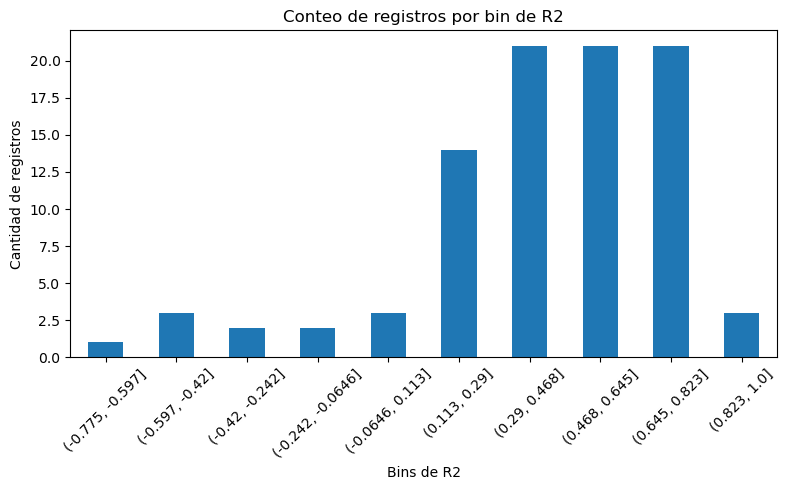

In [669]:
# Graficamos en bins los R2
data = df_unido['R2_x']

# Definir bins, por ejemplo 10 bins entre mínimo y máximo de R2
bins = np.linspace(data.min(), data.max(), 11)

# Categorizar los valores en bins
bins_categ = pd.cut(data, bins=bins, include_lowest=True)

# Contar cantidad de registros por bin
counts = bins_categ.value_counts().sort_index()

# Graficar barras
plt.figure(figsize=(8,5))
counts.plot(kind='bar')
plt.xlabel('Bins de R2')
plt.ylabel('Cantidad de registros')
plt.title('Conteo de registros por bin de R2')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


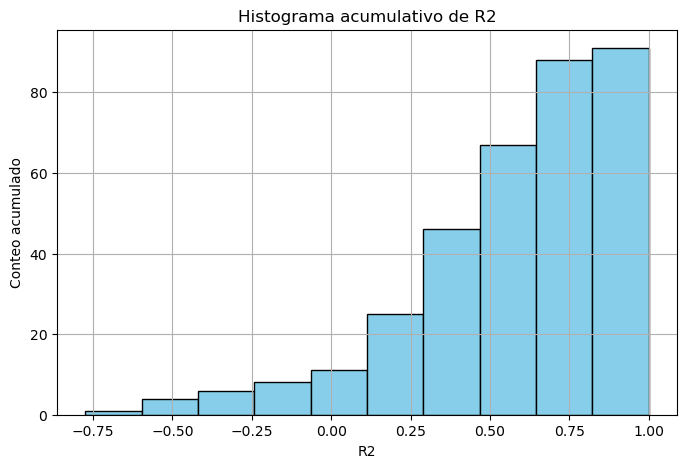

In [671]:
plt.figure(figsize=(8,5))
plt.hist(data, bins=bins, cumulative=True, color='skyblue', edgecolor='black')
plt.xlabel('R2')
plt.ylabel('Conteo acumulado')
plt.title('Histograma acumulativo de R2')
plt.grid(True)
plt.show()


In [437]:
df_resumen = df_resumen.reset_index()

In [439]:
df_merged = pd.merge(
    df_resumen,
    df_total,
    on="Dupla",  # clave común
    suffixes=('_resumen', '_total')
)

# Ahora podés filtrar tranquilamente
df_filtrado = df_merged[df_merged['Mejor_R2'] == df_merged['R2']]

In [476]:
df_filtrado = df_filtrado.drop(columns=['MSE','R2'],axis=1)
df_filtrado

,Dupla,Mejor_R2,Experimento_Mejor_R2,Menor_MSE,Experimento_Menor_MSE,Provincia,Cultivo,Modelo,Registros,Predictores
46,Buenos Aires-Alpiste,0.586526,14,4.253418e+04,14,Buenos Aires,Alpiste,Lasso,55,90
337,Buenos Aires-Cebada cervecera,0.688760,14,1.976637e+05,14,Buenos Aires,Cebada cervecera,Elastic Net,55,90
544,Buenos Aires-Centeno,0.766449,28,8.115300e+04,25,Buenos Aires,Centeno,PLS,55,80
614,Buenos Aires-Colza,0.270458,16,6.399374e+04,16,Buenos Aires,Colza,PLS,35,100
845,Buenos Aires-Girasol,0.745278,8,5.760420e+04,8,Buenos Aires,Girasol,Ridge,55,78
...,...,...,...,...,...,...,...,...,...,...
12296,Santa Fe-Maní,0.771608,18,1.457353e+05,18,Santa Fe,Maní,Lasso,38,100
12449,Santa Fe-Maíz,0.647072,8,1.707550e+06,8,Santa Fe,Maíz,PLS,55,78
12492,Santa Fe-Mijo,0.635776,9,1.838480e+04,9,Santa Fe,Mijo,Elastic Net,33,992
12615,Santa Fe-Soja total,0.557325,17,2.431328e+05,17,Santa Fe,Soja total,Ridge,55,88


In [445]:
df_filtrado.to_csv("../Metricas/resultado_final.csv")

In [478]:
df_filtrado['Dupla'].unique().shape

(69,)

In [470]:
df_resumen[df_resumen['Mejor_R2']<0.5].shape[0]

31

In [472]:
df_resumen[df_resumen['Mejor_R2']<0.3].shape[0]

17